In [1]:
import numpy as np
from itertools import compress
import random
import matplotlib
import matplotlib.pyplot as plt
plt.style.use('seaborn-whitegrid')
plt.rcParams['figure.figsize'] = (16, 20)
from mpl_toolkits.mplot3d import Axes3D 
import tikzplotlib
from itertools import chain, combinations
import pickle
import sys
import sklearn.linear_model as sklm
from gsw import *
#matplotlib.use("pgf")
matplotlib.rcParams.update({
    "pgf.texsystem": "pdflatex",
    'font.family': 'serif',
    'text.usetex': True,
    'pgf.rcfonts': False,
})
float_formatter = "{:.3e}".format
np.set_printoptions(formatter={'float_kind':float_formatter})
plt.rcParams.update({'font.size': 22})

In [2]:
!pip install matplotlib2tikz

xs: [array([8.410e-01, -6.837e-01, 1.000e+00]), array([-8.410e-01, 6.837e-01, -1.000e+00])]
sum:[array([5.551e-17, -5.551e-16]), array([-5.551e-17, 5.551e-16])]


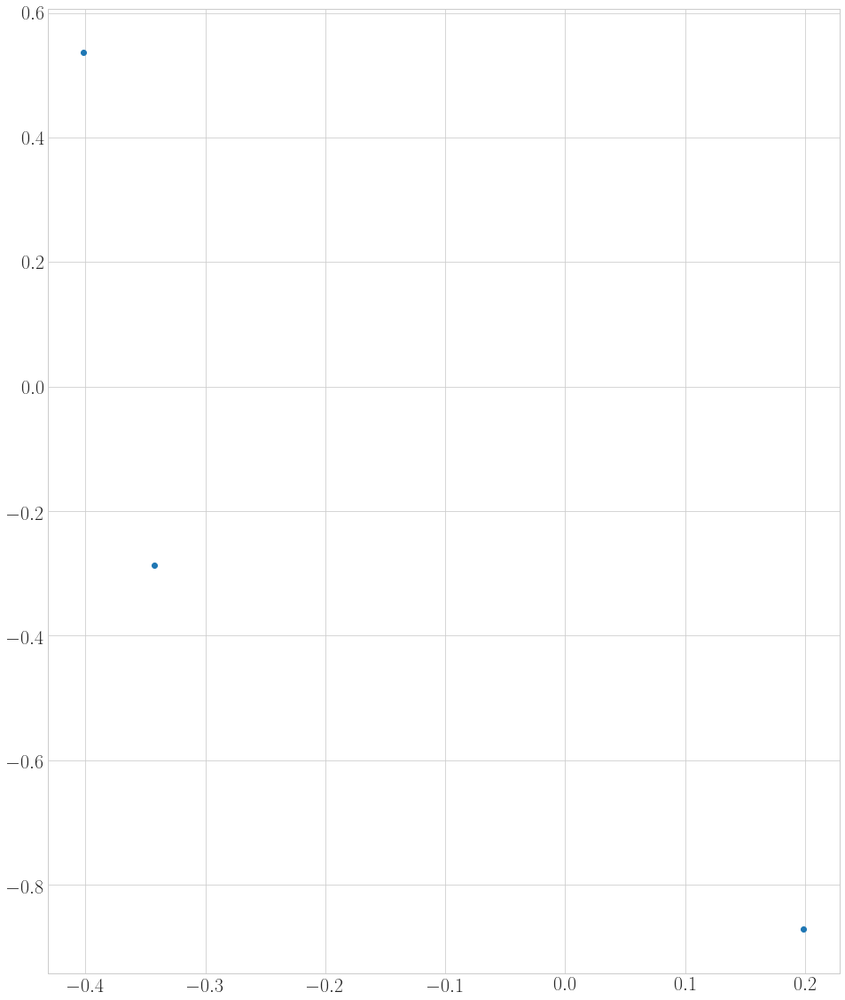

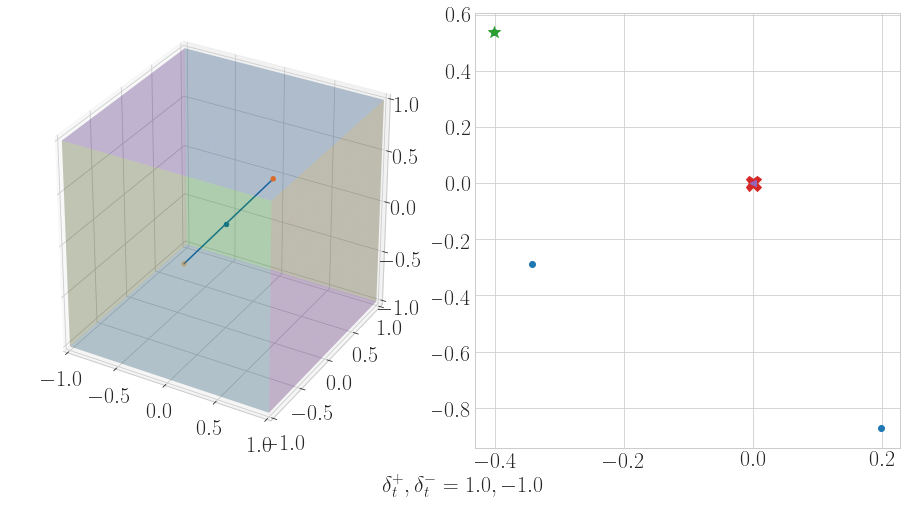

xs: [array([9.132e-01, -1.000e+00, 1.000e+00]), array([4.570e-01, 1.000e+00, 1.000e+00])]
sum:[array([1.228e-01, 2.799e-02]), array([-6.538e-01, -1.490e-01])]


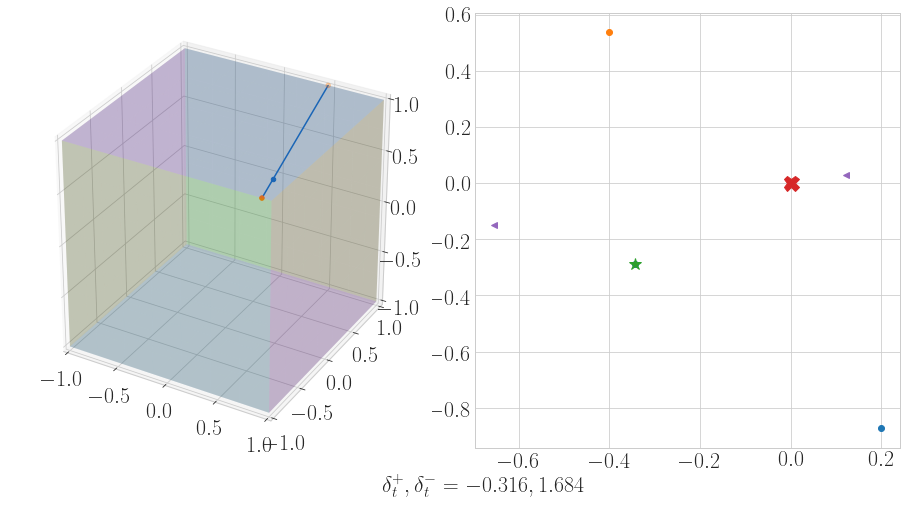

xs: [array([1.000e+00, -1.000e+00, 1.000e+00]), array([-1.000e+00, -1.000e+00, 1.000e+00])]
sum:[array([1.401e-01, -4.770e-02]), array([-2.571e-01, 1.696e+00])]


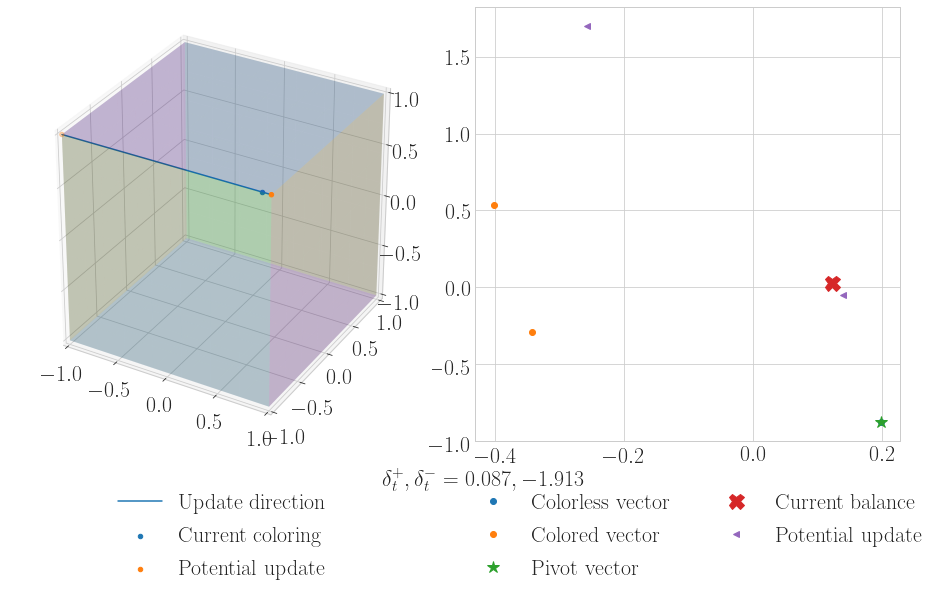

[]


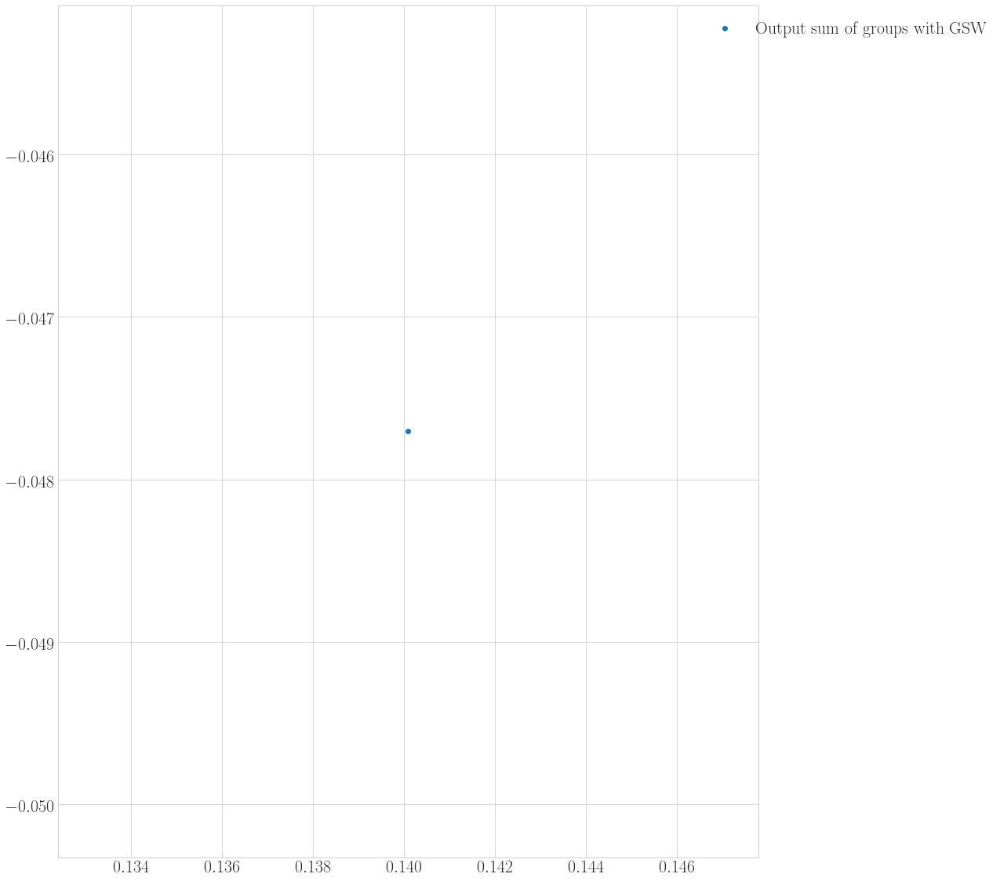

In [6]:
n=3
v=sample_from_sphere(n)
v=sample_from_ball(n,d=2)
#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
for i in range(1):
    #print(i)
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),plot=True,debug=False))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW')
plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Desktop\Master Thesis\GSWalk\gsw.py:120: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  u1=np.linalg.lstsq(B_t,-B[:,p])[0]


[]


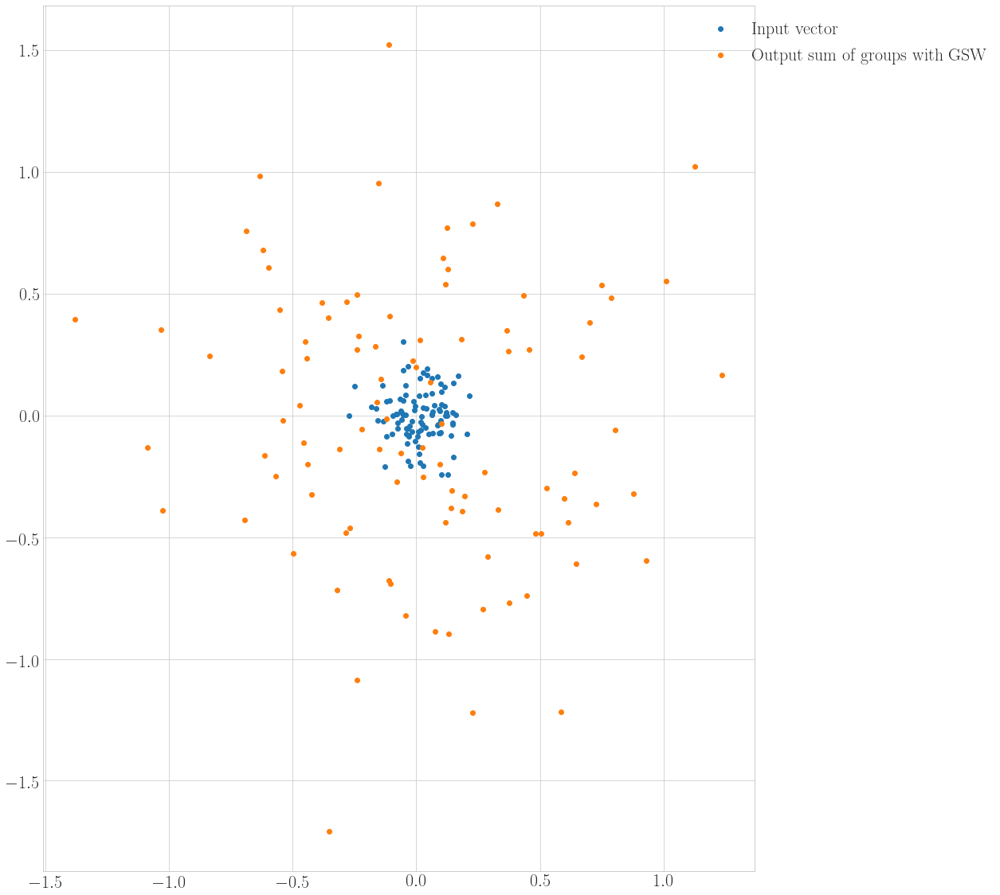

In [2]:
n=100
v=sample_from_sphere(n)
v=sample_from_ball(n,d=100)
#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
for i in range(n):
    #print(i)
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),plot=False,debug=False))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW')
plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Desktop\Master Thesis\GSWalk\gsw.py:120: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  u1=np.linalg.lstsq(B_t,-B[:,p])[0]


final error:[4.754e-10 -2.393e-10]
4.754099336423678e-10
final error:[4.189e-10 -6.566e-10]
6.566267529706238e-10
final error:[5.438e-10 -9.766e-10]
9.766267794475425e-10
final error:[-1.910e-08 2.534e-08]
2.53370444625034e-08
[]


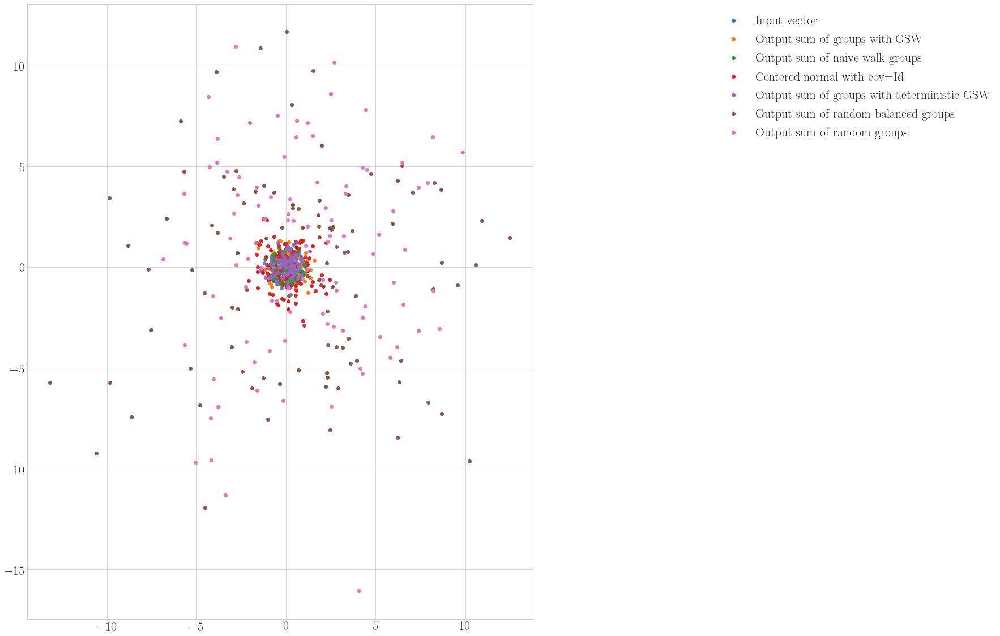

In [3]:
n=100
v=sample_from_sphere(n)
v=sample_from_ball(n)
#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
rand_xs=[]
balanced_xs=[]
subteam = [-1] * int(n/2) + [1] * int(n/2)
naive_xs=[]
deterministic_gsw_xs=[]
for i in range(n):
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),debug=False))
    deterministic_gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),debug=False,smallest_delta=True))
    rand_xs.append(2*np.random.randint(2,size=n)-1)
    random.shuffle(subteam)
    balanced_xs.append(subteam.copy())
    naive_xs.append(naive_walk(v))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW')
normals=np.random.multivariate_normal(np.zeros(2), np.diag(np.ones(2)), size=n)
plt.plot([np.matmul(B,x)[0] for x in naive_xs],[np.matmul(B,x)[1] for x in naive_xs],'o',label='Output sum of naive walk groups')
plt.plot(normals[:,0],normals[:,1],'o',label='Centered normal with cov=Id')
plt.plot([np.matmul(B,x)[0] for x in deterministic_gsw_xs],[np.matmul(B,x)[1] for x in deterministic_gsw_xs],'o',label='Output sum of groups with deterministic GSW')

plt.plot([np.matmul(B,x)[0] for x in balanced_xs],[np.matmul(B,x)[1] for x in balanced_xs],'o',label='Output sum of random balanced groups')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups')
plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:296: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:78: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


[]


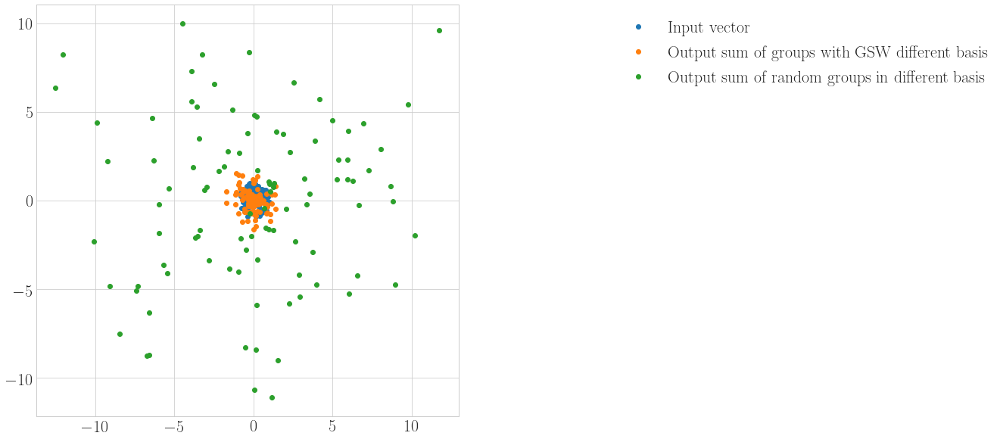

In [44]:
## Trying with a random orthonormal basis (A Gram-Schmidt orthogonalization of a random basis)
n=100
x=np.random.uniform(size=(n,n))
basis=gram_schmidt_columns(x)
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

In [ ]:
## Trying with a random non-orthonormal basis 
n=100
x=2*np.random.uniform(size=(n,n))-1
print(x)
#basis=gram_schmidt_columns(x)
basis=[x[i,:] for i in range(x.shape[0])]
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

[[-2.169e-03 7.544e-01 9.126e-01 ... 8.109e-01 -4.433e-01 -6.225e-01]
 [-3.890e-01 -8.723e-01 -6.845e-01 ... -9.069e-01 9.989e-01 -5.756e-01]
 [-8.358e-01 1.516e-01 3.192e-01 ... -2.033e-01 -5.179e-01 5.336e-01]
 ...
 [8.611e-01 5.505e-01 -9.301e-01 ... -2.042e-01 3.844e-01 1.720e-01]
 [-4.402e-01 1.810e-01 -1.688e-01 ... -3.698e-01 -4.016e-01 4.337e-01]
 [-1.601e-01 -6.487e-01 8.529e-01 ... -9.434e-01 3.540e-01 -5.613e-01]]


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:296: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:78: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:43: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


[]


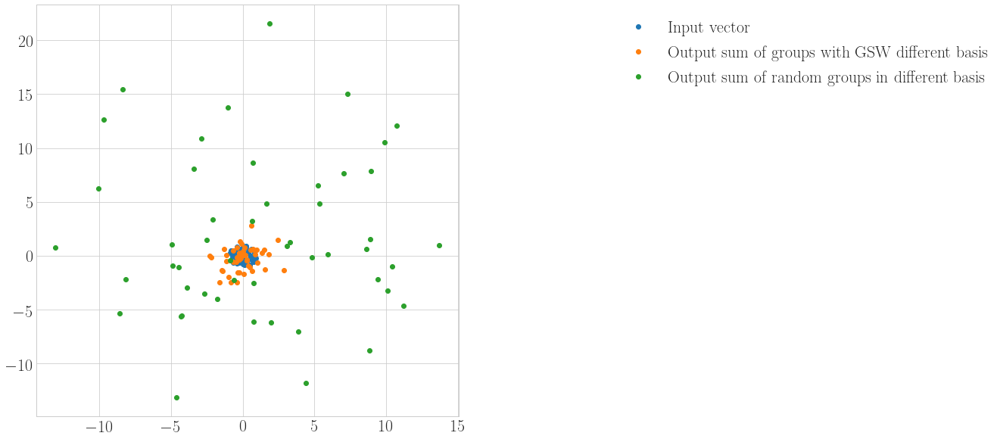

In [14]:
## Trying with a random non-orthonormal basis that's all in the same direction
n=50
x=np.random.uniform(size=(n,n))
#basis=gram_schmidt_columns(x)
basis=[x[i,:] for i in range(x.shape[0])]
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:43: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


[]


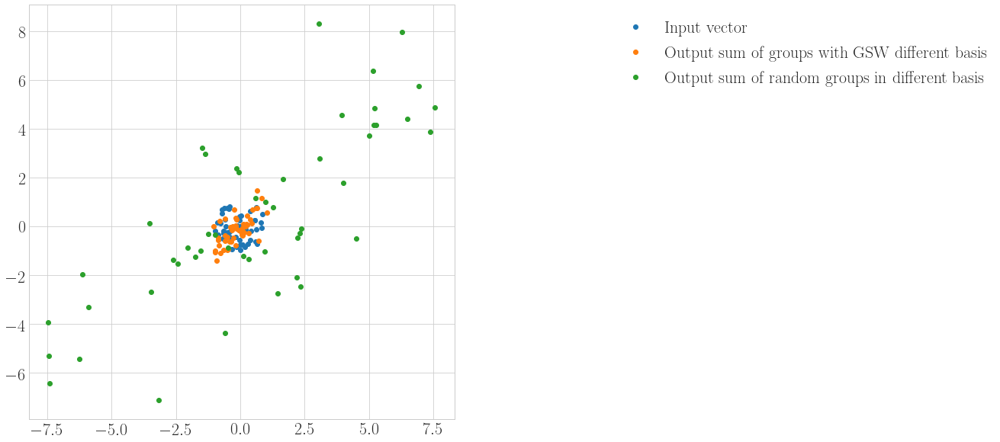

In [15]:
## Trying with a random non-orthonormal basis that's all in the same direction
n=50
x=np.random.uniform(size=(n,n))
#basis=gram_schmidt_columns(x)
basis=[normalize(x[i,:]) for i in range(x.shape[0])]
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:43: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


[]


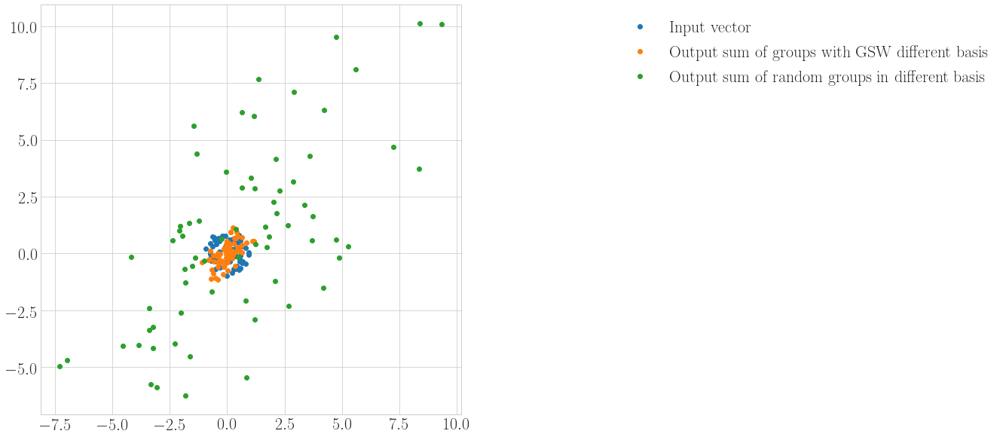

In [17]:
## Trying with a random non-orthonormal basis that's all in the same direction
n=70
x=np.random.uniform(size=(n,n))
#basis=gram_schmidt_columns(x)
basis=[normalize(x[i,:]) for i in range(x.shape[0])]
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


[]


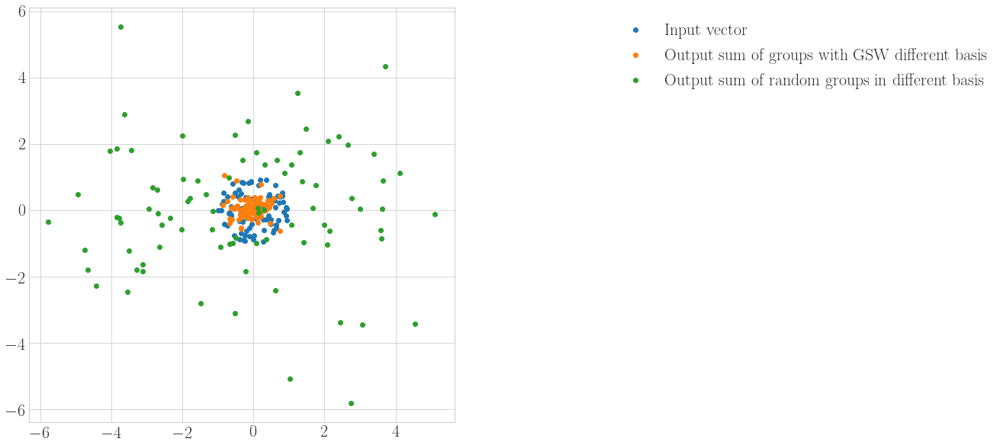

In [21]:
## Trying with a random non-orthonormal basis that's all in the same direction
n=85
x=np.random.uniform(size=(n,n))
#basis=gram_schmidt_columns(x)
basis=[normalize(x[i,:]) for i in range(x.shape[0])]
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


[]


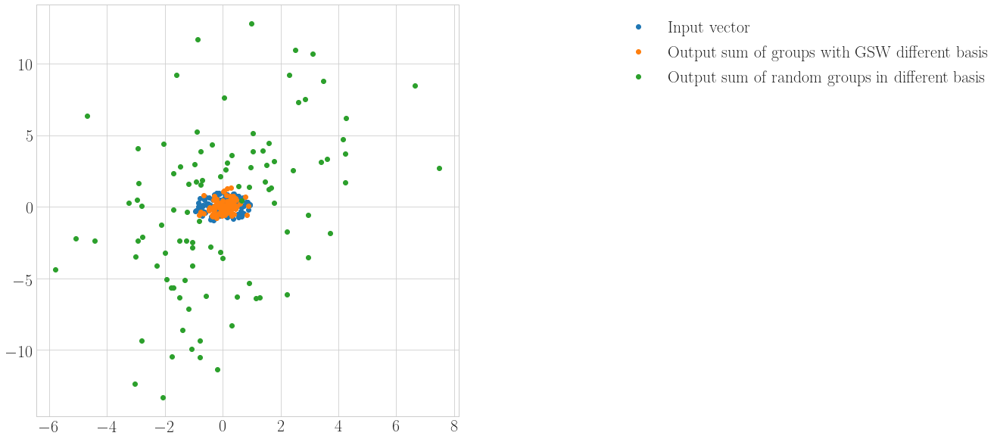

In [22]:
## Trying with a random non-orthonormal basis that's all in the same direction
n=100
x=np.random.uniform(size=(n,n))
#basis=gram_schmidt_columns(x)
basis=[normalize(x[i,:]) for i in range(x.shape[0])]
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


[]


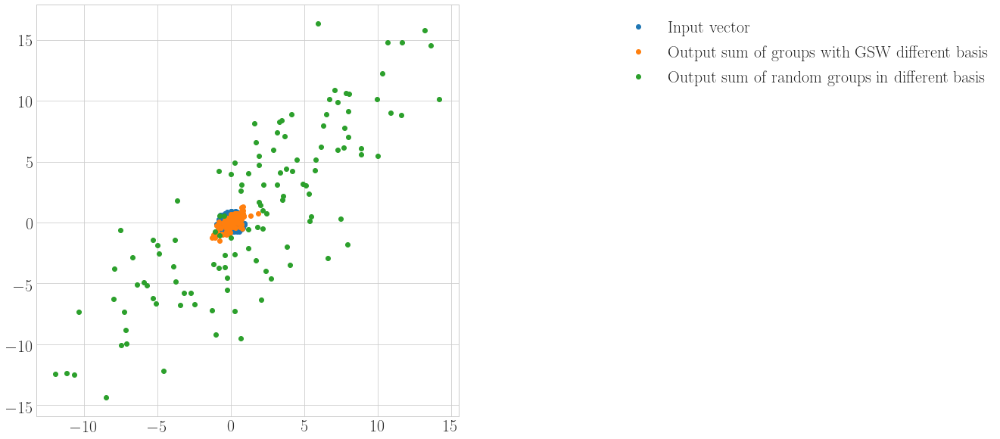

In [23]:
## Trying with a random non-orthonormal basis that's all in the same direction
n=120
x=np.random.uniform(size=(n,n))
#basis=gram_schmidt_columns(x)
basis=[normalize(x[i,:]) for i in range(x.shape[0])]
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


[]


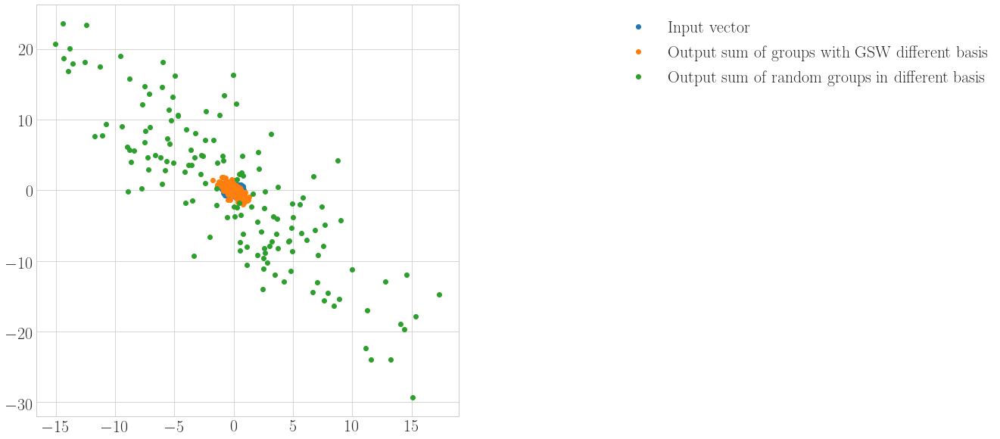

In [24]:
## Trying with a random non-orthonormal basis that's all in the same direction
n=150
x=np.random.uniform(size=(n,n))
#basis=gram_schmidt_columns(x)
basis=[normalize(x[i,:]) for i in range(x.shape[0])]
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Issue: x is out of bound!
Choosing pivot through mode random.
x: [4.590e-01 1.478e-01 -2.766e-01 1.117e+00 5.814e-01 3.944e-03 1.048e+00
 7.183e-01 7.167e-01 2.282e-01 6.391e-01 7.701e-01 7.509e-01 6.933e-01
 -1.539e-01 1.412e-01 5.379e-01 1.490e-01 1.240e+00 1.058e+00 -3.035e-01
 6.125e-01 3.067e-01 2.878e-01 5.500e-01 3.913e-01 1.150e+00 6.537e-01
 -2.185e-01 6.883e-01 4.749e-02 8.539e-01 8.724e-01 3.831e-01 6.494e-01
 6.602e-01 9.841e-01 3.321e-01 2.731e-01 7.175e-01 5.021e-01 4.189e-01
 7.502e-01 8.896e-01 7.087e-01 -1.685e-01 8.287e-01 5.588e-01 2.875e-01
 1.795e-01 3.319e-01 1.071e+00 4.685e-01 1.279e+00 1.845e-01 5.838e-01
 9.091e-01 1.019e+00 8.600e-01 1.990e-01 3.108e-01 9.230e-01 3.356e-01
 3.090e-01 4.487e-01 -1.678e-01 3.320e-01 1.463e-01 8.146e-01 -4.638e-02
 4.657e-01 -2.849e-01 3.590e-01 3.913e-01 6.808e-01 3.820e-01 6.602e-01
 1.085e+00 4.210e-01 5.742e-01 3.869e-01 -8.031e-02 6.717e-01 3.631e-02
 3.549e-01 7.792e-02 4.278e-01 9.258e-02 5.979e-01 5.210e-01 5.976e-01
 4.

 -1.000e+00 8.607e-04 -1.000e+00 1.000e+00]
u:[-6.350e-14 -2.473e-03 1.377e-14 4.441e-14 -2.576e-14 -7.927e-14 2.449e-04
 4.441e-14 1.045e-02 -7.038e-05 4.263e-14 -1.318e-02 -4.130e-14 -2.156e-03
 -9.709e-03 5.596e-14 -2.171e-02 -9.196e-03 -9.726e-14 -1.332e-14
 -3.047e-04 -5.151e-14 3.604e-03 -4.731e-03 2.642e-14 -8.127e-14 2.536e-03
 -2.554e-15 -8.349e-14 -2.283e-03 -1.182e-02 2.975e-14 8.205e-03 5.150e-03
 -1.239e-02 -9.327e-03 1.910e-14 2.398e-14 9.081e-03 9.642e-03 1.481e-03
 -9.668e-03 -1.017e-03 -7.080e-03 7.105e-15 5.240e-14 -3.718e-03 2.087e-03
 2.620e-14 -3.364e-03 -7.032e-03 -4.109e-03 5.307e-14 -3.553e-15
 -1.870e-02 4.767e-03 2.020e-03 7.280e-03 -4.219e-15 -1.172e-02 -1.177e-14
 -5.773e-15 6.903e-03 -7.105e-15 -2.576e-14 -3.856e-03 3.452e-03
 -1.784e-02 -5.029e-04 -1.332e-15 -1.066e-14 1.776e-15 3.819e-14
 -4.603e-03 -3.362e-03 1.397e-02 3.331e-14 -1.510e-14 -3.375e-14 3.442e-14
 7.105e-15 1.776e-15 -1.776e-14 -1.050e-02 3.525e-03 5.450e-03 -7.878e-03
 -2.043e-14 -2.665e-1

Choosing pivot through mode random.
x: [4.749e-01 -1.502e-03 -4.212e-01 1.159e+00 5.101e-01 -4.036e-02 1.020e+00
 5.781e-01 7.405e-01 1.637e-01 6.334e-01 8.382e-01 7.041e-01 5.937e-01
 -3.680e-01 1.128e-01 6.240e-01 2.919e-02 1.118e+00 9.372e-01 -3.623e-01
 6.658e-01 1.446e-01 2.091e-01 4.748e-01 3.841e-01 1.160e+00 5.606e-01
 -3.183e-01 4.903e-01 -7.571e-02 7.999e-01 8.524e-01 3.191e-01 4.543e-01
 6.744e-01 8.961e-01 2.563e-01 2.908e-01 6.466e-01 5.122e-01 5.146e-01
 7.722e-01 8.605e-01 7.564e-01 -2.675e-01 7.805e-01 4.625e-01 1.624e-01
 1.521e-01 2.134e-01 9.207e-01 4.364e-01 1.129e+00 5.299e-02 6.826e-01
 8.783e-01 9.234e-01 7.960e-01 8.108e-02 1.945e-01 9.064e-01 1.955e-01
 2.131e-01 4.370e-01 -3.474e-01 2.335e-01 1.599e-01 7.921e-01 -9.577e-02
 4.358e-01 -3.760e-01 3.680e-01 1.816e-01 5.339e-01 2.974e-01 5.735e-01
 9.677e-01 3.055e-01 4.144e-01 3.650e-01 -1.136e-01 5.513e-01 -8.482e-02
 3.209e-01 4.185e-02 3.871e-01 -2.652e-03 5.883e-01 4.272e-01 5.879e-01
 3.279e-01 5.906e-01 -2.

All deltas considered:[1.066e+02 2.090e+02 -4.278e+01 3.804e+02 2.473e+01 8.015e+01 3.354e+01
 1.249e+01 3.683e+01 -2.152e+02 -1.367e+02 6.615e+01 -9.171e+01 1.266e+02
 2.968e+01 -4.391e+01 -7.259e+01 2.616e+01 3.208e+01 -6.100e+01 -6.994e+01
 2.189e+02 3.697e+01 1.557e+02 4.429e+01 5.060e+02 6.728e+01 6.992e+01
 -7.779e-01 -2.206e+03 1.423e+02 -6.823e+01 2.484e+01 -8.431e+01 1.040e+02
 -2.256e+02 1.653e+01 9.265e+01 9.341e+01 5.062e+01 -3.744e+01 3.335e+01
 -1.506e+03 -8.940e+01 2.956e+01 3.016e+01 2.718e+01 3.266e+01 -4.313e+01
 1.998e+01 -2.208e+02 2.428e+01 3.925e+01 6.727e+01 9.134e+01 6.613e+01
 2.000e+01 -3.025e+02 2.275e+02 1.119e+02 5.000e+01 2.067e+02 6.567e+01
 1.714e+01 8.518e+01 2.147e+01 1.238e+02 2.709e+01 1.828e+01 1.426e+02
 -9.605e+01 -3.664e+01 1.958e+02 1.491e+01 6.105e+01 -3.302e+02 9.767e+01
 3.478e+01 1.443e+01 4.311e+01 9.098e+01 4.714e+02 5.536e+01 1.171e+02
 1.533e+02 -3.168e+02 6.927e+01 -9.843e+01 3.838e+01 3.580e+01 1.899e+02
 2.324e+01 1.689e+01 1.897e+02 

Choosing pivot through mode random.
x: [5.103e-01 3.337e-02 -2.866e-01 1.295e+00 6.015e-01 3.221e-02 1.309e+00
 4.007e-01 8.291e-01 2.774e-01 8.614e-01 8.623e-01 6.804e-01 6.982e-01
 -3.008e-01 1.180e-01 5.497e-01 8.881e-02 1.034e+00 7.932e-01 -3.183e-01
 6.768e-01 1.847e-01 3.004e-01 7.386e-01 4.363e-01 1.195e+00 5.014e-01
 -2.273e-01 4.422e-01 9.633e-02 8.258e-01 9.435e-01 3.724e-01 4.509e-01
 8.766e-01 1.032e+00 3.799e-01 2.185e-01 7.467e-01 5.649e-01 6.038e-01
 8.985e-01 7.719e-01 7.411e-01 -2.703e-01 1.001e+00 4.027e-01 1.376e-01
 2.796e-01 5.648e-01 1.060e+00 5.691e-01 1.311e+00 2.211e-01 7.747e-01
 1.038e+00 9.090e-01 7.982e-01 2.765e-01 2.462e-01 9.536e-01 3.299e-01
 2.951e-01 5.015e-01 -3.811e-01 2.711e-01 2.448e-01 8.283e-01 7.085e-02
 5.191e-01 -3.320e-01 5.059e-01 3.245e-01 4.732e-01 2.546e-01 7.838e-01
 1.062e+00 4.971e-01 4.230e-01 4.140e-01 -8.399e-02 7.324e-01 5.792e-02
 4.370e-01 1.759e-01 5.163e-01 2.666e-02 6.418e-01 5.584e-01 6.429e-01
 2.038e-01 6.803e-01 -2.075e-0

All deltas considered:[3.160e+02 -1.335e+03 -7.774e+01 -9.998e+03 4.844e+01 4.266e+02 6.963e+01
 2.737e+01 -9.109e-01 1.155e+03 -2.080e+02 1.542e+02 -3.251e+02 3.342e+02
 5.386e+01 -9.791e+01 5.236e+01 7.512e+01 -8.770e+01 -8.279e+01 6.787e+01
 9.369e+02 1.002e+02 -3.092e+02 2.434e+02 1.831e+02 -1.496e+02 -2.892e+02
 -1.076e+02 5.850e+01 -1.121e+02 1.807e+02 -2.103e+02 3.433e+01 -1.068e+04
 1.477e+02 2.778e+02 -6.010e+01 6.207e+01 -1.978e+02 -1.408e+02 1.004e+02
 6.418e+01 5.687e+01 1.271e+02 -7.692e+01 5.133e+01 -1.411e+02 5.000e+01
 1.198e+02 3.827e+02 5.455e+02 5.472e+01 -1.077e+03 6.178e+03 1.115e+03
 1.199e+02 -1.152e+03 8.796e+01 3.724e+01 1.034e+02 4.977e+01 1.955e+02
 5.182e+01 3.907e+01 -2.286e+03 -1.168e+02 -5.654e+01 2.574e+02 3.655e+01
 7.254e+01 -1.519e+03 4.503e+02 3.455e+01 8.067e+01 2.525e+02 -4.213e+02
 1.277e+02 3.639e+02 -2.286e+02 5.099e+02 -1.298e+02 1.097e+02 -1.657e+02
 4.102e+01 3.355e+01 9.989e+02 -6.765e+01 3.329e+02 1.792e+02 -1.178e+02
 2.993e+02 -5.683e+02 

 -1.320e+02 -1.105e+02 1.333e+02 -8.986e+01 4.910e+02]
delta_+:1.0468847476706067
delta_-:-0.9531152523293187
delta=delta_-
Incurred discrepancy:4.577566798522238e-15
Computing the list of elements that are alive with threshold 1e-12
x: [4.193e-01 5.422e-03 -2.121e-01 1.481e+00 6.089e-01 -5.440e-02 1.288e+00
 5.012e-01 8.005e-01 1.821e-01 8.718e-01 9.965e-01 6.114e-01 5.153e-01
 -3.658e-01 2.346e-01 6.060e-01 1.039e-01 1.237e+00 7.276e-01 -2.428e-01
 7.428e-01 3.294e-01 2.355e-01 7.145e-01 5.182e-01 1.267e+00 5.245e-01
 -7.366e-02 5.270e-01 -2.597e-02 8.580e-01 9.112e-01 2.323e-01 6.171e-01
 9.023e-01 1.018e+00 2.824e-01 2.529e-01 7.546e-01 6.121e-01 7.397e-01
 8.823e-01 8.274e-01 8.034e-01 -4.417e-01 1.081e+00 4.310e-01 -7.163e-02
 2.554e-01 5.562e-01 1.094e+00 4.415e-01 1.231e+00 2.291e-01 7.399e-01
 9.228e-01 9.527e-01 7.415e-01 4.061e-01 3.823e-01 9.173e-01 4.729e-01
 4.155e-01 4.505e-01 -3.383e-01 2.405e-01 1.916e-01 8.855e-01 4.165e-03
 5.916e-01 -2.876e-01 4.999e-01 4.367e-01 6.

u:[-1.599e-14 -2.343e-03 5.551e-15 7.239e-14 1.128e-13 -1.190e-13 5.619e-03
 1.599e-14 2.127e-02 2.152e-03 -2.665e-15 -2.669e-02 -1.388e-13 2.073e-03
 -1.826e-02 7.228e-14 -4.081e-02 -9.109e-14 4.796e-14 1.577e-14 -5.563e-03
 -2.942e-14 8.689e-03 -7.486e-03 3.997e-15 -3.908e-14 8.413e-04 -7.402e-14
 6.661e-15 -2.863e-03 1.000e+00 7.394e-14 1.295e-02 4.552e-14 -2.448e-02
 -1.507e-02 -8.549e-15 -5.262e-14 2.266e-02 2.707e-02 1.488e-14 -2.054e-02
 1.498e-03 -1.184e-02 -2.864e-14 -1.021e-14 8.882e-16 1.110e-02 1.599e-14
 -1.284e-03 3.597e-14 4.885e-14 1.954e-14 3.242e-14 6.789e-14 2.048e-02
 1.586e-02 1.698e-02 3.508e-14 -1.907e-02 -2.331e-14 -2.376e-14 -1.821e-14
 1.649e-14 -1.110e-14 -8.471e-03 1.081e-02 -3.477e-02 8.089e-03 -9.276e-14
 2.709e-14 1.243e-14 -1.021e-14 -1.092e-02 3.486e-03 3.179e-02 3.331e-14
 -1.266e-14 4.974e-14 3.064e-14 -1.843e-14 -3.109e-15 -6.506e-14
 -2.209e-02 1.483e-02 1.276e-02 -5.108e-03 3.841e-14 1.465e-14 -1.332e-14
 -1.929e-02 -1.066e-14 -2.191e-02 3.109e-14 

Choosing pivot through mode random.
x: [4.716e-01 1.322e-01 -1.420e-01 1.621e+00 6.269e-01 9.845e-02 1.335e+00
 6.802e-01 8.687e-01 2.110e-01 1.070e+00 1.014e+00 7.295e-01 4.903e-01
 -3.007e-01 3.866e-01 6.157e-01 8.049e-02 1.393e+00 8.951e-01 -1.118e-01
 8.635e-01 3.607e-01 4.241e-01 6.528e-01 5.407e-01 1.385e+00 5.310e-01
 -1.603e-01 6.327e-01 1.332e-01 8.906e-01 1.004e+00 3.245e-01 7.606e-01
 9.344e-01 1.112e+00 4.335e-01 3.225e-01 8.703e-01 7.070e-01 7.641e-01
 8.632e-01 9.825e-01 8.694e-01 -2.105e-01 1.186e+00 7.462e-01 2.801e-02
 5.020e-01 6.289e-01 1.171e+00 6.546e-01 1.377e+00 2.804e-01 8.542e-01
 1.168e+00 1.228e+00 8.652e-01 3.226e-01 4.501e-01 1.056e+00 6.025e-01
 5.077e-01 5.046e-01 -1.763e-01 3.725e-01 2.570e-01 1.182e+00 1.733e-01
 5.389e-01 -5.669e-02 7.439e-01 3.668e-01 7.318e-01 4.496e-01 7.373e-01
 1.291e+00 7.293e-01 6.706e-01 5.486e-01 -2.838e-02 8.034e-01 1.817e-01
 5.316e-01 2.087e-01 6.649e-01 -1.517e-01 9.152e-01 6.067e-01 8.181e-01
 2.825e-01 7.317e-01 -3.973e-

  True False  True False False  True False False]
v_perp:[0.000e+00 0.000e+00]
v_perp-sum u_i*v_i:[-8.327e-17 1.665e-16]
v_perp:[0.000e+00 0.000e+00]
v_perp-sum u_i*v_i:[-8.327e-17 1.665e-16]
Calculated update direction u:[0.000e+00 -7.157e-03 0.000e+00 0.000e+00 0.000e+00 0.000e+00 -6.178e-03
 0.000e+00 1.570e-02 -3.040e-03 0.000e+00 -1.999e-02 0.000e+00 -1.150e-02
 -1.651e-02 0.000e+00 -3.692e-02 0.000e+00 0.000e+00 0.000e+00 5.861e-03
 0.000e+00 3.686e-03 -9.851e-03 0.000e+00 0.000e+00 9.336e-03 0.000e+00
 0.000e+00 -5.713e-03 0.000e+00 0.000e+00 1.713e-02 0.000e+00 -1.956e-02
 1.000e+00 0.000e+00 0.000e+00 8.311e-03 4.971e-03 0.000e+00 -1.342e-02
 -6.091e-03 -1.392e-02 0.000e+00 0.000e+00 0.000e+00 -5.625e-03 0.000e+00
 -1.217e-02 0.000e+00 0.000e+00 0.000e+00 0.000e+00 0.000e+00 -6.615e-03
 -1.198e-02 8.170e-03 0.000e+00 -2.373e-02 0.000e+00 0.000e+00 0.000e+00
 0.000e+00 0.000e+00 -5.000e-03 3.515e-04 -2.880e-02 -1.241e-02 0.000e+00
 0.000e+00 0.000e+00 0.000e+00 -4.932e-03 0.000

x:[-1.000e+00 -1.861e-02 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00 4.441e-03
 -1.000e+00 8.410e-02 5.407e-04 1.000e+00 -1.060e-01 1.000e+00 -1.423e-02
 -7.741e-02 -1.000e+00 -1.731e-01 1.000e+00 -1.000e+00 -1.000e+00
 -4.837e-03 -1.000e+00 2.966e-02 -3.704e-02 -1.000e+00 1.000e+00 1.833e-02
 -1.000e+00 -1.000e+00 -1.752e-02 -1.000e+00 1.000e+00 6.422e-02 1.000e+00
 -9.935e-02 1.000e+00 -1.000e+00 1.000e+00 7.510e-02 8.119e-02 -1.000e+00
 -7.822e-02 -6.466e-03 -5.574e-02 1.000e+00 1.000e+00 1.000e+00 2.010e-02
 1.000e+00 -2.439e-02 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00
 -1.000e+00 4.356e-02 2.192e-02 5.963e-02 -1.000e+00 -9.202e-02 1.000e+00
 1.000e+00 1.000e+00 -1.000e+00 1.000e+00 -3.133e-02 2.961e-02 -1.429e-01
 3.487e-04 1.000e+00 1.000e+00 1.000e+00 1.000e+00 -3.780e-02 -1.000e+00
 1.000e+00 -1.000e+00 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00 1.000e+00
 1.000e+00 -8.482e-02 3.206e-02 4.467e-02 -5.813e-02 1.000e+00 -1.000e+00
 1.000e+00 -8.356e-02 1.000e+00 -9.292e-02 -1.000e+

 1.000e+00 1.000e+00 1.000e+00 1.000e+00]
Choosing pivot through mode random.
x: [5.152e-01 2.016e-01 -7.248e-02 1.527e+00 7.181e-01 2.232e-01 1.224e+00
 7.673e-01 8.146e-01 1.309e-01 1.213e+00 9.582e-01 8.039e-01 4.962e-01
 -2.432e-01 3.378e-01 6.784e-01 1.867e-01 1.368e+00 9.423e-01 -7.749e-02
 9.845e-01 4.592e-01 5.209e-01 7.314e-01 5.466e-01 1.415e+00 5.754e-01
 -3.241e-02 6.717e-01 1.387e-01 9.358e-01 1.085e+00 3.672e-01 7.264e-01
 9.276e-01 1.156e+00 5.386e-01 2.830e-01 7.789e-01 7.918e-01 8.629e-01
 9.658e-01 1.040e+00 8.477e-01 -1.644e-01 1.201e+00 7.418e-01 9.091e-02
 5.243e-01 7.260e-01 1.130e+00 6.437e-01 1.404e+00 3.549e-01 9.376e-01
 1.237e+00 1.210e+00 8.726e-01 3.605e-01 5.077e-01 1.005e+00 6.082e-01
 4.661e-01 4.684e-01 -2.968e-02 4.261e-01 2.169e-01 1.183e+00 1.259e-01
 5.899e-01 -3.522e-02 6.883e-01 4.093e-01 8.107e-01 5.125e-01 7.537e-01
 1.196e+00 7.530e-01 7.146e-01 6.162e-01 5.352e-02 8.340e-01 1.697e-01
 4.718e-01 1.884e-01 8.037e-01 -5.385e-02 9.601e-01 5.997e-0

 -4.826e+01 4.720e+01 -4.535e+01 1.963e+02]
delta_+:1.0736310372548719
delta_-:-0.9263689627451249
delta=delta_-
Incurred discrepancy:4.5356381352535936e-15
Computing the list of elements that are alive with threshold 1e-12
x: [4.333e-01 1.325e-01 -1.016e-01 1.497e+00 6.782e-01 1.243e-01 1.168e+00
 8.250e-01 8.096e-01 1.487e-01 1.190e+00 9.121e-01 8.107e-01 5.276e-01
 -2.652e-01 3.396e-01 6.696e-01 1.701e-01 1.333e+00 9.841e-01 -1.545e-01
 9.904e-01 3.861e-01 4.675e-01 7.065e-01 5.091e-01 1.409e+00 5.279e-01
 -6.375e-02 6.372e-01 6.526e-02 9.171e-01 9.675e-01 3.382e-01 7.126e-01
 8.934e-01 1.047e+00 4.636e-01 1.961e-01 6.622e-01 8.001e-01 7.772e-01
 1.004e+00 1.036e+00 7.147e-01 -2.121e-01 1.115e+00 7.170e-01 -2.216e-02
 5.080e-01 7.796e-01 1.161e+00 6.959e-01 1.363e+00 3.110e-01 9.186e-01
 1.236e+00 1.199e+00 8.555e-01 3.695e-01 4.679e-01 9.501e-01 6.182e-01
 4.816e-01 4.340e-01 -6.054e-02 4.747e-01 1.314e-01 1.088e+00 7.396e-02
 5.839e-01 -8.901e-02 7.028e-01 3.866e-01 7.364e-01 5.41

u:[-9.770e-15 -1.003e-02 3.886e-15 6.084e-14 3.819e-14 -6.350e-14 -7.557e-03
 1.865e-14 2.433e-02 -1.821e-14 1.332e-15 -3.092e-02 -7.083e-14 -1.528e-02
 -2.500e-02 1.177e-14 -5.589e-02 -2.143e-14 -3.375e-14 -1.776e-14
 7.136e-03 -1.110e-15 6.245e-03 -1.442e-02 2.615e-14 -3.153e-14 1.277e-02
 -4.818e-14 -2.798e-14 -8.150e-03 -3.419e-14 4.774e-14 2.506e-02 3.453e-14
 -3.003e-02 -2.520e-14 1.421e-14 -2.132e-14 1.452e-02 1.063e-02 -1.554e-14
 -2.113e-02 -8.034e-03 1.688e-14 -1.821e-14 -3.553e-15 -3.109e-14
 -6.017e-03 -1.243e-14 -1.666e-02 1.399e-14 1.421e-14 4.530e-14 3.597e-14
 3.153e-14 -6.007e-03 -1.394e-02 1.351e-02 -6.217e-15 -3.489e-02
 -5.329e-15 -2.220e-14 2.232e-14 2.442e-15 -3.197e-14 -7.994e-03 2.034e-03
 -4.402e-02 -1.564e-02 -1.288e-14 4.885e-15 4.596e-14 3.997e-15 -8.254e-03
 -7.994e-15 2.354e-14 8.882e-15 -2.287e-14 3.020e-14 3.109e-14 6.661e-15
 -3.286e-14 5.107e-15 -2.329e-02 -3.935e-03 1.004e-02 -3.569e-02 2.531e-14
 5.773e-15 6.217e-15 -2.781e-02 -8.882e-15 -3.001e-02 1

Choosing pivot through mode random.
x: [3.559e-01 1.656e-02 -1.857e-01 1.471e+00 5.635e-01 3.955e-02 1.137e+00
 6.762e-01 7.131e-01 1.131e-01 1.107e+00 8.246e-01 7.549e-01 4.180e-01
 -3.546e-01 3.229e-01 6.434e-01 8.276e-02 1.240e+00 8.787e-01 -2.020e-01
 8.406e-01 1.822e-01 3.290e-01 6.501e-01 4.038e-01 1.256e+00 3.983e-01
 -1.696e-01 5.604e-01 -1.162e-01 8.504e-01 9.719e-01 2.798e-01 6.022e-01
 7.217e-01 9.074e-01 4.342e-01 8.712e-02 6.203e-01 6.584e-01 7.827e-01
 9.884e-01 9.859e-01 6.622e-01 -3.285e-01 1.018e+00 6.205e-01 -6.986e-02
 3.617e-01 7.054e-01 1.079e+00 5.488e-01 1.300e+00 1.382e-01 7.678e-01
 1.208e+00 1.053e+00 7.361e-01 2.703e-01 3.494e-01 8.574e-01 5.722e-01
 3.186e-01 2.904e-01 -1.536e-01 3.541e-01 -7.539e-02 1.012e+00 6.660e-02
 5.409e-01 -1.553e-01 5.454e-01 3.122e-01 6.229e-01 4.606e-01 5.791e-01
 1.085e+00 5.294e-01 5.938e-01 4.109e-01 -7.503e-02 5.802e-01 7.244e-02
 3.978e-01 7.053e-02 6.753e-01 -2.217e-01 8.242e-01 5.497e-01 7.399e-01
 2.682e-01 5.772e-01 -9.42

All deltas considered:[-2.390e+03 6.642e+01 3.135e+01 -2.277e+01 8.896e+01 -3.586e+01 -1.518e+01
 -6.853e+01 6.656e+01 -1.073e+02 -2.601e+02 -4.261e+02 6.612e+01
 -2.538e+01 2.550e+01 2.006e+01 -2.899e+01 1.490e+02 3.900e+01 2.077e+02
 2.232e+01 2.548e+01 3.521e+01 -3.935e+01 -7.040e+01 4.700e+01 -1.763e+01
 4.168e+01 -5.188e+01 -2.706e+01 3.098e+01 4.644e+01 -3.456e+01 -2.963e+01
 7.914e+01 2.997e+01 -4.441e+01 2.661e+01 -2.534e+01 -1.460e+03 6.869e+01
 8.817e+01 -6.372e+01 -8.880e+02 7.587e+01 6.262e+01 -2.052e+01 -2.995e+01
 -2.098e+01 5.591e+01 -1.055e+00 -7.577e+01 -2.135e+01 -4.509e+02
 -2.291e+01 -3.522e+01 4.989e+01 -8.545e+01 4.625e+01 5.555e+01 -2.328e+02
 1.835e+01 -1.715e+01 -1.622e+01 2.121e+02 1.553e+01 1.148e+02 2.288e+02
 7.792e+01 6.005e+01 8.827e+02 2.456e+03 -6.718e+01 -2.879e+01 2.537e+01
 -9.208e+01 3.898e+01 1.830e+01 6.782e+01 -6.486e+01 1.122e+02 2.519e+02
 4.362e+02 -6.123e+01 2.814e+01 -2.393e+01 -1.891e+01 3.131e+01 -1.516e+02
 -3.903e+01 -2.166e+02 -2.208e+0

 5.046e-03 -1.000e+00 1.000e+00]
u:[-8.216e-15 -6.573e-03 -7.971e-14 -1.599e-14 1.166e-15 -1.004e-13
 3.281e-03 1.915e-14 3.332e-02 -4.219e-14 7.155e-14 1.000e+00 -1.115e-13
 -3.720e-03 -3.023e-02 9.026e-14 1.776e-14 -6.101e-14 1.599e-14 -1.893e-14
 -3.385e-03 -9.209e-14 2.442e-14 -1.404e-02 4.813e-14 -2.354e-14 5.978e-03
 -6.267e-14 2.665e-14 -6.410e-03 6.273e-15 5.731e-14 2.433e-02 1.218e-14
 -2.182e-14 5.462e-14 -2.920e-14 -5.329e-14 3.100e-02 3.438e-02 1.037e-13
 -3.125e-02 -1.502e-03 -1.044e-14 2.398e-14 9.881e-15 -7.772e-15 1.000e-02
 4.280e-14 -8.010e-03 1.987e-14 9.437e-14 2.842e-14 -4.474e-14 5.351e-14
 2.046e-02 1.218e-02 2.427e-02 -3.109e-15 -3.504e-02 -6.062e-14 8.660e-15
 5.596e-14 9.992e-16 -3.653e-14 -1.260e-02 1.286e-02 -5.615e-02 2.846e-03
 -8.904e-14 3.242e-14 4.431e-14 1.155e-14 -1.544e-02 3.308e-14 3.963e-14
 2.820e-14 3.211e-14 -2.420e-14 -2.176e-14 -3.197e-14 4.197e-14 -3.886e-14
 1.776e-14 1.498e-02 1.819e-02 2.845e-14 -1.410e-14 -5.440e-15 -1.577e-14
 -3.249e-02

All deltas considered:[2.165e+02 1.227e+02 -1.043e+03 9.396e+01 2.818e+02 -1.250e+02 2.497e+02
 -1.398e+02 3.197e+02 -1.519e+02 1.809e+02 9.623e+01 -2.071e+03 -9.995e-01
 9.428e+01 1.066e+02 6.166e+01 5.492e+01 3.752e+02 1.066e+02 -1.563e+03
 1.779e+02 2.136e+02 6.862e+01 -4.736e+02 8.602e+01 4.790e+02 2.144e+02
 2.317e+02 4.966e+01 -2.979e+03 6.664e+01 8.730e+01 2.579e+02 8.028e+01
 7.631e+01 1.009e+02 5.609e+01 1.044e+02 1.174e+02 1.362e+02 -1.370e+02
 1.597e+02 9.654e+01 -4.007e+02 -9.386e+01 -4.148e+02 7.035e+01 4.353e+03
 1.160e+02 2.219e+02 1.557e+02 7.048e+01 8.841e+01 4.405e+01 -2.851e+02
 5.175e+02 2.222e+02 7.165e+01 9.897e+01 8.781e+01 -1.900e+02 6.439e+01
 -4.990e+02 -2.208e+02 -1.206e+02 9.295e+02 -9.445e+01 -3.122e+02
 1.272e+02 -2.614e+02 1.377e+02 -3.262e+02 1.403e+02 -1.617e+02 -8.472e+01
 2.309e+03 1.000e+00 -9.035e+01 -1.088e+02 -5.673e+01 -5.194e+01
 -3.442e+02 -1.196e+02 1.634e+03 -1.695e+02 -2.588e+02 -6.721e+01
 5.004e+02 -8.095e+01 -4.490e+02 -2.393e+02 -2.621e+

 -2.870e+01 1.514e+02 2.107e+02]
delta_+:0.9254847635824585
delta_-:-1.0745152364174837
delta=delta_+
Incurred discrepancy:4.768792382073734e-15
Computing the list of elements that are alive with threshold 1e-12
x: [4.929e-01 -9.809e-02 4.770e-02 1.200e+00 4.735e-01 1.191e-01 1.212e+00
 6.043e-01 7.712e-01 -3.463e-02 9.496e-01 9.455e-01 8.229e-01 2.942e-01
 -3.582e-01 2.680e-01 5.816e-01 1.369e-01 1.171e+00 8.365e-01 -4.420e-01
 8.812e-01 2.000e-01 3.756e-01 8.504e-01 2.747e-01 1.120e+00 2.912e-01
 4.601e-02 5.412e-01 -3.138e-01 7.920e-01 7.601e-01 6.759e-02 5.045e-01
 5.709e-01 4.185e-01 7.021e-01 1.849e-01 7.984e-01 6.383e-01 7.310e-01
 8.449e-01 7.414e-01 5.077e-01 -2.789e-01 9.204e-01 6.127e-01 5.591e-03
 3.577e-01 6.180e-01 1.367e+00 6.062e-01 1.097e+00 1.762e-01 5.797e-01
 1.008e+00 1.076e+00 6.246e-01 2.330e-01 2.662e-01 8.224e-01 4.142e-01
 5.478e-01 4.407e-01 -1.356e-02 6.838e-01 1.530e-01 8.762e-01 2.309e-01
 3.548e-01 3.270e-02 3.102e-01 1.059e-01 3.475e-01 4.263e-01 6.840e-

u:[-6.506e-14 -3.676e-03 1.332e-14 1.843e-14 3.730e-14 -1.059e-13 -4.401e-03
 4.530e-14 5.474e-03 4.707e-14 -1.443e-14 -2.931e-14 -6.151e-14 -6.845e-03
 -6.417e-03 7.505e-14 3.864e-14 -5.462e-14 4.063e-14 3.286e-14 4.212e-03
 -6.778e-14 -2.753e-14 -4.376e-03 8.216e-15 -6.173e-14 5.151e-03
 -3.864e-14 -2.309e-14 1.000e+00 -8.049e-14 5.529e-14 7.619e-03 1.132e-14
 -2.109e-14 4.796e-14 -1.110e-14 -5.018e-14 1.067e-03 -1.534e-03 3.553e-14
 -4.298e-03 3.597e-14 -4.441e-14 8.882e-16 -2.909e-14 -2.043e-14
 -4.968e-03 3.997e-15 5.507e-14 1.066e-14 1.268e-13 3.730e-14 -2.487e-14
 8.671e-14 2.576e-14 -9.329e-03 -2.665e-15 5.640e-14 -1.037e-02 -3.797e-14
 3.730e-14 -1.105e-14 1.976e-14 -1.610e-14 -1.471e-03 -1.537e-03
 -1.072e-02 -8.324e-03 -5.107e-14 3.886e-14 3.286e-14 -2.842e-14
 -1.038e-03 -2.209e-14 4.974e-14 1.465e-14 3.997e-14 2.753e-14 -2.998e-15
 -1.599e-14 1.776e-15 -2.198e-14 -1.110e-14 -4.920e-03 6.661e-15 2.820e-14
 -4.441e-15 2.665e-15 -4.441e-16 -7.366e-03 -4.974e-14 -7.708e-03
 1.

All deltas considered:[7.132e+01 2.785e+02 -1.963e+01 6.152e+01 2.210e+01 -3.335e+02 4.198e+01
 -6.395e+01 -2.356e+01 -2.448e+01 -2.427e+01 2.350e+01 7.638e+02 1.736e+01
 5.835e+01 1.256e+01 9.057e+01 5.103e+01 -1.001e+02 2.025e+01 1.852e+01
 2.358e+01 -1.951e+01 1.451e+01 -5.434e+01 2.720e+01 5.204e+01 7.178e+01
 9.549e+01 2.896e+02 1.287e+01 4.252e+01 -1.054e+00 1.556e+02 9.400e+01
 3.186e+01 -2.501e+02 1.124e+01 2.690e+01 -5.181e+02 3.543e+01 -9.045e+01
 5.579e+01 2.633e+01 -1.729e+02 1.614e+01 1.278e+01 1.469e+02 -1.902e+01
 5.556e+01 -2.882e+01 -1.334e+02 -7.157e+01 -2.918e+02 2.134e+01
 -6.396e+01 -2.071e+01 3.187e+02 -4.118e+01 6.285e+01 2.436e+01 2.730e+01
 2.798e+01 -2.158e+01 -8.598e+02 -1.648e+01 -5.627e+01 -1.103e+01
 -9.764e+01 -4.852e+01 1.101e+02 -1.896e+01 -1.714e+01 -2.481e+01
 2.131e+01 -1.395e+01 6.060e+01 -2.749e+01 -5.468e+01 -7.459e+01
 -9.968e+01 -3.041e+02 -1.155e+01 -3.884e+01 9.464e-01 -1.646e+02
 -9.069e+01 -2.807e+01 2.480e+02 -1.028e+01 -2.509e+01 5.501e+02

x:[-1.000e+00 4.941e-03 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00 -5.616e-03
 -1.000e+00 -3.170e-02 1.000e+00 1.000e+00 -1.000e+00 1.000e+00 3.895e-04
 1.000e+00 -1.000e+00 -1.000e+00 1.000e+00 -1.000e+00 -1.000e+00 5.628e-03
 -1.000e+00 1.000e+00 1.231e-02 -1.000e+00 1.000e+00 -3.580e-03 -1.000e+00
 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00 -2.131e-02 1.000e+00 1.000e+00
 1.000e+00 -1.000e+00 1.000e+00 -3.152e-02 -1.000e+00 -1.000e+00 3.015e-02
 -1.000e+00 -1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00
 -1.730e-02 1.000e+00 -1.000e+00 3.100e-02 1.000e+00 1.000e+00 1.000e+00
 -1.000e+00 1.000e+00 1.229e-02 -1.000e+00 5.265e-02 -7.147e-03 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.544e-02 -1.000e+00 1.000e+00 -1.000e+00
 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 -1.797e-02 1.000e+00 1.000e+00 1.000e+00 -1.000e+00 1.000e+00 2.987e-02
 1.000e+00 3.362e-02 -1.000e+00 -1.0

Choosing pivot through mode random.
x: [5.424e-01 -1.319e-01 -8.124e-02 9.320e-01 4.655e-01 -1.198e-01 1.028e+00
 5.813e-01 7.045e-01 -1.226e-02 8.969e-01 7.135e-01 8.318e-01 2.299e-01
 -4.338e-01 8.124e-02 4.114e-01 -3.136e-02 1.129e+00 8.409e-01 -3.453e-01
 8.893e-01 1.076e-01 2.261e-01 7.123e-01 6.470e-02 1.302e+00 2.054e-01
 -1.566e-01 5.831e-01 -5.869e-01 5.851e-01 5.520e-01 2.611e-02 3.690e-01
 5.100e-01 1.842e-01 6.633e-01 2.375e-01 6.968e-01 4.299e-01 5.981e-01
 8.971e-01 8.072e-01 5.329e-01 -4.755e-01 7.640e-01 4.919e-01 -1.535e-01
 3.654e-01 8.324e-01 1.256e+00 4.799e-01 1.036e+00 1.522e-02 3.547e-01
 1.062e+00 9.597e-01 4.971e-01 1.914e-01 2.658e-01 9.320e-01 3.280e-01
 6.300e-01 5.589e-01 -1.901e-01 4.905e-01 1.411e-01 6.407e-01 1.391e-01
 2.533e-01 1.439e-01 1.455e-01 1.717e-01 4.050e-01 1.745e-01 5.618e-01
 7.272e-01 5.594e-01 5.420e-01 3.869e-01 -5.752e-01 4.532e-01 -1.260e-01
 2.286e-01 -1.561e-02 5.198e-01 -5.056e-01 4.561e-01 4.891e-01 6.806e-01
 3.338e-01 4.288e-01 -

 1.000e+00]
u:[3.286e-14 -1.682e-02 2.254e-14 5.018e-14 3.264e-14 -6.217e-15 -3.292e-02
 -1.865e-14 -1.949e-03 9.104e-15 -1.155e-14 -3.819e-14 -2.176e-14
 -4.108e-02 1.743e-14 -1.910e-14 -4.619e-14 -1.643e-14 1.865e-14
 -1.066e-14 -3.908e-14 -7.772e-15 -1.443e-14 -1.289e-02 -1.735e-14
 -1.332e-15 2.727e-02 -8.882e-16 1.332e-14 -1.243e-14 -6.217e-15 2.043e-14
 2.398e-14 2.837e-14 1.199e-14 -1.900e-14 -1.710e-14 -2.043e-14 -2.848e-02
 -7.994e-15 5.329e-15 7.363e-03 4.796e-14 1.599e-14 -1.510e-14 2.665e-15
 7.994e-15 -3.597e-14 -2.154e-14 2.487e-14 6.883e-15 1.110e-14 -5.684e-14
 -2.931e-14 1.332e-15 2.887e-15 -7.577e-02 -3.553e-15 -4.885e-15
 -2.854e-02 3.531e-14 -4.119e-14 1.465e-14 2.398e-14 7.105e-15 4.705e-03
 9.548e-15 -6.648e-03 1.000e+00 -1.821e-14 -1.377e-14 -1.066e-14
 -2.176e-14 1.083e-02 2.398e-14 1.288e-14 7.994e-15 1.044e-14 4.219e-15
 4.441e-16 2.442e-14 8.882e-15 -1.110e-16 7.327e-15 -4.977e-02 -1.421e-14
 -1.579e-14 1.110e-15 1.665e-14 1.288e-14 -1.155e-02 4.174e-14 -9.46

All deltas considered:[5.503e+01 3.107e+01 -1.638e+02 2.325e+01 6.186e+01 -3.834e+01 4.984e+01
 1.709e+03 1.278e+01 2.604e+01 -7.051e+02 4.762e+01 -1.538e+02 2.124e+01
 5.080e+01 5.387e+01 1.153e+01 -2.668e+02 1.609e+01 2.162e+01 1.959e+01
 -9.128e-01 2.511e+01 2.964e+01 3.240e+01 -4.220e+01 -1.192e+02 -1.116e+02
 3.565e+02 2.936e+01 5.475e+01 4.060e+01 1.701e+01 2.168e+01 9.796e+00
 -1.186e+02 9.021e+01 1.727e+01 2.456e+01 -4.790e+01 -1.298e+02 -5.874e+01
 -3.451e+01 1.573e+02 -2.681e+01 -6.587e+01 3.472e+01 -5.245e+01
 -1.742e+03 -1.618e+01 -3.010e+01 7.066e+02 -5.271e+01 1.517e+02
 -2.455e+01 -5.527e+01 -5.852e+01 -1.515e+01 2.583e+02 -1.999e+01
 -2.486e+01 -2.329e+01 1.087e+00 -2.866e+01 -3.308e+01 -3.693e+01
 3.920e+01 1.163e+02 1.081e+02 -3.654e+02 -3.274e+01 -5.880e+01 -4.382e+01
 -2.053e+01 -2.543e+01 -1.317e+01 1.183e+02 -9.673e+01 -2.031e+01
 -2.814e+01 4.388e+01 1.261e+02]
delta_+:1.0872095665015944
delta_-:-0.9127904334983545
delta=delta_-
Incurred discrepancy:7.78310090688

u:[-1.004e-13 1.093e-02 -2.043e-14 9.548e-14 1.021e-13 -1.945e-13 1.650e-02
 1.261e-13 -9.053e-03 3.020e-14 3.542e-14 -3.131e-14 -2.078e-13 2.296e-02
 6.084e-14 1.430e-13 8.837e-14 -1.745e-13 -4.174e-14 -1.110e-14 -6.728e-14
 -1.011e-13 -6.306e-14 1.110e-02 4.352e-14 -1.572e-13 1.000e+00 -7.588e-14
 -6.883e-14 -3.553e-15 -1.021e-13 1.200e-13 -8.882e-14 7.372e-14
 -5.063e-14 5.329e-14 -2.542e-14 -5.196e-14 5.748e-03 5.151e-14 8.349e-14
 5.549e-03 7.594e-14 -9.326e-14 8.882e-15 3.286e-14 -1.776e-14 -1.288e-13
 3.464e-14 8.260e-14 4.619e-14 2.003e-13 8.527e-14 3.197e-14 1.050e-13
 6.484e-14 3.658e-02 -7.550e-14 1.421e-14 2.577e-02 -6.262e-14 -8.882e-16
 -3.042e-14 3.275e-14 -5.951e-14 1.315e-03 -1.998e-14 2.053e-02 3.109e-15
 -1.029e-13 1.665e-14 5.596e-14 1.243e-14 -1.079e-03 -2.698e-14 1.226e-13
 9.592e-14 -4.163e-15 3.464e-14 5.773e-14 3.775e-15 -3.553e-15 -7.394e-14
 2.720e-15 2.191e-02 4.663e-14 2.492e-14 1.199e-14 1.155e-14 1.066e-14
 4.030e-14 -1.137e-13 1.601e-02 7.105e-14 -6.373e

Choosing pivot through mode random.
x: [2.655e-01 -3.493e-01 -3.124e-01 6.946e-01 1.848e-01 -5.207e-01 6.893e-01
 2.872e-01 3.295e-01 -3.544e-01 5.860e-01 1.846e-01 4.189e-01 -3.973e-01
 -7.321e-01 -4.491e-01 -2.150e-02 -2.103e-01 7.456e-01 5.790e-01
 -8.914e-01 4.617e-01 -1.666e-01 -1.336e-01 3.313e-01 -2.277e-01 1.140e+00
 -2.057e-01 -5.389e-01 1.036e-01 -9.431e-01 1.253e-01 9.827e-02 -1.606e-01
 -8.985e-02 -6.493e-02 3.599e-03 2.975e-01 -5.765e-02 4.897e-01 -1.172e-01
 1.947e-01 6.473e-01 6.097e-01 1.318e-02 -7.232e-01 4.596e-01 1.231e-01
 -5.599e-01 -2.258e-02 3.199e-01 1.008e+00 9.936e-02 7.446e-01 -2.502e-01
 -2.965e-01 4.958e-01 5.781e-01 1.029e-01 -2.382e-01 -1.191e-01 5.750e-01
 -2.363e-01 3.362e-01 2.047e-01 -4.974e-01 4.212e-01 -2.274e-01 1.870e-01
 -1.428e-01 2.298e-02 -3.755e-01 -3.240e-01 -1.238e-01 -1.387e-01
 -2.315e-01 2.413e-01 6.002e-01 3.048e-01 7.887e-02 3.075e-02 -6.961e-01
 -2.189e-02 -5.287e-01 -3.534e-01 -3.380e-01 3.351e-01 -6.711e-01
 1.490e-01 1.432e-01 1.89

u:[-7.727e-14 9.808e-03 2.442e-14 8.660e-14 4.530e-14 -2.633e-13 -4.464e-03
 2.398e-14 1.000e+00 4.441e-14 5.240e-14 1.776e-15 -2.376e-13 5.881e-03
 5.906e-14 2.029e-13 7.905e-14 -9.281e-14 -2.398e-14 -3.375e-14 -6.839e-14
 -1.434e-13 -7.150e-14 2.071e-02 2.576e-14 -1.412e-13 -1.181e-13
 -8.438e-14 -7.105e-14 3.020e-14 -1.195e-13 9.637e-14 -1.155e-13 7.461e-14
 3.375e-14 1.057e-13 -2.087e-14 -4.619e-14 -4.513e-02 1.155e-14 7.638e-14
 3.419e-14 1.643e-13 -8.926e-14 5.862e-14 2.398e-14 -2.753e-14 -1.474e-13
 7.461e-14 9.148e-14 2.887e-14 1.621e-13 1.537e-13 -1.243e-14 1.266e-13
 3.819e-14 -1.705e-02 -2.665e-14 5.596e-14 5.165e-02 -6.395e-14 2.576e-14
 -1.488e-14 6.040e-14 -6.439e-14 1.842e-02 6.661e-15 8.235e-02 4.885e-15
 -1.128e-13 5.596e-14 7.327e-14 2.487e-14 6.306e-14 -2.975e-14 9.237e-14
 4.796e-14 -8.438e-15 7.638e-14 2.354e-14 -4.041e-14 -1.865e-14 -7.461e-14
 5.773e-15 -1.021e-14 2.665e-14 3.519e-14 1.243e-14 1.155e-14 2.842e-14
 5.551e-16 -1.190e-13 5.326e-02 7.194e-14 -7.727e-

 4.619e-14 -2.087e-14]

 Iteration 179
Alive and not pivot: [False  True False False False False False False False False False False
 False  True False  True False  True False False False False False  True
 False False False False False False False False False False False False
 False False  True False False False False False False False False False
 False False False False False False False False False False False  True
 False False False False False  True False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False  True False False  True
 False False False False  True  True False False False  True False False
 False  True False False False False False False False False False False
 False False False False  True False  True False False False False False
 False False False False False False False False False False False False
 False False False False False False False  True False False Fal

u:[6.217e-15 -2.192e-02 2.576e-14 2.576e-14 7.105e-15 -7.017e-14 -7.550e-15
 1.776e-15 3.997e-14 3.197e-14 -1.243e-14 -2.576e-14 -3.220e-14 -1.926e-02
 2.132e-14 2.753e-14 -1.776e-15 -8.115e-02 1.954e-14 -3.553e-15 -1.776e-15
 -1.865e-14 2.576e-14 -4.182e-02 3.464e-14 4.796e-14 2.576e-14 -3.997e-14
 2.132e-14 1.066e-14 -7.794e-14 8.882e-15 -1.421e-14 1.199e-14 -1.776e-15
 -1.776e-15 1.066e-14 -1.243e-14 7.997e-02 0.000e+00 -7.105e-15 5.862e-14
 3.908e-14 3.464e-14 -2.487e-14 -2.753e-14 9.770e-15 -1.066e-14 -1.865e-14
 3.553e-15 4.263e-14 1.354e-14 -1.021e-14 -3.553e-15 3.397e-14 7.105e-15
 -5.329e-15 1.776e-14 0.000e+00 -1.036e-01 -1.243e-14 -4.352e-14
 -1.443e-14 2.665e-15 -1.110e-14 -3.400e-02 3.642e-14 1.000e+00 -6.217e-15
 -1.243e-14 -1.243e-14 2.220e-14 1.554e-14 1.243e-14 1.110e-14 -2.132e-14
 -1.776e-15 -8.882e-16 7.105e-15 3.553e-15 -1.954e-14 0.000e+00 1.155e-14
 1.110e-15 -1.421e-14 -3.197e-14 -7.438e-15 -2.309e-14 7.105e-15
 -5.773e-15 5.329e-15 7.105e-15 -1.029e-01 -2.132e-

 4.441e-15 3.109e-14 -1.887e-14]

 Iteration 186
Alive and not pivot: [False  True False False False False False False False False False False
 False  True False False False False False False False False False  True
 False False False False False False False False False False False False
 False False  True False False False False False False False False False
 False False False False False False False False False False False  True
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False  True False False False
 False False False False  True  True False False False  True False False
 False False False False False False False False False False False False
 False False False False  True False  True False False False False False
 False False False False False False False False False False False False
 False False False False False False False  True False

All deltas considered:[-1.152e+00 4.116e+01 7.119e+01 1.415e+02 3.501e+01 4.952e+01 2.724e+01
 4.721e+01 3.389e+01 3.419e+01 -5.160e+01 1.188e+02 5.372e+01 6.324e+01
 3.413e+01 1.966e+02 4.755e+01 4.672e+01 4.214e+01 8.479e-01 -1.950e+01
 -5.513e+01 -9.278e+01 -1.943e+01 -3.859e+01 -1.005e+01 -1.979e+01
 -1.439e+01 -2.244e+01 8.493e+01 -1.193e+02 -2.904e+01 -4.751e+01
 -1.203e+01 -2.528e+02 -4.400e+01 -1.456e+01 -2.088e+01]
delta_+:0.8479098913045152
delta_-:-1.1520901086956756
delta=delta_-
Incurred discrepancy:5.978492357853317e-15
Computing the list of elements that are alive with threshold 1e-12
x: [3.400e-01 -2.673e-01 -1.920e-01 6.608e-01 2.311e-01 -3.356e-01 7.662e-01
 2.027e-01 1.034e-01 -4.440e-01 3.690e-01 1.767e-02 3.969e-01 -3.303e-01
 -7.957e-01 -5.021e-01 1.934e-01 -1.316e-01 7.296e-01 5.414e-01 -1.049e+00
 5.425e-01 1.356e-01 1.618e-02 2.556e-01 -1.948e-01 1.333e+00 -1.285e-01
 -8.510e-01 5.815e-02 -7.800e-01 1.769e-01 1.302e-01 -8.165e-02 -1.065e-02
 -8.983e-02 -1.137e-

 1.000e+00]
u:[-1.776e-14 -1.079e-13 -4.241e-14 2.603e-14 4.396e-14 -2.026e-13 1.996e-13
 3.642e-14 1.399e-13 -3.819e-14 6.306e-14 2.753e-14 -2.242e-13 4.485e-14
 7.017e-14 1.203e-13 1.371e-14 -9.814e-14 -1.066e-14 1.599e-14 1.554e-14
 -1.296e-13 -8.460e-14 -3.458e-03 6.017e-14 -1.665e-13 -9.637e-14
 -6.350e-14 -3.908e-14 2.753e-14 -5.262e-14 1.448e-13 -8.660e-14 7.616e-14
 3.353e-14 6.994e-14 -2.776e-14 -1.110e-14 9.344e-02 3.175e-14 1.146e-13
 4.785e-14 7.072e-14 -6.439e-14 3.730e-14 3.075e-14 -1.577e-14 -1.235e-13
 4.663e-14 7.216e-14 2.953e-14 1.898e-13 1.088e-13 -8.793e-14 1.110e-13
 7.105e-15 6.428e-14 -1.599e-14 2.937e-14 -7.905e-14 -4.530e-14 2.576e-14
 1.343e-14 4.663e-14 -5.751e-14 -9.925e-14 -5.218e-15 -3.419e-14 5.551e-15
 -1.250e-13 5.040e-14 5.929e-14 1.776e-14 4.818e-14 -4.441e-16 1.084e-13
 4.041e-14 1.543e-14 3.553e-14 -1.366e-14 -2.798e-14 4.885e-14 -6.251e-14
 -6.606e-15 -1.421e-14 2.576e-14 6.514e-14 -1.110e-14 3.997e-15 1.643e-14
 1.932e-14 -1.261e-13 -4.487e-02 3.

All deltas considered:[-3.211e+01 -1.376e+00 -7.861e+00 -1.596e+01 1.104e+01 -7.674e+02
 1.840e+01 -2.556e+01 2.239e+01 -3.035e+00 7.327e+00 4.118e+01 3.029e+01
 6.242e-01 9.785e+00 1.117e+01 -3.750e+00 4.505e+02 -9.610e+00 2.430e+01
 -9.198e+00 7.219e+00 -1.100e+00 -2.361e+01]
delta_+:0.6242057974340122
delta_-:-1.1002333616686453
delta=delta_+
Incurred discrepancy:8.071207330746981e-15
Computing the list of elements that are alive with threshold 1e-12
x: [6.507e-01 -9.388e-02 -1.461e-01 8.733e-01 5.754e-01 -2.520e-01 8.321e-01
 2.224e-01 2.870e-01 -3.480e-01 5.359e-01 4.992e-02 5.252e-01 -1.129e-01
 -7.363e-01 -3.486e-01 2.867e-01 -4.475e-02 8.343e-01 8.456e-01 -8.984e-01
 8.638e-01 3.243e-01 1.583e-01 4.292e-01 3.500e-02 1.414e+00 -1.065e-01
 -5.136e-01 2.223e-01 -7.058e-01 2.372e-01 4.203e-01 6.118e-02 2.871e-01
 8.004e-02 6.717e-03 6.726e-01 -5.888e-02 5.227e-01 2.338e-01 4.041e-01
 8.507e-01 8.451e-01 -4.868e-02 -3.967e-01 5.742e-01 4.321e-01 -4.267e-01
 1.338e-01 6.097e-01 1.025

u:[-2.087e-14 -1.998e-14 2.442e-15 2.920e-14 5.063e-14 -9.054e-14 2.857e-14
 1.332e-14 8.438e-14 1.443e-14 3.042e-14 3.997e-15 -2.254e-14 1.477e-14
 1.688e-14 5.307e-14 2.842e-14 -7.222e-14 -1.221e-14 7.105e-15 -5.329e-14
 -3.736e-14 -2.220e-15 -3.530e-02 -4.616e-14 -1.454e-14 2.887e-15
 -7.427e-14 -2.309e-14 -9.992e-15 9.215e-15 4.230e-14 -3.120e-14 3.975e-14
 -5.562e-14 6.883e-14 -2.143e-14 -3.852e-14 -3.042e-14 6.661e-16 1.998e-14
 1.615e-14 5.529e-14 -4.263e-14 2.132e-14 3.397e-14 -2.265e-14 -7.150e-14
 -1.554e-15 2.365e-14 2.953e-14 6.106e-14 7.994e-15 7.550e-15 2.898e-14
 1.021e-14 3.575e-14 -1.243e-14 1.232e-14 -3.797e-14 -1.887e-14 -8.549e-15
 4.274e-15 2.509e-14 -2.376e-14 -3.464e-14 -2.665e-14 -2.803e-14
 -2.454e-14 -4.907e-14 2.998e-15 1.110e-14 -2.986e-14 3.819e-14 -1.055e-14
 6.617e-14 5.085e-14 8.882e-16 -7.105e-15 2.576e-14 2.198e-14 4.441e-15
 -2.309e-14 9.714e-15 -7.883e-15 1.510e-14 -6.994e-15 1.243e-14 7.105e-15
 1.421e-14 -8.271e-15 -3.664e-14 -3.066e-02 4.063e-14 -

 -1.000e+00 -1.000e+00]
b: [1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00

u:[-2.132e-14 -5.418e-14 -4.796e-14 -1.688e-14 1.013e-13 -1.528e-13
 1.528e-13 1.030e-13 9.037e-14 7.105e-15 0.000e+00 -4.552e-14 -1.084e-13
 -2.043e-14 7.461e-14 4.441e-14 -4.263e-14 -3.286e-14 1.243e-14 -3.730e-14
 -4.885e-14 -5.418e-14 -7.550e-14 3.553e-14 7.994e-14 -7.550e-14
 -4.752e-14 9.992e-15 -9.948e-14 -7.994e-15 -5.240e-14 4.929e-14
 -6.750e-14 -6.217e-15 5.018e-14 7.283e-14 2.509e-14 -2.781e-14 -5.862e-14
 1.465e-14 -1.243e-14 4.619e-14 6.040e-14 -5.773e-14 -1.066e-14 1.510e-14
 -3.397e-14 -1.066e-13 3.642e-14 2.309e-14 3.464e-14 1.066e-13 1.066e-14
 2.665e-14 8.338e-14 2.842e-14 1.377e-14 8.882e-15 1.421e-14 -1.599e-14
 -3.375e-14 3.375e-14 -5.995e-14 4.774e-14 -1.332e-14 -3.908e-14
 -1.066e-14 -3.997e-14 2.309e-14 -2.842e-14 1.910e-14 2.931e-14 1.599e-14
 2.487e-14 -4.885e-15 8.171e-14 8.882e-16 -9.326e-15 7.816e-14 -3.109e-14
 -1.776e-15 3.553e-15 -5.684e-14 1.243e-14 1.954e-14 -9.548e-15 3.586e-14
 1.243e-14 2.487e-14 3.553e-15 1.732e-14 -1.421e-14 -2.776e-14 5.329e-15


v_perp:[0.000e+00 0.000e+00]
v_perp-sum u_i*v_i:[-5.551e-17 1.110e-16]
v_perp:[0.000e+00 0.000e+00]
v_perp-sum u_i*v_i:[-5.551e-17 1.110e-16]
Calculated update direction u:[-1.492e-02 -6.352e-03 1.092e-03 0.000e+00 -7.118e-03 0.000e+00 0.000e+00
 -1.140e-02 4.133e-03 0.000e+00 -8.882e-03 0.000e+00 1.336e-03 -1.375e-02
 -6.846e-03 -2.427e-02 -1.531e-02 0.000e+00 -1.844e-02 -1.350e-02
 0.000e+00 -1.279e-02 -1.275e-03 -6.154e-03 0.000e+00 0.000e+00 9.632e-03
 -1.121e-02 0.000e+00 0.000e+00 0.000e+00 0.000e+00 0.000e+00 4.904e-03
 -6.381e-03 -1.150e-02 0.000e+00 -6.282e-03 -4.738e-03 -1.105e-02
 -1.527e-02 -2.094e-03 0.000e+00 -7.934e-03 -1.108e-03 -1.580e-02
 -2.425e-02 0.000e+00 -1.649e-02 -1.244e-02 -2.919e-03 -7.705e-03
 -2.911e-03 0.000e+00 -1.739e-02 -1.963e-02 0.000e+00 -1.443e-03
 -8.053e-03 -1.419e-02 -1.077e-02 -1.338e-02 -5.483e-03 0.000e+00
 0.000e+00 -2.855e-04 -6.188e-03 -1.016e-02 0.000e+00 0.000e+00 1.426e-02
 -1.181e-02 0.000e+00 1.279e-03 -2.195e-02 -1.177e-03 -6.673e-03 

All deltas considered:[7.612e+01 1.132e+04 1.087e+03 4.573e+02 8.922e+01 7.286e+01 2.943e+01
 2.290e+02 2.055e+02 -9.948e+01 4.606e+02 -4.664e+01 -1.041e+02 8.554e+01
 -5.806e+01 1.607e+02 -3.000e+02 -5.004e+02 8.719e+01 2.041e+02 -7.106e+01
 -1.471e+02 7.203e+01 5.944e+01 4.674e+01 8.953e+01 -7.811e+01 -1.761e+02
 -8.841e+01 1.171e+02 8.222e+01 4.293e+02 -1.167e+02 -6.591e+02 4.518e+01
 -6.145e+01 5.357e+01 8.313e+01 2.298e+02 -1.163e+02 -4.807e+01 -3.526e+01
 7.233e+01 -1.806e+02 1.124e+02 -5.181e+01 6.372e+01 -1.575e+02 -1.322e+02
 1.287e+02 -9.568e-01 1.085e+02 3.209e+02 -5.998e+02 -2.995e+02 -7.353e+01
 1.110e+02 3.419e+02 -2.409e+02 -7.449e+01 3.138e+02 -8.356e+01 1.785e+02
 6.950e+01 -8.555e+01 1.487e+03 -1.410e+02 -7.823e+01 -7.182e+01 2.534e+03
 1.609e+02 2.046e+02 -2.190e+02 -1.744e+03 -8.420e+01 -1.754e+02 2.835e+02
 1.783e+02 -2.594e+02 1.490e+02 -6.991e+01 2.224e+02 -6.084e+01 -5.106e+01
 -7.520e+01 -9.425e+01 -1.723e+02 -6.519e+01 3.110e+02 3.201e+02
 -6.154e+01 7.023e+01

u:[-1.797e-02 -6.010e-03 7.587e-04 -4.285e-14 -7.358e-03 1.088e-14 5.551e-15
 -1.406e-02 8.005e-06 -3.819e-14 -1.792e-02 -4.663e-15 -1.176e-05
 -1.443e-02 -3.368e-03 -2.354e-02 -7.542e-03 3.442e-14 -1.434e-02
 -1.620e-02 -1.599e-14 -6.603e-03 -3.016e-03 -4.792e-03 2.642e-14
 4.219e-14 9.649e-03 -1.396e-02 -1.776e-14 -3.286e-14 -1.266e-14
 -4.663e-14 -3.020e-14 3.209e-03 -1.666e-03 -8.739e-03 -1.044e-14
 -9.955e-03 -9.306e-03 -1.661e-02 -1.773e-02 1.926e-03 2.220e-15
 -5.745e-03 -5.063e-14 -1.133e-02 -2.547e-02 -1.421e-14 -1.918e-02
 -1.242e-02 -1.593e-04 -6.801e-03 -9.015e-03 1.421e-14 -1.119e-02
 -2.405e-02 -3.242e-14 -4.827e-03 -8.882e-03 -1.069e-02 -3.553e-03
 -3.398e-03 -9.177e-03 -2.220e-15 2.165e-15 1.383e-03 -8.442e-03
 -3.482e-03 -1.421e-14 3.664e-14 9.127e-03 -9.168e-03 2.709e-14 3.462e-03
 -2.306e-02 -3.553e-15 -8.994e-03 4.219e-14 -1.426e-02 -1.602e-02
 -5.329e-15 -3.250e-02 -9.548e-15 1.601e-03 1.910e-14 -3.717e-03
 -2.440e-02 4.683e-03 -1.424e-02 -2.309e-14 -4.330e-15 -3.4

 4.130e+01 9.718e+01 3.786e+01 4.911e+02 1.173e+03 -3.363e+01]
delta_+:0.9725569662846565
delta_-:-1.0274430337153795
delta=delta_+
Incurred discrepancy:3.0430036432140253e-15
Computing the list of elements that are alive with threshold 1e-12
x: [1.352e-01 -2.910e-02 -6.383e-01 -3.025e-01 -4.248e-01 -1.005e-01
 4.599e-01 -4.125e-01 -5.027e-01 -4.378e-01 -7.831e-01 -7.668e-01
 -2.934e-01 -2.458e-01 -5.416e-01 -5.029e-01 -1.459e-01 -3.222e-01
 2.001e-01 -1.339e-01 -8.541e-01 -2.314e-01 -8.538e-01 3.844e-01
 -2.528e-01 2.724e-01 -4.689e-02 -6.467e-01 -3.529e-01 -4.894e-01
 -9.187e-01 -1.093e+00 -8.451e-01 -2.138e-01 -5.428e-01 -8.488e-01
 -4.728e-01 -8.636e-01 -6.898e-01 -6.207e-01 -1.058e+00 -7.408e-01
 -2.052e-01 -2.100e-01 -6.211e-01 -1.096e+00 -5.556e-01 -2.041e-01
 -2.200e-01 -5.639e-01 -8.486e-01 -1.798e-01 -6.153e-01 -4.386e-01
 -3.799e-01 -1.160e+00 -5.112e-01 -8.341e-01 -9.560e-01 -5.182e-01
 -4.286e-01 -3.337e-01 -7.222e-01 -1.334e-02 -1.243e-01 -4.951e-01
 -3.185e-01 -2.396e-01

 -8.774e-03 1.337e-02]

 Iteration 79
Alive and not pivot: [ True  True  True False  True False False  True  True False  True False
  True  True  True  True  True False  True  True False  True  True  True
 False False  True  True False False False False False  True  True  True
 False  True False  True  True  True False  True False  True  True False
  True  True  True  True  True False  True  True False  True  True  True
 False  True  True False False  True False  True False False  True  True
 False  True  True False  True False  True  True False  True False  True
 False  True  True  True  True False False  True  True False False  True
  True  True False  True  True False False  True  True  True False False
  True  True False False False  True  True  True  True  True  True  True
  True  True False False  True  True  True False  True False False  True
  True  True False  True  True False  True  True  True  True  True  True
  True False False False False  True  True  True False False Fals

Choosing pivot through mode random.
x: [1.255e-01 -4.891e-02 -5.978e-01 -3.207e-01 -3.811e-01 -3.216e-02
 4.961e-01 -4.735e-01 -4.961e-01 -3.743e-01 -8.860e-01 -8.084e-01
 -2.009e-01 -3.337e-01 -5.471e-01 -4.569e-01 -3.584e-02 -3.173e-01
 2.333e-01 -1.888e-01 -8.462e-01 -1.457e-01 -8.806e-01 4.431e-01
 -1.701e-01 2.681e-01 -5.511e-02 -6.439e-01 -3.038e-01 -4.198e-01
 -9.799e-01 -1.027e+00 -8.076e-01 -2.456e-01 -5.284e-01 -8.285e-01
 -5.125e-01 -7.658e-01 -7.369e-01 -5.976e-01 -1.062e+00 -6.852e-01
 -1.298e-01 -2.030e-01 -6.008e-01 -1.083e+00 -4.742e-01 -1.882e-01
 -2.753e-01 -6.706e-01 -8.010e-01 -1.526e-01 -5.372e-01 -4.941e-01
 -3.864e-01 -1.166e+00 -5.482e-01 -7.772e-01 -9.672e-01 -4.789e-01
 -5.054e-01 -2.433e-01 -7.345e-01 -4.002e-02 -1.521e-01 -5.096e-01
 -2.830e-01 -2.919e-01 -3.998e-01 -5.533e-01 1.096e-02 -5.846e-01
 -8.484e-01 -4.786e-01 -5.550e-01 -4.377e-01 -2.012e-01 -6.394e-01
 -6.613e-01 -4.995e-01 -5.774e-01 -6.584e-01 -5.068e-01 -3.969e-01
 -2.649e-01 -5.893e-01 -5.383

 3.012e-02 -1.241e-02 5.482e-02 5.690e-02]
u:[1.910e-03 -1.893e-03 9.770e-15 4.574e-14 -1.091e-03 -8.926e-14 4.685e-14
 2.010e-03 7.676e-03 5.329e-14 1.306e-02 -3.375e-14 2.504e-03 -1.766e-03
 -7.174e-03 -6.280e-03 -1.604e-02 -4.796e-14 -1.062e-02 1.630e-03
 -3.553e-14 -5.485e-14 2.609e-03 -3.536e-03 2.798e-14 -9.726e-14 1.985e-03
 2.188e-03 -9.415e-14 -3.553e-15 -4.585e-14 3.819e-14 -3.508e-14 3.824e-03
 -9.122e-03 -6.962e-03 1.688e-14 4.752e-03 -3.153e-14 6.873e-03 8.642e-04
 -7.077e-03 1.066e-14 -5.273e-03 1.066e-14 -1.069e-02 -3.053e-03
 -2.620e-14 9.897e-04 -2.628e-03 -5.168e-03 -3.105e-03 9.473e-03 7.105e-15
 -1.388e-02 3.198e-03 6.573e-14 5.287e-03 -3.130e-04 -8.745e-03 -1.676e-14
 -1.928e-02 4.955e-03 -8.882e-16 -3.020e-14 -2.815e-03 0.000e+00 2.154e-14
 7.772e-15 -3.553e-15 1.146e-02 -6.827e-03 4.086e-14 -3.338e-03 -2.760e-03
 3.553e-14 2.438e-03 -1.599e-14 -2.748e-03 -6.204e-03 6.217e-15 -1.266e-02
 -2.309e-14 -7.690e-03 -2.798e-14 3.957e-03 -6.095e-03 -8.974e-04
 -1.307e-02 

Choosing pivot through mode random.
x: [8.838e-02 -1.554e-01 -5.727e-01 -2.545e-01 -3.042e-01 3.997e-02 3.733e-01
 -5.473e-01 -5.136e-01 -2.907e-01 -9.315e-01 -7.824e-01 -2.638e-01
 -2.856e-01 -4.804e-01 -4.834e-01 -1.801e-01 -3.132e-01 1.885e-01
 -1.578e-01 -1.058e+00 -1.433e-01 -1.073e+00 4.242e-01 -2.870e-01
 2.811e-01 -1.794e-01 -6.078e-01 -4.544e-01 -5.167e-01 -1.210e+00
 -8.565e-01 -9.007e-01 -3.360e-01 -4.598e-01 -8.241e-01 -5.448e-01
 -8.401e-01 -6.751e-01 -5.118e-01 -1.052e+00 -8.036e-01 -6.942e-02
 -4.327e-01 -6.132e-01 -1.192e+00 -5.625e-01 -9.544e-02 -3.693e-01
 -7.086e-01 -7.585e-01 -2.801e-01 -4.636e-01 -5.521e-01 -5.288e-01
 -1.184e+00 -6.720e-01 -9.389e-01 -1.036e+00 -4.615e-01 -4.786e-01
 -2.052e-01 -6.362e-01 -3.496e-02 -2.340e-01 -6.274e-01 -3.488e-01
 -3.433e-01 -4.348e-01 -4.621e-01 -2.549e-01 -5.264e-01 -9.762e-01
 -3.233e-01 -3.828e-01 -4.049e-01 -3.537e-02 -6.182e-01 -4.650e-01
 -5.669e-01 -6.404e-01 -9.137e-01 -5.179e-01 -4.397e-01 -2.537e-01
 -7.430e-01 -4.830

x:[4.727e-02 2.947e-02 -1.000e+00 1.000e+00 2.947e-02 -1.000e+00 -1.000e+00
 3.418e-02 -4.146e-02 -1.000e+00 -1.311e-02 -1.000e+00 -1.348e-02
 5.575e-02 4.952e-02 1.093e-01 1.107e-01 -1.000e+00 1.033e-01 1.000e+00
 -1.000e+00 -1.000e+00 -4.422e-03 3.444e-02 -1.000e+00 1.000e+00 1.000e+00
 3.291e-02 -1.000e+00 1.000e+00 1.000e+00 -1.000e+00 1.000e+00 -3.092e-02
 5.458e-02 6.558e-02 -1.000e+00 6.241e-03 1.000e+00 1.612e-02 5.213e-02
 3.203e-02 -1.000e+00 4.687e-02 1.000e+00 9.400e-02 9.808e-02 -1.000e+00
 5.609e-02 5.398e-02 2.840e-02 3.855e-02 -2.225e-02 -1.000e+00 1.108e-01
 5.980e-02 1.000e+00 -1.307e-02 3.015e-02 8.146e-02 1.000e+00 1.150e-01
 2.655e-03 -1.000e+00 1.000e+00 1.077e-02 -1.000e+00 1.000e+00 -1.000e+00
 1.000e+00 -9.108e-02 6.622e-02 1.000e+00 6.924e-03 8.878e-02 -1.000e+00
 1.565e-02 1.000e+00 6.052e-02 8.481e-02 1.000e+00 1.725e-01 1.000e+00
 3.638e-02 -1.000e+00 -9.449e-03 1.111e-01 -1.016e-02 1.161e-01 1.000e+00
 -1.000e+00 6.931e-03 5.948e-02 -1.000e+00 -1.000e+00 1

 Iteration 93
Alive and not pivot: [ True  True False False  True False False  True  True False  True False
  True  True  True  True  True False  True False False False  True  True
 False False False  True  True False False False False  True  True  True
 False  True False  True  True  True False  True False  True  True False
  True  True  True  True  True False  True  True False  True False  True
 False  True  True False False  True False False False False  True  True
 False  True  True False  True False  True  True False  True False  True
 False  True  True  True  True False False False  True False False  True
  True  True False  True  True False False  True False  True False False
  True  True False False False  True  True  True  True  True  True  True
  True  True False False  True False  True False  True False False  True
  True  True False  True  True False  True  True  True False  True  True
  True False False False False  True  True  True False False False False
  True False Fal

All deltas considered:[2.474e+02 1.299e+03 8.186e+02 3.026e+02 5.276e+02 1.366e+02 1.695e+03
 4.112e+02 -1.126e+03 3.283e+02 -5.476e+02 2.284e+03 -4.680e-10 8.087e+02
 6.205e+03 3.002e+02 4.336e+03 -6.239e+02 5.738e+03 3.120e+02 1.945e+02
 2.687e+02 -5.288e+02 -3.011e+04 -8.239e+03 2.394e+02 2.480e+02 5.426e+02
 -9.127e+02 1.541e+03 2.310e+02 -1.290e+03 1.798e+02 4.366e+02 6.167e+03
 -3.202e+02 3.225e+02 -1.106e+03 1.147e+03 3.525e+03 -6.976e+02 2.626e+02
 4.152e+02 4.619e+02 5.896e+02 3.167e+02 -5.132e+02 5.823e+02 3.082e+02
 -8.616e+02 -1.334e+04 -9.992e-01 -9.529e+02 2.596e+02 4.725e+02
 -6.202e+02 1.036e+03 8.797e+02 -4.960e+02 5.058e+02 3.326e+02 4.298e+02
 5.288e+02 -2.204e+03 -3.327e+02 7.619e+02 7.055e+02 4.179e+02 2.918e+03
 4.152e+02 -3.186e+02 -7.896e+02 -3.239e+02 -9.902e+03 -9.078e+02
 -4.853e+02 6.660e+02 3.920e+03 -7.216e+02 2.975e+02 1.974e+02 -4.775e+02
 -1.330e+03 2.567e+03 8.846e+02 1.761e+03 -5.210e+04 -6.780e+02 6.273e+02
 3.715e+02 1.913e+03 7.514e+03 2.954e+02 1.

Choosing pivot through mode random.
x: [-3.230e-01 -5.903e-01 -1.094e+00 -8.530e-01 -7.086e-01 -2.665e-01
 -3.401e-02 -1.057e+00 -1.017e+00 -8.638e-01 -1.316e+00 -9.922e-01
 -6.810e-01 -6.608e-01 -9.557e-01 -7.677e-01 -7.325e-01 -8.089e-01
 -1.339e-01 -4.619e-01 -1.804e+00 -5.136e-01 -1.323e+00 7.330e-02
 -8.338e-01 -1.100e-01 -4.704e-01 -1.143e+00 -7.661e-01 -1.132e+00
 -1.964e+00 -1.381e+00 -1.277e+00 -8.483e-01 -6.358e-01 -1.316e+00
 -1.106e+00 -1.106e+00 -1.092e+00 -8.240e-01 -1.437e+00 -9.741e-01
 -6.959e-01 -6.160e-01 -1.068e+00 -1.820e+00 -9.570e-01 -3.311e-01
 -8.375e-01 -1.109e+00 -1.121e+00 -5.622e-01 -8.018e-01 -9.815e-01
 -9.925e-01 -1.684e+00 -9.504e-01 -1.382e+00 -1.289e+00 -1.056e+00
 -8.667e-01 -5.992e-01 -8.951e-01 -4.908e-01 -7.019e-01 -1.154e+00
 -7.736e-01 -9.971e-01 -8.175e-01 -1.003e+00 -8.102e-01 -9.902e-01
 -1.550e+00 -9.390e-01 -7.399e-01 -6.439e-01 -2.750e-01 -1.052e+00
 -7.285e-01 -8.670e-01 -1.006e+00 -1.162e+00 -9.552e-01 -7.721e-01
 -3.857e-01 -1.124e+00 -

 -1.000e+00 -1.000e+00 -5.162e-02 -1.000e+00 1.281e-02 8.392e-02]
u:[-1.181e-02 -7.550e-03 3.486e-14 1.998e-15 -7.500e-03 2.220e-16 1.332e-14
 -8.502e-03 1.093e-02 5.240e-14 4.101e-03 -2.598e-14 3.553e-03 -1.417e-02
 -1.293e-02 -2.796e-02 -2.891e-02 2.176e-14 -2.671e-02 3.286e-14 5.151e-14
 4.718e-16 1.274e-03 -8.904e-03 -1.810e-14 1.510e-14 -2.132e-14 -8.169e-03
 3.819e-14 1.332e-14 -1.676e-14 -3.220e-14 1.221e-14 8.033e-03 -1.432e-02
 -1.697e-02 1.199e-14 -1.286e-03 9.548e-15 -3.649e-03 -1.310e-02
 -8.510e-03 -2.132e-14 -1.215e-02 4.086e-14 -2.436e-02 -2.493e-02
 5.906e-14 -1.409e-02 -1.378e-02 -7.480e-03 -9.913e-03 6.188e-03
 -3.464e-14 -2.879e-02 -1.489e-02 3.553e-14 3.619e-03 -9.881e-15
 -2.108e-02 4.330e-15 -3.018e-02 -3.690e-04 1.199e-14 -7.661e-15
 -2.887e-03 3.531e-14 2.287e-14 1.910e-14 -6.217e-15 -6.661e-15 -1.712e-02
 3.686e-14 -1.949e-03 -2.257e-02 -6.661e-14 -3.801e-03 -2.487e-14
 -1.544e-02 -2.177e-02 -3.153e-14 -4.428e-02 1.699e-14 -9.645e-03
 -1.887e-14 2.624e-03 -2.83

All deltas considered:[-6.605e+02 3.463e+02 5.274e+02 -5.306e+02 -9.366e+01 -5.825e+01
 -2.923e+02 3.133e+02 1.035e+02 1.049e+02 4.780e+01 6.869e+01 -2.960e+02
 2.002e+02 -4.690e+02 -1.834e+02 8.286e+01 1.036e+02 -1.695e+02 -1.188e+02
 -8.249e+03 1.079e+02 1.366e+02 6.895e+01 1.825e+02 -4.887e+03 2.371e+02
 1.452e+02 2.204e+02 -7.924e+01 5.423e+01 -3.461e+02 -1.434e+02 8.316e+01
 4.057e+01 -1.605e+02 2.702e+02 1.052e+02 2.337e+02 2.012e+02 -3.603e+02
 2.234e+02 1.105e+02 5.596e+01 9.929e+01 -1.925e+02 1.071e+02 5.689e+01
 8.670e+01 -9.328e+01 1.122e+02 3.458e+02 7.083e+01 1.143e+02 1.349e+02
 2.680e+02 3.664e+02 7.193e+01 -1.017e+03 2.612e+02 1.122e+03 4.952e+02
 1.559e+02 1.702e+03 1.566e+02 6.031e+01 1.883e+02 7.330e+01 3.042e+02
 8.412e+01 6.092e+02 -3.250e+02 6.316e+01 -1.735e+02 -6.868e+01 -1.026e+00
 5.548e+01 9.127e+01 1.235e+02 5.389e+01 1.243e+02 7.777e+03 -1.906e+03
 2.057e+02 4.516e+02 -2.006e+02 1.670e+02 -1.891e+02 1.889e+02 1.190e+02
 -6.860e+02 7.257e+01 7.327e+02 1.532e

x: [-5.820e-01 -7.864e-01 -1.380e+00 -1.256e+00 -7.254e-01 -6.001e-01
 -3.218e-01 -1.280e+00 -1.134e+00 -1.195e+00 -1.700e+00 -1.192e+00
 -9.042e-01 -8.865e-01 -1.051e+00 -1.139e+00 -1.050e+00 -1.100e+00
 -5.911e-01 -5.426e-01 -1.997e+00 -9.913e-01 -1.497e+00 -2.541e-01
 -1.153e+00 -3.597e-01 -5.517e-01 -1.485e+00 -9.077e-01 -1.410e+00
 -2.247e+00 -1.546e+00 -1.728e+00 -1.199e+00 -8.194e-01 -1.571e+00
 -1.384e+00 -1.724e+00 -1.219e+00 -9.870e-01 -1.735e+00 -1.231e+00
 -9.670e-01 -9.333e-01 -1.515e+00 -1.933e+00 -1.290e+00 -5.512e-01
 -9.926e-01 -1.421e+00 -1.347e+00 -7.966e-01 -1.027e+00 -1.150e+00
 -1.351e+00 -1.786e+00 -1.475e+00 -1.611e+00 -1.554e+00 -1.122e+00
 -9.887e-01 -8.731e-01 -1.086e+00 -7.357e-01 -8.732e-01 -1.388e+00
 -1.051e+00 -1.176e+00 -1.102e+00 -1.358e+00 -1.021e+00 -1.222e+00
 -2.040e+00 -1.162e+00 -9.695e-01 -8.158e-01 -4.847e-01 -1.324e+00
 -9.676e-01 -1.039e+00 -1.142e+00 -1.176e+00 -1.341e+00 -8.528e-01
 -6.209e-01 -1.256e+00 -1.207e+00 -1.306e+00 -1.158e+00 -7.

 -4.417e+01 -1.017e+02]
delta_+:1.0462390365479992
delta_-:-1.0392072309660301e-10
delta=delta_-
Incurred discrepancy:5.9993148609410945e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-5.820e-01 -7.864e-01 -1.380e+00 -1.256e+00 -7.254e-01 -6.001e-01
 -3.218e-01 -1.280e+00 -1.134e+00 -1.195e+00 -1.700e+00 -1.192e+00
 -9.042e-01 -8.865e-01 -1.051e+00 -1.139e+00 -1.050e+00 -1.100e+00
 -5.911e-01 -5.426e-01 -1.997e+00 -9.913e-01 -1.497e+00 -2.541e-01
 -1.153e+00 -3.597e-01 -5.517e-01 -1.485e+00 -9.077e-01 -1.410e+00
 -2.247e+00 -1.546e+00 -1.728e+00 -1.199e+00 -8.194e-01 -1.571e+00
 -1.384e+00 -1.724e+00 -1.219e+00 -9.870e-01 -1.735e+00 -1.231e+00
 -9.670e-01 -9.333e-01 -1.515e+00 -1.933e+00 -1.290e+00 -5.512e-01
 -9.926e-01 -1.421e+00 -1.347e+00 -7.966e-01 -1.027e+00 -1.150e+00
 -1.351e+00 -1.786e+00 -1.475e+00 -1.611e+00 -1.554e+00 -1.122e+00
 -9.887e-01 -8.731e-01 -1.086e+00 -7.357e-01 -8.732e-01 -1.388e+00
 -1.051e+00 -1.176e+00 -1.102e+00 -1.358e+00 -1.021e

 4.885e-15 -2.475e-02 7.550e-15 -2.334e-02 -9.858e-03]

 Iteration 112
Alive and not pivot: [ True  True False False  True False False False  True False  True False
  True  True  True  True  True False  True False False False  True  True
 False False False  True False False False False False  True  True  True
 False  True False  True  True  True False  True False  True False False
  True  True  True  True  True False  True  True False  True False  True
 False  True  True False False  True False False False False False  True
 False  True False False  True False  True  True False  True False  True
 False  True  True False  True False False False  True False False False
  True  True False  True  True False False  True False  True False False
  True  True False False False  True  True  True False  True  True  True
  True False False False  True False  True False  True False False  True
  True  True False  True  True False  True  True False False False  True
 False False False False False  

 -1.778e+00 -6.881e-01]
Alive: [ True  True False False  True False False False  True False  True False
  True  True  True  True  True False  True False False False  True  True
 False False False  True False False False False False  True  True  True
 False  True False  True  True  True False  True False  True False False
  True  True  True  True  True False  True  True False  True False  True
 False  True  True False False  True False False False False False  True
 False  True False False  True False  True  True False  True False  True
 False  True  True False  True False False False  True False False False
  True  True False  True  True False False  True False  True False False
  True  True False False False  True  True  True False  True  True  True
  True False False False  True False  True False  True False False  True
  True  True False  True  True False  True  True False False False  True
 False False False False False  True False  True False False False False
  True False False  

x:[-6.825e-02 -2.871e-02 -1.000e+00 1.000e+00 -3.231e-02 -1.000e+00
 -1.000e+00 -1.000e+00 1.790e-02 -1.000e+00 -4.207e-02 -1.000e+00
 5.781e-03 -6.247e-02 -3.032e-02 -1.098e-01 -6.784e-02 -1.000e+00
 -8.275e-02 1.000e+00 -1.000e+00 -1.000e+00 -6.128e-03 -2.762e-02
 -1.000e+00 1.000e+00 1.000e+00 -5.137e-02 -1.000e+00 1.000e+00 1.000e+00
 -1.000e+00 1.000e+00 2.188e-02 -2.797e-02 -5.155e-02 -1.000e+00
 -2.921e-02 1.000e+00 -5.120e-02 -6.970e-02 -8.680e-03 -1.000e+00
 -3.551e-02 1.000e+00 -7.071e-02 1.000e+00 -1.000e+00 -7.527e-02
 -5.636e-02 -1.267e-02 -3.474e-02 -1.442e-02 -1.000e+00 -7.756e-02
 -8.986e-02 1.000e+00 -7.222e-03 -1.000e+00 -6.360e-02 1.000e+00
 -5.863e-02 -2.559e-02 -1.000e+00 1.000e+00 -9.577e-04 -1.000e+00
 1.000e+00 -1.000e+00 1.000e+00 -1.000e+00 -5.298e-02 1.000e+00 6.237e-03
 1.000e+00 -1.000e+00 -3.071e-02 1.000e+00 -6.408e-02 -7.925e-02 1.000e+00
 -1.609e-01 1.000e+00 -1.142e-02 -1.000e+00 -5.826e-03 -1.129e-01
 -1.000e+00 -8.801e-02 1.000e+00 -1.000e+00 -1.000e

Issue: x is out of bound!
in basis
x:[-1.149e-01 -2.172e-02 -1.000e+00 1.000e+00 -3.469e-02 -1.000e+00
 -1.000e+00 -1.000e+00 -5.064e-02 -1.000e+00 -1.883e-01 -1.000e+00
 -1.660e-02 -7.048e-02 2.819e-02 -9.254e-02 6.297e-02 -1.000e+00
 -1.153e-02 1.000e+00 -1.000e+00 -1.000e+00 -3.440e-02 -3.937e-03
 -1.000e+00 1.000e+00 1.000e+00 -9.391e-02 -1.000e+00 1.000e+00 1.000e+00
 -1.000e+00 1.000e+00 -6.978e-03 -1.000e+00 -3.784e-03 -1.000e+00
 -8.806e-02 1.000e+00 -1.400e-01 -1.066e-01 5.770e-02 -1.000e+00 2.109e-03
 1.000e+00 6.088e-03 1.000e+00 -1.000e+00 -1.157e-01 -5.337e-02 3.321e-02
 -1.822e-02 -1.139e-01 -1.000e+00 2.793e-02 -1.581e-01 1.000e+00
 -6.239e-02 -1.000e+00 -3.131e-03 1.000e+00 1.080e-01 -8.497e-02
 -1.000e+00 1.000e+00 2.646e-02 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00
 -1.000e+00 -7.118e-03 1.000e+00 4.175e-02 1.000e+00 -1.000e+00 -6.731e-02
 1.000e+00 -6.305e-02 -5.025e-02 1.000e+00 -1.015e-01 1.000e+00 5.989e-02
 -1.000e+00 -4.729e-02 -9.868e-02 -1.000e+00 5.198e-03 1.

x:[-1.149e-01 -2.172e-02 -1.000e+00 1.000e+00 -3.469e-02 -1.000e+00
 -1.000e+00 -1.000e+00 -5.064e-02 -1.000e+00 -1.883e-01 -1.000e+00
 -1.660e-02 -7.048e-02 2.819e-02 -9.254e-02 6.297e-02 -1.000e+00
 -1.153e-02 1.000e+00 -1.000e+00 -1.000e+00 -3.440e-02 -3.937e-03
 -1.000e+00 1.000e+00 1.000e+00 -9.391e-02 -1.000e+00 1.000e+00 1.000e+00
 -1.000e+00 1.000e+00 -6.978e-03 -1.000e+00 -3.784e-03 -1.000e+00
 -8.806e-02 1.000e+00 -1.400e-01 -1.066e-01 5.770e-02 -1.000e+00 2.109e-03
 1.000e+00 6.088e-03 1.000e+00 -1.000e+00 -1.157e-01 -5.337e-02 3.321e-02
 -1.822e-02 -1.139e-01 -1.000e+00 2.793e-02 -1.581e-01 1.000e+00
 -6.239e-02 -1.000e+00 -3.131e-03 1.000e+00 1.080e-01 -8.497e-02
 -1.000e+00 1.000e+00 2.646e-02 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00
 -1.000e+00 -7.118e-03 1.000e+00 4.175e-02 1.000e+00 -1.000e+00 -6.731e-02
 1.000e+00 -6.305e-02 -5.025e-02 1.000e+00 -1.015e-01 1.000e+00 5.989e-02
 -1.000e+00 -4.729e-02 -9.868e-02 -1.000e+00 5.198e-03 1.000e+00
 -1.000e+00 -1.000e+00 3.37

 -3.338e+01]
delta_+:1.0546375695692838
delta_-:-0.94536243043075
delta=delta_-
Incurred discrepancy:3.4684476073050936e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-5.063e-01 -7.127e-01 -1.516e+00 -1.447e+00 -8.216e-01 -7.710e-01
 -4.897e-01 -1.394e+00 -1.547e+00 -1.212e+00 -1.767e+00 -1.235e+00
 -7.564e-01 -9.320e-01 -1.100e+00 -1.355e+00 -1.100e+00 -1.278e+00
 -6.148e-01 -7.366e-01 -1.984e+00 -1.316e+00 -1.525e+00 -4.233e-01
 -1.294e+00 -5.742e-01 -6.802e-01 -1.568e+00 -1.032e+00 -1.364e+00
 -2.494e+00 -1.358e+00 -1.820e+00 -1.286e+00 -1.208e+00 -1.582e+00
 -1.513e+00 -1.830e+00 -1.290e+00 -9.404e-01 -1.760e+00 -1.304e+00
 -1.164e+00 -1.229e+00 -1.701e+00 -2.040e+00 -1.449e+00 -5.780e-01
 -1.060e+00 -1.626e+00 -1.484e+00 -9.745e-01 -1.073e+00 -1.078e+00
 -1.433e+00 -1.737e+00 -1.225e+00 -1.844e+00 -1.767e+00 -1.289e+00
 -1.084e+00 -9.181e-01 -1.202e+00 -8.372e-01 -9.642e-01 -1.408e+00
 -1.174e+00 -1.301e+00 -1.129e+00 -1.328e+00 -1.074e+00 -1.393e+00
 -

x:[-1.333e-01 -3.485e-02 -1.000e+00 1.000e+00 -4.738e-02 -1.000e+00
 -1.000e+00 -1.000e+00 -2.943e-02 -1.000e+00 -1.757e-01 -1.000e+00
 -9.702e-03 -9.432e-02 3.949e-03 -1.408e-01 8.751e-03 -1.000e+00
 -5.973e-02 1.000e+00 -1.000e+00 -1.000e+00 -3.116e-02 -2.001e-02
 -1.000e+00 1.000e+00 1.000e+00 -1.062e-01 -1.000e+00 1.000e+00 1.000e+00
 -1.000e+00 1.000e+00 7.804e-03 -1.000e+00 -3.450e-02 -1.000e+00
 -8.802e-02 1.000e+00 -1.428e-01 -1.276e-01 -1.000e+00 -1.000e+00
 -2.001e-02 1.000e+00 -3.834e-02 1.000e+00 -1.000e+00 -1.382e-01
 -7.696e-02 1.873e-02 -3.574e-02 -9.957e-02 -1.000e+00 -2.511e-02
 -1.809e-01 1.000e+00 -5.413e-02 -1.000e+00 -1.000e+00 1.000e+00 5.025e-02
 -8.335e-02 -1.000e+00 1.000e+00 2.051e-02 -1.000e+00 1.000e+00 -1.000e+00
 1.000e+00 -1.000e+00 -3.803e-02 1.000e+00 3.708e-02 1.000e+00 -1.000e+00
 -7.240e-02 1.000e+00 -8.939e-02 1.000e+00 1.000e+00 -1.792e-01 1.000e+00
 4.076e-02 -1.000e+00 -4.124e-02 -1.476e-01 -1.000e+00 1.000e+00 1.000e+00
 -1.000e+00 -1.000e+00 4.

 -4.961e+01 6.147e+02]
delta_+:1.1111322654226403
delta_-:-0.8888677345773348
delta=delta_-
Incurred discrepancy:4.905125646631375e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-5.383e-01 -8.303e-01 -1.693e+00 -1.563e+00 -9.125e-01 -8.297e-01
 -5.719e-01 -1.560e+00 -1.504e+00 -1.227e+00 -1.731e+00 -1.248e+00
 -8.892e-01 -1.048e+00 -1.086e+00 -1.472e+00 -1.157e+00 -1.397e+00
 -8.005e-01 -8.924e-01 -2.113e+00 -1.308e+00 -1.623e+00 -4.212e-01
 -1.429e+00 -6.190e-01 -8.981e-01 -1.634e+00 -1.150e+00 -1.561e+00
 -2.503e+00 -1.439e+00 -1.878e+00 -1.514e+00 -1.286e+00 -1.676e+00
 -1.626e+00 -2.056e+00 -1.277e+00 -1.108e+00 -1.715e+00 -1.350e+00
 -1.350e+00 -1.380e+00 -1.784e+00 -2.032e+00 -1.530e+00 -5.563e-01
 -1.140e+00 -1.658e+00 -1.520e+00 -1.171e+00 -1.137e+00 -1.227e+00
 -1.463e+00 -1.899e+00 -1.355e+00 -1.858e+00 -1.906e+00 -1.400e+00
 -1.181e+00 -1.019e+00 -1.321e+00 -8.137e-01 -9.967e-01 -1.438e+00
 -1.279e+00 -1.389e+00 -1.113e+00 -1.375e+00 -1.083e+00 -1

u:[1.084e-02 -1.332e-03 -1.521e-14 8.704e-14 7.698e-04 -1.141e-13 1.389e-13
 6.661e-14 1.503e-02 2.665e-14 3.265e-02 -6.561e-14 4.908e-03 2.241e-03
 -1.272e-02 -2.999e-03 -2.843e-02 -6.314e-14 -1.513e-02 -3.642e-14
 -7.638e-14 -8.415e-14 6.301e-03 -5.030e-03 1.138e-14 -1.261e-13
 -1.261e-13 9.797e-03 -1.137e-13 -4.974e-14 -1.064e-13 4.952e-14
 -1.910e-14 6.219e-03 7.550e-15 -1.018e-02 -1.266e-14 1.324e-02 -2.515e-14
 2.002e-02 8.695e-03 4.241e-14 5.507e-14 -8.055e-03 -5.329e-14 -1.646e-02
 -5.196e-14 -8.415e-14 6.106e-15 -2.380e-04 -1.005e-02 -3.392e-03
 2.211e-02 9.770e-15 -2.275e-02 1.576e-02 9.992e-14 1.226e-02 -1.688e-14
 -3.464e-14 -4.718e-14 -3.641e-02 1.333e-02 5.829e-14 -3.997e-14
 -6.059e-03 9.326e-15 -2.220e-15 4.885e-15 -2.975e-14 1.954e-14 -9.746e-03
 4.441e-16 -7.903e-03 4.441e-16 7.905e-14 8.327e-03 -2.953e-14 2.533e-04
 1.199e-14 -1.998e-15 -1.195e-02 -5.437e-14 -1.569e-02 -2.004e-14
 9.215e-03 -2.295e-03 -5.773e-15 2.554e-14 2.465e-14 4.979e-14 -6.217e-14
 -1.526e-02 5.

delta_+:1.068266521480547
delta_-:-0.9317334785194428
delta=delta_-
Incurred discrepancy:7.733402703665958e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-4.363e-01 -8.900e-01 -1.680e+00 -1.594e+00 -8.756e-01 -8.426e-01
 -5.338e-01 -1.548e+00 -1.448e+00 -1.043e+00 -1.684e+00 -1.259e+00
 -8.902e-01 -9.761e-01 -1.002e+00 -1.338e+00 -1.052e+00 -1.299e+00
 -8.570e-01 -9.099e-01 -1.877e+00 -1.299e+00 -1.534e+00 -2.992e-01
 -1.460e+00 -3.885e-01 -8.647e-01 -1.804e+00 -9.973e-01 -1.461e+00
 -2.471e+00 -1.406e+00 -1.656e+00 -1.421e+00 -1.322e+00 -1.634e+00
 -1.504e+00 -2.051e+00 -1.245e+00 -9.749e-01 -1.574e+00 -1.093e+00
 -1.243e+00 -1.500e+00 -1.686e+00 -1.851e+00 -1.473e+00 -4.056e-01
 -1.057e+00 -1.629e+00 -1.437e+00 -1.043e+00 -1.203e+00 -9.824e-01
 -1.414e+00 -1.735e+00 -1.334e+00 -1.871e+00 -1.921e+00 -1.527e+00
 -1.039e+00 -8.514e-01 -1.336e+00 -7.872e-01 -9.487e-01 -1.400e+00
 -1.173e+00 -1.361e+00 -1.091e+00 -1.314e+00 -1.017e+00 -1.342e+00
 -2.194e+00 -1.

 1.000e+00 1.000e+00 1.000e+00 1.000e+00]
Choosing pivot through mode random.
x: [-4.019e-01 -9.288e-01 -1.649e+00 -1.528e+00 -8.342e-01 -7.853e-01
 -4.692e-01 -1.477e+00 -1.448e+00 -1.044e+00 -1.632e+00 -1.225e+00
 -9.004e-01 -9.784e-01 -1.047e+00 -1.259e+00 -1.042e+00 -1.330e+00
 -8.334e-01 -8.402e-01 -1.883e+00 -1.241e+00 -1.576e+00 -2.605e-01
 -1.502e+00 -4.014e-01 -9.167e-01 -1.755e+00 -9.076e-01 -1.384e+00
 -2.438e+00 -1.412e+00 -1.714e+00 -1.425e+00 -1.252e+00 -1.666e+00
 -1.491e+00 -2.025e+00 -1.270e+00 -1.034e+00 -1.604e+00 -1.093e+00
 -1.223e+00 -1.441e+00 -1.614e+00 -1.798e+00 -1.509e+00 -4.322e-01
 -1.041e+00 -1.690e+00 -1.410e+00 -9.790e-01 -1.209e+00 -9.516e-01
 -1.360e+00 -1.751e+00 -1.264e+00 -1.828e+00 -1.947e+00 -1.548e+00
 -1.005e+00 -8.669e-01 -1.306e+00 -7.901e-01 -9.904e-01 -1.379e+00
 -1.108e+00 -1.324e+00 -1.040e+00 -1.334e+00 -9.418e-01 -1.353e+00
 -2.139e+00 -1.253e+00 -1.056e+00 -1.005e+00 -3.578e-01 -1.838e+00
 -1.231e+00 -1.287e+00 -1.374e+00 -1.148e+00 -1.

v_perp-sum u_i*v_i:[-3.886e-16 -1.527e-16]
v_perp:[0.000e+00 0.000e+00]
v_perp-sum u_i*v_i:[-3.886e-16 -1.527e-16]
Calculated update direction u:[3.238e-03 -7.746e-03 0.000e+00 0.000e+00 -5.209e-03 0.000e+00 0.000e+00
 0.000e+00 2.677e-02 0.000e+00 4.215e-02 0.000e+00 8.733e-03 0.000e+00
 -2.566e-02 -2.639e-02 -5.738e-02 0.000e+00 -3.978e-02 0.000e+00 0.000e+00
 0.000e+00 8.526e-03 -1.325e-02 0.000e+00 0.000e+00 0.000e+00 4.972e-03
 0.000e+00 0.000e+00 0.000e+00 0.000e+00 0.000e+00 1.395e-02 0.000e+00
 -2.595e-02 0.000e+00 1.468e-02 0.000e+00 2.081e-02 -3.628e-04 0.000e+00
 0.000e+00 -1.949e-02 0.000e+00 -3.945e-02 0.000e+00 0.000e+00 0.000e+00
 -1.153e-02 -1.805e-02 -1.212e-02 3.132e-02 0.000e+00 -5.054e-02 0.000e+00
 0.000e+00 1.752e-02 0.000e+00 0.000e+00 0.000e+00 -6.791e-02 1.553e-02
 0.000e+00 0.000e+00 -9.556e-03 0.000e+00 0.000e+00 0.000e+00 0.000e+00
 0.000e+00 -2.556e-02 0.000e+00 -1.098e-02 0.000e+00 0.000e+00 6.791e-03
 0.000e+00 -1.230e-02 0.000e+00 0.000e+00 -5.035e-02 0.

u:[-2.485e-03 1.909e-03 -3.819e-14 3.997e-14 1.010e-03 -1.197e-13 1.525e-13
 8.882e-14 -8.308e-03 -1.243e-14 -1.456e-02 -4.174e-14 -2.711e-03
 3.686e-14 7.687e-03 6.250e-03 1.719e-02 -7.505e-14 1.116e-02 -3.109e-14
 -3.464e-14 -6.761e-14 -2.895e-03 3.716e-03 3.597e-14 -1.292e-13
 -7.239e-14 -2.693e-03 -4.352e-14 -3.197e-14 -1.013e-13 4.730e-14
 -3.109e-14 4.752e-14 2.087e-14 7.332e-03 -7.105e-15 -5.376e-03 -7.550e-14
 -7.826e-03 -1.348e-03 4.707e-14 9.859e-14 5.574e-03 -3.553e-15 1.131e-02
 3.553e-15 -1.057e-13 7.461e-14 2.555e-03 5.590e-03 3.202e-03 -1.046e-02
 3.464e-14 1.476e-02 1.421e-14 7.372e-14 -5.834e-03 1.954e-14 -6.217e-15
 -4.086e-14 2.079e-02 -5.577e-03 4.863e-14 -2.931e-14 3.079e-03 4.885e-15
 -7.994e-15 3.553e-15 -5.773e-14 -3.109e-15 7.176e-03 4.619e-14 3.693e-03
 -1.488e-14 6.750e-14 -2.848e-03 -1.243e-14 2.642e-03 2.842e-14 -1.688e-14
 1.295e-02 -8.038e-14 8.361e-03 8.882e-16 -4.369e-03 6.029e-03 3.553e-15
 2.043e-14 2.665e-14 2.809e-14 -8.171e-14 9.227e-03 7.105e-14 -

 -8.808e+01 -3.674e+01 1.768e+01]
delta_+:1.2590835778569414
delta_-:-0.7409164221429796
delta=delta_-
Incurred discrepancy:6.358389842764979e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-3.114e-01 -6.988e-01 -1.396e+00 -1.299e+00 -6.896e-01 -6.084e-01
 -3.896e-01 -1.340e+00 -1.454e+00 -7.182e-01 -1.252e+00 -9.124e-01
 -6.827e-01 -8.741e-01 -9.202e-01 -1.135e+00 -9.203e-01 -1.200e+00
 -8.053e-01 -7.642e-01 -1.640e+00 -1.280e+00 -1.333e+00 3.332e-02
 -1.331e+00 -7.854e-03 -4.898e-01 -1.557e+00 -6.734e-01 -1.126e+00
 -2.101e+00 -1.330e+00 -1.779e+00 -1.279e+00 -1.091e+00 -1.512e+00
 -1.313e+00 -1.846e+00 -1.155e+00 -9.930e-01 -1.174e+00 -9.345e-01
 -1.193e+00 -1.265e+00 -1.416e+00 -1.779e+00 -1.360e+00 -4.471e-01
 -1.007e+00 -1.553e+00 -1.204e+00 -7.004e-01 -9.012e-01 -7.094e-01
 -1.076e+00 -1.483e+00 -9.779e-01 -1.752e+00 -1.658e+00 -1.375e+00
 -7.235e-01 -8.325e-01 -1.326e+00 -5.308e-01 -6.776e-01 -1.168e+00
 -7.744e-01 -8.570e-01 -9.047e-01 -1.043e+00 -9.

x:[-1.584e-01 -3.797e-02 -1.000e+00 1.000e+00 -5.377e-02 -1.000e+00
 -1.000e+00 -1.000e+00 -4.545e-02 -1.000e+00 -1.000e+00 -1.000e+00
 -1.495e-02 1.000e+00 1.497e-02 -1.554e-01 3.338e-02 -1.000e+00 -5.443e-02
 1.000e+00 -1.000e+00 -1.000e+00 -4.016e-02 -1.826e-02 -1.000e+00
 1.000e+00 1.000e+00 -1.272e-01 -1.000e+00 1.000e+00 1.000e+00 -1.000e+00
 1.000e+00 1.000e+00 -1.000e+00 -3.025e-02 -1.000e+00 -1.097e-01 1.000e+00
 -1.767e-01 -1.502e-01 -1.000e+00 -1.000e+00 -1.576e-02 1.000e+00
 -2.935e-02 1.000e+00 -1.000e+00 -1.000e+00 -8.610e-02 2.934e-02
 -3.726e-02 -1.300e-01 -1.000e+00 -1.000e+00 1.000e+00 1.000e+00
 -7.086e-02 -1.000e+00 -1.000e+00 1.000e+00 8.654e-02 -1.045e-01
 -1.000e+00 1.000e+00 2.802e-02 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00
 -1.000e+00 -3.457e-02 1.000e+00 4.814e-02 1.000e+00 -1.000e+00 1.000e+00
 1.000e+00 -1.004e-01 1.000e+00 1.000e+00 -1.910e-01 1.000e+00 5.871e-02
 -1.000e+00 -5.389e-02 -1.636e-01 -1.000e+00 1.000e+00 1.000e+00
 -1.000e+00 -1.000e+00 1.787

All deltas considered:[3.861e+01 1.142e+02 9.737e+01 -2.502e+02 -8.014e+02 1.306e+02 2.527e+01
 5.898e+01 4.022e+01 3.949e+02 1.271e+02 5.305e+01 6.718e+01 8.865e+01
 3.859e+01 1.005e+02 4.941e+01 -8.970e-01 3.717e+02 9.598e+01 1.344e+02
 7.814e+01 9.997e+01 -3.359e+03 6.473e+01 4.645e+01 1.646e+01 5.729e+02
 3.601e+02 2.425e+01 1.088e+02 4.437e+02 9.932e+01 3.312e+01 3.671e+01
 5.072e+01 -2.668e+02 8.962e+01 6.022e+01 6.752e+01 -1.041e+02 -5.249e+02
 8.481e+01 7.931e+01 1.114e+02 6.527e+01 5.128e+02 9.954e+01 5.948e+01
 1.154e+02 2.753e+01 1.677e+01 -4.369e+02 3.076e+01 3.138e+01 4.966e+01
 4.048e+01 -9.681e+01 4.644e+01 7.745e+01 -5.568e+01 -1.253e+02 -1.106e+02
 2.727e+02 8.245e+02 -1.285e+02 -3.695e+01 -5.681e+01 -4.685e+01
 -4.306e+02 -1.338e+02 -7.098e+01 -7.331e+01 -1.131e+02 -5.473e+01
 -1.056e+02 -5.431e+01 1.103e+00 -3.517e+02 -1.054e+02 -1.777e+02
 -6.706e+01 -1.259e+02 3.170e+03 -7.133e+01 -5.908e+01 -2.667e+01
 -5.097e+02 -4.041e+02 -3.614e+01 -1.067e+02 -4.049e+02 -1.110e

Choosing pivot through mode random.
x: [-1.740e-01 -4.851e-01 -1.279e+00 -1.253e+00 -5.471e-01 -4.935e-01
 -3.095e-01 -1.114e+00 -1.329e+00 -5.720e-01 -1.273e+00 -9.662e-01
 -7.793e-01 -8.479e-01 -9.986e-01 -9.329e-01 -1.011e+00 -1.052e+00
 -6.930e-01 -6.656e-01 -1.658e+00 -1.274e+00 -1.290e+00 -2.592e-02
 -1.323e+00 1.095e-01 -3.741e-01 -1.436e+00 -7.109e-01 -8.887e-01
 -1.989e+00 -1.345e+00 -1.645e+00 -1.113e+00 -1.119e+00 -1.463e+00
 -1.244e+00 -1.815e+00 -1.082e+00 -1.005e+00 -1.254e+00 -8.278e-01
 -1.142e+00 -1.127e+00 -1.538e+00 -1.710e+00 -1.254e+00 -5.751e-01
 -8.136e-01 -1.556e+00 -1.067e+00 -7.601e-01 -8.691e-01 -7.744e-01
 -1.040e+00 -1.483e+00 -7.791e-01 -1.907e+00 -1.648e+00 -1.284e+00
 -7.227e-01 -6.954e-01 -1.268e+00 -4.539e-01 -9.715e-01 -1.106e+00
 -7.492e-01 -9.006e-01 -6.121e-01 -1.053e+00 -1.085e+00 -1.021e+00
 -1.910e+00 -1.049e+00 -9.358e-01 -6.953e-01 7.464e-02 -1.702e+00
 -8.973e-01 -8.824e-01 -1.138e+00 -7.527e-01 -9.146e-01 -4.372e-01
 -4.843e-01 -9.136e-01 -9

All deltas considered:[5.596e+01 6.835e+01 7.373e+01 -3.447e+01 -1.096e+02 3.408e+01 1.621e+01
 1.552e+01 -9.360e-01 -1.660e+02 5.307e+01 9.660e+01 2.719e+01 -1.707e+02
 4.578e+01 3.800e+01 1.856e+01 5.506e+01 4.961e+01 -3.684e+01 1.492e+01
 -1.299e+02 1.220e+02 2.703e+01 3.286e+01 9.254e+00 4.144e+01 -9.638e+01
 1.591e+01 2.846e+01 4.511e+01 6.315e+01 1.565e+01 2.964e+01 4.136e+01
 -1.831e+02 3.942e+01 6.333e+01 1.905e+01 3.517e+02 1.728e+02 7.002e+01
 -2.223e+02 -3.136e+01 2.985e+01 5.008e+01 7.681e+01 -1.622e+02 2.147e+01
 2.186e+01 3.645e+01 3.364e+01 -1.803e+02 3.736e+01 -7.735e+01 -3.951e+01
 4.502e+01 1.940e+01 -8.034e+01 -7.455e+01 -8.332e+01 3.807e+01 1.132e+02
 -3.305e+01 -2.320e+01 -1.450e+01 1.064e+00 1.816e+02 -5.540e+01
 -1.290e+02 -2.921e+01 2.187e+02 -6.450e+01 -3.947e+01 -1.993e+01
 -5.164e+01 -5.405e+01 4.933e+01 -1.236e+01 1.644e+02 -1.147e+02
 -2.932e+01 -4.134e+01 -1.444e+01 -3.640e+01 1.087e+02 -2.321e+01
 -2.744e+01 -4.069e+01 -7.014e+01 -1.906e+01 -4.023e+01 -5.

u:[-9.691e-03 1.000e+00 -3.197e-14 6.040e-14 -4.943e-03 -9.459e-14 1.015e-13
 8.082e-14 4.001e-03 1.421e-14 3.286e-14 4.996e-14 1.297e-03 -1.332e-15
 -5.738e-03 -1.726e-02 -1.283e-02 -1.688e-14 2.309e-14 0.000e+00
 -2.176e-14 -6.861e-14 -4.348e-04 -4.690e-03 2.376e-14 -7.994e-14
 -3.020e-14 -7.160e-03 -1.465e-14 5.951e-14 -3.553e-14 5.668e-14
 -4.619e-14 3.997e-15 -1.110e-15 -8.820e-03 -1.155e-14 -3.445e-03
 -6.262e-14 2.665e-15 -1.009e-02 2.887e-14 6.217e-14 -6.162e-03 -2.665e-15
 -1.230e-02 -5.329e-15 -9.681e-14 4.841e-14 7.905e-14 -2.785e-03
 -5.660e-03 -4.284e-04 -2.576e-14 1.161e-13 7.994e-15 -2.309e-14
 -1.210e-14 2.398e-14 -3.375e-14 -3.908e-14 -1.206e-02 -2.877e-03
 3.475e-14 -4.441e-15 -6.434e-04 -1.332e-15 -4.308e-14 4.885e-15
 -5.307e-14 3.109e-14 -9.005e-03 3.109e-14 1.332e-14 2.220e-15 5.773e-14
 -2.665e-15 2.598e-14 -9.910e-03 -2.665e-14 -2.565e-14 -2.592e-02
 -3.642e-14 -3.052e-03 -4.441e-15 -1.500e-04 -1.768e-02 1.776e-15
 1.421e-14 -5.329e-15 2.043e-14 -1.066e-14 -6.89

Choosing pivot through mode random.
x: [-2.366e-01 -5.625e-01 -1.242e+00 -1.087e+00 -4.809e-01 -5.132e-01
 -1.085e-01 -9.867e-01 -1.189e+00 -5.783e-01 -1.187e+00 -9.029e-01
 -7.291e-01 -7.747e-01 -8.447e-01 -1.091e+00 -9.812e-01 -9.686e-01
 -6.353e-01 -5.373e-01 -1.686e+00 -1.244e+00 -1.357e+00 6.089e-02
 -1.241e+00 9.729e-02 -1.990e-01 -1.209e+00 -5.966e-01 -8.237e-01
 -1.879e+00 -1.311e+00 -1.577e+00 -1.076e+00 -9.711e-01 -1.489e+00
 -1.156e+00 -1.767e+00 -1.095e+00 -9.894e-01 -1.321e+00 -8.616e-01
 -1.117e+00 -1.018e+00 -1.510e+00 -1.713e+00 -1.153e+00 -5.021e-01
 -7.035e-01 -1.531e+00 -1.114e+00 -7.460e-01 -9.141e-01 -6.917e-01
 -9.524e-01 -1.401e+00 -7.384e-01 -1.886e+00 -1.609e+00 -1.312e+00
 -7.733e-01 -6.944e-01 -1.170e+00 -4.183e-01 -8.470e-01 -1.141e+00
 -7.486e-01 -8.278e-01 -5.861e-01 -9.556e-01 -1.192e+00 -1.062e+00
 -1.882e+00 -9.589e-01 -7.913e-01 -5.766e-01 9.939e-02 -1.732e+00
 -8.812e-01 -7.049e-01 -1.130e+00 -7.004e-01 -7.438e-01 -2.735e-01
 -5.176e-01 -7.763e-01 -8.

All deltas considered:[-3.723e+01 1.283e+02 -1.325e+01 -4.161e+01 1.527e+01 6.998e+00 -3.775e+01
 3.143e+01 -3.613e+01 1.591e+01 -1.928e+01 -6.281e+01 2.094e+01 2.090e+01
 3.673e+01 -9.899e+00 -1.075e+00 -1.870e+01 3.741e+01 1.625e+01 4.619e+01
 8.661e+00 1.416e+01 -2.487e+01 1.920e+01 1.277e+01 1.604e+01 6.544e+01
 1.093e+01 7.439e+01 1.087e+02 2.460e+01 -1.816e+02 8.877e+00 2.318e+01
 4.048e+01 1.974e+02 -1.932e+01 -8.490e+00 1.951e+01 1.775e+01 -7.085e+01
 -2.209e+01 4.550e+01 -2.355e+01 1.026e+01 -7.642e+01 -9.667e+00 6.496e+01
 -2.211e+01 -4.963e+02 8.546e+00 4.341e+01 -1.343e+02 1.422e+01 4.257e+01
 -1.467e+01 -6.396e+00 3.955e+01 -3.155e+01 4.096e+01 -1.595e+01 2.172e+01
 7.240e+01 -2.083e+01 -1.996e+01 -3.758e+01 1.156e+01 9.246e-01 2.097e+01
 -3.608e+01 -1.636e+01 -5.017e+01 -9.861e+00 -1.304e+01 2.653e+01
 -2.184e+01 -1.217e+01 -1.498e+01 -6.781e+01 -1.138e+01 -8.354e+01
 -1.187e+02 -2.485e+01 1.989e+02 -8.346e+00 -2.056e+01 -3.876e+01
 -2.089e+02 2.189e+01 1.016e+01 -1.988e+

u:[-6.561e-02 9.415e-14 3.020e-14 -2.864e-14 -3.834e-02 1.683e-13 -9.859e-14
 -8.882e-14 4.706e-02 3.908e-14 -9.148e-14 6.128e-14 1.529e-02 5.218e-15
 -5.844e-02 -5.418e-14 -1.307e-01 1.608e-13 2.753e-14 2.487e-14 6.928e-14
 8.832e-14 3.011e-03 -4.228e-02 -6.084e-14 1.337e-13 1.101e-13 -4.664e-02
 1.048e-13 1.243e-14 7.461e-14 -1.164e-13 4.530e-14 -5.551e-14 3.153e-14
 -8.024e-02 1.721e-14 -1.371e-02 3.375e-14 -4.841e-14 -7.096e-02
 -6.506e-14 -5.818e-14 -5.702e-02 2.487e-14 -1.221e-14 6.928e-14 1.243e-13
 0.000e+00 -5.596e-14 -3.234e-02 -1.594e-13 1.925e-02 -5.329e-14
 -8.638e-14 -8.793e-14 -8.793e-14 3.908e-14 4.552e-15 3.064e-14 4.663e-14
 -5.240e-14 -9.121e-03 -3.242e-14 5.018e-14 -1.130e-02 1.421e-14 5.329e-14
 -7.994e-15 3.642e-14 -3.064e-14 -8.126e-02 1.776e-14 -4.707e-14 3.952e-14
 -1.812e-13 -7.927e-14 -1.599e-14 -7.818e-02 -1.332e-14 -1.865e-14
 1.000e+00 6.883e-14 -4.022e-02 -1.243e-14 8.250e-03 -1.423e-01 -2.665e-14
 -4.974e-14 2.487e-14 -2.709e-14 6.395e-14 -7.021e-02 -6.5

 -1.000e+00 1.000e+00 -1.000e+00 -6.982e-02 1.837e-01]
u:[-6.115e-02 3.997e-14 4.441e-14 3.331e-15 -2.805e-02 5.129e-14 -1.062e-13
 -3.730e-14 1.237e-02 3.730e-14 -1.310e-14 2.531e-14 3.983e-03 -4.330e-15
 -2.357e-02 1.243e-14 -5.273e-02 6.728e-14 8.882e-16 1.510e-14 -3.109e-15
 6.395e-14 -6.585e-03 -2.281e-02 -4.041e-14 1.013e-13 6.584e-14 -4.636e-02
 4.086e-14 -5.329e-15 -7.105e-15 -3.686e-14 -3.020e-14 -2.043e-14
 -4.530e-14 -4.242e-02 9.437e-15 -2.794e-02 3.286e-14 -3.109e-14
 -6.196e-02 -3.242e-14 1.998e-14 -2.901e-02 4.441e-14 -4.441e-15 3.642e-14
 7.372e-14 4.441e-16 -2.531e-14 -8.875e-03 -8.216e-14 -1.699e-02 6.217e-15
 -6.806e-14 -1.199e-14 -4.519e-14 -1.243e-14 2.331e-15 5.551e-14
 -6.883e-15 -3.908e-14 -2.483e-02 -3.131e-14 0.000e+00 1.954e-14 2.576e-14
 3.975e-14 -3.553e-15 1.699e-14 -1.177e-14 -4.374e-02 2.132e-14 9.104e-15
 2.554e-15 -7.283e-14 -2.087e-14 -1.910e-14 -5.538e-02 2.132e-14
 -1.421e-14 1.599e-14 4.574e-14 -6.637e-03 -2.087e-14 -1.998e-14
 -9.700e-02 -1.688e-1

All deltas considered:[-6.575e+01 -8.818e+01 3.512e+01 1.226e+02 -4.446e+01 -2.296e+01 1.932e+02
 -6.593e+01 -1.085e+02 -3.618e+01 2.139e+02 -5.530e+01 -4.869e+01
 -6.917e+01 3.848e+01 1.564e+02 -3.597e+01 -4.202e+01 -5.352e+01
 -2.286e+01 -5.772e+01 -7.667e+01 -3.815e+01 -5.137e+01 -5.017e+01
 -7.530e+01 -2.701e+01 -2.112e+02 -8.370e+01 2.935e+02 3.198e+01
 -3.914e+01 -6.354e+01 -8.931e+01 1.977e+02 -2.855e+01 -4.809e+01
 -4.203e+01 2.805e+02 -4.701e+01 -9.183e-01 -5.507e+01 -2.746e+01
 8.391e+01 8.969e+01 -4.941e+01 -1.370e+02 3.333e+01 1.183e+01 -2.226e+02
 5.885e+01 1.352e+02 2.873e+01 -2.885e+02 6.722e+01 4.059e+01 5.511e+01
 -6.392e+01 -2.114e+02 2.885e+01 4.222e+01 3.747e+01 2.167e+01 4.244e+01
 7.513e+01 4.082e+01 5.427e+01 4.364e+01 8.401e+01 1.639e+01 1.843e+02
 8.690e+01 -3.979e+02 -5.762e+01 3.304e+01 4.816e+01 1.038e+02 -2.560e+02
 4.314e+01 2.791e+01 5.168e+01 -5.098e+02 4.834e+01 1.082e+00 6.176e+01
 1.603e+01]
delta_+:1.0816698654111327
delta_-:-0.9183301345888212
delta

Choosing pivot through mode random.
x: [-3.852e-01 -6.029e-01 -1.296e+00 -1.222e+00 -6.839e-01 -5.137e-01
 -1.779e-03 -1.174e+00 -1.162e+00 -7.229e-01 -1.209e+00 -7.725e-01
 -8.042e-01 -8.773e-01 -9.170e-01 -1.098e+00 -9.381e-01 -1.064e+00
 -5.490e-01 -7.074e-01 -1.727e+00 -1.187e+00 -1.341e+00 -1.663e-01
 -1.361e+00 1.627e-01 -9.543e-02 -8.811e-01 -7.059e-01 -9.151e-01
 -1.954e+00 -1.157e+00 -1.486e+00 -1.156e+00 -1.045e+00 -1.530e+00
 -1.275e+00 -1.686e+00 -1.388e+00 -1.160e+00 -1.212e+00 -1.004e+00
 -9.330e-01 -1.030e+00 -1.612e+00 -1.614e+00 -9.719e-01 -4.187e-01
 -7.502e-01 -1.608e+00 -1.059e+00 -6.948e-01 -8.428e-01 -9.105e-01
 -1.004e+00 -1.261e+00 -5.626e-01 -1.776e+00 -1.556e+00 -1.218e+00
 -8.622e-01 -9.691e-01 -1.012e+00 -1.478e-01 -8.876e-01 -1.113e+00
 -9.495e-01 -8.104e-01 -7.897e-01 -9.183e-01 -9.760e-01 -9.743e-01
 -1.891e+00 -9.127e-01 -4.917e-01 -4.940e-01 8.513e-02 -1.748e+00
 -1.176e+00 -6.392e-01 -1.359e+00 -8.146e-01 -6.666e-01 -2.851e-01
 -4.922e-01 -6.744e-01 -8

Choosing pivot through mode random.
x: [-4.098e-01 -6.031e-01 -1.291e+00 -1.179e+00 -6.467e-01 -5.253e-01
 -5.623e-02 -1.158e+00 -1.148e+00 -7.280e-01 -1.182e+00 -7.219e-01
 -8.582e-01 -8.392e-01 -9.474e-01 -1.105e+00 -9.614e-01 -1.124e+00
 -5.946e-01 -7.286e-01 -1.693e+00 -1.195e+00 -1.376e+00 -2.060e-01
 -1.404e+00 1.607e-01 -7.563e-02 -9.394e-01 -7.369e-01 -8.812e-01
 -2.004e+00 -1.132e+00 -1.523e+00 -1.090e+00 -1.065e+00 -1.524e+00
 -1.295e+00 -1.629e+00 -1.419e+00 -1.178e+00 -1.156e+00 -9.564e-01
 -8.982e-01 -1.000e+00 -1.676e+00 -1.651e+00 -9.804e-01 -4.443e-01
 -7.470e-01 -1.627e+00 -1.079e+00 -6.811e-01 -8.567e-01 -8.920e-01
 -9.871e-01 -1.236e+00 -6.512e-01 -1.830e+00 -1.563e+00 -1.187e+00
 -8.818e-01 -9.870e-01 -1.034e+00 -1.528e-01 -8.907e-01 -1.104e+00
 -9.724e-01 -7.865e-01 -7.793e-01 -9.342e-01 -1.071e+00 -9.375e-01
 -1.981e+00 -9.224e-01 -5.170e-01 -4.894e-01 3.156e-02 -1.800e+00
 -1.176e+00 -5.922e-01 -1.404e+00 -8.350e-01 -6.661e-01 -3.425e-01
 -5.279e-01 -6.885e-01 -8

 -1.000e+00 1.000e+00 -1.000e+00 3.478e-02 2.417e-01]
u:[-4.394e-02 7.050e-15 -2.975e-14 -1.121e-14 -1.100e-02 -1.040e-13
 5.784e-14 1.199e-14 -2.863e-02 -4.097e-14 2.709e-14 -2.165e-14 -9.371e-03
 -1.399e-14 1.988e-02 3.764e-14 4.442e-02 -4.879e-14 1.832e-14 -2.132e-14
 1.288e-14 -4.319e-14 -5.662e-14 3.380e-03 4.802e-14 -6.706e-14 -4.086e-14
 -3.503e-14 -5.551e-14 4.441e-16 -5.357e-14 4.263e-14 -1.227e-14 6.245e-14
 2.054e-14 8.083e-03 1.443e-15 -3.813e-02 -1.732e-14 3.575e-14 -3.954e-02
 3.142e-14 5.751e-14 7.912e-03 -1.776e-15 1.599e-14 -2.864e-14 -5.906e-14
 1.354e-14 -6.939e-15 1.896e-02 2.948e-14 6.373e-14 -1.021e-14 3.553e-14
 1.998e-14 4.796e-14 1.821e-14 -1.643e-14 -1.743e-14 -1.732e-14 2.043e-14
 2.726e-14 1.998e-15 -1.743e-14 -2.659e-14 8.327e-15 -1.457e-15 1.843e-14
 -3.608e-14 2.620e-14 6.700e-03 -6.217e-15 2.232e-14 5.218e-15 6.439e-14
 2.864e-14 5.551e-16 -1.896e-02 7.272e-15 -2.909e-14 -6.661e-15 -4.110e-14
 3.198e-02 2.048e-14 1.021e-14 -2.724e-02 -2.154e-14 1.199e-14

All deltas considered:[-5.547e+01 3.159e+02 -2.042e+01 -6.605e+01 2.655e+01 1.301e+01 5.607e+01
 2.957e+01 -3.072e+01 -8.367e+01 3.754e+01 3.462e+01 3.037e+01 1.071e+02
 2.326e+01 4.527e+01 -1.064e+00 1.313e+02 2.485e+02 3.780e+02 4.504e+01
 6.268e+01 7.471e+02 3.679e+01 2.917e+01 -9.665e+01 -3.494e+01 -3.765e+01
 1.634e+01 -9.274e+01 -1.649e+01 1.649e+02 -2.588e+02 1.545e+01 5.018e+01
 -2.921e+02 2.379e+01 6.942e+01 -2.242e+01 -8.891e+00 -5.037e+01
 -2.406e+01 3.128e+01 7.426e+01 -3.234e+01 -3.120e+01 -2.470e+01
 -9.087e+01 -2.021e+01 -3.317e+01 9.360e-01 -1.199e+02 -2.081e+02
 -3.310e+02 -3.904e+01 -6.079e+01 -6.881e+02 -3.053e+01 -2.601e+01
 8.953e+01 3.572e+01 3.062e+01 -1.385e+01 7.946e+01 1.647e+01 -1.425e+02
 2.290e+02 -1.141e+01]
delta_+:0.9359764529232265
delta_-:-1.064023547076778
delta=delta_-
Incurred discrepancy:1.1717981964273215e-14
Computing the list of elements that are alive with threshold 1e-12
x: [-5.679e-01 -8.263e-01 -1.482e+00 -1.387e+00 -8.683e-01 -6.451e-01
 -2

x:[-6.963e-03 -1.000e+00 -1.000e+00 1.000e+00 1.320e-02 -1.000e+00
 -1.000e+00 -1.000e+00 -6.577e-02 -1.000e+00 -1.000e+00 -1.000e+00
 -2.145e-02 1.000e+00 6.323e-02 -1.000e+00 1.414e-01 -1.000e+00 -1.000e+00
 1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 3.280e-02 -1.000e+00 1.000e+00
 1.000e+00 -1.000e+00 -1.000e+00 1.000e+00 1.000e+00 -1.000e+00 1.000e+00
 1.000e+00 -1.000e+00 6.422e-02 -1.000e+00 -3.551e-02 1.000e+00 1.000e+00
 1.868e-03 -1.000e+00 -1.000e+00 4.819e-02 1.000e+00 1.000e+00 1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 4.436e-02 -1.000e+00 1.000e+00
 -1.000e+00 -1.000e+00 1.000e+00 1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00 1.000e+00
 -1.000e+00 1.000e+00 -1.000e+00 1.000e+00 -1.000e+00 6.329e-02 1.000e+00
 1.000e+00 1.000e+00 -1.000e+00 1.000e+00 1.000e+00 3.100e-02 1.000e+00
 1.000e+00 -1.000e+00 1.000e+00 6.505e-02 -1.000e+00 -1.000e+00 1.000e+00
 -1.000e+00 1.000e+00 1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.0

 -1.476e+00 -1.260e+00]
a: [-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -

u:[2.324e-02 -1.998e-14 -2.265e-14 3.597e-14 -1.294e-03 -7.105e-14 1.030e-13
 2.842e-14 4.429e-02 1.510e-14 4.530e-14 -1.510e-14 1.446e-02 -1.255e-14
 -3.910e-02 7.994e-14 -8.742e-02 -2.265e-14 -2.398e-14 -3.286e-14
 -6.573e-14 -7.361e-14 -2.132e-14 -1.714e-02 2.176e-14 -7.905e-14
 -8.837e-14 -2.909e-14 -4.796e-14 -3.553e-15 -4.335e-14 6.839e-14
 -4.219e-14 3.531e-14 -1.155e-14 -3.423e-02 2.776e-14 3.419e-02 -2.176e-14
 3.464e-14 4.352e-14 3.331e-16 3.730e-14 -2.652e-02 -2.842e-14 5.329e-15
 -2.309e-14 -6.750e-14 6.661e-15 1.332e-14 -2.971e-02 8.260e-14 6.217e-14
 1.776e-15 3.164e-14 1.776e-14 4.396e-14 -2.842e-14 1.155e-14 1.998e-15
 -3.553e-15 7.994e-15 2.227e-14 1.066e-14 -2.853e-14 -3.560e-14 1.144e-14
 6.661e-16 1.332e-14 -3.464e-14 2.442e-14 -3.316e-02 2.309e-14 4.041e-14
 -5.773e-15 5.684e-14 4.263e-14 -1.288e-14 -6.157e-03 1.199e-14 -2.665e-14
 0.000e+00 -3.486e-14 -4.546e-02 -1.066e-14 3.197e-14 3.875e-14 3.197e-14
 2.665e-15 -7.994e-15 5.329e-15 -6.040e-14 -1.732e-14 3.775e-1

 -1.000e+00 1.000e+00 -1.000e+00 9.932e-02 7.252e-02]
u:[3.482e-02 -2.731e-14 3.153e-14 9.326e-14 -1.159e-03 -1.332e-13 8.954e-14
 1.243e-14 6.317e-02 5.329e-14 3.186e-14 2.498e-15 2.062e-02 3.331e-14
 1.310e-14 1.408e-13 -1.240e-01 -3.908e-14 1.776e-15 -1.732e-14 -1.421e-14
 -7.039e-14 -1.199e-14 -3.730e-14 -3.553e-15 -6.173e-14 -2.132e-14
 -5.118e-14 1.332e-14 2.642e-14 -1.119e-13 6.284e-14 -4.086e-14 6.706e-14
 -1.721e-14 -4.801e-02 6.439e-15 4.970e-02 -4.707e-14 3.331e-15 4.352e-14
 4.741e-14 1.132e-13 -3.729e-02 1.776e-15 -4.885e-15 1.510e-14 -6.573e-14
 3.553e-14 5.285e-14 -4.236e-02 6.928e-14 6.928e-14 -6.217e-15 9.925e-14
 4.441e-15 1.688e-14 -6.661e-15 4.663e-14 -2.087e-14 -2.265e-14 -2.842e-14
 -1.110e-14 2.021e-14 -2.753e-14 -5.151e-14 2.665e-14 -2.709e-14
 -3.730e-14 -7.860e-14 2.220e-14 -4.644e-02 3.553e-15 3.464e-14 -2.093e-14
 2.132e-14 3.908e-14 -1.665e-14 -7.452e-03 3.153e-14 -4.774e-14 8.882e-15
 -6.284e-14 1.000e+00 -1.377e-14 -4.885e-15 -1.621e-14 -7.550e-15
 -1.066

Choosing pivot through mode random.
x: [-5.291e-01 -1.075e+00 -1.481e+00 -1.368e+00 -1.002e+00 -7.070e-01
 -5.738e-01 -1.251e+00 -1.458e+00 -8.779e-01 -1.369e+00 -9.203e-01
 -1.246e+00 -9.211e-01 -1.372e+00 -1.210e+00 -8.013e-01 -1.423e+00
 -5.873e-01 -9.868e-01 -1.860e+00 -1.198e+00 -1.814e+00 -3.943e-01
 -1.729e+00 4.820e-02 -4.484e-01 -1.163e+00 -8.435e-01 -1.225e+00
 -2.172e+00 -1.366e+00 -1.603e+00 -1.472e+00 -1.084e+00 -1.584e+00
 -1.730e+00 -1.775e+00 -1.301e+00 -1.202e+00 -1.398e+00 -9.984e-01
 -1.074e+00 -1.080e+00 -2.004e+00 -1.522e+00 -1.039e+00 -6.441e-01
 -9.445e-01 -1.884e+00 -1.395e+00 -6.629e-01 -9.318e-01 -9.715e-01
 -1.018e+00 -1.524e+00 -9.270e-01 -2.214e+00 -1.689e+00 -1.476e+00
 -1.012e+00 -1.196e+00 -1.297e+00 -1.597e-01 -1.255e+00 -1.166e+00
 -1.042e+00 -1.024e+00 -9.777e-01 -9.771e-01 -1.288e+00 -1.191e+00
 -2.184e+00 -1.030e+00 -8.325e-01 -5.467e-01 1.917e-01 -1.741e+00
 -1.358e+00 -7.843e-01 -1.585e+00 -1.157e+00 -9.069e-01 -6.730e-01
 -7.925e-01 -5.683e-01 -1

 -7.216e-16 4.885e-15 3.553e-14 3.740e-02]

 Iteration 205
Alive and not pivot: [False False False False  True False False False  True False False False
 False False False False  True False False False False False False False
 False False False False False False False False False False False  True
 False  True False False False False False  True False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False  True False False False False False
 False False False False False False False False False False False False
 False False False False False False False False False False False False
 False  True False False False False False False False False False False
 False False False False False False False False False False False  True
 False  True False False False False False False False False False False
 False False False False False False False F

All deltas considered:[1.598e+01 -1.292e+02 9.629e+00 1.062e+01 1.262e+01 1.851e+01 5.643e+00
 6.468e+00 -7.702e+01 -7.215e-01 1.704e+01 -3.868e+01 2.689e+00 1.484e+01
 -2.631e+01 1.130e+02 -2.142e+01 -2.153e+01 -2.228e+01 -2.951e+01
 -1.602e+01 -1.676e+01 6.803e+01 1.279e+00 -2.663e+01 3.091e+01 -1.245e+01
 -2.677e+01]
delta_+:1.2785189641486532
delta_-:-0.7214810358513256
delta=delta_+
Incurred discrepancy:1.5804210961500194e-14
Computing the list of elements that are alive with threshold 1e-12
x: [-4.621e-01 -1.021e+00 -1.345e+00 -1.221e+00 -1.097e+00 -5.852e-01
 -6.275e-01 -1.248e+00 -1.466e+00 -7.249e-01 -1.200e+00 -6.805e-01
 -1.049e+00 -8.496e-01 -1.342e+00 -1.112e+00 -7.627e-01 -1.322e+00
 -5.971e-01 -9.158e-01 -1.636e+00 -1.064e+00 -1.944e+00 -4.555e-01
 -1.639e+00 2.135e-01 -3.495e-01 -1.026e+00 -1.003e+00 -1.171e+00
 -2.115e+00 -1.260e+00 -1.504e+00 -1.478e+00 -1.029e+00 -1.311e+00
 -1.595e+00 -1.696e+00 -1.039e+00 -1.057e+00 -1.386e+00 -9.879e-01
 -9.398e-01 -9.216e-01 -1.7

Choosing pivot through mode random.
x: [-4.156e-01 -1.025e+00 -1.350e+00 -1.190e+00 -1.149e+00 -6.355e-01
 -5.324e-01 -1.296e+00 -1.390e+00 -7.117e-01 -1.197e+00 -6.665e-01
 -1.081e+00 -9.051e-01 -1.346e+00 -1.096e+00 -8.108e-01 -1.327e+00
 -5.619e-01 -8.664e-01 -1.638e+00 -1.132e+00 -1.866e+00 -3.780e-01
 -1.600e+00 1.975e-01 -2.949e-01 -1.034e+00 -1.015e+00 -1.165e+00
 -2.081e+00 -1.293e+00 -1.420e+00 -1.527e+00 -9.482e-01 -1.314e+00
 -1.586e+00 -1.663e+00 -1.056e+00 -1.093e+00 -1.414e+00 -1.018e+00
 -9.374e-01 -7.992e-01 -1.774e+00 -1.529e+00 -8.716e-01 -7.891e-01
 -6.647e-01 -1.908e+00 -1.334e+00 -4.635e-01 -9.252e-01 -6.465e-01
 -1.005e+00 -1.543e+00 -6.820e-01 -2.097e+00 -1.434e+00 -1.428e+00
 -8.771e-01 -9.932e-01 -1.272e+00 -2.039e-01 -1.015e+00 -1.198e+00
 -1.172e+00 -8.436e-01 -8.808e-01 -9.293e-01 -1.146e+00 -1.159e+00
 -2.032e+00 -9.897e-01 -6.798e-01 -5.338e-01 3.831e-01 -1.584e+00
 -1.274e+00 -4.780e-01 -1.684e+00 -1.183e+00 -8.241e-01 -6.007e-01
 -6.350e-01 -4.350e-01 -1

All deltas considered:[8.642e-01 9.355e+00 1.505e+00 1.691e+00 -1.323e+00 -5.280e+00 -2.469e+00
 2.901e+00 -2.928e+00 -1.002e+01 -4.400e+00 -3.992e+00 6.773e-01 3.460e+00
 7.622e-01 -5.990e+00]
delta_+:0.6773480621222512
delta_-:-1.3226519378777133
delta=delta_+
Incurred discrepancy:1.2890545144167475e-14
Computing the list of elements that are alive with threshold 1e-12
x: [-4.075e-01 -1.010e+00 -1.361e+00 -1.185e+00 -1.260e+00 -5.785e-01
 -4.936e-01 -1.268e+00 -1.433e+00 -7.654e-01 -1.286e+00 -5.663e-01
 -1.037e+00 -1.057e+00 -1.395e+00 -1.064e+00 -8.687e-01 -1.427e+00
 -4.656e-01 -7.536e-01 -1.721e+00 -1.005e+00 -1.828e+00 -3.251e-01
 -1.525e+00 2.556e-01 -3.648e-01 -1.077e+00 -1.036e+00 -1.035e+00
 -2.112e+00 -1.297e+00 -1.431e+00 -1.435e+00 -8.884e-01 -1.361e+00
 -1.576e+00 -1.596e+00 -1.087e+00 -1.062e+00 -1.424e+00 -1.132e+00
 -8.136e-01 -6.391e-01 -1.680e+00 -1.563e+00 -9.594e-01 -7.619e-01
 -5.433e-01 -1.983e+00 -1.369e+00 -5.422e-01 -8.476e-01 -6.534e-01
 -9.633e-01 -1.533e+0

 1.725e+00 6.041e+00 -1.131e+00 3.342e-03 -2.695e+00]
delta_+:0.003342405233571101
delta_-:-0.22652763277900823
delta=delta_+
Incurred discrepancy:1.334532409892272e-14
Computing the list of elements that are alive with threshold 1e-12
x: [-3.911e-01 -1.011e+00 -1.369e+00 -1.184e+00 -1.246e+00 -5.666e-01
 -4.644e-01 -1.261e+00 -1.448e+00 -7.621e-01 -1.268e+00 -5.494e-01
 -1.039e+00 -1.071e+00 -1.380e+00 -1.060e+00 -8.658e-01 -1.432e+00
 -4.507e-01 -7.376e-01 -1.731e+00 -1.015e+00 -1.806e+00 -3.077e-01
 -1.533e+00 2.653e-01 -3.399e-01 -1.060e+00 -1.033e+00 -1.026e+00
 -2.094e+00 -1.261e+00 -1.431e+00 -1.427e+00 -8.950e-01 -1.352e+00
 -1.577e+00 -1.574e+00 -1.064e+00 -1.062e+00 -1.433e+00 -1.118e+00
 -8.122e-01 -6.649e-01 -1.666e+00 -1.552e+00 -9.654e-01 -7.200e-01
 -5.400e-01 -1.990e+00 -1.361e+00 -5.117e-01 -8.452e-01 -6.483e-01
 -9.409e-01 -1.506e+00 -6.286e-01 -1.934e+00 -1.310e+00 -1.451e+00
 -9.578e-01 -9.536e-01 -1.203e+00 -2.501e-01 -1.003e+00 -1.172e+00
 -1.114e+00 -9.031e-01 -9

All deltas considered:[-1.763e+00 2.369e-01]
delta_+:0.2368768443098158
delta_-:-1.7631231556902094
delta=delta_+
Incurred discrepancy:0.21060286112771354
Computing the list of elements that are alive with threshold 1e-12
x: [-4.079e-01 -8.258e-01 -1.292e+00 -1.196e+00 -1.206e+00 -7.350e-01
 -3.907e-01 -1.285e+00 -1.503e+00 -7.802e-01 -1.161e+00 -4.667e-01
 -9.506e-01 -1.111e+00 -1.375e+00 -1.021e+00 -8.214e-01 -1.498e+00
 -4.033e-01 -7.663e-01 -1.668e+00 -9.932e-01 -1.811e+00 -2.458e-01
 -1.435e+00 2.587e-01 -2.214e-01 -1.034e+00 -8.839e-01 -9.048e-01
 -2.076e+00 -1.266e+00 -1.237e+00 -1.377e+00 -9.391e-01 -1.350e+00
 -1.551e+00 -1.456e+00 -1.032e+00 -1.084e+00 -1.401e+00 -9.942e-01
 -6.536e-01 -5.967e-01 -1.652e+00 -1.527e+00 -8.851e-01 -7.231e-01
 -5.737e-01 -2.057e+00 -1.336e+00 -5.285e-01 -6.944e-01 -4.130e-01
 -9.293e-01 -1.427e+00 -5.167e-01 -1.902e+00 -1.242e+00 -1.436e+00
 -9.425e-01 -8.871e-01 -1.139e+00 -2.244e-01 -9.247e-01 -1.167e+00
 -1.112e+00 -9.269e-01 -9.183e-01 -8.37

Issue: x is out of bound!
Choosing pivot through mode random.
x: [-3.953e-01 -1.541e+00 -1.039e+00 -1.297e+00 -8.613e-01 4.146e-02
 -7.025e-01 -5.810e-01 -6.612e-01 -6.951e-01 -1.166e-01 -6.968e-01
 -5.671e-01 -2.737e-03 -8.400e-01 -7.235e-01 -9.529e-01 -4.135e-01
 -9.889e-01 -1.469e-02 -2.401e-01 -1.921e-01 -6.481e-01 -1.037e-01
 -8.208e-01 -8.887e-01 4.523e-01 -2.640e-01 -6.643e-01 -1.459e+00
 -5.051e-01 -9.708e-01 -9.467e-01 -5.463e-01 -6.154e-01 -9.667e-01
 -4.617e-01 -5.205e-01 -9.583e-01 -2.379e-02 -4.176e-01 -1.455e-01
 3.085e-01 -8.086e-01 -7.870e-01 -2.897e-01 -5.791e-01 -6.176e-01
 -2.649e-01 -6.642e-01 -1.041e-01 -4.605e-01 -3.027e-01 -5.026e-01
 -2.367e-01 -3.120e-01 -8.439e-01 -1.162e+00 -6.856e-01 -9.043e-01
 -3.440e-01 -5.856e-01 -3.728e-01 -2.002e-01 -8.454e-01 -3.903e-01
 -7.392e-02 2.911e-01 1.926e-01 4.733e-02 -1.433e+00 -5.394e-01 -3.340e-01
 -7.117e-01 -9.251e-01 -1.052e+00 -1.485e-01 -3.774e-01 -1.941e-02
 -3.575e-01 -2.046e-01 -3.545e-01 -5.592e-01 -1.791e-01 2.7

All deltas considered:[5.923e+01 -4.573e+00 -1.313e+00 -7.611e+01 -5.865e+01 -4.864e+01
 -1.436e+02 2.705e+01 6.075e+01 2.851e+01 1.796e+01 -1.515e+02 9.171e+00
 -1.230e+03 3.002e+01 4.241e+01 1.724e+01 2.673e+01 7.176e+01 1.520e+01
 3.927e+01 -7.277e+00 1.184e+01 3.268e+01 1.234e+01 7.141e+01 -5.831e+02
 -2.722e+01 1.004e+01 -7.174e+01 2.385e+01 6.865e-01 6.300e+01 7.631e+01
 7.785e+01 2.378e+02 -4.632e+01 -4.718e+01 -1.642e+01 -2.099e+01 2.149e+02
 -5.542e+00 1.383e+03 -3.824e+01 -3.549e+01 -1.404e+01 -2.067e+01
 -4.162e+01 -7.338e+00 -5.484e+01 2.363e+01 -4.664e+00 -2.764e+01
 -1.682e+01 -7.432e+01 6.751e+02 6.666e+01 -2.597e+00]
delta_+:0.6865343978252737
delta_-:-1.3134656021746969
delta=delta_+
Incurred discrepancy:2.1210781103223385e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-2.544e-01 -1.339e+00 -1.007e+00 -1.235e+00 -7.965e-01 1.771e-01
 -6.803e-01 -5.412e-01 -4.958e-01 -6.245e-01 -2.280e-02 -6.664e-01
 -4.515e-01 1.729e-02 -7.839e-01 -6.242e-01

 -2.020e-01 7.723e-01 -5.152e-01 -6.450e-01]
a: [-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1

u:[4.663e-14 -8.177e-14 -3.175e-14 1.288e-14 8.393e-14 -5.324e-14 -6.341e-02
 2.887e-14 5.584e-14 1.976e-14 -2.194e-01 -2.393e-14 -6.439e-14 -3.220e-15
 -3.808e-14 7.994e-15 -6.439e-15 -3.253e-14 1.821e-14 4.929e-14 6.168e-02
 2.021e-14 -4.072e-02 -2.665e-15 -8.524e-02 -1.062e-01 -2.365e-14
 -1.840e-14 6.528e-14 4.219e-15 -1.554e-14 1.998e-14 1.221e-14 8.965e-15
 2.431e-14 -9.992e-15 -7.772e-16 -3.442e-15 -1.812e-14 1.737e-14 2.620e-14
 3.919e-14 5.862e-14 -3.619e-14 1.465e-14 3.375e-14 2.348e-14 -1.016e-14
 -2.176e-14 -8.327e-15 4.441e-15 5.507e-14 1.776e-15 -2.043e-14 1.776e-15
 -4.441e-15 -1.553e-01 2.220e-15 -1.621e-14 -1.599e-14 -1.321e-14
 -3.297e-14 -2.665e-15 4.163e-14 -1.976e-14 3.360e-02 1.632e-14 -2.565e-14
 -1.221e-14 -2.121e-14 1.943e-14 4.274e-15 6.560e-02 1.577e-14 1.887e-15
 -2.043e-14 -7.213e-02 -9.437e-15 -1.776e-14 2.975e-14 -2.065e-14
 -4.441e-15 -3.531e-14 -2.526e-14 -4.607e-15 -8.549e-15 -4.996e-15
 2.442e-15 5.329e-15 1.465e-14 8.604e-15 -2.577e-02 5.801e-15 -9.2

 -6.036e-01 -9.015e-01]
Alive: [False False False False False False  True False False False  True False
 False False False False False False False False False False False False
  True  True False False False False False False False False False False
 False False False False False False False False False False False False
 False False False False False False False False  True False False False
 False False False False False False False False False False False False
  True False False False  True False False False False False False False
 False False False False False False False False False  True False False
 False False False False False False False False False False  True False
 False False False False  True False False False False False False  True
 False False False False False False  True  True False False False False
 False False False False False False False False False False False False
 False False False False False False  True False False False False False
 False False False F

All deltas considered:[-3.592e+00 -1.947e+01 -1.852e+01 -1.870e+01 -1.256e+00 -2.774e+01
 -4.462e+01 6.774e+01 6.401e+01 4.971e+01 2.429e+01 2.180e+01 1.902e+01
 7.304e+01 1.563e+01 1.237e+01 2.738e+01 2.528e+01 2.241e+01 7.445e-01
 3.475e+01 4.494e+01 -5.442e+01 -4.240e+01 -3.536e+01 -1.643e+01
 -9.316e+00 -5.944e+00 -5.706e+01 -2.798e+00]
delta_+:0.7444924150349685
delta_-:-1.2555075849650297
delta=delta_-
Incurred discrepancy:3.3348298113801333e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-3.431e-01 -1.758e+00 -1.332e+00 -1.259e+00 -8.654e-01 -3.863e-02
 -7.671e-01 -7.036e-01 -7.139e-01 -8.074e-01 -6.171e-02 -9.577e-01
 -5.846e-01 -3.320e-01 -8.838e-01 -9.423e-01 -1.093e+00 -2.771e-01
 -9.784e-01 -4.676e-01 -2.241e-01 -4.140e-01 -6.680e-01 -2.789e-01
 -8.363e-01 -1.033e+00 4.249e-01 -3.647e-01 -6.967e-01 -1.699e+00
 -5.493e-01 -1.353e+00 -1.120e+00 -8.302e-01 -4.290e-01 -1.085e+00
 -8.089e-01 -5.975e-01 -1.198e+00 -2.230e-01 -4.728e-01 -5.143e-01
 -1.23

 1.000e+00 -1.000e+00 1.000e+00 -1.000e+00 -1.000e+00]
u:[-5.329e-15 -1.688e-14 3.109e-14 -1.776e-15 8.882e-14 -4.174e-14 8.665e-14
 5.063e-14 7.042e-14 1.421e-14 -1.798e-01 -6.017e-14 -1.532e-13 1.776e-15
 4.508e-14 5.773e-15 3.286e-14 -4.441e-14 -3.197e-14 -3.553e-14 -3.619e-14
 -1.110e-15 -7.550e-14 3.908e-14 1.000e+00 -9.092e-02 -1.465e-14
 -2.220e-14 -6.928e-14 -4.796e-14 -6.928e-14 3.686e-14 -2.132e-14
 6.661e-14 -2.220e-15 2.442e-14 6.084e-14 3.086e-14 -3.997e-14 3.864e-14
 -2.753e-14 6.106e-14 2.043e-14 -4.174e-14 -1.688e-14 3.375e-14 -8.882e-16
 -5.151e-14 2.132e-14 3.553e-15 1.998e-14 4.174e-14 7.461e-14 8.882e-15
 2.121e-14 8.882e-15 -1.377e-01 -1.288e-14 1.865e-14 0.000e+00 1.776e-14
 -6.217e-15 -3.686e-14 -3.442e-15 -2.487e-14 -4.796e-14 3.109e-14
 1.776e-14 1.776e-15 2.309e-14 -1.910e-14 -1.954e-14 4.530e-14 4.707e-14
 -9.104e-15 4.619e-14 -6.150e-02 -2.398e-14 3.375e-14 2.309e-14 -2.420e-14
 -4.174e-14 -5.995e-14 -5.940e-15 -1.421e-14 3.864e-14 2.176e-14 1.421e-14
 2.309

All deltas considered:[9.187e-01 -1.803e+00 1.594e+00 1.852e+01 -2.295e+00 1.888e+01 6.999e+00
 6.410e+00 -1.903e+00 1.966e-01 -2.633e+00 -1.387e+01 1.021e+00 -5.423e+00
 -1.243e+00 -4.820e+00]
delta_+:0.19661744756105054
delta_-:-1.2432057798244682
delta=delta_+
Incurred discrepancy:4.518280359883027e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-1.958e-01 -1.621e+00 -1.371e+00 -1.104e+00 -8.319e-01 1.151e-01
 -7.239e-01 -7.191e-01 -8.141e-01 -8.661e-01 1.289e-02 -9.160e-01
 -6.783e-01 -3.065e-01 -9.135e-01 -9.004e-01 -1.037e+00 -3.228e-01
 -1.062e+00 -4.927e-01 -1.443e-01 -4.615e-01 -6.024e-01 -5.097e-02
 -8.661e-01 -1.099e+00 4.386e-01 -2.025e-01 -6.585e-01 -1.655e+00
 -5.181e-01 -1.423e+00 -9.643e-01 -9.786e-01 -4.201e-01 -1.036e+00
 -6.300e-01 -5.915e-01 -1.123e+00 -4.360e-02 -4.486e-01 -4.452e-01
 1.221e-02 -9.715e-01 -7.102e-01 -2.183e-01 -4.817e-01 -4.300e-01
 -2.323e-01 -1.115e+00 -2.924e-01 -2.369e-01 -4.892e-01 -7.565e-01
 -4.669e-01 -4.964e-01 -

 1.000e+00 1.000e+00 -1.000e+00 1.000e+00 -1.000e+00 -1.000e+00]
u:[-1.004e-13 -1.892e-13 -3.997e-14 5.462e-14 1.066e-13 -3.042e-13 3.219e-13
 9.770e-14 1.421e-13 -3.464e-14 1.679e-13 7.994e-15 -2.887e-13 4.752e-14
 1.235e-13 2.172e-13 6.617e-14 -1.512e-13 -2.398e-14 -7.105e-15 -2.842e-14
 -2.063e-13 -1.132e-13 -7.816e-14 6.128e-14 -2.240e-13 -1.568e-13
 -1.494e-13 -1.421e-13 -1.599e-14 -1.319e-13 2.029e-13 -1.061e-13
 1.563e-13 -2.665e-15 1.261e-13 -3.653e-14 -7.727e-14 -1.212e-13 1.048e-13
 1.719e-13 1.081e-13 1.661e-13 -8.571e-14 -5.507e-14 7.105e-14 -6.928e-14
 -2.220e-13 4.896e-14 9.326e-14 1.199e-13 2.780e-13 1.492e-13 -7.283e-14
 1.898e-13 7.061e-14 1.013e-13 -7.105e-15 4.974e-14 -1.148e-13 -6.983e-14
 3.197e-14 7.994e-15 5.684e-14 -8.527e-14 -1.386e-13 -1.465e-14 -5.385e-14
 -2.975e-14 -1.716e-13 4.707e-14 7.905e-14 4.330e-15 1.168e-13 -3.331e-15
 1.776e-13 1.209e+00 -5.329e-15 4.974e-14 -4.885e-15 -4.352e-14 5.684e-14
 -1.346e-13 1.874e-14 -2.132e-14 3.109e-14 6.525e-14 -1.243

u:[-4.263e-14 -1.637e-13 -5.962e-14 -2.220e-14 8.127e-14 -2.234e-13
 2.436e-13 1.165e-13 1.183e-13 -1.776e-14 4.929e-14 2.684e-14 -2.388e-13
 5.329e-15 7.677e-14 1.179e-13 4.441e-14 -1.207e-13 9.770e-15 -1.887e-15
 -1.954e-14 -8.660e-14 -8.155e-14 -1.954e-14 8.660e-14 -1.545e-13
 -1.015e-13 -8.737e-14 -3.886e-14 -1.243e-14 -8.882e-14 1.432e-13
 -6.262e-14 7.933e-14 -5.107e-15 6.423e-14 -2.809e-14 -5.218e-14
 -9.637e-14 8.527e-14 7.783e-01 5.862e-14 8.393e-14 -7.994e-14 -3.197e-14
 4.796e-14 -4.219e-14 -1.394e-13 4.197e-14 4.863e-14 6.517e-14 2.032e-13
 1.013e-13 -5.262e-14 1.360e-13 3.829e-14 8.549e-14 -4.885e-15 1.910e-14
 -6.484e-14 -6.217e-14 4.052e-14 -2.420e-14 6.051e-14 -5.640e-14
 -9.859e-14 -5.551e-15 -2.465e-14 -6.328e-15 -9.737e-14 3.553e-14
 4.841e-14 1.021e-14 7.461e-14 -1.066e-14 1.109e-13 5.240e-14 -4.552e-15
 3.975e-14 -6.439e-15 -2.420e-14 1.799e-14 -7.544e-14 -3.164e-14
 -4.330e-15 3.553e-14 6.323e-14 -2.232e-14 1.382e-14 1.998e-14 5.759e-14
 -1.306e-13 -2.165e-14 1.51

Issue: x is out of bound!
Choosing pivot through mode random.
x: [-2.661e-01 -4.132e-01 -9.250e-01 -8.415e-02 -3.343e-01 1.055e-01
 -4.259e-01 -2.488e-01 -9.166e-01 -2.036e-01 -7.869e-02 -3.526e-01
 -6.905e-01 -5.694e-01 -4.371e-01 -6.656e-01 -1.680e-01 -2.017e-01
 -4.987e-01 -4.550e-01 -7.722e-01 -6.519e-01 -2.679e-01 -8.876e-01
 -4.592e-01 -1.726e-01 -7.071e-01 -4.196e-01 -5.468e-01 -3.254e-01
 -1.801e-01 -6.969e-01 -2.145e-01 -5.149e-01 -6.867e-02 -5.819e-01
 -6.543e-01 -8.071e-02 -4.435e-01 -4.813e-01 -2.624e-01 -5.145e-01
 -7.628e-01 -4.905e-01 -1.287e-01 -4.760e-01 -2.560e-01 -4.232e-01
 -6.194e-01 -8.302e-01 -4.077e-01 -2.773e-01 -3.691e-01 -8.638e-01
 -4.184e-01 -2.672e-01 -4.326e-01 4.841e-02 -3.751e-01 -3.338e-01
 4.259e-01 -8.556e-01 -5.502e-01 -3.536e-01 -8.833e-01 -3.277e-01
 -4.877e-01 -1.028e-01 -1.384e-01 -2.520e-01 -1.468e+00 -4.531e-01
 -8.397e-01 -1.163e+00 -4.677e-01 -8.363e-01 1.869e-01 -4.590e-01
 -6.516e-01 -7.467e-01 -9.106e-01 -8.659e-01 -4.032e-01 -8.065e-01
 

All deltas considered:[5.045e+02 8.046e+02 -1.617e+02 1.723e+02 4.332e+01 1.408e+02 9.551e+01
 -9.141e+01 4.068e+01 -7.444e+01 8.980e+01 -2.594e+02 3.748e+01 4.253e+01
 -3.266e+02 2.959e+04 -3.916e+01 1.441e+02 -4.711e+01 -1.228e+02 3.776e+01
 1.385e+02 -1.377e+02 -7.215e+01 -6.953e+01 4.579e+01 4.429e+01 3.800e+01
 1.324e+02 -2.735e+03 -8.684e+01 -4.571e+01 4.632e+01 1.016e+02 -9.626e+01
 3.827e+01 1.025e+02 5.761e+01 -3.523e+01 4.378e+01 -6.813e+02 4.314e+01
 -1.365e+02 -5.584e+01 5.047e+01 5.533e+01 1.065e+02 7.378e+01 2.639e+02
 6.229e+01 8.354e+01 -5.951e+01 2.663e+01 -6.813e+01 1.604e+02 -5.747e+01
 5.055e+01 -8.390e+01 5.854e+01 4.098e+01 -5.440e+01 2.312e+01 3.110e+02
 -1.634e+02 3.112e+01 -2.541e+02 -4.846e+01 -4.865e+01 1.850e+02 6.397e+01
 -9.318e+02 -5.506e+02 -4.593e+01 -2.523e+02 1.244e+02 7.554e+01
 -4.001e+01 -6.435e+01 1.178e+02 -4.302e+01 -3.461e+01 -4.224e+01
 -7.416e+01 5.829e+01 -1.004e+02 -4.202e+01 2.145e+02 2.075e+01 -1.047e+02
 -7.380e+01 -6.997e+01 -3.021e+02 

 -1.945e+01 2.653e+02 -2.669e+02 5.872e+02 1.441e+02 -2.558e+01]
delta_+:0.9256343102709458
delta_-:-1.0743656897290645
delta=delta_+
Incurred discrepancy:4.3737714791252564e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-3.321e-01 -6.127e-01 -8.249e-01 -1.807e-01 -3.002e-01 1.378e-01
 -3.618e-01 -1.047e-01 -9.073e-01 -1.170e-01 -8.119e-02 -2.512e-01
 -6.945e-01 -6.601e-01 -5.886e-01 -4.968e-01 -1.232e-01 -3.445e-01
 -4.193e-01 -4.650e-01 -7.587e-01 -6.499e-01 -2.419e-01 -7.865e-01
 -4.085e-01 -2.482e-01 -5.184e-01 -3.480e-01 -5.480e-01 -3.235e-01
 -3.121e-02 -7.111e-01 -1.497e-01 -5.354e-01 4.995e-02 -6.182e-01
 -6.788e-01 -2.042e-01 -3.397e-01 -6.162e-01 -2.647e-01 -5.988e-01
 -5.891e-01 -4.850e-01 -1.633e-01 -3.230e-01 -2.836e-01 -3.256e-01
 -4.591e-01 -9.054e-01 -3.042e-01 -2.504e-01 -3.425e-01 -8.780e-01
 -5.091e-01 -2.953e-01 -4.294e-01 3.930e-02 -4.988e-01 -1.949e-01
 3.768e-01 -8.973e-01 -4.921e-01 -1.845e-01 -9.059e-01 -3.348e-01
 -7.177e-01 7.448e-

x:[1.000e+00 2.105e-02 -4.490e-03 4.721e-02 2.160e-02 -1.000e+00 1.000e+00
 2.735e-02 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00 -8.484e-03
 -1.000e+00 -1.000e+00 7.858e-02 -1.000e+00 -1.000e+00 7.099e-02 3.385e-02
 -2.654e-02 -1.000e+00 -1.535e-03 2.367e-02 1.000e+00 2.218e-02 1.000e+00
 2.650e-02 7.679e-02 1.557e-02 2.135e-02 1.000e+00 -1.000e+00 -2.080e-02
 3.506e-02 4.491e-02 -1.000e+00 8.054e-03 -1.000e+00 1.000e+00 -1.000e+00
 1.000e+00 2.226e-02 3.189e-02 1.188e-02 6.389e-02 7.232e-02 3.264e-02
 4.327e-02 3.914e-02 1.000e+00 2.709e-02 1.000e+00 -1.000e+00 7.438e-02
 1.000e+00 1.000e+00 -6.231e-03 2.266e-02 5.572e-02 1.000e+00 -1.000e+00
 5.474e-03 2.621e-02 -1.000e+00 -1.000e+00 1.227e-02 5.317e-02 5.160e-02
 3.826e-02 -6.113e-02 4.550e-02 1.865e-02 1.000e+00 6.546e-02 -1.000e+00
 1.358e-02 1.000e+00 4.402e-02 -1.000e+00 3.423e-02 1.221e-01 1.000e+00
 -1.000e+00 1.000e+00 -4.410e-03 8.005e-02 -1.000e+00 7.904e-02 -1.442e-03
 3.788e-02 5.782e-03 3.913e-02 4.596e-02 1.311e-02 8.19

Choosing pivot through mode random.
x: [-5.475e-01 -6.863e-01 -1.033e+00 -2.079e-01 -5.654e-01 2.378e-02
 -4.458e-01 -1.631e-01 -9.840e-01 -1.972e-01 -3.639e-01 -2.894e-01
 -8.482e-01 -7.216e-01 -6.929e-01 -5.633e-01 -2.510e-01 -5.751e-01
 -5.077e-01 -6.356e-01 -8.986e-01 -7.092e-01 -3.749e-01 -8.851e-01
 -5.999e-01 -3.159e-01 -7.308e-01 -5.260e-01 -6.240e-01 -3.615e-01
 -2.808e-01 -7.218e-01 -1.646e-01 -6.192e-01 -4.884e-02 -7.234e-01
 -8.321e-01 -2.716e-01 -5.729e-01 -7.321e-01 -4.285e-01 -8.767e-01
 -7.686e-01 -6.839e-01 -2.903e-01 -5.273e-01 -4.146e-01 -4.130e-01
 -6.223e-01 -1.098e+00 -4.290e-01 -2.692e-01 -5.287e-01 -1.012e+00
 -6.391e-01 -4.408e-01 -4.669e-01 -7.316e-02 -5.602e-01 -2.954e-01
 3.323e-01 -1.081e+00 -7.076e-01 -3.339e-01 -9.630e-01 -4.151e-01
 -8.881e-01 -6.366e-02 -3.049e-01 -4.798e-01 -1.492e+00 -6.966e-01
 -8.472e-01 -1.170e+00 -4.234e-01 -9.200e-01 3.269e-02 -6.105e-01
 -7.172e-01 -9.918e-01 -1.256e+00 -1.061e+00 -4.547e-01 -1.042e+00
 -1.442e+00 -8.165e-01 -1.

All deltas considered:[3.460e+02 -7.050e+02 8.849e+01 8.314e+02 2.432e-10 -1.739e+02 -2.027e+02
 1.115e+02 5.707e+01 -1.902e+02 6.652e+02 -1.807e+02 1.639e+02 -1.199e+02
 -1.640e+02 6.736e+01 3.546e+02 6.249e+01 -1.391e+02 6.133e+01 8.458e+01
 -9.198e+01 1.513e+03 1.093e+02 1.144e+02 5.573e+01 3.623e+02 -2.194e+02
 -2.297e+02 2.846e+02 1.973e+02 4.316e+01 -3.676e+02 -8.850e+01 -2.057e+03
 6.797e+01 -8.934e+01 5.240e+03 -1.703e+02 4.394e+01 -7.717e+02 1.325e+02
 -4.373e+01 8.666e+01 8.422e+01 4.010e+02 -1.677e+02 2.840e+02 -7.822e+03
 5.245e+01 -1.194e+02 1.172e+02 4.638e+01 7.307e+01 -1.063e+00 -1.112e+03
 1.244e+02 1.529e+02 -6.231e+01 7.990e+01 -6.077e+01 3.695e+02 6.109e+01
 -1.055e+02 1.537e+02 7.897e+01 5.912e+01 1.356e+02 6.483e+01 -1.243e+03
 6.751e+01 -3.821e+03 5.204e+03 9.283e+01 -3.114e+02 4.675e+01 4.370e+01
 1.061e+02 5.919e+01 1.940e+02 6.069e+01 -2.404e+02 -4.073e+01 2.467e+02
 8.166e+01 4.608e+01 7.977e+01 7.835e+01 -2.017e+03 3.116e+02 1.152e+02
 7.916e+01 2.729e+02 -7

 -1.064e+04 4.606e+02 2.435e+03 2.739e+03 -2.289e+02 2.383e+02]
delta_+:1.0134291240457984
delta_-:-0.9865708759541953
delta=delta_+
Incurred discrepancy:3.820199830714189e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-4.577e-01 -7.422e-01 -1.023e+00 -2.259e-01 -6.672e-01 2.229e-02
 -5.810e-01 -1.100e-01 -1.070e+00 -3.362e-01 -2.080e-01 -3.896e-01
 -8.656e-01 -6.199e-01 -8.255e-01 -6.913e-01 -2.806e-02 -5.782e-01
 -4.908e-01 -6.397e-01 -9.669e-01 -6.417e-01 -3.401e-01 -8.577e-01
 -5.878e-01 -3.752e-01 -6.938e-01 -4.504e-01 -6.637e-01 -3.390e-01
 -2.298e-01 -8.019e-01 -9.929e-02 -6.803e-01 2.403e-02 -7.936e-01
 -8.399e-01 -3.417e-01 -4.338e-01 -6.801e-01 -4.499e-01 -9.253e-01
 -9.394e-01 -5.940e-01 -1.775e-01 -4.241e-01 -4.444e-01 -4.605e-01
 -5.898e-01 -1.187e+00 -4.055e-01 -2.703e-01 -6.389e-01 -1.022e+00
 -5.883e-01 -5.189e-01 -4.401e-01 -1.632e-01 -4.708e-01 -3.697e-01
 6.697e-02 -1.006e+00 -5.961e-01 -4.125e-01 -1.014e+00 -3.902e-01
 -8.361e-01 8.908e-0

All deltas considered:[1.546e+02 -1.793e+03 1.133e+02 1.166e+02 5.291e+01 3.853e+01 8.299e+01
 4.660e+01 -7.466e+01 1.969e+02 2.421e+02 5.191e+01 5.297e+01 5.582e+01
 2.466e+02 -1.276e+02 -4.700e+02 -4.400e+02 1.390e+02 6.580e+01 1.056e+02
 2.262e+02 -2.497e+02 1.191e+02 3.274e+01 4.975e+01 4.007e+01 7.103e+01
 1.467e+02 1.508e+02 1.132e+02 9.163e+01 1.158e+02 6.992e+01 8.466e+01
 8.412e+01 -5.075e+02 3.930e+01 1.100e+02 -1.676e+02 1.285e+02 -2.245e+02
 3.623e+01 7.935e+01 6.124e+01 6.288e+01 3.014e+01 1.496e+02 3.681e+01
 9.398e+01 5.147e+02 4.484e+01 -3.704e+02 3.278e+01 1.950e+02 -2.421e+02
 3.773e+01 1.303e+02 6.111e+01 4.156e+01 2.166e+02 -1.516e+02 -1.646e+03
 5.808e+01 4.697e+01 -3.086e+02 5.974e+01 1.100e+02 6.249e+01 -7.018e+01
 1.873e+02 4.154e+02 -4.127e+02 -6.885e+01 1.252e+02 -2.268e+02 -1.956e+02
 -2.129e+03 5.068e+01 -1.833e+02 7.907e+02 7.144e+01 7.059e+01 -4.918e+01
 -2.639e+02 1.271e+02 4.488e+01 -1.437e+02 1.561e+02 6.238e+01 2.258e+02
 1.286e+02 4.568e+02 7.611e+01 

 6.110e-04 7.271e-03 -2.223e-02]

 Iteration 99
Alive and not pivot: [False  True  True  True  True False False  True False False False False
 False False False  True False False  True  True  True False False  True
 False  True False  True  True  True  True False False  True  True  True
 False  True False False False False  True  True  True  True  True  True
  True  True False  True False False  True False False  True  True  True
 False False  True False False False  True  True  True  True  True  True
  True False  True False  True False  True False  True  True False False
 False  True  True False  True False  True False False  True  True  True
  True  True  True  True  True  True  True False  True  True False False
 False False False False False  True  True False  True  True  True False
 False  True False  True  True False  True False  True False False  True
  True False False  True False False False  True False  True False  True
  True  True  True False False False False False  True 

x:[1.000e+00 1.815e-02 -7.317e-03 6.368e-02 1.080e-02 -1.000e+00 1.000e+00
 -1.753e-02 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 6.053e-02 -1.000e+00 -1.000e+00 1.002e-01
 -1.380e-02 -1.555e-04 -1.000e+00 1.000e+00 3.336e-02 1.000e+00 -2.954e-02
 1.000e+00 -1.919e-02 8.831e-02 1.644e-02 8.020e-02 1.000e+00 -1.000e+00
 -3.590e-02 8.514e-02 6.561e-02 -1.000e+00 -4.343e-02 -1.000e+00 1.000e+00
 -1.000e+00 1.000e+00 8.582e-03 4.962e-02 4.265e-02 1.006e-01 3.062e-02
 -1.118e-02 -7.583e-03 2.554e-02 1.000e+00 2.951e-02 1.000e+00 -1.000e+00
 1.303e-01 1.000e+00 1.000e+00 -4.884e-02 3.675e-03 8.239e-02 1.000e+00
 -1.000e+00 -4.538e-02 1.000e+00 -1.000e+00 -1.000e+00 -2.191e-02
 1.228e-01 7.574e-03 4.374e-02 -1.075e-01 6.439e-02 5.926e-02 1.000e+00
 2.769e-02 -1.000e+00 -2.195e-02 1.000e+00 2.682e-02 -1.000e+00 8.192e-03
 1.207e-01 1.000e+00 -1.000e+00 1.000e+00 -3.655e-02 5.887e-02 -1.000e+00
 1.230e-01 -1.000e+00 7.288e-02 -1.000e+00 1.000e+00 7.842e-03 3.96

 -3.010e+01 -3.307e+02 4.255e+01 4.866e+02 2.155e+03 -7.201e+01 4.248e+01]
delta_+:1.0308754606323873
delta_-:-0.9691245393676523
delta=delta_-
Incurred discrepancy:5.213321721819273e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-6.499e-01 -8.153e-01 -8.742e-01 -2.805e-01 -6.881e-01 1.508e-01
 -6.275e-01 -3.117e-01 -1.152e+00 -1.921e-01 -1.760e-01 -3.156e-01
 -8.662e-01 -5.088e-01 -9.008e-01 -5.141e-01 -9.080e-02 -6.721e-01
 -3.473e-01 -6.289e-01 -9.491e-01 -5.599e-01 -4.244e-01 -7.833e-01
 -5.177e-01 -5.844e-01 -7.562e-01 -3.226e-01 -6.596e-01 -2.510e-01
 -3.051e-01 -6.373e-01 -5.749e-02 -6.064e-01 -7.079e-02 -8.233e-01
 -8.068e-01 -4.078e-01 -3.206e-01 -7.158e-01 -1.257e-01 -6.510e-01
 -1.028e+00 -6.071e-01 -7.608e-02 -4.682e-01 -6.363e-01 -2.792e-01
 -6.385e-01 -1.312e+00 -3.189e-01 -1.776e-01 -4.531e-01 -7.606e-01
 -5.250e-01 -5.348e-01 -3.217e-01 -2.793e-01 -3.123e-01 -3.619e-01
 -2.197e-01 -6.895e-01 -6.051e-01 -3.121e-01 -1.034e+00 -4.883e-01
 -7.205

All deltas considered:[3.533e+02 -3.526e+03 2.587e+02 2.720e+02 1.293e+02 9.872e+01 1.947e+02
 1.151e+02 -1.582e+02 5.259e+02 1.268e+02 1.294e+02 1.374e+02 5.503e+02
 -3.278e+02 -8.651e+02 -1.672e+03 3.100e+02 1.586e+02 -1.042e+00 4.835e+02
 -6.406e+02 2.662e+02 8.493e+01 1.223e+02 1.004e+02 1.704e+02 3.335e+02
 3.196e+02 2.723e+02 2.618e+02 2.009e+02 -3.200e+03 9.912e+01 2.538e+02
 -2.799e+02 2.893e+02 -5.991e+02 9.274e+01 1.898e+02 1.487e+02 1.522e+02
 8.125e+01 3.596e+02 9.481e+01 2.160e+02 8.930e+02 1.116e+02 -1.001e+03
 8.552e+01 5.031e+02 -6.635e+02 9.358e+01 3.009e+02 1.489e+02 1.032e+02
 4.738e+02 8.219e+03 1.419e+02 1.182e+02 -6.705e+02 2.580e+02 1.513e+02
 4.401e+02 6.912e+02 -1.540e+02 2.787e+02 -5.405e+02 -5.486e+02 -3.219e+03
 1.223e+02 -4.226e+02 1.691e+02 -1.080e+02 -5.759e+02 2.934e+02 1.128e+02
 -3.611e+02 3.554e+02 1.510e+02 4.893e+02 2.978e+02 9.838e+02 1.823e+02
 9.157e+01 1.610e+02 -2.025e+02 3.220e+02 1.379e+02 8.808e+01 1.481e+02
 1.528e+02 1.452e+02 8.220e+01 -3

 1.196e-01]
u:[3.730e-14 -5.056e-03 4.063e-04 -6.857e-03 -6.718e-03 -8.571e-14 8.149e-14
 -1.459e-02 -1.132e-14 2.753e-14 -3.819e-14 -4.496e-14 -3.708e-14
 -2.909e-14 4.108e-14 -2.029e-02 -1.954e-14 -4.929e-14 -9.442e-03
 -1.652e-02 1.081e-02 1.105e-14 -1.976e-14 -4.619e-14 7.772e-16 -1.483e-02
 -2.220e-14 -2.284e-14 -1.413e-02 -3.151e-03 6.930e-03 4.152e-14
 -3.220e-15 1.490e-03 2.296e-03 -5.541e-03 -2.665e-15 -1.177e-02
 -9.770e-15 -2.709e-14 -6.661e-15 -6.994e-15 4.174e-14 -3.344e-03
 3.470e-03 -6.468e-03 -2.356e-02 -1.551e-02 -1.915e-02 -1.332e-14
 -1.599e-14 -5.307e-03 -7.105e-15 -4.796e-14 -4.961e-03 1.510e-14
 3.464e-14 -6.988e-03 1.221e-14 -6.682e-03 6.162e-15 -8.438e-15 8.216e-15
 6.883e-15 -2.287e-14 9.992e-15 -9.290e-03 2.254e-03 -1.960e-02 -7.092e-03
 3.988e-03 -6.019e-03 3.948e-03 -1.332e-15 -2.134e-02 3.908e-14 -9.832e-03
 -1.865e-14 -1.275e-02 1.310e-14 -1.238e-02 -2.630e-02 -1.210e-14
 7.064e-15 -9.992e-15 -5.331e-03 -2.121e-02 -2.354e-14 -8.290e-03
 2.021e-14 -1.251e-0

Choosing pivot through mode random.
x: [-6.654e-01 -7.067e-01 -9.060e-01 -6.759e-03 -4.108e-01 2.424e-01
 -4.674e-01 -3.142e-01 -1.115e+00 -9.903e-02 -2.311e-01 -1.549e-01
 -8.869e-01 -4.447e-01 -7.952e-01 -6.660e-01 4.124e-02 -7.332e-01
 -3.384e-01 -6.757e-01 -9.442e-01 -4.507e-01 -4.086e-01 -8.037e-01
 -5.845e-01 -6.668e-01 -5.674e-01 -1.574e-01 -5.734e-01 -2.700e-01
 -3.677e-01 -6.343e-01 -1.496e-01 -5.653e-01 1.582e-01 -9.295e-01
 -7.329e-01 -2.970e-01 -2.036e-01 -7.311e-01 -1.423e-01 -5.523e-01
 -9.479e-01 -5.544e-01 -1.367e-01 -4.151e-01 -5.541e-01 -2.013e-01
 -5.692e-01 -1.178e+00 -1.842e-01 1.028e-02 -4.620e-01 -7.655e-01
 -3.981e-01 -5.311e-01 -3.654e-01 -2.290e-01 -3.740e-01 -2.329e-01
 -3.838e-01 -6.139e-01 -5.603e-01 -3.490e-02 -8.315e-01 -3.695e-01
 -5.445e-01 2.250e-01 -3.760e-02 -9.743e-02 -2.012e+00 -4.885e-01
 -7.617e-01 -1.412e+00 -3.849e-01 -9.002e-01 7.763e-02 -2.130e-01
 -8.145e-01 -7.547e-01 -1.184e+00 -1.190e+00 -7.411e-01 -1.070e+00
 -1.479e+00 -7.784e-01 -1.418

All deltas considered:[6.068e+01 -2.835e+02 3.025e+01 5.743e+01 4.223e+01 2.146e+01 3.540e+01
 -3.845e+01 4.873e+01 1.970e+01 8.214e+01 7.981e+01 -5.888e+01 4.359e+01
 3.192e+01 9.890e+01 2.375e+01 1.957e+01 3.675e+01 2.895e+01 4.889e+01
 2.123e+01 -5.090e+02 2.648e+01 8.257e+01 2.969e+01 2.545e+01 3.584e+01
 -1.767e+01 3.143e+01 8.508e+01 2.124e+01 7.583e+01 3.028e+01 3.681e+01
 -1.365e+00 -8.079e+02 1.845e+01 3.874e+01 2.818e+01 1.174e+02 1.794e+01
 -5.775e+01 7.447e+01 4.940e+01 5.486e+01 1.969e+01 3.810e+01 5.260e+01
 3.745e+01 1.792e+01 -1.271e+02 6.243e+01 2.121e+02 2.607e+01 -7.635e+01
 2.501e+01 3.498e+03 5.468e+01 -1.232e+02 -3.501e+02 -2.667e+02 2.348e+01
 -5.034e+01 -1.183e+02 5.173e+01 2.072e+01 1.195e+02 5.687e+01 4.411e+01
 5.018e+01 5.705e+01 1.168e+02 6.756e+01 3.642e+01 2.664e+01 9.182e+01
 7.003e+01 3.796e+01 4.193e+01 5.012e+01 3.263e+01 2.817e+01 5.333e+01
 -3.437e+01 1.558e+01 2.328e+02 -1.193e+02 3.363e+01 2.724e+01 -5.343e+01
 2.908e+02 -2.293e+01 -5.024e+01 -3.5

 1.504e-01 1.478e-01]
u:[-3.242e-14 -5.892e-04 -9.519e-04 5.864e-03 -3.054e-03 -1.190e-13
 1.315e-13 -1.363e-02 8.948e-14 3.642e-14 7.105e-15 -4.885e-15 -1.279e-13
 -8.105e-15 5.951e-14 9.326e-14 4.274e-14 -8.882e-14 1.021e-02 -1.439e-02
 2.665e-15 -8.371e-14 -1.776e-14 -1.066e-14 2.798e-14 -1.584e-02
 -8.571e-14 -5.668e-14 4.763e-03 5.071e-04 1.873e-02 7.350e-14 -6.839e-14
 -5.037e-03 1.619e-02 7.152e-03 -1.882e-14 -1.598e-02 -3.464e-14 4.841e-14
 4.441e-14 6.262e-14 3.830e-14 -2.143e-14 1.243e-14 1.244e-02 -1.195e-02
 -1.321e-02 -1.525e-02 4.663e-14 2.665e-15 1.165e-03 7.372e-14 -9.770e-15
 1.860e-02 5.551e-14 4.796e-14 1.000e+00 2.920e-14 9.182e-03 -4.574e-14
 -1.510e-14 1.332e-15 1.865e-14 -5.729e-14 -7.616e-14 -1.051e-02 2.259e-02
 -1.299e-02 2.292e-03 -1.543e-02 6.596e-03 1.298e-02 3.730e-14 -2.331e-15
 5.507e-14 -1.091e-02 1.843e-14 -4.716e-03 2.964e-14 -7.629e-03 -8.882e-16
 -5.151e-14 8.771e-15 -1.332e-15 -1.012e-02 -5.417e-03 -1.776e-15
 -8.882e-15 1.776e-15 1.152e-02 -8.438e

All deltas considered:[1.103e+03 -1.134e+03 1.749e+02 -2.200e+03 -1.741e+02 1.139e+02 -1.767e+02
 -1.373e+02 1.624e+02 8.105e+02 7.876e+01 -2.130e+02 8.813e+01 1.575e+02
 -1.171e+02 1.020e+02 -4.826e+02 -1.844e+02 4.494e+02 7.495e+01 1.279e+02
 -1.914e+02 6.475e+01 -2.649e+02 2.951e+02 -6.192e+01 1.650e+02 1.117e+02
 -1.871e+02 -1.362e+04 -4.626e+02 -1.572e+02 7.409e+02 1.160e+02
 -3.062e+02 -1.018e+00 -1.107e+04 1.075e+02 -8.159e+01 1.632e+03 1.372e+02
 -1.215e+02 2.853e+02 8.842e+01 1.693e+02 -2.188e+04 -6.960e+02 -3.500e+02
 7.490e+01 1.007e+02 1.079e+02 2.312e+02 8.173e+01 -3.601e+02 -5.901e+01
 2.652e+02 1.822e+02 6.912e+01 3.841e+03 1.112e+03 4.846e+02 9.883e+01
 7.114e+02 -2.447e+02 2.475e+02 4.028e+03 7.005e+02 -1.958e+02 -1.014e+02
 3.581e+02 5.931e+01 -1.703e+03 -2.640e+02 -8.351e+01 -1.843e+02
 -1.438e+03 1.586e+03 -6.561e+01 -1.731e+02 6.557e+01 5.915e+02 -1.315e+03
 -3.330e+02 6.884e+01 -9.378e+02 1.165e+03 -1.279e+02 1.830e+03 1.283e+02
 -7.154e+01 1.231e+02 1.035e+02 -9.

u:[3.975e-14 -6.360e-04 2.967e-04 -2.500e-03 -2.870e-04 -1.535e-13 7.094e-14
 1.094e-03 1.230e-13 -5.418e-14 -7.772e-15 -1.998e-14 -1.643e-13
 -1.166e-15 3.464e-14 3.597e-14 1.510e-14 -8.860e-14 -3.967e-03 9.857e-04
 -7.061e-14 -6.928e-14 -1.148e-13 3.186e-14 5.340e-14 1.604e-03 -5.529e-14
 -3.275e-14 -3.353e-03 -6.113e-04 -3.532e-03 4.496e-14 -8.882e-15
 1.468e-03 -3.625e-03 -2.614e-03 -2.354e-14 2.110e-03 -1.732e-14 6.883e-15
 -2.265e-14 4.577e-14 8.238e-14 -4.852e-14 -2.132e-14 -4.056e-03
 -7.024e-04 -9.992e-14 4.441e-15 7.327e-14 4.929e-14 -1.106e-03 1.643e-14
 6.661e-14 -5.338e-03 8.660e-14 7.727e-14 -7.461e-14 -1.610e-15 -3.289e-03
 -2.542e-14 0.000e+00 -3.314e-14 7.017e-14 -2.265e-14 -6.434e-14 1.148e-03
 -5.204e-03 1.658e-04 -1.658e-03 4.409e-03 -2.551e-03 -2.581e-03 2.631e-14
 -3.164e-14 1.252e-13 1.162e-03 -1.310e-14 -8.099e-04 1.688e-14 -3.798e-05
 -8.171e-14 -4.452e-14 -4.441e-15 5.995e-15 1.663e-03 -1.945e-03 4.619e-14
 6.484e-14 7.994e-15 -3.024e-03 3.553e-15 -3.841e-14 9

Choosing pivot through mode random.
x: [-6.386e-01 -5.955e-01 -9.690e-01 2.309e-01 -2.554e-01 4.378e-01
 -1.547e-01 -1.443e-01 -9.813e-01 -2.190e-02 -1.195e-01 2.561e-02
 -1.025e+00 -2.907e-01 -7.191e-01 -3.693e-01 1.245e-01 -5.486e-01
 -7.185e-02 -5.730e-01 -1.133e+00 -2.223e-01 -2.923e-01 -7.456e-01
 -4.914e-01 -6.496e-01 -3.798e-01 6.666e-02 -6.220e-01 -8.501e-02
 -2.931e-01 -6.928e-01 1.723e-01 -3.464e-01 2.537e-01 -7.304e-01
 -3.986e-01 -2.158e-01 -1.551e-01 -7.524e-01 -2.580e-01 -3.663e-01
 -8.383e-01 -3.464e-01 -1.085e-01 -2.978e-01 -2.805e-01 -2.372e-01
 -3.638e-01 -1.158e+00 1.092e-01 4.426e-02 -5.064e-01 -7.469e-01
 -2.284e-01 -5.270e-01 -1.650e-01 -1.798e-01 -2.165e-01 -5.566e-02
 -8.861e-02 -4.836e-01 -5.914e-01 -4.483e-02 -1.049e+00 -3.437e-01
 -2.661e-01 1.217e-01 3.187e-01 -5.567e-02 -2.032e+00 -5.131e-01
 -6.855e-01 -1.273e+00 -5.300e-01 -6.541e-01 -4.523e-02 2.183e-02
 -6.577e-01 -4.285e-01 -1.096e+00 -1.048e+00 -5.846e-01 -8.918e-01
 -1.411e+00 -4.790e-01 -1.366e+00 -

 -4.228e+01 -2.464e+01 1.658e+02 -4.853e+01 3.192e+02 8.665e-01 1.001e+03]
delta_+:0.8665349337840433
delta_-:-1.1334650662159806
delta=delta_-
Incurred discrepancy:6.490770579789403e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-5.470e-01 -4.754e-01 -9.470e-01 3.798e-01 -2.104e-01 4.677e-01
 -6.829e-02 -1.144e-01 -8.816e-01 1.031e-01 -2.942e-02 -1.088e-02
 -1.128e+00 -3.971e-01 -7.244e-01 -3.117e-01 6.503e-02 -5.700e-01
 -2.218e-02 -5.404e-01 -1.026e+00 -2.837e-01 -3.056e-01 -6.545e-01
 -4.019e-01 -7.084e-01 -3.747e-01 7.137e-02 -6.101e-01 -5.908e-02
 -2.880e-01 -6.513e-01 3.251e-01 -3.915e-01 3.348e-01 -6.825e-01
 -2.932e-01 -2.359e-01 -1.384e-01 -7.139e-01 -3.149e-01 -3.539e-01
 -7.444e-01 -3.280e-01 -1.694e-01 -2.973e-01 -1.913e-01 -1.908e-01
 -3.445e-01 -1.128e+00 1.151e-01 4.904e-03 -4.186e-01 -7.013e-01
 -1.149e-01 -5.200e-01 -1.179e-01 -1.823e-01 -2.454e-01 -1.840e-01
 2.434e-02 -3.931e-01 -5.653e-01 -2.667e-02 -1.036e+00 -3.691e-01
 -2.703e-01 2.83

All deltas considered:[1.644e+02 -4.421e+03 1.654e+02 1.155e+02 5.004e+01 1.356e+02 4.558e+01
 4.756e+01 7.497e+01 2.769e+02 -7.197e+01 -2.622e+03 -1.392e+02 2.333e+02
 2.652e+02 3.766e+01 1.719e+02 1.765e+03 2.039e+02 7.223e+01 -1.162e+02
 4.178e+01 1.358e+02 -2.183e+03 2.019e+02 -1.170e+02 6.599e+01 6.321e+01
 1.049e+02 4.448e+01 -5.848e+02 4.678e+01 3.925e+01 -1.200e+02 3.444e+01
 1.362e+02 8.639e+01 3.969e+01 -1.839e+02 -2.838e+02 1.044e+02 1.499e+02
 -2.990e+02 -4.710e+01 2.734e+02 -1.512e+02 -9.419e+01 1.518e+03 3.831e+01
 -1.318e+02 9.345e+01 -3.221e+01 -2.342e+02 1.353e+02 5.358e+01 -8.438e+01
 1.724e+02 -1.102e+00 3.657e+02 1.316e+02 6.012e+02 6.717e+01 7.900e+01
 -4.791e+01 1.344e+02 5.541e+01 3.307e+01 5.630e+01 6.638e+01 6.596e+01
 3.003e+01 -2.346e+02 1.908e+02 -3.789e+02 -1.704e+02 -1.450e+02 4.518e+03
 -1.289e+02 -1.004e+02 -4.009e+01 -9.360e+01 -3.502e+01 -3.887e+01
 -4.869e+01 -2.535e+02 6.920e+01 2.892e+03 1.222e+02 -1.854e+02 -1.930e+02
 -2.321e+01 -1.476e+02 -1.241e

 6.570e-03]

 Iteration 131
Alive and not pivot: [False  True  True  True  True False False  True False False False False
 False False False False False False  True  True False False False False
 False  True False False  True  True  True False False  True  True  True
 False False False False False False False False False  True  True False
 False False False  True False False  True False False False False  True
 False False False False False False  True  True  True  True  True  True
  True False False False False False  True False  True False False False
 False  True  True False False False  True False False  True False  True
 False  True  True  True  True  True False False  True False False False
 False False False False False False  True False False  True False False
 False False False  True  True False  True False  True False False  True
  True False False  True False False False  True False False False False
  True  True  True False False False False False  True  True  True  True
 F

Choosing pivot through mode random.
x: [-5.507e-01 -5.211e-01 -9.413e-01 4.601e-01 -5.161e-02 5.501e-01 8.623e-02
 -8.325e-03 -9.360e-01 1.559e-01 -3.223e-02 6.807e-02 -1.079e+00
 -2.811e-01 -7.591e-01 -2.084e-01 9.143e-02 -4.977e-01 -4.037e-02
 -4.920e-01 -1.030e+00 -1.199e-01 -2.623e-01 -6.191e-01 -3.996e-01
 -6.863e-01 -3.869e-01 5.501e-02 -6.288e-01 -1.527e-02 -1.978e-01
 -5.533e-01 3.749e-01 -3.242e-01 4.927e-01 -6.277e-01 -2.650e-01
 -1.247e-01 -3.028e-02 -6.307e-01 -3.630e-01 -2.216e-01 -7.520e-01
 -2.313e-01 2.833e-02 -2.138e-01 -4.628e-02 -1.331e-01 -3.794e-01
 -1.018e+00 1.971e-01 4.782e-02 -3.216e-01 -6.464e-01 8.628e-02 -4.115e-01
 -8.119e-03 2.635e-02 -2.176e-01 -7.425e-02 1.981e-01 -3.535e-01
 -3.941e-01 1.247e-01 -9.960e-01 -2.096e-01 -1.226e-01 2.626e-01 4.560e-01
 1.059e-01 -1.904e+00 -4.191e-01 -5.564e-01 -1.165e+00 -3.131e-01
 -5.178e-01 1.884e-01 2.471e-01 -4.549e-01 -1.585e-01 -1.055e+00
 -8.827e-01 -5.601e-01 -7.959e-01 -1.340e+00 -5.082e-01 -1.261e+00
 1.753e-01 

delta_+:0.7898343392659174
delta_-:-1.21016566073408
delta=delta_-
Incurred discrepancy:7.172118076178739e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-5.025e-01 -4.961e-01 -8.626e-01 6.563e-01 1.672e-01 6.246e-01 2.289e-01
 1.873e-01 -7.423e-01 2.643e-01 1.190e-01 1.491e-01 -1.097e+00 -9.385e-02
 -6.575e-01 -7.623e-02 2.018e-01 -4.532e-01 3.981e-02 -2.495e-01
 -8.904e-01 1.448e-02 -2.063e-02 -4.782e-01 -2.396e-01 -5.450e-01
 -2.680e-01 5.811e-02 -5.096e-01 1.952e-01 -5.382e-02 -3.121e-01 4.580e-01
 -7.474e-02 6.419e-01 -5.099e-01 5.566e-02 -1.140e-01 -4.871e-03
 -5.022e-01 -3.019e-01 -1.848e-01 -6.120e-01 -1.491e-01 1.155e-01
 -3.340e-02 -2.256e-03 -7.756e-02 -2.564e-01 -8.303e-01 2.798e-01
 1.656e-02 -2.345e-01 -4.092e-01 1.247e-01 -3.073e-01 1.878e-02 9.866e-02
 -1.119e-01 5.261e-02 4.758e-01 -2.574e-01 -3.775e-01 2.048e-01 -9.541e-01
 -1.189e-01 -8.981e-02 3.770e-01 6.800e-01 7.444e-02 -1.983e+00 -2.114e-01
 -3.560e-01 -1.139e+00 -8.257e-02 -5.625e-01 

 9.520e-01 -1.608e+02 1.582e+01 4.033e+02 1.481e+01]
delta_+:0.9520208959282973
delta_-:-1.047979104071668
delta=delta_+
Incurred discrepancy:7.566029402732366e-15
Computing the list of elements that are alive with threshold 1e-12
x: [-4.656e-01 -4.843e-01 -8.630e-01 6.197e-01 2.456e-01 6.541e-01 2.270e-01
 2.047e-01 -7.390e-01 3.452e-01 1.966e-01 1.738e-01 -1.112e+00 -1.087e-01
 -6.083e-01 -8.831e-02 2.718e-01 -3.332e-01 4.838e-02 -2.356e-01
 -8.257e-01 8.968e-03 -3.226e-02 -5.264e-01 -1.861e-01 -4.352e-01
 -2.973e-01 7.667e-02 -5.320e-01 2.367e-01 -3.929e-02 -2.910e-01 5.111e-01
 -7.715e-02 6.843e-01 -4.980e-01 1.801e-01 -1.482e-01 8.350e-03 -3.841e-01
 -2.899e-01 -1.542e-01 -6.196e-01 -1.062e-01 9.879e-02 8.312e-02 1.035e-02
 -4.965e-02 -2.115e-01 -7.687e-01 3.341e-01 4.577e-02 -1.523e-01
 -4.073e-01 1.676e-01 -2.586e-01 1.939e-02 1.516e-01 -1.256e-01 1.591e-01
 5.441e-01 -1.776e-01 -2.834e-01 1.755e-01 -9.058e-01 -1.454e-01
 -5.468e-03 3.944e-01 7.400e-01 4.862e-02 -1.925e+00 -2.10

  True  True False False False False False  True]
v_perp:[0.000e+00 0.000e+00]
v_perp-sum u_i*v_i:[1.735e-17 3.469e-17]
v_perp:[0.000e+00 0.000e+00]
v_perp-sum u_i*v_i:[1.735e-17 3.469e-17]
Calculated update direction u:[0.000e+00 1.970e-03 -3.804e-04 4.153e-03 2.113e-03 0.000e+00 0.000e+00
 3.037e-03 0.000e+00 0.000e+00 0.000e+00 0.000e+00 0.000e+00 0.000e+00
 0.000e+00 0.000e+00 0.000e+00 0.000e+00 6.193e-03 3.667e-03 0.000e+00
 0.000e+00 0.000e+00 0.000e+00 0.000e+00 2.641e-03 0.000e+00 0.000e+00
 6.932e-03 1.422e-03 1.283e-03 0.000e+00 0.000e+00 -1.739e-03 2.645e-03
 3.893e-03 0.000e+00 0.000e+00 0.000e+00 0.000e+00 0.000e+00 0.000e+00
 0.000e+00 0.000e+00 0.000e+00 5.453e-03 7.137e-03 0.000e+00 0.000e+00
 0.000e+00 0.000e+00 2.465e-03 0.000e+00 0.000e+00 6.196e-03 0.000e+00
 0.000e+00 0.000e+00 0.000e+00 4.818e-03 0.000e+00 0.000e+00 0.000e+00
 0.000e+00 0.000e+00 0.000e+00 1.525e-03 4.085e-03 5.258e-03 3.457e-03
 0.000e+00 3.967e-03 1.245e-03 0.000e+00 0.000e+00 0.000e+00 0.000e+

KeyboardInterrupt: 

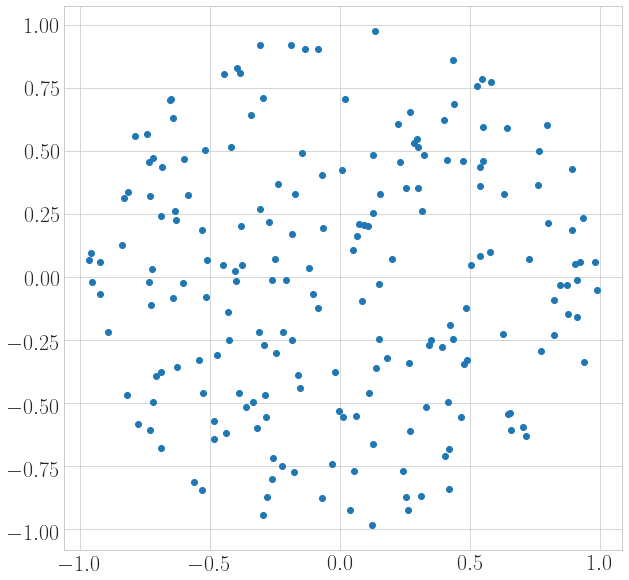

In [25]:
## Trying with a random non-orthonormal basis that's all in the same direction
n=200
x=np.random.uniform(size=(n,n))
#basis=gram_schmidt_columns(x)
basis=[normalize(x[i,:]) for i in range(x.shape[0])]
v=sample_from_ball(n,d=2)
B=np.transpose(np.vstack(tuple([e for e in v])))
#v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
#v=[v[:,i] for i in range(v.shape[1])]
#B=np.transpose(np.vstack(tuple([e for e in v])))

#print(f'v:{v}')
plt.plot([e[0] for e in v],[e[1] for e in v],'o',label='Input vector')
a,b=-np.ones(n),np.ones(n)
gsw_xs=[]
rand_xs=[]
for i in range(n):
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
    gsw_xs.append(gram_schmidt_walk(v,np.zeros(n),a,b,False,False,False,basis))
plt.plot([np.matmul(B,x)[0] for x in gsw_xs],[np.matmul(B,x)[1] for x in gsw_xs],'o',label='Output sum of groups with GSW different basis')
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',label='Output sum of random groups in different basis')

plt.legend()
plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"4types_{n}.tex")
counts = [x for x in list(zip(*np.unique(gsw_xs, return_counts = True, axis = 0))) if x[1]>1]
print(counts)

In [ ]:
print(gsw_xs)

In [22]:
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=n here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=100
v=sample_from_ball(int(n/2),d=n)
subteam = [0] * int(n-4) + [1/2] * 4
for i in range(int(n/2)):
    random.shuffle(subteam)
    v.append(subteam.copy())
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(n):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n/2])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[int(n/2):]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:int(n/2)]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:194: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 5.632696869526155
Average time step of coloring of structured elements: 42.38
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #1
Output norm: 5.3448482858229225
Average time step of coloring of structured elements: 48.68
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #2
Output norm: 4.909550732249168
Average time step of coloring of structured elements: 50.88
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:4.0

 Try #3
Output norm: 4.9829038071077285
Average time step of coloring of structured elements: 45.92
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:0.0

 Try #4
Output norm: 5.0564546231419945
Average time step of coloring of structured elements: 46.82
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:

Output norm: 5.200401710835154
Average time step of coloring of structured elements: 47.1
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

 Try #42
Output norm: 5.137826043989671
Average time step of coloring of structured elements: 45.86
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:0.0

 Try #43
Output norm: 5.195520810818796
Average time step of coloring of structured elements: 44.1
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:2.0

 Try #44
Output norm: 4.848828486652301
Average time step of coloring of structured elements: 50.52
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:4.0

 Try #45
Output norm: 5.051221761144401
Average time step of coloring of structured elements: 51.16
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0

Output norm: 5.379230101419362
Average time step of coloring of structured elements: 43.06
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:6.0

 Try #83
Output norm: 5.779698557382555
Average time step of coloring of structured elements: 47.04
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:8.0

 Try #84
Output norm: 4.890240313246613
Average time step of coloring of structured elements: 46.68
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:4.0

 Try #85
Output norm: 5.960054623691782
Average time step of coloring of structured elements: 53.54
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:10.0

 Try #86
Output norm: 5.4959875157610965
Average time step of coloring of structured elements: 41.88
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured poin

In [ ]:
#Try the same with deterministic, with different definittions of structured and n's

In [23]:
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=100
v=sample_from_ball(int(n/2),d=n)
subteam = [0] * int(np.sqrt(n)-4) + [1/2] * 4
for i in range(int(n/2)):
    random.shuffle(subteam)
    v.append(np.array(subteam.copy()+[0]*(n-int(np.sqrt(n)))))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(n):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n/2])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[int(n/2):]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:int(n/2)]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:194: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 4.873146026211153
Average time step of coloring of structured elements: 45.64
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:2.0

 Try #1
Output norm: 4.443118719494569
Average time step of coloring of structured elements: 48.72
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:4.0

 Try #2
Output norm: 4.655167943514522
Average time step of coloring of structured elements: 54.94
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:4.0

 Try #3
Output norm: 4.376316105036608
Average time step of coloring of structured elements: 46.2
Coloring discrepancy among structured points:1.1102230246251565e-16
Coloring discrepancy among non-structured points:4.0

 Try #4
Output norm: 5.214539021448999
Average time step of coloring of structured elements: 42.38
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-str

Output norm: 4.785649129078561
Average time step of coloring of structured elements: 49.3
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:4.0

 Try #41
Output norm: 5.014611505336998
Average time step of coloring of structured elements: 48.5
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:2.0

 Try #42
Output norm: 4.904999908444628
Average time step of coloring of structured elements: 53.92
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #43
Output norm: 4.67219915924073
Average time step of coloring of structured elements: 41.22
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:6.0

 Try #44
Output norm: 5.407199848227176
Average time step of coloring of structured elements: 45.58
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:8.

Output norm: 5.343720495507724
Average time step of coloring of structured elements: 47.78
Coloring discrepancy among structured points:2.0000000000000004
Coloring discrepancy among non-structured points:0.0

 Try #81
Output norm: 4.561819801445875
Average time step of coloring of structured elements: 48.7
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #82
Output norm: 4.699205824705529
Average time step of coloring of structured elements: 52.26
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:4.0

 Try #83
Output norm: 4.975307674239176
Average time step of coloring of structured elements: 53.98
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #84
Output norm: 4.613767266171442
Average time step of coloring of structured elements: 55.54
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-str

In [27]:
#Now with deterministic GSW
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
v=sample_from_ball(int(n/2),d=n)
subteam = [0] * int(np.sqrt(n)-4) + [1/2] * 4
for i in range(int(n/2)):
    random.shuffle(subteam)
    v.append(np.array(subteam.copy()+[0]*(n-int(np.sqrt(n)))))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(n):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n/2])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[int(n/2):]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:int(n/2)]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:194: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 6.149347349553507
Average time step of coloring of structured elements: 97.69
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:14.0

 Try #1
Output norm: 6.386243920442948
Average time step of coloring of structured elements: 103.76
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:22.0

 Try #2
Output norm: 6.1620640807079345
Average time step of coloring of structured elements: 94.62
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:34.0

 Try #3
Output norm: 6.2819039633525415
Average time step of coloring of structured elements: 97.93
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:32.0

 Try #4
Output norm: 6.587224805638467
Average time step of coloring of structured elements: 105.59
Coloring discrepancy among structured points:2.220446049250313e-16
Coloring discrepancy among

Output norm: 6.324172220296954
Average time step of coloring of structured elements: 99.98
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:40.0

 Try #41
Output norm: 6.474675960162823
Average time step of coloring of structured elements: 107.57
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:34.0

 Try #42
Output norm: 6.875853079954677
Average time step of coloring of structured elements: 96.13
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:26.0

 Try #43
Output norm: 6.356649597628991
Average time step of coloring of structured elements: 103.17
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:36.0

 Try #44
Output norm: 6.72394093063865
Average time step of coloring of structured elements: 98.5
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured po

Output norm: 6.931828129612244
Average time step of coloring of structured elements: 98.91
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:22.0

 Try #82
Output norm: 6.392665144013921
Average time step of coloring of structured elements: 105.56
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:44.0

 Try #83
Output norm: 6.533454383449715
Average time step of coloring of structured elements: 104.32
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:16.0

 Try #84
Output norm: 6.846959180803074
Average time step of coloring of structured elements: 97.91
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:30.0

 Try #85
Output norm: 6.798829581012907
Average time step of coloring of structured elements: 94.24
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured 

Output norm: 6.726801096499067
Average time step of coloring of structured elements: 102.53
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:24.0

 Try #122
Output norm: 6.585466346849297
Average time step of coloring of structured elements: 108.05
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:32.0

 Try #123
Output norm: 6.1164187868017885
Average time step of coloring of structured elements: 101.18
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:26.0

 Try #124
Output norm: 5.984503604461025
Average time step of coloring of structured elements: 104.34
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:22.0

 Try #125
Output norm: 6.326905492846523
Average time step of coloring of structured elements: 100.15
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-str

Output norm: 6.4791776743475795
Average time step of coloring of structured elements: 98.15
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:20.0

 Try #162
Output norm: 6.426449728406285
Average time step of coloring of structured elements: 102.46
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:14.0

 Try #163
Output norm: 6.456926004723252
Average time step of coloring of structured elements: 108.26
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:22.0

 Try #164
Output norm: 6.538438219148269
Average time step of coloring of structured elements: 89.34
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:28.0

 Try #165
Output norm: 6.413120604780446
Average time step of coloring of structured elements: 96.67
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-struct

In [28]:
#Now with deterministic GSW and with much smaller structured group
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(np.sqrt(n))
v=sample_from_ball(n-structured,d=n)
subteam = [0] * int(structured-4) + [1/2] * 4
for i in range(structured):
    random.shuffle(subteam)
    v.append(np.array(subteam.copy()+[0]*(n-structured)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(n):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:194: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 6.326830484088131
Average time step of coloring of structured elements: 48.857142857142854
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:34.0

 Try #1
Output norm: 6.54172525914891
Average time step of coloring of structured elements: 67.57142857142857
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:36.0

 Try #2
Output norm: 6.728668097903917
Average time step of coloring of structured elements: 23.071428571428573
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:30.0

 Try #3
Output norm: 7.402567490976052
Average time step of coloring of structured elements: 49.714285714285715
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:24.0

 Try #4
Output norm: 6.943208868178591
Average time step of coloring of structured elements: 50.57142857142857
Coloring discrepancy among structur

Output norm: 6.980112832515811
Average time step of coloring of structured elements: 53.5
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:32.0

 Try #40
Output norm: 6.638431042316581
Average time step of coloring of structured elements: 36.142857142857146
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:10.0

 Try #41
Output norm: 6.720196260340057
Average time step of coloring of structured elements: 47.57142857142857
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:28.0

 Try #42
Output norm: 6.693462691135282
Average time step of coloring of structured elements: 67.28571428571429
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:40.0

 Try #43
Output norm: 6.540645359589465
Average time step of coloring of structured elements: 46.357142857142854
Coloring discrepancy among structured points

Output norm: 6.890579948482908
Average time step of coloring of structured elements: 37.357142857142854
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:50.0

 Try #79
Output norm: 6.707638292635915
Average time step of coloring of structured elements: 66.78571428571429
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:22.0

 Try #80
Output norm: 6.918770726904829
Average time step of coloring of structured elements: 58.214285714285715
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:48.0

 Try #81
Output norm: 6.7405712410100795
Average time step of coloring of structured elements: 39.142857142857146
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:46.0

 Try #82
Output norm: 6.583682906372139
Average time step of coloring of structured elements: 67.35714285714286
Coloring discrepancy among st

Output norm: 6.72213599511748
Average time step of coloring of structured elements: 44.785714285714285
Coloring discrepancy among structured points:1.1102230246251565e-16
Coloring discrepancy among non-structured points:40.0

 Try #117
Output norm: 6.808129374189569
Average time step of coloring of structured elements: 66.07142857142857
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:46.0

 Try #118
Output norm: 6.831246560518086
Average time step of coloring of structured elements: 27.785714285714285
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:18.0

 Try #119
Output norm: 6.956002168156931
Average time step of coloring of structured elements: 69.71428571428571
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:34.0

 Try #120
Output norm: 7.166291707951131
Average time step of coloring of structured elements: 53.57142857142857
Coloring 

Output norm: 6.771172157276082
Average time step of coloring of structured elements: 52.285714285714285
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:16.0

 Try #155
Output norm: 7.028261574852213
Average time step of coloring of structured elements: 47.857142857142854
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:66.0

 Try #156
Output norm: 6.4904994075056885
Average time step of coloring of structured elements: 26.428571428571427
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:22.0

 Try #157
Output norm: 6.2655570713453725
Average time step of coloring of structured elements: 29.857142857142858
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:38.0

 Try #158
Output norm: 7.123439344883662
Average time step of coloring of structured elements: 47.357142857142854
Coloring discrepancy a

Output norm: 6.584836496838216
Average time step of coloring of structured elements: 55.57142857142857
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:34.0

 Try #194
Output norm: 6.748349715739631
Average time step of coloring of structured elements: 41.92857142857143
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:28.0

 Try #195
Output norm: 7.082003070173378
Average time step of coloring of structured elements: 42.42857142857143
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:40.0

 Try #196
Output norm: 6.847695058477413
Average time step of coloring of structured elements: 42.285714285714285
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:24.0

 Try #197
Output norm: 6.336305782027889
Average time step of coloring of structured elements: 66.92857142857143
Coloring discrepancy among s

In [29]:
#Now with deterministic GSW and with much smaller structured group and n=1000
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=1000
structured=int(np.sqrt(n))
v=sample_from_ball(n-structured,d=n)
subteam = [0] * int(structured-4) + [1/2] * 4
for i in range(structured):
    random.shuffle(subteam)
    v.append(np.array(subteam.copy()+[0]*(n-structured)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(10):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:194: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 15.395904525463505
Average time step of coloring of structured elements: 194.38709677419354
Coloring discrepancy among structured points:3.0
Coloring discrepancy among non-structured points:165.0

 Try #1
Output norm: 15.129006437864984
Average time step of coloring of structured elements: 264.1290322580645
Coloring discrepancy among structured points:1.0
Coloring discrepancy among non-structured points:219.0

 Try #2
Output norm: 15.360975474665619
Average time step of coloring of structured elements: 293.5483870967742
Coloring discrepancy among structured points:5.0
Coloring discrepancy among non-structured points:181.0

 Try #3
Output norm: 16.000697905107604
Average time step of coloring of structured elements: 263.03225806451616
Coloring discrepancy among structured points:3.0
Coloring discrepancy among non-structured points:209.0

 Try #4
Output norm: 15.750435134411715
Average time step of coloring of structured elements: 277.5483870967742
Coloring discrepancy among

LinAlgError: SVD did not converge in Linear Least Squares

In [ ]:
#The structured points seem to be colored early as well.

In [36]:
#Now with deterministic GSW and with much smaller structured group but with noise in ustructured part
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(np.sqrt(n))
v=sample_from_ball(n-structured,d=n)
subteam = [0] * int(structured-4) + [1/2] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_from_ball(1,d=n-structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))*10/structured),axis=0)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(100):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:194: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 6.965955443157044
Average time step of coloring of structured elements: 65.21428571428571
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:42.0

 Try #1
Output norm: 7.119353817212681
Average time step of coloring of structured elements: 100.5
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:36.0

 Try #2
Output norm: 6.992110646375976
Average time step of coloring of structured elements: 79.14285714285714
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:22.0

 Try #3
Output norm: 6.794905086496964
Average time step of coloring of structured elements: 113.85714285714286
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:28.0

 Try #4
Output norm: 7.108132678938077
Average time step of coloring of structured elements: 94.14285714285714
Coloring discrepancy among structured points:0.0

Output norm: 6.501142877600162
Average time step of coloring of structured elements: 107.28571428571429
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:40.0

 Try #40
Output norm: 6.532222793859662
Average time step of coloring of structured elements: 64.78571428571429
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:32.0

 Try #41
Output norm: 7.230440094869698
Average time step of coloring of structured elements: 96.64285714285714
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:42.0

 Try #42
Output norm: 6.46328813008919
Average time step of coloring of structured elements: 82.71428571428571
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:20.0

 Try #43
Output norm: 6.850840572496975
Average time step of coloring of structured elements: 83.35714285714286
Coloring discrepancy among struct

Output norm: 6.8208029073192105
Average time step of coloring of structured elements: 94.92857142857143
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:36.0

 Try #79
Output norm: 6.651281725981329
Average time step of coloring of structured elements: 72.5
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:26.0

 Try #80
Output norm: 6.41665365382986
Average time step of coloring of structured elements: 95.07142857142857
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:26.0

 Try #81
Output norm: 7.15334598075034
Average time step of coloring of structured elements: 66.14285714285714
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:30.0

 Try #82
Output norm: 6.482354011737262
Average time step of coloring of structured elements: 98.14285714285714
Coloring discrepancy among structured points:0.

In [37]:
#Now with deterministic GSW and with much smaller structured group but with noise in ustructured part that is bigger than before
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(np.sqrt(n))
v=sample_from_ball(n-structured,d=n)
subteam = [0] * int(structured-4) + [1/2] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_from_ball(1,d=n-structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))*100/structured),axis=0)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(100):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:194: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 6.7999931093924175
Average time step of coloring of structured elements: 91.71428571428571
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:44.0

 Try #1
Output norm: 6.645006279734558
Average time step of coloring of structured elements: 84.78571428571429
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:22.0

 Try #2
Output norm: 6.598119724553039
Average time step of coloring of structured elements: 95.85714285714286
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:50.0

 Try #3
Output norm: 6.568192809680166
Average time step of coloring of structured elements: 86.21428571428571
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:42.0

 Try #4
Output norm: 6.535399540347885
Average time step of coloring of structured elements: 78.14285714285714
Coloring discrepancy among structure

Output norm: 7.19515652620214
Average time step of coloring of structured elements: 104.5
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:26.0

 Try #40
Output norm: 6.640108440889928
Average time step of coloring of structured elements: 103.42857142857143
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:38.0

 Try #41
Output norm: 7.019268516694043
Average time step of coloring of structured elements: 79.78571428571429
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:52.0

 Try #42
Output norm: 6.908072594839158
Average time step of coloring of structured elements: 104.71428571428571
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:64.0

 Try #43
Output norm: 7.085584408035535
Average time step of coloring of structured elements: 124.42857142857143
Coloring discrepancy among structured point

Output norm: 6.598916143894153
Average time step of coloring of structured elements: 100.64285714285714
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:16.0

 Try #79
Output norm: 7.047223336863335
Average time step of coloring of structured elements: 102.28571428571429
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:34.0

 Try #80
Output norm: 6.906673641203654
Average time step of coloring of structured elements: 114.14285714285714
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:42.0

 Try #81
Output norm: 6.879022812388563
Average time step of coloring of structured elements: 89.0
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:52.0

 Try #82
Output norm: 6.29725948083593
Average time step of coloring of structured elements: 81.5
Coloring discrepancy among structured points:6.0
Coloring

In [38]:
#Now with deterministic GSW and with much smaller structured group but with noise in ustructured part that is even bigger than before
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(np.sqrt(n))
v=sample_from_ball(n-structured,d=n)
subteam = [0] * int(structured-4) + [1/2] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_from_ball(1,d=n-structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))*1000/structured),axis=0)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(100):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:194: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 6.61000599893671
Average time step of coloring of structured elements: 104.14285714285714
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:50.0

 Try #1
Output norm: 7.277883098727375
Average time step of coloring of structured elements: 93.78571428571429
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:34.0

 Try #2
Output norm: 6.9269403932255225
Average time step of coloring of structured elements: 81.35714285714286
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:20.0

 Try #3
Output norm: 6.209474504800323
Average time step of coloring of structured elements: 91.07142857142857
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:48.0

 Try #4
Output norm: 6.670245532702724
Average time step of coloring of structured elements: 110.57142857142857
Coloring discrepancy among structur

Output norm: 6.4963787859709
Average time step of coloring of structured elements: 85.35714285714286
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:46.0

 Try #40
Output norm: 6.563026122077279
Average time step of coloring of structured elements: 94.57142857142857
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:44.0

 Try #41
Output norm: 6.755620699753388
Average time step of coloring of structured elements: 110.5
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:36.0

 Try #42
Output norm: 7.115623423509565
Average time step of coloring of structured elements: 101.07142857142857
Coloring discrepancy among structured points:8.0
Coloring discrepancy among non-structured points:30.0

 Try #43
Output norm: 6.96103635142451
Average time step of coloring of structured elements: 106.5
Coloring discrepancy among structured points:4.0
Coloring d

Output norm: 6.668480746800915
Average time step of coloring of structured elements: 94.14285714285714
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:34.0

 Try #79
Output norm: 6.982386931451039
Average time step of coloring of structured elements: 97.78571428571429
Coloring discrepancy among structured points:8.0
Coloring discrepancy among non-structured points:60.0

 Try #80
Output norm: 6.817823727282866
Average time step of coloring of structured elements: 105.07142857142857
Coloring discrepancy among structured points:8.0
Coloring discrepancy among non-structured points:40.0

 Try #81
Output norm: 6.960051389649485
Average time step of coloring of structured elements: 109.0
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:66.0

 Try #82
Output norm: 6.4749090269977305
Average time step of coloring of structured elements: 69.42857142857143
Coloring discrepancy among structured point

In [30]:
#Now with naive walk and with much smaller structured group but with noise in ustructured part that is even bigger than before
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(np.sqrt(n))
v=sample_from_ball(n-structured,d=n)
subteam = [0] * int(structured-4) + [1/2] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_from_ball(1,d=n-structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))*1000/structured),axis=0)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(100):
    print(f'\n Try #{i}')
    res=naive_walk(v)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0
Output norm: 7.859989478849407
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:30.0

 Try #1
Output norm: 7.5415076749785355
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:22.0

 Try #2
Output norm: 8.205159403375825
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:26.0

 Try #3
Output norm: 7.98469387066081
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:6.0

 Try #4
Output norm: 7.233200377918617
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:30.0

 Try #5
Output norm: 8.363454541032619
Coloring discrepancy among structured points:8.0
Coloring discrepancy among non-structured points:2.0

 Try #6
Output norm: 8.042933123437654
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:14.0



Output norm: 8.28352318055825
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:14.0

 Try #66
Output norm: 7.92430879463581
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:10.0

 Try #67
Output norm: 7.982920430831795
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:2.0

 Try #68
Output norm: 7.4438143899375335
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:8.0

 Try #69
Output norm: 7.281813386828075
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:12.0

 Try #70
Output norm: 7.3889472128780085
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:22.0

 Try #71
Output norm: 7.715401983857203
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:8.0

 Try

In [63]:
#Now with deterministic GSW and with much smaller structured group but with 0-1 vectors
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(np.sqrt(n))
v=sample_binary(n-structured,d=n)
subteam = [0] * int(structured-4) + [1] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_binary(1,d=n-structured)
    v.append(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))),axis=0))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(100):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:204: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 50.950956811427986
Average time step of coloring of structured elements: 75.92857142857143
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:6.0

 Try #1
Output norm: 53.47896782848375
Average time step of coloring of structured elements: 110.28571428571429
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:6.0

 Try #2
Output norm: 49.79959839195493
Average time step of coloring of structured elements: 93.57142857142857
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #3
Output norm: 52.64978632435273
Average time step of coloring of structured elements: 84.35714285714286
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:2.0

 Try #4
Output norm: 50.872389367907616
Average time step of coloring of structured elements: 82.57142857142857
Coloring discrepancy among structured 

Output norm: 55.09990925582364
Average time step of coloring of structured elements: 93.14285714285714
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:1.1102230246251565e-16

 Try #40
Output norm: 50.950956811427986
Average time step of coloring of structured elements: 84.35714285714286
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:4.0

 Try #41
Output norm: 49.91993589739474
Average time step of coloring of structured elements: 72.57142857142857
Coloring discrepancy among structured points:10.0
Coloring discrepancy among non-structured points:8.0

 Try #42
Output norm: 47.32863826479693
Average time step of coloring of structured elements: 74.07142857142857
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:4.0

 Try #43
Output norm: 51.65268628057983
Average time step of coloring of structured elements: 97.85714285714286
Coloring discrep

Output norm: 50.75431016179808
Average time step of coloring of structured elements: 91.71428571428571
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #79
Output norm: 51.146847410177685
Average time step of coloring of structured elements: 98.07142857142857
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

 Try #80
Output norm: 50.35871324805669
Average time step of coloring of structured elements: 70.57142857142857
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:4.0

 Try #81
Output norm: 54.4426303552648
Average time step of coloring of structured elements: 86.14285714285714
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

 Try #82
Output norm: 51.10772935672255
Average time step of coloring of structured elements: 89.64285714285714
Coloring discrepancy among structured

In [64]:
#Now with deterministic GSW and with n/2 structured group but with 0-1 vectors
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(n/2)
v=sample_binary(n-structured,d=n)
subteam = [0] * int(structured-4) + [1] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_binary(1,d=n-structured)
    v.append(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))),axis=0))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(100):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:204: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 46.87216658103186
Average time step of coloring of structured elements: 73.5
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #1
Output norm: 42.906875905849866
Average time step of coloring of structured elements: 78.83
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #2
Output norm: 47.54997371187496
Average time step of coloring of structured elements: 82.1
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:0.0

 Try #3
Output norm: 50.882216932834204
Average time step of coloring of structured elements: 73.92
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #4
Output norm: 45.35416188179427
Average time step of coloring of structured elements: 79.58
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

Output norm: 45.880278987817846
Average time step of coloring of structured elements: 82.86
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

 Try #42
Output norm: 49.84977432245807
Average time step of coloring of structured elements: 76.32
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:2.0

 Try #43
Output norm: 44.82186966202994
Average time step of coloring of structured elements: 80.87
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #44
Output norm: 43.60045871318328
Average time step of coloring of structured elements: 82.22
Coloring discrepancy among structured points:1.1102230246251565e-16
Coloring discrepancy among non-structured points:0.0

 Try #45
Output norm: 47.042533945356304
Average time step of coloring of structured elements: 80.31
Coloring discrepancy among structured points:4.0
Coloring discrepancy among 

Output norm: 46.52956049652737
Average time step of coloring of structured elements: 78.08
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:0.0

 Try #83
Output norm: 45.13313638558703
Average time step of coloring of structured elements: 85.43
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:0.0

 Try #84
Output norm: 46.184412955021955
Average time step of coloring of structured elements: 78.62
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #85
Output norm: 47.25462940284264
Average time step of coloring of structured elements: 75.46
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:2.0

 Try #86
Output norm: 42.485291572496
Average time step of coloring of structured elements: 76.51
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:

In [65]:
#Now with deterministic GSW and with much smaller structured group but with 0-1 vectors that are normalized
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(np.sqrt(n))
v=sample_binary(n-structured,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])
subteam = [0] * int(structured-4) + [1] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_binary(1,d=n-structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))),axis=0)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(100):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:204: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 5.259577841388541
Average time step of coloring of structured elements: 86.0
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:2.0

 Try #1
Output norm: 5.119221396352396
Average time step of coloring of structured elements: 83.21428571428571
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #2
Output norm: 5.050642883576685
Average time step of coloring of structured elements: 103.57142857142857
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #3
Output norm: 5.138960538726464
Average time step of coloring of structured elements: 99.28571428571429
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:4.0

 Try #4
Output norm: 4.897005150293429
Average time step of coloring of structured elements: 89.71428571428571
Coloring discrepancy among structured points:2.0
Colo

Output norm: 5.218453804165391
Average time step of coloring of structured elements: 76.92857142857143
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

 Try #40
Output norm: 5.072317245824143
Average time step of coloring of structured elements: 104.64285714285714
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:2.0

 Try #41
Output norm: 5.243979671782766
Average time step of coloring of structured elements: 77.21428571428571
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #42
Output norm: 4.908294606125224
Average time step of coloring of structured elements: 108.64285714285714
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:6.0

 Try #43
Output norm: 5.1434188627392885
Average time step of coloring of structured elements: 83.14285714285714
Coloring discrepancy among structu

Output norm: 4.712807675859024
Average time step of coloring of structured elements: 75.28571428571429
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #79
Output norm: 4.8342802994400484
Average time step of coloring of structured elements: 99.92857142857143
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:6.0

 Try #80
Output norm: 5.0832150237150495
Average time step of coloring of structured elements: 96.35714285714286
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #81
Output norm: 4.825756554093671
Average time step of coloring of structured elements: 104.21428571428571
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

 Try #82
Output norm: 5.258256841904287
Average time step of coloring of structured elements: 94.85714285714286
Coloring discrepancy among structu

In [66]:
#Now with deterministic GSW and with much n/2 structured group but with 0-1 vectors that are normalized
#Trying with half structured in dimension 200, where structured are such that they have four 1's in the first m (m=n/2 here) coordinates and all 0's everywhere else in the first part and even spread in the second part.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(n/2)
v=sample_binary(n-structured,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])
subteam = [0] * int(structured-4) + [1] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_binary(1,d=n-structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))),axis=0)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(100):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:204: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 5.405906873638027
Average time step of coloring of structured elements: 101.37
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:4.0

 Try #1
Output norm: 4.79875515553884
Average time step of coloring of structured elements: 101.3
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #2
Output norm: 4.812712466621918
Average time step of coloring of structured elements: 91.71
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #3
Output norm: 5.087872834601378
Average time step of coloring of structured elements: 93.97
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

 Try #4
Output norm: 5.2061945653432495
Average time step of coloring of structured elements: 97.41
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.

Output norm: 5.256488086766064
Average time step of coloring of structured elements: 97.45
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #42
Output norm: 5.374313421219345
Average time step of coloring of structured elements: 87.93
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #43
Output norm: 5.1867257841464
Average time step of coloring of structured elements: 97.07
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #44
Output norm: 5.200574965248875
Average time step of coloring of structured elements: 94.38
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #45
Output norm: 4.835438086596511
Average time step of coloring of structured elements: 84.18
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0

Output norm: 4.97545542216702
Average time step of coloring of structured elements: 90.1
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:2.0

 Try #83
Output norm: 5.238800727541338
Average time step of coloring of structured elements: 89.87
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:2.0

 Try #84
Output norm: 4.722296370257203
Average time step of coloring of structured elements: 86.82
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0

 Try #85
Output norm: 5.032429359525367
Average time step of coloring of structured elements: 83.91
Coloring discrepancy among structured points:4.0
Coloring discrepancy among non-structured points:2.0

 Try #86
Output norm: 5.247019352099304
Average time step of coloring of structured elements: 84.44
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2

In [33]:
#Now with deterministic GSW and with much n/2 structured group but with 0-1 vectors that are normalized
#Trying with half structured in dimension 200, where structured are such that they have four 1's in the first 20  coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(n/10)
v=sample_binary(n-structured,d=n,p=4/structured)
for i in range(len(v)):
    v[i]=normalize(v[i])
subteam = [0] * int(structured-4) + [1] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_binary(1,d=n-structured,p=4/structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))),axis=0)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(10):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:296: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:78: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 6.448909376507512
Average time step of coloring of structured elements: 97.9
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:4.0

 Try #1
Output norm: 6.373972858337186
Average time step of coloring of structured elements: 99.5
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:6.0

 Try #2
Output norm: 6.38346607856142
Average time step of coloring of structured elements: 98.75
Coloring discrepancy among structured points:8.0
Coloring discrepancy among non-structured points:10.0

 Try #3
Output norm: 6.296310228522195
Average time step of coloring of structured elements: 115.4
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:6.0

 Try #4
Output norm: 6.4913137905824225
Average time step of coloring of structured elements: 92.2
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:8.0



In [27]:
#Now with deterministic GSW and with much n/20 structured group but with 0-1 vectors that are normalized
#Trying with half structured in dimension 200, where structured are such that they have four 1's in the first 10 coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(n/20)
v=sample_binary(n-structured,d=n,p=4/structured)
for i in range(len(v)):
    v[i]=normalize(v[i])
subteam = [0] * int(structured-4) + [1] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_binary(1,d=n-structured,p=0)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))),axis=0)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(10):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0
v_perp:[-2.573e-03 2.573e-03 -2.573e-03 -2.573e-03 2.573e-03 2.573e-03 -2.573e-03
 2.573e-03 2.573e-03 -2.573e-03 7.114e-03 2.393e-04 5.737e-04 -6.237e-03
 7.041e-03 -2.989e-03 1.372e-03 -5.378e-03 -5.937e-03 5.309e-03 -3.566e-03
 -3.167e-03 1.987e-03 3.066e-03 -3.101e-03 -1.937e-03 -3.349e-03
 -3.254e-03 -1.156e-03 -1.939e-03 -4.661e-03 -9.641e-04 4.792e-03
 2.634e-03 -8.451e-04 -3.358e-03 1.087e-04 -2.418e-03 -1.477e-03
 -2.276e-03 -2.373e-03 8.733e-04 -1.359e-03 1.075e-02 -1.675e-03
 -2.107e-03 -2.138e-03 -3.094e-04 4.415e-04 2.408e-04 -3.236e-03 1.928e-03
 -2.796e-03 1.400e-03 -2.013e-03 4.464e-03 5.015e-04 -1.574e-03 -9.691e-06
 4.584e-03 -2.518e-03 1.052e-04 -4.719e-03 3.490e-03 4.982e-03 -9.546e-05
 3.739e-03 1.554e-03 3.832e-03 -4.798e-03 -5.006e-03 2.557e-03 -1.435e-03
 3.149e-04 -5.012e-03 1.528e-03 -8.433e-03 4.534e-03 4.711e-03 -5.040e-03
 -2.528e-03 1.373e-03 -7.019e-03 -2.162e-03 -4.809e-03 3.187e-03 1.026e-03
 -2.579e-03 -3.728e-03 3.468e-03 8.244e-03 5.876e-03 

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


v_perp:[-1.013e-03 7.017e-05 -2.899e-03 -2.899e-03 1.956e-03 3.842e-03 -1.013e-03
 3.842e-03 1.956e-03 -1.013e-03 6.190e-03 -3.543e-03 -1.002e-02 -1.470e-02
 7.462e-03 -3.215e-04 9.551e-03 -7.426e-03 -4.147e-05 -6.267e-03
 -1.351e-03 -2.143e-03 -4.029e-04 -6.401e-05 -3.916e-03 -2.972e-03
 -1.014e-02 -1.619e-03 -1.655e-03 -1.609e-03 -1.495e-03 6.891e-03
 4.783e-03 1.369e-03 3.965e-03 -3.844e-03 2.219e-04 -6.461e-03 -5.606e-03
 -5.134e-03 -3.002e-03 1.351e-03 1.343e-02 7.903e-03 1.223e-03 6.330e-03
 -6.425e-03 5.181e-03 1.307e-02 -7.032e-03 4.198e-04 3.193e-03 5.682e-03
 -7.748e-05 1.292e-03 5.618e-03 2.348e-03 -9.057e-03 -4.096e-03 -6.446e-03
 8.218e-04 2.319e-03 -5.421e-03 4.130e-03 5.307e-03 1.755e-03 5.618e-03
 -7.256e-03 5.427e-03 -1.965e-03 -1.099e-02 -3.397e-03 -1.089e-02
 2.328e-03 1.138e-03 6.348e-03 -2.520e-03 5.170e-03 9.231e-03 -6.383e-03
 2.705e-03 9.913e-04 -3.372e-03 2.349e-03 1.801e-04 7.699e-03 7.828e-03
 -2.215e-03 -1.062e-03 9.191e-03 5.451e-03 -2.922e-03 -2.468e-03 6.

 -4.584e-03 3.399e-04 -1.187e-03]
v_perp-sum u_i*v_i:[6.281e-04 9.803e-04 3.845e-03 3.845e-03 -2.237e-03 -5.453e-03 6.281e-04
 -5.453e-03 -2.237e-03 6.281e-04 -9.915e-03 -2.646e-03 -5.880e-03
 1.326e-04 -4.572e-03 5.098e-03 -1.142e-02 9.034e-03 7.752e-03 -1.067e-03
 3.528e-03 6.186e-04 -4.536e-03 7.010e-03 8.814e-03 -9.850e-03 6.649e-04
 4.651e-03 5.989e-03 1.082e-02 8.720e-03 6.078e-03 1.475e-03 1.712e-04
 -1.743e-03 -5.891e-03 -1.080e-03 -4.882e-03 -1.118e-03 3.185e-04
 3.352e-03 3.322e-03 6.195e-03 -1.825e-02 7.402e-03 -1.698e-03 -2.627e-03
 6.081e-03 -1.517e-03 -7.214e-03 7.633e-03 -6.293e-03 1.119e-02 -6.065e-03
 -3.887e-03 -3.224e-03 2.240e-03 -1.401e-03 7.969e-04 6.549e-03 1.477e-03
 -8.910e-03 7.990e-04 2.181e-06 -3.064e-03 -1.097e-03 -8.554e-03 2.601e-03
 -2.608e-03 -1.426e-03 5.416e-03 3.215e-03 6.599e-04 1.654e-03 3.643e-03
 8.432e-04 1.274e-02 1.615e-03 -1.111e-02 5.613e-03 -6.419e-04 1.912e-03
 7.567e-03 7.316e-03 9.035e-03 -7.190e-03 2.018e-03 5.594e-03 4.920e-03
 -7.760e

 -4.030e-04 -1.334e-02 1.397e-02 5.870e-03 1.076e-03]
v_perp-sum u_i*v_i:[-1.351e-03 4.929e-04 -2.069e-04 -7.789e-04 4.929e-04 4.929e-04 -7.789e-04
 4.929e-04 1.065e-03 -2.069e-04 1.949e-03 6.274e-04 2.308e-03 5.720e-04
 1.052e-03 -4.947e-04 -5.721e-04 -7.249e-04 -2.765e-03 4.100e-03
 -1.291e-03 -7.617e-04 1.230e-03 1.387e-03 -9.650e-04 6.919e-06 8.778e-04
 -6.640e-04 -4.073e-04 -7.405e-04 -1.707e-03 -1.959e-03 1.257e-03
 4.889e-04 -1.147e-03 -8.555e-04 3.343e-04 2.178e-04 7.486e-04 -3.789e-04
 -2.034e-04 3.825e-04 -3.555e-03 2.811e-03 -1.219e-03 -2.536e-03 1.390e-03
 -1.632e-03 -2.036e-03 1.800e-03 -1.609e-03 6.459e-04 -2.691e-03 7.100e-04
 -7.711e-04 5.977e-04 -2.343e-04 1.050e-03 1.535e-03 2.762e-03 -1.841e-03
 -8.622e-05 -8.252e-04 8.039e-04 9.416e-04 -6.125e-04 7.597e-04 1.623e-03
 4.740e-04 -1.962e-03 3.402e-04 1.326e-03 9.779e-04 -3.944e-04 -2.348e-03
 -1.895e-04 -3.265e-03 1.217e-03 7.962e-04 -7.641e-04 -1.336e-03 7.481e-04
 -2.199e-03 -2.117e-03 -1.849e-03 -6.220e-04 -1.629e-0

Output norm: 4.973246372091392
Average time step of coloring of structured elements: 58.1
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

 Try #3
v_perp:[2.124e-03 -2.124e-03 2.124e-03 2.124e-03 -2.124e-03 -2.124e-03 2.124e-03
 -2.124e-03 -2.124e-03 2.124e-03 -7.985e-03 -4.641e-03 3.094e-03 1.302e-02
 -9.173e-03 -4.989e-04 -2.691e-03 6.905e-03 -1.463e-03 -3.817e-03
 5.663e-03 7.977e-04 -1.725e-03 -6.895e-03 2.881e-03 -4.861e-04 4.720e-03
 8.889e-03 4.836e-03 -2.628e-03 5.292e-03 8.439e-04 -9.526e-03 -3.407e-03
 4.104e-03 6.123e-03 -4.162e-04 5.195e-03 1.005e-03 3.283e-03 -3.012e-03
 -5.618e-03 -7.237e-03 -9.425e-03 1.485e-03 1.224e-03 -2.204e-04 2.350e-03
 -5.919e-03 1.717e-03 4.708e-03 -5.643e-03 2.870e-03 -3.653e-03 3.449e-03
 -3.385e-03 3.207e-03 3.555e-03 -2.386e-03 -1.937e-03 6.439e-03 -5.201e-03
 1.696e-03 -3.394e-03 -6.274e-03 6.671e-04 -3.085e-03 3.631e-03 -5.295e-03
 3.107e-03 6.721e-03 2.053e-03 3.596e-03 -4.495e-03 8.015

Output norm: 5.334810536841566
Average time step of coloring of structured elements: 42.1
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:2.0

 Try #4
v_perp:[-2.509e-03 2.509e-03 -2.509e-03 -2.509e-03 2.509e-03 2.509e-03 -2.509e-03
 2.509e-03 2.509e-03 -2.509e-03 -1.487e-03 6.971e-03 -5.403e-03 -7.406e-03
 -1.959e-03 1.198e-02 1.377e-03 -8.146e-04 -8.273e-03 -5.974e-03
 -4.767e-03 -8.260e-03 4.118e-03 8.613e-03 -1.046e-02 -5.680e-03
 -9.147e-03 -6.693e-03 -2.540e-02 -2.630e-03 -2.076e-03 8.120e-04
 -4.095e-03 -1.196e-02 4.858e-03 -1.013e-02 -4.533e-03 -1.011e-02
 1.684e-03 9.678e-03 -2.103e-03 1.081e-02 5.918e-03 1.529e-02 -4.685e-03
 -7.274e-03 -1.286e-02 1.126e-02 -7.639e-04 5.837e-03 1.176e-03 6.111e-03
 5.077e-03 2.391e-02 -2.640e-04 1.984e-03 1.189e-03 -9.275e-03 1.337e-03
 1.337e-02 -4.403e-03 8.535e-03 -3.698e-03 -2.230e-03 1.480e-02 -4.498e-03
 3.549e-03 -1.212e-02 1.010e-02 7.542e-03 3.394e-04 -8.291e-03 -1.571e-03
 1.058e-02 

Output norm: 5.694837669467971
Average time step of coloring of structured elements: 72.6
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:2.0

 Try #5
v_perp:[7.345e-07 -7.345e-07 7.345e-07 7.345e-07 -7.345e-07 -7.345e-07 7.345e-07
 -7.345e-07 -7.345e-07 7.345e-07 4.892e-04 -4.878e-05 5.311e-04 1.852e-04
 1.459e-03 -1.481e-03 -2.366e-04 -1.050e-03 -6.773e-04 -1.490e-03
 2.263e-03 6.317e-04 -6.614e-04 7.959e-04 2.593e-04 -1.012e-03 -3.260e-04
 1.224e-03 1.610e-03 3.432e-03 2.606e-03 2.491e-03 8.045e-04 -2.490e-04
 3.520e-04 1.345e-03 8.782e-04 -1.793e-03 -1.175e-03 -2.156e-03 -1.116e-03
 -8.542e-04 -2.361e-03 5.101e-04 2.659e-03 1.219e-03 7.901e-04 -1.476e-03
 -5.012e-04 -1.033e-03 8.669e-04 -3.485e-03 1.443e-03 -3.525e-03
 -3.935e-04 -2.191e-03 1.674e-03 1.503e-03 -9.176e-04 -5.093e-04 6.766e-05
 -1.844e-03 -1.452e-04 2.206e-03 3.810e-04 1.681e-03 -3.223e-04 3.723e-03
 -2.192e-03 -1.552e-03 9.352e-05 1.250e-03 -8.706e-04 -1.146e-04 1.12

Output norm: 5.90818139078467
Average time step of coloring of structured elements: 44.9
Coloring discrepancy among structured points:1.1102230246251565e-16
Coloring discrepancy among non-structured points:4.0

 Try #6
v_perp:[-4.208e-04 4.208e-04 -4.208e-04 -4.208e-04 4.208e-04 4.208e-04 -4.208e-04
 4.208e-04 4.208e-04 -4.208e-04 -7.162e-04 1.805e-03 -1.983e-03 -4.354e-03
 7.662e-04 -1.774e-04 7.714e-04 8.192e-04 1.291e-03 4.512e-03 -4.752e-03
 -1.967e-03 -4.244e-04 1.727e-03 -1.777e-03 4.445e-05 7.007e-04 -1.470e-03
 -1.252e-03 -5.798e-03 -4.995e-03 -4.140e-03 1.363e-03 2.245e-03
 -3.528e-03 -3.463e-03 -2.290e-03 4.335e-03 -8.263e-04 1.348e-03 1.730e-03
 1.805e-03 5.454e-03 4.406e-04 -4.116e-03 -1.006e-03 -3.897e-03 4.504e-03
 2.375e-03 1.988e-03 -2.778e-03 7.359e-03 -4.021e-03 3.603e-03 -9.532e-04
 3.350e-03 -3.403e-03 -5.455e-03 2.638e-03 7.275e-04 -4.415e-04 1.274e-03
 -1.787e-03 -3.448e-03 2.540e-03 -2.354e-03 1.029e-03 -6.154e-03 5.836e-03
 1.112e-03 -9.569e-04 -1.393e-03 1.636e

Output norm: 5.852588435365305
Average time step of coloring of structured elements: 45.7
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:2.0

 Try #7
v_perp:[7.985e-05 -7.985e-05 7.985e-05 7.985e-05 -7.985e-05 -7.985e-05 7.985e-05
 -7.985e-05 -7.985e-05 7.985e-05 1.089e-03 2.611e-04 1.725e-03 1.309e-03
 1.037e-03 -1.501e-03 -1.159e-03 -7.966e-04 -1.426e-03 -1.378e-03
 2.430e-03 1.509e-03 2.571e-04 6.803e-04 6.431e-04 -1.047e-03 -1.508e-04
 1.055e-03 1.582e-03 3.678e-03 1.577e-03 2.278e-03 8.289e-04 -2.578e-04
 8.880e-04 9.888e-04 7.742e-04 -2.006e-03 -2.432e-04 -1.271e-03 -6.748e-04
 -1.370e-03 -3.859e-03 9.807e-04 2.491e-03 4.492e-04 1.867e-03 -2.101e-03
 -2.141e-03 9.693e-05 7.049e-04 -4.006e-03 9.401e-04 -3.114e-03 -2.709e-04
 -2.542e-03 1.287e-03 2.486e-03 -6.353e-04 1.330e-04 -7.510e-04 -2.152e-03
 5.858e-04 2.612e-03 -2.486e-04 1.635e-03 -8.817e-04 5.296e-03 -2.823e-03
 -1.955e-03 8.454e-04 1.616e-03 -2.478e-04 -5.460e-04 3.849e-

Output norm: 5.075007893798895
Average time step of coloring of structured elements: 83.3
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #8
v_perp:[3.269e-03 -3.269e-03 3.269e-03 3.269e-03 -3.269e-03 -3.269e-03 3.269e-03
 -3.269e-03 -3.269e-03 3.269e-03 -3.883e-03 -9.029e-03 -3.953e-03
 1.132e-02 -1.234e-02 -6.283e-03 -2.626e-03 3.490e-03 3.724e-03 -9.922e-03
 1.038e-02 5.042e-03 -5.827e-03 -8.779e-03 1.700e-03 -1.707e-03 7.164e-03
 6.409e-03 1.318e-02 -2.123e-03 1.405e-02 4.408e-03 -8.948e-03 4.713e-03
 4.875e-03 5.622e-03 1.840e-03 3.052e-03 3.306e-03 -3.154e-03 -6.271e-03
 -1.378e-02 -5.194e-04 -9.790e-03 -2.718e-03 1.173e-02 -8.730e-03
 2.048e-03 2.306e-03 -4.978e-03 6.186e-03 -1.388e-02 7.436e-03 -1.020e-02
 7.906e-03 -8.385e-03 7.854e-03 -3.309e-03 -6.850e-03 -1.870e-02 1.642e-03
 -6.912e-03 2.916e-03 -3.932e-03 -8.390e-03 6.223e-03 -1.001e-02
 -2.502e-03 -9.795e-03 6.383e-03 2.250e-04 -5.154e-03 -2.021e-03
 -5.450e-03 

Output norm: 5.656452822969217
Average time step of coloring of structured elements: 53.5
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:1.1102230246251565e-16

 Try #9
v_perp:[-1.765e-04 1.765e-04 -1.765e-04 -1.765e-04 1.765e-04 1.765e-04 -1.765e-04
 1.765e-04 1.765e-04 -1.765e-04 1.845e-04 -2.074e-04 -1.987e-03 -3.470e-03
 1.937e-03 4.691e-03 7.112e-04 2.255e-03 2.329e-03 1.837e-03 -4.488e-03
 -2.031e-03 -7.920e-05 8.247e-04 -1.973e-03 1.005e-03 -1.534e-03
 -3.732e-03 -3.774e-03 -5.914e-03 -3.828e-03 -4.644e-03 -8.216e-05
 7.698e-04 -2.683e-03 -1.977e-03 -1.449e-03 1.563e-03 8.124e-05 3.032e-03
 2.458e-03 3.120e-03 8.517e-03 -2.065e-03 -4.249e-03 -1.154e-03 -3.081e-03
 3.438e-03 3.378e-03 2.276e-03 3.328e-05 7.469e-03 -1.922e-04 6.463e-03
 1.103e-03 5.573e-03 -8.418e-04 -4.419e-03 1.650e-03 1.583e-03 -4.224e-04
 3.763e-03 -1.234e-04 -2.956e-03 6.880e-04 -1.771e-03 6.374e-04 -7.291e-03
 3.607e-03 2.948e-03 -2.261e-03 -1.823e-03 4.771e

Output norm: 5.8163257479621535
Average time step of coloring of structured elements: 88.1
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:2.0

 Final breakdown
Average output norm: 5.487032522566961
Average of Average time step of coloring of structured elements: 61.2
Average coloring discrepancy among structured points:1.6
Average coloring discrepancy among non-structured points:1.4


In [39]:
#Now with deterministic GSW and with much n/20 structured group but with 0-1 vectors that are normalized
#Trying with half structured in dimension 200, where structured are such that they have four 1's in the first 10 coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(n/20)
v=sample_binary(n-structured,d=n,p=4/structured)
for i in range(len(v)):
    v[i]=normalize(v[i])
subteam = [0] * int(structured-4) + [1] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_binary(1,d=n-structured,p=4/structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))),axis=0)))
B=np.transpose(np.vstack(tuple([e for e in v])))
gsw_xs=[]
gsw_output_norm=[]
coloring_discrepancy_among_structured=[]
coloring_discrepancy_among_non_structured=[]
coloring_order=[]
avg_time_step_of_coloring_for_structured=[]
for i in range(10):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    gsw_output_norm.append(norm(np.matmul(B,res)))
    print(f'Output norm: {gsw_output_norm[-1]}')
    coloring_order.append(order)
    avg_step_struct=average([j for j in range(len(order)) if order[j]>=n-structured])
    print(f'Average time step of coloring of structured elements: {avg_step_struct}')
    avg_time_step_of_coloring_for_structured.append(avg_step_struct)
    disc_struct=abs(sum(res[n-structured:]))
    coloring_discrepancy_among_structured.append(disc_struct)
    print(f'Coloring discrepancy among structured points:{disc_struct}')
    disc_non_struct=abs(sum(res[:n-structured]))
    coloring_discrepancy_among_non_structured.append(disc_non_struct)
    print(f'Coloring discrepancy among non-structured points:{disc_non_struct}')
    
print(f'\n Final breakdown')
print(f'Average output norm: {average(gsw_output_norm)}')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_structured)}')
print(f'Average coloring discrepancy among structured points:{average(coloring_discrepancy_among_structured)}')
print(f'Average coloring discrepancy among non-structured points:{average(coloring_discrepancy_among_non_structured)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:296: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:78: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Output norm: 5.444595777498934
Average time step of coloring of structured elements: 102.4
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:4.0

 Try #1
Output norm: 5.574568474716206
Average time step of coloring of structured elements: 112.0
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:0.0

 Try #2
Output norm: 5.520727102856221
Average time step of coloring of structured elements: 99.3
Coloring discrepancy among structured points:6.0
Coloring discrepancy among non-structured points:8.0

 Try #3
Output norm: 5.362572973617373
Average time step of coloring of structured elements: 108.0
Coloring discrepancy among structured points:2.0
Coloring discrepancy among non-structured points:4.0

 Try #4
Output norm: 5.515651346280263
Average time step of coloring of structured elements: 107.4
Coloring discrepancy among structured points:0.0
Coloring discrepancy among non-structured points:0.0


In [ ]:
#Try with 0 and 1's only vector normalized or not, try to put random stuff on the 0 part of the non-structured vectors
# Try with noise over everythng, or just the structured or unstructured part.
#Try to choose pivot based on which pivot increases disc the least

v:[array([1.015e-01, -5.445e-01]), array([8.514e-02, 5.259e-01]), array([-1.143e-01, 4.897e-01])]
xs: [array([1.000e+00, 1.232e-01, 9.796e-01]), array([-1.000e+00, -1.232e-01, -9.796e-01])]
sum:[array([1.804e-16, 3.331e-16]), array([-1.804e-16, -3.331e-16])]


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:90: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


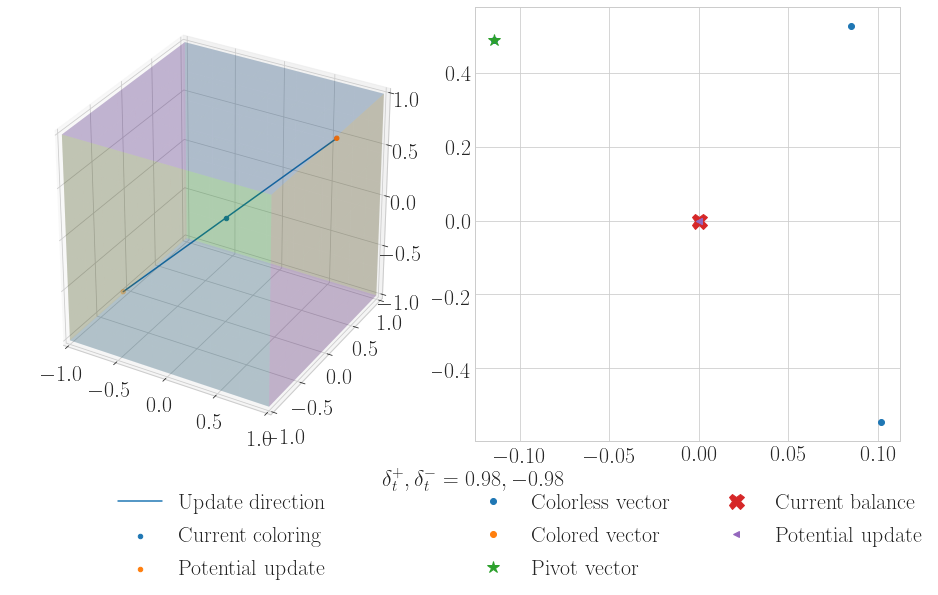

xs: [array([1.000e+00, 1.054e-01, 1.000e+00]), array([1.000e+00, 1.000e+00, -2.457e-02])]
sum:[array([-3.849e-03, 6.231e-04]), array([1.894e-01, -3.067e-02])]


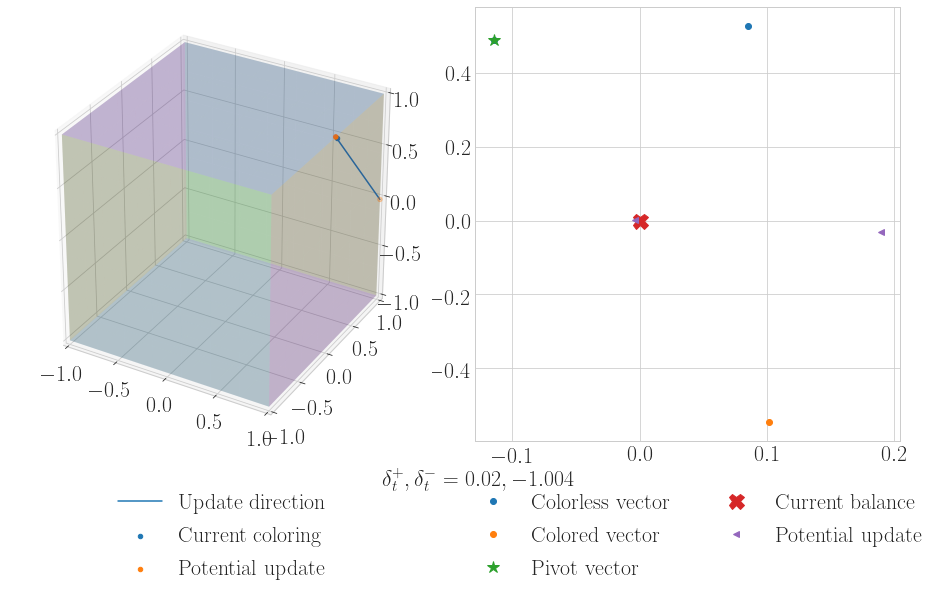

xs: [array([1.000e+00, -1.000e+00, 1.000e+00]), array([1.000e+00, 1.000e+00, 1.000e+00])]
sum:[array([-9.796e-02, -5.807e-01]), array([7.232e-02, 4.711e-01])]


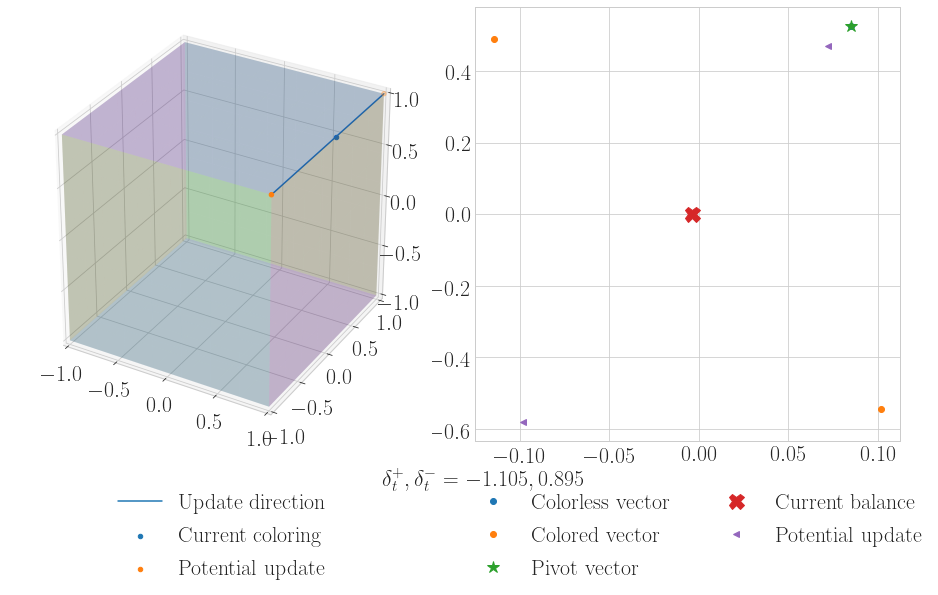

In [34]:
n=3
v=sample_from_sphere(n)
v=sample_from_ball(n)
print(f'v:{v}')
xs=[]
x=gram_schmidt_walk(v,np.zeros(n),plot=True)

n=10
2


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:90: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


8
32
128
512


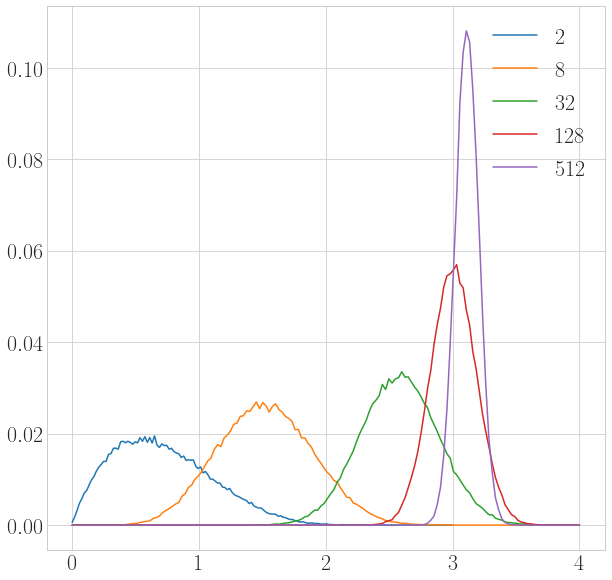

n=20
2
8
32
128
512


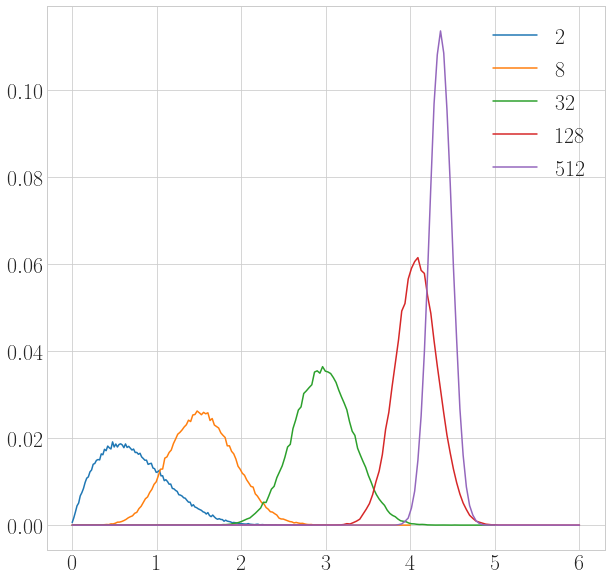

n=40
2
8
32
128
512


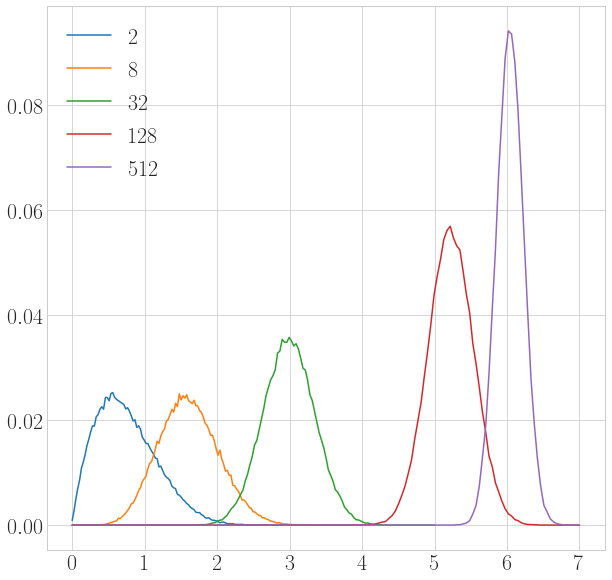

In [6]:
#maybe multiplot with different n ?
l=[2,8,32,128,512]
n_list=[10,20,40]
repeat=10**5
norms={}
for n in n_list:
    print(f'n={n}')
    norms[n]={}
    for d in l:
        print(d)
        norms[n][d]=[]
        for i in range(repeat):
            v=sample_from_ball(n,d=d)
            x=gram_schmidt_walk(v,np.zeros(n))
            B=np.transpose(np.vstack(tuple([e for e in v])))
            norms[n][d].append(np.sqrt(sum([x_**2 for x_ in np.matmul(B,x)])))
        h=int(np.ceil(max(norms[n][d])))
        split=int(np.sqrt(repeat)/2)
        r=np.linspace(0,h,split)
        num=[sum(map(lambda x:int((norm<=x) and (x<(norm+h/split))),norms[n][d]))/repeat for norm in r]
        plt.plot(r,num,label=str(d))
    plt.legend()
    plt.savefig(f'norms{n}.pdf')
    tikzplotlib.save(f"norms_n{n}.tex")
    plt.show()

n=5
2
4
8
16
32
64
128
256
512
1024
2048
4096
8192
16384
32768
65536


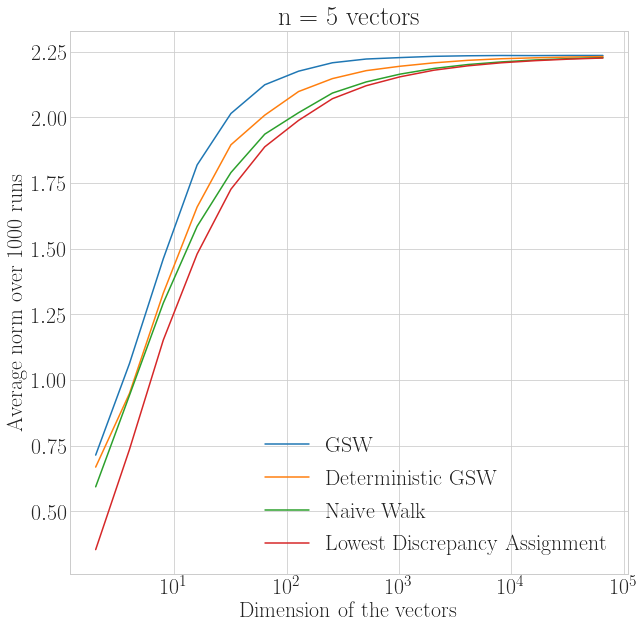

n=10
2
4
8
16
32
64
128
256
512
1024
2048
4096
8192
16384
32768
65536


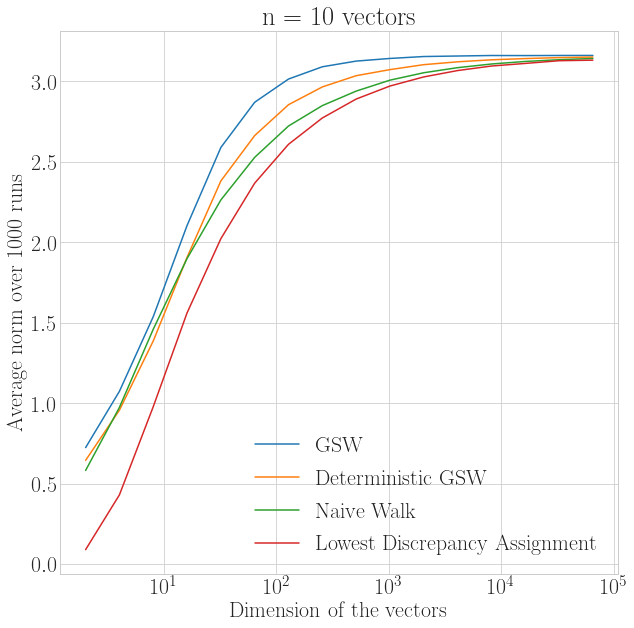

n=15
2
4
8
16
32
64
128
256
512
1024
2048
4096
8192
16384
32768


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:186: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


65536


KeyboardInterrupt: 

In [20]:
max_power=16.0
l=np.logspace(1.0, max_power, num=int(max_power), base=2.0)
n_list=[5,10,15,20,40]
#n_list=[5,10]
repeat=10**3
#repeat=10**1

#load dics
norms_gsw=open_dic_file('norms_gsw.pkl')
norms_gsw_det=open_dic_file('norms_gsw_det.pkl')
norms_naive=open_dic_file('norms_naive.pkl')
norms_best=open_dic_file('norms_best.pkl')

for n in n_list:
    print(f'n={n}')
    if norms_gsw.get(n) is None:
        norms_gsw[n]={}
    if norms_gsw_det.get(n) is None:
        norms_gsw_det[n]={}
    if norms_naive.get(n) is None:
        norms_naive[n]={}
    if norms_best.get(n) is None:
        norms_best[n]={}
    for d_ in l:
        d=int(d_)
        print(d)
        if norms_gsw[n].get(d) is None:
            norms_gsw[n][d]=[]
        if norms_gsw_det[n].get(d) is None:
            norms_gsw_det[n][d]=[]
        if norms_naive[n].get(d) is None:
            norms_naive[n][d]=[]
        if norms_best[n].get(d) is None:
            norms_best[n][d]=[]
        while len(norms_gsw[n][d])<repeat:
            v=sample_from_ball(n,d=d)
            x=gram_schmidt_walk(v,np.zeros(n))
            B=np.transpose(np.vstack(tuple([e for e in v])))
            norms_gsw[n][d].append(np.sqrt(sum([x_**2 for x_ in np.matmul(B,x)])))
            x_det=gram_schmidt_walk(v,np.zeros(n),smallest_delta=True)
            norms_gsw_det[n][d].append(np.sqrt(sum([x_**2 for x_ in np.matmul(B,x_det)])))
            x_naive=naive_walk(v)
            norms_naive[n][d].append(np.sqrt(sum([x_**2 for x_ in np.matmul(B,x_naive)])))
            if n<=10:
                disc,x_best=best_coloring(v)
                norms_best[n][d].append(disc)
    plt.plot(l,[sum(norms_gsw[n][d])/repeat for d in l],label=f'GSW')
    plt.plot(l,[sum(norms_gsw_det[n][d])/repeat for d in l],label=f'Deterministic GSW')
    plt.plot(l,[sum(norms_naive[n][d])/repeat for d in l],label=f'Naive Walk')
    plt.plot(l,[sum(norms_best[n][d])/repeat for d in l],label=f'Lowest Discrepancy Assignment')
    plt.title(f'n = {n} vectors')
    plt.xlabel('Dimension of the vectors')
    plt.ylabel(f'Average norm over {repeat} runs')
    plt.legend()
    plt.xscale('log')
    plt.savefig(f'comparative_norms_n={n}_repeat={repeat}_max_dim={2**max_power}.pdf')
    tikzplotlib.save(f"comparative_norms_n={n}_repeat={repeat}_max_dim={2**max_power}.tex")
    plt.show()

In [21]:
#save dics
save_dic_to_file(norms_gsw,'norms_gsw.pkl')
save_dic_to_file(norms_gsw_det,'norms_gsw_det.pkl')
save_dic_to_file(norms_naive,'norms_naive.pkl')
save_dic_to_file(norms_best,'norms_best.pkl')

In [ ]:
max_power=10.0
l=np.logspace(1.0, max_power, num=int(max_power), base=2.0)
n_list=[5,10,15,20,40,80]
#n_list=[5,10]
repeat=10**3
#repeat=10**1

#load dics
norms_gsw=open_dic_file('norms_gsw_half_struc.pkl')
norms_gsw_det=open_dic_file('norms_gsw_det_half_struc.pkl')
norms_naive=open_dic_file('norms_naive_half_struc.pkl')
norms_best=open_dic_file('norms_best_half_struc.pkl')

for n in n_list:
    print(f'n={n}')
    if norms_gsw.get(n) is None:
        norms_gsw[n]={}
    if norms_gsw_det.get(n) is None:
        norms_gsw_det[n]={}
    if norms_naive.get(n) is None:
        norms_naive[n]={}
    if norms_best.get(n) is None:
        norms_best[n]={}
    for d_ in l:
        d=int(d_)
        print(d)
        if norms_gsw[n].get(d) is None:
            norms_gsw[n][d]=[]
        if norms_gsw_det[n].get(d) is None:
            norms_gsw_det[n][d]=[]
        if norms_naive[n].get(d) is None:
            norms_naive[n][d]=[]
        if norms_best[n].get(d) is None:
            norms_best[n][d]=[]
        while len(norms_gsw[n][d])<repeat:
            v=sample_from_ball(n,d=d)
            x=gram_schmidt_walk(v,np.zeros(n))
            B=np.transpose(np.vstack(tuple([e for e in v])))
            norms_gsw[n][d].append(np.sqrt(sum([x_**2 for x_ in np.matmul(B,x)])))
            x_det=gram_schmidt_walk(v,np.zeros(n),smallest_delta=True)
            norms_gsw_det[n][d].append(np.sqrt(sum([x_**2 for x_ in np.matmul(B,x_det)])))
            x_naive=naive_walk(v)
            norms_naive[n][d].append(np.sqrt(sum([x_**2 for x_ in np.matmul(B,x_naive)])))
            if n<=10:
                disc,x_best=best_coloring(v)
                norms_best[n][d].append(disc)
    plt.plot(l,[sum(norms_gsw[n][d])/repeat for d in l],label=f'GSW')
    plt.plot(l,[sum(norms_gsw_det[n][d])/repeat for d in l],label=f'Deterministic GSW')
    plt.plot(l,[sum(norms_naive[n][d])/repeat for d in l],label=f'Naive Walk')
    plt.plot(l,[sum(norms_best[n][d])/repeat for d in l],label=f'Lowest Discrepancy Assignment')
    plt.title(f'n = {n} vectors')
    plt.xlabel('Dimension of the vectors')
    plt.ylabel(f'Average norm over {repeat} runs')
    plt.legend()
    plt.xscale('log')
    plt.savefig(f'comparative_norms_n={n}_repeat={repeat}_max_dim={2**max_power}.pdf')
    tikzplotlib.save(f"comparative_norms_n={n}_repeat={repeat}_max_dim={2**max_power}.tex")
    plt.show()

In [ ]:
#save dics
save_dic_to_file(norms_gsw,'norms_gsw_half_struc.pkl')
save_dic_to_file(norms_gsw_det,'norms_gsw_det_half_struc.pkl')
save_dic_to_file(norms_naive,'norms_naive_half_struc.pkl')
save_dic_to_file(norms_best,'norms_best_half_struc.pkl')

In [259]:
X=np.array([[0,0,1],[0,1,0],[2,1,1]])
print(X)
print(gram_schmidt_columns(X))

[[0 0 1]
 [0 1 0]
 [2 1 1]]
[[0.000e+00 0.000e+00 -1.000e+00]
 [-0.000e+00 1.000e+00 0.000e+00]
 [-1.000e+00 -0.000e+00 0.000e+00]]


In [320]:
n=10
x=np.random.uniform(size=(n,n))
basis=gram_schmidt_columns(x)
v=sample_from_ball(n)
print(v)
v=np.transpose(np.matmul(np.transpose(np.vstack(tuple([e for e in basis]))),np.vstack(tuple([e for e in v]))))#is v already a list ? If so we can simplify syntax here
v=[v[:,i] for i in range(v.shape[1])]
print(v)

[array([-2.574e-01, 7.914e-01]), array([7.866e-01, 4.301e-01]), array([-3.746e-01, -6.659e-01]), array([6.826e-01, 4.059e-01]), array([5.890e-02, -3.040e-01]), array([6.808e-01, 1.020e-02]), array([7.960e-01, 1.972e-02]), array([7.478e-01, -3.739e-01]), array([-8.899e-01, 8.589e-02]), array([4.134e-01, 4.869e-01])]
[array([-8.283e-01, 3.123e-03]), array([-3.716e-01, 3.267e-01]), array([2.925e-01, 4.570e-01]), array([3.139e-01, 7.879e-01]), array([8.818e-01, 6.184e-01]), array([2.303e-01, 3.884e-02]), array([2.398e-01, 4.689e-01]), array([-1.207e+00, 4.780e-01]), array([7.476e-01, 2.336e-01]), array([3.783e-02, -2.712e-01])]


In [9]:
l=[1,2,3]
print(l[0:2])

[1, 2]


In [30]:
print(inv(np.array([[2,3,1],[1,1,0],[1,4,-1]])))
print(inv(np.array([[2,0,3,1],[1,0,1,0],[0,0,0,0],[1,0,4,-1]])))

[[-2.500e-01 1.750e+00 -2.500e-01]
 [2.500e-01 -7.500e-01 2.500e-01]
 [7.500e-01 -1.250e+00 -2.500e-01]]
[[-2.500e-01 1.750e+00 0.000e+00 -2.500e-01]
 [-3.331e-16 4.441e-16 0.000e+00 8.327e-17]
 [2.500e-01 -7.500e-01 0.000e+00 2.500e-01]
 [7.500e-01 -1.250e+00 0.000e+00 -2.500e-01]]


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:214: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


In [57]:
l=np.array([1,2,3])
new=np.append(l,4)
print(new)

[1 2 3 4]


In [185]:
b1=[np.array([1,2]),np.array([0,1])]
b2=orthonormal_basis(2)
print(change_basis(np.array([1,1]),b1,b2))

[1.000e+00 3.000e+00]


In [90]:
v=[np.array([1.0,0.,1.]),np.array([2.,0.,1.]),np.array([0.,0.,1.]),np.array([3.,0.,4.])]
q,r=np.linalg.qr(np.transpose(np.vstack(tuple([e for e in v]))))
v_p=np.array([1,2,1])
rs=np.array([(r[i,:]==np.zeros(r.shape[1])).all() for i in range(r.shape[0])])
print(rs)
q=q[:,~rs]
v_perp=v_p-q.dot(np.linalg.inv(q.T.dot(q))).dot(q.T).dot(v_p)
print(q)
print(r)
print(v_perp)

[False False  True]
[[-7.071e-01 -7.071e-01]
 [-0.000e+00 0.000e+00]
 [-7.071e-01 7.071e-01]]
[[-1.414e+00 -2.121e+00 -7.071e-01 -4.950e+00]
 [0.000e+00 -7.071e-01 7.071e-01 7.071e-01]
 [0.000e+00 0.000e+00 0.000e+00 0.000e+00]]
[0.000e+00 2.000e+00 0.000e+00]


In [68]:
print(np.transpose(np.vstack(tuple([e for e in v]))))

[[1 2 0 3]
 [0 0 0 0]
 [1 1 1 4]]


In [74]:
#q=np.transpose(np.vstack(tuple([e for e in v])))
q.dot(np.linalg.inv(q.T.dot(q))).dot(q.T)

array([[1.000e+00, 0.000e+00, 0.000e+00],
       [0.000e+00, 0.000e+00, 0.000e+00],
       [0.000e+00, 0.000e+00, 0.000e+00]])

In [71]:
print(r)

[[-1.414e+00 -2.121e+00 -7.071e-01 -4.950e+00]
 [0.000e+00 -7.071e-01 7.071e-01 7.071e-01]
 [0.000e+00 0.000e+00 0.000e+00 0.000e+00]]


In [73]:
!pip install numpy --upgrade

  Attempting uninstall: numpy
    Found existing installation: numpy 1.20.1
    Uninstalling numpy-1.20.1:
      Successfully uninstalled numpy-1.20.1


ERROR: Could not install packages due to an EnvironmentError: [WinError 5] Accès refusé: 'C:\\Users\\GABO~1\\AppData\\Local\\Temp\\pip-uninstall-1__xnp5g\\core\\_multiarray_tests.cp37-win_amd64.pyd'
Consider using the `--user` option or check the permissions.



In [78]:
q.dot(r)

array([[1.000e+00, 2.000e+00, -1.110e-16, 3.000e+00],
       [0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00],
       [1.000e+00, 1.000e+00, 1.000e+00, 4.000e+00]])

In [9]:
v=[np.array([1,1,1]),np.array([1,0,0]),np.array([0,1,0]),np.array([2,1,0])]
basis=[np.array([1,0,0,0]),np.array([0,0,1,0]),np.array([0,1,0,0]),np.array([0,0,4,1])]
B=np.matmul(np.transpose(np.vstack(tuple([e for e in v]))),np.vstack(tuple([e for e in basis])).T)
print(B)

[[1 0 1 2]
 [1 1 0 5]
 [1 0 0 0]]


In [37]:
#Do longer vectors get colored first as we would expect them to ?
#Try with vectors of increasing length with non deterministic GSW 
n=200
v=sample_from_ball(n,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])*(i+1)
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
measure=[]
for i in [100]:#range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(res)
    coloring_order.append(order)
    earliness_measure=sum([abs((n-i)-order[i]) for i in range(len(order))])
    print(f'sum(n-timestep)*norm(vector colored):{earliness_measure}')
    measure.append(earliness_measure)
    
print(f'\n Final breakdown')
print(f'Average sum(n-timestep)*norm(vector colored):{average(measure)}')


 Try #1


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


sum(n-timestep)*norm(vector colored):18688

 Final breakdown
Average sum(n-timestep)*norm(vector colored):18688.0


In [38]:
print(order)

[0, 2, 1, 3, 4, 8, 5, 18, 29, 6, 37, 9, 17, 14, 43, 13, 10, 12, 7, 23, 42, 22, 140, 26, 16, 78, 15, 59, 19, 87, 27, 36, 41, 11, 39, 20, 73, 66, 60, 151, 31, 84, 49, 70, 35, 75, 25, 58, 38, 44, 72, 157, 98, 102, 45, 21, 56, 34, 82, 134, 67, 81, 94, 24, 69, 64, 28, 156, 138, 188, 83, 92, 57, 97, 68, 74, 101, 30, 46, 196, 61, 100, 33, 51, 99, 47, 48, 89, 198, 53, 40, 107, 131, 137, 177, 86, 129, 63, 147, 114, 122, 71, 180, 50, 165, 52, 127, 103, 155, 159, 80, 88, 115, 65, 148, 104, 123, 178, 93, 120, 124, 105, 135, 130, 85, 175, 184, 166, 132, 109, 32, 152, 119, 186, 95, 179, 77, 117, 133, 181, 141, 113, 55, 191, 54, 172, 187, 136, 142, 154, 96, 169, 106, 110, 62, 160, 192, 126, 139, 121, 194, 153, 116, 162, 79, 144, 189, 182, 176, 150, 118, 91, 111, 174, 143, 76, 125, 146, 108, 161, 145, 193, 173, 158, 167, 149, 112, 163, 90, 128, 185, 199, 197, 190, 183, 195, 164, 168, 171, 170]


In [39]:
[norm(vs) for vs in v]

[1.0000000000000002,
 2.0,
 2.9999999999999996,
 4.000000000000001,
 5.000000000000002,
 6.000000000000002,
 7.000000000000002,
 7.999999999999997,
 8.999999999999996,
 10.0,
 11.000000000000005,
 11.999999999999998,
 13.000000000000004,
 13.999999999999996,
 15.000000000000004,
 16.0,
 17.0,
 17.999999999999996,
 19.0,
 20.000000000000004,
 20.999999999999993,
 21.999999999999996,
 22.999999999999996,
 23.999999999999996,
 25.000000000000014,
 25.999999999999993,
 26.999999999999996,
 27.999999999999993,
 28.999999999999993,
 30.000000000000007,
 30.99999999999999,
 31.999999999999993,
 32.99999999999999,
 34.000000000000014,
 34.99999999999999,
 36.00000000000002,
 37.0,
 37.99999999999999,
 39.00000000000002,
 40.0,
 41.000000000000014,
 41.99999999999998,
 43.000000000000014,
 43.99999999999999,
 44.99999999999999,
 45.99999999999999,
 47.00000000000001,
 47.99999999999998,
 49.00000000000003,
 50.000000000000014,
 51.000000000000014,
 52.0,
 52.999999999999986,
 53.99999999999999,

In [28]:
#Do longer vectors get colored first as we would expect them to ?
#Try with vectors of increasing length with deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])*(i+1)
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
measure=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    coloring_order.append(order)
    earliness_measure=sum([abs((n-i)-order[i]) for i in range(len(order))])
    print(f'sum(n-timestep)*norm(vector colored):{earliness_measure}')
    measure.append(earliness_measure)
    
print(f'\n Final breakdown')
print(f'Average sum(n-timestep)*norm(vector colored):{average(measure)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


sum(n-timestep)*norm(vector colored):18598

 Try #1
sum(n-timestep)*norm(vector colored):18752

 Try #2
sum(n-timestep)*norm(vector colored):18068

 Try #3
sum(n-timestep)*norm(vector colored):18662

 Try #4
sum(n-timestep)*norm(vector colored):18590

 Try #5
sum(n-timestep)*norm(vector colored):18292

 Try #6
sum(n-timestep)*norm(vector colored):18780

 Try #7
sum(n-timestep)*norm(vector colored):18500

 Try #8
sum(n-timestep)*norm(vector colored):18672

 Try #9
sum(n-timestep)*norm(vector colored):18640

 Try #10
sum(n-timestep)*norm(vector colored):18436

 Try #11
sum(n-timestep)*norm(vector colored):18454

 Try #12
sum(n-timestep)*norm(vector colored):18776

 Try #13
sum(n-timestep)*norm(vector colored):18356

 Try #14
sum(n-timestep)*norm(vector colored):18446

 Try #15
sum(n-timestep)*norm(vector colored):18342

 Try #16
sum(n-timestep)*norm(vector colored):18534

 Try #17
sum(n-timestep)*norm(vector colored):18226

 Try #18
sum(n-timestep)*norm(vector colored):18640

 Try #19
su

In [29]:
#Do longer vectors get colored first as we would expect them to ?
#now we compare with a group of vectors with the same average norm
#Try with vectors of increasing length with non deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])*(n+1)/2
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
measure=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(res)
    coloring_order.append(order)
    earliness_measure=sum([abs((n-i)-order[i]) for i in range(len(order))])
    print(f'sum(n-timestep)*norm(vector colored):{earliness_measure}')
    measure.append(earliness_measure)
    
print(f'\n Final breakdown')
print(f'Average sum(n-timestep)*norm(vector colored):{average(measure)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


sum(n-timestep)*norm(vector colored):13572

 Try #1
sum(n-timestep)*norm(vector colored):13168

 Try #2
sum(n-timestep)*norm(vector colored):13794

 Try #3
sum(n-timestep)*norm(vector colored):12964

 Try #4
sum(n-timestep)*norm(vector colored):13462

 Try #5
sum(n-timestep)*norm(vector colored):13018

 Try #6
sum(n-timestep)*norm(vector colored):13508

 Try #7
sum(n-timestep)*norm(vector colored):13326

 Try #8
sum(n-timestep)*norm(vector colored):13784

 Try #9
sum(n-timestep)*norm(vector colored):12654

 Try #10
sum(n-timestep)*norm(vector colored):13006

 Try #11
sum(n-timestep)*norm(vector colored):13688

 Try #12
sum(n-timestep)*norm(vector colored):13662

 Try #13
sum(n-timestep)*norm(vector colored):13056

 Try #14
sum(n-timestep)*norm(vector colored):13762

 Try #15
sum(n-timestep)*norm(vector colored):13124

 Try #16
sum(n-timestep)*norm(vector colored):12454

 Try #17
sum(n-timestep)*norm(vector colored):13198

 Try #18
sum(n-timestep)*norm(vector colored):12024

 Try #19
su

In [30]:
#Do longer vectors get colored first as we would expect them to ?
#now we compare with a group of vectors with the same average norm
#Try with vectors of increasing length with deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])*(n+1)/2
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
measure=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    coloring_order.append(order)
    earliness_measure=sum([abs((n-i)-order[i]) for i in range(len(order))])
    print(f'sum(n-timestep)*norm(vector colored):{earliness_measure}')
    measure.append(earliness_measure)
    
print(f'\n Final breakdown')
print(f'Average sum(n-timestep)*norm(vector colored):{average(measure)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


sum(n-timestep)*norm(vector colored):12248

 Try #1
sum(n-timestep)*norm(vector colored):12292

 Try #2
sum(n-timestep)*norm(vector colored):13946

 Try #3
sum(n-timestep)*norm(vector colored):12984

 Try #4
sum(n-timestep)*norm(vector colored):13946

 Try #5
sum(n-timestep)*norm(vector colored):13764

 Try #6
sum(n-timestep)*norm(vector colored):12900

 Try #7
sum(n-timestep)*norm(vector colored):13738

 Try #8
sum(n-timestep)*norm(vector colored):13324

 Try #9
sum(n-timestep)*norm(vector colored):13724

 Try #10
sum(n-timestep)*norm(vector colored):13884

 Try #11
sum(n-timestep)*norm(vector colored):12900

 Try #12
sum(n-timestep)*norm(vector colored):14112

 Try #13
sum(n-timestep)*norm(vector colored):13922

 Try #14
sum(n-timestep)*norm(vector colored):12976

 Try #15
sum(n-timestep)*norm(vector colored):12832

 Try #16
sum(n-timestep)*norm(vector colored):13522

 Try #17
sum(n-timestep)*norm(vector colored):12614

 Try #18
sum(n-timestep)*norm(vector colored):13166

 Try #19
su

In [41]:
#Do longer vectors get colored first as we would expect them to ?
#Try with a set of half big half small vectors with deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])*(1 if i<n/2 else n)
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
measure=[]
avg_time_step_of_coloring_for_big=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    coloring_order.append(order)
    avg_step_big=average([j for j in range(len(order)) if order[j]>=n/2])
    print(f'Average time step of coloring of big elements: {avg_step_big}')
    avg_time_step_of_coloring_for_big.append(avg_step_big)
    earliness_measure=sum([abs((n-i)-order[i]) for i in range(len(order))])
    print(f'sum(n-timestep)*norm(vector colored):{earliness_measure}')
    measure.append(earliness_measure)
    
print(f'\n Final breakdown')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_big)}')
print(f'Average sum(n-timestep)*norm(vector colored):{average(measure)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Average time step of coloring of big elements: 149.47
sum(n-timestep)*norm(vector colored):19994

 Try #1
Average time step of coloring of big elements: 149.42
sum(n-timestep)*norm(vector colored):19984

 Try #2
Average time step of coloring of big elements: 149.46
sum(n-timestep)*norm(vector colored):19992

 Try #3
Average time step of coloring of big elements: 149.5
sum(n-timestep)*norm(vector colored):20000

 Try #4
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #5
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #6
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #7
v_perp:[-1.147e+00 -7.536e-03 -1.490e+00 -1.335e-02 -7.210e-01 -1.024e+00
 -2.594e-01 -1.016e+00 -1.102e+00 1.351e+00 8.192e-01 -2.427e-01
 -2.749e-02 1.024e-01 7.096e-01 -6.208e-01 -7.781e-01 -6.252e-01
 -2.396e-01 2.027e+00 2.373e-02 -1.023e+00 -1.019e+00 1

Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #22
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #23
Average time step of coloring of big elements: 149.47
sum(n-timestep)*norm(vector colored):19994

 Try #24
Average time step of coloring of big elements: 149.47
sum(n-timestep)*norm(vector colored):19996

 Try #25
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #26
Average time step of coloring of big elements: 149.5
sum(n-timestep)*norm(vector colored):20000

 Try #27
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #28
v_perp:[1.325e+00 -4.458e-01 1.636e+00 -7.512e-01 -2.100e-01 7.759e-01 1.256e+00
 2.133e-01 -4.887e-01 1.446e-01 -5.500e-01 6.661e-01 -4.615e-01 -2.323e-01
 3.642e-01 3.309e-01 4.599e-02 3.315e-01 7.453e-02 -1.771e+00 1.494e+00
 -7.038e-02 1.009e+00 -1

Average time step of coloring of big elements: 149.5
sum(n-timestep)*norm(vector colored):20000

 Try #32
Average time step of coloring of big elements: 149.46
sum(n-timestep)*norm(vector colored):19992

 Try #33
Average time step of coloring of big elements: 149.46
sum(n-timestep)*norm(vector colored):19992

 Try #34
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #35
Average time step of coloring of big elements: 149.45
sum(n-timestep)*norm(vector colored):19990

 Try #36
Average time step of coloring of big elements: 149.46
sum(n-timestep)*norm(vector colored):19992

 Try #37
Average time step of coloring of big elements: 149.47
sum(n-timestep)*norm(vector colored):19994

 Try #38
Average time step of coloring of big elements: 149.46
sum(n-timestep)*norm(vector colored):19992

 Try #39
Average time step of coloring of big elements: 149.46
sum(n-timestep)*norm(vector colored):19992

 Try #40
Average time step of coloring of big e

Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #65
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #66
Average time step of coloring of big elements: 149.47
sum(n-timestep)*norm(vector colored):19994

 Try #67
Average time step of coloring of big elements: 149.47
sum(n-timestep)*norm(vector colored):19994

 Try #68
Average time step of coloring of big elements: 149.47
sum(n-timestep)*norm(vector colored):19994

 Try #69
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #70
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #71
Average time step of coloring of big elements: 149.46
sum(n-timestep)*norm(vector colored):19992

 Try #72
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #73
Average time step of coloring of big 

In [40]:
#Do longer vectors get colored first as we would expect them to ?
#Try with a set of half big half small vectors with non-deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])*(1 if i<n/2 else n)
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
measure=[]
avg_time_step_of_coloring_for_big=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(res)
    coloring_order.append(order)
    avg_step_big=average([j for j in range(len(order)) if order[j]>=n/2])
    print(f'Average time step of coloring of big elements: {avg_step_big}')
    avg_time_step_of_coloring_for_big.append(avg_step_big)
    earliness_measure=sum([abs((n-i)-order[i]) for i in range(len(order))])
    print(f'sum(n-timestep)*norm(vector colored):{earliness_measure}')
    measure.append(earliness_measure)
    
print(f'\n Final breakdown')
print(f'Average of Average time step of coloring of structured elements: {average(avg_time_step_of_coloring_for_big)}')
print(f'Average sum(n-timestep)*norm(vector colored):{average(measure)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #1
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #2
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #3
Average time step of coloring of big elements: 149.5
sum(n-timestep)*norm(vector colored):20000

 Try #4
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #5
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #6
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #7
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #8
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #9
Average time step of coloring of big elements: 

Average time step of coloring of big elements: 149.5
sum(n-timestep)*norm(vector colored):20000

 Try #78
Average time step of coloring of big elements: 149.47
sum(n-timestep)*norm(vector colored):19994

 Try #79
Average time step of coloring of big elements: 149.5
sum(n-timestep)*norm(vector colored):20000

 Try #80
Average time step of coloring of big elements: 149.48
sum(n-timestep)*norm(vector colored):19996

 Try #81
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #82
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #83
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #84
Average time step of coloring of big elements: 149.5
sum(n-timestep)*norm(vector colored):20000

 Try #85
Average time step of coloring of big elements: 149.49
sum(n-timestep)*norm(vector colored):19998

 Try #86
Average time step of coloring of big ele

In [32]:
#How does translation of the input affect the distribution of 1 and -1's? Here no translation
#Do longer vectors get colored first as we would expect them to ?
#Try with a set of half big half small vectors with non-deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
gsw_xs=[]
balances=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(res)
    bal=abs(sum(res))
    print(f'Balance of the coloring: {bal}')
    balances.append(bal)
    
print(f'\n Final breakdown')
print(f'Average of balances of the colorings:{average(balances)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Balance of the coloring: 4.0

 Try #1
Balance of the coloring: 10.0

 Try #2
Balance of the coloring: 6.0

 Try #3
Balance of the coloring: 4.0

 Try #4
Balance of the coloring: 14.0

 Try #5
Balance of the coloring: 22.0

 Try #6
Balance of the coloring: 10.0

 Try #7
Balance of the coloring: 12.0

 Try #8
Balance of the coloring: 10.0

 Try #9
Balance of the coloring: 6.0

 Try #10
Balance of the coloring: 2.0

 Try #11
Balance of the coloring: 6.0

 Try #12
Balance of the coloring: 2.0

 Try #13
Balance of the coloring: 8.0

 Try #14
Balance of the coloring: 26.0

 Try #15
Balance of the coloring: 6.0

 Try #16
Balance of the coloring: 18.0

 Try #17
Balance of the coloring: 4.0

 Try #18
Balance of the coloring: 10.0

 Try #19
Balance of the coloring: 4.0

 Try #20
Balance of the coloring: 6.0

 Try #21
Balance of the coloring: 2.0

 Try #22
Balance of the coloring: 6.0

 Try #23
Balance of the coloring: 28.0

 Try #24
Balance of the coloring: 14.0

 Try #25
Balance of the coloring

In [33]:
#How does translation of the input affect the distribution of 1 and -1's? Here small translation
#Do longer vectors get colored first as we would expect them to ?
#Try with a set of half big half small vectors with non-deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
trans=sample_from_ball(1,d=n)
for i in range(len(v)):
    v[i]+=trans[0]
gsw_xs=[]
balances=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(res)
    bal=abs(sum(res))
    print(f'Balance of the coloring: {bal}')
    balances.append(bal)
    
print(f'\n Final breakdown')
print(f'Average of balances of the colorings:{average(balances)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Balance of the coloring: 0.0

 Try #1
Balance of the coloring: 1.1102230246251565e-16

 Try #2
Balance of the coloring: 0.0

 Try #3
Balance of the coloring: 4.0

 Try #4
Balance of the coloring: 0.0

 Try #5
Balance of the coloring: 2.0

 Try #6
Balance of the coloring: 0.0

 Try #7
Balance of the coloring: 0.0

 Try #8
Balance of the coloring: 2.0

 Try #9
Balance of the coloring: 0.0

 Try #10
Balance of the coloring: 2.0

 Try #11
Balance of the coloring: 0.0

 Try #12
Balance of the coloring: 0.0

 Try #13
Balance of the coloring: 0.0

 Try #14
Balance of the coloring: 0.0

 Try #15
Balance of the coloring: 2.0

 Try #16
Balance of the coloring: 2.0

 Try #17
Balance of the coloring: 0.0

 Try #18
Balance of the coloring: 0.0

 Try #19
Balance of the coloring: 0.0

 Try #20
Balance of the coloring: 0.0

 Try #21
Balance of the coloring: 2.0

 Try #22
Balance of the coloring: 2.0

 Try #23
Balance of the coloring: 2.0

 Try #24
Balance of the coloring: 2.0

 Try #25
Balance of the 

In [31]:
#How does translation of the input affect the distribution of 1 and -1's?
#Do longer vectors get colored first as we would expect them to ?
#Try with a set of half big half small vectors with non-deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
trans=sample_from_ball(1,d=n)
for i in range(len(v)):
    v[i]+=trans[0]*10
gsw_xs=[]
balances=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(res)
    bal=abs(sum(res))
    print(f'Balance of the coloring: {bal}')
    balances.append(bal)
    
print(f'\n Final breakdown')
print(f'Average of balances of the colorings:{average(balances)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Balance of the coloring: 0.0

 Try #1
Balance of the coloring: 0.0

 Try #2
Balance of the coloring: 0.0

 Try #3
Balance of the coloring: 0.0

 Try #4
Balance of the coloring: 0.0

 Try #5
Balance of the coloring: 0.0

 Try #6
Balance of the coloring: 0.0

 Try #7
Balance of the coloring: 0.0

 Try #8
Balance of the coloring: 0.0

 Try #9
Balance of the coloring: 0.0

 Try #10
Balance of the coloring: 2.0

 Try #11
Balance of the coloring: 0.0

 Try #12
Balance of the coloring: 0.0

 Try #13
Balance of the coloring: 0.0

 Try #14
Balance of the coloring: 0.0

 Try #15
Balance of the coloring: 0.0

 Try #16
Balance of the coloring: 0.0

 Try #17
Balance of the coloring: 0.0

 Try #18
Balance of the coloring: 0.0

 Try #19
Balance of the coloring: 0.0

 Try #20
Balance of the coloring: 0.0

 Try #21
Balance of the coloring: 0.0

 Try #22
Balance of the coloring: 0.0

 Try #23
Balance of the coloring: 0.0

 Try #24
Balance of the coloring: 0.0

 Try #25
Balance of the coloring: 0.0

 Try

In [34]:
#How does translation of the input affect the distribution of 1 and -1's?
#Do longer vectors get colored first as we would expect them to ?
#Try with a set of half big half small vectors with deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
gsw_xs=[]
balances=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    bal=abs(sum(res))
    print(f'Balance of the coloring: {bal}')
    balances.append(bal)
    
print(f'\n Final breakdown')
print(f'Average of balances of the colorings:{average(balances)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Balance of the coloring: 38.0

 Try #1
Balance of the coloring: 18.0

 Try #2
Balance of the coloring: 28.0

 Try #3
Balance of the coloring: 58.0

 Try #4
Balance of the coloring: 54.0

 Try #5
Balance of the coloring: 54.0

 Try #6
Balance of the coloring: 58.0

 Try #7
Balance of the coloring: 34.0

 Try #8
Balance of the coloring: 36.0

 Try #9
Balance of the coloring: 34.0

 Try #10
Balance of the coloring: 24.0

 Try #11
Balance of the coloring: 34.0

 Try #12
Balance of the coloring: 48.0

 Try #13
Balance of the coloring: 40.0

 Try #14
Balance of the coloring: 52.0

 Try #15
Balance of the coloring: 48.0

 Try #16
Balance of the coloring: 46.0

 Try #17
Balance of the coloring: 46.0

 Try #18
Balance of the coloring: 34.0

 Try #19
Balance of the coloring: 50.0

 Try #20
Balance of the coloring: 52.0

 Try #21
Balance of the coloring: 38.0

 Try #22
Balance of the coloring: 38.0

 Try #23
Balance of the coloring: 48.0

 Try #24
Balance of the coloring: 36.0

 Try #25
Balance o

In [35]:
#How does translation of the input affect the distribution of 1 and -1's?
#Do longer vectors get colored first as we would expect them to ?
#Try with a set of half big half small vectors with non-deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
trans=sample_from_ball(1,d=n)
for i in range(len(v)):
    v[i]+=trans[0]*1
gsw_xs=[]
balances=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    bal=abs(sum(res))
    print(f'Balance of the coloring: {bal}')
    balances.append(bal)
    
print(f'\n Final breakdown')
print(f'Average of balances of the colorings:{average(balances)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Balance of the coloring: 2.0

 Try #1
Balance of the coloring: 0.0

 Try #2
Balance of the coloring: 2.0

 Try #3
Balance of the coloring: 2.0

 Try #4
Balance of the coloring: 0.0

 Try #5
Balance of the coloring: 0.0

 Try #6
Balance of the coloring: 2.0

 Try #7
Balance of the coloring: 2.0

 Try #8
Balance of the coloring: 2.0

 Try #9
Balance of the coloring: 0.0

 Try #10
Balance of the coloring: 0.0

 Try #11
Balance of the coloring: 2.0

 Try #12
Balance of the coloring: 2.0

 Try #13
Balance of the coloring: 2.0

 Try #14
Balance of the coloring: 2.0

 Try #15
Balance of the coloring: 2.0

 Try #16
Balance of the coloring: 0.0

 Try #17
Balance of the coloring: 4.0

 Try #18
Balance of the coloring: 2.0

 Try #19
Balance of the coloring: 2.0

 Try #20
Balance of the coloring: 2.0

 Try #21
Balance of the coloring: 2.0

 Try #22
Balance of the coloring: 2.0

 Try #23
Balance of the coloring: 2.0

 Try #24
Balance of the coloring: 0.0

 Try #25
Balance of the coloring: 2.0

 Try

In [36]:
#How does translation of the input affect the distribution of 1 and -1's?
#Do longer vectors get colored first as we would expect them to ?
#Try with a set of half big half small vectors with non-deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
trans=sample_from_ball(1,d=n)
for i in range(len(v)):
    v[i]+=trans[0]*10
gsw_xs=[]
balances=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    bal=abs(sum(res))
    print(f'Balance of the coloring: {bal}')
    balances.append(bal)
    
print(f'\n Final breakdown')
print(f'Average of balances of the colorings:{average(balances)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


Balance of the coloring: 0.0

 Try #1
Balance of the coloring: 0.0

 Try #2
Balance of the coloring: 0.0

 Try #3
Balance of the coloring: 0.0

 Try #4
Balance of the coloring: 0.0

 Try #5
Balance of the coloring: 0.0

 Try #6
Balance of the coloring: 0.0

 Try #7
Balance of the coloring: 0.0

 Try #8
Balance of the coloring: 0.0

 Try #9
Balance of the coloring: 0.0

 Try #10
Balance of the coloring: 0.0

 Try #11
Balance of the coloring: 0.0

 Try #12
Balance of the coloring: 0.0

 Try #13
Balance of the coloring: 0.0

 Try #14
Balance of the coloring: 0.0

 Try #15
Balance of the coloring: 1.1102230246251565e-16

 Try #16
Balance of the coloring: 0.0

 Try #17
Balance of the coloring: 1.1102230246251565e-16

 Try #18
Balance of the coloring: 0.0

 Try #19
Balance of the coloring: 0.0

 Try #20
Balance of the coloring: 0.0

 Try #21
Balance of the coloring: 0.0

 Try #22
Balance of the coloring: 0.0

 Try #23
Balance of the coloring: 0.0

 Try #24
Balance of the coloring: 0.0

 Try 

In [4]:
#Do longer vectors get colored first as we would expect them to ?
#Try with vectors of squaringly increasing length with deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])*(i+1)**2
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
measure=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=True)
    gsw_xs.append(res)
    coloring_order.append(order)
    earliness_measure=sum([abs((n-i)-order[i]) for i in range(len(order))])
    print(f'sum(n-timestep)*norm(vector colored):{earliness_measure}')
    measure.append(earliness_measure)
    
print(f'\n Final breakdown')
print(f'Average sum(n-timestep)*norm(vector colored):{average(measure)}')


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


v_perp:[3.710e+01 -9.342e+01 -3.547e+01 1.304e+01 1.538e+01 2.574e+01 -6.141e+01
 5.846e+01 1.131e+02 7.051e+00 6.466e+01 -8.605e+00 1.016e+02 -7.176e+01
 -2.531e+01 -5.201e+01 2.510e+01 -2.275e+01 -2.658e+01 1.201e+01
 -1.035e+02 -6.392e+01 -3.123e+01 -1.008e+02 -5.821e+01 2.771e+01
 -1.115e+01 -3.003e+01 -1.876e+01 -5.089e+01 -2.098e+01 4.063e+00
 1.492e+02 -1.092e+02 -2.613e+01 -6.280e+00 8.974e+01 -5.339e+01 1.446e+02
 -2.243e+01 -1.344e+02 -3.900e+01 1.654e+01 1.142e+01 3.526e+01 -5.510e+00
 -1.355e+01 -9.624e+00 -2.275e+01 5.034e+01 -5.146e+01 -5.041e+01
 5.025e+01 1.818e+01 1.391e+01 1.602e+01 -3.251e+01 1.032e+01 4.744e+01
 4.065e+01 -1.925e+01 -1.151e+02 -1.173e+00 -4.112e+00 4.300e+01 4.453e+01
 2.763e+01 3.362e+00 -1.841e+01 -1.316e+02 -1.100e+01 9.823e+00 -2.924e+01
 4.489e+01 -4.887e+01 -7.393e+01 -1.998e+01 8.614e+01 7.047e+01 -6.037e+01
 -1.423e+02 9.914e+01 5.095e+01 3.306e+01 4.316e+01 1.278e+01 1.771e+01
 -2.007e+01 8.036e+01 -6.846e+01 4.033e+00 1.007e+00 -1.001e+02 

v_perp:[2.945e+01 6.652e+01 -4.054e+01 -7.612e+01 -3.288e+01 1.675e+01 -1.157e+02
 -3.428e+01 5.563e+01 7.590e+01 -5.886e+01 -2.586e+02 1.415e+02 -7.529e+01
 7.694e+01 6.974e+01 5.940e+01 4.849e+01 -3.124e+02 7.071e+01 -9.266e+01
 -1.077e+02 6.375e+01 -1.261e+02 4.283e+01 1.706e+00 -5.094e+01 -4.489e+01
 -6.816e+01 -2.203e+01 -4.360e+01 -6.582e+01 1.894e+02 -1.862e+02
 -4.809e+01 -3.776e+01 6.687e+00 -9.302e+01 1.763e+02 -1.638e+02 6.761e+01
 -1.495e+02 -6.046e+01 3.909e+01 2.342e+00 -1.951e+01 1.352e+02 -1.039e+02
 -5.019e+01 1.760e+02 -2.330e+02 1.295e+01 9.128e+01 -3.305e+01 1.074e+02
 2.301e+01 -5.878e+01 -1.086e+01 1.417e+02 4.791e+01 -1.044e+02 -1.188e+02
 6.256e+01 -1.116e+02 -3.041e+01 1.973e+02 1.101e+02 5.996e+01 1.318e+01
 -8.462e+00 5.042e+00 -2.397e+01 -6.672e+01 -4.329e+01 -1.142e+02
 -1.420e+02 7.988e+01 4.431e+01 9.717e+00 -1.826e+02 -1.318e+02 -8.850e+01
 7.161e+01 -1.138e+02 -7.810e+01 -1.271e+01 5.325e+01 -8.482e+00 1.968e+02
 -7.272e+00 5.723e+01 -6.968e+01 -8.431e+

v_perp:[-4.541e+01 5.933e+01 -8.707e+01 -1.611e+02 -1.745e+00 4.092e+01
 -1.024e+02 1.851e+00 4.869e+01 1.205e+01 -1.232e+02 -3.633e+02 1.260e+02
 -1.910e+02 1.085e+02 1.255e+02 2.356e+01 1.169e+02 -3.318e+02 5.154e+01
 -2.254e+02 -1.076e+02 1.394e+02 -1.579e+02 4.033e+01 -8.007e+01
 -1.669e+02 4.049e+01 -1.773e+02 -6.090e+01 -5.734e+01 -1.199e+02
 1.880e+02 -2.571e+02 -5.623e+01 3.204e+01 -1.804e+02 -3.705e+01 2.509e+02
 -1.806e+02 5.231e+01 -5.188e+01 -1.179e+02 2.606e+02 9.174e+00 -5.995e+01
 1.757e+02 -7.581e+00 -9.231e+01 5.192e+01 -4.847e+01 -5.862e+01 1.302e+02
 -7.511e+01 1.477e+02 -6.086e+01 -3.369e+01 1.396e+01 2.059e+02 -3.723e+01
 -3.725e+01 -1.151e+02 1.144e+01 -3.580e+01 -5.191e+00 1.690e+02 1.099e+02
 -7.491e+01 5.970e+01 2.061e+01 -6.284e+01 -2.943e+01 -9.640e+01
 -4.646e+01 -1.481e+01 -1.956e+02 -1.088e+02 5.426e+01 3.274e+01
 -3.138e+02 -1.417e+02 -7.365e+01 7.707e+01 -4.208e+01 -2.524e+01
 1.573e+02 4.751e+01 1.009e+02 3.179e+02 9.429e+01 1.342e+01 -6.425e+01
 5.221e

v_perp:[1.382e+01 7.293e+01 -2.194e+01 -5.706e+01 -2.408e+01 -2.595e+01
 -1.925e+02 5.152e+01 6.549e+01 5.308e+01 4.381e+01 -2.266e+02 1.081e+02
 1.071e+01 1.023e+02 6.402e+00 -8.697e+01 1.377e+02 -5.325e+02 2.965e+01
 -2.190e+02 -6.365e+01 2.427e+02 -3.761e+01 1.001e+02 -1.078e+02
 -1.482e+02 -1.659e+01 -2.401e+02 -5.550e+01 -1.032e+02 -1.786e+02
 3.333e+02 -3.612e+02 -1.435e+02 5.178e+01 -1.172e+02 -9.358e+01 2.300e+02
 -1.446e+02 1.037e+02 2.837e+01 -3.207e+02 1.573e+02 7.720e+01 -4.523e+01
 1.942e+02 6.827e+01 -7.661e+01 7.123e-01 -6.829e+01 -2.447e+01 9.424e+01
 -8.785e+01 1.836e+02 -1.964e+02 3.984e+01 9.637e+01 1.924e+02 -6.780e+01
 -2.081e+02 -1.855e+02 9.102e+01 -2.117e+01 -2.285e+01 1.933e+02 1.125e+02
 -8.465e+01 -8.093e+01 -7.677e+00 4.628e-01 -1.328e+02 -2.428e+01
 2.312e+01 -2.047e+02 -2.724e+02 -1.550e+02 -8.403e+01 1.270e+02
 -1.456e+02 -2.230e+02 -5.506e+01 1.318e+02 -7.950e+01 4.211e+01 2.045e+02
 2.592e+02 9.719e+01 3.394e+02 -6.486e+01 1.433e+02 1.187e+01 1.720e+02


v_perp:[-8.118e+01 -5.718e+01 4.654e+01 -1.032e+02 4.182e+01 2.411e+01 -3.035e+02
 1.572e+02 2.462e+02 -1.507e+01 9.409e+01 -2.930e+02 1.083e+02 1.227e+02
 -3.439e+00 -2.570e+01 -1.555e+02 2.060e+02 -5.530e+02 1.452e+02
 -2.757e+02 -1.520e+02 1.910e+02 -4.286e+01 -4.282e+01 -1.206e+02
 -3.485e+02 -6.914e+01 -1.633e+02 9.571e-01 -1.743e+02 -1.450e+02
 3.848e+02 -4.474e+02 -1.182e+02 7.171e+01 -1.103e+02 -1.417e+02 2.355e+02
 -5.911e+00 2.533e+02 5.252e+00 -2.976e+02 9.680e+01 1.139e+02 -1.294e+02
 2.070e+02 8.658e+01 -3.296e+01 9.847e+01 -2.904e+01 -2.719e+00 5.342e+01
 -1.667e+02 2.165e+02 -1.706e+02 -5.635e+01 2.565e+01 1.076e+02 -1.639e+02
 -1.008e+01 -3.188e+02 1.058e+02 -2.505e+01 -6.561e+01 2.012e+02 1.442e+02
 -1.053e+02 2.052e+01 5.415e+01 8.974e+01 -6.143e+01 4.937e+01 -4.101e+01
 -1.547e+02 -3.571e+02 -1.642e+02 -1.887e+02 1.110e+02 -2.254e+02
 -3.277e+02 -2.075e+02 3.027e+01 -2.917e+01 3.101e+01 1.346e+02 3.226e+02
 2.013e+02 3.813e+02 -1.967e+01 2.474e+02 -5.270e+01 1.907e+0

sum(n-timestep)*norm(vector colored):19572

 Try #1
v_perp:[2.508e+01 -9.695e+00 -2.815e+00 -6.550e+00 -7.162e-01 1.853e+00 4.219e+01
 5.173e+01 -2.069e+01 -8.738e+00 6.896e+00 4.845e+01 9.884e+00 -4.556e+00
 3.113e+00 2.009e+01 -6.730e+01 -2.806e+01 -1.527e+01 -7.020e+00
 -3.776e+01 -2.224e+01 -7.032e+00 -2.743e+00 -2.756e+01 1.447e+01
 -2.392e+01 2.288e+01 1.300e+01 3.170e+01 -2.151e+01 2.528e+01 -8.857e+00
 -3.264e+01 -2.947e+01 7.809e+00 -3.955e+00 -8.806e+00 2.794e+01
 -1.146e+01 6.699e-01 -3.323e+00 -6.659e+00 3.603e+01 2.960e+01 -6.766e+01
 -4.425e-01 2.606e+01 -6.513e+00 -3.277e+01 5.340e+01 3.108e+00 6.953e+01
 -1.910e+01 -4.928e+01 -2.575e+01 2.404e+00 -1.431e+01 1.423e+00
 -1.660e+00 2.535e+01 3.413e+01 1.937e+01 1.883e+01 2.370e+00 -1.992e+01
 8.890e+00 -7.249e+01 4.338e+01 -1.080e+00 8.131e+00 5.819e+01 -1.751e+01
 -5.752e+00 -3.447e+01 5.854e+01 -2.445e+01 -3.775e+01 4.247e+01 9.908e-01
 -2.385e+01 2.067e+00 -5.598e+00 2.053e+01 3.593e+01 1.231e+01 -1.163e+01
 8.884e+00 -

v_perp:[3.886e+01 1.442e+01 -3.009e+01 -3.881e+00 3.384e+01 3.020e+01 4.563e+01
 5.472e+01 1.084e+01 -4.625e+01 1.234e+01 -3.339e+01 -6.479e+01 1.846e+01
 3.188e+01 4.948e+01 -9.121e+01 -2.923e+01 4.677e+01 -3.740e+01 -3.770e+01
 -9.199e-01 4.072e+01 3.966e+01 1.302e+01 -2.583e+01 -3.669e+01 2.219e+01
 -8.222e+01 -1.448e+01 1.131e+00 2.904e+01 5.298e+00 -1.324e+01 -4.289e+00
 2.676e+01 -1.469e+01 4.937e+01 5.287e+01 2.262e+01 -1.524e+01 3.241e+01
 -6.453e+00 7.929e+01 -4.680e+01 2.808e+00 -5.796e+00 1.045e+02 -4.310e+01
 -6.213e+01 1.777e+02 -3.158e+01 6.077e+00 4.023e+00 1.280e+01 -4.024e+01
 3.323e+01 6.578e+01 -3.384e+01 -6.279e+01 4.146e+01 2.589e+01 -7.259e+01
 4.864e+01 3.214e+01 -4.828e+01 -3.284e+01 -7.850e+01 1.824e+01 4.897e+01
 -1.589e+01 -2.436e+00 8.797e+00 5.465e+00 1.294e+01 6.583e+01 -8.851e+01
 -9.215e-01 9.821e+00 -9.003e+00 -4.440e+01 1.258e+01 -3.507e+01 3.510e+01
 5.468e+01 2.150e+01 -1.302e+01 5.419e+01 -3.165e+01 6.612e+01 -1.862e+01
 5.251e+01 6.561e+01 8.432e+0

v_perp:[1.154e+02 -7.971e+01 -8.132e+01 2.272e+02 4.024e+01 7.458e+01 -4.539e+01
 2.312e+02 -8.127e+00 -1.108e+02 3.154e+02 1.301e+02 -2.950e+02 2.143e+02
 1.226e+01 1.683e+02 -4.240e+01 -1.720e+02 -2.313e+02 -9.609e+01 1.058e+02
 1.425e+02 -1.779e+02 1.105e+02 -5.621e+01 -9.810e+00 1.204e+02 -4.640e+01
 -2.297e+02 7.457e+01 -1.926e+02 -9.353e+01 -5.321e+01 1.169e+02 1.126e+02
 -1.662e+02 2.897e+02 2.497e+02 -2.157e+01 -2.204e+01 1.038e+02 7.059e+01
 -3.664e-02 -1.654e+01 -6.251e+01 8.069e+01 -2.152e+02 6.841e+01
 -1.158e+02 -1.101e+02 4.263e+01 8.296e+01 6.936e+01 7.842e+01 -1.920e+02
 9.875e+01 1.161e+02 6.745e+01 -1.784e+02 -2.578e+02 1.632e+02 -1.820e+01
 1.842e+01 8.598e+01 -3.005e+01 -3.291e+01 5.870e+01 1.861e+02 -2.133e+02
 4.806e+01 1.131e+02 7.267e+01 1.790e+01 1.227e+02 -2.036e+02 5.479e+01
 1.129e+02 7.544e+01 9.459e+01 3.957e+01 -6.346e+01 1.673e+02 -2.514e+02
 1.743e+02 1.071e+02 2.401e+02 9.186e+00 3.885e+00 -1.659e+02 1.225e+01
 1.438e+02 6.775e+01 1.254e+02 3.322e+01 1

 2.420e+02 7.037e+01]
v_perp-sum u_i*v_i:[1.122e-10 -4.021e-10 -1.043e-10 1.407e-10 -2.387e-11 -9.334e-11
 -2.539e-10 -1.561e-10 3.070e-12 6.071e-11 -9.021e-11 -1.703e-10
 -2.361e-10 8.936e-11 -2.620e-10 1.584e-10 1.752e-10 -2.683e-11 6.386e-11
 2.454e-10 -1.166e-10 2.825e-10 3.423e-10 1.643e-10 -1.822e-10 -9.052e-11
 -1.705e-10 -7.856e-11 -8.069e-11 -1.248e-10 -2.047e-10 -7.037e-11
 1.339e-10 -9.402e-11 -2.086e-10 -2.036e-10 -1.063e-10 1.000e-11 8.004e-11
 1.887e-11 2.785e-12 -7.094e-11 5.286e-11 8.527e-12 1.235e-10 5.079e-11
 -2.171e-11 -1.020e-10 5.291e-11 7.026e-11 8.782e-12 1.708e-10 1.482e-10
 1.800e-10 -1.096e-10 -3.058e-11 -1.422e-10 -1.980e-11 -3.433e-11
 -1.367e-10 3.587e-11 -9.550e-12 -6.480e-11 -1.129e-10 1.193e-10 2.192e-10
 -3.665e-11 -5.980e-11 -6.594e-12 1.228e-11 5.730e-11 2.871e-11 1.476e-10
 2.785e-12 -8.026e-11 -9.203e-11 -3.716e-11 -4.047e-11 8.851e-11 1.085e-10
 -3.865e-11 -9.339e-11 -3.092e-11 -8.492e-11 -6.935e-11 -1.274e-10
 -1.186e-10 1.107e-10 6.162e-11 4.189

v_perp:[9.092e+01 -5.461e+01 -8.581e+01 3.454e+02 -1.443e+01 2.344e+01 -3.103e+02
 2.983e+02 8.729e+01 -5.570e+01 3.226e+02 -7.497e+01 -3.111e+02 3.353e+02
 1.089e+02 5.339e+01 -2.557e+02 -4.664e+02 -2.417e+02 -1.315e+02 1.672e+02
 1.434e+02 -9.209e+01 -9.693e+01 -1.366e+01 -1.052e+02 1.240e+02
 -2.471e+01 -3.551e+02 2.050e+02 -1.160e+02 7.527e+01 4.967e+00 5.321e+01
 2.759e+02 -2.599e+02 4.109e+02 1.789e+02 3.260e+02 -3.186e+01 1.392e+02
 1.214e+02 1.220e+02 -7.183e+01 -6.722e+01 2.856e+02 -1.038e+02 6.019e+01
 -2.181e+02 2.246e+01 -6.768e+01 -4.775e+01 3.038e+01 1.083e+02 -1.745e+02
 1.704e+02 1.265e+02 1.966e+02 -4.308e+02 -1.396e+02 2.674e+02 -9.021e+01
 3.972e+01 3.861e+01 7.295e+01 8.729e+00 8.942e+01 3.308e+02 -2.995e+02
 1.026e+02 4.600e+01 2.137e+02 -2.910e+00 -5.284e+01 -4.411e+02 1.028e+02
 9.675e+01 3.330e+02 3.507e+00 -2.194e+02 -2.337e+02 6.125e+01 -8.117e+01
 2.519e+02 1.094e+02 1.246e+02 5.141e+01 9.354e+00 -2.135e+02 -3.461e+01
 2.747e+02 6.660e+01 1.842e+02 -1.869e+01

sum(n-timestep)*norm(vector colored):19412

 Try #2
v_perp:[2.620e+01 2.299e+01 -1.685e+00 -2.634e+01 1.418e+01 3.281e+00 2.061e+00
 1.483e+01 -7.412e+00 -7.226e+00 -1.392e+01 -2.729e+00 -3.841e+00
 2.813e+01 1.961e+01 1.913e+01 -2.683e+01 6.585e+00 -2.313e+01 -6.652e-01
 -1.362e+01 -2.785e+01 9.064e+00 1.094e+01 -4.304e+00 -5.974e+00
 -1.052e+01 7.052e+00 -3.265e+00 -1.399e+00 -7.731e+00 1.918e+01
 -1.089e+01 3.012e-01 -7.138e+00 1.051e-01 -1.384e+01 5.752e+00 1.435e+01
 -7.618e+00 2.728e+01 -1.946e+01 -1.418e+00 2.208e+01 1.207e+01 -2.159e+01
 1.559e+00 2.544e+01 -9.475e+00 -3.232e+00 3.717e+01 2.279e+01 2.607e+01
 -1.283e+01 -1.827e+01 -1.707e+01 -2.396e+00 6.753e+00 2.918e-01
 -1.875e+01 -5.895e-01 2.309e+01 1.618e+00 -9.414e+00 -7.200e+00
 -8.487e-01 -2.911e+00 -1.645e+01 2.302e+01 1.657e+01 1.921e+01 -3.589e+00
 -9.333e+00 2.632e+00 -1.876e+01 2.782e+01 -8.297e-01 -1.852e+01 3.758e+00
 1.504e+00 -4.224e+00 -2.674e+01 -2.486e+01 -2.638e+01 1.281e+01
 -9.352e+00 4.113e+00 1.717e+00

 1.455e+01 3.029e+01 5.889e+01 4.983e+00 4.746e-01]
v_perp-sum u_i*v_i:[-5.107e-11 -3.431e-10 -9.624e-11 1.859e-10 4.781e-11 3.543e-10 1.977e-10
 -2.906e-10 -7.861e-11 1.806e-10 -2.288e-11 -1.397e-10 -4.505e-10
 1.363e-10 2.764e-10 4.347e-10 -1.335e-10 2.126e-10 -7.732e-11 4.826e-11
 2.164e-10 2.933e-10 -1.484e-10 6.305e-10 2.069e-11 2.088e-10 -3.928e-11
 -8.688e-11 3.345e-10 1.016e-10 -2.494e-10 -2.195e-10 1.202e-10 -1.970e-10
 2.582e-10 5.844e-11 -1.556e-10 -1.031e-10 1.425e-10 1.101e-10 -1.079e-10
 1.011e-10 2.968e-10 -1.264e-10 2.620e-11 -2.126e-10 -2.083e-10 -3.353e-10
 1.056e-10 -2.204e-10 8.919e-11 1.287e-10 -1.344e-10 8.744e-11 -1.779e-10
 -9.655e-11 -4.604e-12 1.151e-10 8.242e-12 1.738e-10 -2.195e-10 -2.964e-11
 1.176e-10 -2.949e-11 2.734e-11 1.210e-10 -4.097e-10 -1.400e-10 -1.709e-10
 6.256e-11 2.905e-10 -1.135e-10 -1.485e-10 3.003e-11 -9.338e-11 -1.338e-10
 -1.300e-10 2.191e-11 -7.183e-11 -6.877e-11 -1.516e-10 -6.473e-11
 -9.970e-11 8.336e-11 2.140e-10 1.454e-10 -4.466e-11 5

v_perp:[-7.150e+01 -1.689e+01 -9.465e+02 2.326e+02 3.669e+02 -7.990e+01
 -1.252e+03 7.183e+01 -2.817e+02 -9.324e+02 1.886e+02 6.038e+01 -9.583e+01
 -9.778e+02 1.735e+03 3.696e+02 -1.190e+03 -4.637e+02 3.852e+02 -1.188e+03
 -2.159e+02 -1.115e+03 -7.282e+01 9.889e+02 -1.794e+03 -4.979e+02
 -8.292e+00 3.690e+02 9.902e+02 1.092e+03 -1.032e+02 4.254e+02 -1.221e+03
 5.160e+02 9.815e+01 -6.040e+02 -1.746e+02 7.244e+00 -9.618e+02 -4.661e+02
 -9.994e+02 7.138e+02 -1.179e+03 2.984e+02 -8.084e+02 4.539e+02 -7.352e+02
 -4.894e+02 6.076e+02 -1.194e+03 2.436e+02 7.118e+02 -4.009e+02 -2.558e+01
 -1.128e+03 8.973e+02 7.522e+02 -4.385e+02 -5.594e+02 -8.699e+02 8.675e+02
 -7.645e+01 -7.074e+02 -7.735e+02 6.439e+02 -8.865e+02 1.209e+03 1.183e+03
 1.555e+02 7.628e+02 2.749e+02 -5.331e+02 9.838e+02 9.006e+02 1.601e+03
 1.820e+03 2.696e+02 -5.676e+01 -3.240e+02 -6.522e+02 1.040e+02 5.538e+02
 4.178e+02 3.344e+02 -5.287e+02 -8.965e+02 2.764e+02 1.312e+03 5.822e+02
 -5.360e+02 1.983e+01 9.792e+01 -4.891e+02 2

v_perp:[4.050e+02 5.333e+02 -9.083e+02 -1.183e+02 7.116e+02 -3.492e+02 -9.483e+02
 3.671e+02 -6.115e+02 -3.521e+02 4.179e+02 1.372e+02 1.783e+02 -5.995e+02
 1.761e+03 3.432e+02 -1.213e+03 -6.275e+02 1.036e+03 -1.417e+03 -5.712e+02
 -9.103e+02 6.882e+02 1.080e+03 -1.286e+03 -6.961e+02 3.615e+02 9.357e+02
 5.321e+02 1.000e+03 1.059e+02 -1.491e+02 -1.209e+03 5.782e+02 -1.521e+01
 -4.130e+02 -5.227e+02 3.213e+02 -1.229e+03 -2.343e+02 -1.041e+03
 6.204e+02 -6.624e+02 3.517e+02 -1.094e+03 4.243e+02 -7.576e+02 -5.754e+02
 4.262e+02 -1.248e+03 1.318e+02 5.235e+02 -3.905e+02 1.850e+02 -1.809e+03
 1.382e+03 1.222e+03 -3.122e+02 -6.181e+02 -9.847e+02 2.112e+02 -4.404e+02
 -1.099e+03 -5.734e+02 2.436e+02 -6.663e+02 1.291e+03 1.457e+03 1.240e+02
 1.202e+02 6.504e+02 -1.009e+03 9.393e+01 1.021e+03 1.673e+03 1.746e+03
 -1.282e+02 -5.336e+02 3.222e+02 -6.394e+02 -6.385e+01 6.122e+02 9.487e+02
 9.022e+02 -3.266e+02 -4.600e+02 -8.819e+01 1.042e+03 1.312e+02 -1.363e+02
 8.872e+02 -4.054e+02 -1.002e+03 -2

 -3.183e-12]
v_perp:[1.482e+02 2.586e+02 -9.693e+02 -1.382e+02 7.997e+02 -6.740e+02 -1.212e+03
 3.889e+02 -6.105e+02 -2.760e+02 -2.913e+02 1.291e+02 5.237e+02 -6.943e+02
 1.682e+03 5.706e+02 -9.577e+02 -2.920e+02 1.162e+03 -1.208e+03 -1.510e+02
 -3.716e+02 6.646e+02 1.408e+03 -1.536e+03 -7.830e+02 3.765e+02 1.090e+03
 8.806e+02 8.301e+02 4.196e+02 1.565e+02 -9.609e+02 6.942e+02 -9.728e+00
 -5.863e+02 -7.213e+02 -2.017e+02 -1.073e+03 -2.490e+02 -1.036e+03
 2.183e+02 -1.164e+03 6.177e+02 -1.219e+03 3.014e+02 -1.365e+03 -6.221e+02
 8.773e+02 -1.282e+03 4.909e+02 6.421e+02 2.552e+00 1.110e+02 -1.352e+03
 1.260e+03 9.270e+02 -9.341e+02 -1.017e+02 -8.547e+02 -1.155e+02
 -6.059e+02 -1.949e+03 -1.117e+03 3.513e+02 -6.082e+02 1.240e+03 1.342e+03
 2.700e+02 -4.218e+02 7.034e+02 -1.080e+03 -1.021e+02 1.726e+03 1.332e+03
 1.712e+03 -3.086e+02 -9.872e+02 -4.311e+01 -6.733e+02 1.665e+02 7.749e+02
 1.314e+03 1.166e+03 -9.440e+01 -5.436e+02 -2.319e+01 9.193e+02 8.296e+02
 6.722e+01 8.428e+02 -4.868e+0

v_perp:[-1.124e+01 -4.864e+02 -1.267e+03 3.673e+02 -3.481e+02 -3.871e+02
 -1.979e+03 8.514e+01 -3.635e+02 -6.568e+02 -2.824e+02 4.092e+02
 -9.098e+01 -1.053e+03 1.990e+03 5.528e+02 -1.198e+03 2.676e+02 1.222e+03
 -5.728e+02 -1.223e+02 -1.269e+03 9.396e+02 1.112e+03 -1.758e+03
 -9.678e+02 6.247e+02 1.163e+03 3.868e+02 8.350e+02 6.225e+02 -2.306e+02
 -1.148e+03 -6.377e+01 -9.443e+01 6.199e+02 -6.611e+02 -2.394e+02
 -1.070e+03 -6.155e+02 -1.225e+03 2.129e+01 -8.606e+02 5.866e+02
 -1.450e+03 -1.870e+02 -1.558e+03 -1.028e+03 9.156e+02 -1.545e+03
 4.929e+02 2.081e+02 -1.494e+02 6.370e+02 -1.284e+03 1.620e+03 7.800e+02
 -9.302e+02 -3.105e+02 -7.636e+02 -1.013e+03 -7.262e+02 -1.794e+03
 -9.909e+02 -1.074e+02 -6.313e+02 9.337e+02 9.578e+02 4.567e+02 -4.292e+02
 4.073e+02 -1.464e+03 -3.534e+02 1.726e+03 2.332e+03 1.380e+03 -6.394e+02
 -5.678e+02 -3.351e+02 -1.643e+02 -1.433e+02 7.260e+02 1.744e+03 1.738e+03
 7.385e+01 -3.933e+02 -5.574e+01 1.329e+03 3.790e+02 3.886e+02 6.242e+02
 -1.399e+03 -1.0

 -4.983e+02 1.545e+02]
v_perp-sum u_i*v_i:[4.164e-10 3.386e-09 -6.904e-09 3.273e-09 4.233e-09 1.758e-09 -2.612e-09
 1.488e-09 4.388e-10 8.174e-09 5.297e-09 -1.157e-09 2.049e-09 -6.776e-09
 -2.561e-09 8.465e-10 -5.054e-09 5.939e-09 -2.038e-09 -6.931e-09 2.811e-10
 9.389e-10 5.961e-09 5.123e-09 -8.640e-11 2.661e-09 1.642e-09 6.487e-09
 3.947e-10 5.027e-09 -2.555e-09 1.825e-09 7.312e-10 9.322e-11 -5.857e-10
 -2.128e-10 -5.474e-09 -6.003e-10 4.232e-09 -1.221e-09 2.610e-09 2.205e-09
 -4.515e-10 1.981e-09 -5.564e-10 -7.143e-10 -1.392e-10 5.199e-09
 -3.618e-09 -3.096e-09 2.795e-09 1.810e-09 1.077e-09 5.969e-10 2.675e-09
 -2.309e-09 -1.537e-09 -6.582e-10 -2.303e-10 8.008e-10 6.100e-10
 -7.331e-10 1.119e-09 -3.632e-09 3.329e-09 -2.870e-09 1.483e-09 -2.517e-09
 5.675e-10 -8.299e-10 2.484e-09 -1.576e-09 -3.731e-10 -1.492e-10
 -7.680e-11 1.921e-09 -3.077e-09 -1.950e-09 2.197e-09 -4.541e-10
 -4.457e-11 -1.248e-09 -2.194e-09 -1.481e-09 -7.872e-10 -1.329e-09
 -8.282e-10 7.744e-10 -4.698e-10 -8.387e-1

v_perp:[8.906e+02 2.348e+02 -6.005e+02 -1.866e+02 -3.669e+02 1.214e+02 4.445e+02
 -6.188e+02 -1.257e+01 1.229e+02 -6.879e+02 -1.114e+03 4.208e+02
 -2.688e+02 -2.763e+01 -1.752e+02 1.431e+02 4.179e+02 -2.467e+02
 -6.261e+02 1.630e+02 -4.761e+02 2.183e+02 -3.243e+02 3.921e+02 6.724e+01
 -4.190e+02 1.273e+02 -6.399e+02 4.236e+02 2.282e+02 -2.602e+02 4.989e+02
 9.773e+01 -1.648e+03 -7.769e+01 4.116e+02 1.094e+02 3.930e+02 -7.104e+02
 -5.026e+02 -1.323e+03 -6.646e+02 6.751e+02 -3.749e+02 -8.794e+01
 -3.553e+02 -6.879e+02 -4.210e+01 1.352e+03 -2.160e+02 -6.889e+01
 7.185e+02 3.581e+01 1.451e+03 -3.205e+02 6.473e+02 9.898e+02 6.528e+00
 -7.100e+02 -2.518e+02 7.582e+02 -6.208e+01 -2.256e+02 5.189e+02 8.991e+02
 8.390e+02 3.703e+02 1.308e+02 3.493e+02 2.610e+02 -3.301e+02 -1.020e+03
 9.787e+02 -6.183e+02 -3.567e+02 9.987e+01 4.334e+02 7.017e+02 7.436e+02
 4.606e+02 -3.558e+02 7.604e+02 -2.317e+02 -3.429e+02 -3.363e+02 3.646e+02
 2.137e+02 4.465e+02 -3.024e+02 6.850e+02 7.298e+02 -5.824e+02 4.19

v_perp:[7.051e+02 1.004e+02 -7.695e+02 -3.696e+02 -3.138e+02 1.769e+02 5.791e+02
 -5.161e+02 -1.045e+02 -1.488e+02 -8.366e+02 -1.107e+03 2.614e+02
 -4.923e+02 -5.904e+01 -1.486e+02 1.234e+02 6.439e+02 -1.932e-01
 -8.181e+02 -1.009e+02 -4.240e+02 2.897e+02 -2.960e+02 2.930e+02
 -1.230e+02 -6.815e+02 4.050e+02 -8.905e+02 4.083e+02 2.254e+02 -4.328e+02
 2.564e+02 2.132e+02 -1.777e+03 7.732e+01 -1.566e+01 4.260e+02 3.116e+02
 -6.660e+02 -6.164e+02 -9.903e+02 -7.836e+02 1.209e+03 -3.375e+02
 -1.719e+02 -5.120e+02 -4.651e+02 -7.839e+01 9.593e+02 3.742e+02
 -2.550e+02 8.176e+02 8.730e+00 1.521e+03 -5.467e+02 8.352e+02 1.107e+03
 2.562e+01 -1.121e+03 2.675e+01 9.443e+02 -1.678e+02 1.066e+02 5.855e+02
 6.947e+02 8.426e+02 1.100e+02 1.968e+02 4.249e+02 1.231e+02 -3.221e+02
 -1.169e+03 1.183e+03 -3.220e+02 -5.126e+02 -3.360e+02 4.902e+02 8.103e+02
 6.548e+02 7.184e+02 -2.221e+02 7.487e+02 2.580e+01 -1.640e+02 1.410e+02
 3.692e+02 4.384e+02 6.224e+02 -1.355e+02 6.126e+02 9.107e+02 -2.104e+02
 3.29

v_perp:[6.265e+02 -3.698e+01 -4.510e+02 3.968e+02 -4.982e+02 -2.023e+02 5.976e+02
 -7.226e+02 -2.607e+02 7.793e+01 -2.466e+02 -7.898e+02 2.744e+02
 -3.828e+02 -1.893e+02 -2.817e+02 1.879e+02 7.480e+02 -6.399e+02
 -6.599e+02 4.357e+02 1.470e+02 4.422e+01 -2.218e+02 2.670e+02 -1.770e+02
 -4.276e+02 4.379e+02 -6.323e+02 4.578e+02 1.741e+02 -6.552e+02 4.891e+02
 2.212e+02 -1.864e+03 2.081e+02 8.609e+01 3.260e+02 1.521e+02 -6.835e+02
 -1.054e+03 -1.023e+03 -1.472e+03 1.096e+03 -3.810e+01 -5.263e+01
 -4.971e+02 -5.376e+02 1.482e+02 7.303e+02 1.388e+02 4.338e+01 6.770e+02
 2.700e+01 1.431e+03 -6.839e+02 1.040e+03 1.196e+03 -2.002e+02 -9.921e+02
 -1.656e+02 8.473e+02 -3.585e+01 -7.067e+01 8.715e+02 1.013e+03 8.374e+02
 1.583e+02 -7.003e+01 5.953e+01 2.460e+02 -6.209e+02 -1.167e+03 1.291e+03
 -4.519e+02 -4.247e+02 -5.076e+02 3.732e+02 1.287e+03 1.313e+03 9.905e+02
 1.372e+02 8.667e+02 2.756e+02 -1.710e+02 9.479e+02 5.987e+02 4.742e+02
 6.085e+02 -4.742e+02 8.687e+02 6.893e+02 1.037e+02 4.229e+0

 -4.971e+02 3.077e+02 -1.305e+03 4.208e+02]
v_perp-sum u_i*v_i:[8.129e-12 -1.965e-10 -1.603e-11 2.074e-10 1.000e-11 -1.583e-10 7.458e-11
 1.537e-10 2.403e-10 1.626e-11 -1.205e-10 2.246e-10 1.338e-10 2.001e-11
 -1.971e-10 5.548e-11 -1.606e-10 -9.754e-11 2.046e-12 -6.094e-11 1.630e-10
 1.875e-10 1.064e-10 1.817e-10 -1.586e-11 -4.053e-11 -1.548e-10 -1.155e-10
 4.775e-12 2.228e-11 7.117e-11 -1.977e-10 -2.592e-11 8.185e-11 -5.457e-12
 -1.280e-10 -8.174e-11 -2.194e-10 1.579e-10 -8.640e-11 1.123e-10
 -8.458e-11 6.412e-11 -9.959e-11 2.274e-12 3.524e-12 -1.173e-10 1.087e-10
 -2.219e-10 2.865e-11 7.753e-11 -3.638e-12 7.162e-12 9.197e-11 9.322e-12
 -1.344e-10 -2.774e-11 -8.890e-11 7.049e-12 2.435e-10 8.981e-11 -9.180e-12
 -4.081e-11 1.774e-11 2.456e-11 -6.412e-11 2.217e-10 9.504e-11 5.082e-11
 6.776e-11 -1.592e-10 -4.337e-11 -5.002e-12 -1.869e-10 -1.535e-12
 -9.936e-11 -7.020e-11 -6.389e-11 2.069e-11 1.260e-10 -7.549e-11
 -6.821e-13 -2.365e-11 1.064e-10 -7.049e-12 -5.775e-11 -6.492e-11
 1.289e-10

 -1.429e+03 5.451e+02]
v_perp-sum u_i*v_i:[-3.575e-11 7.185e-11 1.940e-10 3.797e-11 -7.276e-12 2.374e-10 -1.635e-10
 -4.256e-10 1.351e-10 -3.814e-10 -5.684e-12 5.457e-11 -4.457e-11 2.001e-10
 -7.401e-11 3.911e-11 -3.877e-11 -1.639e-10 -2.453e-10 1.232e-10 2.034e-10
 -7.140e-11 1.819e-10 1.132e-10 -1.858e-10 5.093e-11 -1.273e-11 -7.333e-11
 -4.388e-10 1.187e-10 -1.203e-10 -4.093e-11 7.390e-12 -1.669e-10 6.185e-11
 8.276e-11 -7.583e-11 -8.549e-11 -1.003e-10 -6.003e-11 1.526e-10
 -5.593e-11 7.321e-11 1.432e-10 1.705e-10 1.785e-11 -7.185e-11 -4.047e-11
 5.383e-11 -8.708e-11 1.293e-10 9.777e-11 1.453e-10 -1.683e-10 -1.642e-10
 -2.112e-10 9.163e-11 -1.430e-10 9.777e-12 -4.229e-11 -6.003e-11
 -1.722e-10 7.742e-11 -5.207e-11 8.572e-11 3.547e-11 -3.706e-11 -1.505e-10
 -1.774e-11 -1.706e-10 -1.819e-12 -8.970e-11 -9.902e-11 -7.503e-11
 -1.772e-10 4.547e-11 1.921e-10 1.439e-10 8.868e-11 -1.382e-10 -1.282e-10
 2.374e-10 2.501e-11 -1.069e-11 4.206e-11 -1.868e-10 -1.112e-10 7.981e-11
 1.623e-10 8.220

v_perp:[1.056e+02 -1.326e+03 5.713e+02 3.074e+02 1.390e+02 -6.017e+02 4.289e+02
 -1.316e+03 7.261e+01 -3.007e+02 4.980e+02 -9.885e+02 4.450e+02 -4.636e+02
 -7.159e+02 -1.750e+03 -7.188e+02 1.480e+03 -2.263e+02 3.938e+01 4.378e+02
 -5.008e+02 -4.893e+02 4.672e+02 -8.484e+02 4.149e+02 -1.831e+03 5.762e+02
 2.537e+02 1.713e+03 2.805e+02 -1.023e+03 5.240e+02 1.463e+02 -2.361e+03
 3.483e+02 4.844e+01 2.038e+02 -8.711e+02 5.733e+02 -3.558e+02 -1.189e+03
 -1.713e+03 1.063e+03 -7.981e+01 5.967e+01 -3.723e+02 -4.387e+02 9.720e+02
 1.568e+03 5.052e+02 4.383e+02 -9.347e+01 -2.145e+02 1.588e+03 -5.820e+02
 4.551e+02 1.912e+03 -7.641e+02 -1.242e+03 9.570e+02 7.395e+02 1.345e+02
 -1.300e+02 1.035e+03 1.265e+03 9.337e+02 2.731e+02 1.058e+03 6.216e+02
 4.302e+02 -5.261e+02 -9.199e+02 9.236e+02 -2.340e+02 -5.327e+02
 -3.877e+02 -2.868e+02 1.445e+03 1.443e+03 5.092e+02 -6.131e+02 4.409e+02
 6.764e+02 -6.809e+02 1.461e+02 6.465e+02 1.119e+03 -4.055e+01 -8.333e+02
 1.612e+03 8.141e+02 -5.055e+02 -1.376e+0

v_perp:[-1.184e+01 -1.524e+03 6.726e+02 1.995e+02 2.285e+02 -8.493e+02 5.731e+02
 -1.506e+03 -1.019e+02 -2.823e+02 3.629e+02 -1.020e+03 4.410e+02
 -5.086e+02 -6.796e+02 -1.577e+03 -6.567e+02 1.555e+03 2.221e+02 7.118e+01
 7.105e+02 -5.381e+02 -2.992e+02 9.047e+02 -6.164e+02 3.775e+02 -2.095e+03
 4.616e+02 2.504e+02 1.431e+03 5.237e+02 -1.234e+03 6.818e+02 2.049e+02
 -2.498e+03 8.632e+01 3.033e+02 -1.684e+02 -1.200e+03 9.007e+02 -7.240e+02
 -1.056e+03 -1.856e+03 7.560e+02 1.050e+02 -1.310e+02 -6.024e+02
 -6.031e+02 8.698e+02 1.811e+03 5.181e+02 4.568e+02 -2.839e+02 -2.523e+02
 2.109e+03 -5.345e+02 1.059e+02 1.859e+03 -1.076e+03 -1.100e+03 8.009e+02
 1.060e+03 -2.003e+02 3.520e+01 1.164e+03 1.247e+03 4.205e+02 -2.449e+02
 1.147e+03 3.708e+02 4.255e+02 -4.905e+02 -9.931e+02 1.257e+03 -2.018e+02
 -7.564e+02 -2.813e+02 -6.555e+02 1.330e+03 1.540e+03 6.752e+02 -5.251e+02
 4.619e+02 9.714e+02 -8.137e+02 -1.382e+02 4.400e+02 9.293e+02 4.974e+02
 -2.813e+02 1.308e+03 7.698e+02 -4.335e+02 -2.080

v_perp:[6.064e+02 -1.935e+03 5.160e+02 4.642e+02 7.413e+02 -8.835e+02 9.654e+02
 -2.082e+03 3.771e+02 -9.201e+02 5.376e+02 -7.261e+02 -4.016e+02
 -1.886e+02 -1.144e+03 -1.328e+03 -5.495e+02 1.599e+03 5.303e+01 7.689e+02
 6.859e+02 -4.274e+02 -2.481e+02 6.952e+02 -5.699e+02 5.541e+02 -2.374e+03
 6.194e+02 -1.279e+02 1.112e+03 7.127e+02 -2.234e+03 7.747e+02 6.708e+01
 -2.628e+03 5.216e+02 6.579e+02 7.285e+02 -1.012e+03 1.221e+03 -1.775e+03
 -1.300e+03 -1.141e+03 7.558e+02 8.374e+02 -2.916e+02 -5.207e+02
 -4.525e+02 1.422e+03 1.563e+03 2.340e+02 5.354e+02 -5.756e+02 -6.018e+02
 2.190e+03 -6.366e+02 -6.971e+02 1.899e+03 -6.682e+02 -2.314e+02 3.714e+02
 1.736e+03 -5.352e+02 -5.556e+01 1.198e+03 6.426e+02 6.722e+02 -4.001e+02
 1.310e+03 -1.554e+02 4.232e+02 -4.376e+02 -1.083e+03 1.551e+03 2.759e+02
 -4.817e+02 -8.510e+02 2.980e+02 1.648e+03 2.150e+03 1.305e+03 -6.074e+02
 9.885e+02 7.163e+02 -1.379e+03 -5.067e+02 6.980e+02 5.672e+02 -3.962e+02
 -1.755e+02 -1.480e+02 9.219e+02 -3.696e+02 -2.5

v_perp:[9.830e+02 -2.450e+03 6.874e+02 8.274e+02 1.425e+02 -1.363e+03 7.404e+02
 -2.031e+03 2.402e+02 -1.286e+03 7.636e+02 -7.527e+02 -6.749e+02
 -4.959e+02 -1.219e+03 -1.311e+03 -6.315e+02 2.092e+03 -3.394e+02
 7.827e+02 5.180e+02 -7.625e+02 -1.929e+02 4.876e+02 -5.958e+02 2.847e+02
 -2.555e+03 1.102e+03 -1.203e+02 8.589e+02 7.273e+02 -1.856e+03 4.674e+02
 1.718e+02 -2.731e+03 8.214e+02 7.270e+02 4.674e+02 -6.704e+02 1.181e+03
 -1.800e+03 -1.251e+03 -8.623e+02 9.350e+02 9.628e+02 -2.673e+02
 -7.863e+02 -7.210e+02 1.855e+03 1.780e+03 1.316e+02 1.020e+02 -8.472e+01
 -7.399e+02 2.721e+03 -6.495e+02 -9.248e+02 1.823e+03 -7.629e+02
 -8.827e+01 4.329e+02 2.020e+03 -3.288e+02 -6.250e+02 8.226e+02 5.135e+02
 2.674e+02 -4.942e+02 1.057e+03 -7.715e+01 -4.662e+01 -5.767e+02
 -1.126e+03 1.505e+03 2.924e+02 -6.179e+02 -8.200e+02 -2.075e+02 1.374e+03
 2.463e+03 8.965e+02 -9.192e+02 7.577e+02 1.094e+03 -1.020e+03 -5.674e+02
 1.104e+03 5.406e+02 -5.128e+02 -6.142e+02 -6.034e+02 6.103e+02 -3.316e+02
 

v_perp:[-1.171e+03 -2.867e+02 -3.193e+01 1.258e+03 -4.821e+02 5.828e+02 5.585e+02
 -5.390e+02 -4.983e+01 -5.594e+02 2.024e+02 4.188e+02 -3.859e+02
 -7.829e+02 1.685e+02 1.909e+02 -1.096e+02 1.737e+02 -1.007e+03 9.558e+02
 -4.523e+02 3.880e+02 -1.879e+02 3.405e+02 4.040e+02 5.014e+02 4.695e+02
 -3.293e+02 -1.405e+02 -8.384e+02 -8.205e+02 -4.819e+02 4.787e+02
 -3.509e+02 1.178e+02 1.780e+03 2.792e+01 -4.743e+01 -7.977e+02 -1.251e+03
 -5.339e+02 -1.521e+01 8.366e+02 -7.115e+02 6.115e+02 -4.262e+02 7.211e+02
 -7.845e+02 -1.561e+02 -2.292e+02 -9.279e+02 9.826e+02 -2.771e+02
 1.219e+02 -3.519e+02 -3.975e+02 -3.546e+02 -4.915e+01 -5.746e+02
 2.236e+02 5.545e+01 -4.645e+02 4.865e+02 3.054e+02 -3.136e+02 4.533e+02
 1.002e+02 -8.895e+02 -7.663e+02 -7.842e+01 -1.204e+02 -4.602e+02
 1.149e+03 5.549e+02 8.870e+02 -1.289e+02 6.238e+02 8.640e+01 4.063e+02
 6.751e+02 -1.758e+02 6.844e+02 -3.223e+01 -1.278e+02 -7.191e+02 9.318e+00
 2.512e+02 6.110e+01 -4.087e+02 2.452e+02 -6.424e+02 2.018e+02 -2.694e+0

v_perp:[-1.650e+03 -1.982e+02 -4.615e+01 8.327e+02 -2.043e+02 1.116e+03 4.214e+02
 -5.362e+02 4.661e+02 -8.748e+02 -1.314e+02 3.233e+02 -2.175e+02
 -8.402e+02 2.694e+02 -2.298e+02 -1.052e+03 3.780e+02 -4.594e+02 1.434e+03
 -1.495e+03 -4.137e+02 1.156e+02 7.588e+02 6.557e+02 7.122e+02 -1.541e+01
 -3.140e+02 -1.958e+02 -5.547e+02 -9.681e+02 -3.134e+02 6.288e+02
 -4.485e+02 3.363e+02 2.134e+03 7.002e+01 -1.232e+02 -9.953e+02 -1.209e+03
 -4.197e+02 1.833e+02 1.309e+03 -1.198e+03 6.705e+02 -5.200e+02 9.850e+02
 -4.881e+02 -4.723e+02 -2.619e+02 -7.105e+02 4.593e+02 -3.058e+02
 1.261e+02 -3.453e+02 -4.007e+02 -9.534e+02 2.066e+02 -8.624e+02 1.189e+02
 -4.698e+01 -8.104e+02 5.731e+02 5.554e+02 -4.661e+02 -3.134e+01
 -1.418e+02 -1.486e+03 -5.136e+02 1.864e+02 -2.998e+02 -6.412e+02
 1.926e+03 2.238e+02 1.311e+03 -1.834e+02 9.281e+02 1.259e+02 1.958e+02
 2.196e+02 -6.677e+02 3.109e+02 -5.065e+01 -3.507e+02 -9.600e+02
 -1.082e+03 1.760e+02 1.010e+01 -7.929e+02 4.620e+02 -6.714e+02 5.923e+02
 -3.39

v_perp:[-1.591e+03 -2.462e+02 -6.911e+01 8.907e+02 -2.104e+02 1.115e+03 3.853e+02
 -5.821e+02 4.522e+02 -9.317e+02 -1.400e+02 4.383e+02 -2.446e+02
 -8.508e+02 2.778e+02 -2.582e+02 -1.068e+03 4.208e+02 -5.802e+02 1.362e+03
 -1.440e+03 -3.483e+02 5.830e+01 7.224e+02 6.536e+02 7.018e+02 -4.762e+01
 -2.981e+02 -2.249e+02 -5.257e+02 -9.420e+02 -1.773e+02 5.933e+02
 -3.793e+02 3.534e+02 2.071e+03 1.296e+02 -8.994e+01 -9.976e+02 -1.311e+03
 -5.033e+02 1.863e+02 1.215e+03 -1.215e+03 6.442e+02 -4.655e+02 9.624e+02
 -5.179e+02 -4.920e+02 -3.126e+02 -7.662e+02 4.939e+02 -2.989e+02
 1.157e+02 -2.982e+02 -4.589e+02 -9.592e+02 2.253e+02 -8.577e+02 1.224e+02
 9.876e-01 -7.694e+02 5.880e+02 5.447e+02 -4.599e+02 -5.962e+01 -1.892e+02
 -1.469e+03 -5.304e+02 2.577e+02 -3.591e+02 -6.503e+02 1.987e+03 2.905e+02
 1.317e+03 -1.278e+02 1.048e+03 1.743e+02 1.090e+02 2.286e+02 -6.540e+02
 3.652e+02 -7.422e+01 -4.011e+02 -9.201e+02 -1.023e+03 1.053e+02 1.024e+01
 -8.056e+02 4.653e+02 -6.924e+02 6.146e+02 -2.396e

v_perp:[-1.508e+03 -2.081e+01 -3.550e+02 1.302e+03 -5.719e+02 1.343e+03 4.334e+02
 1.097e+02 7.658e+02 -6.256e+02 -2.862e+02 1.477e+02 -2.739e+02 -4.594e+02
 -2.681e+02 9.489e+01 -1.212e+03 6.678e+02 -9.468e+02 1.328e+03 -1.911e+03
 -2.291e+02 -5.772e+00 2.649e+02 1.320e+03 4.120e+02 4.978e+02 2.544e+02
 -6.686e+02 -7.957e+02 -1.444e+03 7.705e+01 7.031e+02 -3.858e+02 3.889e+02
 2.546e+03 5.533e+02 -1.170e+02 -5.766e+01 -1.596e+03 -5.571e+02
 -3.081e+02 1.492e+03 -8.468e+02 5.414e+02 -5.945e+02 7.007e+02 -2.789e+02
 -6.338e+02 -2.848e+02 -1.175e+03 8.480e+01 5.108e+02 2.114e+02 -3.590e+02
 -4.662e+02 -7.586e+02 3.412e+02 -1.330e+03 -1.906e+02 -2.335e+02
 -1.067e+03 6.782e+02 1.071e+02 -7.700e+02 1.253e+02 -8.076e+01 -1.304e+03
 -1.080e+03 -9.111e+01 -3.513e+02 -8.798e+02 1.814e+03 2.297e+02 1.187e+03
 -1.744e+02 8.570e+02 2.449e+02 4.043e+02 5.299e+02 -6.197e+02 4.116e+02
 -6.283e+01 -1.494e+02 -5.835e+02 -5.114e+02 4.492e+02 1.679e+01
 -1.442e+03 4.736e+02 9.748e+01 3.642e+02 -1.556e+0

v_perp:[-1.653e+03 4.852e+02 -8.632e+01 1.071e+03 6.527e+02 9.107e+02 6.361e+02
 7.035e+02 4.697e+02 -6.643e+02 -4.163e+02 -3.710e+01 8.089e+01 -1.809e+02
 -4.388e+02 7.426e+02 -1.703e+03 -2.968e+01 -9.440e+02 1.077e+03
 -2.130e+03 8.635e+01 -1.812e+02 8.538e+02 1.295e+03 7.552e+02 1.802e+02
 6.572e+02 -2.620e+02 -1.081e+03 -1.972e+03 8.200e+02 8.840e+02 2.591e+02
 5.060e+02 1.617e+03 7.195e+02 -1.292e+02 -3.810e+02 -1.347e+03 -1.089e+03
 -3.238e+02 1.338e+03 -1.263e+03 8.123e+02 2.440e+02 6.675e+02 -5.335e+02
 -6.393e+02 3.981e+02 -6.759e+02 1.013e+03 5.680e+02 1.020e+02 -6.448e+02
 -1.225e+03 -6.855e+02 1.824e+02 -1.656e+03 -2.876e+02 5.487e+02
 -1.342e+03 1.046e+02 -2.958e+02 -7.885e+02 5.337e+02 2.145e+02 -7.322e+02
 -1.557e+03 -2.417e+02 -3.613e+02 -6.985e+02 1.999e+03 5.688e+02 8.696e+02
 4.364e+02 1.458e+03 -2.139e+02 1.175e+03 6.204e+02 1.007e+02 5.988e+02
 -1.860e+02 -5.096e+02 -1.155e+03 -3.697e+02 1.681e+02 2.721e+02
 -1.458e+03 1.347e+03 9.883e+02 1.141e+03 2.692e+02 2.630e

sum(n-timestep)*norm(vector colored):19506

 Try #5
v_perp:[1.822e+02 -3.263e+02 -1.649e+02 1.774e+02 -2.689e+01 3.558e+02 5.091e+01
 5.111e+01 3.246e+02 -2.143e+01 2.841e+02 2.109e+02 1.379e+02 -1.014e+02
 -2.638e+02 2.938e+01 3.032e+01 1.065e+02 1.493e+02 1.282e+02 -3.434e+01
 3.472e+01 -3.459e+02 -2.440e+02 -3.351e+02 3.312e+02 -7.116e+01 3.937e+00
 -1.386e+01 -5.247e+00 -2.366e+02 -2.430e+02 2.980e+02 -4.922e+01
 -1.527e+02 4.651e+01 2.761e+02 -7.829e+01 -1.840e+02 7.195e-01 -1.999e+02
 1.304e+02 -6.397e+01 -2.977e+02 1.138e+02 1.028e+02 -1.812e+02 -2.799e+01
 1.501e+02 2.106e+01 -1.063e+02 -3.027e+02 9.608e+01 -4.433e+01 -2.721e+01
 -9.308e+01 -2.132e+02 1.206e+01 2.028e+02 -8.926e+01 -7.242e+01
 -2.017e+02 1.659e+02 8.296e+01 -2.574e+02 -1.236e+02 1.861e+02 -1.662e+02
 -1.803e+02 -1.274e+02 6.963e+01 6.488e+01 -3.765e+01 1.606e+02 6.095e+01
 -9.824e+01 9.217e+01 -2.641e+02 1.491e+02 5.294e+01 -1.421e+02 4.891e+02
 8.784e+01 1.439e+02 -2.787e+01 1.402e+01 -2.553e+01 -7.229e+01 1.4

v_perp:[2.182e+02 -2.306e+02 -7.119e+01 -1.421e+02 3.007e+01 5.941e+02 3.174e+02
 -2.838e+02 2.592e+02 -1.923e+02 3.370e+02 6.424e+01 7.904e+01 -4.360e+01
 6.333e+01 3.311e+02 -5.737e+01 7.700e+02 -6.144e+02 3.199e+02 3.268e+02
 -6.331e+01 -7.449e+02 1.723e+02 -6.507e+02 3.695e+02 -3.097e+02
 -1.580e+02 -8.411e+01 -7.567e+01 -3.382e+02 -5.556e+02 -4.972e+00
 8.063e+01 -2.953e+02 5.374e+02 -1.013e+02 -9.377e+01 -8.512e+02 1.105e+02
 2.790e+02 -3.436e+02 -3.511e+02 -3.800e+02 5.775e+02 1.511e+02 -2.973e+02
 1.774e+02 -1.995e+00 -2.389e+01 1.745e+02 -2.394e+01 4.128e+02 -1.663e+02
 -2.367e+02 1.165e+02 -8.721e+02 -1.073e+02 4.465e+02 -7.455e+02
 -3.424e+02 1.241e+01 2.939e+01 -7.004e+01 -5.572e+02 -1.550e+02 1.622e+02
 -6.022e+02 -1.430e+00 4.353e+02 9.348e+02 -3.043e+02 2.199e+02 7.531e+00
 4.014e+02 -3.206e+00 4.297e+02 -1.054e+03 9.491e+01 2.716e+02 5.220e+00
 4.469e+02 -8.478e+02 -9.509e+01 -2.648e+02 1.925e+02 -2.549e+02
 -1.191e+02 -1.508e+02 -5.321e+01 9.065e+01 -7.773e+01 -2.794e+

v_perp:[1.710e+02 -2.098e+02 1.370e+02 -3.257e+02 1.349e+02 4.543e+02 4.174e+02
 -2.371e+02 4.757e+02 -3.331e+02 4.417e+02 -3.542e+01 6.343e+01 -9.060e+01
 -2.890e+01 2.753e+02 -1.609e+01 8.646e+02 -5.163e+02 3.622e+02 1.871e+02
 -9.968e+01 -7.957e+02 3.583e+02 -7.406e+02 3.895e+02 -1.759e+02
 -3.155e+02 -9.167e+01 -2.638e+02 -1.665e+02 -4.684e+02 9.805e+01
 -1.097e+02 -2.994e+02 7.892e+02 -2.827e+01 -1.846e+02 -8.032e+02
 3.504e+02 4.836e+01 -4.005e+02 -3.967e+02 -1.745e+02 5.173e+02 1.197e+02
 -3.504e+02 3.207e+02 -1.444e+02 -1.126e+02 4.567e+02 -4.721e+01 3.633e+02
 -7.602e+01 -1.114e+02 3.004e+02 -9.509e+02 9.563e+01 2.962e+02 -8.388e+02
 -3.548e+02 -6.068e+01 -2.254e+02 5.780e+01 -2.912e+02 -2.216e+02
 2.252e+01 -6.208e+02 3.111e+01 2.641e+02 8.965e+02 -3.442e+02 5.031e+02
 4.110e+01 5.814e+02 -1.483e+02 1.923e+02 -9.827e+02 2.428e+02 2.725e+02
 -2.230e+02 4.826e+02 -9.016e+02 7.196e+00 -3.001e+01 3.654e+02 -2.503e+02
 6.916e+01 -3.075e+02 -1.871e+02 1.898e+02 -1.611e+01 -7.687e+0

v_perp:[7.958e+01 -3.690e+02 4.751e+02 -8.346e+00 6.887e+01 2.280e+02 2.099e+02
 -4.067e+02 6.495e+02 -5.540e+01 8.397e+02 2.891e+02 4.064e+02 1.521e+01
 -1.474e+02 -1.691e+02 -5.606e+02 9.965e+02 -7.966e+02 5.390e+02 4.718e+02
 1.806e+02 -9.067e+02 4.867e+02 -5.248e+02 3.237e+02 -2.058e+02 -5.729e+02
 2.490e+02 1.206e+02 -1.562e+02 -2.827e+02 5.332e+02 -1.876e+02 -1.560e+02
 1.019e+03 -2.492e+01 -6.147e+02 -8.106e+02 4.814e+02 -6.969e+01
 -2.895e+02 -8.086e+02 -6.426e+02 8.598e+02 1.403e+02 -6.733e+01 4.063e+02
 7.700e+01 3.298e+00 2.091e+02 -1.294e+02 2.521e+02 -1.245e+02 8.582e+01
 4.816e+02 -1.185e+03 6.085e+01 1.679e+02 -6.089e+02 -7.977e+02 -1.883e+02
 -3.251e+02 -5.226e+01 -1.110e+02 -2.251e+02 -1.943e+02 -8.627e+02
 -2.870e+01 1.762e+02 1.195e+03 -4.913e+02 9.340e+02 -5.044e+02 6.224e+02
 -1.287e+02 -2.329e+02 -1.183e+03 4.001e+02 5.606e+02 -3.019e+02 4.515e+02
 -6.891e+02 -4.482e+01 -1.984e+01 3.593e+02 -9.318e+01 2.647e+02
 -4.166e+02 -4.429e+02 4.883e+02 -2.063e+02 -5.831e+0

v_perp:[-5.024e+01 -6.078e+02 3.381e+02 -4.048e+02 -3.102e+02 4.465e+02 2.130e+02
 -8.822e+02 5.666e+02 -1.805e+02 1.257e+02 1.774e+02 5.911e+02 -6.422e+02
 -2.069e+02 -6.690e+02 -3.616e+02 1.146e+03 -6.853e+02 -3.851e+01
 8.570e+02 3.588e+02 -8.495e+02 -1.480e+02 -4.058e+02 2.075e+02 -2.744e+02
 -9.633e+02 -3.083e+02 -1.256e+02 1.438e+02 -2.693e+02 3.547e+02
 -4.123e+02 -5.281e+02 1.881e+03 -5.690e+02 -1.004e+03 -8.270e+02
 2.872e+02 2.646e+02 -3.193e+02 -2.123e+02 -3.447e+02 1.219e+03 7.363e+01
 -3.842e+01 -2.696e+02 1.027e+02 7.342e+02 -2.936e+02 -1.063e+02 4.563e+02
 -3.976e+02 6.869e+02 5.105e+02 -1.374e+03 -1.126e+02 5.497e+02 -6.795e+02
 -7.280e+02 4.672e+02 -4.265e+02 1.572e+02 -3.441e+02 -1.999e+02 2.174e+02
 -1.062e+03 -4.437e+02 6.448e+02 1.603e+03 -1.084e+02 1.034e+03 -2.821e+02
 9.103e+02 -9.060e+02 -5.969e+02 -1.253e+03 1.930e+02 5.278e+02 -2.910e+02
 3.985e+02 -3.461e+02 -1.489e+02 -3.187e+01 1.371e+02 -1.887e+01 6.534e+02
 -1.419e+02 -7.466e+02 3.834e+02 6.878e+00 -5.61

 -6.290e+02 -1.001e+03 2.384e+01]
v_perp-sum u_i*v_i:[8.413e-11 1.705e-12 5.684e-12 7.725e-11 2.774e-11 -4.638e-11 -2.518e-11
 8.140e-11 4.547e-12 -5.161e-11 -2.444e-11 2.251e-11 -3.502e-11 -9.095e-13
 -1.734e-12 -4.638e-11 5.048e-11 7.435e-11 2.592e-11 -6.366e-12 1.933e-12
 -7.617e-12 4.854e-11 -6.833e-11 -7.458e-11 2.456e-11 4.638e-11 -1.410e-11
 2.365e-11 -1.705e-11 -3.558e-11 3.320e-11 4.093e-12 -7.321e-11 1.046e-11
 -3.183e-12 4.093e-12 6.071e-11 2.615e-11 -7.469e-11 -1.592e-12 -8.026e-11
 -9.550e-12 4.570e-11 -5.912e-12 -8.458e-11 1.205e-11 1.087e-10 -1.933e-11
 7.515e-11 5.116e-13 -4.621e-11 -1.251e-12 -4.184e-11 -3.774e-11 1.113e-10
 -1.205e-11 -2.456e-11 -2.728e-11 9.777e-12 2.865e-11 -6.287e-11 7.378e-11
 -2.001e-11 -1.364e-12 -1.070e-10 2.638e-11 2.046e-11 -1.023e-12 3.797e-11
 -3.365e-11 -1.262e-11 6.253e-12 -7.060e-11 7.230e-11 -9.322e-12 4.093e-11
 -1.023e-11 8.527e-12 9.777e-12 3.621e-11 9.095e-13 -1.387e-11 -2.444e-11
 1.222e-12 4.275e-11 5.980e-11 -6.196e-12 7.685e-11 

v_perp:[2.766e+02 -8.575e+02 2.369e+02 -1.955e+02 -3.722e+02 2.462e+02 3.032e+02
 -1.083e+03 5.458e+02 -1.925e+02 5.212e+01 3.644e+02 4.709e+02 -5.605e+02
 2.034e+02 -5.319e+02 -7.334e+02 1.691e+03 -8.323e+02 -3.512e+02 3.327e+02
 7.743e+02 -9.537e+02 -5.234e+02 -3.144e+02 2.231e+02 -6.273e+02
 -7.496e+02 -4.125e+02 1.706e+02 8.598e+02 3.246e+02 5.391e+02 -3.664e+02
 -5.924e+02 2.224e+03 -7.416e+02 -1.097e+03 -5.033e+02 2.117e+01 1.724e+02
 -2.354e+02 -2.941e+02 -2.420e+01 1.500e+03 5.718e+02 3.349e+01 -1.444e+02
 7.441e+01 2.852e+02 -2.948e+02 -4.334e+02 8.691e+02 -1.300e+01 1.159e+03
 9.340e+02 -1.499e+03 9.657e+01 6.773e+02 -6.847e+02 -3.845e+02 2.767e+02
 -6.708e+02 -1.839e+02 -5.248e+02 -3.884e+02 1.425e+02 -1.098e+03
 -3.493e+02 1.312e+03 1.681e+03 5.010e+01 8.626e+02 -5.023e+02 2.999e+02
 -5.695e+02 -5.896e+02 -1.082e+03 -3.381e+01 -1.084e+02 -5.767e+02
 5.781e+02 -2.173e+02 -7.426e+02 -5.777e+01 -2.695e+01 7.085e+02 2.684e+02
 -3.905e+02 -1.128e+03 7.152e+02 4.631e+02 -6.610e+0

v_perp:[3.365e+02 -7.368e+02 2.535e+02 -1.738e+02 -4.549e+02 3.682e+02 3.025e+02
 -1.086e+03 5.660e+02 -1.415e+02 1.267e+02 4.333e+02 4.205e+02 -5.968e+02
 2.576e+02 -4.489e+02 -8.455e+02 1.714e+03 -6.382e+02 -3.587e+02 2.530e+02
 7.163e+02 -9.518e+02 -5.519e+02 -2.661e+02 1.864e+02 -6.425e+02
 -7.749e+02 -4.032e+02 2.381e+02 9.739e+02 3.549e+02 4.983e+02 -4.532e+02
 -5.978e+02 2.263e+03 -6.968e+02 -1.056e+03 -5.860e+02 5.632e+01 8.651e+01
 -2.265e+02 -2.843e+02 -2.723e+01 1.450e+03 5.899e+02 -4.571e+01
 -2.313e+02 6.463e+00 2.071e+02 -2.772e+02 -4.616e+02 8.675e+02 -4.278e+01
 1.111e+03 9.930e+02 -1.447e+03 -2.105e+01 6.248e+02 -7.440e+02 -2.904e+02
 2.377e+02 -6.274e+02 -2.156e+02 -4.633e+02 -5.238e+02 9.296e+01
 -1.114e+03 -3.848e+02 1.332e+03 1.731e+03 3.041e+01 8.721e+02 -4.416e+02
 3.546e+02 -6.167e+02 -5.465e+02 -1.090e+03 9.255e+01 -1.075e+02
 -5.713e+02 4.736e+02 -3.508e+02 -7.139e+02 -1.430e+02 1.320e+02 7.775e+02
 1.903e+02 -3.638e+02 -1.238e+03 7.437e+02 4.403e+02 -5.786e+0

 -8.823e+02 2.450e+02]
v_perp-sum u_i*v_i:[-3.092e-11 1.592e-12 -1.455e-11 -2.046e-11 -1.398e-11 -3.729e-11
 -2.387e-12 -5.775e-11 -9.334e-11 -1.400e-11 1.489e-11 -4.547e-13
 -6.821e-12 -1.080e-11 3.467e-12 4.582e-11 -4.559e-11 -3.433e-11 2.774e-11
 -1.046e-11 -2.728e-12 -2.342e-11 2.581e-11 -1.990e-11 7.844e-12 7.958e-12
 4.547e-11 -2.103e-11 2.956e-12 -6.730e-11 7.878e-11 7.549e-11 4.354e-11
 -5.070e-11 2.979e-11 2.274e-13 3.183e-11 -5.457e-12 -5.411e-11 2.410e-11
 1.819e-11 3.399e-11 -2.683e-11 2.501e-12 2.206e-11 1.046e-11 5.048e-11
 -2.456e-11 2.547e-11 1.785e-11 5.741e-12 -3.411e-11 -3.479e-11 5.446e-11
 -2.728e-12 -3.502e-11 -2.183e-11 -1.774e-11 1.045e-10 1.182e-11 2.422e-11
 -9.095e-13 2.615e-12 1.069e-11 4.047e-11 -3.183e-12 -9.322e-12 2.899e-11
 2.319e-11 3.024e-11 2.274e-13 2.785e-11 -4.502e-11 4.832e-11 -3.979e-11
 1.546e-11 -2.728e-12 -9.550e-12 3.485e-11 -1.910e-11 1.393e-11 -1.387e-11
 1.182e-11 -2.990e-11 -1.342e-11 -2.819e-11 -1.319e-11 2.262e-11 1.933e-11
 -9.550e-12

sum(n-timestep)*norm(vector colored):19466

 Try #6
v_perp:[-3.697e+01 1.031e+01 -3.071e+02 1.627e+02 3.707e+00 5.329e+02 3.878e+00
 2.009e+02 7.421e+01 -1.434e+02 1.734e+02 -1.375e+02 3.639e+01 1.537e+02
 2.140e+02 3.392e+02 1.695e+00 7.056e+01 -5.553e+01 5.968e+01 -3.122e+02
 -3.365e+02 -1.392e+02 1.003e+02 -3.662e+02 7.665e+01 -2.554e+02 9.290e+01
 -1.761e+02 -5.038e+01 -1.293e+02 -2.971e+01 -2.072e+02 1.460e+02
 -1.287e+02 8.642e+01 4.387e+01 2.565e+02 -7.871e+01 -1.088e+01 1.762e+02
 -4.772e+01 -5.836e+01 -1.481e+02 2.539e+02 1.108e+02 -2.151e+02
 -5.243e+01 -1.624e+02 -4.679e+01 4.749e+02 3.014e+00 2.114e+02 -3.244e+00
 -3.452e+02 -2.502e+01 1.028e+01 -1.312e+02 -5.723e+01 -4.228e+02
 1.837e+02 -1.100e+02 1.936e+02 -1.228e+01 -2.432e+02 -2.522e+02 3.278e+01
 -1.222e+02 -6.681e+01 5.046e+01 2.630e+02 -3.721e+01 -4.591e+01 1.432e+02
 2.213e+02 1.050e+02 5.012e+02 -7.185e+01 1.534e+02 8.047e+01 4.558e+02
 1.703e+02 -3.966e+02 -2.554e+02 -6.518e+01 1.919e+02 3.969e+01 -2.270e+02
 -2.

v_perp:[-3.620e+02 1.202e+02 -7.531e+01 4.628e+02 -3.306e+01 5.371e+02 -1.490e+02
 3.032e+02 3.503e+02 -6.088e+01 5.162e+02 -2.352e+02 2.727e+02 3.510e+02
 9.594e+01 2.425e+02 -3.643e+02 7.722e+01 5.642e+01 2.803e+02 -5.639e+02
 -3.136e+02 -1.014e+02 3.159e+02 -3.415e+02 5.120e+01 -2.956e+02 1.054e+01
 -3.126e+00 2.015e+02 3.842e+00 2.713e+02 2.766e+00 4.257e+01 -5.621e+00
 3.423e+02 1.150e+02 8.642e+01 4.380e+01 2.244e+02 8.370e+01 2.505e+02
 -4.564e+02 -3.786e+02 4.002e+02 1.741e+02 -2.632e+01 -7.141e+01
 -1.685e+02 -1.006e+02 8.087e+02 -2.058e+02 4.646e+01 -4.398e+00
 -2.379e+02 1.339e+02 1.080e+02 -4.909e+01 -5.059e+02 -4.005e+02 1.522e+02
 -3.494e+02 2.072e+02 4.493e+01 -9.574e+00 -5.421e+02 -1.953e+02
 -2.153e+02 -1.696e+02 -1.843e+02 1.985e+02 -1.550e+01 4.420e+02
 -2.316e+02 5.669e+02 7.662e+01 2.598e+02 1.049e+01 4.667e+02 1.885e+02
 7.587e+02 8.532e+01 -1.335e+02 -3.713e+02 8.703e+01 4.791e+02 2.894e+02
 2.190e+01 -1.362e+02 -8.776e+01 4.591e+02 6.409e+01 4.236e+02 -2.718e+02

v_perp:[-3.336e+02 2.804e+02 -1.631e+02 3.442e+02 3.320e+01 8.317e+02 -8.332e+01
 2.455e+02 4.382e+02 -1.539e+01 2.619e+02 -6.028e+02 4.174e+02 2.384e+02
 8.700e+01 2.951e+02 -4.684e+02 -1.073e+02 2.482e+02 2.135e+02 -6.178e+02
 -5.441e+02 -4.133e+01 2.039e+02 -1.856e+02 1.012e+02 -4.007e+02
 -6.145e+01 -9.947e+01 3.045e+02 4.259e+01 4.858e+02 -1.898e+01 -1.111e+01
 -1.279e+01 3.407e+02 2.003e+02 1.762e+01 2.782e+02 2.231e+02 2.590e+02
 2.571e+01 -2.352e+02 -3.498e+02 2.670e+02 8.934e+01 -4.071e+01 -2.843e+02
 -2.992e+02 2.953e+02 8.816e+02 -3.070e+02 1.509e+02 -1.458e+02 -1.265e+02
 2.939e+02 8.030e+01 -1.288e+02 -4.720e+02 -3.787e+02 2.755e+02 -2.274e+02
 1.200e+02 -6.005e+01 1.715e+01 -6.528e+02 -1.149e+02 -2.138e+02
 -9.116e+01 -1.575e+01 2.917e+02 1.229e+02 5.716e+02 -3.577e+02 7.303e+02
 2.004e+02 3.480e+02 7.922e+01 4.413e+02 1.010e+02 7.603e+02 -1.379e+02
 -1.594e+02 -4.344e+02 -1.517e+01 5.923e+01 1.275e+02 1.556e+02 -2.191e+02
 6.361e+01 4.930e+02 6.091e+01 1.726e+02 -3.316e+

v_perp:[-7.557e+02 3.437e+02 -2.966e+02 2.616e+02 -3.690e+01 6.337e+02 -1.497e+02
 -2.594e+02 2.725e+02 4.617e+01 2.156e+02 -6.078e+02 7.891e+02 1.280e+02
 4.921e+01 -8.322e+01 -7.120e+01 -2.972e+02 7.737e+01 4.025e+02 -3.950e+02
 -8.341e+01 3.431e+02 2.861e+02 -1.547e+02 1.926e+02 -4.019e+02 6.807e+01
 -2.660e+02 -4.149e+01 1.507e+02 4.757e+02 3.233e+02 -1.979e+02 -2.714e+02
 4.884e+02 -3.727e+02 -4.004e+02 2.537e+02 1.633e+01 5.586e+02 1.456e+02
 -3.623e+02 -6.919e+02 6.235e+02 -3.326e+01 -1.120e+01 -1.045e+03
 -4.510e+02 7.593e+02 1.358e+03 -1.145e+02 -4.682e+01 -4.596e+02 4.365e+01
 -1.535e+02 -1.095e+02 -4.094e+02 -5.844e+01 -2.982e+02 -1.319e+02
 -2.996e+02 1.636e+02 1.689e+02 1.050e+01 -6.993e+02 -2.726e+02 -2.724e+02
 -2.396e+02 -3.412e+02 4.389e+02 3.248e+01 6.116e+02 -3.068e+00 7.399e+02
 -5.670e+01 1.784e+02 -6.058e+02 4.971e+02 2.259e+02 1.058e+03 -3.652e+01
 2.184e+02 -3.270e+02 -9.993e+01 -1.718e+02 -5.432e+01 1.239e+02 2.367e+02
 1.717e+02 6.369e+02 -1.504e+01 4.175e+02 

v_perp:[-8.769e+02 1.121e+02 -3.332e+02 2.910e+02 -8.062e+01 6.206e+02 -1.164e+02
 -3.415e+02 3.052e+02 3.504e+01 3.197e+02 -4.341e+02 7.152e+02 3.044e+02
 -2.333e+01 -4.116e+02 -7.150e+01 -4.300e+02 3.067e+02 1.888e+02
 -2.511e+02 4.002e+01 2.959e+02 4.981e+02 -2.964e+01 3.156e+02 -4.696e+02
 1.065e+02 -4.105e+02 -3.943e+01 1.849e+02 6.241e+02 9.131e+01 -1.637e+02
 -2.631e+02 3.823e+02 -1.040e+02 -5.210e+02 2.209e+02 2.089e+02 5.756e+02
 2.626e+02 -3.474e+02 -9.612e+02 6.875e+02 5.269e+01 -2.424e+02 -1.258e+03
 -6.100e+02 8.332e+02 1.293e+03 -1.937e+02 -5.405e+01 -4.972e+02 1.996e+02
 -4.095e+01 -1.893e+02 -3.811e+02 -3.398e+02 -2.287e+02 -7.967e+01
 -1.979e+02 1.179e+02 1.842e+02 3.598e+01 -8.971e+02 -4.891e+02 -3.436e+02
 -3.301e+02 -1.779e+02 4.212e+02 1.355e+02 6.917e+02 -2.226e-01 6.888e+02
 -3.989e+00 5.241e+02 -7.555e+02 2.941e+02 2.985e+02 1.114e+03 1.221e+02
 1.227e+02 -2.137e+02 -1.322e+02 -3.466e+02 -2.157e+02 1.058e+02
 -2.283e+02 2.030e+02 7.236e+02 1.078e+02 5.091e+02 -5

sum(n-timestep)*norm(vector colored):19372

 Try #7
v_perp:[-2.635e+01 5.885e+00 9.747e+00 -6.482e+00 2.497e+00 -2.235e+01 -3.771e+01
 -3.146e+01 2.646e+00 6.957e+00 -1.518e+01 -3.033e+01 -1.732e+01 9.885e+00
 7.443e+00 -2.787e+01 3.230e+01 4.391e+00 -1.553e+00 -6.239e+00 3.757e+01
 1.501e+01 1.782e+01 2.079e+01 2.268e+01 -3.198e+01 1.419e+01 -1.572e+01
 -1.069e+01 -1.063e+01 2.267e+01 -9.188e-01 -6.259e+00 2.854e+01 2.493e+01
 -1.292e+01 -7.999e+00 1.128e+01 -6.771e+00 6.029e+00 6.881e+00 -3.153e+00
 -5.530e-01 -1.946e+01 -2.328e+01 3.683e+01 3.071e-01 -9.402e+00
 -6.929e+00 1.215e+01 -1.940e+01 3.532e+00 -4.987e+01 1.544e+01 3.000e+01
 2.722e+01 4.869e+00 5.804e+00 -8.792e+00 -1.141e+01 -2.101e+01 -1.021e+01
 -2.919e+01 -1.453e+01 1.206e+01 1.847e+01 -1.361e+01 5.036e+01 -2.011e+01
 9.801e+00 5.991e+00 -4.156e+01 1.603e+01 -5.390e-01 8.487e+00 -3.377e+01
 -1.701e+00 3.151e+01 -3.909e+01 2.210e+00 9.103e+00 -1.783e+01 -9.708e+00
 -1.689e+00 -1.567e+01 -1.596e+01 9.826e+00 5.759e+00 7.

v_perp:[-5.254e+01 -5.866e+01 3.910e+01 -5.738e+00 -2.612e+01 -7.409e+01
 -7.468e+01 -2.361e+01 -1.975e+00 4.960e+01 -2.101e+01 6.025e+01 2.764e+01
 -7.156e+00 -4.651e+01 -1.086e+02 2.912e+01 -4.335e+01 -2.727e+01
 1.068e+00 7.425e+01 2.173e+01 -8.318e+00 -2.404e+00 -2.289e+01 -2.479e+01
 2.413e+01 -1.289e+01 6.080e+01 5.821e+01 8.920e+00 1.824e+01 5.747e+00
 2.384e+01 9.469e+00 -5.927e+01 1.680e+01 -3.467e+01 -5.188e-02 -2.464e+01
 -5.815e+00 -5.707e+00 -2.382e+01 -8.553e+01 1.056e+01 -2.102e+01
 -1.033e+01 -6.427e+01 1.943e+01 1.312e+01 -9.953e+01 -1.440e+01
 -3.138e+01 1.487e+00 -3.186e+00 5.170e+01 -5.697e+00 -5.640e+01 1.504e+01
 1.306e+01 -5.674e+01 -3.861e+00 1.321e+01 -2.980e+01 8.108e+00 4.299e+01
 2.203e+01 6.170e+01 -1.244e+01 -3.752e+01 3.027e+01 1.049e+01 6.621e+00
 1.094e+00 -6.356e+01 -5.128e+01 -1.865e+01 1.015e+01 -3.259e+01 2.125e+01
 -1.971e+01 -9.945e+00 3.150e+01 5.939e+01 -7.046e+00 -5.642e+01 2.384e+01
 1.166e+01 2.075e+01 -4.640e+01 3.348e+01 -3.681e+01 -3.403e+

v_perp:[-1.180e+02 -7.050e+01 5.993e+01 -4.443e+01 -2.514e+01 -8.745e+01
 -5.668e+01 -7.422e+01 -2.167e+01 6.313e+01 -1.149e+02 1.589e+01 7.940e+00
 -7.376e+01 -8.570e+01 -1.300e+02 2.745e+01 -7.623e+01 1.110e+01 8.259e+00
 1.479e+02 6.189e+01 1.053e+01 -4.156e+01 -5.758e+01 -5.218e+01 -1.373e+01
 6.456e+01 6.676e+01 8.475e+01 2.080e+01 8.848e+00 -3.804e+01 3.134e+01
 1.219e+01 -6.875e+01 -6.797e+01 -3.848e+01 -1.786e+00 -2.749e+01
 -1.036e+01 1.775e+01 -5.855e+01 -5.055e+01 -1.697e+01 -3.503e+01
 -1.040e+01 -6.691e+01 1.754e+01 -4.890e+01 -3.906e+01 -8.636e+01
 -6.055e+01 -5.518e+01 -8.921e+00 2.126e+01 -1.702e+01 -7.945e+01
 5.781e+01 -6.506e+00 -3.815e+01 4.422e+01 -7.236e+00 -3.756e+01 1.243e+01
 3.396e+01 5.267e+01 8.778e+00 2.510e+01 2.884e+00 1.145e+01 2.500e+01
 2.563e-01 -4.220e+00 -2.550e+01 -1.985e+01 -1.069e+02 -4.885e+01
 -7.964e+01 -6.586e+00 -2.931e+01 -1.074e+01 4.149e+01 1.930e+02
 -2.427e+01 -6.904e+01 -3.178e+01 8.744e+01 5.058e+01 1.917e+01 -1.754e+00
 -1.014e+02 1.

v_perp:[-5.348e+01 -9.328e+01 1.238e+01 -1.409e+02 -3.205e+01 -8.472e+01
 -2.967e+01 -3.542e+01 -1.415e+01 3.853e+01 -1.776e+02 2.730e+01
 -4.903e+01 -4.962e+01 -8.015e+01 -1.246e+02 4.831e+01 -1.128e+02
 5.841e+01 -4.633e+01 1.411e+02 -3.062e+00 5.728e+01 4.123e+01 -1.096e+02
 -4.534e+01 -1.779e+01 4.180e+01 1.385e+01 5.951e+01 2.940e+01 2.579e+01
 -3.496e+01 4.207e+01 -8.685e+01 -9.995e+01 -3.149e+01 -4.944e-01
 -8.132e+00 -6.834e+01 1.406e+01 -2.718e+01 -5.063e+01 -7.434e+01
 -1.038e+02 -8.328e+01 -6.489e+01 -5.375e+01 -1.362e+01 -5.564e+01
 4.561e+01 -9.675e+01 -5.745e+01 -2.392e+01 2.658e+01 1.702e+01 1.093e+01
 -6.746e+01 1.057e+02 -1.217e+02 -9.703e+01 9.161e+01 -5.752e+01
 -1.231e+01 -2.638e+01 5.009e+01 7.828e+01 6.635e+00 3.983e+01 4.605e+01
 4.846e+01 2.480e+01 -3.365e+01 1.090e+02 -1.116e+02 -4.563e+01 -1.119e+02
 -8.822e+01 -1.305e+02 4.187e+01 -1.005e+02 -1.456e+01 -2.533e-01
 1.961e+02 9.872e+00 -1.997e+02 7.407e+00 1.026e+02 5.610e+01 3.562e+01
 -2.330e+01 -1.968e+01 -4

v_perp:[-6.051e+01 -8.701e+01 4.452e+01 -1.254e+02 -5.926e+01 -1.304e+02
 -5.036e+01 -4.039e+01 2.083e+01 6.051e+01 -1.481e+02 -9.022e+00
 -5.096e+01 2.657e+00 -5.275e+01 -1.188e+02 4.073e+01 -1.126e+02 3.994e+01
 2.553e+01 1.534e+02 -2.425e+01 6.959e+01 6.520e+01 -2.022e+02 -2.969e+01
 -1.597e+01 7.438e+01 5.561e+01 3.333e+01 5.872e+01 2.034e+01 2.570e+00
 1.267e+01 -1.156e+02 -8.946e+01 -2.349e+01 -3.604e+01 -8.111e+00
 -5.570e+01 -2.611e+01 -4.020e+01 -1.267e+02 -1.370e+02 -8.922e+01
 -3.156e+01 -3.272e+01 -7.910e+00 -1.243e+01 -1.150e+02 8.868e+01
 -1.211e+02 -9.928e+01 2.586e+00 3.681e+00 -1.078e+01 -1.957e+01
 -2.629e+01 7.705e+01 -1.248e+02 -1.610e+02 3.264e+01 -4.190e+01
 -4.624e+01 -2.680e+01 8.430e+01 6.705e+01 -1.481e+01 5.760e+01 2.032e+01
 3.731e+01 -1.623e+01 -5.677e+01 1.101e+02 -1.658e+02 -2.132e+01
 -9.472e+01 -1.368e+02 -1.447e+02 4.974e+01 -1.332e+02 3.323e+00 1.145e+01
 1.993e+02 -2.167e+00 -2.023e+02 5.337e+01 6.555e+01 6.102e+01 4.844e+00
 -1.565e+01 -3.425e+01 -4

sum(n-timestep)*norm(vector colored):19486

 Try #8
v_perp:[4.552e+00 -5.357e+00 -1.363e+00 7.314e-01 -1.356e+00 3.290e+00 7.330e+00
 9.738e+00 8.462e-01 -1.035e+00 2.288e+00 1.063e+01 4.452e+00 -2.989e+00
 -5.197e+00 3.149e+00 -8.815e+00 -3.809e+00 1.768e+00 3.755e-01 -9.094e+00
 -4.289e+00 -4.220e+00 -6.306e+00 -8.757e+00 6.482e+00 -4.407e+00
 5.359e+00 3.757e+00 5.373e+00 -5.775e+00 2.203e+00 1.241e+00 -6.729e+00
 -7.042e+00 1.049e+00 2.769e+00 -3.246e+00 3.439e+00 -1.935e+00 -2.963e+00
 2.534e+00 -1.026e+00 3.283e+00 6.298e+00 -1.148e+01 -1.936e+00 7.054e-01
 2.472e+00 -5.155e+00 5.537e+00 -4.892e+00 1.313e+01 -4.152e+00 -7.726e+00
 -5.533e+00 -6.689e-01 -3.495e+00 2.194e+00 1.232e+00 5.045e+00 2.920e+00
 7.183e+00 4.274e+00 -2.799e+00 -5.169e+00 4.599e+00 -1.264e+01 5.266e+00
 -3.986e+00 -1.784e+00 1.337e+01 -3.933e+00 6.084e-01 -4.275e+00 6.558e+00
 -3.039e+00 -7.914e+00 9.477e+00 -2.426e-01 -4.421e+00 5.246e+00 3.765e+00
 6.029e+00 6.082e+00 2.535e+00 -1.196e+00 6.091e-01 -1.163

v_perp:[4.025e+00 -4.706e+00 -3.150e+01 -2.338e+01 6.318e+00 3.172e+01 -2.417e+00
 5.142e+01 2.242e+01 -4.329e+01 -1.386e+01 -1.492e+01 -4.038e+01 2.624e+01
 6.581e+00 4.389e+01 7.727e+00 1.774e+01 2.062e+01 -2.750e+01 -6.577e+01
 -4.953e+01 7.466e+00 -4.726e+00 -3.566e+01 -1.556e+01 -3.003e+01
 2.520e+01 -5.255e+01 -1.519e+01 -1.244e+01 -2.036e+00 -4.612e+01
 2.359e+01 -1.139e+01 -7.505e+00 4.996e+00 5.490e+01 -5.626e-01 6.520e+00
 2.704e+01 2.601e+01 2.076e+01 2.799e+01 4.193e+00 7.436e+00 -3.946e+01
 4.425e+00 -1.033e+01 -3.078e+01 6.079e+01 -3.534e+01 3.943e+01 1.504e+01
 -5.059e+00 2.635e+00 1.320e+01 5.739e+00 -2.063e+01 -6.934e+01 4.858e+01
 -2.320e+00 2.879e+00 2.977e+01 -3.366e+01 -3.718e+01 4.806e+00 4.280e+00
 -4.377e+00 2.205e+01 -1.939e+01 2.653e+01 -1.568e+01 1.745e+01 1.355e+01
 -2.935e+01 2.856e+01 1.644e+01 -2.408e+00 -2.586e+01 1.689e+01 4.633e+00
 -3.853e+01 1.952e+00 2.336e+01 2.698e+01 1.608e+01 -1.498e+01 2.413e-01
 4.659e+00 -3.247e-01 3.196e+01 3.379e+01 1.227e+

v_perp:[5.874e+02 9.900e+02 1.206e+03 -3.776e+02 9.247e+02 -7.521e+00 1.489e+03
 -1.100e+03 1.513e+03 7.097e+01 -5.763e+02 6.516e+01 -5.188e+01 -7.707e+02
 -1.308e+03 -2.007e+02 6.982e+01 8.740e+02 7.894e+02 -1.461e+03 -3.239e+02
 -1.481e+02 2.485e+02 2.855e+02 1.922e+02 3.560e+02 1.648e+02 1.410e+03
 -1.005e+03 -8.217e+02 3.333e+02 -5.925e+02 -1.268e+02 2.790e+02
 -9.691e+02 7.843e+02 3.931e+01 5.193e+02 -7.777e+02 1.934e+03 -4.191e+01
 7.164e+02 -4.633e+02 -3.829e+02 6.745e+02 -1.907e+03 8.779e+02 -1.522e+03
 8.864e+02 1.281e+02 -2.737e+02 -8.845e+02 -1.773e+02 -1.648e+03 1.339e+03
 -5.811e+02 -5.556e+02 3.268e+02 6.802e+02 1.916e+02 -9.863e+02 1.435e+03
 -3.755e+02 -8.331e+02 9.143e+02 -6.781e+02 -5.424e+02 -1.831e+01
 3.373e+02 -7.886e+02 2.101e+02 7.160e+02 -3.641e+02 1.234e+02 1.053e+03
 -2.734e+01 -2.422e+02 9.268e+02 2.003e+02 1.020e+03 1.069e+03 -5.442e+02
 1.155e+03 1.209e+03 3.642e+02 -5.540e+02 1.553e+02 -6.938e+02 -1.174e+03
 -1.343e+02 6.255e+02 4.908e+02 -1.625e+03 -1.74

v_perp:[2.946e+02 1.072e+03 1.044e+03 8.060e+01 8.866e+02 -7.703e+02 1.121e+03
 -1.332e+03 1.309e+03 -1.843e+02 -9.141e+01 -3.679e+02 -5.339e+02
 -1.188e+03 -8.416e+02 1.959e+02 2.873e+02 1.293e+03 4.977e+02 -1.143e+03
 -2.757e+02 -3.394e+02 3.644e+02 5.494e+02 -1.123e+02 2.301e+02 2.001e+02
 1.369e+03 -6.092e+02 -8.563e+02 2.161e+02 -6.142e+02 -3.738e+01 5.470e+02
 -1.167e+03 3.370e+02 1.128e+02 1.682e+02 -8.025e+02 1.849e+03 -2.930e+02
 9.024e+02 -1.177e+03 -4.470e+02 6.451e+02 -1.931e+03 9.222e+02 -1.949e+03
 1.169e+03 9.780e+00 -2.348e+02 -9.085e+02 -5.745e+02 -1.711e+03 1.401e+03
 -9.872e+02 -3.985e+02 2.669e+02 3.571e+02 4.008e+02 -2.467e+02 1.707e+03
 2.021e+02 -1.464e+03 1.196e+03 -2.726e+02 -2.668e+02 4.220e+02 5.884e+02
 -1.040e+03 -1.868e+02 8.006e+02 -4.780e+02 -4.147e+02 1.010e+03 3.352e+02
 -3.449e+02 6.448e+02 -1.390e+02 7.759e+02 1.092e+03 -6.980e+02 1.417e+03
 8.082e+02 5.760e+02 -6.638e+02 5.420e+02 -4.464e+02 -9.244e+02 -4.295e+02
 4.904e+02 4.173e+02 -1.754e+03 2.45

v_perp:[-1.658e+03 8.046e+02 -3.388e+02 8.968e+02 2.024e+03 7.445e+02 -1.616e+02
 -2.573e+02 -1.687e+02 -7.418e+01 2.595e+02 3.892e+02 -1.886e+02
 -3.745e+02 -3.624e+02 2.132e+02 -2.903e+02 -6.828e+02 -7.994e+02
 -7.365e+02 3.763e+01 8.045e+02 5.414e+02 2.794e+02 -6.325e+02 -3.354e+01
 2.217e+02 1.525e+02 1.026e+03 -6.663e+02 4.002e+01 1.138e+03 5.200e+02
 6.460e+02 2.556e+02 5.578e+02 -6.462e+02 -4.006e+02 2.286e+00 7.736e+02
 1.242e+03 5.258e+02 -1.130e+03 -6.521e+02 -6.670e+02 3.043e+02 -1.083e+03
 -1.333e+03 -1.723e+02 -1.649e+02 1.880e+02 1.325e+02 1.270e+03 8.991e+01
 -4.795e+02 -1.768e+03 2.696e+02 -3.501e+02 -3.332e+02 -5.196e+02
 9.844e+00 -2.452e+02 -1.030e+03 8.039e+02 -4.767e+02 5.316e+01 6.356e+02
 8.093e+02 2.735e+02 2.780e+02 -4.775e+02 -2.245e+02 -4.945e+02 3.432e+02
 1.210e+02 -1.017e+03 8.313e+01 -3.203e+02 1.053e+03 -1.828e+03 -4.879e+02
 5.523e+02 -8.711e+02 -1.361e+02 -3.851e+02 5.399e+02 4.984e+02 -3.603e+02
 1.112e+03 1.271e+03 1.871e+02 1.044e+02 -2.270e+02 -3.9

sum(n-timestep)*norm(vector colored):19444

 Try #10
v_perp:[-6.159e+01 7.034e+01 1.011e+01 -2.894e+01 8.625e+00 -4.600e+01 -4.897e+01
 -9.846e+01 -5.938e+01 -2.420e-01 -8.272e+01 -1.292e+02 -8.522e+01
 3.223e+00 8.522e+01 -4.523e+00 3.244e+01 7.586e+00 -2.594e+01 -5.354e+01
 9.774e+01 4.111e+01 8.497e+01 5.304e+01 1.096e+02 -1.042e+02 4.941e+00
 -2.903e+01 -5.465e+01 -2.061e+01 6.997e+01 -8.398e-01 -8.510e+01
 7.911e+01 8.370e+01 -2.013e+01 -1.044e+02 5.799e+01 -1.552e+01 2.104e+01
 7.561e+01 -1.919e+01 3.802e+01 2.152e+01 -8.303e+01 8.601e+01 4.229e+01
 8.308e+00 -2.829e+01 3.098e+01 7.470e-01 5.703e+01 -1.136e+02 3.912e+00
 9.507e+01 6.051e+01 2.231e+01 1.744e+01 -1.941e+01 -3.314e+01 5.578e+00
 1.245e+01 -1.040e+02 -4.224e+01 3.418e+01 2.716e+01 -4.396e+01 1.208e+02
 -1.688e+01 1.329e+02 1.750e+01 -1.051e+02 4.373e+01 -4.468e+01 5.749e+01
 -1.748e+01 -1.408e+01 6.392e+01 -1.276e+02 -1.842e+01 4.778e+01
 -1.069e+02 -7.339e+01 -3.488e+01 -6.582e+01 -3.777e+01 2.178e-01
 1.819e+01 -8.

v_perp:[-1.585e+02 -2.927e+02 9.054e+00 -4.869e+00 -1.370e+02 -2.310e+02
 -7.860e+01 -8.055e+01 -1.864e+02 4.969e+01 -2.030e+02 1.678e+02
 -5.541e+01 -5.063e+02 -4.619e+01 -2.270e+02 -1.422e+02 -4.440e+02
 4.518e+01 -3.747e+02 1.772e+02 1.458e+02 3.136e+01 -3.681e+02 2.205e+01
 -5.046e+01 -1.655e+01 -1.035e+02 1.614e+02 3.388e+02 1.085e+02 5.973e+01
 -2.536e+02 1.219e+01 2.177e+02 -3.096e+02 -2.276e+02 -4.598e+01 1.428e+02
 3.500e+01 -1.937e+01 5.781e+01 4.421e+02 8.786e+00 -2.218e+02 -1.605e+02
 1.225e+02 -1.637e+02 1.159e+02 1.467e+02 -3.258e+02 6.436e+01 -6.628e+01
 -2.624e+02 2.776e+02 3.630e+02 -1.031e+00 -2.191e+02 1.558e+02 1.467e+02
 3.349e+02 -6.842e+01 -1.573e+02 -2.509e+01 1.434e+02 -6.881e+01 1.807e+02
 5.370e+02 1.110e+01 3.684e+02 -3.884e-01 3.023e+02 1.208e+02 -1.516e+02
 -4.998e+01 3.831e+01 -2.990e+02 1.227e+02 -2.384e+02 -1.997e+02
 -2.934e+02 -1.284e+02 2.983e+01 3.651e+02 -8.849e+01 -2.900e+02
 -1.443e+01 4.524e+01 -2.576e+01 -2.253e+02 -1.035e+01 -1.114e+02
 -3.397

 -1.216e+02 -3.297e+02 1.323e+02 3.259e+02]
v_perp-sum u_i*v_i:[-4.729e-11 -1.000e-11 2.547e-10 -3.290e-10 9.425e-11 -3.550e-10 2.744e-10
 5.354e-10 3.287e-10 8.080e-11 1.842e-11 1.343e-10 2.165e-10 -4.979e-11
 3.077e-10 9.231e-11 5.480e-11 2.141e-10 1.555e-11 2.119e-10 1.687e-10
 8.413e-12 -5.139e-11 -3.298e-10 -1.376e-10 1.369e-10 -5.883e-12
 -1.639e-10 -2.439e-10 -4.468e-11 -1.177e-11 3.711e-10 7.412e-11 3.572e-10
 1.303e-10 -1.228e-10 -1.219e-10 6.810e-11 -7.117e-11 1.664e-10 2.689e-10
 8.458e-11 1.619e-10 1.560e-10 -1.269e-10 1.414e-10 -2.030e-10 7.958e-13
 -3.453e-10 -3.581e-11 6.276e-11 1.808e-11 -1.002e-10 1.974e-10 1.106e-10
 1.978e-11 -9.277e-11 -2.210e-10 8.873e-11 5.889e-11 -7.071e-11 6.730e-11
 1.169e-10 -3.937e-10 -8.288e-11 6.867e-11 -6.025e-11 -1.813e-10 8.180e-11
 6.912e-11 1.532e-10 2.780e-11 8.640e-12 4.388e-11 -2.740e-11 1.151e-10
 -3.183e-12 4.320e-12 1.825e-10 1.012e-10 -3.706e-11 1.061e-10 -1.099e-10
 -8.669e-11 -9.322e-12 2.324e-10 7.606e-11 7.640e-11 2.524e-11 

v_perp:[9.285e+01 -4.429e+02 -1.329e+02 -1.349e+02 -1.142e+02 -2.924e+02
 -9.155e+00 1.350e+02 -1.005e+02 -2.345e+02 5.517e+01 3.952e+02 -2.865e+02
 -4.672e+02 1.596e+02 5.162e+01 -2.562e+02 -3.952e+02 -1.418e+02
 -4.371e+02 -7.670e+01 -1.693e+01 -7.257e+01 -2.362e+02 -5.622e+02
 1.267e+02 -2.147e+02 -5.013e+01 2.021e+02 4.018e+02 1.409e+02 -1.969e+01
 -4.213e+02 1.807e+02 2.006e+02 -6.788e+02 -2.094e+02 2.461e+02 -1.429e+02
 1.016e+02 -2.581e+02 5.781e+01 3.470e+02 -2.461e+02 -4.572e+02 -1.370e+01
 9.773e+01 2.508e+02 1.161e+01 -3.060e+02 1.943e+01 6.895e+01 -6.477e+01
 -2.409e+02 2.820e+02 4.573e+02 -1.966e+02 -2.117e+01 2.114e+02 -2.947e+02
 4.430e+02 -5.023e+02 -2.170e+02 1.371e+02 3.867e+01 -2.602e+02 1.236e+02
 8.517e+02 1.866e+02 6.775e+02 -3.387e+01 1.819e+02 1.567e+02 1.313e+01
 -1.137e+02 2.146e+02 2.314e+01 -9.711e+01 -4.305e+02 -3.634e+02
 -6.011e+02 6.052e+01 -3.859e+02 3.683e+02 2.552e+01 -1.373e+02 -9.104e+01
 -3.405e+02 -1.374e+02 -3.860e+02 2.112e+01 -5.548e+00 -1.861e

 -1.841e+02 -4.255e+02 -2.604e+02 3.867e+02 2.199e+02]
v_perp-sum u_i*v_i:[-5.002e-11 1.700e-10 -6.526e-11 1.608e-10 -4.410e-11 -9.493e-11 2.315e-10
 2.956e-11 -4.852e-11 2.088e-10 -4.002e-11 -9.209e-11 1.589e-10 4.729e-11
 2.215e-11 1.640e-10 1.119e-10 -1.605e-10 -1.451e-10 1.146e-10 -2.547e-11
 -1.544e-10 8.868e-11 1.617e-11 1.213e-10 -4.553e-11 -1.146e-10 1.362e-10
 4.093e-11 2.154e-10 7.287e-11 1.664e-10 1.444e-10 6.548e-11 1.269e-10
 -3.399e-11 1.455e-11 1.080e-10 -1.386e-10 2.035e-10 -1.255e-10 -1.091e-11
 4.809e-11 2.808e-11 4.661e-11 -1.073e-10 2.342e-11 -2.041e-10 -4.025e-11
 -3.411e-11 -1.683e-11 7.932e-11 3.070e-11 6.139e-12 1.677e-10 -7.583e-11
 -1.091e-11 1.205e-11 -1.577e-10 -5.195e-11 9.095e-13 -1.933e-12
 -7.208e-11 6.497e-11 -1.808e-10 -1.592e-11 -2.008e-10 1.569e-11 1.080e-12
 9.618e-11 -1.151e-10 5.753e-11 -1.123e-10 4.707e-11 -2.535e-11 -1.014e-10
 8.777e-11 -5.093e-11 2.990e-11 -6.369e-11 2.206e-11 8.231e-11 -2.046e-11
 -1.546e-11 -7.253e-11 -3.047e-11 -7.731e-12 -

 -1.451e+02 -2.355e+02 -5.948e+02 -5.013e+02 6.388e+02 2.403e+02]
v_perp-sum u_i*v_i:[-2.706e-11 1.012e-10 -9.720e-11 -5.139e-11 8.882e-12 1.171e-11 -4.320e-11
 -2.694e-11 -6.082e-12 2.677e-11 -1.023e-11 1.171e-11 2.274e-12 -4.695e-11
 -9.135e-11 1.410e-11 -9.334e-11 -4.150e-11 -2.746e-11 -7.071e-11
 -6.742e-11 -7.390e-12 -8.868e-11 -6.676e-11 7.219e-11 2.478e-11
 -4.874e-11 -1.137e-11 6.492e-11 3.524e-12 3.303e-11 -6.025e-11 2.751e-11
 -3.217e-11 -2.046e-11 -7.503e-12 -4.547e-13 -2.001e-11 -4.434e-12
 -9.095e-13 -5.798e-12 3.115e-11 5.826e-12 1.654e-11 9.641e-11 -6.747e-11
 4.502e-11 2.740e-11 -7.640e-11 4.729e-11 2.046e-11 -2.751e-11 -4.300e-11
 -1.501e-11 5.213e-11 1.955e-11 -2.973e-11 -4.889e-12 5.002e-12 2.444e-11
 4.195e-11 -1.137e-11 8.185e-12 -1.489e-11 -5.434e-11 -2.365e-11
 -4.479e-11 -1.501e-11 2.339e-11 2.365e-11 -6.071e-11 3.752e-12 -1.273e-11
 1.410e-11 -5.576e-11 -1.421e-11 1.523e-11 5.002e-11 8.072e-12 1.051e-10
 9.209e-12 -5.571e-12 -1.387e-11 7.219e-12 -3.638e-12 5.63

v_perp:[3.334e+02 8.544e+01 -2.619e+02 3.443e+02 1.185e+02 -2.779e+02 1.581e+02
 8.394e+02 4.010e+01 5.475e+01 1.463e+02 -2.505e+02 9.673e+01 -8.344e+02
 -1.544e+02 4.037e+02 3.185e+01 -5.803e+02 -1.097e+02 -9.095e+02 4.028e+02
 -1.480e+02 1.452e+02 4.597e+01 -7.412e+02 -1.357e+02 3.618e+02 -6.929e+02
 -5.190e+02 7.541e+02 -2.246e+02 -1.181e+03 -1.046e+03 6.445e+02 2.956e+02
 -1.273e+03 -9.928e+02 2.738e+02 -1.427e+02 1.020e+03 -3.726e+02
 -3.195e+02 1.318e+02 -1.186e+03 -5.680e+02 -5.079e+02 2.666e+02 9.952e+02
 2.816e+02 -3.192e+02 2.175e+02 -8.284e+02 -2.250e+02 -4.432e+02 5.733e+02
 1.036e+03 1.696e+02 5.512e+02 1.315e+02 -7.923e+02 -9.166e+01 -4.074e+02
 -3.194e+02 4.600e+02 1.773e+02 2.413e+02 7.199e+02 1.220e+03 -3.557e+02
 -4.228e+01 1.126e+02 2.156e+02 6.299e+02 -8.022e+02 -6.544e+00 3.034e+02
 4.146e+01 1.901e+02 5.230e-01 5.562e+02 -2.513e+02 -7.501e+00 -1.331e+02
 2.238e+02 1.262e+03 7.609e+02 -3.802e+02 -5.027e+02 -3.254e+01 -8.285e+02
 8.057e+01 -2.593e+02 -1.957e+02 5.85

v_perp:[4.609e+01 2.841e+02 -2.595e+02 -5.920e+01 -1.306e+02 3.989e+02 2.102e+02
 -2.401e+02 -3.497e+02 -1.321e+02 -4.675e+02 -3.570e+02 -4.646e+02
 -9.763e+01 6.283e+01 5.823e+02 5.246e+02 -1.658e+02 1.871e+02 1.877e+01
 3.107e+02 3.332e+02 4.500e+01 -5.997e+02 -2.659e+02 3.203e+02 1.375e+02
 1.548e+02 -1.127e+02 -1.787e+02 1.109e+02 -1.756e+02 -5.079e+02 3.156e+01
 -3.094e+01 8.197e+01 -1.584e+01 8.195e+01 -3.207e+02 -7.093e+01 1.046e+02
 -4.879e+00 2.057e+02 6.943e+00 -2.977e+02 2.946e+02 -1.634e+02 -4.239e+02
 9.832e+01 -1.254e+01 -1.711e+02 3.316e+01 -5.921e+00 -1.439e+02 6.244e+01
 -3.098e+02 1.112e+02 -4.166e+01 1.050e+02 -1.994e+01 6.073e+02 2.181e+02
 5.177e+02 -7.865e+01 -4.500e+02 -8.459e+01 3.574e+02 2.365e+02 -3.191e+02
 4.359e+02 -2.556e+02 3.438e+02 -2.479e+02 2.739e+02 1.820e+02 -5.027e+00
 5.012e+02 -2.678e+02 -4.450e+01 -1.440e+02 3.115e+02 2.217e+02 6.685e+01
 -1.655e+00 -1.775e+02 3.329e+02 -2.229e+01 -2.055e+02 9.606e+01 2.383e+02
 -3.438e+02 -2.178e+02 -8.854e+01 

v_perp:[3.917e+02 2.325e+02 -2.708e+02 3.941e+02 -4.684e+01 2.019e+02 -5.883e+01
 -2.395e+02 -6.157e+02 -1.419e+02 -2.271e+02 1.784e+02 -5.935e+02
 1.340e+02 3.447e+02 2.299e+02 6.010e+02 -6.322e+02 -1.029e+02 -3.076e+02
 7.115e+02 8.479e+02 2.487e+02 -9.275e+02 -1.623e+02 1.580e+02 4.342e+02
 -2.251e+02 -5.165e+01 -3.772e+02 5.828e+02 6.379e+02 -4.886e+02 6.964e+01
 1.849e+02 1.354e+02 4.245e+02 -2.879e+01 1.190e+02 -8.479e+01 -8.235e+02
 -3.147e+02 1.781e+02 -3.486e+02 -3.005e+02 6.417e+02 -2.807e+02
 -5.816e+02 1.545e+01 -4.208e+00 -3.569e+02 4.767e+02 -1.383e+02 7.164e+01
 1.792e+02 -4.258e+02 4.282e+02 1.794e+00 -2.333e+02 3.682e+02 8.809e+02
 1.752e+02 5.710e+02 -1.995e+02 -5.480e+01 9.785e+00 -2.119e+01 5.463e+02
 -7.434e+02 2.000e+02 -2.257e+02 2.462e+02 -1.082e+02 5.019e+02 2.654e+01
 1.361e+02 6.564e+02 2.057e+02 2.424e+02 3.268e+02 1.955e+02 6.834e+02
 1.181e+02 -2.062e+02 3.364e+02 9.603e+02 3.599e+01 -5.516e+02 -1.358e+02
 1.890e+01 -4.119e+02 -6.159e+01 -5.701e+01 4.091e+

 -3.684e+02]
v_perp-sum u_i*v_i:[4.320e-12 -2.881e-10 -2.774e-10 2.860e-10 2.915e-10 9.140e-11 -2.274e-12
 1.783e-10 -5.207e-11 2.324e-10 -2.506e-10 -8.981e-11 -6.139e-12 1.605e-10
 -1.831e-10 -8.299e-11 2.214e-10 -3.092e-10 2.792e-10 -1.419e-10 9.032e-11
 -2.819e-11 -3.116e-10 -6.048e-11 -9.140e-11 1.817e-10 4.320e-12 1.631e-10
 -5.070e-11 1.673e-10 2.192e-10 3.226e-10 6.514e-11 -7.003e-11 3.752e-12
 -1.983e-10 1.467e-10 -1.323e-10 -1.103e-10 -6.276e-11 1.248e-10
 -1.532e-10 -1.153e-10 1.114e-10 1.251e-10 -1.178e-10 4.229e-11 9.095e-11
 -1.279e-12 -3.024e-11 1.478e-12 -1.464e-10 2.411e-10 6.071e-11 -4.269e-11
 8.458e-11 -2.154e-10 -9.732e-11 9.550e-11 -2.992e-10 -1.232e-10 3.547e-10
 -4.729e-11 -4.320e-12 -1.091e-11 2.208e-10 -6.082e-11 2.865e-11
 -1.234e-10 1.260e-10 -2.283e-10 4.042e-11 2.552e-10 -4.411e-11 4.025e-11
 1.554e-10 -7.049e-11 1.646e-10 -3.661e-11 1.137e-12 1.010e-10 6.457e-11
 1.246e-10 4.218e-11 -1.571e-10 4.729e-11 -4.741e-11 -5.411e-11 2.228e-11
 3.092e-11 -2.010e-10

 9.319e+02 -3.769e+02]
v_perp-sum u_i*v_i:[-4.638e-11 -1.804e-10 -1.291e-10 4.650e-11 1.783e-10 -5.252e-11 2.910e-11
 1.107e-10 -8.106e-11 -6.457e-11 9.322e-12 -1.544e-10 2.959e-10 -1.178e-10
 5.332e-11 7.969e-11 -1.796e-10 -2.801e-10 -2.319e-11 1.028e-10 -3.023e-10
 2.265e-10 6.185e-11 8.004e-11 -2.910e-11 -1.407e-10 7.503e-11 -2.797e-11
 -2.524e-11 4.729e-11 -6.582e-11 -2.842e-12 -8.595e-11 -1.005e-10
 9.197e-11 -8.049e-11 6.025e-11 -4.115e-11 -9.027e-11 -2.615e-11 5.048e-11
 -1.337e-10 -9.095e-12 -7.731e-12 1.266e-10 7.185e-11 1.692e-10 -9.618e-11
 7.958e-11 -2.069e-11 5.457e-12 1.518e-11 -1.016e-10 3.706e-11 4.427e-11
 5.730e-11 -4.025e-11 -3.820e-11 1.046e-11 -1.078e-10 5.866e-11 2.215e-10
 1.401e-10 7.958e-11 -1.162e-10 -2.387e-11 -8.367e-11 7.617e-12 -1.168e-10
 -2.382e-11 1.028e-10 -1.573e-10 -2.714e-11 4.411e-11 3.774e-11 -4.923e-11
 -9.550e-12 5.866e-11 -7.185e-11 1.569e-11 5.832e-11 -4.309e-11 5.457e-12
 -2.933e-11 -1.992e-10 9.959e-11 3.661e-11 1.869e-10 -7.185e-11 1.362e-1

v_perp:[6.212e+02 9.766e+02 -1.450e+03 -1.064e+03 1.037e+03 6.486e+02 3.642e+01
 8.115e+01 -1.000e+03 -4.066e+02 -3.702e+02 2.220e+02 -1.061e+03 5.407e+02
 7.649e+02 7.280e+02 7.567e+02 -1.662e+03 8.087e+02 1.674e+02 2.830e+02
 1.340e+03 1.093e+03 -8.355e+02 2.223e+01 7.068e+02 6.842e+02 -6.053e+02
 7.516e+02 6.670e+01 2.039e+02 7.862e+02 -4.620e+02 4.037e+02 9.842e+02
 -5.471e+02 4.770e+02 -1.391e+02 8.861e+01 4.909e+02 -1.642e+03 -3.015e+02
 3.783e+02 -1.627e+03 -8.881e+02 5.047e+02 -1.004e+03 -1.987e+02
 -4.606e+01 -1.023e+02 9.996e+02 -1.847e+02 2.202e+02 3.245e+02 5.683e+02
 -2.921e+02 2.540e+02 -2.835e+02 1.176e+02 -1.487e+02 9.536e+02 -2.785e+02
 8.635e+02 1.779e+02 9.799e+01 -8.805e+02 -5.022e+02 8.989e+02 -7.396e+02
 2.943e+02 5.878e+01 1.472e+02 -3.076e+01 -3.184e+02 4.568e+02 3.893e+02
 -6.201e+01 -4.999e+02 1.289e+03 5.204e+01 -4.416e+00 1.365e+03 -2.875e+01
 -4.703e+01 7.260e+02 7.864e+02 -9.322e+01 -1.246e+03 -3.228e+02 1.077e+03
 -8.647e+02 -1.471e+02 -6.813e+02 -9.047e+

v_perp-sum u_i*v_i:[7.049e-11 8.095e-11 -2.933e-11 -4.775e-12 -3.570e-11 4.900e-11 -2.638e-11
 -7.162e-12 2.740e-11 2.717e-11 6.025e-11 2.751e-11 -1.329e-10 -3.183e-11
 1.387e-11 -4.502e-11 -7.731e-12 4.411e-11 -2.501e-11 -9.550e-11
 -5.662e-11 5.639e-11 2.728e-12 4.184e-11 -4.616e-11 7.094e-11 1.592e-12
 2.456e-11 -3.956e-11 6.230e-11 -1.364e-11 6.003e-11 1.114e-11 -2.956e-11
 -1.273e-11 6.185e-11 -1.501e-11 6.935e-12 4.331e-11 -1.864e-11 2.046e-11
 7.276e-12 2.433e-11 2.501e-12 -8.845e-11 -3.593e-11 -3.001e-11 -8.868e-12
 -2.672e-11 -1.819e-11 1.364e-12 -4.434e-12 2.564e-11 4.616e-11 1.830e-11
 1.182e-11 -4.172e-11 -6.708e-12 5.457e-12 3.956e-11 2.842e-11 -1.933e-11
 1.728e-11 -1.501e-11 8.174e-11 -4.809e-11 -7.731e-12 2.478e-11 -2.694e-11
 3.536e-11 3.695e-11 -1.813e-11 -8.842e-11 -5.321e-11 -6.048e-11
 -4.417e-11 -2.501e-11 -6.548e-11 -1.182e-11 1.023e-11 -2.228e-11
 1.251e-11 -3.820e-11 3.422e-11 -1.273e-11 3.729e-11 -6.276e-11 2.501e-11
 1.069e-11 -2.683e-11 9.641e-11 1.660e-11 -

sum(n-timestep)*norm(vector colored):19338

 Try #12
v_perp:[5.881e+01 -1.039e+02 -3.453e+01 4.742e+01 -1.483e+01 6.574e+01 -1.911e+00
 1.011e+02 7.223e+01 -8.793e-01 8.068e+01 1.176e+02 7.322e+01 -2.143e+01
 -1.055e+02 3.448e-01 4.195e+01 -1.951e+01 1.901e+01 2.809e+01 -6.772e+01
 -1.912e+01 -1.219e+02 -9.344e+01 -1.344e+02 1.211e+02 3.214e+01
 -5.459e+00 2.300e+01 1.260e+01 -9.269e+01 -3.769e+01 7.267e+01 -2.976e+01
 -5.747e+01 -3.829e+01 1.522e+02 -4.194e+01 7.348e-01 -3.022e+01
 -8.871e+01 5.346e+01 -1.701e+00 -6.242e+01 5.743e+01 -4.663e+01
 -7.627e+01 -3.928e+01 4.654e+01 8.456e+00 -1.000e+02 -6.361e+01 8.518e+01
 6.766e+00 -7.521e+01 -1.360e+01 -2.592e+01 -5.791e+00 3.190e+01 1.086e+01
 1.392e+00 -3.435e+01 1.179e+02 5.534e+01 -6.526e+01 -2.010e+01 6.314e+01
 -1.208e+01 -4.794e+01 -1.389e+02 -3.964e+01 1.255e+02 -2.613e+01
 5.913e+01 -6.723e+01 -5.229e+01 5.969e+01 -1.976e+01 7.700e+01 -9.939e+00
 -6.092e+01 1.487e+02 6.567e+01 5.980e+01 7.178e+01 3.141e+01 -6.943e-01
 -3.132e+0

v_perp:[2.067e+02 1.655e+02 -2.100e+02 1.458e+02 2.232e+02 4.241e+02 -1.042e+02
 3.414e+02 -2.072e+02 -7.995e+01 -1.781e+02 -4.430e+02 -1.324e+02
 1.842e+02 1.588e+02 4.672e+02 4.358e+02 8.187e+01 -5.360e+02 -1.314e+02
 2.484e+02 9.064e+01 -2.855e+02 -1.095e+01 -2.347e+02 -2.741e-01 2.467e+02
 -8.562e+01 -6.978e+02 -3.889e+02 -4.645e+02 -1.624e+02 -2.874e+02
 4.998e+02 1.069e+01 -1.969e+02 3.330e+02 2.046e+02 1.603e+02 -2.214e+02
 -1.335e+02 2.582e+02 -1.696e+02 2.631e+02 1.503e+02 9.321e+01 -4.141e+02
 2.975e+02 -5.818e+01 5.390e+00 -9.492e+01 1.063e+02 1.682e+02 1.420e+02
 -4.804e+02 -9.663e+01 4.845e+01 3.754e+02 -2.699e+01 -4.681e+02
 -3.894e+01 5.586e+02 1.366e+02 2.509e+02 -2.825e+02 8.005e+01 -1.997e+02
 -7.384e+01 -2.872e+02 -2.326e+02 -2.421e+02 2.429e+02 1.397e+02
 -3.680e+01 -1.198e+02 -9.409e+01 3.707e+02 1.472e+02 -3.268e+02
 -1.047e+02 6.096e+01 4.475e+02 -5.279e+02 2.008e+02 5.809e+02 4.467e+02
 -3.950e+02 1.921e+02 2.202e+02 6.477e+02 -3.084e+02 -3.074e+02 3.294e+02
 -3

v_perp:[6.170e+00 1.616e+02 -1.247e+02 5.050e+02 1.253e+02 3.913e+02 -4.472e+02
 5.404e+02 -3.242e+02 3.222e+02 -2.825e+02 -7.846e+02 1.871e+01 2.458e+02
 2.143e+02 3.651e+02 1.638e+02 -2.337e+02 -5.177e+02 -1.635e+02 4.227e+02
 1.722e+02 -2.060e+02 -3.738e+01 1.229e+02 -1.053e+02 5.360e+02 -3.751e+02
 -7.260e+02 -2.405e+02 -7.022e+02 -1.143e+02 -1.114e+02 4.724e+02
 1.738e+02 -1.509e+02 4.553e+02 -1.703e+02 7.291e+02 -1.761e+02 2.534e+01
 6.543e+02 -4.888e+01 3.041e+02 3.573e+02 -5.383e+01 -2.532e+02 4.197e+02
 2.934e+02 4.678e+02 -4.922e+02 1.127e+02 9.420e+01 2.364e+02 -4.363e+02
 1.171e+02 2.046e+02 4.514e+02 -2.500e+02 -1.855e+02 -2.691e+02 8.618e+02
 1.213e+02 1.652e+02 -2.141e+02 2.252e+02 -3.486e+02 -1.025e+02 -5.258e+02
 -4.291e+02 -3.605e+02 6.416e+02 3.203e+02 -7.254e+02 -4.886e+02
 -1.868e+02 -1.444e+02 4.392e+02 -4.507e+02 -1.105e+02 9.999e+00 3.125e+02
 -2.986e+02 2.761e+02 7.170e+02 4.735e+01 1.658e+01 5.583e+02 3.504e+02
 7.984e+02 -3.685e+02 -5.313e+02 7.483e+01 -5.084

 -3.851e+02 -3.746e+02]
v_perp-sum u_i*v_i:[-1.553e-10 -2.794e-10 1.537e-10 4.638e-11 1.597e-10 -1.917e-10 4.411e-11
 -5.480e-11 -1.551e-10 -1.480e-10 1.572e-10 -8.185e-11 4.627e-11
 -1.164e-10 -1.884e-11 1.252e-10 -1.802e-11 1.513e-10 -2.333e-10 2.606e-11
 9.686e-11 2.559e-10 2.592e-11 -1.473e-10 7.333e-11 7.572e-11 2.274e-12
 6.469e-11 1.020e-10 -8.561e-11 3.513e-11 4.957e-11 1.237e-10 7.458e-11
 -1.762e-12 -1.212e-10 -2.842e-11 6.935e-11 -3.081e-11 -5.014e-11
 5.411e-11 -4.707e-11 1.247e-10 3.604e-11 -4.320e-12 1.768e-11 -2.274e-13
 -1.330e-11 1.303e-10 4.184e-11 -1.569e-11 7.358e-11 1.504e-10 8.583e-11
 1.057e-10 -9.436e-11 8.913e-11 6.139e-11 5.366e-11 1.051e-10 -6.480e-11
 8.322e-11 -4.184e-11 -7.023e-11 -7.230e-11 -4.297e-11 -9.027e-11
 -6.406e-11 -8.822e-11 -6.713e-11 1.155e-10 5.025e-11 2.706e-11 7.026e-11
 2.751e-11 5.230e-12 -2.558e-12 1.944e-11 -3.172e-11 9.294e-11 7.208e-11
 -5.207e-11 4.599e-11 2.046e-12 -6.560e-11 2.956e-11 1.401e-10 -7.367e-11
 -1.187e-10 5.866e-11 3.38

v_perp-sum u_i*v_i:[4.775e-12 1.946e-10 1.967e-10 1.148e-10 5.650e-11 -6.622e-11 -1.621e-10
 1.801e-10 1.055e-10 7.526e-11 -1.121e-10 -1.213e-10 -2.046e-12 -3.911e-11
 1.025e-10 -1.177e-10 5.929e-11 -1.087e-10 -5.548e-11 -3.257e-11
 -1.892e-10 6.821e-13 -9.561e-11 -5.917e-11 -3.297e-12 5.457e-11 4.309e-11
 -2.473e-11 -6.594e-12 -9.391e-11 -6.014e-11 -1.755e-10 -3.956e-11
 -1.650e-10 -6.807e-11 -5.116e-13 3.115e-11 -1.094e-10 3.865e-12
 -2.109e-10 1.251e-10 -1.342e-10 5.542e-12 -1.654e-10 8.868e-12 -3.558e-11
 1.112e-10 -4.059e-11 3.706e-11 -1.955e-11 -2.910e-11 -1.047e-10
 -1.542e-10 1.168e-10 -7.776e-11 -2.458e-10 4.443e-11 1.035e-10 -2.956e-12
 -1.151e-10 3.774e-11 4.979e-11 -3.280e-11 2.050e-10 -3.092e-11 3.615e-11
 1.098e-10 -6.003e-11 -9.777e-11 -1.272e-10 3.479e-11 -1.280e-10
 -7.958e-11 -1.410e-11 -4.047e-11 -1.596e-10 -9.027e-11 -6.992e-11
 5.707e-11 5.934e-11 -4.729e-11 1.140e-10 5.440e-11 -6.719e-11 -1.398e-11
 3.593e-11 -7.776e-11 -5.980e-11 -2.399e-11 -1.648e-10 5.002e-12 7

v_perp:[4.492e+00 2.945e+02 -3.138e+02 2.371e+02 -8.261e+01 7.172e+02 -7.378e+02
 6.247e+02 4.128e+02 3.653e+02 -3.001e+02 -8.116e+02 -1.240e+02 1.051e+03
 2.452e+02 -6.346e+01 1.425e+02 -7.208e+02 -5.527e+02 -7.792e+01 4.928e+02
 4.169e+02 -2.834e+02 -3.193e+02 -1.993e+02 3.255e+01 4.673e+02 -2.623e+02
 -9.399e+02 -3.444e+02 -1.015e+03 3.683e+01 2.148e+01 5.020e+01 2.473e+01
 -1.256e+02 4.113e+02 -3.083e+02 1.078e+03 -1.539e+02 -2.155e+02 8.981e+02
 -3.284e+01 -2.718e+02 8.938e+02 -1.788e+02 -5.303e+02 4.345e+02 6.532e+00
 4.951e+02 -1.089e+02 -1.387e+02 8.592e+01 2.287e+02 -3.828e+02 1.484e+01
 7.253e+00 5.552e+02 -3.142e+02 -8.006e+02 -5.804e+02 3.244e+02 1.995e+02
 4.348e+02 4.403e+01 -8.905e-01 -5.736e+02 -1.539e+02 -5.210e+02
 -3.732e+01 -1.321e+02 7.558e+02 3.220e+02 -7.957e+02 -1.267e+03
 -2.050e+02 -1.624e+02 2.315e+02 -5.496e+02 -2.752e+02 -5.825e+02
 1.563e+02 -6.170e+02 1.097e+03 3.728e+02 -5.925e+02 3.877e+02 5.156e+02
 2.952e+02 9.017e+02 -9.165e+01 -5.163e+02 7.874e+02 -

v_perp:[1.163e+02 1.547e+02 -1.424e+02 5.312e+02 -2.393e+02 9.529e+02 -5.982e+02
 4.332e+02 1.270e+02 5.216e+02 -1.094e+02 -3.323e+02 -3.337e+02 8.050e+02
 7.335e+02 2.087e+01 -2.897e+01 -7.644e+02 -1.526e+02 -6.553e+01 3.458e+02
 8.001e+02 -5.103e+02 -2.645e+02 -1.030e+02 5.121e+02 4.159e+02 -2.798e+02
 -1.079e+03 -1.032e+02 -6.268e+02 1.154e+02 -1.825e+02 -1.103e+02
 1.992e+02 9.131e+01 2.984e+02 5.917e+01 8.071e+02 -4.041e+02 -4.798e+02
 1.306e+03 2.748e+02 -2.983e+02 8.613e+02 3.873e+01 -3.252e+02 7.575e+01
 1.853e+02 2.850e+02 -1.861e+02 2.578e+02 -5.657e+01 5.990e+02 -5.947e+02
 3.335e+02 -2.735e-02 4.058e+02 -1.161e+02 -5.713e+02 -5.418e+02 2.913e+02
 2.534e+01 5.966e+02 1.955e+01 -1.651e+02 -1.276e+03 -4.606e+02 -3.685e+02
 2.540e+02 -5.589e+02 1.092e+03 7.055e+01 -1.032e+03 -1.598e+03 -2.162e+02
 2.145e+02 6.417e+02 -6.281e+02 -5.003e+02 -7.504e+02 2.179e+02 -9.678e+02
 1.088e+03 7.034e+01 -2.303e+02 3.814e+02 1.837e+02 -9.956e+01 1.218e+03
 -5.187e+02 -5.979e+02 8.971e+02 1.8

 -9.751e+02 -5.735e+02]
v_perp-sum u_i*v_i:[7.503e-12 -8.026e-11 4.471e-11 1.705e-11 3.286e-11 7.208e-11 7.049e-12
 -3.683e-11 1.774e-11 1.353e-11 -3.320e-11 -3.024e-11 1.933e-11 4.229e-11
 -1.562e-10 -7.049e-12 -6.821e-12 2.296e-11 -9.322e-12 6.992e-11
 -2.319e-11 -4.241e-11 -3.178e-11 -1.520e-10 2.069e-11 2.501e-11
 -4.911e-11 1.410e-11 4.320e-11 -7.913e-11 4.150e-11 1.091e-11 -1.119e-10
 1.535e-11 -2.888e-11 1.381e-11 -1.546e-11 8.617e-11 -1.023e-11 -2.387e-12
 -1.842e-11 6.366e-12 -4.746e-11 -2.046e-12 -1.683e-11 4.928e-11 4.195e-11
 2.450e-11 2.956e-11 5.866e-11 -1.523e-11 -3.536e-11 6.273e-11 7.230e-11
 -2.069e-11 1.614e-11 8.117e-11 1.654e-11 5.457e-12 -6.014e-11 3.411e-13
 3.229e-11 -5.235e-11 5.082e-11 2.774e-11 -3.274e-11 2.228e-11 1.933e-11
 4.002e-11 2.530e-11 -4.911e-11 1.683e-11 1.819e-12 -1.137e-11 3.092e-11
 -1.774e-11 -5.571e-11 -4.695e-11 -3.183e-12 -3.115e-11 4.911e-11
 9.607e-12 1.705e-11 -4.320e-12 -4.275e-11 0.000e+00 6.685e-11 -2.839e-11
 -8.458e-11 -9.095e-13 -1

sum(n-timestep)*norm(vector colored):19500

 Try #13
v_perp:[-4.952e+02 -1.209e+02 -5.834e+01 -4.671e+01 -1.877e+02 2.619e+02
 -3.114e+02 -7.756e+01 -3.980e+02 -1.237e+02 -2.780e+02 -2.779e+02
 -7.806e+01 -4.505e+02 2.974e+02 2.751e+02 4.783e+02 -1.765e+02 7.578e+01
 -4.068e+01 2.674e+02 -6.208e+00 -9.154e+01 -3.016e+02 -2.595e+02
 -6.438e+01 -1.605e+02 -1.410e+01 -3.010e+02 -2.764e+02 4.417e+02
 2.611e+01 -2.240e+02 3.878e+02 3.902e+02 1.898e+02 -1.185e+01 1.875e+02
 3.348e+02 -3.741e+01 -2.496e+02 -9.029e+01 3.926e+02 6.380e+01 4.491e+02
 2.053e+02 -1.014e+02 -5.147e+02 -4.515e+02 1.410e+02 -1.778e+02 3.951e+02
 -2.192e+02 2.695e+02 -5.580e+02 3.285e+02 2.259e+01 -3.391e+02 -1.835e+02
 -1.072e+02 4.110e+02 1.297e+02 -5.231e+01 2.608e+02 -4.588e+01 -1.189e+02
 -6.867e+01 5.077e+02 -2.885e+02 -5.784e-01 -3.225e+02 1.889e+02
 -6.205e+01 8.871e+01 1.795e+02 -1.330e+02 3.930e+02 5.716e+02 -2.089e+02
 -3.212e+02 3.052e+02 1.050e+02 -4.448e+02 -1.114e+02 -1.393e+02 2.563e+02
 -4.136e+02 -3.

v_perp:[-4.738e+02 -1.894e+02 -6.121e+01 -1.031e+01 -2.239e+02 3.404e+02
 -2.550e+02 -2.171e+01 -3.126e+02 -1.339e+02 -2.226e+02 -2.254e+02
 -3.844e+01 -5.247e+02 1.520e+02 3.245e+02 4.870e+02 -2.058e+02 2.137e+02
 1.294e+01 2.109e+02 2.595e+01 -1.707e+02 -4.082e+02 -3.658e+02 8.222e+01
 -1.507e+02 4.838e+00 -2.866e+02 -2.638e+02 4.156e+02 -1.008e+01
 -1.068e+02 3.185e+02 3.452e+02 2.253e+02 1.066e+02 1.320e+02 3.339e+02
 -2.985e+01 -3.599e+02 7.700e+00 3.753e+02 3.366e+01 4.435e+02 1.731e+02
 -1.249e+02 -5.696e+02 -4.171e+02 1.246e+02 -1.986e+02 2.838e+02
 -2.071e+02 2.568e+02 -5.637e+02 2.932e+02 1.671e+01 -3.163e+02 -1.749e+02
 -7.920e+01 4.484e+02 9.507e+01 1.993e+01 3.578e+02 -9.025e+01 -1.930e+02
 -5.021e-01 4.713e+02 -3.431e+02 -9.057e+01 -4.478e+02 3.263e+02
 -4.965e+01 1.340e+02 2.005e+02 -1.642e+02 3.561e+02 5.199e+02 -1.188e+02
 -3.481e+02 2.435e+02 2.341e+02 -3.110e+02 -2.768e+01 -9.288e+01 2.951e+02
 -4.288e+02 -2.895e+02 1.442e+02 5.327e+02 -1.749e+02 -3.550e+02 3.824e+01

v_perp:[-4.244e+02 -1.478e+02 -2.325e+01 2.786e+02 -3.706e+02 3.912e+02
 -2.497e+02 -6.411e+01 -4.559e+02 3.525e+01 -1.573e+02 -1.685e+02
 -2.911e+01 -5.036e+02 1.851e+02 3.992e+02 1.523e+02 -3.727e+02 2.755e+02
 -1.704e+01 4.412e+02 2.493e+02 -1.191e+01 -3.796e+02 -7.363e+01 9.122e+01
 -2.096e+02 -1.019e+02 -3.253e+02 -1.092e+02 5.033e+02 1.586e+02 1.849e+02
 3.493e+02 3.961e+02 3.540e+02 1.780e+02 2.276e+01 5.167e+02 -1.009e+02
 -4.105e+02 1.331e+02 2.601e+02 -1.596e+02 4.538e+02 1.545e+02 1.096e+02
 -6.353e+02 -3.543e+02 2.599e+02 -2.386e+02 3.612e+02 -3.890e+02 2.750e+02
 -4.531e+02 2.250e+02 1.859e+02 -3.272e+02 -2.893e+02 8.221e+01 3.336e+02
 2.245e+02 -6.903e+01 4.261e+02 -8.065e+01 -2.474e+02 -1.032e+02 3.749e+02
 -4.872e+02 3.045e+01 -5.621e+02 3.811e+02 6.797e+01 -7.227e+01 1.417e+02
 3.607e+01 1.184e+02 4.819e+02 -9.939e+01 -1.388e+02 2.843e+02 1.759e+02
 -1.348e+02 -1.852e+02 -1.167e+02 1.651e+02 -3.787e+02 -1.740e+02
 1.376e+02 7.625e+02 -1.983e+02 -4.709e+02 6.006e+01 1.4

v_perp:[-3.131e+02 -1.530e+02 -5.787e+01 2.210e+02 -2.067e+02 6.746e+02
 -1.997e+02 1.508e+02 -3.521e+02 -1.022e+01 1.199e+02 -1.340e+02
 -3.791e+01 -3.810e+02 2.351e+02 7.654e+02 -1.496e+02 -2.977e+02 3.674e+02
 1.944e+02 2.817e+02 5.320e+01 -1.714e+02 2.353e+01 -1.276e+02 2.821e+02
 -4.280e+02 -2.005e+02 -2.757e+02 1.065e+02 4.193e+02 1.996e+02 4.331e+02
 5.720e+02 5.597e+02 2.404e+02 5.096e+02 1.667e+02 4.989e+02 3.114e+01
 -4.780e+02 9.588e+01 8.731e+01 -4.434e+02 4.453e+02 8.922e+01 2.827e+01
 -3.926e+02 -5.091e+02 2.060e+02 9.459e+01 3.312e+02 -3.918e+02 4.569e+02
 -6.565e+02 4.836e+02 5.066e+01 -3.435e+02 -3.823e+02 -2.110e+02 2.207e+02
 9.904e+01 -2.483e+02 5.726e+02 -1.396e+02 -5.272e+02 -3.403e+02 3.368e+02
 -3.581e+02 9.157e+01 -5.645e+02 3.081e+02 2.806e+02 -3.085e+02 2.214e+02
 3.009e+02 2.429e+02 3.939e+02 -3.197e+01 -1.210e+02 2.201e+02 1.902e+02
 -5.659e+02 -3.577e+02 -1.223e+02 2.636e-01 -5.750e+02 -2.615e+02
 -5.904e+01 1.177e+03 -1.214e+02 -5.561e+02 6.709e+01 -1.816

 -9.637e+01 1.210e+02 -1.583e+02 4.738e+01 -5.365e+02]
v_perp-sum u_i*v_i:[3.752e-11 4.940e-11 9.572e-11 -1.137e-11 -3.558e-11 3.797e-11 -4.036e-11
 -4.366e-11 1.272e-10 -8.640e-11 6.901e-11 2.728e-11 5.116e-11 -8.890e-11
 -4.866e-11 -6.696e-11 -9.808e-11 1.455e-11 3.183e-12 -1.063e-11
 -1.882e-11 7.583e-11 3.695e-12 -7.401e-11 -1.603e-11 -2.632e-11 6.366e-12
 5.684e-13 -5.025e-11 1.226e-10 1.432e-11 -4.979e-11 -1.096e-10 -9.913e-11
 -4.798e-11 -2.842e-12 -6.867e-11 6.537e-12 -8.009e-11 5.940e-11 1.978e-11
 -3.638e-11 4.127e-11 -6.276e-11 3.865e-11 7.526e-11 3.160e-11 -1.096e-10
 -1.887e-11 1.990e-11 4.547e-11 -3.314e-11 -2.956e-12 -1.540e-11
 -1.041e-10 -3.365e-11 3.467e-12 5.673e-11 2.956e-12 -8.413e-11 4.894e-11
 1.307e-11 8.930e-11 3.229e-11 7.253e-11 1.705e-11 6.708e-11 -5.355e-11
 2.967e-11 -4.309e-11 8.470e-12 4.866e-11 4.115e-11 -1.035e-11 -1.751e-11
 -2.331e-11 3.541e-11 -1.285e-11 6.219e-11 -1.432e-11 5.286e-11 -5.400e-12
 -4.547e-12 4.661e-11 5.923e-11 -3.961e-11 5.480e-11 4

v_perp:[-4.710e+02 -1.275e+02 -5.383e+02 1.539e+02 -6.490e+02 7.670e+02
 -2.649e+02 1.842e+02 -4.463e+02 -8.129e+01 3.828e+02 2.319e+02 -2.265e+02
 -4.486e+02 3.918e+02 7.349e+02 -1.497e+01 -5.702e+02 -1.827e+02 2.832e+02
 2.662e+02 3.453e+02 -2.557e+02 4.218e+01 -2.562e+02 5.614e+02 -1.918e+02
 -2.869e+02 -4.051e+02 1.262e+02 3.210e+01 -2.587e+01 8.580e+02 5.975e+02
 5.119e+02 4.589e+02 3.597e+02 3.191e+02 8.024e+02 -6.662e+02 -4.546e+02
 3.235e+02 -4.508e+01 -5.344e+02 6.861e+02 1.637e+02 -7.387e+01 -5.384e+02
 -7.654e+02 -1.452e+01 3.516e+02 5.319e+02 -3.015e+02 5.680e+02 -1.096e+03
 2.482e+02 4.354e+02 -4.702e+02 1.303e+02 -6.476e+02 -3.211e+02 -1.270e+02
 -1.447e+02 9.224e+02 -8.221e+00 -7.218e+02 -6.136e+01 8.994e+02
 -6.632e+02 2.351e+02 -7.440e+02 -2.903e+01 2.272e+02 -1.874e+02
 -2.165e+02 2.915e+02 -1.306e+02 3.123e+02 1.400e+02 -1.769e+02 4.762e+01
 3.923e+02 -7.231e+02 -6.228e+02 -1.375e+02 2.005e+01 -4.446e+02
 -3.437e+02 -3.071e+02 9.773e+02 -1.266e+02 -5.555e+02 3.193e+0

v_perp:[7.699e-01 -7.188e-01 -2.290e-01 4.848e-01 -2.115e-01 1.093e+00 -1.880e+00
 -1.071e+00 2.529e+00 5.533e-01 1.884e+00 -6.465e-01 1.043e+00 3.323e-01
 -1.689e+00 -3.726e-01 3.287e+00 7.507e-01 1.603e-01 1.594e+00 5.193e-01
 6.961e-01 -1.822e+00 -4.384e-01 -1.345e+00 1.650e+00 2.233e+00 -1.764e+00
 -1.362e-02 -1.220e+00 -7.495e-01 -1.610e+00 2.474e+00 9.200e-01 4.788e-01
 -1.145e+00 3.591e+00 5.779e-02 -1.937e+00 -7.914e-02 -4.066e-01 4.429e-01
 3.000e-01 -3.324e+00 -1.309e+00 2.251e+00 -7.905e-01 -1.107e+00 5.756e-01
 2.151e+00 -4.682e+00 -7.702e-01 -2.171e+00 1.128e+00 1.367e+00 1.580e+00
 -7.066e-01 1.411e+00 3.486e-01 1.924e-01 -1.805e+00 -2.875e+00 1.236e+00
 -1.389e-01 -1.505e+00 9.831e-01 7.939e-01 4.205e+00 -3.018e+00 -2.203e+00
 -4.347e-01 -8.870e-01 9.653e-01 1.515e+00 1.637e-01 -3.495e+00 3.194e+00
 1.445e+00 -5.960e-01 -2.872e-01 -2.019e-01 1.881e+00 8.227e-01 -9.581e-01
 -7.887e-01 -2.190e-01 4.584e-01 -1.145e+00 1.838e+00 -1.968e+00 1.814e+00
 -1.392e+00 -3.630e+00 -2

v_perp:[-2.552e+02 -2.727e+02 -3.198e+02 -3.042e+02 -1.252e+02 4.215e+02
 2.784e+02 -3.194e+02 1.744e+02 3.424e+01 7.690e+01 6.945e+01 -2.677e+02
 -1.328e+02 3.051e+02 -5.644e+02 9.093e+02 -1.443e+02 3.323e+01 -5.126e+01
 -4.258e+02 8.367e+02 -2.035e+02 6.104e+02 3.244e+02 1.548e+02 1.552e+02
 -3.753e+00 2.201e+02 -1.319e+02 -1.444e+01 -7.298e+01 2.768e+02 8.225e+00
 -7.759e+01 -8.784e+01 -7.962e+02 1.250e+02 -2.359e+02 1.252e+02
 -5.215e+02 2.476e+02 -3.326e+02 -4.371e+02 -5.115e+01 -3.271e+02
 -1.170e+02 -8.974e+01 -1.988e+01 6.359e+01 3.096e+02 1.375e+02 3.002e+02
 3.951e+02 3.110e+02 -1.862e+02 -7.285e+02 -5.974e+01 7.123e+02 -2.403e+00
 1.612e+00 -4.592e+02 -7.437e+01 2.227e+01 6.430e+02 -5.397e+02 -2.821e+02
 -4.313e+02 2.921e+02 -5.321e+01 -1.715e+02 2.517e+02 -8.909e-01 4.400e+01
 -2.173e+02 7.690e+01 -2.943e+01 -1.768e+02 -3.321e+02 -2.016e+02
 -4.198e+01 8.401e+01 6.318e+02 2.995e+02 -5.056e+02 -3.187e+02 -2.818e+02
 -3.262e+02 -9.567e+01 -1.223e+02 -5.061e+02 2.534e+02 2.703

v_perp:[7.324e+01 -1.223e+02 -4.179e+02 -7.419e+01 -3.651e+02 8.131e+02 1.707e+02
 2.386e+02 1.432e+02 2.223e+02 2.709e+02 -2.784e+02 -5.514e+02 -4.906e+01
 2.326e+02 -3.236e+02 1.052e+03 -5.550e+01 5.280e+01 -4.852e+02 -8.197e+02
 6.333e+02 -4.641e+02 6.739e+02 6.380e+02 -1.743e+02 5.246e+02 1.912e+02
 1.756e+02 -2.062e+02 -1.897e+02 2.024e+02 7.472e+00 2.034e+02 -2.912e+01
 -2.338e+02 -4.891e+02 1.193e+02 1.268e+02 4.872e+02 -7.184e+02 3.443e+02
 -5.143e+02 -1.616e+02 -4.531e+02 -2.146e+02 -5.174e+02 1.442e+02
 1.114e+02 2.184e+02 8.279e+01 7.429e+01 7.999e+02 4.781e+02 8.618e+01
 -2.064e+02 -8.084e+02 -2.582e+01 5.147e+02 -1.577e+02 3.104e+02
 -2.395e+02 1.944e+02 -4.781e+02 7.480e+02 -1.021e+03 -4.534e+02
 -2.859e+02 -5.188e+01 -3.060e+02 -4.159e+02 4.300e+02 1.593e+02
 -5.822e+01 -6.083e+01 1.300e+02 4.730e+01 -2.313e+02 -4.104e+02
 -9.588e+01 1.334e+02 -1.065e+02 5.101e+02 4.162e+02 -2.802e+02 1.626e+02
 -2.741e+02 -3.104e+02 -2.940e+02 -5.012e+02 -5.509e+02 -1.899e+01
 2.339e+01

 -6.179e-11]
v_perp:[-7.355e+01 -1.755e+01 1.103e+02 2.436e+02 1.306e+01 1.171e+03 4.234e+01
 3.236e+02 1.952e+02 3.564e+02 1.762e+02 -4.695e+02 -7.602e+02 1.824e+02
 2.520e+02 -3.383e+02 1.090e+03 9.838e+01 1.394e+02 -1.613e+02 -9.982e+02
 5.801e+02 -2.439e+02 5.303e+02 7.219e+02 -4.803e+02 2.965e+02 1.920e+01
 3.885e+01 -2.263e+02 2.993e+02 2.665e+02 2.137e+02 1.846e+02 -3.742e+01
 -9.983e+01 -6.246e+02 1.655e+02 -1.853e+02 1.132e+03 -8.243e+02 2.593e+02
 -4.430e+02 -3.728e+02 -4.725e+02 -4.758e+02 -3.825e+02 9.314e+01
 1.786e+02 4.849e+02 3.510e+02 2.655e+02 4.494e+02 5.424e+02 -1.760e+02
 -3.285e+02 -1.051e+03 -6.589e+01 3.162e+02 -2.374e+02 8.427e+02
 -5.302e+02 3.037e+02 -3.944e+02 6.064e+02 -1.078e+03 -4.749e+02
 -5.393e+02 1.530e+02 -8.242e+02 -3.450e+02 6.904e+02 4.442e+02 -6.091e+01
 9.623e+01 -1.061e+02 2.526e+01 -4.405e+02 -2.798e+02 -1.096e+02 2.053e+02
 -5.462e+02 7.586e+02 6.144e+02 -1.264e+02 2.750e+02 -3.640e+02 -5.276e+02
 3.233e+02 -1.591e+02 -4.410e+02 -3.551e+02 7.

v_perp:[-4.585e+02 -2.121e+02 2.539e+02 -1.405e+02 2.485e+02 -1.200e+02
 -8.268e+01 -1.219e+02 -2.296e+02 1.517e+02 -3.299e+02 1.934e+02 2.859e+02
 -7.950e+02 7.699e+01 -6.367e+02 -4.147e+01 -2.131e+02 3.797e+02
 -5.422e+02 2.467e+02 7.797e+01 -1.007e+02 1.697e+02 5.555e+02 -3.196e+02
 1.978e+02 -5.004e+02 2.289e+02 4.118e+02 2.277e+02 5.474e+02 -2.550e+02
 2.506e+02 2.828e+02 -3.169e+02 3.210e+02 -8.626e+01 4.382e+02 -1.274e+02
 -2.294e+02 -1.139e+02 -6.953e+01 5.929e+02 -2.838e+02 -4.760e+02
 -1.211e+02 -1.329e+02 2.962e+02 3.413e+02 -1.979e+02 -4.321e+01
 -1.140e+01 1.377e+01 3.063e+02 6.049e+02 2.566e+02 1.085e+01 -3.366e+02
 1.257e+02 4.803e+02 4.601e+02 -5.785e+02 -1.895e+00 8.295e+02 9.492e+01
 -1.292e+02 7.496e+01 2.448e+02 -4.217e+02 -2.855e+00 2.146e+02 2.773e+02
 -4.327e+02 3.057e+02 -4.718e+01 -6.393e+02 8.716e+02 -1.775e+02 4.480e+01
 1.104e+02 -6.234e+01 2.658e+02 1.474e+02 4.115e+02 9.971e+01 -6.718e+01
 8.531e+02 9.439e+01 -2.397e+02 1.114e+02 2.350e+02 -3.967e+02 3.744

v_perp:[-8.225e+02 5.245e+01 6.510e+02 6.304e+02 1.805e+02 2.156e+02 2.571e+02
 -9.610e+02 -8.009e+02 6.555e+02 -2.854e+02 -1.394e+02 3.874e+02
 -1.393e+03 6.723e+02 -8.856e+01 5.153e+02 6.312e+00 -2.931e+02 -1.257e+02
 1.631e+03 5.258e+02 -9.251e+02 1.367e+02 9.780e+01 5.683e+01 5.160e+02
 -4.042e+02 8.827e+02 6.154e+02 1.510e+02 2.126e+02 -8.066e+02 8.098e+02
 3.125e+02 -9.145e+02 1.014e+03 -1.942e+02 -1.593e+02 -7.119e+02
 -3.858e+02 -6.945e+02 -1.433e+03 5.885e+02 -4.139e+02 -1.292e+02
 -1.106e+02 -3.093e+02 1.086e+03 1.261e+02 -7.849e+02 6.779e+01 -1.736e+02
 -1.705e+02 -2.649e+02 5.256e+02 8.213e+01 2.989e+02 -7.133e+02 1.996e+02
 9.660e+02 6.935e+02 -2.452e+02 -7.825e+02 1.019e+03 7.568e+02 2.057e+02
 -1.253e+02 5.389e+02 -7.848e+02 -2.373e+00 -5.310e+01 -6.854e+01
 -8.409e+02 5.622e+02 8.737e+02 2.986e+02 5.808e+02 -6.084e+02 3.991e+02
 9.431e+02 6.088e+02 2.497e+02 1.353e+02 5.934e+01 1.212e+03 -3.948e+02
 1.169e+03 4.483e+02 -4.767e+02 3.930e+01 -2.773e+02 -1.132e+02 -1.458e+

v_perp:[-7.316e+02 1.992e+02 7.178e+02 3.369e+02 3.164e+02 5.486e+02 2.804e+02
 -8.164e+02 -8.986e+02 5.425e+02 -4.388e+02 1.928e+02 2.208e+01 -9.419e+02
 8.769e+02 -5.408e+02 4.072e+02 -7.367e+01 2.646e+02 -6.527e+02 1.717e+03
 7.089e+01 -7.129e+02 8.209e+02 3.845e+01 2.221e+02 6.607e+02 -6.776e+02
 5.959e+02 6.542e+02 1.643e+02 3.153e+01 -1.301e+03 9.421e+02 -2.021e+02
 -1.194e+03 1.676e+03 -1.437e+02 -6.160e+02 -3.566e+02 2.600e+02
 -5.798e+02 -1.676e+03 5.717e+02 -6.213e+02 -1.582e+02 -7.197e+02
 1.450e+01 1.306e+03 1.366e+02 -4.203e+02 -8.804e+01 -2.211e+02 -1.791e+02
 -2.898e+02 2.305e+02 3.395e+02 8.467e+02 -1.021e+03 -4.211e+02 1.070e+03
 1.067e+03 -7.663e+01 -6.431e+02 9.035e+02 4.873e+02 4.611e+02 -7.063e+01
 3.165e+02 -6.487e+02 2.494e+02 -8.573e+01 4.092e+00 -3.822e+02 3.892e+01
 7.883e+02 6.362e+02 1.901e+02 -8.798e+02 9.524e+02 9.332e+02 6.323e+02
 1.927e+02 -1.945e+01 3.085e+02 6.431e+02 2.692e+02 1.307e+03 3.048e+02
 -1.196e+03 3.158e+02 6.393e+02 -1.424e+02 1.774e+02 1

v_perp:[-8.914e+02 1.034e+03 9.612e+02 -3.077e+02 5.210e+02 6.535e+02 2.896e+02
 -8.958e+02 -6.914e+02 8.976e+02 -7.614e+02 -6.957e+02 6.436e+02
 -6.484e+02 1.238e+03 -9.121e+02 5.061e+02 -1.606e+02 8.861e+02 -2.473e+02
 1.596e+03 -5.093e+02 4.734e+01 8.558e+02 -7.276e+01 1.825e+02 5.394e+02
 -6.475e+02 5.117e+02 4.055e+02 5.000e+02 -2.758e+02 -1.120e+03 8.556e+02
 -4.958e+02 -1.112e+03 1.577e+03 -4.727e+02 -6.226e+02 -1.032e+02
 2.673e+02 -8.946e+02 -1.777e+03 2.319e+02 -5.193e+02 6.321e+01 -3.173e+02
 2.563e+02 1.214e+03 4.093e+02 -1.370e+02 -7.655e+02 -4.771e+02 -1.651e+02
 -5.432e+02 2.775e+01 1.914e+02 1.467e+03 -1.399e+03 -4.593e+02 6.364e+02
 8.126e+02 2.205e+01 -4.418e+02 1.004e+03 8.404e+02 6.326e+02 -4.372e+02
 6.597e+02 -1.312e+03 3.545e+02 -4.949e+02 -3.853e+02 -7.431e+02 1.143e+02
 5.720e+02 6.211e+02 -6.594e+01 -8.685e+02 7.238e+02 8.448e+02 3.257e+02
 9.040e+02 -1.052e+02 4.370e+02 5.297e+02 1.083e+02 1.203e+03 6.763e+02
 -1.366e+03 5.926e+02 6.263e+02 -1.008e+02 -3.024e

v_perp:[-1.176e+03 3.160e+02 1.477e+03 -1.023e+03 9.174e+02 8.919e+02 1.025e+03
 -9.535e+02 9.144e+01 5.596e+02 -1.257e+03 -2.229e+02 1.069e+03 -3.526e+00
 8.495e+02 -1.474e+03 9.971e+02 -3.187e+02 9.836e+02 -2.370e+02 1.795e+03
 -5.317e+01 -6.585e+02 9.592e+02 -7.736e+02 8.268e+02 -3.513e+02
 -2.789e+02 1.219e+03 3.954e+02 3.324e+02 1.227e+02 -1.214e+03 1.190e+03
 -3.335e+02 -9.902e+02 1.436e+03 -4.241e+02 -9.082e+02 -9.331e+01
 2.653e+02 -1.191e+03 -1.750e+03 -4.271e+02 3.308e+02 -2.569e+02
 -1.242e+02 2.052e+02 1.936e+03 4.118e+02 5.772e+02 -1.028e+03 6.062e+01
 -2.564e+02 8.542e+01 4.989e+02 -5.719e+02 1.524e+03 -1.323e+03 -9.679e+02
 5.281e+02 1.989e+02 -1.086e+03 -2.815e+02 1.193e+03 8.633e+02 5.865e+02
 -1.249e+03 1.450e+03 -9.083e+02 1.047e+03 -5.815e+02 -8.219e+02
 -7.459e+02 7.058e+01 9.353e+02 6.051e+02 -1.266e+02 -9.844e+02 9.000e+02
 1.051e+03 5.252e+02 1.129e+03 5.328e+02 -1.515e+01 1.899e+02 2.785e+02
 1.512e+03 4.028e+02 -1.159e+03 6.853e+02 1.088e+03 1.014e+02 4.085e+0

v_perp:[-1.388e+03 4.385e+02 1.763e+03 -1.257e+03 7.135e+02 7.388e+02 8.135e+02
 -1.300e+03 8.323e+01 6.108e+02 -1.799e+03 3.668e+02 9.615e+02 -2.450e+02
 1.332e+03 -1.586e+03 7.599e+02 -4.683e+02 5.054e+02 3.343e+01 1.566e+03
 -1.473e+02 -3.970e+02 1.041e+02 -1.210e+03 5.737e+02 -5.812e+02
 -3.825e+02 1.728e+03 3.518e+02 8.692e+02 4.788e+02 -9.406e+02 6.779e+02
 -7.106e+02 -9.560e+02 1.151e+03 -5.056e+02 -1.111e+03 -8.615e+02
 3.670e+02 -9.888e+02 -1.734e+03 -2.769e+02 3.172e+02 -2.758e+02
 -1.054e+01 1.026e+02 2.138e+03 4.185e+02 8.698e+02 -9.119e+02 -3.644e+02
 -7.233e+02 1.900e+02 -6.330e+01 -4.913e+02 1.345e+03 -7.923e+02
 -1.223e+03 8.130e+02 -4.770e+02 -9.820e+02 -2.409e+02 1.502e+03 8.282e+02
 5.599e+02 -9.555e+02 1.947e+03 -1.071e+03 1.166e+03 -9.005e+02 -1.135e+03
 3.608e+01 -2.446e+02 5.362e+02 3.572e+02 -3.055e+02 -1.193e+03 2.932e+02
 7.231e+02 -1.366e+02 1.365e+03 5.973e+02 -1.435e+02 1.356e+02 9.457e+02
 1.188e+03 1.780e+03 -1.782e+03 7.546e+02 1.080e+03 5.403e+02 4.647e

 1.282e+01 1.184e+03 -7.169e+02 -3.880e+02 -1.229e+03]
v_perp-sum u_i*v_i:[-6.321e-11 1.370e-10 -2.210e-10 -6.389e-11 1.285e-10 3.099e-10 1.464e-10
 6.366e-11 -7.503e-11 -2.501e-11 -1.046e-10 1.125e-10 -2.092e-11 9.459e-11
 1.169e-10 4.547e-11 9.663e-12 4.957e-11 -1.100e-10 5.912e-12 -5.662e-11
 3.365e-11 -3.183e-11 8.527e-11 1.069e-11 -1.228e-11 -9.618e-11 -2.683e-11
 7.276e-11 1.137e-12 -5.571e-11 6.662e-11 5.684e-12 -4.093e-12 4.661e-11
 1.273e-10 -4.411e-11 -5.048e-11 2.865e-11 7.890e-11 1.055e-10 3.047e-11
 -1.933e-11 -8.259e-11 -4.485e-11 -7.822e-11 -1.053e-10 -5.093e-11
 1.010e-10 2.001e-11 -1.230e-10 1.025e-10 -2.024e-11 -9.913e-11 4.121e-11
 -5.662e-11 6.980e-11 5.798e-11 -1.273e-11 -3.956e-11 -9.550e-11
 -3.649e-11 3.911e-11 -5.207e-11 6.503e-11 -7.844e-11 -7.128e-11 1.132e-10
 -6.094e-11 -4.343e-11 3.229e-11 -2.501e-12 -1.462e-10 5.912e-11 4.812e-11
 -1.070e-10 6.548e-11 1.273e-11 4.547e-11 1.623e-10 -4.570e-11 -2.569e-11
 1.819e-12 -5.457e-12 6.321e-11 -1.609e-11 5.127e-11 

v_perp:[-4.509e+02 1.182e+02 2.436e+03 -1.078e+03 -4.407e+02 7.225e+01 9.798e+02
 -1.308e+03 -8.216e+02 4.959e+02 -1.265e+03 1.110e+03 6.349e+01 -3.573e+02
 1.518e+03 -1.714e+03 7.952e+02 5.225e+01 1.958e+02 -2.785e+02 9.629e+02
 -1.444e+03 2.739e+01 -7.241e+02 -1.002e+03 2.911e+02 -6.303e+02 1.007e+03
 1.678e+03 1.328e+02 1.074e+03 6.780e+02 -1.597e+03 4.769e+02 -9.090e+02
 -4.239e+02 1.711e+03 -8.876e+02 -1.007e+03 -1.463e+03 8.131e+02
 -7.920e+02 -8.436e+02 -2.329e+01 -5.455e+01 -1.745e+02 2.093e+02
 -4.663e+02 3.165e+03 3.535e+02 4.900e+02 -1.750e+03 -9.416e+01 -5.092e+02
 -3.030e+02 3.075e+02 -8.423e+02 1.786e+03 -1.081e+03 -1.339e+03 4.134e+02
 -1.867e+02 -4.340e+02 -4.855e+02 5.513e+02 7.855e+02 -3.655e+02
 -9.335e+02 2.295e+03 -1.055e+03 6.981e+02 -1.704e+03 -2.111e+03
 -5.157e+02 1.172e+02 6.086e+02 -1.123e+02 -1.095e+03 -1.710e+03 6.356e+02
 -2.861e+02 -9.129e+02 1.036e+03 1.647e+03 1.828e+02 5.155e+02 1.439e+03
 1.456e+03 1.448e+03 -2.711e+03 5.431e+02 -8.071e+01 1.554e+02 1

sum(n-timestep)*norm(vector colored):19462

 Try #16
v_perp:[-1.036e+01 1.440e+01 1.706e+01 -2.179e+01 -3.872e+00 -2.185e+01 3.784e+01
 4.226e+01 -5.492e+01 -2.558e+00 -1.823e+01 2.875e+01 4.541e+00 -7.897e+00
 3.931e+01 8.871e+00 -6.773e+01 -2.265e+01 -3.711e+01 -9.886e+00
 -3.002e+01 -3.313e+01 1.071e+01 2.034e+01 -2.714e+00 -1.766e+01
 -2.753e+01 2.137e+01 1.175e+01 2.412e+01 8.562e+00 3.909e+01 -4.866e+01
 -2.165e+01 -9.699e+00 2.094e+01 -4.584e+01 -9.792e-01 2.773e+01
 -1.773e+00 1.927e+01 -2.879e+01 1.891e+00 6.733e+01 3.984e+01 -7.618e+01
 1.279e+01 2.093e+01 -2.344e+01 -3.668e+01 6.665e+01 4.109e+01 6.538e+01
 -1.593e+01 -6.123e+01 -6.919e+00 1.070e+01 -2.649e+01 -1.748e+01
 -2.039e+00 2.866e+01 5.760e+01 4.517e+00 9.989e+00 2.558e+01 -4.906e+00
 1.122e+00 -6.935e+01 6.461e+01 9.180e+00 2.227e+01 4.743e+01 -1.356e+01
 -2.696e+01 -2.393e+01 5.645e+01 -2.415e+01 -1.597e+01 3.648e+01 3.250e+00
 5.962e+00 -3.574e+01 -2.898e+01 2.089e+00 2.721e+01 3.027e+01 -1.648e+01
 1.084e+01 -3.

v_perp:[-2.421e+01 1.728e+01 -2.731e+00 8.841e+00 1.408e+01 2.963e+01 5.290e+01
 5.103e+01 -2.805e+00 -2.221e+01 -3.102e+00 -4.734e+01 -4.767e+01
 -2.543e+01 3.835e+01 1.843e+01 -9.160e+01 -2.461e+01 8.203e+01 -1.752e+01
 -4.307e+01 -4.350e+00 4.117e+01 2.600e+01 3.187e+01 -3.268e+01 -4.727e+01
 3.312e+01 -8.200e+01 -3.148e+01 4.366e+01 3.023e+01 -1.113e+01 -1.681e+01
 1.957e+01 6.408e+01 -5.532e+01 4.257e+01 4.287e+01 5.257e+01 -4.000e+01
 3.004e+01 4.180e+00 1.178e+02 -3.558e+01 -7.632e+00 9.787e+00 7.603e+01
 -4.213e+01 -7.447e+01 1.930e+02 -2.418e+01 -1.093e+01 -1.155e+00
 3.600e+00 -3.088e+01 4.836e+01 5.502e+01 -5.740e+01 -4.023e+01 5.005e+01
 4.193e+01 -7.459e+01 5.960e+01 6.142e+01 -4.161e+01 -9.481e+00 -1.025e+02
 3.154e+01 2.127e+01 -2.920e+01 1.127e+01 1.229e+01 -1.843e+01 5.656e+01
 3.865e+01 -1.149e+02 2.479e+01 3.798e+01 -1.562e+00 -5.303e+00 1.563e+01
 -5.385e+00 4.125e+01 4.152e+01 7.118e+01 -2.239e+01 7.346e+01 -1.687e+01
 6.060e+01 -1.883e+01 4.230e+01 6.661e+01 -3.23

v_perp:[1.546e+01 2.042e+02 -2.096e+00 2.680e+02 -1.407e+02 2.698e+02 1.680e+01
 3.003e+02 4.794e+01 1.014e+02 2.141e+02 -1.561e+02 -1.287e+02 2.034e+02
 2.690e+02 7.378e+01 -2.534e+02 -1.328e+02 1.719e+01 1.198e+02 -5.069e+01
 -1.575e+02 -5.957e+01 9.349e+01 1.363e+02 9.809e+01 -9.333e+01 -2.745e+01
 -4.458e+02 -3.885e+01 2.357e+02 1.196e+02 1.413e+01 1.449e+02 1.862e+02
 -1.343e+01 2.954e+02 2.309e+02 -9.876e+01 8.913e+01 -4.543e+01 -1.830e+02
 1.665e+01 -2.760e+01 -2.043e+02 1.721e+02 1.245e+01 -1.239e+02 -2.655e+02
 -3.051e+01 1.996e+02 8.017e+01 -3.720e+01 1.402e+02 -1.447e+02 1.054e+02
 1.959e+02 2.516e+02 -4.809e+02 -1.761e+02 1.815e+01 6.861e+01 5.280e+01
 1.911e+02 5.887e+01 6.528e+01 2.737e+02 -1.721e+01 -3.166e+01 -3.655e+00
 -4.739e+00 1.225e+02 1.596e+01 -7.106e+01 -6.471e+01 -5.713e+01 3.667e+02
 2.417e+02 2.158e+02 7.424e+01 1.222e+02 6.901e+01 4.251e+01 -2.141e+02
 -7.091e+00 3.542e+02 -1.466e+02 -2.630e+01 -1.055e+02 3.719e+01 2.377e+02
 1.360e+02 9.872e+01 9.255e-01 9

 1.971e+02 2.393e+02 7.320e+01 3.872e+02 1.749e+02 1.218e+01 -2.477e+02]
v_perp-sum u_i*v_i:[3.826e-11 8.413e-11 1.143e-10 3.354e-11 -7.219e-11 4.138e-11 -2.501e-11
 3.018e-11 -2.046e-11 5.826e-12 -2.842e-12 -1.896e-11 6.753e-11 6.708e-11
 2.933e-11 7.198e-12 -2.052e-11 -1.410e-10 9.322e-12 2.365e-11 -4.081e-11
 9.607e-11 -8.981e-12 -1.094e-10 -8.299e-12 1.375e-11 -3.411e-11 4.229e-11
 2.780e-11 -2.274e-12 2.586e-11 3.342e-11 -2.660e-11 -1.472e-11 4.002e-11
 -1.819e-12 -7.560e-12 -1.033e-10 -2.512e-11 -1.128e-10 -4.752e-11
 1.739e-11 -5.912e-12 8.589e-11 1.035e-11 -7.697e-11 7.248e-11 -1.421e-12
 -1.307e-11 -8.072e-12 -1.378e-11 2.004e-11 -4.638e-11 1.398e-10
 -9.095e-13 2.152e-11 7.390e-12 -1.512e-11 4.525e-11 4.587e-11 1.023e-10
 -3.479e-11 -4.543e-11 1.007e-10 2.376e-11 1.125e-11 4.445e-11 -7.276e-12
 -7.213e-11 -4.832e-11 3.695e-11 -4.627e-11 -4.586e-11 1.518e-11 5.679e-11
 5.184e-11 1.887e-11 3.411e-13 1.535e-11 -7.128e-11 -8.185e-12 2.960e-11
 9.277e-11 -8.640e-12 -9.891e-12 5.23

v_perp:[-2.578e+01 7.207e+01 9.474e+01 2.805e+01 -1.698e+01 -6.173e+01 3.693e+01
 -6.540e+01 8.857e+00 8.780e+01 8.576e+00 -7.975e+01 3.662e+01 -6.459e+01
 -7.294e+01 3.238e+01 -1.371e+01 -2.355e+01 1.381e+00 7.178e+01 1.180e+02
 1.043e+02 2.708e+00 8.419e+00 5.290e+01 2.244e+01 8.481e+01 -1.730e+01
 9.108e+01 3.428e+01 1.223e+01 1.782e-01 7.482e+01 -3.525e+01 3.063e+01
 1.188e+01 5.072e+01 -7.872e+01 -1.565e+01 2.770e+01 -1.883e+01 2.430e+00
 -1.021e+02 -4.472e+01 -6.249e+01 -1.247e+01 7.363e+01 -3.359e+01
 3.430e+01 1.604e+01 -7.779e+01 -3.518e+01 -8.786e+01 -2.998e+01 7.137e+01
 4.809e+01 6.958e+00 1.753e+01 -3.193e+01 9.985e+01 -8.489e+01 2.404e+01
 -3.539e+01 -1.678e+01 2.980e+01 3.372e+01 -2.400e+00 -2.250e+00
 -2.079e+01 -1.167e+01 -5.709e+01 7.436e+00 1.213e+02 -9.189e+01 7.172e+01
 4.312e+01 -5.068e+01 -3.556e+01 4.846e-01 7.806e+00 -3.199e+01 -4.033e+01
 8.855e+01 4.547e+01 9.020e+00 1.148e+01 -5.346e+01 1.079e+02 2.493e+01
 5.279e+01 4.149e+00 -1.100e+02 -5.253e+01 -1.564e+0

 -3.815e+01 3.668e+01]
v_perp-sum u_i*v_i:[2.722e-10 2.877e-10 1.610e-10 4.728e-10 -4.400e-11 -6.963e-11 -3.281e-10
 3.807e-10 9.014e-11 8.836e-11 -1.460e-10 -9.172e-11 1.103e-11 5.855e-12
 -1.069e-10 -7.071e-11 1.141e-10 5.377e-11 3.928e-11 4.604e-11 -9.948e-12
 -3.126e-10 1.494e-10 1.795e-10 -5.548e-11 4.547e-12 6.645e-11 2.022e-10
 -1.401e-10 -1.873e-11 -1.884e-10 9.239e-11 -2.976e-10 9.601e-11
 -4.940e-11 7.287e-11 -2.559e-10 5.684e-13 -1.089e-10 -3.411e-12
 -1.011e-10 1.692e-10 7.560e-12 -2.805e-10 6.025e-12 1.422e-10 1.044e-10
 -2.274e-11 -1.246e-10 -3.945e-11 7.577e-11 1.272e-10 6.276e-11 1.063e-10
 6.327e-11 2.262e-11 2.134e-10 -1.232e-10 -2.606e-10 -1.529e-11 -7.503e-12
 1.579e-10 4.633e-11 8.640e-12 1.752e-10 -1.828e-10 2.464e-10 1.576e-10
 -1.702e-11 -7.628e-11 -1.551e-10 -4.138e-11 9.817e-11 -7.407e-11
 -4.081e-11 6.500e-11 8.686e-11 3.167e-11 4.889e-12 -7.969e-11 -5.102e-11
 3.255e-10 6.503e-11 5.844e-11 5.400e-11 1.246e-10 -2.141e-10 6.378e-11
 6.622e-11 -1.245e-10 9.965e

v_perp:[-8.122e+01 7.224e+00 -4.136e+01 -1.167e+02 1.590e+00 -4.811e+01
 -7.321e+01 2.267e+01 -5.014e+00 1.265e+02 -4.118e+01 -1.187e+02 1.645e+02
 -2.660e+02 3.222e+01 6.226e+01 -2.807e+01 1.722e+01 6.843e+01 8.560e+01
 5.583e+01 1.260e+01 3.076e+01 2.171e+01 -7.003e+01 -8.341e+01 1.766e+00
 6.321e+01 1.674e+02 4.150e+01 -2.791e+01 -2.488e+01 3.299e+01 9.305e+01
 5.931e+01 -8.217e+01 1.321e+01 1.054e+01 1.607e+00 1.759e+01 -4.640e+01
 3.898e+01 -1.518e+02 -1.242e+02 3.565e+01 -1.655e+01 7.718e+01 6.593e+01
 1.121e+01 -7.004e+01 -5.157e+01 -1.551e+02 -9.475e+01 3.205e+01 9.712e+00
 1.211e+02 -2.080e+01 -6.984e+01 9.567e+00 6.256e+01 -2.257e+02 4.630e+01
 -1.005e+02 5.852e+01 -6.474e+01 4.565e+01 -5.804e+01 -9.005e+01 2.296e+01
 -1.405e+01 -6.097e+01 -3.206e+01 1.096e+02 -1.514e+02 1.867e+02 5.525e+01
 4.555e+01 8.842e+01 -1.471e+02 -1.848e+02 -2.046e+01 -3.015e+01 2.239e+01
 -2.337e+00 9.051e+01 1.977e+01 -1.994e+02 5.293e+01 2.583e+02 2.521e+02
 -1.104e+02 -3.981e+01 -8.454e+01 -2.968

v_perp-sum u_i*v_i:[1.683e-11 -6.651e-12 3.888e-11 3.945e-11 -6.207e-11 3.047e-11 -1.076e-10
 -3.638e-12 3.327e-11 2.541e-11 8.208e-11 -5.130e-11 3.604e-11 7.145e-11
 5.060e-11 -1.637e-11 8.470e-12 -3.342e-11 4.997e-11 8.185e-12 -4.218e-11
 -1.188e-11 -1.359e-11 3.251e-11 2.456e-11 -1.319e-11 -1.938e-11
 -1.268e-11 4.519e-11 -4.346e-11 4.246e-11 -3.473e-11 4.013e-11 -1.711e-11
 2.996e-11 -1.990e-11 2.001e-11 -1.864e-11 1.876e-11 -3.547e-11 1.023e-12
 -2.274e-12 7.788e-12 -1.393e-12 5.286e-11 -5.059e-12 4.229e-11 -2.456e-11
 2.001e-11 2.410e-11 7.958e-12 1.825e-11 -7.390e-12 4.729e-11 -5.116e-12
 8.157e-12 1.680e-11 2.740e-11 2.262e-11 1.445e-11 4.161e-11 -1.722e-11
 -1.290e-11 4.449e-11 1.273e-11 1.705e-11 2.763e-11 -1.660e-11 2.603e-11
 -5.303e-11 -1.313e-11 1.788e-11 -5.599e-12 -3.919e-11 5.991e-11 1.901e-11
 9.322e-12 -4.076e-11 7.276e-12 -5.684e-13 2.990e-11 -4.093e-12 5.201e-12
 -1.364e-12 -3.479e-11 3.746e-11 -3.888e-11 -6.025e-12 -8.527e-13
 -2.638e-11 -1.086e-11 -1.285e-11 3.87

sum(n-timestep)*norm(vector colored):19590

 Try #18
v_perp:[4.434e+01 9.631e+01 -9.080e+00 -4.460e+01 2.388e+01 8.446e+00 1.609e+02
 4.296e+01 -1.569e+02 -2.845e+01 -8.024e+01 1.538e+01 -1.009e+02 1.756e+01
 1.214e+02 1.149e+02 -2.067e+02 -2.313e+01 -2.791e+01 -2.329e+01
 -2.975e+01 -3.974e+01 1.058e+02 7.233e+01 4.151e+01 -4.380e+01 -9.619e+01
 7.272e+01 1.219e+00 5.427e+01 -3.365e+00 7.763e+01 -1.351e+02 -4.690e+01
 -6.055e+01 8.962e+01 -1.522e+02 2.157e+01 2.510e+01 -2.243e+01 1.344e+02
 -4.173e+01 -9.396e+00 1.623e+02 -6.683e+00 -1.487e+02 1.744e+01 1.099e+02
 -3.052e+01 -1.089e+02 2.586e+02 7.432e+01 1.152e+02 -7.150e+01 -9.291e+01
 -1.195e+02 4.826e+01 -3.033e+01 -1.408e+01 -4.788e+01 9.143e+01 1.715e+02
 -4.225e+01 2.241e+01 3.221e+00 -4.763e+01 -2.318e+01 -2.382e+02 1.768e+02
 1.747e+02 3.219e+01 5.578e+01 -3.909e+01 -6.213e+01 -1.075e+01 2.257e+02
 -8.545e+01 -1.638e+02 2.896e+00 1.519e+01 1.984e+01 -1.032e+02 -9.586e+01
 7.389e+00 3.530e+01 8.466e+00 -3.442e+01 7.163e+01 -1.

v_perp:[3.901e+02 -8.180e+01 -5.727e+02 1.138e+01 9.396e+01 5.123e+02 6.732e+01
 3.338e+02 -1.041e+02 -3.227e+02 1.851e+02 3.665e+02 -7.204e+02 3.977e+02
 3.600e+02 3.830e+02 9.118e+01 2.161e+02 2.784e+02 6.815e+00 -3.533e+02
 -3.622e+02 5.885e+01 1.913e+02 -2.616e+02 1.681e+02 -9.133e+01 -8.691e+01
 -1.901e+02 -8.246e+01 -2.310e+02 -2.014e+02 -4.301e+02 1.975e+02
 -2.515e+02 3.397e+01 2.719e+02 4.360e+02 -4.710e+02 -1.550e+02 6.463e+02
 -1.686e+01 4.230e+02 -1.958e+02 -2.782e+02 5.956e+01 -6.959e+02 3.262e+01
 4.368e-01 -1.221e+02 2.473e+02 1.803e+02 2.054e+02 2.077e+02 -3.487e+02
 -2.312e+02 1.859e+02 -7.779e+01 -7.777e+01 -6.377e+02 3.392e+02
 -2.714e+01 1.166e+02 2.608e+02 -5.863e+02 -1.437e+02 1.680e+02 2.901e+01
 4.978e+01 4.831e+02 1.292e+02 9.107e+00 -4.033e+02 4.455e+02 -2.195e+02
 -8.242e+01 7.202e+02 -3.040e+02 -2.751e+02 -7.584e+01 1.396e+02 2.243e+02
 -4.536e+02 -2.380e+02 -1.953e+01 -9.395e+01 3.088e+02 -3.499e+02
 -2.252e+02 -2.173e+00 -2.241e+02 3.965e+02 -3.266e+01 1.0

v_perp:[7.100e+02 -3.578e+01 -4.368e+02 2.273e+02 2.279e+02 3.050e+02 2.224e+01
 4.973e+02 3.496e+01 -4.048e+02 6.874e+02 9.103e+02 -8.901e+02 8.486e+02
 3.224e+02 1.823e+02 -1.522e+02 3.601e+02 1.855e+02 6.464e+00 -4.196e+02
 -1.771e+02 1.834e+02 5.930e+02 -7.761e+01 1.256e+02 4.088e+01 -3.874e+02
 -1.539e+02 1.606e+00 -1.103e+02 1.863e+02 -1.625e+02 2.494e+02 -2.513e+02
 8.349e+01 6.790e+02 4.556e+02 -5.778e+02 -1.615e+02 4.064e+02 6.528e+01
 7.519e+01 -5.228e+02 -5.208e+02 1.120e+02 -7.979e+02 1.898e+02 -4.912e+01
 -3.162e+02 3.609e+02 2.709e+02 3.148e+01 4.104e+02 -1.927e+02 -2.915e+02
 3.928e+02 1.948e+02 -4.478e+02 -7.279e+02 1.617e+02 -1.669e+02 -6.577e+01
 5.365e+02 -4.050e+02 -2.119e+02 -1.657e+02 4.050e+01 4.234e+00 3.567e+02
 3.670e+01 -2.080e+02 -5.202e+01 5.122e+02 -2.694e+02 -1.252e+02 6.959e+02
 -3.056e+02 -1.927e+02 2.148e+02 1.630e-01 3.282e+02 -3.412e+02 -4.069e+02
 4.350e+02 2.147e+02 4.160e+02 -2.495e+02 -5.018e+02 -1.881e+02 -3.157e+01
 5.165e+02 1.883e+02 5.196e+0

 -2.238e+02 8.384e+02 -1.624e+03]
v_perp-sum u_i*v_i:[-2.847e-10 1.909e-10 -8.060e-11 1.299e-10 -4.002e-10 3.090e-10 -6.157e-10
 -3.542e-10 -1.332e-10 -2.819e-11 3.015e-10 2.210e-10 2.192e-10 2.724e-10
 -6.738e-10 3.311e-10 2.999e-10 4.366e-11 -3.261e-10 6.330e-10 7.208e-10
 -8.245e-10 3.074e-10 -5.780e-10 -2.919e-10 -4.457e-11 -1.888e-10
 -4.138e-10 -6.139e-11 6.514e-11 2.001e-10 1.160e-11 2.046e-12 -5.784e-10
 -4.922e-10 5.349e-11 -1.660e-10 4.970e-10 -4.547e-12 -1.185e-10
 -2.444e-11 -1.198e-10 1.468e-10 1.137e-11 3.203e-10 2.428e-10 1.808e-10
 1.082e-10 3.520e-10 5.154e-10 4.084e-10 -1.362e-10 4.928e-11 -1.965e-10
 -1.182e-10 -2.592e-10 2.728e-11 2.167e-10 3.186e-10 -3.392e-10 -6.366e-12
 4.275e-10 -2.337e-10 1.387e-10 -2.026e-10 -1.158e-10 -1.336e-10
 -1.532e-10 1.074e-10 -2.483e-10 -1.601e-10 -3.338e-10 2.728e-10
 -3.274e-11 7.987e-12 4.612e-10 -1.210e-10 -5.275e-11 4.741e-10 6.437e-10
 -1.064e-10 -1.864e-11 1.496e-10 1.236e-10 4.184e-11 -1.689e-10 -1.055e-10
 -9.328e-11 -2.956e-

 1.223e+03 -1.256e+03 1.231e+03 -1.634e+03]
v_perp-sum u_i*v_i:[6.548e-11 2.857e-10 -2.028e-10 1.262e-10 3.331e-11 6.355e-11 6.821e-12
 1.166e-10 -4.550e-10 1.155e-10 7.981e-11 -4.093e-12 4.911e-11 -1.342e-11
 -6.821e-11 1.296e-10 1.357e-10 5.548e-11 -8.686e-11 6.321e-11 -1.050e-10
 4.161e-11 -6.139e-12 -4.843e-11 -2.274e-11 -9.095e-11 -9.618e-11
 1.319e-11 7.049e-11 -1.259e-10 1.460e-10 1.400e-10 1.035e-11 -1.220e-10
 1.586e-10 -8.822e-11 7.094e-11 6.992e-11 3.774e-11 1.919e-10 -1.877e-10
 -9.368e-11 -1.303e-10 2.774e-11 -1.180e-10 -1.414e-10 3.229e-11 6.366e-12
 -1.251e-11 9.476e-11 1.246e-10 -7.662e-11 -8.461e-11 -1.728e-11
 -6.094e-11 -1.091e-10 1.664e-10 1.091e-11 8.458e-11 -1.851e-10 -4.275e-11
 5.821e-11 1.137e-10 4.775e-11 -1.515e-10 -6.611e-11 -1.367e-10 5.105e-11
 2.387e-12 9.413e-11 -6.730e-11 1.592e-11 3.524e-11 3.092e-11 -3.070e-12
 -1.376e-10 -1.037e-10 4.707e-11 5.025e-11 -5.184e-11 7.958e-11 -1.889e-10
 3.956e-11 1.007e-10 -3.058e-11 -2.501e-11 -8.549e-11 -9.641e-11 1.4

 -1.584e+03 1.011e+03 -1.824e+03]
v_perp-sum u_i*v_i:[-6.730e-11 -9.823e-11 -4.661e-11 -2.069e-11 -1.212e-10 -5.127e-11
 1.269e-10 -8.072e-11 -8.458e-11 3.593e-11 -1.241e-10 7.458e-11 1.592e-11
 1.066e-10 1.453e-10 -8.890e-11 3.047e-11 -8.185e-12 -5.321e-11 -1.619e-10
 -1.507e-10 1.489e-11 2.842e-11 1.342e-11 4.093e-12 1.128e-10 -1.346e-10
 -1.914e-10 2.219e-10 -6.307e-11 1.091e-11 -8.765e-11 4.184e-11 4.377e-11
 7.856e-11 3.882e-11 -5.048e-11 1.131e-10 -6.821e-11 1.510e-10 -2.136e-10
 8.413e-11 1.864e-11 -1.774e-11 -8.026e-11 1.273e-11 2.592e-11 -7.913e-11
 -4.593e-11 -5.696e-11 -1.105e-10 4.923e-11 1.160e-11 3.001e-11 1.326e-10
 3.456e-11 -1.141e-10 3.001e-11 9.345e-11 1.423e-10 -6.457e-11 -1.769e-10
 -3.729e-11 2.865e-11 1.364e-10 -1.257e-10 -4.161e-11 -6.173e-11 1.100e-10
 8.185e-12 1.569e-11 1.705e-11 -2.569e-11 8.663e-11 9.095e-13 -6.798e-11
 9.823e-11 -1.319e-11 -1.182e-11 6.094e-11 -3.502e-11 -1.291e-10 2.785e-11
 7.958e-13 2.467e-11 -4.547e-11 -2.910e-11 -1.261e-10 6.548e-11 -

 -2.140e+03]
v_perp-sum u_i*v_i:[-8.436e-11 1.630e-10 1.050e-10 1.933e-11 1.842e-11 1.232e-10 8.913e-11
 -8.163e-11 5.844e-11 -7.867e-11 1.157e-10 -6.185e-11 -4.866e-11
 -1.657e-10 6.389e-11 -4.570e-11 6.276e-11 -7.185e-11 -2.660e-11
 -8.413e-11 -1.446e-10 3.178e-11 -9.982e-11 4.161e-11 6.003e-11 1.091e-10
 -6.594e-11 6.003e-11 9.277e-11 1.015e-11 4.729e-11 1.007e-10 4.934e-11
 5.457e-12 5.184e-11 3.917e-11 -8.868e-11 1.535e-10 4.320e-12 4.616e-11
 -3.138e-11 1.155e-10 3.047e-11 -1.696e-10 8.322e-11 -1.337e-10 -5.411e-11
 9.095e-13 -7.208e-11 8.868e-11 1.080e-10 4.775e-11 -5.497e-11 1.410e-11
 9.913e-11 8.686e-11 -6.185e-11 2.547e-11 -1.182e-11 1.137e-11 -1.910e-11
 -1.864e-11 2.046e-11 3.183e-12 -2.569e-11 5.798e-12 -1.291e-10 -2.558e-11
 -1.241e-10 8.004e-11 5.025e-11 -1.364e-12 4.093e-12 5.434e-11 -2.638e-11
 -9.220e-11 6.276e-11 -1.319e-11 1.296e-11 6.139e-11 -1.501e-11 -1.364e-11
 -4.377e-11 -1.069e-11 1.967e-11 6.366e-11 -5.457e-12 -9.271e-11 4.729e-11
 3.865e-12 -1.221e-10 3.035

v_perp:[8.414e+02 9.975e+02 -1.264e+03 1.251e+03 1.338e+03 2.719e+02 -9.401e+02
 -1.777e+02 -7.091e+02 -9.381e+00 1.058e+03 1.371e+03 -2.251e+03
 -2.568e+02 1.815e+03 1.774e+02 -3.188e+02 -1.001e+02 -1.457e+02 1.964e+03
 -4.901e+02 -4.423e+02 1.578e+03 -9.741e+02 8.427e+02 -9.003e+02 1.714e+03
 -1.166e+03 1.477e+03 1.866e+02 -2.166e+02 6.966e+02 -2.166e+02 5.803e+01
 9.690e+02 1.068e+03 7.103e+02 -6.194e+00 -2.407e+01 -1.682e+03 9.968e+02
 -4.086e+02 1.554e+03 -9.179e+02 -1.855e+03 -5.528e+01 -2.475e+03
 -2.847e+02 -6.707e+01 1.011e+02 -1.912e+01 4.337e+02 -3.072e+02 8.615e+02
 -1.541e+03 -5.621e+02 8.777e+02 -3.880e+02 -9.644e+02 -3.794e+02
 -1.164e+02 -1.003e+03 -1.086e+03 1.492e+03 2.754e+02 3.744e+02 -1.818e+02
 6.425e+02 9.435e+02 -2.811e+01 -5.757e+02 -9.668e+02 5.436e+01 -3.903e+02
 7.568e+02 -1.693e+02 2.070e+01 4.800e+02 -9.106e+02 -1.356e+03 3.303e+02
 1.314e+03 9.037e+02 1.129e+03 5.469e+02 7.022e+02 3.437e+02 1.962e+02
 2.125e+01 -1.321e+02 -1.295e+03 -8.586e+02 -3.327e+02 

 -1.348e+03 1.433e+02 -4.940e+02 5.742e+02 -1.125e+03 1.339e+03 -2.884e+03]
v_perp-sum u_i*v_i:[2.638e-11 2.217e-11 9.550e-12 -2.251e-11 1.410e-11 -4.172e-11 1.173e-10
 -2.728e-12 -3.547e-11 3.024e-11 6.071e-11 -4.684e-11 -1.137e-11 1.012e-11
 1.437e-10 3.752e-12 4.729e-11 -1.728e-11 -5.912e-11 -1.342e-11 -3.411e-11
 -2.558e-11 2.478e-11 0.000e+00 2.501e-11 -4.547e-12 -6.844e-11 -1.955e-11
 -3.774e-11 8.299e-11 -1.164e-10 3.973e-11 1.796e-11 6.753e-11 -4.411e-11
 -1.569e-11 3.183e-11 -3.411e-11 7.321e-11 -3.149e-11 4.547e-12 7.003e-11
 4.252e-11 -3.593e-11 -1.455e-11 7.731e-12 -4.457e-11 -6.662e-11
 -1.819e-11 -5.139e-11 3.638e-11 6.435e-11 -8.009e-11 -2.728e-11
 -8.595e-11 -3.683e-11 -5.934e-11 -3.183e-11 1.069e-11 4.002e-11 3.661e-11
 -1.251e-11 -8.640e-12 -3.160e-11 -2.274e-13 6.719e-11 2.683e-11 6.753e-11
 -5.184e-11 -5.548e-11 2.706e-11 -1.592e-11 3.411e-12 -4.070e-11 4.525e-11
 -1.990e-11 -1.410e-11 -6.821e-11 4.275e-11 -3.706e-11 -2.046e-11
 -2.592e-11 -8.868e-12 -5.025e-11 -3.5

sum(n-timestep)*norm(vector colored):19648

 Try #19
v_perp:[-1.691e+02 2.663e+02 6.667e+01 -5.080e+01 -4.591e+01 -4.001e+01 9.729e+01
 -3.291e+02 -1.887e+02 -3.519e+00 -1.466e+02 -5.049e+02 -2.063e+02
 1.203e+01 1.519e+02 2.726e+01 1.166e+02 6.891e+01 9.151e+01 -8.643e+01
 3.845e+02 2.458e+02 2.659e+02 1.088e+02 4.873e+02 -2.122e+02 3.065e+00
 -3.655e+01 -1.638e+02 -1.266e+02 1.629e+02 -4.716e+01 -6.027e+01
 2.064e+02 2.955e+02 3.016e+01 -3.445e+02 6.930e+01 -8.463e+01 5.844e+01
 1.915e+02 -1.925e+01 4.530e+01 7.733e+01 -4.045e+02 3.312e+02 1.429e+02
 1.310e+02 -3.281e+01 1.248e+02 7.457e+01 1.179e+02 -4.692e+02 -2.537e+01
 3.967e+02 2.477e+01 4.613e+01 1.106e+02 -6.028e+01 8.499e+00 5.105e+01
 2.627e+01 -3.488e+02 -7.732e+01 1.704e+02 6.380e+01 -1.451e+02 2.580e+02
 -8.619e+01 4.329e+02 8.643e+00 -3.978e+02 1.071e+02 -1.593e+02 3.637e+02
 3.899e+01 -1.788e+02 4.069e+01 -3.105e+02 -4.294e+01 7.263e+01 -2.239e+02
 -3.669e+01 -7.574e+00 -2.546e+02 -1.250e+02 -1.371e+02 1.222e+02
 -4.144

v_perp:[-6.386e+01 1.824e+02 1.026e+02 7.579e+01 -3.655e+02 1.307e+02 8.500e+02
 -2.557e+02 -5.743e+02 1.139e+02 -9.459e+01 -2.712e+02 5.336e+01
 -3.129e+02 -9.050e+01 1.584e+02 -3.596e+02 -2.006e+02 2.389e+02
 -7.884e+01 5.770e+02 4.839e+02 2.160e+02 -3.514e+02 6.580e+02 1.348e+02
 -2.616e+02 2.655e+02 1.488e+02 2.604e+02 -1.292e+02 -4.266e+01 1.159e+02
 -1.377e+01 2.465e+02 5.966e+01 -6.482e+02 -3.134e+02 -5.305e+01
 -1.492e+02 2.635e+02 5.343e+01 1.223e+01 1.725e+02 -5.105e+02 -9.073e+01
 3.210e+02 2.595e+02 2.540e+02 1.294e+02 1.302e+02 7.120e+01 -2.489e+02
 -4.974e+02 3.584e+02 -4.086e+02 -3.915e+01 -1.643e+02 1.995e+02 4.313e+02
 3.783e+02 2.741e+02 -1.468e+02 -2.748e+00 1.898e+02 -7.787e+01 1.057e+02
 -2.604e+02 1.576e+02 7.605e+02 2.913e+01 8.042e+00 -1.158e+02 -4.119e+02
 4.763e+02 7.238e+02 -6.192e+02 -6.859e+02 -4.672e+01 -5.156e+01
 -1.901e+02 -1.097e+02 4.039e+02 4.442e+02 -3.882e+02 -3.061e+02
 -5.397e+02 2.633e+02 -1.490e+02 2.327e+02 -3.069e+02 -4.436e+02
 -8.843e+01 -2

v_perp:[-4.332e+02 -2.944e+02 3.939e+02 -1.424e+02 -9.311e+02 -3.012e+02
 1.084e+03 -1.548e+02 -1.120e+03 1.008e+02 3.694e+02 1.263e+02 6.391e+02
 -6.290e+02 -1.775e+02 -6.068e+02 3.926e+02 -4.525e+02 -4.985e-01
 -3.045e+02 9.382e+02 4.668e+02 -1.456e+02 -7.763e+02 9.974e+02 2.882e+02
 4.074e+01 -1.324e+02 8.264e+02 2.828e+02 -1.468e+02 1.153e+01 1.731e+02
 1.446e+02 8.987e+02 -3.680e+02 -6.914e+02 -8.316e+02 4.882e+00 -3.143e+02
 2.503e+02 -5.756e+02 7.867e+02 -1.041e+02 -6.207e+02 -1.805e+02 7.682e+01
 2.395e+01 3.128e+02 8.815e+02 -1.092e+03 9.207e+02 -3.827e+02 -4.395e+02
 3.414e+02 2.459e+02 -3.924e+02 -8.627e+02 2.208e+02 1.113e+03 8.349e+02
 -1.438e+02 -9.781e+01 -1.028e+02 8.131e+02 3.233e+02 1.928e+02 1.022e+03
 5.564e+01 6.392e+02 5.820e+02 -2.771e+01 -3.755e+02 -4.321e+02 4.945e+02
 5.025e+02 -3.244e+02 -3.385e+02 5.062e+01 -3.071e+02 -7.509e+02
 -4.130e+01 5.630e+02 7.383e+02 -6.942e+02 -6.732e+02 -9.921e+02
 -4.325e+02 -5.283e+02 -8.457e+02 -1.349e+02 -6.336e+02 -1.136e+03

 -7.401e+02 2.610e+02 1.413e+03]
v_perp-sum u_i*v_i:[1.230e-10 8.640e-12 -1.864e-11 1.478e-10 1.969e-10 -3.038e-10 -1.116e-10
 8.692e-10 -1.048e-10 -6.391e-10 -5.884e-10 -1.482e-10 -4.716e-10
 2.531e-10 -1.905e-10 -3.229e-10 1.887e-10 8.777e-11 -5.258e-11 -3.306e-10
 3.847e-10 -3.597e-10 -2.617e-10 -2.590e-10 8.174e-11 -2.910e-10
 -5.338e-10 -1.482e-10 -1.112e-10 5.903e-10 4.245e-10 3.902e-10 -6.889e-11
 -2.394e-10 -5.894e-10 3.229e-10 3.333e-10 3.531e-10 -1.369e-10 -3.179e-10
 -4.638e-11 6.753e-10 -2.119e-10 5.714e-10 1.146e-10 -4.379e-10 2.369e-10
 1.473e-10 -4.134e-10 -3.922e-11 2.706e-11 2.613e-10 -2.019e-10 -2.278e-10
 -4.059e-11 -4.900e-10 1.007e-10 6.924e-11 3.274e-10 1.974e-10 5.150e-10
 -1.132e-10 -4.693e-10 -6.403e-10 1.779e-10 1.719e-10 4.570e-10 -5.621e-10
 -3.292e-10 7.299e-11 -3.154e-10 -1.583e-10 1.444e-10 2.958e-10 -1.180e-10
 2.055e-10 2.368e-10 -1.686e-10 -3.702e-10 1.571e-10 1.546e-11 2.137e-10
 5.002e-12 7.594e-11 3.007e-11 -1.829e-10 -8.777e-11 -8.254e-11 -2.940e-1

 -6.229e+02 6.080e+02 1.440e+03]
v_perp-sum u_i*v_i:[1.296e-11 6.753e-11 7.958e-11 -1.826e-10 -9.550e-11 -3.438e-10 2.499e-10
 4.854e-11 1.507e-10 5.662e-11 -4.591e-10 1.410e-10 2.083e-10 -1.396e-10
 2.574e-10 1.910e-10 8.686e-11 4.320e-12 6.537e-11 2.015e-10 -1.603e-11
 -9.322e-11 -2.040e-10 1.469e-10 1.065e-10 2.012e-10 7.503e-11 -4.022e-10
 -2.235e-10 -1.719e-10 -5.048e-11 -3.963e-10 8.390e-11 0.000e+00 4.638e-11
 -2.610e-10 -1.000e-10 6.526e-11 -9.754e-11 3.479e-11 7.185e-11 -6.412e-11
 -3.433e-11 -1.569e-11 -1.039e-10 -8.470e-11 8.822e-11 -1.792e-10
 9.186e-11 1.625e-10 -3.405e-11 1.544e-10 1.146e-10 -1.522e-10 -7.242e-11
 -2.399e-10 -1.612e-10 1.261e-10 -3.320e-10 -1.762e-10 -1.562e-10
 -3.911e-11 -1.156e-10 -6.298e-11 -1.262e-10 -3.183e-11 -1.046e-10
 1.087e-10 -1.419e-10 -1.037e-10 2.804e-10 -6.366e-11 -4.979e-11 6.094e-11
 2.888e-11 -2.897e-10 3.045e-10 1.488e-10 -7.321e-11 -1.921e-11 1.096e-10
 -1.410e-11 -7.867e-11 -7.685e-11 3.405e-11 -8.328e-11 -3.547e-11
 3.729e-11 -2.501

 -2.426e+02 -3.902e+02 9.051e+02 1.448e+03]
v_perp-sum u_i*v_i:[-4.388e-11 -1.397e-10 1.555e-10 -2.137e-10 3.865e-11 7.140e-11 -3.911e-11
 3.411e-11 -2.137e-11 -2.160e-10 -1.514e-10 -4.184e-11 -2.274e-13
 -6.992e-11 -1.469e-10 -7.412e-11 1.028e-10 -4.002e-11 -1.635e-10
 -1.855e-10 -2.774e-11 3.092e-11 -5.468e-11 2.320e-10 -8.845e-11
 -9.140e-11 2.311e-10 -2.001e-10 1.780e-10 -2.774e-11 1.323e-10 -8.913e-11
 -5.889e-11 -1.401e-10 -5.048e-11 3.911e-11 2.119e-10 1.819e-11 1.332e-10
 -1.235e-10 -6.594e-12 1.262e-10 -5.662e-11 2.751e-11 1.210e-10 -4.468e-11
 4.866e-11 -8.004e-11 1.819e-12 1.478e-12 1.108e-10 -3.255e-10 -8.470e-11
 -5.195e-11 -6.128e-11 -1.510e-10 -6.662e-11 2.183e-11 1.137e-11
 -1.537e-10 -2.660e-11 1.658e-10 -1.146e-10 -6.730e-11 -1.330e-10
 4.047e-11 2.706e-11 6.594e-11 -3.547e-11 5.593e-11 -4.320e-11 -6.253e-11
 -6.617e-11 -2.046e-11 -2.228e-11 1.480e-10 -2.556e-10 2.831e-11
 -8.981e-11 -7.810e-11 -5.207e-11 3.411e-11 1.482e-10 -9.595e-11
 -3.443e-10 -5.645e-11 -9.913e-1

v_perp:[-8.469e+01 2.643e+02 -9.085e+01 -1.069e+03 -1.962e+03 7.325e+02 2.138e+03
 2.077e+03 -1.579e+03 -1.034e+03 1.135e+03 1.560e+02 1.394e+03 6.765e+02
 -1.274e+02 1.762e+02 7.653e+02 1.069e+03 1.761e+02 -4.293e+02 2.535e+01
 -6.321e+02 -1.888e+02 -7.864e+02 8.662e+02 3.306e+02 -7.673e+02
 -1.924e+02 9.987e+02 3.053e+02 -7.493e+02 -8.681e+01 3.481e+02 1.587e+03
 1.451e+03 -9.629e+02 -1.223e+03 -6.540e+02 -6.057e+02 -6.831e+02
 5.490e+02 -1.008e+03 1.132e+02 -2.492e+02 -1.434e+03 2.573e+02 -8.671e+02
 2.418e+03 3.905e+02 2.356e+02 -1.543e+02 1.133e+03 1.528e+02 -4.068e+02
 2.873e+02 -7.791e+02 -4.880e+02 -1.058e+03 -7.984e+01 -1.252e+02
 1.793e+03 -8.391e+02 4.195e+02 7.259e+02 9.905e+02 -2.003e+02 5.636e+02
 1.859e+03 -1.550e+02 8.787e+02 1.394e+03 -1.023e+03 -1.111e+03 2.138e+02
 1.541e+03 2.218e+02 4.964e+01 -9.322e+02 6.000e+02 -6.982e+02 -6.283e+02
 1.982e+02 9.369e+02 -4.844e+01 2.918e+02 6.214e+02 -1.480e+03 -1.889e+03
 -3.856e+02 -2.475e+03 1.853e+02 -3.994e+02 -5.615e+02 4.2

 1.539e+02 7.502e+02 -1.478e+03 -4.313e+02 1.322e+02 5.339e+02 1.389e+03]
v_perp-sum u_i*v_i:[2.115e-10 -1.238e-10 1.983e-10 -1.164e-10 1.223e-10 -1.164e-10 -9.777e-11
 -6.730e-11 -1.432e-10 -2.005e-10 6.958e-11 1.255e-10 -1.289e-10 7.833e-11
 1.262e-11 1.683e-10 1.057e-10 -2.228e-11 -2.070e-10 7.617e-12 -8.208e-11
 -4.798e-11 -9.277e-11 -1.555e-10 1.296e-11 5.093e-11 1.501e-11 7.230e-11
 5.139e-11 -1.014e-10 -1.288e-10 -2.533e-10 1.353e-11 -6.366e-11 1.637e-11
 -2.899e-11 3.070e-11 -5.753e-11 1.739e-11 5.798e-11 -1.675e-10 1.373e-10
 -4.252e-11 -2.017e-10 -2.478e-11 -5.730e-11 3.911e-11 -4.366e-11
 4.457e-11 -3.286e-11 2.063e-11 6.548e-11 -7.003e-11 4.320e-12 6.708e-12
 1.887e-11 -1.455e-11 1.972e-10 -4.206e-11 -1.664e-10 1.523e-11 5.366e-11
 -6.730e-11 2.569e-11 1.114e-10 2.728e-11 -4.411e-11 5.639e-11 -1.182e-11
 5.730e-11 -9.413e-11 5.434e-11 7.498e-11 6.685e-11 -6.389e-11 8.322e-11
 -4.547e-11 -5.650e-11 -5.161e-11 -1.421e-10 -8.413e-12 6.389e-11
 -9.095e-12 3.956e-11 -2.103e-11 -

 -2.383e+02 3.242e+01 7.455e+02 2.068e+03]
v_perp-sum u_i*v_i:[-6.594e-12 -3.070e-12 -9.504e-11 -9.913e-11 1.819e-11 -5.275e-11
 6.548e-11 -6.503e-11 -5.548e-11 -3.183e-11 8.595e-11 -7.276e-12 3.115e-11
 -1.364e-11 -4.093e-12 -2.547e-11 -4.172e-11 1.933e-11 3.320e-11 4.411e-11
 7.958e-11 1.025e-10 4.513e-11 2.501e-12 7.822e-11 1.819e-12 2.501e-12
 3.570e-11 -5.616e-11 -1.910e-11 -6.889e-11 -5.821e-11 -3.570e-11
 3.274e-11 -7.230e-11 -1.569e-11 -3.524e-11 2.001e-11 5.411e-11 4.252e-11
 2.456e-11 -9.095e-12 -3.774e-11 -3.206e-11 1.410e-11 6.276e-11 0.000e+00
 3.365e-11 4.593e-11 2.126e-11 5.599e-11 2.160e-11 3.070e-11 -8.504e-11
 4.445e-11 3.865e-12 9.061e-11 7.191e-12 -3.956e-11 -1.978e-11 5.230e-11
 -7.094e-11 4.979e-11 -3.888e-11 -1.069e-11 -6.730e-11 -5.866e-11
 -4.593e-11 3.729e-11 1.933e-11 -1.096e-10 -1.819e-12 -8.470e-12 1.421e-11
 -4.206e-11 5.275e-11 5.599e-11 4.559e-11 2.319e-11 -1.000e-11 -6.281e-11
 7.731e-12 -5.343e-11 5.889e-11 6.594e-12 1.285e-11 9.436e-11 -1.705e-11
 2.0

v_perp:[1.558e+02 4.468e+02 9.169e+01 -9.624e+02 -2.476e+03 1.210e+03 2.905e+03
 1.372e+03 -2.317e+03 -7.126e+02 1.665e+03 -1.434e+02 1.690e+03 4.557e+02
 4.958e+02 -6.530e+01 2.696e+02 9.949e+02 -4.134e+02 -1.425e+02 2.942e+02
 -9.280e+02 -6.186e+02 -1.481e+03 1.494e+03 2.194e+02 -4.556e+02
 -4.181e+02 1.100e+02 2.853e+02 -1.594e+03 7.951e+02 9.834e+02 1.153e+03
 2.094e+03 -1.416e+03 -1.340e+03 -1.569e+03 -7.307e+02 -8.244e+02
 3.314e+02 -5.053e+02 7.315e+02 -4.951e+02 -1.464e+03 -4.239e+02
 -8.971e+02 3.584e+03 5.206e+02 8.582e+02 2.427e+02 1.463e+03 -8.170e+02
 -3.462e+02 1.396e+03 -1.061e+03 -3.881e+02 -2.115e+01 -2.267e+02
 3.425e+02 1.507e+03 -1.273e+03 4.397e+02 5.100e+02 1.595e+03 5.404e+02
 7.401e+02 2.626e+03 -7.232e+02 6.393e+02 1.326e+03 -1.096e+03 -5.805e+02
 -7.399e+02 1.207e+03 9.058e+02 -2.132e+01 -2.310e+01 1.671e+03 -1.366e+03
 2.365e+02 2.042e+01 7.268e+02 -4.780e+02 -2.126e+02 1.004e+03 -1.878e+03
 -1.752e+03 5.298e+02 -2.443e+03 1.926e+02 3.644e+02 -4.902e+02 1.951

v_perp:[5.741e+02 2.788e+02 1.025e+03 -1.794e+03 -2.483e+03 8.478e+02 2.553e+03
 1.407e+03 -2.323e+03 3.999e+01 1.654e+03 -5.330e+02 2.433e+03 1.338e+03
 7.733e+02 2.691e+02 1.074e+03 8.503e+02 -8.413e+01 -4.979e+02 2.134e+02
 -1.772e+03 -1.476e+03 -2.047e+03 2.544e+03 1.178e+03 -7.884e+01
 -9.718e+02 9.712e+01 4.550e+02 -2.309e+03 9.730e+02 1.825e+03 2.232e+03
 3.220e+03 -5.673e+02 -1.039e+03 -1.365e+03 -4.774e+02 -6.021e+02
 1.532e+03 -1.435e+03 -4.304e+02 2.742e+02 -9.203e+02 4.180e+02 -2.618e+02
 5.175e+03 6.850e+02 6.547e+02 -1.968e+02 8.285e+02 -1.582e+03 1.335e+03
 2.367e+02 -2.261e+03 -5.869e+02 1.200e+02 -2.607e+02 2.510e+02 1.652e+03
 -8.450e+02 1.269e+03 2.172e+03 1.319e+03 4.990e+02 2.876e+02 2.102e+03
 -4.716e+02 5.431e+02 -1.916e+02 -5.431e+02 -6.334e+02 -7.578e+02
 1.249e+03 1.905e+03 -2.551e+02 -1.222e+02 1.694e+03 -2.230e+03 2.154e+02
 -6.054e+02 1.162e+03 -2.930e+02 5.920e+02 1.302e+03 -1.964e+03 -2.562e+03
 1.093e+02 -1.419e+03 -7.523e+01 -7.859e+02 4.292e+02 2.309e+

sum(n-timestep)*norm(vector colored):19518

 Try #20
v_perp:[-2.883e+01 3.718e+01 1.833e+01 -4.327e+00 1.305e+01 -1.512e+01 5.205e+00
 -4.044e+01 -3.404e+01 1.337e+01 -1.497e+01 -6.196e+01 -3.262e+01
 1.348e+01 5.363e+01 -5.630e-01 -6.131e+00 1.322e+01 -1.514e+01 3.497e+00
 3.028e+01 1.612e+01 3.939e+01 3.368e+01 5.289e+01 -3.204e+01 -2.897e+00
 -1.561e+00 -2.294e+01 -2.937e+01 4.327e+01 4.522e-01 -1.647e+01 1.000e+01
 3.158e+01 2.942e+01 -4.861e+01 1.611e+01 8.937e+00 2.544e+01 2.380e+01
 -3.487e+01 6.224e+00 2.437e+01 -2.341e+01 4.304e+01 3.197e+01 2.899e+01
 -2.659e+01 -6.509e+00 2.908e+01 3.854e+01 -4.101e+01 1.577e+01 2.205e+01
 4.339e+00 6.192e+00 2.168e+01 -1.937e+01 1.715e+00 -5.345e+00 4.833e+00
 -5.592e+01 -2.963e+01 2.562e+01 2.222e+01 -4.136e+01 -5.364e+00 1.930e+01
 4.571e+01 1.626e+01 -5.550e+01 2.850e-01 -3.047e+01 2.583e+01 1.464e+01
 -7.561e+00 2.286e+01 -4.123e+01 3.903e+00 7.452e+00 -3.946e+01 -4.585e+01
 -2.046e+01 -2.909e+01 3.836e+00 -5.379e+00 8.314e+00 -2.217e+0

v_perp:[-8.058e+01 5.253e-01 1.280e+02 5.809e+01 -1.085e+01 -4.970e+00 1.395e+02
 -5.363e+01 -4.161e+01 1.327e+02 1.492e+02 -4.414e+01 -8.328e+00 1.848e+01
 2.428e+01 -1.659e+01 -2.586e+01 4.142e+01 1.230e+01 1.891e+02 -3.098e+01
 7.090e+01 -2.943e+01 -9.406e+00 2.862e+01 2.002e+02 5.740e+01 1.180e+00
 5.469e+01 -7.640e+01 1.230e+02 -1.031e+02 1.428e+02 -1.534e+02 2.895e+01
 1.792e+02 3.467e+01 -8.320e+01 -7.325e+00 1.395e+02 -5.201e+00 -1.407e+02
 2.385e+01 -2.782e+01 -5.125e+01 1.042e+02 1.284e+02 3.560e+01 -3.512e+01
 -5.205e+01 -8.098e+01 9.302e+01 -4.609e+01 9.119e+01 1.871e+01 -1.326e+01
 -3.976e+01 9.998e+01 -5.753e+01 1.457e+02 -2.951e+01 -1.153e+02
 -3.760e+01 -8.453e+01 1.377e+01 8.932e+01 -6.425e+01 -1.211e+02 9.339e+01
 -1.380e+01 6.259e+00 3.462e+00 -8.732e+01 -8.859e+01 3.526e+00 -1.057e+01
 6.070e+01 -5.916e+00 6.082e+00 1.422e+01 -1.405e+02 2.758e+01 -1.561e+01
 -8.501e+00 -9.431e+01 7.823e+01 2.644e+01 -1.673e+01 -1.022e+02
 -6.625e+01 1.864e+00 -1.102e+02 -1.051e+02 2

v_perp:[-1.759e+02 -1.141e+02 1.303e+02 3.148e+01 4.327e+01 3.593e+01 1.364e+02
 -9.250e+01 -1.520e+02 2.207e+02 1.487e+02 1.340e+02 7.238e+01 -6.406e+01
 -3.712e+00 -2.357e+02 -1.077e+02 7.300e+01 2.381e+01 1.590e+02 -5.262e+01
 1.673e+02 -3.571e+01 -1.039e+02 1.993e+02 2.179e+02 -4.300e+01 1.478e+01
 3.957e+01 4.810e+01 1.747e+02 -7.883e+01 1.574e+02 -8.997e+01 1.422e+02
 1.724e+02 -3.525e+01 -5.396e+01 9.496e+00 1.458e+02 1.743e+01 -1.693e+02
 1.112e+02 -6.121e+01 -4.898e+01 1.040e+02 1.773e+02 -1.597e+01 -7.295e+01
 -4.342e+01 -2.557e+02 1.089e+02 -6.996e+00 9.770e+01 4.914e+01 -4.168e+00
 -4.343e+01 2.962e+01 1.191e+00 2.359e+02 1.042e+01 -9.215e+01 -7.760e+01
 -7.087e+01 8.149e+00 8.280e+01 -1.305e+02 -2.149e+02 1.868e+02 2.894e+01
 6.156e+01 4.967e+01 -1.488e+02 -1.914e+02 7.790e+01 -8.278e+01 5.876e+01
 1.125e+02 -7.108e+01 -3.906e+01 -1.699e+02 1.359e+01 -1.866e+01 1.651e+01
 -1.167e+02 1.104e+02 -1.092e+02 1.492e+01 -1.108e+02 -2.888e+01 1.691e+00
 -1.803e+02 -1.443e+02 -3.48

v_perp:[-1.949e+02 -1.774e+02 5.010e+01 -8.690e+01 8.365e+01 1.469e+02 1.844e+02
 -2.190e+01 -1.582e+02 1.276e+02 1.972e+02 2.544e+02 -9.709e-01 -1.629e+01
 -2.522e+01 -2.842e+02 -8.327e+01 1.664e+02 8.012e+01 1.405e+02 -1.437e+02
 1.288e+02 -6.887e+01 -3.741e+00 1.661e+02 3.042e+02 -1.171e+02 -3.249e+01
 -3.007e+01 4.237e+01 1.130e+02 -1.551e+02 1.235e+02 -4.429e+01 1.077e+02
 1.814e+02 -3.030e+01 2.937e+01 -1.260e+02 1.750e+02 1.216e+02 -1.587e+02
 1.422e+02 -9.154e+01 -9.308e+01 8.119e+01 9.403e+01 -5.168e+00 -1.121e+02
 -9.513e+01 -2.012e+02 1.564e+02 3.889e+01 1.100e+02 5.798e+01 -7.716e+01
 -3.214e+01 2.912e+01 2.697e+01 8.098e+01 7.219e+01 -5.653e+01 -6.667e+01
 3.347e+01 -6.096e+01 1.798e+01 -1.168e+02 -2.853e+02 2.261e+02 1.146e+02
 1.197e+02 6.473e+01 -1.631e+02 -1.031e+02 1.347e+02 -2.015e+02 1.330e+02
 5.957e+01 -1.160e+02 -2.785e+01 -1.953e+02 2.367e+01 -1.391e+02
 -2.827e+01 -8.568e+01 1.248e+02 -1.293e+02 5.818e+01 -1.274e+02
 -4.600e+01 -3.567e+01 -1.098e+02 -1.328e+02 

 -1.377e-11 2.046e-12 2.467e-11]
v_perp:[-1.812e+02 7.170e+02 5.154e+02 1.523e+02 4.831e+02 -3.740e+02 1.456e+03
 -8.752e+02 8.009e+02 -2.376e+02 -4.535e+02 -3.514e+02 -3.520e+02
 -7.623e+02 -6.556e+02 -1.797e+02 -3.089e+02 1.471e+03 5.757e+02
 -3.336e+02 -8.365e+02 -1.349e+03 2.607e+02 -4.980e+01 -4.808e+01
 5.015e+02 -1.830e+01 9.058e+02 -4.740e+02 -2.624e+02 3.943e+02 -5.703e+02
 3.379e+02 5.274e+02 -7.581e+02 6.117e+02 4.364e+02 -6.753e+01 -1.114e+03
 1.316e+03 -1.226e+03 5.017e+02 -4.178e+02 -1.045e+03 7.204e+02 -1.431e+03
 1.111e+03 -9.490e+02 5.445e+02 -4.680e+02 -7.997e+02 -9.521e+02
 -4.414e+02 -1.906e+03 8.884e+02 -9.219e+02 -9.344e+01 4.853e+02 1.731e+02
 4.265e+02 3.831e+01 1.191e+03 7.703e+02 -1.838e+03 9.036e+02 9.706e+00
 8.517e+02 5.428e+02 4.221e+02 -7.782e+02 1.618e+02 4.668e+02 -6.826e+02
 1.223e+02 1.499e+03 2.238e+02 -6.004e+02 6.337e+02 2.102e+02 1.169e+03
 9.283e+02 -9.489e+02 1.576e+03 5.007e+01 2.140e+02 -2.037e+02 4.883e+02
 2.722e+02 -1.277e+03 -4.085e+02 4.8

sum(n-timestep)*norm(vector colored):19608

 Try #21
v_perp:[-1.894e+01 4.011e+01 1.317e+01 -3.178e+01 8.445e+00 -2.512e+01 2.001e+01
 -8.376e+00 -5.673e+01 -8.873e+00 -4.608e+01 -2.187e+01 -1.744e+01
 -6.918e-01 6.080e+01 1.583e+01 -4.350e+01 -7.918e+00 -3.761e+01
 -2.306e+01 3.061e+00 -1.702e+01 3.914e+01 3.458e+01 2.621e+01 -4.600e+01
 -2.425e+01 8.116e+00 -3.674e-01 8.343e+00 3.157e+01 3.536e+01 -6.206e+01
 -1.503e+00 6.206e+00 2.321e+01 -7.392e+01 1.373e+01 2.302e+01 1.864e+00
 3.974e+01 -3.484e+01 2.093e+00 6.723e+01 1.498e+01 -3.027e+01 2.256e+01
 2.689e+01 -3.002e+01 -2.180e+01 6.451e+01 5.061e+01 2.404e+01 -1.282e+01
 -2.243e+01 -4.785e+00 1.528e+01 -1.814e+01 -1.356e+01 -1.124e+01
 2.392e+01 4.756e+01 -2.976e+01 -1.741e+01 3.220e+01 1.250e+00 -2.085e+01
 -3.435e+01 5.447e+01 4.956e+01 2.665e+01 -4.810e+00 -2.578e-01 -2.841e+01
 2.037e+00 4.788e+01 -2.667e+01 3.798e+00 -6.141e+00 1.502e+00 2.302e+01
 -6.598e+01 -4.851e+01 -1.820e+01 -1.886e+00 4.872e+00 -8.059e+00
 1.390e+01 -

 -3.923e+01 1.485e+02 -1.845e+02]
v_perp-sum u_i*v_i:[1.421e-10 2.566e-09 1.281e-09 1.232e-10 -1.417e-09 6.746e-10 -1.446e-09
 -1.186e-09 2.341e-09 2.956e-11 1.600e-10 -1.713e-10 -5.822e-10 -2.132e-10
 2.452e-10 -2.046e-11 -6.592e-10 -1.054e-09 -5.502e-11 -2.069e-09
 -7.641e-10 -4.183e-10 2.228e-10 6.843e-10 -6.248e-10 5.912e-10 -1.091e-10
 -6.942e-10 -2.242e-10 1.864e-10 1.039e-09 1.654e-10 9.704e-10 5.344e-10
 1.410e-11 -7.765e-11 9.596e-10 4.339e-10 2.290e-10 -6.165e-10 -4.634e-10
 1.251e-10 1.075e-10 -9.209e-11 2.643e-10 4.047e-11 -1.330e-09 1.410e-09
 1.896e-10 -1.081e-09 1.006e-10 8.999e-10 6.214e-10 2.033e-10 -5.322e-10
 3.739e-10 4.562e-10 7.326e-10 -6.810e-11 4.168e-10 5.391e-10 -3.524e-10
 -6.536e-10 4.432e-10 -1.136e-10 2.403e-10 -4.966e-10 -6.788e-10 1.592e-10
 -6.812e-10 -5.646e-10 5.447e-10 8.941e-10 -1.978e-11 -4.125e-10 4.945e-10
 -2.730e-10 -4.829e-10 -5.368e-10 8.524e-10 2.417e-10 -3.458e-10
 -2.152e-10 1.717e-10 8.947e-10 -7.260e-10 -6.655e-10 -7.551e-10
 -4.009e-10 

v_perp:[-1.328e+02 -1.187e+00 -2.067e+02 -1.564e+02 5.750e+01 3.087e+02
 -3.540e+01 -5.816e+01 1.501e+02 -4.028e+02 -1.368e+02 4.883e+01
 -1.393e+02 -1.231e+02 1.445e+02 2.435e+02 8.161e+01 1.091e+02 2.075e+02
 -1.705e+02 -3.146e+02 -7.658e+01 -5.370e+01 -9.770e+01 -3.640e+02
 6.060e+01 -2.228e+02 -4.532e+01 -1.246e+02 5.270e+01 3.955e+02 1.471e-01
 -3.776e+02 7.489e+01 6.336e+00 1.379e+02 -2.100e+02 3.825e+02 -2.283e+02
 5.628e+01 1.491e+01 1.229e+02 -3.524e+01 3.077e+02 -1.806e+01 2.538e+02
 -1.596e+02 -5.387e+01 -2.426e+02 -3.313e+02 2.855e+02 9.286e+00 1.209e+02
 -1.398e+01 -6.009e+01 -1.714e+02 2.432e+02 -4.729e+01 -1.241e+02
 -4.202e+02 4.772e+02 -2.161e+02 6.733e+01 7.697e+01 3.303e+01 -3.101e+02
 2.013e+02 1.336e+02 8.150e+01 2.127e+02 -7.199e+01 9.019e+01 7.426e+00
 3.223e+02 2.615e+02 -3.483e+02 7.636e+01 3.821e+02 1.554e+02 -1.668e+02
 3.106e+02 -7.829e+00 -2.230e+01 -1.443e+02 -6.828e+01 3.639e+02 1.426e+02
 -4.012e+01 1.746e+02 -9.481e+01 1.774e+02 4.532e+02 3.142e+02 -1.0

v_perp:[1.263e+01 1.267e+02 -6.749e+01 2.004e+02 4.929e+01 3.182e+02 -6.260e+01
 -3.231e+02 2.416e+02 -2.865e+02 6.307e+00 1.498e+02 -3.372e+01 -4.769e+01
 1.863e+02 2.133e+02 -1.511e+02 -7.851e+01 5.909e+00 -2.108e+02 -1.521e+01
 1.367e+02 -5.225e+01 -1.643e+02 -1.973e+02 1.227e+02 -1.696e+02
 -3.080e+02 2.027e+01 2.549e+02 6.956e+02 3.017e+02 -1.962e+02 -3.883e+00
 7.864e+01 1.851e+02 -2.291e+01 2.690e+02 -1.394e+02 2.759e+01 -1.345e+02
 -9.825e+01 -2.727e+02 1.339e+02 -9.027e+01 4.328e+02 -8.881e+00
 -2.221e+02 -2.963e+02 -2.081e+02 6.796e+01 1.916e+02 4.291e+01 -1.004e+02
 5.068e+01 -2.274e+02 4.185e+02 -6.503e+01 -3.021e+02 -2.066e+02 4.601e+02
 -3.638e+02 1.917e+01 -1.947e+02 2.916e+02 -2.702e+02 2.347e+02 2.394e+02
 7.204e+01 2.796e+02 2.340e+01 1.273e+01 2.525e+02 2.593e+02 2.143e+02
 -2.101e+02 5.905e+01 5.500e+02 3.537e+02 1.333e+02 3.008e+02 -1.124e+02
 1.552e+02 -2.987e+02 -1.836e+02 3.443e+02 2.011e+02 2.436e+01 9.743e+01
 -2.487e+02 4.224e+02 5.295e+02 3.517e+02 4.166e+00

 1.400e+02 2.042e+02 -5.113e+01]
v_perp-sum u_i*v_i:[-3.934e-11 9.106e-11 1.205e-11 -2.092e-11 -1.448e-10 -1.796e-11 1.537e-10
 -6.708e-12 -8.640e-11 -5.798e-11 -1.868e-10 -7.429e-11 -1.043e-10
 2.160e-11 -6.781e-11 7.878e-11 -7.194e-11 -6.696e-11 3.428e-11 8.555e-11
 -4.334e-11 -8.026e-11 -1.660e-11 2.100e-11 5.326e-11 1.904e-11 -1.004e-10
 -2.689e-11 8.464e-11 1.069e-11 -3.797e-11 -2.439e-11 1.037e-10 9.425e-11
 -1.039e-10 6.685e-11 -6.270e-11 1.700e-11 6.685e-11 2.967e-11 -4.866e-11
 3.070e-11 6.139e-12 -7.481e-11 1.933e-12 1.137e-11 -7.140e-11 5.286e-11
 -5.844e-11 -9.550e-12 5.821e-11 6.025e-12 -5.406e-11 -8.924e-11
 -2.683e-11 3.308e-11 -5.957e-11 5.684e-12 2.035e-11 -4.775e-12 9.004e-11
 -6.139e-11 8.106e-11 -5.315e-11 8.185e-12 1.264e-10 4.911e-11 -5.286e-11
 4.093e-12 -3.547e-11 -2.478e-11 -6.321e-11 6.946e-11 -5.025e-11 1.961e-11
 -1.012e-11 2.763e-11 3.502e-11 9.038e-12 5.775e-11 2.910e-11 -2.001e-11
 7.287e-11 -7.276e-11 -3.240e-11 3.689e-11 3.320e-11 -1.320e-10 1.022e-10
 

v_perp:[-2.314e+02 5.818e+01 -2.300e+01 -2.872e+02 7.239e+02 1.982e+02 2.378e+02
 -9.250e+02 2.462e+02 -3.890e+02 2.157e+01 3.513e+02 3.407e+02 -2.043e+02
 1.065e+02 -3.668e+01 -1.020e+01 -8.793e+01 2.269e+02 5.461e+00 1.640e+02
 6.323e+02 1.241e+02 5.332e+02 7.601e+00 6.263e+02 -3.167e+02 -7.337e+02
 1.279e+02 5.180e+02 1.063e+03 -4.445e+01 3.351e+01 1.949e+02 2.766e+02
 1.002e+02 -4.390e+02 2.916e+02 -6.797e+02 2.766e+02 3.406e+02 -2.440e+02
 -3.382e+02 3.683e+01 -2.510e+02 4.495e+02 5.229e+01 -3.425e+02 -4.659e+02
 -4.593e+00 2.725e+02 3.766e+02 3.425e+01 -2.192e+02 1.151e+02 -2.909e+02
 3.370e+02 -1.588e+02 -1.174e+01 -1.410e+02 1.252e+02 -6.490e+02
 -4.637e+02 -8.692e+01 4.295e+02 -2.479e+02 2.821e+02 1.718e+02 6.340e+02
 1.266e+02 2.092e+02 -1.331e+02 3.823e+02 1.097e+02 3.111e+02 -6.029e+02
 -3.554e+02 3.560e+02 5.758e+02 1.697e+02 2.699e+02 -1.318e+02 4.756e+02
 -3.931e+02 -2.680e+02 -1.132e+01 -3.666e+02 1.604e+02 -3.359e+01
 1.314e+02 7.812e+02 9.069e+02 1.456e+02 -5.489e+02 

sum(n-timestep)*norm(vector colored):19350

 Try #22
v_perp:[6.520e+01 -9.005e+01 -3.630e+01 2.268e+01 -1.307e+01 5.318e+01 6.225e+01
 1.109e+02 4.966e+01 -8.386e+00 5.001e+01 9.568e+01 5.064e+01 -4.889e+01
 -6.451e+01 5.293e+01 -8.679e+01 -4.121e+01 3.628e+01 2.999e+01 -1.129e+02
 -4.249e+01 -4.570e+01 -1.163e+02 -1.185e+02 8.172e+01 -4.135e+01
 5.246e+01 2.527e+01 4.054e+01 -4.583e+01 2.077e+01 6.182e+01 -9.495e+01
 -6.869e+01 1.786e+01 5.440e+01 -3.078e+01 6.857e+01 -2.284e+01 -7.874e+01
 2.985e+01 -5.719e+00 2.820e+01 4.707e+01 -9.325e+01 -1.798e+01 3.603e+01
 1.967e+01 -5.060e+01 7.751e+01 -7.767e+01 1.120e+02 -4.209e+01 -6.019e+01
 -6.859e+01 -1.644e+01 -1.059e+01 3.609e+01 1.941e+01 6.756e+01 -1.218e+01
 6.386e+01 5.676e+01 -2.783e+01 -6.193e+01 3.733e+01 -1.338e+02 3.629e+01
 -6.464e+01 -4.398e+01 1.221e+02 -4.653e+01 2.021e+01 -4.520e+01 5.742e+01
 -4.140e+01 -6.857e+01 9.964e+01 -1.675e+01 -8.897e+01 9.597e+01 4.548e+01
 8.834e+01 7.594e+01 3.076e+01 -9.700e+00 -3.956e-01 3.0

v_perp:[1.055e+02 -3.227e+02 -3.387e+02 -3.698e+00 1.005e+02 1.865e+02 -2.646e+02
 2.720e+02 2.728e+02 -1.584e+02 1.008e+02 -1.944e+02 -1.285e+02 -2.749e+01
 2.230e+02 2.228e+02 5.362e+01 2.339e+01 1.674e+01 -1.108e+01 -3.668e+02
 -2.939e+02 9.996e+01 -3.639e+02 -2.983e+02 -2.020e+02 -1.495e+02
 4.909e+01 -3.593e+02 -2.578e+02 1.555e+02 1.041e+02 4.411e+01 -1.175e+01
 9.545e+01 -4.803e-01 6.623e+01 3.346e+02 4.453e+02 -6.611e+00 -2.732e+02
 -8.036e+01 2.417e+02 1.596e+02 1.623e+01 2.683e+02 -1.537e+02 3.434e+02
 -2.248e+02 -7.874e+01 4.920e+02 -1.377e+02 -9.313e+00 1.263e+02 4.469e+00
 4.904e+00 -3.276e+01 1.280e+02 8.750e+00 -2.431e+02 3.418e+02 -3.212e+02
 -2.245e+02 9.980e+01 1.246e+01 -1.186e+02 -2.133e+02 3.352e+01 -7.281e+01
 -6.220e+01 -8.357e+01 -2.121e+02 -1.791e+02 1.511e+02 -1.659e+01
 -1.165e+02 8.802e+01 3.854e+02 -9.972e+01 -2.069e+02 -2.504e+02 2.565e+02
 -4.034e+02 1.374e+02 1.812e+02 1.242e+02 4.155e+01 -2.475e+02 2.907e+02
 -3.436e+01 -3.033e+01 6.610e+01 1.146e+02 -1

v_perp:[4.349e+02 -2.004e+02 -4.659e+02 2.364e+01 -1.925e+02 1.430e+02 -3.663e+02
 5.917e+02 2.902e+02 -3.000e+01 2.123e+02 -2.376e+02 -3.295e+02 4.558e+02
 3.574e+02 9.638e+02 -3.268e+02 1.478e+02 -4.591e+02 2.278e+02 -6.869e+02
 -4.593e+02 4.188e+02 -4.836e+02 -2.825e+02 -1.516e+02 -1.196e+02
 -8.643e+01 -4.490e+02 1.352e+02 2.309e+02 2.752e+02 2.250e+02 -1.453e+02
 -2.176e+01 -3.488e+01 2.860e+02 4.791e+02 5.262e+02 -3.489e+02 2.393e+02
 -4.700e+01 5.776e+01 -9.787e+01 -1.639e+02 1.442e+02 1.762e+02 4.770e+02
 -1.484e+02 3.600e+01 5.438e+02 -7.935e+01 7.155e+01 1.271e+02 3.222e+02
 -3.011e+01 1.103e+02 2.479e+02 -1.029e+02 -3.913e+02 4.185e+02 -3.899e+02
 -6.135e+00 2.191e+02 -3.984e+02 -1.994e+02 -3.250e+02 8.248e+01
 -1.520e+02 2.531e+02 -2.739e+02 -7.040e+01 -1.916e+02 -1.280e+02
 -4.796e+02 -1.903e+02 3.493e+02 1.667e+02 -1.410e+02 -1.675e+02
 -2.842e+02 -1.434e+02 -4.274e+02 -2.511e+02 3.136e+02 4.763e+01 5.429e+02
 -3.748e+02 5.382e+02 -1.221e+02 9.721e+01 -1.796e+01 3.233e+02

 -6.458e+02 -2.268e+02 5.234e+02 7.200e+00]
v_perp-sum u_i*v_i:[8.936e-11 2.740e-11 6.298e-11 5.002e-12 3.411e-12 -3.015e-10 -1.276e-10
 2.447e-10 1.035e-11 -1.432e-11 -8.447e-11 1.444e-11 -5.116e-11 2.899e-11
 -2.756e-10 -1.778e-10 -1.751e-10 1.369e-10 -2.228e-11 -1.533e-10
 1.133e-10 -1.551e-10 -5.411e-11 -3.797e-11 -2.700e-11 -3.274e-11
 -2.416e-11 -4.661e-11 -8.959e-11 1.960e-10 1.480e-10 -1.000e-11
 -1.107e-10 -4.025e-11 1.244e-10 -7.807e-11 -2.888e-11 1.614e-11
 -3.251e-11 -1.808e-11 1.157e-10 1.517e-10 -1.746e-10 -2.592e-11 8.731e-11
 -3.206e-11 4.889e-11 -4.889e-12 5.143e-11 8.345e-11 -1.087e-10 -1.144e-10
 -7.458e-11 1.292e-10 -4.650e-11 -1.799e-10 -2.046e-11 1.660e-11
 -5.457e-12 -2.090e-10 4.070e-11 -1.328e-10 4.002e-11 9.254e-11 -4.400e-11
 -7.958e-13 4.320e-12 -4.684e-11 -3.160e-11 2.160e-11 -2.478e-11
 -4.496e-11 -4.604e-11 1.282e-10 -1.554e-10 6.344e-11 -9.823e-11
 -1.762e-11 -9.823e-11 -3.934e-11 -1.311e-10 -7.458e-11 2.785e-11
 1.170e-10 -6.025e-11 1.488e-10 1.660e-11 

 -5.355e+02 -1.713e+02 5.548e+02 -1.220e+02]
v_perp-sum u_i*v_i:[-5.666e-10 1.365e-10 3.627e-10 1.437e-10 -1.519e-10 -4.860e-11 -2.788e-10
 3.729e-11 -1.027e-10 5.457e-12 -1.718e-10 9.334e-11 -2.298e-10 1.218e-10
 -2.996e-10 -2.885e-10 -1.005e-10 5.616e-11 1.364e-10 3.615e-11 -1.739e-11
 6.639e-11 3.433e-10 -4.175e-10 -8.794e-11 -5.866e-11 2.017e-10 1.260e-10
 -1.442e-10 -2.774e-11 -2.001e-11 8.151e-11 -1.965e-10 -9.595e-11
 -1.089e-10 1.062e-10 1.819e-12 -6.253e-12 5.002e-11 9.663e-12 -1.151e-10
 1.437e-10 -2.859e-11 1.093e-10 -1.337e-10 1.943e-10 2.281e-10 1.348e-10
 3.037e-10 8.231e-11 -1.689e-10 -3.183e-12 -7.549e-11 8.527e-11 -8.333e-11
 -1.500e-10 -4.229e-11 2.733e-10 9.777e-12 1.660e-11 1.271e-10 1.005e-10
 -7.662e-11 4.184e-10 -2.592e-11 -5.502e-11 8.183e-11 -1.723e-10
 -2.410e-11 -2.774e-11 -2.543e-10 -2.706e-11 -6.332e-11 -4.400e-11
 -1.911e-10 -3.388e-11 -1.887e-10 1.321e-10 9.311e-11 -2.251e-10 7.515e-11
 9.391e-11 1.621e-10 -1.127e-10 1.000e-11 -3.772e-11 3.205e-11 -1.160e

 -2.553e+02 5.340e+02 3.217e+01]
v_perp-sum u_i*v_i:[2.262e-10 -6.673e-11 -1.314e-10 -4.252e-11 -2.615e-11 4.513e-11 1.162e-10
 -3.149e-11 9.584e-11 -1.516e-10 -8.674e-11 2.285e-11 -3.809e-12 7.998e-11
 3.450e-11 -3.297e-12 -3.638e-11 4.866e-11 1.157e-10 9.709e-11 1.090e-10
 1.951e-10 1.263e-10 1.592e-12 4.559e-11 3.365e-11 -1.322e-10 -9.913e-11
 1.331e-10 -1.125e-10 -4.775e-11 -6.821e-12 -1.110e-10 1.442e-10 2.865e-11
 6.798e-11 -6.997e-11 2.069e-11 4.525e-11 -1.933e-11 8.276e-11 -7.935e-11
 -1.830e-11 -1.046e-11 -4.542e-11 5.389e-11 -3.070e-12 1.053e-10 8.754e-11
 1.091e-11 -3.683e-11 3.115e-11 5.912e-12 -7.003e-11 -7.071e-11 3.979e-13
 5.230e-12 -1.235e-10 4.684e-11 2.040e-10 -2.456e-11 -7.788e-11 3.877e-11
 -1.007e-10 1.171e-10 -9.288e-11 9.948e-11 6.139e-11 5.639e-11 -9.845e-11
 1.177e-10 9.840e-11 -5.059e-11 1.046e-11 5.969e-11 -4.820e-11 -1.046e-11
 -3.490e-11 3.286e-11 2.501e-12 3.718e-11 -3.354e-11 -7.265e-11 -3.286e-11
 6.821e-13 1.577e-11 4.020e-11 3.456e-11 -2.501e-12 8.004

 -7.938e+01 -6.123e+02 -4.045e+02 6.067e+02 2.518e+02]
v_perp-sum u_i*v_i:[-9.777e-12 -3.990e-11 6.889e-11 -1.978e-11 3.160e-11 -5.878e-11 6.730e-11
 -8.606e-11 4.411e-11 2.410e-11 -1.114e-10 1.141e-10 -2.046e-11 1.592e-11
 -2.916e-11 5.844e-11 2.092e-11 1.130e-10 4.161e-11 -3.411e-12 8.947e-11
 -1.683e-10 -1.355e-10 -4.275e-11 6.918e-11 -1.112e-10 8.498e-11
 -3.081e-11 -1.705e-12 -2.910e-11 2.365e-11 2.581e-11 3.865e-11 7.276e-11
 -3.683e-11 3.632e-11 1.319e-11 1.099e-10 4.547e-11 3.229e-11 5.139e-11
 4.945e-11 -5.957e-11 -2.706e-11 -1.887e-11 6.088e-11 4.127e-11 1.237e-10
 6.224e-11 3.502e-11 -3.729e-11 -3.160e-11 -3.675e-11 -5.423e-11
 -4.923e-11 -4.201e-11 4.138e-11 2.956e-12 -1.035e-11 -2.046e-12
 -9.800e-11 -5.741e-11 2.672e-11 6.423e-11 -2.166e-11 -7.100e-11 3.109e-11
 -1.614e-11 2.274e-13 -5.048e-11 -7.503e-12 -1.313e-11 -2.410e-11
 3.263e-11 6.094e-11 6.139e-12 1.137e-11 1.523e-11 3.922e-11 -4.354e-11
 -2.615e-12 -3.651e-11 -3.195e-11 -8.617e-11 4.252e-11 -1.504e-11
 4.367e-11

 -6.560e+02 5.380e+02 -1.700e+02]
v_perp-sum u_i*v_i:[2.012e-11 0.000e+00 -3.524e-11 2.802e-11 8.640e-12 -9.402e-11 -2.706e-11
 2.171e-11 -2.979e-11 -2.956e-11 2.245e-11 3.251e-11 6.889e-11 1.137e-11
 5.866e-11 8.299e-11 -2.410e-11 1.023e-11 -1.023e-11 1.535e-11 -4.536e-11
 4.775e-11 5.900e-11 -1.410e-11 -9.663e-13 -1.296e-11 1.225e-10 -1.819e-12
 -1.251e-11 -3.683e-11 7.776e-11 6.787e-11 -1.683e-11 -1.251e-11
 -4.707e-11 2.899e-12 -2.024e-11 4.241e-11 1.478e-12 -2.501e-11 -5.912e-12
 -1.580e-11 -3.729e-11 -2.728e-11 3.882e-11 8.242e-12 -4.638e-11
 -7.731e-12 3.172e-11 -6.366e-12 -6.366e-11 -2.950e-11 -3.865e-11
 1.296e-11 1.137e-11 -2.279e-11 -1.842e-11 -4.115e-11 4.638e-11 -4.547e-12
 8.981e-12 1.262e-11 1.830e-11 -2.160e-12 2.882e-11 -1.251e-12 7.287e-11
 2.569e-11 2.274e-11 5.230e-12 6.082e-11 2.461e-11 1.296e-11 1.569e-11
 8.981e-11 3.615e-11 -3.593e-11 -3.979e-11 5.343e-12 -1.103e-11 1.097e-11
 -9.760e-11 6.071e-11 7.276e-12 -1.762e-11 1.589e-11 2.647e-11 2.865e-11
 -6.139e-11 3.

sum(n-timestep)*norm(vector colored):19362

 Try #23
v_perp:[3.948e+01 -4.814e+01 -3.191e+01 3.775e+01 -1.647e+00 5.754e+01 -4.313e+00
 1.201e+01 8.289e+01 -5.238e-01 4.858e+01 2.859e+01 1.109e+01 1.386e+01
 -7.749e+01 -2.958e+00 1.899e+01 1.502e+01 5.678e+01 4.983e+01 -2.191e+01
 9.488e+00 -3.491e+01 -4.158e+01 -5.445e+01 6.580e+01 9.700e+00 5.787e+00
 1.423e+00 -5.726e+00 -4.167e+01 -3.254e+01 8.682e+01 -1.363e+01
 -2.770e+01 -1.198e+01 7.904e+01 -1.265e+01 -3.289e+01 -4.964e+00
 -3.645e+01 4.005e+01 -1.588e+01 -8.842e+01 -2.492e+01 3.393e+01
 -1.876e+01 -1.907e+01 3.809e+01 7.058e+00 -2.921e+01 -6.846e+01
 -1.513e+01 -6.971e+00 1.922e+01 -3.448e+01 -2.497e+01 2.028e+01 3.050e+01
 -1.564e+00 -2.592e+01 -6.682e+01 4.007e+01 1.722e+01 -5.347e+01
 -1.876e+01 3.322e+01 3.855e+00 -4.764e+01 -3.439e+01 -2.353e+01
 -6.670e+00 -3.968e+00 3.994e+01 7.623e+00 -3.902e+01 1.131e+01 -4.210e+01
 1.198e+01 9.011e+00 -3.032e+01 7.482e+01 5.495e+01 1.809e+01 -6.565e+00
 -2.200e+01 2.007e+01 -1.177e+0

v_perp:[1.021e+02 8.613e+01 2.278e+01 -4.222e+01 2.662e+01 4.849e+01 9.939e+01
 -2.300e+01 1.327e+02 -1.829e+01 3.214e+00 -3.075e+01 -7.028e+01 1.965e+02
 -1.599e+02 7.424e+01 -6.521e+01 1.256e+02 -1.979e+00 2.623e+02 -4.769e+01
 -7.961e+00 5.386e+01 9.310e+01 -9.864e+01 1.186e+02 3.776e+01 4.808e+01
 5.584e+01 1.245e+01 -6.981e+01 1.377e+01 1.685e+02 -8.237e+01 -1.139e+02
 4.493e+01 7.697e+01 -5.287e+01 -1.645e+02 -1.922e+01 1.149e+02 -2.658e+00
 -1.600e+02 -2.145e+02 -1.393e+02 -4.558e+00 8.670e+01 -4.258e+00
 6.062e+01 -4.901e+01 1.003e+02 -5.615e+01 -2.587e+01 -1.010e+02 4.976e+01
 -1.466e+02 -1.091e+02 6.970e+01 6.191e+01 -5.577e+01 -1.368e+02
 -8.641e+01 7.834e+01 2.501e+00 -1.465e+02 -3.412e+01 2.643e+01 -7.390e+01
 2.335e+01 8.223e+01 -1.255e+01 -1.206e+02 7.838e+01 4.171e+00 5.770e+01
 1.045e+00 -2.631e+01 -3.253e+02 -2.860e+01 7.638e+01 -3.578e+01
 -7.804e+01 5.031e+01 -5.685e+01 -3.362e+01 -1.022e+02 7.036e+01 4.855e+01
 -4.653e+01 6.323e+00 7.348e+01 -6.581e+01 3.070e+01 1.

 -8.178e+01 -6.373e+01 1.278e+02 -7.182e+01 -9.476e+01]
v_perp-sum u_i*v_i:[-2.863e-10 -3.710e-10 1.481e-10 1.879e-11 -3.522e-10 -1.775e-10 4.160e-11
 1.830e-11 -1.214e-10 1.722e-10 2.174e-10 -8.095e-11 -1.518e-10 1.457e-10
 -3.214e-10 1.884e-10 -6.759e-11 -1.052e-10 -2.826e-10 -1.483e-10
 5.988e-11 1.083e-10 -1.225e-10 1.775e-10 8.191e-11 3.612e-10 2.685e-10
 -1.716e-10 -1.859e-11 1.406e-10 -4.115e-11 -1.671e-10 3.214e-11
 -2.439e-10 1.830e-10 1.343e-10 9.234e-11 3.934e-11 -2.093e-10 -1.386e-10
 -1.122e-10 -1.967e-10 7.515e-11 8.811e-12 8.004e-11 -1.478e-11 -1.830e-11
 -1.742e-10 1.834e-10 1.383e-10 7.878e-11 9.163e-11 3.041e-11 -1.374e-10
 -2.067e-10 4.476e-11 -1.514e-10 2.740e-11 -4.547e-13 -1.995e-11 6.324e-11
 -7.159e-11 1.364e-11 -6.554e-11 1.044e-10 -7.236e-11 1.342e-11 1.222e-11
 3.129e-11 2.899e-12 -7.597e-11 -1.501e-11 3.364e-10 -1.860e-10 -1.319e-11
 1.695e-10 3.718e-11 1.087e-10 -3.227e-10 1.410e-11 -3.274e-11 1.074e-10
 -2.632e-11 1.095e-10 -1.617e-10 -7.981e-11 -7.677e-11

v_perp:[8.158e+01 -9.346e+01 -7.924e+01 -9.730e+01 4.474e+01 1.059e+01 -2.622e+01
 4.763e+01 1.934e+02 -1.332e+02 -7.191e+01 8.891e+01 -9.156e+01 2.620e+02
 -1.513e+02 -1.736e+02 2.419e+01 1.633e+02 -2.345e+01 3.263e+02 -2.058e+02
 -1.394e+02 1.718e+02 -1.090e+00 -3.458e+02 -1.237e+01 4.275e+01 1.199e+02
 4.390e+00 -2.193e+02 -2.065e+01 1.496e+02 1.847e+02 -1.720e+02 -2.288e+02
 1.687e+02 -1.175e+01 -4.855e+01 -4.482e+01 -7.465e+01 4.335e+01
 -7.213e+01 -3.085e+01 -2.554e+02 7.134e+00 2.157e+01 7.191e+01 -4.769e+01
 1.842e+01 -1.165e+02 2.316e+02 3.651e+01 3.197e+01 -1.262e+02 -8.219e+01
 -3.226e+02 -1.813e+02 9.540e+00 1.413e+02 -8.274e+01 -1.295e+02
 -1.950e+02 1.179e+02 2.227e+01 -1.699e+02 1.579e+01 1.295e+01 -9.967e+01
 -1.918e-01 -1.266e+01 7.342e+01 -2.799e+02 -5.465e+01 2.292e+02 2.874e+01
 -1.646e+02 -9.560e+01 -2.920e+02 -9.422e+01 9.635e+01 -7.967e+01
 -2.762e+01 7.543e+00 -7.825e+01 4.296e+01 -9.254e+01 2.041e+02 -8.155e+01
 -5.071e+00 -1.619e+02 7.048e+01 1.111e+02 1.008e+

v_perp:[-3.065e+01 -2.104e+02 -6.416e+01 -1.844e+02 1.585e+02 3.874e+01
 -2.942e+01 1.526e+00 2.030e+02 -1.398e+02 -2.106e+02 1.799e+02 -7.977e+01
 1.476e+02 -3.784e+02 -3.611e+02 2.631e+01 1.470e+02 1.473e+01 3.758e+02
 -1.746e+02 -1.010e+02 1.464e+02 -7.256e+01 -2.999e+02 -8.259e+01
 5.375e+01 1.468e+02 7.058e+01 -1.137e+02 -1.155e+02 2.081e+02 1.554e+02
 -1.681e+02 -1.529e+02 1.329e+02 -7.490e+01 -5.948e+01 -4.060e+01
 -6.939e+01 1.364e+02 -8.960e+01 7.613e+01 -2.421e+02 -1.667e+01
 -1.456e+02 1.068e+01 -1.895e+02 4.877e+01 -6.022e+01 1.984e+02 1.541e+01
 9.458e+01 -3.053e+02 -1.211e+02 -2.671e+02 -2.616e+02 -1.870e+02
 2.954e+02 -6.659e+01 -5.372e+01 -1.470e+02 8.497e+01 9.824e+00 -1.557e+02
 -4.410e+01 6.540e+01 -8.529e+01 3.730e+01 8.690e+00 1.723e+02 -2.818e+02
 3.890e+01 1.875e+02 1.910e+02 -2.259e+02 -3.094e+02 -3.427e+02 -1.169e+02
 9.206e+01 -9.169e+01 -1.045e+02 -4.653e+01 1.323e+02 1.794e+01 -2.026e+02
 1.090e+02 7.516e+01 -3.807e+01 -1.219e+02 1.086e+02 2.325e+01 2.772e+0

v_perp:[5.439e+01 -2.843e+02 3.221e+01 -7.477e+01 2.307e+02 2.438e+01 1.006e+02
 -3.489e+01 3.589e+01 4.387e+01 -3.133e+02 2.843e+02 -5.373e+01 -3.289e+01
 -3.993e+02 -2.557e+02 -1.114e+02 3.004e+02 1.497e+02 5.994e+02 -4.648e+02
 -4.215e+01 2.622e+02 -1.614e+02 -2.173e+02 -1.197e+02 2.045e+02 3.440e+02
 6.545e+01 -1.139e+02 1.492e+02 3.099e+02 2.550e+02 -2.549e+02 -1.232e+02
 3.079e+02 -1.227e+02 8.883e+01 -5.858e+00 -1.231e+02 7.844e+01 -1.187e+02
 2.034e+02 -9.957e+01 -1.524e+02 -1.284e+02 1.891e+02 -1.634e+02 1.100e+02
 -2.271e+02 1.816e+02 1.537e+01 1.589e+02 -2.274e+02 -2.343e+02 -1.630e+02
 -3.080e+02 -2.360e+02 5.061e+02 1.879e+02 -1.602e+02 -2.658e+02
 -3.147e+00 -9.139e+01 -3.231e+02 -2.118e+01 -1.441e+02 -1.746e+02
 6.671e+01 -1.574e+02 6.618e+01 -3.700e+02 -1.646e+02 1.449e+02 2.610e+02
 -2.787e+02 -4.497e+02 -1.846e+02 -8.389e+01 6.176e+01 -2.680e+00
 -5.435e+01 -1.458e-01 6.864e+01 1.786e+01 4.692e+01 1.771e+02 -1.453e+02
 -1.099e+02 -2.720e+01 1.655e+02 -2.713e+01 -1.442

v_perp:[4.254e+01 -3.186e+02 -1.228e+02 5.518e+01 2.315e+02 -7.945e+00 -6.076e+01
 1.769e+01 -3.726e+01 4.862e+01 -2.788e+02 2.273e+02 -2.106e+02 -1.424e+02
 -4.024e+02 -1.602e+02 -1.990e+02 3.991e+02 6.685e+00 6.688e+02 -4.889e+02
 -1.614e+02 3.090e+02 -2.085e+02 -2.373e+02 -3.142e+02 3.674e+02 3.004e+02
 5.694e+01 -6.240e+01 6.959e+01 3.899e+02 2.784e+02 -2.709e+02 -2.157e+02
 1.662e+02 3.560e+01 7.208e+01 1.085e+02 -2.130e+02 1.337e+02 -1.554e+02
 7.054e+01 -3.985e+00 -3.753e+02 -2.275e+02 1.141e+02 -1.313e+02 9.075e+01
 -1.949e+02 1.083e+02 5.872e+01 7.506e+01 -2.693e+02 -3.260e+02 -2.557e+02
 -2.457e+02 -2.488e+02 4.277e+02 1.074e+02 5.402e+01 -2.136e+02 2.065e+02
 -1.655e+02 -3.665e+02 3.368e+01 -9.397e+01 1.957e+01 5.055e+01 -2.031e+02
 3.236e+01 -3.760e+02 -8.183e+01 8.681e+01 3.388e+02 -2.693e+02 -5.430e+02
 -2.489e+02 -2.277e+02 5.860e+01 -1.928e+01 -9.542e+01 -9.317e+01
 6.106e+00 1.261e+02 -1.285e+01 2.550e+02 -2.635e+01 2.709e+01 -5.332e+01
 3.053e+02 -9.567e+01 -2.097e+02

v_perp:[4.900e-01 2.321e+00 7.500e-01 -8.152e-01 6.113e-01 -8.392e-01 3.348e+00
 4.624e-01 -3.057e+00 9.625e-03 -1.923e+00 -8.760e-02 -9.994e-01 4.695e-01
 1.656e+00 1.574e+00 -4.590e+00 -9.222e-01 -8.345e-01 -9.196e-01
 -2.718e-01 1.577e-01 2.357e+00 1.482e+00 1.841e+00 -1.178e+00 -2.107e+00
 1.603e+00 2.724e-01 1.790e+00 2.919e-01 2.016e+00 -1.618e+00 -9.820e-01
 -8.910e-01 1.282e+00 -3.477e+00 -3.447e-01 1.327e+00 -1.290e-01 1.972e+00
 -4.659e-01 -1.126e+00 3.512e+00 4.005e-01 -3.126e+00 1.438e+00 2.199e+00
 -5.682e-01 -2.304e+00 5.027e+00 8.411e-01 2.132e+00 -1.876e+00 -1.025e+00
 -1.917e+00 1.113e+00 -4.409e-01 -2.823e-02 -3.269e-02 1.578e+00 3.611e+00
 -9.909e-01 -1.566e-01 1.029e+00 -1.041e+00 -3.479e-01 -4.696e+00
 3.370e+00 3.138e+00 7.785e-01 1.142e+00 7.507e-02 -2.040e+00 -6.489e-01
 5.135e+00 -3.366e+00 -3.195e+00 7.431e-01 4.177e-01 -2.206e-01 -2.798e+00
 -9.936e-01 3.052e-01 7.896e-01 -6.166e-01 -4.912e-01 2.073e+00 -2.058e+00
 2.534e+00 -1.814e+00 1.511e+00 3.476e+00 -1.

sum(n-timestep)*norm(vector colored):19532

 Try #25
v_perp:[5.881e+01 -1.039e+02 -3.453e+01 4.742e+01 -1.483e+01 6.574e+01 -1.911e+00
 1.011e+02 7.223e+01 -8.793e-01 8.068e+01 1.176e+02 7.322e+01 -2.143e+01
 -1.055e+02 3.448e-01 4.195e+01 -1.951e+01 1.901e+01 2.809e+01 -6.772e+01
 -1.912e+01 -1.219e+02 -9.344e+01 -1.344e+02 1.211e+02 3.214e+01
 -5.459e+00 2.300e+01 1.260e+01 -9.269e+01 -3.769e+01 7.267e+01 -2.976e+01
 -5.747e+01 -3.829e+01 1.522e+02 -4.194e+01 7.348e-01 -3.022e+01
 -8.871e+01 5.346e+01 -1.701e+00 -6.242e+01 5.743e+01 -4.663e+01
 -7.627e+01 -3.928e+01 4.654e+01 8.456e+00 -1.000e+02 -6.361e+01 8.518e+01
 6.766e+00 -7.521e+01 -1.360e+01 -2.592e+01 -5.791e+00 3.190e+01 1.086e+01
 1.392e+00 -3.435e+01 1.179e+02 5.534e+01 -6.526e+01 -2.010e+01 6.314e+01
 -1.208e+01 -4.794e+01 -1.389e+02 -3.964e+01 1.255e+02 -2.613e+01
 5.913e+01 -6.723e+01 -5.229e+01 5.969e+01 -1.976e+01 7.700e+01 -9.939e+00
 -6.092e+01 1.487e+02 6.567e+01 5.980e+01 7.178e+01 3.141e+01 -6.943e-01
 -3.132e+0

v_perp:[1.622e+02 -8.279e+01 -2.443e+02 1.561e+02 2.709e+02 2.956e+02 -2.566e+02
 3.847e+02 -1.817e+02 -8.975e+01 -6.446e+01 -1.987e+02 -3.836e+00
 9.560e+01 3.092e+02 1.380e+02 3.487e+02 -3.064e+01 -5.375e+02 -2.383e+02
 1.335e+02 -8.879e+01 -2.619e+02 -4.079e+01 -2.555e+02 -1.819e+02
 1.380e+02 -1.089e+02 -5.702e+02 -4.229e+02 -3.393e+02 1.680e+01
 -2.785e+02 4.402e+02 7.478e+01 -2.022e+02 2.646e+02 2.099e+02 4.061e+02
 -1.610e+02 -3.158e+02 2.383e+01 3.532e+01 2.676e+02 3.557e+02 7.644e+01
 -4.545e+02 3.280e+02 -1.627e+02 1.994e+01 -1.291e+01 2.204e+02 2.412e+02
 2.094e+02 -5.966e+02 1.369e+01 4.722e+00 1.856e+02 -2.209e+01 -3.556e+02
 6.419e+00 3.796e+02 -1.089e+01 1.317e+02 -5.258e+01 1.304e+02 -2.826e+02
 -4.912e+01 -1.763e+02 -3.570e+02 5.374e-02 8.781e+01 9.383e+00 3.783e+01
 -2.057e+02 -3.232e+01 3.247e+02 4.054e+02 -2.432e+02 -6.466e+01
 -4.803e+01 4.739e+02 -6.651e+02 1.825e+02 5.475e+02 3.592e+02 -3.611e+02
 -2.646e+01 1.394e+02 4.313e+02 -2.716e+02 -6.319e+01 2.594e+02 -4.

v_perp:[4.307e+02 2.284e+02 -2.539e+02 4.366e+02 1.232e+02 4.684e+02 -1.572e+02
 5.440e+02 -2.878e+02 1.592e+02 -9.259e+01 -5.056e+02 -1.421e+02 4.298e+02
 2.513e+02 5.541e+02 1.797e+02 -1.262e+02 -5.763e+02 -2.488e+02 3.462e+02
 1.074e+02 -1.653e+02 2.148e+02 1.131e+02 4.276e+01 4.934e+02 -4.517e+02
 -8.090e+02 -3.384e+02 -6.550e+02 -8.937e+01 -3.556e-01 4.595e+02
 -9.313e+01 -1.596e+02 6.404e+02 2.693e+01 4.347e+02 -2.931e+02 5.060e+01
 3.686e+02 -1.254e+02 1.340e+02 1.045e+02 -6.232e+01 -3.236e+02 3.947e+02
 1.695e+02 4.010e+02 -2.970e+02 2.769e+02 1.492e+02 2.805e+02 -3.108e+02
 -2.734e+01 2.713e+02 4.996e+02 -1.445e+02 -3.811e+02 -3.507e+02 7.855e+02
 7.017e+01 2.171e+02 -3.331e+02 2.117e+02 -2.936e+02 -9.884e+01 -5.057e+02
 -2.469e+02 -1.913e+02 4.114e+02 2.448e+02 -2.854e+02 -5.359e+02
 -7.863e+01 1.598e+02 1.977e+02 -3.351e+02 1.967e+02 -4.214e+01 3.551e+02
 -4.291e+02 -3.409e+01 6.977e+02 1.754e+01 1.111e+01 3.630e+02 2.033e+02
 7.026e+02 -3.283e+02 -2.328e+02 1.721e+01 2.252e

 2.410e+02 1.923e+02 -4.106e+02 -4.962e+02]
v_perp-sum u_i*v_i:[2.015e-10 -5.502e-11 2.223e-10 4.889e-11 1.601e-10 -8.367e-11 1.796e-10
 4.309e-11 -2.560e-10 1.023e-11 8.640e-12 4.206e-11 1.257e-10 2.020e-10
 7.400e-11 7.162e-12 5.264e-11 1.043e-10 -4.684e-11 -1.006e-11 -1.396e-10
 8.095e-11 1.114e-11 1.293e-11 -1.656e-10 -7.162e-11 2.289e-10 -3.172e-11
 2.069e-11 -4.695e-11 -7.617e-12 1.423e-10 -4.775e-11 -6.253e-11
 -7.162e-12 6.906e-11 1.637e-11 1.910e-11 -7.049e-12 1.681e-11 -1.228e-10
 -9.118e-11 3.098e-12 7.390e-11 1.528e-10 1.820e-10 -9.459e-11 9.084e-11
 -9.345e-11 -2.319e-11 -2.024e-11 -9.481e-11 -1.826e-10 -3.536e-11
 2.524e-11 -7.299e-11 5.389e-11 -1.262e-10 -3.979e-11 4.115e-11 -1.978e-11
 5.821e-11 1.088e-10 4.795e-11 4.775e-12 2.092e-11 7.640e-11 -5.161e-11
 -1.819e-12 -1.299e-10 8.095e-11 -4.320e-11 8.663e-11 -5.662e-11 5.798e-11
 -7.299e-11 -2.552e-11 -9.595e-11 1.124e-10 -9.027e-11 3.627e-11 1.074e-11
 1.045e-10 -8.504e-11 -4.604e-11 8.458e-11 1.826e-10 -8.816e-11 1.34

v_perp:[-5.162e+01 2.934e+02 -3.013e+02 4.189e+02 -2.207e+02 4.795e+02 -8.013e+02
 5.790e+02 2.923e+02 4.137e+02 -1.343e+02 -9.485e+02 -1.009e+02 9.718e+02
 3.981e+02 -1.012e+01 2.206e+02 -5.463e+02 -6.527e+02 7.653e+01 4.758e+02
 4.013e+02 -2.353e+02 -2.704e+02 -3.358e+02 6.957e+01 6.226e+02 -2.069e+02
 -8.585e+02 -4.713e+02 -9.065e+02 -4.073e+01 6.724e+01 4.692e+00
 -3.657e+01 -1.936e+01 3.764e+02 -4.023e+02 1.117e+03 -2.159e+02
 -2.005e+02 8.463e+02 -1.958e+02 -1.516e+02 8.155e+02 8.074e+01 -3.380e+02
 5.225e+02 1.259e+02 3.859e+02 -1.971e+02 -4.759e+01 -6.786e-01 3.501e+02
 -4.722e+02 -1.511e+02 5.683e+01 7.247e+02 -4.108e+02 -5.733e+02
 -6.148e+02 2.756e+02 3.485e+02 2.742e+02 -2.803e+00 2.307e+02 -5.157e+02
 -8.325e+01 -5.524e+02 -2.311e+02 -3.503e+02 6.453e+02 1.561e+02
 -8.470e+02 -1.311e+03 -1.995e+02 -9.899e+01 2.297e+02 -6.023e+02
 -2.947e+02 -5.018e+02 2.843e+02 -4.169e+02 7.421e+02 4.710e+02 -2.901e+02
 4.914e+02 4.214e+02 2.454e+02 6.418e+02 -1.138e+02 -5.112e+02 7.483e+0

v_perp:[1.304e+01 3.220e+02 -3.554e+02 2.137e+02 -1.169e+02 7.087e+02 -7.105e+02
 6.023e+02 4.020e+02 3.728e+02 -3.024e+02 -8.120e+02 -1.103e+02 1.014e+03
 2.703e+02 -5.955e+01 1.650e+02 -7.309e+02 -5.629e+02 -8.871e+01 4.808e+02
 4.282e+02 -2.861e+02 -2.986e+02 -1.729e+02 5.681e+01 5.048e+02 -2.476e+02
 -9.371e+02 -3.526e+02 -1.045e+03 1.222e+01 3.255e+01 4.047e+01 1.915e+01
 -1.238e+02 3.800e+02 -3.120e+02 1.094e+03 -2.147e+02 -2.402e+02 9.052e+02
 -5.465e+01 -2.532e+02 8.958e+02 -1.725e+02 -5.221e+02 4.216e+02 8.234e+00
 4.666e+02 -9.589e+01 -1.497e+02 1.340e+02 2.344e+02 -3.690e+02 8.594e+00
 1.505e+01 5.526e+02 -2.596e+02 -7.933e+02 -6.643e+02 3.363e+02 1.821e+02
 4.248e+02 7.836e+01 -1.519e+00 -5.650e+02 -1.674e+02 -5.312e+02
 -3.439e+01 -1.473e+02 7.194e+02 2.964e+02 -7.974e+02 -1.285e+03
 -1.957e+02 -1.974e+02 2.432e+02 -5.295e+02 -2.746e+02 -5.707e+02
 1.846e+02 -5.959e+02 1.081e+03 3.489e+02 -5.778e+02 3.952e+02 5.177e+02
 2.808e+02 8.680e+02 -1.334e+02 -4.939e+02 7.922e+02 -

v_perp:[-1.296e+01 2.777e+02 -1.121e+02 4.189e+02 -1.414e+02 1.185e+03 -6.606e+02
 3.227e+02 2.978e+02 6.366e+02 -2.554e+02 -4.811e+02 -1.281e+02 8.259e+02
 6.207e+02 -1.096e+02 -1.165e+01 -7.343e+02 2.382e+01 1.275e+02 5.164e+02
 8.529e+02 -5.069e+02 -9.577e+01 -9.700e+01 4.815e+02 5.292e+02 -5.231e+02
 -1.065e+03 -1.111e+02 -6.458e+02 5.214e+01 -9.328e+01 -8.683e+01
 2.223e+02 9.147e+01 4.137e+02 3.723e+00 7.688e+02 -2.303e+02 -3.369e+02
 1.124e+03 1.278e+02 -2.638e+02 8.461e+02 -7.369e+01 -5.490e+02 2.718e+02
 9.284e+01 3.056e+02 -1.612e+02 1.072e+02 -3.088e+01 4.622e+02 -5.135e+02
 3.024e+02 3.561e+01 4.520e+02 -1.022e+02 -5.319e+02 -6.078e+02 3.031e+02
 2.742e+01 4.922e+02 1.396e+02 -1.668e+02 -1.064e+03 -4.973e+02 -4.769e+02
 1.386e+01 -3.666e+02 1.034e+03 2.448e+02 -8.978e+02 -1.570e+03 -3.341e+02
 2.317e+02 6.845e+02 -5.650e+02 -3.943e+02 -6.071e+02 2.427e+02 -9.168e+02
 1.017e+03 1.606e+02 -1.782e+02 3.529e+02 2.558e+02 -2.765e+01 1.064e+03
 -4.107e+02 -4.544e+02 8.829e+02 -4.

v_perp:[-1.441e+02 3.649e+02 -3.688e+02 1.628e+02 -4.403e+02 7.133e+02 -8.962e+02
 9.292e+02 -2.582e+02 5.690e+02 -3.010e+02 -6.432e+02 -2.954e+02 1.001e+03
 8.300e+02 2.981e+02 4.850e+02 -7.930e+02 2.740e+02 2.327e+02 6.034e+02
 5.476e+02 -2.117e+02 -1.804e+02 -1.534e+02 6.408e+02 6.664e+02 -3.547e+02
 -7.215e+02 -2.369e+02 -9.173e+02 -5.199e+02 -1.472e+02 3.484e+02
 1.889e+02 -3.557e+01 4.800e+02 -4.712e+01 5.588e+02 -7.143e+02 -6.581e+02
 1.134e+03 -2.607e+01 -4.590e+02 4.983e+02 1.283e+02 -7.276e+02 1.723e+02
 2.343e+02 2.286e+02 -2.296e+02 2.613e+02 -1.050e+02 6.145e+02 -1.037e+03
 1.992e+01 -1.869e+02 -6.529e+01 4.662e+01 -6.123e+02 -6.549e+02 5.688e+02
 3.968e+02 8.004e+02 -1.021e+02 -1.701e+02 -1.544e+03 -4.012e+02
 -2.425e+02 1.685e+02 -4.813e+02 1.017e+03 -6.038e+02 -8.766e+02
 -1.524e+03 -6.390e+02 4.487e+01 -2.150e+02 -1.150e+03 -2.154e+02
 -1.266e+03 2.891e+02 -8.615e+02 1.460e+03 2.856e+02 -1.187e+02 1.962e+00
 -8.513e+00 -1.384e+02 1.390e+03 -8.757e+02 -1.115e+03 7.885e+

sum(n-timestep)*norm(vector colored):19614

 Try #26
v_perp:[-8.013e+01 9.950e+01 1.561e+01 -3.608e+01 1.268e+01 -3.375e+01 -3.872e+01
 -1.423e+02 -5.832e+01 7.949e+00 -8.420e+01 -1.737e+02 -8.857e+01
 1.915e+01 1.202e+02 6.157e+00 3.981e+01 4.494e+01 -5.026e+01 -2.975e+01
 9.346e+01 4.489e+01 1.064e+02 9.221e+01 1.314e+02 -1.360e+02 4.923e-01
 -1.907e+01 -6.309e+01 -5.471e+01 7.804e+01 -1.165e+01 -8.433e+01
 7.524e+01 7.602e+01 3.362e+01 -1.423e+02 7.884e+01 -3.536e+01 1.358e+01
 8.804e+01 -5.120e+01 1.276e+01 3.217e+01 -7.736e+01 1.035e+02 6.875e+01
 3.951e+01 -3.482e+01 2.318e+01 3.778e+01 8.226e+01 -1.365e+02 6.854e+00
 1.087e+02 4.579e+01 2.981e+01 2.235e+01 -2.251e+01 -4.397e+01 -1.844e+01
 -2.357e+00 -1.266e+02 -7.350e+01 4.987e+01 4.350e+01 -6.834e+01 8.922e+01
 -6.276e-01 1.578e+02 4.515e+01 -1.842e+02 4.224e+01 -4.233e+01 9.467e+01
 -9.107e+00 -8.169e+00 6.804e+01 -1.248e+02 2.630e+00 7.104e+01 -1.266e+02
 -1.099e+02 -6.794e+01 -1.078e+02 -3.920e+01 1.154e+01 2.049e+01
 -1.42

v_perp:[-3.034e+02 5.692e+01 1.934e+02 -6.995e+01 -4.775e+02 1.628e+02 5.090e+02
 -6.739e+02 1.010e+02 2.999e+02 -7.171e+01 -1.275e+02 7.154e+01 -4.452e+02
 -3.719e+02 3.062e+02 -1.219e+01 1.279e+02 -3.957e+01 3.730e+02 -1.063e+02
 4.554e+02 -5.593e+01 -1.849e+02 -7.703e+01 3.755e+02 1.204e+02 1.319e+02
 4.626e+02 3.435e+02 -1.507e+02 -5.472e+02 1.115e+02 -4.327e+02 -3.062e+02
 4.703e+02 -3.482e+02 -8.430e+01 -8.094e+02 -2.649e+02 3.327e+02 5.400e+01
 -1.885e+02 -2.674e+02 -3.859e+02 -3.104e+02 6.512e+02 -1.684e+02
 5.418e+02 5.870e+01 -4.434e+02 -1.013e+01 -2.191e+02 -5.554e+02 7.226e+02
 6.946e+00 5.356e+01 -1.689e+02 3.353e+02 1.533e+02 -1.436e+01 -4.316e+02
 2.825e+02 -2.409e+02 -1.798e+02 -5.017e+01 4.751e+02 7.314e+01 1.072e+02
 7.055e+02 -2.261e+01 -8.907e+01 1.721e+02 -5.276e+01 4.413e+02 -6.706e+01
 -1.077e+02 -5.882e+02 1.796e+02 3.417e+01 -6.930e+01 -2.352e+02 3.424e+02
 8.658e+01 -8.198e+02 -3.729e+02 3.628e+02 2.696e+02 6.209e+01 -3.290e+02
 6.719e+01 -2.245e+02 -3.267e+02

v_perp:[-4.485e+02 -6.023e+02 -5.320e+01 -8.049e+02 -4.917e+02 2.260e+02
 4.686e+02 -7.742e+02 6.407e+02 -1.031e+01 1.330e+02 4.163e+02 5.757e+02
 -9.571e+02 -1.612e+01 -2.362e+02 -7.646e+01 4.704e+02 -2.387e+02
 2.673e+02 -1.478e+03 -2.333e+01 -1.550e+01 -1.929e+02 -8.679e+02
 9.777e+01 -3.623e+02 2.661e+02 6.655e+02 1.565e+02 1.084e+02 -3.410e+02
 8.343e+01 -7.018e+02 -6.563e+02 9.200e+02 -8.390e+02 3.939e+02 -9.615e+02
 -5.547e+02 -5.004e+02 -4.101e+02 -6.820e+01 -3.566e+02 -2.050e+02
 -5.226e+02 1.001e+03 5.240e+02 3.502e+02 -3.696e+02 6.684e+01 1.079e+02
 -5.695e+01 -6.267e+02 1.124e+03 1.742e+02 -9.564e+01 -2.642e+02 6.221e+02
 -2.159e+02 7.494e+01 -1.574e+03 1.974e+01 -1.940e+02 2.963e+02 -2.386e+02
 2.256e+02 5.418e+01 7.771e+02 9.424e+02 3.250e+02 -9.116e+02 1.151e+02
 5.229e+02 9.055e+02 -3.455e+02 8.249e+01 -2.531e+01 3.537e+02 -2.921e+02
 -7.213e+02 -6.353e+01 -1.712e+02 -1.282e+02 -9.805e+02 -4.987e+02
 4.682e+02 -2.368e+02 5.575e+01 -1.092e+03 1.593e+02 7.124e+02 -2.373e+

v_perp:[-5.398e+02 -9.569e+02 1.074e+02 -1.013e+03 -8.938e+01 2.310e+02 6.787e+02
 -1.076e+03 3.810e+02 -3.820e+01 -1.088e+02 6.352e+02 8.137e+02 -1.256e+03
 -2.525e+02 -7.499e+02 5.400e+01 6.092e+02 -3.608e+02 1.245e+02 -1.352e+03
 2.152e+02 -6.083e+01 1.341e+02 -7.238e+02 3.372e+02 -3.580e+02 6.455e+01
 5.687e+02 3.680e+02 8.357e+00 -4.686e+02 -5.424e+01 -3.832e+02 -6.247e+02
 9.022e+02 -9.021e+02 5.035e+02 -1.295e+03 -6.044e+02 -1.480e+01
 -5.600e+02 7.581e+01 -2.349e+02 -4.489e+02 -6.434e+02 1.085e+03 6.391e+02
 6.307e+02 -1.333e+02 -2.103e+02 2.991e+02 -8.299e+00 -8.042e+02 1.279e+03
 2.425e+02 -1.255e+02 -1.552e+02 1.085e+03 7.100e+01 4.407e+01 -1.258e+03
 -1.609e+02 -1.978e+02 1.006e+02 -1.440e+02 4.101e+02 7.658e+01 9.100e+02
 1.103e+03 3.346e+02 -9.188e+02 3.785e+02 5.048e+02 1.015e+03 -3.902e+02
 1.955e+02 -2.498e+01 9.373e+01 -2.105e+02 -8.949e+02 1.098e+02 -9.989e+01
 -3.711e+02 -7.434e+02 -8.992e+02 2.379e+01 1.701e+01 -3.974e+02
 -1.098e+03 4.126e+01 9.573e+02 -7.635e+02 

v_perp:[-5.540e+01 -8.271e+02 1.439e+02 -9.886e+02 -1.176e+02 4.572e+02 7.415e+02
 -7.202e+02 3.315e+02 6.358e+01 2.862e+01 6.217e+02 7.479e+02 -1.253e+03
 -5.819e+02 -4.549e+02 -1.936e+02 7.744e+02 -4.815e+02 -2.611e+02
 -1.570e+03 -2.161e+02 -1.955e+02 1.266e+02 -5.843e+02 1.422e+02
 -1.520e+02 1.472e+02 4.624e+02 4.371e+02 -2.478e+02 -3.396e+02 -3.266e+02
 -2.809e+02 -7.445e+02 8.140e+02 -3.422e+02 5.591e+02 -1.266e+03
 -4.708e+02 1.486e+02 -8.206e+02 8.433e+01 2.058e+01 -9.474e+02 -6.979e+02
 7.912e+02 9.099e+02 7.568e+02 4.588e+01 -4.660e+02 3.196e+02 3.034e+02
 -1.127e+03 1.215e+03 3.255e+02 6.140e+01 -1.944e+02 9.885e+02 -1.907e+02
 1.698e+02 -1.024e+03 -3.227e+01 -5.840e+02 -8.607e+01 -3.840e+02
 4.602e+02 4.154e+02 6.764e+02 1.205e+03 4.691e+02 -1.117e+03 6.613e+02
 6.723e+02 1.302e+03 -3.640e+02 3.367e+02 -2.812e+02 2.284e+02 1.297e+02
 -1.047e+03 -7.744e+01 -6.807e+02 -3.375e+02 -4.991e+02 -8.092e+02
 1.276e+01 1.872e+02 -6.566e+02 -1.439e+03 2.701e+02 8.430e+02 -9.671e+02
 

v_perp:[-8.183e+01 -8.015e+02 3.040e+02 -9.249e+02 -2.780e+02 6.149e+02 8.499e+02
 -1.099e+03 -4.778e+01 1.307e+02 -7.495e+01 5.821e+02 8.910e+02 -1.743e+03
 -3.856e+02 -3.357e+02 -3.947e+01 9.442e+02 2.021e+02 -7.078e+02
 -1.503e+03 -2.672e+02 6.183e+01 4.167e+02 -4.806e+02 1.772e+01 -1.224e+02
 2.359e+02 1.849e+02 1.711e+02 3.274e+02 -5.237e+02 -7.719e+02 -1.498e+02
 -9.104e+02 9.141e+02 -1.706e+02 5.525e+02 -1.782e+03 -1.313e+02
 -4.630e+02 -7.829e+02 -1.845e+02 -1.119e+02 -9.327e+02 -6.755e+02
 9.232e+02 8.054e+02 8.047e+02 -8.964e+01 -7.803e+02 3.779e+02 8.560e+01
 -1.101e+03 1.630e+03 3.670e+02 4.816e+01 -8.878e+01 5.228e+02 8.017e+01
 2.992e+02 -6.301e+02 2.549e+01 -5.681e+02 -1.094e+02 -5.494e+02 2.017e+02
 3.003e+01 3.036e+02 1.237e+03 2.709e+02 -1.094e+03 8.098e+02 1.052e+03
 1.776e+03 -4.800e+02 8.650e+02 -9.400e+01 2.166e+02 5.870e+02 -6.342e+02
 3.367e+02 -5.694e+02 -3.693e+02 -7.114e+02 -5.964e+02 -3.016e+01
 2.984e+01 -3.729e+02 -1.514e+03 -1.190e+01 1.214e+03 -9.441e+02

 8.134e+02 2.298e+02 3.571e+02 -9.351e+02 -1.532e+03 3.911e+02 1.084e+02]
v_perp-sum u_i*v_i:[3.354e-11 -2.046e-11 -2.492e-10 -1.207e-10 1.087e-10 -3.206e-11 1.432e-10
 -4.297e-11 -1.774e-11 -4.161e-11 -1.357e-10 -3.763e-11 -2.124e-10
 -2.615e-11 -7.731e-12 2.080e-10 -2.150e-10 -1.455e-10 1.893e-11 1.189e-10
 8.208e-11 3.047e-11 -1.519e-10 3.411e-11 -8.777e-11 -1.216e-11 -8.504e-11
 8.640e-12 -1.301e-10 2.674e-10 -1.048e-10 4.650e-11 -1.050e-10 1.273e-11
 1.146e-10 -5.707e-11 6.810e-11 -1.371e-10 -6.366e-12 1.850e-10 1.386e-10
 1.050e-10 4.093e-12 4.252e-11 1.141e-10 -1.114e-11 9.550e-11 -1.079e-10
 4.968e-11 3.706e-11 3.797e-11 9.845e-11 -3.871e-11 3.183e-11 3.865e-11
 6.253e-13 -2.592e-11 3.183e-11 -2.126e-11 4.533e-11 -7.208e-11 1.251e-11
 1.362e-10 6.230e-11 1.310e-10 1.146e-10 -1.157e-10 1.569e-11 -4.025e-11
 9.777e-12 3.661e-11 8.617e-11 6.366e-11 3.911e-11 1.955e-11 -5.980e-11
 1.894e-10 1.405e-10 -6.173e-11 6.662e-11 -3.553e-11 -7.844e-12 -8.390e-11
 -4.093e-12 1.978e-11 9.641e

v_perp:[-6.003e+02 -3.614e+02 2.770e+02 -1.114e+03 2.136e+01 2.349e+02 7.690e+02
 -1.536e+03 -1.608e+02 4.930e+02 9.010e+01 -1.053e+01 1.414e+03 -2.000e+03
 -6.985e+02 -3.874e+02 5.366e+02 1.356e+03 6.105e+01 -5.479e+02 -1.843e+03
 -9.212e+01 7.722e+02 1.019e+03 -4.383e+02 -3.023e+02 -1.937e+02 1.572e+02
 -5.364e+01 5.104e+02 4.075e+02 -1.274e+03 -8.964e+02 -5.855e+02
 -1.758e+03 6.095e+02 -1.047e+03 3.006e+02 -1.605e+03 2.482e+02 -4.218e+02
 -1.438e+03 -1.061e+03 -1.884e+02 -4.694e+02 -2.598e+02 7.026e+02
 6.830e+02 9.437e+02 4.903e+02 -1.041e+02 -2.963e+02 4.223e+02 -1.216e+03
 2.194e+03 -5.390e+01 9.969e+02 -7.849e+01 8.646e+02 3.431e+02 4.323e+02
 -9.727e+02 1.342e+02 -1.224e+03 5.009e+02 7.698e+00 1.027e+03 4.349e+02
 4.139e+02 8.930e+02 8.980e+01 -1.768e+03 6.716e+02 3.513e+02 1.824e+03
 -5.068e+02 5.535e+02 2.283e+02 1.547e+03 8.094e+02 -5.005e+02 1.042e+02
 -5.825e+01 -6.909e+02 -6.102e+02 -7.150e+02 1.353e+02 8.150e+02
 -9.165e+02 -2.179e+03 1.228e+03 1.551e+03 -2.201e+02 9.62

v_perp:[-6.018e+02 -1.113e+03 6.975e+02 -1.101e+03 -1.845e+01 -6.830e+02
 1.069e+03 -1.366e+03 -3.364e+02 9.509e+02 -2.143e+02 -4.682e+02 1.112e+03
 -2.009e+03 -1.492e+03 -7.027e+01 5.675e+02 8.390e+02 -2.308e+02
 -1.371e+03 -2.281e+03 -3.093e+02 6.280e+02 7.120e+02 -4.471e+02
 -7.417e+02 9.669e+01 5.175e+02 -7.296e+02 -4.063e+01 -3.159e+02
 -6.237e+02 -1.380e+03 -3.771e+02 -1.781e+03 1.376e+02 -2.581e+02
 1.871e+02 -2.134e+03 3.239e+02 -8.630e+02 -1.438e+03 -1.038e+03
 -8.603e+02 -3.998e+02 -4.088e+02 1.053e+03 1.194e+03 1.369e+03 1.316e+03
 -8.063e+00 -9.741e+02 7.959e+02 -1.093e+03 2.923e+03 4.072e+02 1.580e+03
 3.084e+02 9.276e+01 -1.340e+02 3.288e+02 -1.579e+03 -1.747e+02 -1.444e+03
 9.517e+02 4.586e+02 1.250e+03 3.661e+02 8.030e+02 9.164e+02 3.233e+02
 -1.758e+03 1.116e+02 2.688e+02 2.032e+03 -7.098e+02 5.655e+02 2.057e+02
 1.666e+03 5.304e+02 4.831e-01 -8.774e+01 -2.170e+01 2.433e+02 -5.820e+02
 -9.391e+02 -2.572e+02 9.450e+02 -6.860e+02 -1.172e+03 1.318e+03 1.065e+03
 -4.262e+0

sum(n-timestep)*norm(vector colored):19440

 Try #27
v_perp:[3.182e+01 -6.392e+01 -1.575e+01 5.656e+01 -5.555e+00 2.803e+01 -6.696e+00
 1.206e+01 1.173e+02 1.344e+01 9.170e+01 4.807e+01 4.156e+01 1.778e+01
 -9.157e+01 -2.491e+01 4.914e+01 1.044e+01 4.048e+01 4.375e+01 -1.137e+01
 2.228e+01 -5.589e+01 -7.696e+01 -7.922e+01 7.325e+01 2.156e+01 4.926e+00
 -1.097e+01 -3.746e+01 -4.488e+01 -6.518e+01 1.343e+02 -3.706e+01
 -3.960e+01 -1.233e+01 8.674e+01 -2.539e+01 -2.026e+01 1.853e+01
 -8.651e+01 4.170e+01 -2.981e+01 -9.167e+01 1.768e+01 4.214e+01 -2.522e+01
 4.660e+00 3.631e+01 1.226e+01 -4.457e+01 -1.027e+02 -2.463e+01 1.507e+01
 2.550e+01 -5.539e+01 -3.437e+01 4.308e+01 1.853e+01 2.318e+01 -5.342e+01
 -1.071e+02 4.935e+01 3.894e+01 -2.689e+01 2.681e+00 4.322e+01 -1.870e+01
 -6.985e+01 -9.541e+01 -3.980e+01 -7.556e+00 -1.123e+01 5.701e+01
 -1.954e+01 -6.597e+01 3.191e+00 -1.981e+01 4.727e+01 7.687e+00 -6.480e+01
 1.246e+02 6.799e+01 5.452e+01 1.548e+01 1.723e+01 1.507e+01 -3.036e+01
 5.80

v_perp:[-2.361e+01 9.122e+01 1.683e+02 1.615e+01 3.074e+01 -2.808e+02 3.962e+01
 -9.270e+01 1.729e+02 9.243e+01 1.842e+02 3.127e+01 9.677e+01 2.881e+02
 -1.224e+01 -1.033e+02 1.014e+02 1.004e+02 -3.542e+02 1.472e+02 1.248e+02
 2.723e+01 2.819e+01 -2.798e+01 -1.541e+02 -4.576e+01 6.736e+01 4.882e+01
 -5.319e+01 -2.280e+02 -1.911e+01 -1.315e+02 3.047e+02 -1.615e+02
 -1.309e+02 3.994e+01 -9.240e+01 -7.498e+01 -1.695e+01 1.288e+02
 -8.974e+01 -1.633e+02 -2.313e+02 -1.354e+02 2.527e+02 3.418e+01 1.008e+02
 2.294e+02 -5.043e+01 -1.295e+01 7.516e+01 -8.670e+01 -7.111e+01 6.116e+01
 7.447e+00 -2.611e+02 -1.706e+02 1.515e+02 -5.139e+01 9.118e+01 -3.405e+02
 -2.573e+02 4.792e+01 4.903e+01 1.217e+02 2.077e+02 -6.735e+00 -2.431e+02
 -1.343e+01 -2.074e+02 2.779e+01 -2.646e+02 -1.168e+00 3.324e+01
 -1.704e+02 -7.421e+01 -4.635e+01 -1.092e+02 1.134e+02 8.764e+01
 -1.782e+02 6.363e+01 -9.893e+01 9.228e+01 7.050e+01 1.629e+02 -6.305e+00
 -1.375e+02 2.183e+01 -8.045e+01 1.003e+02 -1.356e+02 2.731e+02 -2

 2.090e+02]
v_perp-sum u_i*v_i:[5.588e-11 2.635e-10 -2.432e-10 -4.320e-12 -1.213e-10 -5.434e-11
 -1.554e-10 -1.563e-10 1.478e-11 2.412e-10 -4.252e-11 1.370e-10 2.556e-10
 -1.640e-10 5.768e-11 -5.798e-12 -3.126e-10 1.880e-10 -2.194e-11 4.911e-11
 3.514e-10 -8.873e-11 1.070e-10 2.797e-11 1.451e-10 -1.627e-10 2.450e-11
 1.215e-12 -3.411e-12 1.648e-10 7.014e-11 8.168e-11 1.785e-11 -1.043e-10
 -1.985e-10 -1.805e-10 8.629e-11 -1.187e-10 -6.553e-11 -5.764e-11
 1.907e-10 6.719e-11 1.603e-11 -6.236e-11 -5.400e-12 7.071e-11 1.238e-10
 1.819e-11 -8.072e-12 -1.113e-10 -3.365e-11 -1.501e-11 2.387e-11 1.910e-10
 -9.129e-11 -1.341e-10 2.916e-11 3.240e-11 -8.581e-11 4.161e-11 -1.454e-10
 2.933e-11 -3.106e-11 1.569e-11 3.024e-11 1.157e-10 8.669e-11 7.219e-12
 1.890e-12 1.967e-11 -1.853e-11 -1.442e-10 6.037e-11 -4.479e-11 -3.922e-11
 2.836e-11 -2.171e-11 8.640e-11 2.318e-10 -2.842e-11 4.479e-11 9.027e-11
 -8.436e-11 -4.485e-11 -7.969e-11 -1.490e-10 -6.810e-11 -1.501e-10
 -1.180e-10 4.269e-11 -7.043e-11 

v_perp:[-1.497e+02 -3.880e+01 7.969e+01 -2.646e+02 2.125e+01 -3.888e+02 7.218e+01
 -1.792e+02 2.877e+02 7.080e+01 -1.108e+02 9.394e+01 2.590e+01 2.829e+02
 -1.158e+02 -1.977e+02 7.752e+01 1.539e+02 -3.747e+02 -8.774e+01 9.782e+01
 -1.127e+02 5.486e+00 -1.619e+02 -9.473e+01 -8.292e+01 1.423e+01 6.290e+01
 -2.323e+02 -1.769e+02 -1.654e+02 -1.834e+02 3.665e+02 -3.068e+02
 -2.783e+02 -8.769e+01 -2.725e+02 -5.043e+01 6.603e+01 1.968e+02 3.349e+02
 -1.528e+02 -7.958e+01 7.468e+01 3.057e+02 -2.426e+02 3.171e+01 3.543e+02
 3.428e+01 2.738e+02 8.435e+01 -2.846e+02 6.180e+01 2.712e+01 4.053e+02
 -4.220e+02 -3.100e+02 9.588e+01 1.235e+02 9.829e+01 -3.848e+02 -1.779e+02
 2.707e+01 1.125e+02 1.199e+02 1.816e+02 1.619e+02 -4.363e+02 2.221e-01
 1.014e+02 -2.721e+01 -1.060e+02 2.154e+01 3.498e+01 -4.064e+02 -2.645e+02
 -2.425e+02 -2.995e+01 -7.695e+01 -7.536e+01 -3.403e+02 -1.269e+02
 -2.905e+02 1.576e+02 -7.574e+00 -3.255e+02 1.706e+02 -2.707e+01 7.352e+01
 -3.462e+01 6.054e+01 -5.334e+01 2.304e+02 2

v_perp:[-2.370e+02 -1.755e+01 1.544e+02 -5.332e+01 -8.487e+01 -3.401e+02
 1.272e+02 -1.598e+02 3.088e+02 1.687e+02 -1.189e+02 -1.031e+01 5.672e+01
 1.968e+02 -7.070e+01 -1.669e+01 8.620e+01 2.528e+02 -4.451e+02 -1.499e+02
 8.098e+01 -1.786e+02 -1.246e+02 -4.031e+02 -1.165e+02 -1.828e+02
 5.527e+01 1.366e+01 -3.244e+02 -1.686e+02 -1.130e+02 -1.859e+02 3.289e+02
 -3.482e+02 -2.561e+02 5.868e+01 -2.858e+02 1.022e+02 1.564e+02 1.988e+02
 2.877e+02 -2.290e+02 -5.020e+01 2.937e+02 3.789e+02 -2.160e+02 1.554e+02
 4.127e+02 1.018e+02 2.924e+02 -1.214e+02 -3.453e+02 1.219e+02 1.201e+02
 4.210e+02 -3.759e+02 -1.988e+02 8.573e+01 -4.801e+01 2.534e+02 -2.318e+02
 -1.624e+02 8.733e+01 5.279e+01 1.829e+02 2.978e+02 2.719e+02 -6.152e+02
 -9.442e+01 7.009e+01 -1.416e+02 -2.225e+01 -4.628e+00 -9.253e+01
 -2.790e+02 -3.680e+02 -2.238e+02 4.028e+02 2.749e+01 -1.173e+02
 -1.845e+02 -1.356e+02 -3.952e+02 4.916e+01 3.047e+01 1.124e+02 2.472e+02
 4.140e+00 4.949e+01 -6.344e+01 4.470e+00 -1.862e+02 2.536e+02 

 2.400e+02]
v_perp-sum u_i*v_i:[5.372e-12 7.685e-11 1.342e-11 -6.008e-11 -2.728e-12 9.891e-12 -2.598e-11
 2.103e-11 -1.194e-12 -1.194e-11 -4.724e-11 -3.388e-11 5.002e-12 7.617e-12
 1.850e-11 3.985e-11 -1.393e-11 6.025e-12 2.620e-11 -3.138e-11 -6.668e-11
 1.664e-10 1.444e-11 -1.012e-11 1.069e-11 5.002e-11 8.416e-11 -3.346e-11
 2.774e-11 2.794e-11 2.137e-11 -1.933e-12 3.229e-11 1.535e-11 4.826e-11
 1.143e-11 -1.609e-11 -2.100e-11 1.671e-11 -1.137e-13 1.569e-11 2.149e-11
 -2.530e-11 1.523e-11 4.036e-11 -3.956e-11 -4.002e-11 1.546e-11 -6.446e-11
 8.981e-12 2.404e-11 4.081e-11 3.411e-13 3.581e-12 1.762e-11 2.035e-11
 1.023e-11 6.253e-13 -1.370e-11 2.677e-11 9.294e-12 -6.219e-11 4.147e-11
 -3.251e-11 -2.092e-11 1.546e-11 -8.396e-11 -7.731e-12 -4.059e-11
 -2.956e-11 2.444e-11 5.627e-12 3.172e-11 8.868e-12 4.297e-11 4.127e-11
 2.566e-11 4.979e-11 3.098e-11 4.468e-11 2.979e-11 -2.228e-11 -1.307e-11
 1.154e-11 -6.366e-12 -2.177e-11 5.741e-12 8.342e-12 1.239e-11 -1.504e-11
 1.529e-11 5.684e-11 1.

v_perp:[3.203e+02 -3.329e+02 -8.890e+02 4.088e+02 2.428e+02 -1.087e+02 -3.080e+02
 1.576e+01 -5.374e+02 -5.655e+02 3.643e+02 1.045e+03 -3.509e+02 -9.878e+02
 1.403e+03 3.542e+02 -1.044e+03 -3.676e+02 -1.269e+02 -1.116e+03
 -5.182e+02 -1.074e+02 -2.331e+02 6.875e+02 -1.023e+03 -1.137e+02
 9.765e+01 3.737e+02 6.806e+02 1.373e+03 1.140e+02 4.192e+02 -8.868e+02
 2.990e+02 -8.143e+01 -3.039e+02 -3.351e+02 8.278e+02 -9.685e+02
 -1.008e+03 -5.745e+02 2.051e+02 -5.418e+02 5.428e+02 -1.296e+03 2.249e+02
 -5.986e+02 -5.290e+02 4.567e+02 -1.209e+03 1.743e+02 8.630e+02 -5.169e+01
 3.301e+02 -9.613e+02 1.087e+03 1.065e+03 -6.793e+02 4.419e+02 -7.701e+02
 6.665e+02 -6.434e+02 -9.687e+02 -5.454e+02 3.398e+02 -6.097e+02 9.249e+02
 1.333e+03 5.082e+02 9.819e+02 3.399e+02 -4.853e+02 2.412e+02 8.795e+02
 8.263e+02 1.629e+03 2.886e+02 1.519e+02 -5.705e+01 -5.130e+02 -2.279e+02
 4.952e+02 1.103e+02 2.182e+02 -4.800e+02 -4.270e+02 1.091e+02 5.915e+02
 -3.082e+02 -3.284e+02 3.746e+02 2.446e+02 -7.337e+02 8.2

v_perp:[1.009e+02 6.173e+02 -5.928e+02 2.096e+02 6.100e+02 -2.192e+02 -6.914e+02
 3.534e+02 -7.017e+02 -3.946e+02 2.415e+02 2.885e+02 1.891e+02 -8.446e+02
 1.833e+03 2.293e+02 -1.383e+03 -6.876e+02 4.595e+02 -1.073e+03 -8.817e+02
 -1.059e+03 7.824e+02 7.497e+02 -1.430e+03 -7.125e+02 9.463e+01 5.829e+02
 7.013e+02 1.280e+03 4.254e+02 -1.810e+02 -1.050e+03 2.981e+02 -1.878e+02
 -7.080e-01 -7.526e+02 5.395e+02 -1.400e+03 -4.047e+02 -8.584e+02
 4.711e+02 -5.320e+02 3.879e+02 -1.133e+03 6.455e+02 -4.613e+02 -4.366e+02
 3.554e+02 -1.423e+03 3.196e+02 4.435e+02 -4.737e+02 1.938e+02 -2.054e+03
 1.168e+03 1.403e+03 -5.708e+02 5.720e+00 -8.598e+02 3.415e+02 -8.432e+02
 -8.833e+02 -4.049e+02 3.502e+02 -7.181e+02 1.473e+03 1.420e+03 3.654e+02
 1.459e+02 6.344e+02 -1.065e+03 3.929e+02 1.008e+03 1.674e+03 1.489e+03
 -4.036e+01 -2.314e+02 4.935e+02 -7.515e+02 -2.064e+02 2.421e+02 8.618e+02
 6.897e+02 -2.670e+02 -3.333e+02 -1.052e+01 5.961e+02 3.756e+02 -5.761e+02
 6.320e+02 -2.299e+02 -8.014e+02 3.50

v_perp:[-1.935e+02 5.946e+01 -1.033e+03 -1.604e+02 3.155e+02 -4.306e+02
 -1.357e+03 2.910e+02 -4.848e+02 -2.186e+02 -3.329e+02 2.309e+02 6.777e+02
 -1.397e+03 1.893e+03 4.118e+02 -1.278e+03 -2.752e+02 1.138e+03 -9.599e+02
 1.539e+01 -6.905e+02 5.960e+02 1.517e+03 -1.920e+03 -6.354e+02 6.054e+02
 8.914e+02 8.416e+02 9.431e+02 5.989e+02 -9.072e+01 -1.113e+03 1.119e+02
 -3.983e+02 -1.502e+02 -8.519e+02 4.272e+00 -1.364e+03 -2.555e+02
 -1.080e+03 -1.498e+02 -1.355e+03 5.950e+02 -1.756e+03 2.223e+02
 -1.151e+03 -5.101e+02 9.305e+02 -1.043e+03 6.446e+02 8.700e+02 -3.338e+02
 3.268e+02 -1.398e+03 1.009e+03 8.209e+02 -1.033e+03 1.555e+02 -9.517e+02
 -6.419e+02 -9.785e+02 -1.981e+03 -8.649e+02 3.953e+02 -4.851e+02
 1.089e+03 1.285e+03 4.823e+02 -5.250e+02 5.148e+02 -1.127e+03 -1.355e+02
 1.787e+03 1.788e+03 1.345e+03 -9.400e+01 -8.207e+02 -1.713e+02 -2.638e+02
 3.406e+02 7.707e+02 1.386e+03 1.154e+03 -2.255e+02 -2.642e+02 -3.809e+02
 8.544e+02 8.170e+02 1.281e+02 9.234e+02 -4.638e+02 -7.072e+02

v_perp:[2.626e+02 -1.049e+03 -1.310e+03 1.196e+03 4.222e+02 -7.089e+02 -1.509e+03
 9.017e+00 -1.424e+02 -1.359e+03 -3.406e+02 5.732e+02 9.496e+02 -1.393e+03
 1.689e+03 3.396e+02 -1.362e+03 8.931e+02 7.111e+02 -9.633e+02 -5.480e+02
 -1.197e+03 1.639e+03 1.723e+03 -2.009e+03 -9.689e+02 2.298e+02 1.609e+03
 -1.715e+02 5.454e+02 5.698e+02 -3.508e+02 -1.483e+03 -6.979e+02
 -8.941e+01 5.444e+02 -1.999e+03 -8.992e+02 -8.985e+02 -7.264e+01
 -6.257e+02 3.760e+02 -8.219e+02 3.734e+02 -7.447e+02 5.433e+02 -1.479e+03
 -1.323e+03 1.755e+03 -7.963e+02 9.461e+02 8.623e+01 4.337e+02 9.123e+02
 -1.465e+03 2.016e+03 9.829e+02 -1.196e+03 3.512e+02 -5.363e+02 -1.037e+03
 -1.345e+03 -2.788e+03 -1.281e+03 3.382e+02 -3.888e+02 9.990e+02 1.261e+03
 -2.297e+02 -5.943e+02 7.145e+01 -1.149e+03 -4.215e+02 1.933e+03 2.707e+03
 1.858e+03 2.055e+02 -5.076e+02 2.607e+02 1.492e+02 3.137e+02 5.681e+02
 1.583e+03 1.976e+03 2.788e+02 -6.215e+02 -3.600e+02 1.730e+03 2.845e+02
 6.783e+02 5.398e+02 -1.549e+03 -2.789e+02 1.1

 3.508e+01 5.240e+01 1.288e+01]
v_perp-sum u_i*v_i:[-3.898e-10 1.783e-09 -4.424e-10 5.738e-10 -1.356e-09 5.139e-10 2.974e-10
 -4.928e-10 -5.575e-10 -6.805e-10 -2.143e-10 1.494e-09 -5.471e-10
 9.481e-11 5.762e-10 -8.498e-10 4.701e-10 -8.208e-10 1.949e-10 -5.366e-11
 1.437e-10 -8.069e-10 2.801e-10 1.169e-09 -9.857e-10 5.939e-10 -1.859e-10
 -5.857e-10 -1.078e-09 6.073e-10 -2.524e-10 -1.768e-10 3.197e-10 8.881e-10
 -4.719e-10 2.401e-10 -5.674e-10 2.426e-10 4.311e-10 7.640e-10 -4.013e-10
 -1.357e-10 3.092e-10 -2.029e-10 1.976e-10 9.130e-10 -3.288e-10 -9.331e-10
 3.097e-10 -5.766e-10 -1.655e-10 4.977e-10 4.485e-10 -5.562e-10 -6.214e-10
 6.473e-10 -5.161e-11 -4.478e-10 -1.709e-10 4.964e-10 -6.105e-10 5.847e-10
 1.928e-10 3.024e-10 3.371e-10 3.956e-11 8.072e-11 1.801e-10 1.597e-11
 -2.961e-10 7.367e-10 -2.160e-12 3.595e-10 -2.721e-10 5.746e-10 -3.961e-10
 5.267e-10 -6.341e-10 8.998e-11 -1.364e-11 -1.914e-10 -3.593e-11 1.368e-10
 2.218e-10 4.570e-10 4.770e-10 9.541e-10 4.664e-10 -4.638e-11 1.70

v_perp:[8.130e+01 -5.761e+01 -1.585e+01 -3.314e+00 -2.423e+00 6.313e+01 8.513e+01
 1.027e+02 1.075e+02 -2.927e+01 5.977e+01 1.626e+02 -1.232e+02 3.330e+02
 -3.342e+01 -1.480e+02 -1.433e+02 1.739e+01 -4.924e+00 -9.486e+01
 -5.703e+01 -7.770e+01 7.662e+01 1.326e+02 4.894e+01 6.779e+01 -6.340e+01
 -8.368e+01 -1.069e+02 6.079e+01 -5.211e+01 -4.196e+00 -1.449e+01
 2.729e+01 -6.313e+01 -4.769e+01 9.696e+01 -6.184e+00 -1.400e+02 6.549e+01
 1.401e+02 5.439e+01 2.488e+01 -1.620e+02 -4.401e+01 -3.235e+00 -7.718e+01
 6.357e+01 3.844e+01 4.803e+01 1.018e+02 -6.551e+01 8.166e+01 1.638e+00
 1.501e+02 1.440e+00 -2.276e+01 8.460e+01 -5.077e+01 -1.393e+02 2.230e+01
 -1.285e+01 1.430e+01 2.274e+00 -7.276e+01 -1.327e+02 -1.075e+01
 -5.545e+01 2.753e+01 1.311e+02 1.081e+02 -7.552e+01 3.953e+01 4.083e+01
 -1.876e+02 4.389e+00 9.835e+01 -1.547e+02 -1.596e+01 1.217e+02 -1.107e+02
 -2.539e+01 3.728e+01 -5.283e+01 5.088e+01 -2.027e+02 1.637e+02 -2.685e+01
 -2.125e+02 -1.572e+02 6.435e+01 1.839e+02 2.758e+01 1.

v_perp:[-7.110e+01 -2.862e+02 1.728e+01 1.165e+02 -2.681e-01 1.634e+01 1.452e+02
 1.071e+02 1.228e+02 2.082e+01 9.977e+01 3.874e+02 -1.048e+02 3.224e+02
 -1.563e+02 -3.559e+02 -2.222e+02 3.466e+01 -1.489e+02 -1.813e+02
 8.142e+00 9.749e+01 -3.613e+00 7.176e+01 2.384e+02 -4.711e+00 -1.325e+02
 -1.685e+02 -5.534e+01 2.739e+02 -1.241e+02 8.558e+01 -4.810e+01 1.597e+02
 1.395e+02 -1.327e+02 2.322e+01 -8.417e+00 -1.585e+02 -2.220e+01 8.463e+01
 1.299e+02 7.042e+01 -1.842e+02 -3.574e+01 -1.256e+02 -5.565e+01
 -5.228e+01 1.526e+02 1.188e+02 -1.987e+01 -9.519e+01 1.950e+02 -4.123e+01
 3.243e+02 2.322e+02 -5.467e+01 -6.919e+01 -6.704e+01 -9.617e+01 2.093e+02
 5.320e+00 -9.184e+01 -4.352e+01 4.502e+01 -1.890e+02 -8.330e+01
 -1.096e+02 1.514e+02 1.286e+02 1.763e+02 -8.190e+01 1.069e+02 -1.595e+02
 -1.188e+02 8.173e+00 -4.573e+01 -3.202e+01 5.463e+00 1.196e+02 -8.767e+01
 -1.015e+01 1.445e+02 6.682e+01 1.008e+02 -9.576e+01 1.070e+02 1.313e+02
 -3.497e+02 -1.788e+02 7.348e+01 1.030e+02 3.982e+01 2.

v_perp:[-1.607e+02 -3.269e+02 1.298e+01 2.780e+01 1.682e+00 9.284e+01 2.678e+02
 7.265e+00 1.693e+02 -3.720e+01 -1.212e+02 2.384e+02 -1.708e+02 2.980e+02
 -1.850e+02 -4.624e+02 -3.745e+01 4.212e+00 -1.999e+02 -2.559e+02
 9.473e+01 6.973e+01 -1.907e+01 -1.909e+02 1.599e+02 1.811e+01 -1.935e+02
 -1.018e+02 -1.950e+02 1.588e+02 -5.762e+01 7.946e+01 -2.635e+02 1.637e+02
 1.771e+02 -1.457e+02 -5.716e+01 -3.113e+01 -1.672e+02 -4.082e+01
 7.029e+01 -5.381e-01 2.727e+02 -6.415e+01 -5.881e+01 -5.855e+01
 -1.357e+02 -2.158e+02 7.833e+01 2.059e+02 -3.985e+01 -1.552e+02 3.095e+02
 -1.443e+02 3.788e+02 2.772e+02 -1.831e+02 -7.800e+01 -2.795e+01
 -1.017e+02 5.014e+02 5.269e+01 -8.567e+01 -1.362e+02 6.242e+01 -2.115e+02
 1.323e+01 -1.069e+02 2.618e+02 2.219e+02 1.750e+02 -8.320e+01 3.703e+01
 -7.561e+01 -8.427e+01 2.083e+01 1.435e+02 -1.417e+01 -1.018e+02
 -3.418e+01 -1.730e+02 1.552e+01 1.629e+02 2.361e+02 6.806e+01 -9.861e+01
 -6.678e+01 1.278e+02 -4.684e+02 -2.246e+02 -1.093e+01 7.588e+01 6.684e+0

 -6.290e+01 -1.323e+02 -9.197e+01 -2.512e+02 -8.857e+01 2.453e+02]
v_perp-sum u_i*v_i:[3.325e-12 -7.009e-11 4.630e-11 4.906e-11 -8.185e-12 3.865e-11 4.508e-11
 -2.109e-11 5.343e-11 1.251e-12 6.258e-11 1.173e-10 6.867e-11 -7.049e-12
 5.434e-11 3.638e-12 -4.798e-11 -4.889e-12 -8.868e-12 -4.320e-12
 -1.471e-11 -4.951e-11 -5.184e-11 -4.547e-13 2.393e-11 -3.348e-11
 -5.116e-12 -7.083e-11 -3.453e-11 5.957e-11 3.922e-11 1.739e-11 -4.820e-11
 -1.330e-11 -9.322e-12 1.398e-11 -5.059e-11 -3.070e-11 1.774e-11 3.202e-11
 5.639e-11 -4.093e-12 5.235e-11 3.354e-12 7.327e-11 5.031e-11 7.356e-11
 -1.090e-10 1.830e-11 7.276e-12 1.353e-11 -7.975e-11 -8.032e-11 5.389e-11
 -8.163e-11 2.842e-12 -5.082e-11 4.121e-11 -7.731e-12 -9.931e-11
 -6.116e-11 4.457e-11 3.843e-11 3.348e-11 9.095e-12 5.650e-11 -2.501e-11
 5.048e-11 -2.638e-11 3.854e-11 3.263e-11 9.635e-12 -4.547e-11 4.772e-11
 3.911e-11 -4.258e-11 -1.764e-11 1.029e-11 -1.302e-11 1.023e-11 4.070e-11
 -5.164e-11 1.251e-12 5.502e-11 -5.839e-11 2.257e-11 4.5

sum(n-timestep)*norm(vector colored):19558

 Try #30
v_perp:[-1.269e+02 1.790e+02 5.103e+01 -7.557e+01 1.239e+01 -4.781e+01 -7.509e+00
 -1.529e+02 -1.875e+02 -3.741e+01 -1.823e+02 -1.994e+02 -1.045e+02
 2.031e+01 1.633e+02 4.882e+01 1.719e+01 5.713e+01 -1.232e+02 -5.574e+01
 1.310e+02 5.889e+01 1.612e+02 1.499e+02 1.874e+02 -1.613e+02 -1.525e+01
 -2.762e+01 -3.843e+01 -1.341e+01 7.007e+01 2.104e+01 -1.772e+02 1.007e+02
 7.608e+01 6.506e+01 -2.607e+02 6.718e+01 -5.028e+01 -1.950e+01 2.189e+02
 -5.376e+01 1.464e+01 1.091e+02 -6.508e+01 2.702e+01 7.611e+01 -9.571e+00
 -5.306e+01 2.843e+01 6.127e+01 1.492e+02 -5.622e+01 -3.685e+01 5.329e+01
 7.008e+01 2.452e+01 -3.260e+01 2.010e+01 -5.192e+01 2.525e+01 1.430e+02
 -1.375e+02 -8.489e+01 3.898e+01 1.835e+01 -7.293e+01 4.942e+01 7.070e+01
 2.134e+02 8.829e+01 -1.415e+02 3.204e+01 -1.099e+02 9.701e+01 2.765e+01
 -3.388e+01 1.795e+01 -1.446e+02 -1.335e+01 1.088e+02 -2.313e+02
 -1.280e+02 -8.664e+01 -1.055e+02 -3.839e+01 8.840e+00 5.564e+01
 -7.0

 6.519e+01 -7.921e+01 3.429e+02]
v_perp-sum u_i*v_i:[2.919e-10 8.739e-10 -3.122e-10 3.467e-09 4.878e-09 7.276e-12 -6.887e-09
 -8.477e-10 1.118e-08 2.518e-09 9.627e-10 -1.970e-09 2.170e-09 -3.992e-09
 -3.154e-09 -3.466e-09 -1.833e-09 -1.564e-09 8.072e-10 -6.232e-09
 3.974e-10 -3.817e-09 1.805e-10 -6.412e-09 1.920e-09 -2.587e-09 -9.438e-10
 1.510e-09 3.620e-09 -1.754e-09 2.326e-09 1.889e-09 1.354e-09 7.312e-10
 6.871e-10 3.658e-09 1.177e-09 -4.968e-10 -6.518e-09 3.731e-10 -2.541e-09
 2.567e-09 -5.903e-09 5.072e-10 -2.084e-09 -4.048e-09 -2.921e-09 3.770e-09
 5.619e-09 -4.509e-09 -2.664e-09 5.666e-10 1.047e-09 3.205e-09 9.572e-10
 -3.138e-11 7.506e-10 -1.505e-09 1.932e-09 -2.016e-09 1.997e-10 -6.353e-10
 -1.700e-09 -1.004e-09 1.878e-09 -2.656e-10 -1.833e-10 -3.200e-09
 3.560e-09 -2.142e-09 -8.167e-10 3.693e-09 7.937e-09 -3.681e-09 -4.888e-09
 4.304e-09 -1.175e-09 -5.135e-09 -1.930e-09 -3.206e-09 3.691e-09
 -2.501e-09 -1.085e-09 -4.967e-09 -9.458e-10 8.324e-10 -4.558e-09
 -4.328e-09 9.417e-

 -3.718e+02 5.841e+02]
v_perp-sum u_i*v_i:[1.209e-09 6.222e-10 -5.643e-10 -1.719e-10 2.253e-10 1.258e-09 -8.290e-10
 3.954e-10 1.546e-10 -8.686e-10 1.012e-09 7.353e-10 -2.213e-09 -9.709e-10
 -7.219e-10 -1.417e-10 2.281e-10 1.697e-09 -5.180e-10 -5.302e-10
 -1.883e-10 -6.139e-10 -4.895e-10 6.730e-10 -1.021e-09 1.465e-09 3.567e-10
 3.429e-10 -6.929e-10 4.966e-10 -1.498e-09 2.971e-10 1.124e-09 1.278e-09
 -1.613e-10 1.519e-10 -1.426e-10 1.137e-09 2.186e-09 -2.538e-10 1.635e-10
 9.927e-10 -1.309e-10 1.108e-09 6.307e-10 -8.993e-10 -1.109e-09 6.489e-10
 2.552e-10 -1.015e-09 -2.428e-10 8.823e-10 9.823e-10 4.202e-10 3.092e-11
 -4.186e-10 2.169e-10 -5.457e-12 1.518e-10 5.969e-12 -3.284e-10 -1.323e-09
 3.952e-10 -7.882e-10 8.198e-10 7.515e-11 -5.130e-10 -1.203e-09 1.405e-10
 -1.385e-10 8.377e-10 3.145e-10 8.083e-10 -3.934e-11 -2.086e-10 -4.225e-10
 -3.314e-10 -3.206e-10 -5.200e-10 4.484e-10 5.397e-10 -2.219e-10
 -6.139e-12 -8.931e-10 9.762e-10 2.548e-10 -1.666e-09 -3.856e-10 5.038e-10
 -3.417e-10 

v_perp:[-3.318e+02 -1.823e+01 -1.471e+01 -1.483e+02 1.631e+02 8.429e+02
 -8.325e+01 -3.946e+02 -4.215e+02 -1.288e+03 -5.559e+02 3.960e+02
 6.855e+02 -4.945e+02 -5.685e+01 -2.962e+02 1.566e+02 6.222e+02 -5.120e+02
 -4.318e+02 -2.866e+02 6.067e+02 5.349e+02 1.871e+02 1.114e+02 1.131e+02
 -5.447e+02 -4.967e+02 3.412e+02 2.791e+02 -2.885e+02 6.426e+02 8.500e+01
 4.971e+02 -2.648e+02 6.832e+02 -1.113e+03 -2.287e+01 -4.615e+02
 -9.687e+02 1.367e+02 3.620e+02 -1.080e+02 -1.860e+02 -2.221e+02
 -3.112e+02 -1.203e+02 -8.025e+02 -1.315e+02 2.530e+02 -3.606e+01
 1.338e+01 9.597e+02 -7.064e+02 7.556e+01 5.029e+02 -5.088e+02 -4.648e+02
 1.537e+03 -1.761e+02 5.070e+02 5.839e+02 -5.126e+02 1.093e+02 -3.159e+01
 -1.027e+03 -2.097e+02 -2.652e+02 7.578e+02 1.696e+02 6.454e+02 -4.272e+02
 -3.253e+01 -1.089e+02 8.620e+02 -4.061e+02 -1.955e+02 -6.589e+01
 -1.271e+02 -4.685e+02 -7.812e+02 2.470e+00 4.743e+02 -8.686e+01 8.361e+01
 -2.280e+02 5.349e-01 7.113e+01 -3.520e+02 -1.665e+02 -4.537e+02
 -1.524e+02 -3.

 -8.649e+02 -1.464e+03 3.969e+01 -5.536e+02 -3.877e+02 1.059e+03]
v_perp-sum u_i*v_i:[3.183e-11 -1.567e-10 -5.070e-11 -8.777e-11 -3.024e-10 1.204e-10 3.165e-10
 -3.174e-10 -1.510e-10 3.229e-11 -5.366e-11 -8.185e-12 1.842e-11
 -1.216e-10 3.240e-10 1.867e-10 -1.311e-10 2.160e-12 2.187e-10 8.231e-11
 5.332e-11 2.490e-10 -1.592e-12 -2.501e-12 -1.546e-10 -1.887e-10
 -2.503e-10 2.751e-11 -4.638e-11 1.014e-10 8.390e-11 -6.219e-11 4.320e-11
 1.069e-10 1.120e-11 1.082e-10 -1.137e-11 6.253e-12 -4.638e-11 -3.331e-11
 -9.436e-11 -3.411e-11 6.935e-12 -1.587e-10 1.232e-10 -8.191e-11
 -2.019e-10 2.217e-11 -4.809e-11 -3.922e-11 -1.887e-11 9.697e-11
 -4.729e-11 5.025e-11 3.763e-11 2.308e-11 9.095e-13 2.501e-11 4.434e-11
 -1.705e-13 -1.338e-10 5.457e-11 9.777e-11 8.058e-12 1.683e-10 2.638e-11
 2.819e-11 2.270e-10 1.048e-10 8.026e-11 1.398e-11 -1.955e-11 -1.735e-10
 1.295e-10 -3.115e-11 -8.140e-11 1.839e-11 -5.542e-11 5.912e-12 -2.251e-11
 1.323e-10 -3.820e-11 1.442e-10 1.039e-10 8.390e-11 2.217e-11 4.46

 5.864e+02]
v_perp-sum u_i*v_i:[7.276e-12 -1.210e-10 2.296e-11 2.285e-11 8.413e-12 -3.820e-11 1.589e-10
 -3.411e-12 8.822e-11 9.436e-11 9.959e-11 1.501e-11 -2.319e-11 4.320e-11
 -1.864e-11 -8.617e-11 1.660e-11 -3.990e-11 -8.458e-11 6.048e-11 1.376e-10
 5.912e-12 3.854e-11 -1.819e-11 -2.319e-11 -6.958e-11 -1.592e-12
 -7.049e-12 -3.911e-11 2.387e-11 2.001e-11 -2.387e-12 -1.410e-11 1.955e-11
 -2.015e-10 4.320e-12 -6.253e-11 2.012e-11 7.867e-11 -3.774e-11 3.911e-11
 2.092e-11 1.319e-11 -1.055e-10 6.821e-11 -4.644e-11 -3.899e-11 7.083e-11
 -6.708e-12 1.586e-10 -9.663e-11 -2.967e-11 4.934e-11 1.075e-10 -7.674e-12
 4.320e-12 7.208e-11 -1.728e-11 1.364e-12 4.019e-11 6.685e-11 4.684e-11
 -1.569e-11 7.219e-11 -6.332e-11 -3.365e-11 -4.775e-11 -6.921e-11
 8.572e-11 2.979e-11 -2.342e-11 3.479e-11 4.570e-11 -3.365e-11 3.786e-11
 1.359e-11 -1.071e-11 3.735e-11 -3.206e-11 -9.277e-11 1.046e-11 -1.137e-11
 -9.436e-11 6.594e-12 2.558e-12 1.099e-10 4.570e-11 -4.889e-12 1.296e-11
 1.075e-10 -1.481e-10 5.68

v_perp:[-5.150e+02 3.265e+02 5.984e+02 8.990e+02 6.598e+01 1.007e+03 -9.283e+02
 -3.937e+02 -1.018e+03 -1.493e+03 1.602e+02 6.508e+01 7.263e+02 -3.091e+02
 2.691e+02 -1.421e+02 -3.500e+02 1.433e+03 -2.994e+02 -4.586e+02
 -2.319e+02 6.237e+02 1.247e+03 6.114e+02 2.239e+01 -2.388e+02 -2.487e+02
 -4.570e+02 4.563e+02 3.029e+02 3.535e+02 9.671e+02 -1.599e+02 5.470e+02
 -6.284e+02 9.432e+02 -7.438e+02 -4.847e+02 -6.092e+02 -1.250e+02
 1.345e+01 4.932e+02 -1.032e+03 -2.896e+02 -7.745e+02 1.556e+02 -4.758e+02
 -5.371e+02 -3.516e+02 1.425e+02 -3.964e+02 -1.336e+02 6.772e+02
 -6.179e+02 -6.609e+02 7.435e+02 -8.104e+02 4.694e+01 7.845e+02 -2.398e+01
 1.485e+03 7.560e+02 1.211e+02 -4.784e+02 -3.583e+02 -1.570e+03 -9.158e+02
 4.379e+01 7.754e+02 -5.108e+02 6.588e+02 -6.007e+02 -8.109e+01 -6.709e+02
 1.011e+03 -3.072e+02 4.767e+02 -6.089e+02 -3.811e+02 -2.799e+02
 -1.384e+03 2.004e+02 5.028e+02 -7.405e+01 4.145e+02 2.267e+02 6.111e+02
 -4.726e+02 -8.704e+02 -7.602e+02 3.847e+02 -6.016e+02 -3.632e+0

v_perp:[-6.008e+02 1.402e+02 7.152e+02 9.836e+02 2.493e+02 8.778e+02 -8.343e+02
 -2.587e+02 -1.202e+03 -1.602e+03 9.028e+01 8.900e+01 6.681e+02 -2.583e+02
 3.089e+02 2.135e+01 -5.073e+02 1.381e+03 -4.639e+02 -5.230e+02 -2.997e+02
 4.038e+02 1.324e+03 7.940e+02 1.652e+02 -3.076e+02 -3.631e+02 -6.844e+02
 5.081e+02 1.966e+02 2.606e+02 9.390e+02 -1.516e+02 7.112e+02 -5.603e+02
 8.378e+02 -4.515e+02 -6.607e+02 -7.187e+02 -4.545e+01 -1.697e+01
 8.054e+02 -9.139e+02 -4.135e+02 -6.955e+02 1.772e+02 -5.513e+02
 -3.638e+02 -4.330e+02 2.313e+02 -5.901e+02 -1.766e+02 6.606e+02
 -7.116e+02 -6.159e+02 9.615e+02 -9.288e+02 9.914e+01 6.788e+02 1.438e+02
 1.458e+03 1.006e+03 -5.307e+01 -4.291e+02 -4.095e+02 -1.719e+03
 -1.176e+03 -1.255e+02 8.560e+02 -6.182e+02 6.472e+02 -6.133e+02 1.082e+02
 -7.145e+02 1.177e+03 -3.506e+02 5.622e+02 -6.828e+02 -5.665e+02
 -4.708e+02 -1.488e+03 2.590e+02 4.335e+02 -7.783e+01 5.940e+02 -5.792e+01
 4.688e+02 -5.469e+02 -8.203e+02 -4.923e+02 8.634e+01 -7.282e+02
 -5.489e

v_perp:[-2.733e+02 -6.843e+01 1.004e+03 7.885e+02 3.498e+02 7.490e+02 -1.247e+03
 -5.637e+02 -1.658e+03 -1.845e+03 8.842e+01 1.862e+01 8.290e+02 -3.223e+02
 3.741e+02 2.074e+02 -6.949e+02 1.064e+03 -7.065e+02 -2.338e+02 -2.408e+02
 3.625e+02 1.478e+03 9.724e+02 -2.024e+02 -2.410e+02 -4.933e+02 -7.942e+02
 5.731e+02 -9.652e+01 2.083e+01 1.496e+03 8.813e+01 9.300e+02 -4.600e+02
 6.948e+02 -3.272e+02 -7.348e+02 -8.053e+02 3.929e+01 6.654e+01 1.228e+03
 -7.601e+02 -4.522e+02 -5.058e+02 6.483e+02 -9.890e+02 -2.878e+02
 -5.135e+02 6.605e+02 -3.024e+02 -3.429e+02 7.805e+02 -6.536e+02
 -4.027e+02 9.646e+02 -8.276e+02 3.444e+02 1.372e+03 7.779e+02 1.296e+03
 1.282e+03 -1.795e+02 -8.485e+02 -7.264e+02 -1.687e+03 -1.302e+03
 3.884e+02 5.514e+02 -8.159e+02 5.327e+02 -5.568e+02 3.379e+01 -7.996e+02
 1.078e+03 -3.783e+02 6.310e+02 -3.063e+02 -4.143e+02 -4.997e+02
 -1.406e+03 2.647e+02 2.565e+02 -2.059e+02 5.908e+02 2.981e+02 3.119e+02
 -9.361e+01 -8.621e+02 -2.592e+02 2.900e+01 -5.488e+02 -7.458e+02

v_perp:[-3.445e+02 3.628e+01 8.395e+02 6.166e+02 6.386e+02 6.648e+02 -1.280e+03
 -2.736e+02 -1.750e+03 -1.795e+03 -1.246e+02 -2.650e+02 9.747e+02
 3.550e+02 -1.723e+02 4.317e+02 -2.988e+02 1.349e+03 -7.342e+02 -2.897e+02
 -5.454e+00 4.566e+02 1.621e+03 1.078e+03 -2.408e+01 -2.524e+02 -4.675e+02
 -6.662e+02 4.850e+02 -1.826e+02 -3.119e+02 1.245e+03 6.318e+02 1.016e+03
 -6.259e+02 4.930e+02 -2.836e+02 -1.178e+03 -5.926e+02 1.134e+02 2.911e+02
 9.977e+02 -1.145e+03 -4.137e+02 -6.681e+02 4.886e+02 -1.096e+03
 -2.313e+02 -5.601e+02 9.341e+02 -2.450e+02 -1.345e+02 9.156e+02
 -5.883e+02 -5.995e+02 8.926e+02 -1.058e+03 4.621e+02 1.412e+03 5.169e+02
 9.850e+02 1.542e+03 -4.452e+02 -6.277e+02 -8.440e+02 -1.427e+03
 -1.293e+03 4.661e+02 8.972e+02 -1.203e+03 9.239e+02 -6.740e+02 -4.230e+02
 -8.379e+02 1.054e+03 -4.836e+02 1.371e+01 -5.990e+02 -3.214e+02
 -5.103e+02 -1.303e+03 3.805e+02 5.409e+02 -6.599e+01 7.295e+02 3.396e+02
 6.315e+01 1.926e+02 -7.563e+02 3.585e+02 5.955e+02 -1.021e+03 -8.411e+0

v_perp:[-5.042e+02 -1.567e+02 1.001e+03 9.704e+02 2.819e+02 9.556e+02 -1.810e+03
 -7.645e+02 -1.521e+03 -2.043e+03 -3.738e+02 -3.163e+02 9.866e+02
 5.538e+02 -4.959e+02 1.875e+02 -5.405e+02 1.326e+03 -1.099e+03 -2.900e+02
 1.631e+02 -5.381e+01 1.511e+03 7.174e+02 -5.672e+01 -9.461e+01 -1.213e+02
 -7.242e+02 -5.319e+02 -4.590e+02 -2.402e+02 1.498e+03 5.199e+02 1.070e+03
 -9.145e+02 8.255e+02 -8.477e+01 -1.523e+03 -5.449e+02 1.528e+02 4.166e+01
 8.906e+02 -5.412e+02 -5.748e+02 -9.250e+02 3.221e+02 -5.553e+02
 -3.836e+02 -3.447e+02 9.126e+02 -5.309e+02 4.689e+02 5.820e+02 -1.210e+03
 -4.567e+02 8.860e+02 -1.340e+03 -1.327e+02 1.321e+03 5.723e+02 6.427e+02
 1.624e+03 -5.310e+02 -5.719e+02 -1.021e+03 -1.847e+03 -1.301e+03
 3.909e+02 6.658e+02 -1.684e+03 4.513e+02 -4.636e+02 -3.005e+02 -1.344e+03
 1.046e+03 -1.141e+03 -2.885e+02 -3.308e+02 -6.446e+02 -5.022e+02
 -8.821e+02 4.856e+02 7.068e+02 -2.151e+02 3.016e+02 8.327e+02 1.291e+02
 6.261e+02 -1.028e+03 8.314e+02 5.917e+02 -1.275e+03 -2.591

 4.101e+01 5.982e+01 -1.779e+01]
v_perp-sum u_i*v_i:[-5.463e-10 -2.497e-09 1.434e-09 -1.670e-09 1.444e-09 -5.419e-10 3.995e-10
 -1.110e-09 6.247e-10 -2.182e-09 -1.919e-10 2.349e-10 3.311e-10 5.681e-10
 -1.273e-11 1.346e-10 -8.874e-10 2.030e-10 6.744e-11 3.125e-10 -2.972e-10
 1.104e-09 -1.161e-09 1.165e-09 -8.750e-10 6.889e-10 -3.745e-10 -3.207e-10
 7.607e-10 -5.776e-10 7.462e-10 -6.355e-11 3.884e-10 -3.006e-10 1.201e-09
 2.881e-10 1.782e-11 7.892e-10 2.889e-10 -9.254e-11 5.018e-10 3.377e-10
 4.269e-10 -1.077e-09 -9.975e-11 -4.416e-10 -2.412e-10 5.321e-11
 -3.126e-10 1.319e-10 -9.639e-10 -1.294e-10 -8.255e-10 1.189e-10 8.138e-10
 -6.547e-10 -8.777e-11 -3.199e-10 -5.435e-10 -1.143e-09 -3.438e-10
 -2.897e-10 -1.200e-09 5.202e-10 1.281e-09 -7.572e-11 -4.401e-10
 -1.689e-10 1.815e-10 -3.692e-10 -2.267e-10 -6.859e-10 -5.252e-11
 -7.572e-10 4.095e-10 2.904e-10 7.360e-10 -2.622e-10 -4.754e-10 2.087e-10
 6.720e-10 -1.452e-10 1.478e-11 6.978e-10 1.043e-09 4.262e-10 -2.929e-10
 2.265e-10 -1.809e-

 3.091e+01 -1.068e+02 8.542e+01 8.218e+00 9.002e+01 1.062e+02 -1.778e+02]
v_perp-sum u_i*v_i:[-2.675e-10 -2.323e-10 -3.694e-10 8.023e-10 -8.122e-10 1.426e-10
 -2.583e-10 -4.047e-11 1.114e-11 8.016e-10 8.863e-10 2.461e-10 3.998e-10
 2.755e-10 7.639e-10 1.825e-10 5.147e-10 -2.652e-10 -2.827e-10 2.411e-10
 5.201e-10 -1.535e-10 1.564e-10 -1.876e-10 7.675e-11 5.013e-10 -7.662e-11
 -2.927e-10 2.238e-10 -1.239e-11 4.380e-10 6.412e-10 1.335e-10 6.145e-10
 -2.264e-10 8.083e-11 -4.661e-10 1.589e-10 9.624e-11 3.289e-10 7.077e-11
 -2.494e-10 2.336e-10 6.003e-11 2.140e-11 -3.930e-10 -5.687e-10 6.037e-10
 -1.828e-10 1.835e-10 -4.051e-10 3.424e-10 8.720e-11 -9.595e-11 -3.504e-11
 4.227e-10 5.991e-11 2.285e-11 -4.289e-10 7.301e-10 7.129e-10 -3.595e-10
 1.534e-10 -7.427e-11 1.276e-10 1.139e-10 1.652e-10 4.743e-10 -2.509e-10
 5.321e-11 2.717e-10 -1.629e-10 -1.537e-10 -4.409e-10 1.742e-10 3.026e-10
 3.787e-10 -1.471e-10 1.348e-10 3.263e-11 2.884e-10 -8.035e-10 6.889e-11
 -1.564e-10 3.553e-10 2.625e-10 -3

 -1.000e+02 -1.381e+00 -7.559e+00 3.005e+02 9.171e+01 -2.126e+02]
v_perp-sum u_i*v_i:[1.254e-10 -3.970e-10 -7.170e-10 -3.689e-10 -1.352e-10 -2.043e-10
 3.062e-10 -2.115e-10 -1.415e-10 1.621e-10 -1.796e-10 -9.749e-11 9.453e-11
 2.220e-10 -3.171e-10 7.921e-11 2.567e-10 2.454e-10 1.191e-10 2.896e-10
 4.031e-10 -1.093e-10 -1.672e-10 5.209e-10 5.881e-10 3.120e-10 -8.549e-11
 -3.784e-10 -2.895e-11 -3.973e-10 -2.807e-10 -8.799e-11 -5.944e-10
 -9.446e-11 5.497e-11 5.468e-11 1.305e-10 1.990e-10 1.500e-10 1.190e-10
 -2.104e-10 -1.633e-10 1.753e-10 3.131e-10 1.782e-10 1.710e-10 -8.029e-11
 -1.448e-10 -2.365e-10 2.384e-10 1.262e-10 -1.289e-10 -2.594e-10 1.015e-10
 -1.995e-10 1.112e-10 4.138e-11 -1.694e-10 -2.381e-10 2.001e-10 4.510e-10
 7.503e-11 1.143e-10 -1.880e-10 -2.690e-10 -1.569e-10 1.048e-10 1.626e-10
 3.174e-10 -5.207e-11 -2.919e-10 -1.949e-10 -8.413e-12 -1.053e-10
 1.644e-10 -1.075e-10 1.293e-10 -1.467e-10 2.510e-10 8.066e-11 -2.042e-10
 3.445e-10 -2.412e-10 1.282e-10 4.071e-10 -1.562e-10

v_perp:[2.191e+02 8.284e+01 1.533e+02 2.988e+02 1.735e+02 -7.003e+01 1.291e+02
 1.738e+02 2.101e+02 -8.926e+01 2.532e+02 1.371e+02 -2.219e+02 4.121e+02
 -1.103e+02 8.559e+01 -8.312e+01 -1.148e+02 -2.946e+02 1.369e+02
 -1.844e+02 -1.863e+02 -2.631e+01 -3.665e+01 -4.110e+01 -5.350e+01
 -2.470e+01 7.310e+01 5.040e+01 -6.958e+01 -4.872e+01 4.658e+01 -1.983e+01
 -1.612e+02 -6.941e+01 4.362e+01 2.120e+02 7.672e+01 -1.556e+02 6.700e+01
 8.426e+01 -1.299e+02 7.329e+01 4.650e+00 -2.201e+01 2.238e+02 -1.512e+02
 -2.851e+01 -4.664e+01 -1.612e+02 2.086e+02 9.357e+01 1.881e+02 -1.107e+02
 -5.940e+01 -1.332e+02 1.584e+02 -5.855e+00 -2.082e+02 -9.949e+01
 3.024e+01 -2.422e+02 1.022e+02 -3.130e+02 -9.589e+00 -1.589e+02 1.034e+02
 -3.908e+01 2.187e+01 -9.437e+01 7.477e+00 -1.522e+02 9.360e+01 1.391e+02
 -7.814e+01 1.721e+02 2.095e+02 -2.510e+02 2.453e+02 3.331e+02 1.660e+01
 7.195e+01 6.234e+01 -1.451e+02 -5.826e+01 1.685e+02 1.569e+02 -4.049e+01
 -4.548e+02 -2.021e+02 2.009e+02 1.884e+02 1.642e+02 2.6

v_perp:[9.151e+01 2.678e+01 1.389e+02 3.626e+02 2.806e+02 -1.415e+02 1.311e+02
 2.835e+02 3.658e+02 -1.203e+02 1.550e+02 -1.321e+01 -1.539e+02 2.404e+02
 -1.630e+02 2.352e+02 -1.839e+02 -1.588e+02 -3.273e+02 3.052e+02
 -5.748e+02 -3.625e+02 -6.626e+01 -3.606e+02 4.550e+01 -2.439e+02
 -2.456e+02 2.141e+02 2.434e+02 9.705e+01 -4.786e+01 2.301e+02 -5.345e+01
 -2.236e+02 1.283e+02 6.126e+01 2.443e+01 1.533e+02 5.508e+00 -9.822e+01
 8.102e+01 -1.217e+02 3.491e+02 2.643e+02 -5.450e+01 2.632e+02 -6.573e+00
 -1.805e+02 -2.742e+00 -1.662e+02 2.550e+02 -9.447e+00 4.275e+02
 -1.875e+02 6.895e+01 3.408e+01 2.222e+02 -2.397e+02 -3.095e+02 -1.537e+01
 2.582e+02 -4.251e+02 3.249e+01 -5.561e+02 8.818e+01 -2.551e+02 1.382e+02
 -1.433e+02 3.173e+02 -1.853e+02 -1.977e+02 -4.517e+01 3.326e+01
 -1.868e+02 1.971e+02 2.087e+02 4.780e+01 -8.006e+00 3.189e+02 7.321e+01
 2.063e+02 -4.269e+01 3.397e+02 -2.909e+02 -1.969e+02 3.544e+02 1.221e+02
 1.120e+02 -5.600e+02 -5.988e+01 2.157e+02 1.348e+02 1.528e+02 2.355e

v_perp:[1.151e+02 4.853e+01 1.309e+02 3.560e+02 2.679e+02 -1.621e+02 8.988e+01
 2.400e+02 3.275e+02 -1.632e+02 5.193e+00 4.410e+01 -1.810e+02 2.503e+02
 -2.075e+02 7.705e+01 -1.111e+02 -2.341e+02 -3.442e+02 1.535e+02
 -5.271e+02 -3.321e+02 3.816e+01 -5.451e+02 1.050e+02 -3.363e+02
 -2.658e+02 2.470e+02 1.073e+02 4.637e+01 3.627e+01 3.123e+02 -1.583e+02
 -2.238e+02 8.291e+01 7.310e+01 -1.883e+01 1.630e+02 2.072e+01 -1.646e+02
 1.018e+02 -1.051e+02 4.600e+02 3.193e+02 -5.437e+01 3.306e+02 -4.136e+01
 -3.431e+02 -5.151e+01 -1.209e+02 1.625e+02 -3.618e+00 4.440e+02
 -2.723e+02 1.277e+02 -9.498e+01 3.221e+02 -2.473e+02 -3.045e+02 1.577e+01
 3.376e+02 -3.358e+02 1.016e+02 -5.434e+02 6.793e+01 -2.794e+02 2.219e+02
 -9.319e+01 2.305e+02 -1.538e+02 -2.517e+02 -7.191e+00 2.361e+01
 -3.593e+01 1.814e+02 1.209e+02 9.757e+01 2.776e+01 2.670e+02 9.064e+01
 2.376e+02 -5.768e+01 4.899e+02 -2.948e+02 -1.551e+02 3.774e+02 8.912e+01
 1.291e+02 -5.558e+02 -1.257e+02 2.201e+02 2.051e+02 2.184e+02 3.753e+02

v_perp:[9.899e+01 7.171e+01 5.015e+01 1.997e+02 3.167e+02 -4.921e+02 1.552e+02
 7.935e+01 2.729e+02 -1.665e+02 -3.976e+01 1.157e+02 -1.455e+02 1.626e+02
 -1.890e+02 1.402e+01 5.417e+01 -2.852e+02 -5.049e+02 3.153e+02 -5.920e+02
 -2.279e+02 2.214e+02 -5.250e+02 2.141e+02 -3.406e+02 -2.308e+02 3.675e+02
 1.630e+02 -1.153e+02 -7.751e+00 1.920e+02 5.948e+01 -3.651e+02 4.143e-01
 6.074e+00 -3.220e+02 3.184e+01 -3.319e+01 -3.964e+02 1.764e+02 -7.782e+01
 5.230e+02 3.574e+02 -5.173e+01 2.987e+02 2.116e+01 -5.077e+02 -3.943e+01
 -8.367e+01 3.148e+02 7.231e+01 5.088e+02 -3.462e+02 2.956e+02 -3.125e+02
 2.379e+02 -3.507e+02 -2.468e+01 1.026e+02 5.349e+00 -4.400e+02 3.322e+01
 -5.759e+02 1.106e+02 -2.167e+02 1.837e+02 -1.693e+02 3.796e+02 -3.277e+02
 -3.630e+02 -1.453e+02 -1.404e+02 5.010e+01 2.110e+01 5.393e+01 -1.204e+02
 -2.707e+02 2.517e+02 4.332e+01 1.789e+02 -9.129e+00 7.825e+02 -3.301e+02
 -2.697e+02 2.419e+02 3.674e+01 9.110e+01 -4.433e+02 -7.558e+01 1.382e+02
 2.576e+02 2.602e+02 3.515e+

sum(n-timestep)*norm(vector colored):19472

 Try #32
v_perp:[-4.826e+01 -7.819e+01 -5.581e+00 -5.833e+01 1.117e+02 -8.378e+01
 -1.010e+02 2.888e+02 1.986e+02 -1.800e+02 8.036e+01 1.311e+02 -9.316e+01
 2.128e+02 -3.677e+00 -9.223e+01 -1.337e+02 3.416e+01 1.015e+02 1.899e+01
 -4.908e+02 -2.866e+02 9.321e+01 4.083e+01 -1.088e+02 -1.493e+02
 -1.612e+02 8.883e+01 -2.745e+00 -6.019e+00 3.451e+01 6.217e+01 -8.078e+01
 -6.551e+01 -1.148e+01 6.035e+01 -6.276e+01 1.234e+02 -1.962e+01 1.205e+02
 4.431e+01 1.888e+02 1.296e+02 1.095e+02 8.396e+01 1.038e+02 -8.138e+01
 1.515e+02 -4.396e+01 -2.230e+02 3.334e+02 -1.136e+02 1.281e+02 5.317e+01
 1.130e+01 -4.457e+01 1.013e+02 2.772e+01 -1.872e+02 -1.915e+02 7.289e+01
 -2.108e+02 2.492e+01 1.857e+01 1.243e+01 -2.305e+02 -3.930e+01 -6.288e+01
 7.619e+01 -1.059e+02 -9.698e+01 -2.532e+01 -2.112e+00 3.330e+01
 -3.861e+00 -1.416e+02 -6.720e+01 6.479e+01 9.007e+01 -5.108e+01 5.278e+01
 -1.118e+01 1.111e+02 -1.418e+02 9.149e+01 1.124e+02 2.529e+02 -4.053e+01
 -

v_perp:[3.440e+01 8.478e+01 2.722e+02 2.914e+02 2.315e+02 -1.725e+02 -3.864e+00
 1.904e+02 3.615e+02 -6.800e+01 1.873e+02 1.295e+01 -1.530e+02 4.343e+02
 -1.522e+02 -6.410e+01 -2.056e+02 -1.790e+02 -2.168e+02 2.769e+02
 -3.568e+02 -3.375e+02 2.739e+01 -2.236e+02 -8.361e+01 -1.581e+02
 -1.454e+02 2.195e+02 1.924e+02 1.292e+01 3.107e+01 1.184e+02 -6.569e+01
 -2.768e+02 4.847e+01 7.107e+01 9.298e+01 -2.137e+01 -4.950e+01 1.924e+02
 9.613e+01 -5.904e+01 1.716e+02 6.249e+01 7.871e+01 3.501e+02 -8.061e+01
 -1.910e+01 -4.686e+01 -2.109e+02 2.708e+02 -8.258e+01 2.126e+02
 -1.864e+02 -6.435e+01 -1.134e+02 1.036e+02 -3.787e+01 -3.368e+02
 6.729e+00 1.054e+02 -4.111e+02 1.511e+02 -4.610e+02 8.028e+01 -2.593e+02
 1.179e+02 -7.474e+01 1.436e+02 -1.657e+02 -1.048e+02 -1.300e+02 1.180e+02
 -6.215e+01 -2.285e+01 1.769e+02 1.215e+02 -2.043e+02 2.485e+02 1.540e+02
 1.998e+01 -3.204e+01 2.531e+02 -9.823e+01 -1.473e+02 1.423e+02 2.132e+02
 -2.263e+01 -5.375e+02 -2.847e+02 2.889e+02 1.610e+02 2.605e+02 1.4

v_perp:[8.653e+01 -1.255e+02 4.880e+01 1.980e+02 3.318e+02 -5.486e+02 1.967e+02
 8.915e+01 2.945e+02 -1.992e+02 -1.366e+01 2.359e+02 -2.179e+02 2.182e+02
 -2.626e+02 -5.509e+01 7.541e+01 -2.945e+02 -4.254e+02 2.498e+02
 -5.578e+02 -1.404e+02 1.604e+02 -5.038e+02 2.584e+02 -3.174e+02
 -3.192e+02 3.896e+02 1.471e+02 -1.103e+02 8.825e+00 2.824e+02 -2.332e+01
 -3.350e+02 3.594e+01 -5.151e+01 -2.331e+02 3.704e+01 -6.543e+01
 -3.485e+02 1.898e+02 -6.307e+01 6.377e+02 2.932e+02 -8.090e+01 2.844e+02
 -3.819e+01 -5.909e+02 -5.175e+01 -3.396e+01 2.216e+02 9.798e+01 5.123e+02
 -3.370e+02 4.140e+02 -2.225e+02 1.904e+02 -3.894e+02 -1.406e+02 1.380e+02
 1.272e+02 -4.374e+02 -4.149e+01 -5.729e+02 7.259e+01 -2.353e+02 7.767e+01
 -1.984e+02 4.398e+02 -2.445e+02 -3.968e+02 -4.699e+01 -1.882e+02
 3.784e+01 6.987e+00 5.567e+01 4.012e+00 -3.023e+02 1.243e+02 1.829e+01
 1.638e+02 2.284e+01 7.394e+02 -2.841e+02 -2.889e+02 1.977e+02 -5.791e+01
 9.006e+01 -6.207e+02 4.702e+01 1.587e+02 2.711e+02 2.409e+02 4.11

sum(n-timestep)*norm(vector colored):19604

 Try #33
v_perp:[6.055e+01 -1.636e+02 -5.686e+01 4.082e+01 -3.473e+01 1.220e+02 8.288e+01
 1.393e+02 5.481e+01 -3.857e+00 1.030e+02 2.113e+02 4.676e+01 -3.163e+01
 -1.153e+02 1.693e+01 -8.647e+01 -2.994e+01 5.882e+01 4.788e+01 -1.237e+02
 -4.357e+01 -1.066e+02 -1.316e+02 -1.772e+02 1.536e+02 -6.581e+01
 8.515e+01 3.835e+01 5.262e+01 -1.430e+02 -2.988e+01 5.796e+01 -7.107e+01
 -9.247e+01 1.732e+01 1.019e+02 -3.951e+01 -4.232e+00 -2.061e+01
 -7.032e+01 7.203e+01 -5.149e+00 -4.269e+01 7.781e+01 -1.069e+02
 -5.608e+01 2.806e+01 7.469e+01 -8.787e+01 2.637e+01 -1.209e+02 1.635e+02
 -4.517e+01 -1.167e+02 -9.461e+01 -4.164e+01 -4.456e+01 6.180e+01
 -1.521e+01 6.921e+01 -4.070e+01 1.312e+02 7.305e+01 -1.138e+02 -8.531e+01
 7.578e+01 -1.931e+02 2.835e+01 -5.820e+01 -3.103e+01 1.419e+02 -6.851e+01
 4.450e+01 -4.678e+01 6.428e+01 9.587e+00 -1.362e+02 1.165e+02 7.833e+00
 -8.506e+01 1.696e+02 3.326e+01 1.317e+02 5.944e+01 4.842e+01 -2.774e+01
 -2.552e+01 

v_perp:[-1.008e+02 -5.204e+02 -1.997e+01 -1.372e+02 -1.414e+02 2.108e+02
 -6.251e+01 5.177e+02 1.293e+02 -8.165e+01 5.870e+02 7.435e+02 -4.398e+02
 6.060e+02 -5.431e+01 -1.519e+02 -1.351e+02 2.474e+02 -1.061e+02 1.507e+02
 -4.646e+02 -2.904e+02 -4.931e+01 2.649e+02 -3.327e+02 2.027e+02
 -5.031e+01 -4.669e+01 -1.663e+02 -1.097e+02 -4.050e+02 1.355e+01
 -7.564e+01 1.389e+02 3.386e+00 2.492e+02 4.608e+02 1.723e+02 -2.443e+02
 1.926e+02 1.547e+02 1.593e+02 6.203e+01 -3.763e+02 2.483e+01 -3.702e+01
 -1.738e+02 4.281e+02 1.602e+02 -4.180e+02 1.424e+02 -1.007e+02 2.506e+02
 3.137e+02 -1.327e+02 1.479e+02 -6.130e+01 4.021e+01 -2.569e+02 -6.431e+02
 1.434e+02 -4.576e+02 3.330e+01 2.732e+02 -4.501e+02 -2.217e+02 -2.833e+02
 -3.065e+02 -3.072e+01 1.895e+02 2.234e+01 -2.308e+02 1.488e+02 2.310e+01
 -9.092e+01 -1.649e+02 3.396e+02 -1.088e+02 9.353e+00 2.554e+02 -2.031e+02
 1.876e+02 -6.528e+02 1.638e+02 2.484e+02 3.365e+02 1.966e+02 -1.896e+02
 -2.033e+02 -6.953e+01 8.136e+01 1.766e+02 1.149e+02 1.

v_perp:[1.097e+02 -3.565e+02 4.743e+01 -8.310e+01 -1.873e+02 3.592e+02 9.521e+01
 3.880e+02 1.944e+02 9.884e+01 5.887e+02 5.093e+02 -4.669e+02 7.644e+02
 -2.606e+01 -1.785e+01 -2.626e+02 1.270e+02 -2.035e+02 3.161e+02
 -2.689e+02 -3.793e+02 -6.613e+00 1.734e+02 -2.740e+02 4.127e+02
 -2.363e+01 -6.737e+01 -1.659e+02 -1.437e+02 -4.496e+02 1.134e+02
 8.340e+01 1.163e+01 -5.430e+01 2.898e+02 7.293e+02 -2.075e+01 -1.544e+02
 1.826e+02 2.344e+02 -1.742e+02 7.086e+01 -5.824e+02 -1.612e+02 3.333e+01
 -4.626e+01 4.224e+02 1.755e+02 -2.054e+02 4.377e+01 -1.194e+02 2.680e+02
 2.436e+02 -6.702e+01 1.336e+02 -1.939e+02 1.301e+02 -2.603e+02 -5.302e+02
 6.547e+01 -5.058e+02 1.319e+01 4.353e+01 -5.437e+02 -1.227e+02 -2.567e+02
 -4.295e+02 5.689e+01 4.121e+02 5.428e+01 -3.177e+02 2.068e+02 -1.117e+02
 -1.884e+02 1.688e+02 5.890e+02 -3.439e+02 -6.321e+01 3.645e+02 -4.459e+02
 7.899e+01 -7.463e+02 1.549e+02 7.818e+01 1.102e+01 5.941e+01 -2.137e+02
 -3.545e+02 4.104e+01 4.863e+01 3.110e+01 -4.707e+01 1.81

v_perp:[-5.246e+01 -5.162e+02 2.691e+01 -1.214e+02 -5.045e+02 3.029e+02
 -3.673e+01 3.674e+02 8.430e+01 9.482e+01 3.820e+02 5.114e+02 -6.120e+02
 7.393e+02 7.580e+01 -3.198e+02 2.358e+01 -3.396e+01 -1.617e+02 1.229e+02
 -2.498e+02 -4.106e+02 2.463e+02 -2.882e+02 -3.950e+02 3.430e+02 9.260e+01
 -5.062e+01 -4.750e+02 -5.871e+02 -2.412e+02 2.682e+02 -8.598e+01
 -1.607e+02 -1.762e+02 6.648e+02 6.919e+02 -1.489e+02 1.240e+02 1.004e+02
 1.697e+02 -2.158e+02 4.772e+02 -4.349e+02 -7.821e+01 1.821e+02 3.764e+01
 1.926e+02 1.694e+02 -1.181e+02 -2.024e+02 -2.794e+01 2.687e+02 3.153e+02
 2.117e+01 -9.894e+00 -6.125e+01 1.806e+02 -3.837e+02 -4.319e+02 3.295e+02
 -5.022e+02 9.019e+01 1.026e+02 -6.245e+02 3.996e+01 -1.891e+02 -4.162e+02
 -1.588e+02 4.619e+02 -1.366e+02 -2.387e+02 3.269e+01 1.619e+02 -3.250e+02
 -1.060e+02 7.039e+02 -6.031e+01 -2.215e+02 3.297e+02 -5.465e+02 1.234e+02
 -6.094e+02 2.357e+02 1.733e+02 1.643e+02 1.936e+02 -3.066e+02 -2.280e+02
 -1.727e+02 -1.007e+02 1.600e+02 -8.518e+01 

v_perp:[-6.181e+02 -8.182e+02 -3.077e+02 -6.756e+02 -8.980e+02 5.354e+02
 -1.242e+02 2.143e+02 -2.259e+02 4.383e+02 1.862e+02 8.624e+02 -6.045e+02
 9.589e+01 1.555e+02 -9.170e+02 3.944e+01 -2.071e+02 -3.359e+02 2.701e+01
 -4.219e+02 -6.126e+02 3.990e+02 -7.673e+02 1.156e+02 3.932e+02 3.035e+02
 -1.088e+01 -7.385e+02 -4.399e+02 -8.281e+02 5.049e+02 -2.995e+02
 7.319e+01 2.876e+02 7.501e+02 7.691e+02 -3.317e+02 6.475e+02 -5.138e+02
 -4.755e+01 -1.616e+02 7.645e+02 -3.176e+02 -2.537e+02 2.312e+01 1.721e+02
 2.266e+01 2.645e+02 -2.579e+02 -7.754e+02 -5.984e+02 9.752e+02 3.367e+02
 1.587e+02 4.373e+02 -1.533e+02 -1.346e+02 -7.076e+01 -4.758e+02 2.915e+02
 -4.105e+02 -1.188e+02 1.638e+02 -5.388e+02 -1.013e+02 -3.412e+02
 -9.194e+02 -6.213e+01 7.752e+02 -5.671e+02 -5.128e+02 3.030e+02
 -5.204e+02 5.432e+01 -1.219e+02 5.071e+02 5.714e+02 -4.694e+02 8.630e+00
 -7.442e+02 2.588e+02 -8.574e+02 7.844e+02 2.092e+02 4.315e+02 -5.156e+02
 3.378e+01 -1.640e+02 -3.067e+01 -6.690e+02 -1.089e+02 -2.494e+

 -3.759e+02]
v_perp-sum u_i*v_i:[-5.502e-11 9.754e-11 -8.839e-11 -2.069e-11 -4.729e-11 1.137e-13
 -4.820e-11 1.330e-10 -2.337e-10 -1.538e-10 -4.525e-11 -2.126e-11
 -4.161e-11 -3.689e-11 -1.568e-10 -6.776e-11 1.273e-11 -7.333e-12
 -1.089e-10 -3.320e-11 6.742e-11 -3.524e-11 5.207e-11 3.251e-11 -5.787e-11
 8.345e-11 3.729e-11 -7.412e-11 -1.933e-11 -7.799e-11 -3.411e-13 4.081e-11
 -5.383e-11 -3.774e-11 -2.342e-11 8.254e-11 1.160e-10 -3.593e-11
 -2.649e-11 3.979e-12 2.848e-11 6.366e-11 -4.820e-11 2.512e-11 3.695e-12
 -1.666e-11 1.109e-10 6.139e-12 3.541e-11 -1.307e-11 4.684e-11 -2.819e-11
 1.683e-11 -8.777e-11 3.865e-12 -3.445e-11 9.959e-11 -8.640e-12 -3.934e-11
 -5.537e-11 8.799e-11 -6.560e-11 -6.912e-11 -3.615e-11 9.550e-12 1.478e-11
 -1.421e-12 -2.342e-11 4.047e-11 -6.094e-11 -7.617e-11 6.594e-12 1.037e-10
 9.322e-12 -1.118e-10 4.320e-12 1.251e-11 -1.774e-11 -5.920e-11 7.492e-11
 -4.354e-11 3.945e-11 -1.070e-10 -1.085e-10 -3.183e-11 -5.855e-11
 -1.078e-10 -1.887e-11 4.025e-11 -4.957e-11 

v_perp:[-1.159e+03 -2.041e+02 1.055e+02 -1.890e+03 -3.123e+02 6.571e+02
 -5.577e+01 4.099e+02 -7.068e+02 1.350e+03 -9.971e+01 1.072e+03 3.280e+00
 -3.998e+02 5.018e+02 -1.286e+03 -3.649e+02 -8.077e+02 -1.913e+02
 6.264e+01 -7.969e+02 -7.870e+02 7.802e+02 -8.579e+02 -2.775e+02 1.058e+03
 8.236e+02 6.449e+01 -3.846e+02 -5.955e+02 -9.948e+02 4.731e+02 -8.563e+01
 -1.027e+02 2.034e+02 7.185e+02 1.604e+02 -4.697e+02 5.594e+02 -3.048e+02
 3.859e+02 -3.691e+02 7.002e+02 8.823e+01 -6.874e+02 3.560e+02 9.003e+02
 5.614e+02 1.022e+03 -8.718e-02 -2.865e+02 1.930e+02 1.179e+03 9.688e+01
 -4.322e+02 -1.462e+02 -2.895e+02 -4.813e+02 1.009e+03 -9.574e+02
 3.600e+02 -1.137e+03 -6.736e+02 8.362e+01 -5.099e+02 -5.699e+01
 -9.839e+01 -9.736e+02 2.234e+01 7.094e+02 -6.318e+02 -8.340e+02 4.606e+02
 -3.006e+02 -5.601e+02 -1.009e+02 3.947e+02 2.755e+02 6.354e+00 -1.027e+02
 -8.477e+02 2.297e+02 -1.102e+03 7.867e+02 -2.189e+02 4.627e+02 -4.816e+02
 -3.920e+02 9.291e+02 -3.503e+02 -5.427e+02 4.546e+02 -5.097e+

v_perp:[-8.257e+02 1.113e+02 -4.600e+02 -1.961e+03 -9.267e+02 2.643e+02
 -4.315e+02 9.548e+02 -1.156e+03 1.205e+03 5.030e+02 1.282e+03 -9.751e+02
 -4.695e+02 2.979e+02 -7.039e+02 -3.315e+02 -5.791e+02 9.597e-01
 -3.748e+02 -7.591e+02 -1.256e+03 1.213e+03 -1.422e+03 -2.160e+01
 8.750e+02 6.643e+02 5.189e+01 -2.611e+02 -7.792e+02 -1.237e+03 2.245e+02
 -4.603e+02 -3.636e+02 3.655e+01 3.419e+02 1.443e+02 -6.467e+02 9.721e+02
 -4.841e+02 -2.273e+01 -6.789e+02 5.808e+02 1.391e+02 -1.185e+03 1.892e+02
 6.146e+02 1.687e+02 1.043e+03 7.159e+01 -3.941e+02 3.897e+02 1.283e+03
 3.181e+02 -5.575e+02 -7.935e+02 -2.907e+01 -1.541e+03 6.101e+02
 -1.422e+03 7.578e+02 -1.068e+03 -5.041e+02 -8.948e+01 -3.658e+02
 7.405e+01 -2.072e+02 -6.935e+02 -2.743e+02 9.509e+02 -1.080e+03
 -7.502e+02 2.431e+02 -7.375e+02 -6.709e+02 4.684e+01 1.311e+02 -1.619e+02
 2.429e+01 3.814e+01 -1.422e+03 -2.932e+02 -1.300e+03 1.096e+03 -3.780e+01
 6.225e+02 -5.336e+02 -8.926e+02 9.342e+02 -4.734e+02 -4.169e+02 4.640e+01
 -3.716

sum(n-timestep)*norm(vector colored):19372

 Try #34
v_perp:[1.199e+02 1.576e+02 -1.431e+02 -3.243e+01 1.347e+02 2.882e+02 1.493e+01
 6.960e+01 1.385e+02 -1.042e+02 -6.941e+01 -2.130e+02 -9.804e+01 1.117e+02
 6.667e+01 2.447e+02 5.743e+00 -2.372e+01 -1.757e+01 4.890e+01 -3.198e+01
 -1.024e+02 -1.862e+01 -7.187e+00 -2.195e+02 1.228e+02 -2.375e+01
 -2.938e+01 -1.671e+02 -7.620e+01 3.726e+01 6.810e+01 -1.127e+02
 -3.273e+01 -9.787e+01 3.299e+01 2.330e+02 4.282e+01 5.116e+01 -3.801e+01
 2.885e+01 -1.415e+02 -5.180e+01 5.825e+01 -9.405e+01 1.547e+02 -1.635e+02
 8.209e+01 -1.161e+02 1.862e+01 1.608e+02 5.739e+00 1.087e+02 1.154e+01
 -1.367e+02 -2.204e+01 3.450e+01 7.927e+01 -5.901e+01 -1.822e+02 1.735e+02
 -4.234e+01 -8.137e+00 -5.217e+01 -7.706e+01 -5.829e+01 1.026e+02
 6.143e-01 8.469e+00 9.221e+01 6.253e+01 2.103e+01 6.462e+01 1.940e+02
 7.328e+01 -1.759e+01 2.895e+02 -8.612e+01 7.174e+01 5.416e+01 7.189e+01
 1.860e+01 -2.542e+02 -1.133e+02 -5.691e+01 5.860e+01 5.822e+01 -2.543e+01
 -4.58

v_perp:[-2.121e+01 1.603e+02 -1.267e+02 1.563e+02 2.456e+02 3.310e+02 -2.953e+02
 1.670e+02 3.044e+02 -6.001e+01 2.637e+01 -1.170e+02 -1.149e+01 2.682e+02
 4.017e+01 8.071e+01 -2.989e+02 -7.308e+01 -5.854e+01 1.173e+02 -4.447e+01
 1.194e+01 2.777e+01 -1.060e+01 -2.658e+02 4.127e+01 -8.450e+01 -9.699e+01
 -1.162e+02 1.649e+02 1.251e+02 3.297e+02 -1.036e+02 -2.991e+01 2.168e+01
 6.361e+01 3.754e+02 -6.140e+01 2.376e+02 -2.423e+01 -7.278e+01 4.474e+01
 -3.067e+02 -4.336e+01 2.314e+01 3.169e+02 -1.567e+02 2.151e+02 -7.601e+01
 -3.554e+01 1.647e+02 -8.824e+01 9.191e+01 3.598e+01 -2.184e+02 2.285e+01
 1.489e+02 8.046e+01 -3.059e+02 -1.533e+02 2.671e+02 -1.971e+02 -1.581e+01
 -7.955e+01 3.870e+01 -1.682e+02 3.941e+01 -2.048e+01 -3.841e+01
 -1.387e+00 9.128e+01 5.084e+01 3.122e+02 7.239e+01 1.645e+02 -1.508e+02
 1.985e+02 -2.665e+00 2.274e+02 1.515e+02 2.622e+02 -1.983e+01 -2.299e+02
 -1.868e+02 -2.851e+01 2.756e+02 3.125e+02 7.521e+01 -3.777e+01 -1.166e+02
 4.321e+02 3.236e+01 2.512e+02 -1.89

v_perp:[-1.096e+02 1.899e+02 -3.414e+02 -1.043e+02 4.271e+02 2.829e+02 -4.775e+02
 -2.159e+01 2.575e+02 -1.081e+02 -2.764e+02 -2.437e+00 2.638e+01 2.025e+02
 -3.159e+01 -1.890e+02 -1.822e+02 -2.254e+02 -8.618e+01 5.950e+01
 1.582e+02 3.497e+02 3.126e+02 -5.839e+01 -2.119e+02 5.520e+01 -7.776e+01
 -1.300e+02 -3.428e+02 1.043e+02 2.114e+02 4.304e+02 -6.613e+01 -8.851e+01
 -9.043e+01 -1.032e+01 2.449e+02 -2.563e+02 3.357e+02 -2.593e+02 9.640e+01
 1.393e+02 -2.969e+02 -2.265e+01 5.638e+00 2.883e+02 -3.023e+02 1.611e+01
 -1.220e+02 2.329e+02 2.116e+02 -9.593e+00 9.442e+01 -9.240e+01 -1.198e+02
 -2.054e+02 1.622e+02 -3.918e+01 -3.553e+01 -1.586e+02 2.277e+02
 -1.413e+02 -1.285e+02 7.643e+01 1.652e+01 -1.676e+02 7.891e+01 3.042e+01
 -5.961e+01 -2.481e+01 1.522e+02 1.208e+02 3.599e+02 4.133e+02 7.647e+01
 -5.260e+02 4.774e+01 -3.045e+02 1.871e+02 1.919e+02 3.101e+02 -6.664e+01
 -1.495e+02 -1.152e+02 -8.151e+01 7.363e+01 3.327e+02 1.644e+02 2.590e+02
 -5.030e+01 5.992e+02 7.797e+01 3.222e+02 -3

sum(n-timestep)*norm(vector colored):19448

 Try #35
v_perp:[-1.894e+01 4.011e+01 1.317e+01 -3.178e+01 8.445e+00 -2.512e+01 2.001e+01
 -8.376e+00 -5.673e+01 -8.873e+00 -4.608e+01 -2.187e+01 -1.744e+01
 -6.918e-01 6.080e+01 1.583e+01 -4.350e+01 -7.918e+00 -3.761e+01
 -2.306e+01 3.061e+00 -1.702e+01 3.914e+01 3.458e+01 2.621e+01 -4.600e+01
 -2.425e+01 8.116e+00 -3.674e-01 8.343e+00 3.157e+01 3.536e+01 -6.206e+01
 -1.503e+00 6.206e+00 2.321e+01 -7.392e+01 1.373e+01 2.302e+01 1.864e+00
 3.974e+01 -3.484e+01 2.093e+00 6.723e+01 1.498e+01 -3.027e+01 2.256e+01
 2.689e+01 -3.002e+01 -2.180e+01 6.451e+01 5.061e+01 2.404e+01 -1.282e+01
 -2.243e+01 -4.785e+00 1.528e+01 -1.814e+01 -1.356e+01 -1.124e+01
 2.392e+01 4.756e+01 -2.976e+01 -1.741e+01 3.220e+01 1.250e+00 -2.085e+01
 -3.435e+01 5.447e+01 4.956e+01 2.665e+01 -4.810e+00 -2.578e-01 -2.841e+01
 2.037e+00 4.788e+01 -2.667e+01 3.798e+00 -6.141e+00 1.502e+00 2.302e+01
 -6.598e+01 -4.851e+01 -1.820e+01 -1.886e+00 4.872e+00 -8.059e+00
 1.390e+01 -

v_perp:[7.227e+00 -7.223e+00 -4.127e+01 2.159e+01 1.924e+01 4.802e+01 3.008e+01
 -5.855e+00 -2.262e+01 -1.211e+01 -3.025e+01 -1.709e+01 -1.443e+01
 -3.534e+01 5.291e+01 2.025e+01 -8.366e+01 -3.023e+01 3.418e+01 -3.827e+01
 -2.714e-01 -1.255e+00 3.780e+01 -2.258e+01 1.457e+01 -3.600e+01
 -7.128e+01 3.638e+01 -3.443e+01 -4.815e-02 1.601e+01 2.568e+01 -2.250e+01
 -4.927e+00 -1.777e+00 3.342e+01 -7.781e+01 2.825e+01 5.435e+01 4.485e+00
 -1.273e+01 2.747e+00 7.534e+00 6.939e+01 1.088e+01 4.631e+00 1.077e+01
 6.003e+01 -1.535e+01 -3.732e+01 1.215e+02 -8.757e+00 1.768e+01 -3.095e+01
 -1.450e+01 -6.549e+01 2.444e+01 -9.157e+00 1.427e+01 -1.224e+01 4.638e+01
 2.705e+01 -4.730e+01 -1.199e+01 2.476e+01 -3.123e+01 -9.476e+00
 -9.684e+01 4.075e+01 5.983e+01 1.804e+01 -1.379e+01 -2.744e+01 -9.485e+00
 2.771e+01 8.131e+01 -7.750e+01 4.149e-01 2.827e+00 7.143e+00 4.941e+00
 6.700e+00 -2.900e+01 2.200e+01 -1.225e+01 -7.302e+00 -1.865e+01 2.267e+01
 7.197e+00 6.146e+01 -4.169e+01 4.269e+01 5.697e+01 -5.

v_perp:[-1.289e+02 1.342e+00 -2.092e+02 -1.661e+02 -1.117e+01 2.885e+02 1.181e+01
 -3.794e+00 1.192e+02 -2.961e+02 -1.806e+02 -9.060e+01 -1.579e+02
 -1.379e+02 1.527e+02 2.692e+02 3.828e+01 -1.617e+00 3.398e+02 -1.584e+02
 -3.330e+02 -1.736e+02 1.163e+01 -5.309e+01 -2.497e+02 9.728e+01
 -1.263e+02 -1.064e+02 -9.803e+01 1.557e+01 3.111e+02 -6.053e+01
 -2.913e+02 -5.823e+01 -5.462e+01 1.925e+02 -1.715e+02 2.603e+02
 -1.064e+02 9.633e+01 1.717e+02 8.611e+01 1.594e+02 3.335e+02 -5.941e+01
 1.241e+02 -1.160e+02 -5.602e+01 -1.425e+02 -1.275e+02 2.531e+02 3.606e+01
 1.193e+02 1.369e+01 2.041e+01 -7.242e+01 2.417e+02 -6.199e+01 -9.819e+01
 -3.215e+02 4.032e+02 -1.448e+02 1.646e+01 1.934e+01 5.473e+00 -2.354e+02
 2.369e+02 1.287e+02 5.510e+01 2.345e+02 -2.912e+01 1.755e+02 -5.402e+01
 2.333e+02 1.219e+02 -3.150e+02 -3.506e+01 3.294e+02 1.396e+02 -1.386e+02
 2.109e+02 -9.943e+01 5.063e+00 -1.622e+02 -1.439e+02 4.919e+01 3.136e+02
 -5.208e+00 1.300e+02 -1.082e+02 1.118e+02 4.602e+02 3.576e+01 -4.

 1.835e+02 8.406e+01]
v_perp-sum u_i*v_i:[-8.981e-11 1.120e-11 -1.723e-10 1.143e-10 -1.176e-10 -1.951e-10 2.501e-11
 -1.844e-10 2.174e-10 -1.410e-11 9.095e-12 3.363e-10 1.646e-10 -5.377e-11
 5.986e-11 -8.276e-11 7.284e-11 -5.423e-11 -4.997e-11 -1.094e-10 2.451e-10
 1.569e-11 -2.274e-12 -5.164e-11 -1.796e-11 -3.274e-11 -9.260e-11
 2.751e-11 6.173e-11 -1.521e-10 8.868e-11 -1.421e-10 -7.094e-11 -1.285e-11
 -8.515e-11 -4.366e-11 2.319e-11 6.838e-11 -8.595e-11 5.343e-12 -3.411e-12
 4.763e-11 -5.787e-11 8.231e-11 -7.520e-11 -5.844e-11 2.805e-11 2.049e-10
 2.044e-11 -9.783e-11 -1.651e-10 -5.844e-11 1.094e-10 1.799e-10 6.457e-11
 5.718e-11 -1.063e-11 1.655e-10 5.173e-11 -5.230e-12 3.206e-11 -1.819e-11
 -5.366e-11 -9.771e-11 -7.049e-12 -2.780e-11 -2.160e-11 -5.673e-11
 -2.285e-11 -1.342e-11 -8.481e-11 1.683e-11 2.019e-10 -8.799e-11 7.719e-11
 8.356e-11 -5.934e-11 -3.047e-11 -7.759e-11 -1.110e-10 1.104e-10
 -2.208e-10 -1.319e-11 1.307e-10 -1.990e-11 -8.737e-11 1.316e-10
 -5.855e-11 -1.596e-10 6.

 6.653e+01 2.138e+02 -3.253e+01]
v_perp-sum u_i*v_i:[1.114e-11 -3.422e-11 8.117e-11 1.213e-10 -6.548e-11 -9.584e-11 -6.366e-12
 -2.865e-11 9.777e-12 -2.694e-11 2.399e-11 -1.530e-10 5.753e-11 1.831e-10
 -9.777e-12 1.995e-10 8.725e-11 -6.196e-11 9.044e-11 -3.527e-11 9.584e-11
 5.434e-11 -1.478e-11 6.850e-12 8.993e-11 -7.685e-11 1.390e-11 1.238e-10
 -1.321e-10 -1.087e-10 8.936e-11 -2.202e-10 -5.844e-11 -2.399e-11
 -1.029e-10 -6.935e-12 -2.007e-11 -1.666e-11 -1.420e-10 5.355e-11
 -4.957e-11 -3.820e-11 -1.336e-10 -3.979e-11 4.763e-11 8.254e-11 2.990e-11
 -6.622e-11 -2.325e-11 -1.876e-12 6.787e-11 -1.944e-11 1.586e-11
 -1.114e-11 -4.127e-11 -4.775e-11 1.115e-10 3.911e-11 1.592e-11 3.342e-11
 -1.751e-11 -1.387e-11 -1.047e-10 4.843e-11 -2.433e-11 -2.115e-11
 -2.456e-11 -8.731e-11 5.411e-11 3.774e-11 -6.662e-11 -3.638e-12
 -4.411e-11 1.674e-11 -2.854e-11 1.079e-10 1.830e-11 5.684e-12 8.373e-11
 -1.819e-12 -1.811e-10 2.296e-11 -7.049e-12 2.626e-11 1.247e-10 2.842e-13
 7.276e-11 6.480e-11 -3.365e

v_perp:[-2.401e+02 1.221e+02 1.454e+02 -1.631e+02 7.282e+02 1.483e+02 4.750e+01
 -9.156e+02 2.518e+02 -3.890e+02 -1.887e+01 3.007e+02 3.213e+02 -1.090e+02
 1.163e+02 -1.567e+02 -9.848e+01 -6.352e+01 5.328e+01 8.909e+01 1.989e+02
 5.148e+02 1.363e+02 4.340e+02 -1.839e+02 5.901e+02 -2.516e+02 -6.559e+02
 1.861e+02 4.881e+02 1.082e+03 -9.911e+00 4.926e+01 1.152e+02 2.430e+02
 1.462e+02 -4.372e+02 1.869e+02 -6.135e+02 3.602e+02 4.201e+02 -2.230e+02
 -4.592e+02 9.867e+01 -1.631e+02 5.821e+02 6.325e+01 -1.780e+02 -3.567e+02
 -8.517e+01 3.605e+02 3.849e+02 -4.885e+01 -2.614e+02 -1.714e+01
 -4.848e+02 2.913e+02 -3.190e+01 5.597e+01 -8.159e+01 1.137e+02 -6.489e+02
 -2.874e+02 -2.039e+02 3.927e+02 -2.617e+02 3.654e+02 2.620e+02 5.167e+02
 9.634e+01 1.690e+02 -1.792e+02 5.148e+02 1.864e+02 1.568e+02 -5.044e+02
 -3.204e+02 2.933e+02 5.297e+02 2.137e+02 1.804e+02 -1.454e+02 4.982e+02
 -4.269e+02 -2.001e+02 -8.534e+01 -1.535e+02 1.182e+02 2.372e+01
 -1.423e+02 7.841e+02 9.115e+02 2.326e+02 -4.846e+0

 1.449e+02 -4.020e+01]
v_perp-sum u_i*v_i:[1.342e-11 8.924e-12 6.185e-11 -1.196e-10 -3.706e-11 -5.184e-11 -8.981e-12
 -1.921e-11 -4.002e-11 -1.091e-11 4.991e-11 3.166e-11 -3.831e-11
 -5.616e-11 -2.558e-12 9.391e-11 -3.669e-11 -6.264e-11 -5.019e-11
 5.696e-11 -9.379e-11 -8.617e-11 -6.128e-11 4.536e-11 -7.401e-11
 -6.526e-11 2.001e-11 -6.037e-11 -9.118e-11 -3.172e-11 -9.618e-11
 -9.088e-11 -1.819e-12 -3.740e-11 4.366e-11 -3.308e-11 -5.093e-11
 -1.984e-11 -3.297e-12 5.286e-11 -3.848e-11 5.230e-12 3.865e-12 6.094e-11
 -4.650e-11 1.455e-11 -1.819e-12 -1.194e-11 -1.484e-11 1.102e-10
 -5.798e-11 -2.115e-11 1.734e-12 -6.469e-11 1.285e-11 3.786e-11 -2.501e-12
 -2.206e-11 -1.535e-11 -1.808e-11 -3.047e-11 6.685e-11 6.605e-11
 -2.547e-11 -3.956e-11 1.839e-11 -4.684e-11 5.332e-11 -5.707e-11 2.706e-11
 -1.955e-11 -1.319e-11 -1.563e-11 2.944e-11 2.399e-11 -2.831e-11
 -2.137e-11 1.774e-11 4.366e-11 -1.910e-11 1.592e-11 -5.912e-12 3.627e-11
 -4.400e-11 -2.751e-11 2.345e-11 4.093e-12 3.524e-12 2.683e-11

v_perp:[1.298e+01 -3.529e+01 -1.138e+01 8.548e+00 1.736e+01 1.945e+01 -1.359e+01
 3.562e+01 1.940e-01 2.033e-01 1.398e+01 2.388e+01 2.394e+01 1.998e+00
 2.763e+01 -2.890e+01 -2.349e+01 -4.753e+00 -1.964e+01 -2.412e+01
 -1.675e+01 -2.298e+01 -1.849e+01 2.322e+01 1.171e+01 -1.950e+01
 -1.347e+01 2.244e+00 -1.621e+01 6.660e+00 -3.020e+01 2.920e+01 -9.649e+00
 3.423e+01 6.621e+00 -3.227e+01 3.421e+01 1.306e+01 3.548e+01 3.023e+00
 -3.931e+00 -2.174e+01 6.633e+00 -9.391e+00 4.307e+01 4.436e+00 -3.291e+01
 3.054e+01 -6.508e+00 1.612e+00 2.890e+00 -1.163e+01 3.912e+01 2.357e+01
 -3.368e+01 3.042e+01 2.673e+00 -2.280e+01 -1.028e+01 -1.094e+01
 -1.599e+01 1.325e+01 -3.355e+01 -1.621e+01 7.645e+00 9.911e-02 -2.260e+01
 -1.460e+01 4.009e+00 -1.515e+01 3.953e+01 -7.673e+00 -1.681e+01
 -2.802e+01 -1.746e+01 1.289e+01 2.599e+01 4.181e+01 6.539e-01 1.326e+01
 7.008e+00 1.487e+01 -5.848e+01 -5.555e+00 1.273e+01 1.890e+00 -1.249e+01
 -2.127e+01 -1.847e+01 1.546e+01 2.012e+00 3.200e+01 -8.154e+00 -1.684

v_perp:[2.624e+01 -5.498e+00 1.670e+01 -6.538e+00 1.910e+01 4.406e+01 3.133e+01
 5.506e+01 2.055e+01 -7.331e-01 1.098e+01 -7.130e+00 1.941e+01 1.961e+01
 -4.442e+00 4.898e+00 -5.016e+01 2.102e+01 3.803e+00 -1.244e+01 -3.226e+01
 -1.638e+00 -2.934e+01 7.993e+01 4.995e+01 1.311e+01 3.958e+00 7.282e+00
 -3.667e+01 3.754e+01 -6.613e+01 3.249e+01 1.381e+00 5.236e+01 -3.805e+00
 -4.702e+01 9.052e+01 9.375e+00 3.919e+00 1.997e+01 3.878e+01 1.069e+01
 -4.306e+01 -1.916e+01 1.090e+01 5.858e+00 -3.879e+01 5.310e+01 1.192e+01
 -8.719e+00 6.940e+00 -7.518e+01 4.832e+01 3.339e+01 3.952e+00 5.519e+01
 2.144e+01 4.701e+00 -4.221e+01 -3.353e+01 -4.814e+01 5.015e+01 -6.022e+01
 -2.476e+00 -1.313e+01 -2.601e+01 -2.624e+01 -3.310e+01 -6.960e+00
 2.019e+00 1.312e+01 1.907e+01 1.694e+01 -8.700e+01 6.205e+00 3.408e+00
 2.850e+01 1.988e+01 5.625e+00 2.161e+01 3.054e+01 -4.666e+00 -5.299e+01
 -1.021e+01 2.699e+01 1.789e+01 -1.241e+01 2.890e+01 -4.213e+01 5.800e+01
 1.954e+01 1.875e+01 -2.062e+01 -4.401e+00 8.

sum(n-timestep)*norm(vector colored):19528

 Try #37
v_perp:[-2.706e+00 4.372e+00 5.917e-01 -1.341e+00 -6.339e-01 -1.550e+00
 -1.331e+00 -2.720e+00 -3.319e-01 -4.908e-01 -1.850e+00 -6.079e+00
 -3.474e+00 6.801e-01 3.771e+00 2.037e+00 1.095e+00 8.574e-01 -6.519e-01
 -2.624e-01 1.500e+00 3.884e-01 2.916e+00 9.876e-01 2.399e+00 -5.170e+00
 8.143e-03 8.303e-01 -1.359e+00 -2.937e+00 3.304e+00 6.700e-01 -2.579e+00
 3.144e-01 2.354e+00 1.566e+00 -4.430e+00 1.886e+00 6.683e-01 1.226e+00
 -8.222e-01 -9.086e-01 -3.652e-01 2.276e+00 -1.246e+00 2.876e+00 1.216e+00
 9.589e-01 -3.073e+00 -1.562e+00 3.626e+00 1.199e+00 -3.826e+00 5.843e-01
 2.092e+00 1.277e+00 7.299e-01 4.270e-01 -2.802e+00 -2.683e+00 7.593e-01
 -1.233e+00 -3.448e+00 -1.351e+00 3.501e+00 2.684e-01 -3.029e+00 2.071e+00
 2.332e-01 3.122e+00 5.083e-01 -4.878e+00 8.581e-01 -8.078e-01 3.643e+00
 -1.807e-01 -1.646e+00 2.373e+00 -1.937e+00 -1.139e+00 2.203e+00
 -4.111e+00 -3.738e+00 6.672e-01 -2.973e+00 2.288e+00 8.463e-01 4.500e-01
 1.108e

v_perp:[2.661e+01 3.954e+01 7.042e+00 -5.006e+00 -1.174e+00 -1.597e-01 -1.306e+01
 -1.466e+01 -2.622e+01 1.045e+01 -1.337e+00 -4.471e+01 5.232e+00
 -4.052e+01 2.648e+01 3.710e+01 1.630e+01 -6.190e+00 9.661e+00 1.312e+00
 1.077e+01 -1.359e+01 1.176e+01 -4.759e+00 6.730e+00 -6.344e+00 1.456e+01
 -4.891e+00 1.445e+01 -1.451e+01 1.275e+01 -7.455e+00 -4.577e+00 3.108e+00
 -1.279e+01 5.180e+00 8.986e+00 -5.740e+00 1.289e+01 1.838e+00 -1.612e+01
 -2.279e+01 -1.674e+01 3.782e+01 -3.371e+01 9.796e+00 7.247e+00 -3.783e+00
 -8.481e+00 1.561e+01 -1.263e+01 1.725e+00 -1.877e+01 2.010e+01 -7.614e+00
 -2.258e+00 1.515e+01 1.039e+01 4.049e+00 3.145e+01 -3.903e+00 3.618e+01
 1.199e+01 -1.380e+01 -1.739e+00 2.228e+01 5.236e-01 7.760e+00 5.227e+00
 -1.258e+01 -8.818e+00 -1.365e+01 -9.333e+00 -2.339e+01 9.697e+00
 2.040e+01 6.495e+00 2.272e+01 -7.122e+00 -1.896e+01 7.825e+00 -1.991e+00
 1.550e+01 -2.249e+01 8.324e+00 7.246e+00 -1.165e+01 -6.538e-01 2.209e+01
 5.175e+00 -1.373e+01 -3.035e+00 -2.940e+01 -1.

sum(n-timestep)*norm(vector colored):19554

 Try #38
v_perp:[2.284e+00 -4.847e+01 -1.106e+01 1.519e+01 -2.119e+01 2.890e+01 -4.759e-01
 9.413e+00 4.448e+01 2.519e-01 3.346e+01 4.124e+01 2.554e+01 -2.156e+01
 -4.454e+01 -1.254e+01 3.655e+01 -5.087e+00 1.940e+01 1.983e+01 -1.764e+01
 1.257e+01 -4.472e+01 -4.666e+01 -4.560e+01 5.355e+01 7.316e+00 2.765e+00
 1.345e+01 3.487e+00 -3.044e+01 -2.742e+01 3.486e+01 -1.623e+01 -2.374e+01
 -1.454e+01 3.593e+01 -2.138e+01 -1.879e+01 -1.631e+01 -3.104e+01
 2.956e+01 -7.007e+00 -4.721e+01 1.933e+01 4.426e+00 -1.810e+01 -3.558e+01
 2.217e+01 6.654e+00 -5.010e+01 -4.622e+01 1.077e+01 -2.415e+00 -3.360e-01
 -1.251e+01 -1.813e+01 -1.567e+01 2.915e+01 9.227e+00 -2.908e-01
 -4.056e+01 4.920e+01 1.986e+01 -1.878e+01 -1.703e+01 2.961e+01 8.724e-02
 -2.416e+01 -3.977e+01 -2.297e+01 3.616e+01 -1.230e+01 3.571e+01 7.226e-01
 -3.498e+01 3.199e+01 -1.722e+01 2.318e+01 -3.856e+00 -8.596e+00 6.272e+01
 4.012e+01 3.418e+01 -1.057e+01 -6.055e-01 1.109e+01 -2.808e+01 

v_perp:[-5.097e+01 -2.582e+01 2.207e+01 -3.604e+01 -4.079e+01 -1.571e+01
 -2.799e+01 -2.187e+01 2.721e+01 -7.604e+00 1.364e+01 2.462e+01 1.594e+01
 -9.557e+00 -1.259e+01 -3.081e+01 1.163e+02 1.500e+01 -4.877e+01 2.630e+01
 -4.727e+00 1.191e+01 -4.737e+01 -1.190e+01 -4.069e+01 3.784e+01 3.902e+01
 -2.380e+01 2.606e+01 -8.903e+00 -9.726e+00 -3.300e+01 -1.835e+01
 1.362e+00 -1.254e+01 -2.914e+01 4.339e+00 -2.157e+01 -5.428e+01
 -3.026e+01 1.459e+01 6.396e-01 -7.183e+00 -6.209e+01 4.105e+01 1.401e+01
 -1.386e+01 -8.234e+01 -7.170e-01 2.505e+01 -1.112e+02 -3.586e+00
 2.660e-01 1.820e+01 3.045e+00 3.460e+01 -3.211e+01 -4.680e+01 2.558e+01
 -5.553e+00 -9.092e+00 -5.198e+01 6.540e+01 1.067e+01 3.506e-01 2.410e+00
 1.784e+01 6.855e+01 -2.117e+01 -3.445e+01 -1.399e+01 2.553e+01 1.108e+00
 4.566e+01 6.841e+00 -9.316e+01 1.081e+02 8.116e+00 -4.113e+00 -1.412e+01
 3.639e+01 1.694e+01 3.962e+00 1.095e+01 -4.365e+01 3.849e+00 3.114e+01
 -7.110e+01 3.666e+01 -8.791e+01 1.966e+00 -8.181e+00 -2.263e+01 

v_perp:[-2.180e+02 -1.105e+02 6.909e+01 -9.658e+01 -1.037e+02 -3.762e+00
 4.698e+01 -1.358e+02 6.045e+01 -3.980e+01 -1.437e+01 7.568e+00 3.386e+01
 -1.805e+02 7.150e+01 -1.328e+02 2.156e+02 -4.945e+01 -1.170e+02 2.956e+01
 2.955e+01 1.336e+02 -4.881e+01 -9.472e+01 -5.481e+01 2.279e+01 -2.793e+01
 4.537e+01 4.162e+00 -8.901e+01 -6.071e+00 -7.934e+00 -7.153e+01
 -7.196e+01 -5.924e+01 1.551e+01 -2.686e+02 -9.274e+01 6.600e+00
 -9.695e+01 -8.424e+01 2.370e+01 -8.486e+01 -2.251e+01 1.944e+02 4.048e+01
 3.417e+01 -1.058e+02 -5.733e+01 -3.950e+01 -6.793e+00 -1.056e+02
 -6.107e+00 -3.896e+01 3.340e+01 -7.330e+01 -1.065e+02 -1.758e+02
 1.642e+02 8.736e+00 5.420e+01 -1.090e+02 5.096e+01 5.218e+01 1.963e+02
 -9.298e+01 -5.376e+01 -1.258e+02 6.695e+01 -8.170e+00 -7.149e+01
 3.625e+01 -4.945e+00 1.200e+02 1.949e+02 -5.892e+01 1.051e+02 -4.377e+01
 -1.090e+01 -1.308e+01 9.436e+01 1.217e+02 -5.260e+01 2.475e+02 -1.705e+02
 1.901e+01 -1.339e+00 -1.599e+02 1.504e+02 -1.570e+02 -1.916e+02 6.678e+00
 1.3

v_perp:[-1.725e+02 -1.188e+02 1.735e+01 -1.851e+02 -1.701e+02 1.371e+01 4.785e+01
 -8.229e+01 1.353e+02 -6.467e+01 2.478e-01 4.347e+01 4.637e+01 -1.116e+02
 1.568e+02 -1.648e+02 1.408e+02 -4.605e+01 -5.768e+01 -2.373e+00
 -1.174e+02 7.778e+01 5.580e+01 1.844e+00 -2.260e+00 5.101e+01 -8.120e+01
 -1.629e+01 -4.165e+01 -7.783e+01 1.559e+00 6.375e+01 1.703e+01 -1.114e+02
 -1.708e+02 2.812e+01 -3.082e+02 -1.229e+02 3.400e+01 -1.601e+02
 -4.793e+01 9.035e+01 -1.205e+02 -1.225e+02 1.966e+02 3.353e+01 1.121e+02
 -5.662e+01 -5.504e+01 2.495e+00 6.386e+01 -1.781e+02 -6.332e+00 2.589e+01
 1.889e+02 -1.311e+02 -9.113e+01 -1.515e+02 1.863e+02 -4.085e+01
 -4.093e+01 -1.565e+02 4.187e+01 1.392e+02 2.139e+02 -1.587e+02 -1.245e+02
 -2.131e+02 9.600e+01 4.898e+01 -1.113e+02 5.086e+01 -1.353e+01 1.446e+02
 1.603e+02 -1.171e+02 1.145e+02 -5.841e+01 -3.819e+01 9.493e+00 9.373e+01
 8.058e+01 1.587e+01 1.251e+02 -1.830e+02 -1.507e+02 1.558e+02 -2.352e+02
 2.107e+02 -2.277e+02 -2.369e+02 1.609e+02 1.247e+02 8

v_perp:[2.383e+02 6.138e+02 6.769e+02 1.114e+03 4.557e+02 -5.543e+01 -9.490e+02
 -1.041e+03 -8.420e+02 -4.398e+02 2.239e+02 -1.837e+02 -3.809e+02
 -6.368e+02 1.253e+02 9.259e+01 -1.115e+01 -9.725e+02 3.947e+02 3.338e+02
 -6.429e+02 -1.204e+03 -1.401e+01 -3.605e+02 -1.101e+03 -6.439e+01
 -2.723e+02 1.510e+03 5.715e+02 1.306e+03 1.257e+03 8.542e+02 2.097e+02
 -2.667e+01 1.383e+03 7.897e+02 -8.995e+02 5.398e+02 -8.391e+02 -1.737e+02
 -3.630e+02 -3.424e+02 6.380e+01 -6.181e+02 4.848e+02 2.260e+02 1.539e+03
 1.354e+02 7.706e+02 -8.981e+02 6.180e+02 4.381e+02 -4.605e+02 -8.137e+02
 -1.287e+03 -1.351e+03 1.032e+03 -1.467e+02 1.504e+03 -8.354e+02 4.561e+02
 -1.036e+02 1.245e+02 2.979e+02 -1.039e+03 -1.274e+02 7.558e+02 1.203e+03
 -2.669e+02 -8.282e+02 -2.210e+02 -1.442e+03 3.754e+02 7.564e+01 5.499e+02
 3.585e+02 -1.536e+03 -2.767e+02 -1.818e+01 7.460e+01 4.867e+02 -9.514e+02
 7.149e+02 3.656e+02 1.154e+03 -1.196e+03 8.029e+02 -1.228e+03 9.586e+02
 -6.829e+02 -4.915e+01 -3.512e+02 -7.702e+02 8

sum(n-timestep)*norm(vector colored):19548

 Try #39
v_perp:[3.182e+01 -6.392e+01 -1.575e+01 5.656e+01 -5.555e+00 2.803e+01 -6.696e+00
 1.206e+01 1.173e+02 1.344e+01 9.170e+01 4.807e+01 4.156e+01 1.778e+01
 -9.157e+01 -2.491e+01 4.914e+01 1.044e+01 4.048e+01 4.375e+01 -1.137e+01
 2.228e+01 -5.589e+01 -7.696e+01 -7.922e+01 7.325e+01 2.156e+01 4.926e+00
 -1.097e+01 -3.746e+01 -4.488e+01 -6.518e+01 1.343e+02 -3.706e+01
 -3.960e+01 -1.233e+01 8.674e+01 -2.539e+01 -2.026e+01 1.853e+01
 -8.651e+01 4.170e+01 -2.981e+01 -9.167e+01 1.768e+01 4.214e+01 -2.522e+01
 4.660e+00 3.631e+01 1.226e+01 -4.457e+01 -1.027e+02 -2.463e+01 1.507e+01
 2.550e+01 -5.539e+01 -3.437e+01 4.308e+01 1.853e+01 2.318e+01 -5.342e+01
 -1.071e+02 4.935e+01 3.894e+01 -2.689e+01 2.681e+00 4.322e+01 -1.870e+01
 -6.985e+01 -9.541e+01 -3.980e+01 -7.556e+00 -1.123e+01 5.701e+01
 -1.954e+01 -6.597e+01 3.191e+00 -1.981e+01 4.727e+01 7.687e+00 -6.480e+01
 1.246e+02 6.799e+01 5.452e+01 1.548e+01 1.723e+01 1.507e+01 -3.036e+01
 5.80

v_perp:[-3.461e+01 1.460e+02 2.120e+02 -2.622e+01 2.475e+01 -2.837e+02 8.935e+01
 -9.420e+01 1.943e+02 6.768e+01 1.579e+02 -3.215e+01 5.676e+01 2.656e+02
 -7.499e+01 -5.294e+01 1.021e+02 1.129e+02 -2.598e+02 1.654e+02 9.434e+01
 5.943e+01 4.251e+01 1.376e+01 -1.234e+02 -2.051e+00 1.097e+02 2.783e+01
 -4.617e+01 -2.133e+02 1.505e+01 -1.246e+02 3.063e+02 -1.930e+02
 -1.277e+02 8.090e+01 -6.558e+01 -9.358e+01 -5.256e+01 1.548e+02
 -8.094e+01 -1.036e+02 -2.513e+02 -8.668e+01 1.439e+02 2.075e+01 1.179e+02
 2.084e+02 -4.411e+01 -3.188e+01 1.015e+02 -1.153e+02 -1.103e+02 5.341e+01
 8.805e+01 -2.264e+02 -1.381e+02 2.077e+02 -8.660e+01 7.784e+01 -3.105e+02
 -2.285e+02 2.392e+01 8.824e+01 1.314e+02 1.626e+02 -7.081e+00 -2.102e+02
 -1.984e+01 -1.895e+02 -5.487e+01 -2.118e+02 7.311e+01 1.950e+01
 -1.030e+02 -1.055e+02 -1.043e+02 -1.285e+02 1.229e+02 6.732e+01
 -1.805e+02 2.526e+01 -1.908e+01 1.004e+02 9.635e+01 1.759e+02 1.191e+01
 -4.007e+01 3.346e+00 -7.369e+01 1.126e+02 -1.547e+02 2.399e+02 4.9

v_perp:[-4.059e+01 1.197e+02 1.610e+02 -6.574e+00 -2.225e+01 -2.918e+02 8.822e+01
 -8.290e+01 1.940e+02 1.464e+02 1.545e+02 -7.646e+01 7.420e+01 3.163e+02
 8.574e+00 -4.716e+01 9.412e+01 4.807e+01 -2.815e+02 1.669e+02 9.828e+01
 -5.031e+01 7.976e+01 -1.607e+01 -1.373e+02 -3.222e+00 1.232e+02 8.450e+00
 -5.923e+01 -2.800e+02 -4.707e+01 -2.228e+02 3.760e+02 -2.850e+02
 -2.109e+02 1.078e+02 -1.123e+02 -1.337e+02 2.574e+01 1.835e+02 5.119e+01
 -1.960e+02 -1.260e+02 -1.084e+02 2.563e+02 -2.834e+01 1.397e+02 2.523e+02
 1.116e+00 1.098e+02 8.885e+01 -8.551e+01 -6.876e+01 8.339e+01 7.157e+01
 -2.651e+02 -1.677e+02 1.569e+02 -4.788e+01 1.272e+02 -3.995e+02
 -2.702e+02 4.286e+01 1.878e+01 1.007e+02 2.619e+02 6.589e+01 -2.765e+02
 -3.065e+01 -1.765e+02 5.522e+01 -2.233e+02 -5.800e+01 7.324e+00
 -2.808e+02 -1.075e+02 -1.249e+02 -1.429e+02 1.370e+02 1.036e+02
 -2.332e+02 -7.467e+00 -8.763e+01 6.672e+01 -6.670e+00 -2.362e+01
 1.577e+02 -1.395e+02 2.280e+01 -1.098e+02 8.755e+01 -1.014e+02 1.396e+02
 

v_perp:[-2.038e+02 1.092e+02 1.166e+02 -3.014e+02 3.856e+01 -3.491e+02 9.470e+01
 -1.374e+02 2.298e+02 1.462e+02 -9.289e+01 -4.969e+01 1.510e+02 2.663e+02
 -1.293e+02 -2.212e+02 1.733e+02 9.013e+01 -2.325e+02 3.979e+01 6.852e+01
 -8.050e+01 1.684e+02 -1.715e+02 -5.211e+01 -1.249e+02 3.163e+01 6.405e+01
 -2.251e+02 -2.413e+02 -1.322e+02 -3.380e+02 3.776e+02 -2.828e+02
 -2.517e+02 3.984e+01 -3.886e+02 -7.326e+01 1.097e+01 2.197e+02 2.681e+02
 -1.357e+02 1.678e+01 -1.371e+00 3.471e+02 -2.230e+02 1.249e+02 2.550e+02
 -1.192e+01 2.680e+02 7.020e+01 -3.065e+02 -3.162e+00 7.621e+00 2.203e+02
 -3.631e+02 -2.310e+02 7.577e+01 9.478e+01 9.895e+01 -4.409e+02 -2.139e+02
 5.143e+01 2.051e+02 8.570e+01 2.519e+02 1.966e+02 -4.155e+02 -8.430e+00
 -1.262e+02 4.889e+01 -1.621e+02 -8.251e+01 -1.502e+01 -2.514e+02
 -3.700e+02 -3.439e+02 -9.808e+01 8.537e+01 -6.906e+01 -2.556e+02
 -1.435e+02 -8.784e+01 2.275e+02 1.655e+01 -1.478e+02 6.871e+01 -4.839e+01
 1.617e+02 3.052e+00 9.569e+01 -1.601e+02 1.835e+02 -

v_perp:[-2.922e+02 -1.600e+02 7.262e+01 -1.395e+02 -9.820e+01 -5.174e+02
 5.281e+01 -2.721e+02 2.399e+02 1.020e+02 -1.391e+02 7.770e+01 3.419e+01
 9.866e+01 -8.191e+01 -1.198e+02 1.737e+02 1.924e+02 -5.205e+02 -7.986e+01
 1.689e+02 1.532e+01 -1.056e+02 -3.350e+02 -1.342e+02 -1.258e+02 5.892e+01
 9.895e+01 -1.685e+02 -2.122e+02 -1.523e+02 -1.605e+02 3.903e+02
 -3.527e+02 -2.331e+02 -4.489e+01 -3.996e+02 -6.845e+01 1.728e+02
 7.215e+01 2.668e+02 -1.378e+02 -9.442e+01 2.167e+02 3.805e+02 -2.611e+02
 1.383e+02 2.881e+02 1.325e+02 2.831e+02 -5.018e+01 -2.197e+02 6.369e+01
 6.165e+01 4.989e+02 -4.248e+02 -3.236e+02 1.361e+01 1.311e+02 2.489e+02
 -3.098e+02 -1.904e+02 2.021e+01 4.655e+01 1.944e+02 3.023e+02 1.699e+02
 -4.717e+02 -3.210e+00 8.832e+01 -1.471e+02 -3.067e+01 -5.053e+01
 -2.645e+01 -3.932e+02 -2.892e+02 -3.334e+02 1.544e+02 -1.191e+02
 -1.690e+02 -2.573e+02 -7.172e+01 -2.642e+02 1.572e+02 -6.448e+01
 -1.537e+02 2.247e+02 1.333e+01 1.798e+02 -1.570e+01 -3.452e+01 -1.602e+02
 2.510e

 2.560e+02 1.423e+02 3.332e+02]
v_perp-sum u_i*v_i:[2.524e-11 -2.308e-11 -7.856e-11 -3.467e-11 4.547e-12 -4.661e-12 2.160e-12
 -7.776e-11 1.151e-10 -5.082e-11 2.410e-11 -5.713e-12 9.368e-11 8.089e-11
 -7.589e-12 -1.671e-11 5.446e-11 -2.979e-11 4.729e-11 5.639e-11 -5.912e-12
 5.241e-11 -6.958e-11 6.025e-12 -7.640e-11 -5.113e-11 -4.542e-11 3.197e-11
 -4.354e-11 1.171e-11 -2.018e-12 2.206e-11 -4.388e-11 4.712e-11 7.390e-12
 3.121e-11 -1.228e-11 -1.387e-11 4.286e-11 -2.979e-11 -1.108e-11
 -2.467e-11 -1.182e-11 1.762e-12 -2.728e-12 2.751e-11 4.468e-11 -1.086e-11
 -3.411e-13 5.184e-11 -3.160e-11 3.070e-11 3.979e-12 1.643e-11 3.899e-11
 2.706e-11 -8.754e-12 -4.030e-11 3.576e-11 -1.819e-11 -1.165e-11 1.592e-11
 -1.947e-11 2.092e-11 -1.450e-11 3.297e-12 -2.581e-11 -4.388e-11
 -3.625e-11 3.638e-12 -4.604e-12 -2.399e-11 -3.456e-11 -1.819e-11
 -3.774e-11 -3.683e-11 -7.020e-12 -1.307e-11 -3.845e-11 3.945e-11
 -1.091e-11 -1.387e-11 2.183e-11 -3.143e-11 -4.081e-11 3.200e-11 2.098e-11
 -5.033e-11 -3.8

v_perp:[-1.306e+01 3.161e+02 1.299e+02 -6.992e+01 -2.747e+01 -9.356e+01 1.189e+02
 -8.740e+01 -4.904e+01 -2.116e+01 -2.352e+02 -5.648e+02 1.562e+02
 -3.209e+02 -2.824e+02 4.274e+02 2.414e+02 -2.045e+01 1.092e+02 -2.294e+01
 2.610e+01 1.308e+02 1.211e+02 -6.669e+01 1.782e+02 -1.788e+02 2.471e+02
 7.183e+01 4.180e+01 -7.026e+00 1.695e+01 8.768e+01 -9.346e+01 -2.080e+01
 7.502e+01 -9.271e+01 -4.118e+01 -1.973e+02 1.978e+02 6.924e+00 -1.850e+02
 1.831e+02 -1.216e+02 2.299e+02 -2.988e+02 -2.111e+01 6.296e+01 -1.981e+02
 -5.412e+00 8.381e+01 -1.286e+02 -2.416e+02 -7.515e+01 -1.108e+02
 1.437e+02 1.545e+02 6.750e+01 1.453e+01 -3.475e+01 1.919e+02 1.991e+02
 1.675e+02 4.331e+01 8.497e+00 1.391e+02 -3.731e+01 -7.801e+01 4.796e+01
 -6.242e+00 -9.204e+01 -3.909e+02 2.210e+02 3.203e+02 -2.968e+02 5.816e+02
 -3.408e+01 -2.155e+02 9.941e+01 7.942e+01 -1.754e+02 1.903e+02 -1.020e+02
 2.257e+02 7.654e+01 2.494e+01 3.507e+02 -3.617e+02 2.831e+02 1.255e+02
 1.802e+02 -1.974e+02 -4.067e+02 4.190e+01 -2.4

v_perp:[2.724e+01 2.071e+02 -9.296e+01 4.951e+01 -7.424e+01 2.224e+01 -1.905e+01
 -6.351e+01 -2.436e+02 6.466e+01 -3.633e+02 -6.699e+02 3.296e+02
 -5.190e+02 -1.285e+02 5.215e+02 2.924e+02 -1.810e+02 1.613e+01 -1.782e+02
 7.728e+01 -1.947e+01 1.435e+02 -2.512e+02 2.333e+02 -3.917e+02 1.925e+02
 1.365e+02 5.714e+01 1.357e+01 -1.314e+02 1.019e+02 -2.595e+02 9.607e+01
 1.080e+02 -2.804e+02 -1.390e+02 -2.177e+02 4.877e+02 -1.291e+02
 -1.501e+02 8.329e+01 1.174e+02 2.308e+02 -1.193e+02 -4.266e+01 -5.401e+00
 -3.150e+02 3.403e+01 3.088e+02 -3.338e+02 -1.868e+02 9.672e+01 -1.479e+02
 -8.324e+01 2.245e+02 5.968e+01 -2.981e+02 1.297e+02 3.185e+02 3.116e+02
 2.599e+02 1.354e+02 -2.054e+02 8.011e+01 6.277e+01 -5.309e+01 4.116e+01
 1.193e+01 -7.189e+01 -2.220e+02 2.837e+02 1.149e+02 -4.206e+02 5.836e+02
 9.791e+01 -1.091e+02 2.642e+02 3.248e+01 -2.100e+02 3.484e+02 -7.982e+01
 5.940e+01 6.900e+00 -1.733e+02 2.263e+02 -4.806e+02 8.076e+01 2.531e+02
 2.602e+02 -4.110e+02 -4.187e+02 -5.495e+01 -2.883

v_perp:[7.526e+02 7.210e+02 -4.071e+01 1.295e+02 -5.211e+01 -4.046e+01 -2.108e+02
 3.336e+02 -2.503e+02 -1.183e+02 -2.134e+02 -9.512e+02 3.911e+02 2.031e+02
 -2.007e+02 7.133e+02 3.406e+02 -4.403e+02 5.910e+01 -6.887e+02 -5.056e+01
 -5.120e+02 8.179e+02 3.234e+02 2.456e+02 -8.401e+02 6.264e+02 1.330e+02
 -2.938e+02 -3.961e+02 -1.958e+02 2.457e+02 -4.761e+02 3.783e+01
 -3.863e+02 -6.254e+02 3.853e+02 -5.719e+02 8.166e+02 3.874e+02 -2.679e+02
 3.275e+02 -1.646e+02 -1.097e+02 -1.492e+02 3.034e+02 -5.139e+02
 -1.016e+01 -2.011e+02 3.457e+02 -5.920e+01 -4.209e+02 2.573e+01
 -1.165e+02 -3.819e+02 -1.273e+02 3.107e+02 7.837e+01 -9.933e+01 2.229e+02
 1.318e+02 3.766e+02 5.989e+02 -2.224e+02 3.380e+01 -1.901e+02 -3.386e+02
 1.380e+02 -4.676e+02 -2.218e+02 -2.311e+02 1.369e+02 6.075e+02 -1.598e+02
 5.040e+02 1.640e+02 2.514e+02 -6.238e+01 2.541e+02 3.996e+02 3.172e+02
 -2.246e+01 -1.114e+02 -3.123e+02 9.341e+01 1.472e+02 -4.024e+02
 -3.671e+02 8.371e+01 -2.687e+02 -5.319e+02 -3.087e+01 3.713e+02

v_perp:[4.741e+02 1.414e+02 1.233e+02 6.572e+01 2.201e+02 -1.654e+02 -2.418e+02
 1.747e+02 -5.380e+01 -7.108e+02 -3.315e+02 -7.609e+02 6.811e+02 5.516e+02
 -4.510e+02 6.788e+02 9.715e+02 -6.864e+02 2.748e+02 -6.372e+02 -1.360e+02
 1.488e+02 1.353e+03 6.884e+02 -2.609e+02 -1.202e+03 1.936e+02 -1.396e+01
 -1.754e+02 -5.323e+02 2.638e+01 3.133e+02 -5.675e+02 2.012e+01 -6.308e+02
 -6.965e+02 -2.903e+02 -5.041e+02 5.581e+02 7.478e+02 -3.961e+02 9.170e+02
 5.831e+01 -9.791e+02 4.371e+02 1.411e+01 -4.576e+02 -3.261e+02 -2.825e+02
 3.804e+02 3.586e+02 -3.727e+02 -6.598e+02 9.868e+01 -2.220e+02 -5.518e+01
 2.487e+02 -1.952e+02 2.015e+00 3.055e+02 9.191e+02 -3.424e+02 7.412e+02
 5.540e+02 -7.313e+01 -1.548e+02 -7.296e+02 -2.008e+02 -9.606e+01
 -2.427e+01 -8.639e+01 7.201e+02 8.387e+02 -1.104e+02 9.060e+02 -7.113e+01
 4.832e+02 8.308e+01 3.402e+02 3.937e+02 6.295e+02 1.371e+02 1.714e+02
 -4.120e+02 -2.974e+02 2.397e+01 -6.434e+02 -9.166e+02 3.834e+02 2.419e+02
 -8.571e+02 3.517e+02 8.192e+02 1.83

v_perp:[5.766e+02 -8.660e-01 -3.800e+02 -1.950e+02 -6.942e+01 -2.827e+02
 -1.941e+02 2.164e+02 2.487e+02 -7.545e+02 1.033e+02 -6.942e+02 7.341e+02
 5.393e+02 -6.298e+02 6.742e+02 1.216e+03 -6.923e+02 2.024e+02 -5.774e+02
 -3.391e+02 4.949e+02 1.141e+03 1.073e+03 -2.825e+02 -1.075e+03 5.072e+02
 1.733e+02 9.349e+01 -2.835e+02 -6.112e+02 3.455e+02 -5.388e+02 -1.794e+02
 -7.487e+02 -9.705e+02 -5.287e+02 -5.078e+02 9.184e+02 4.194e+02
 -2.366e+02 8.795e+02 -8.285e+01 -1.029e+03 1.471e+02 -1.926e+02
 -6.765e+02 -4.130e+02 -1.960e+02 3.342e+02 6.087e+02 -4.544e+02
 -3.481e+02 1.905e+02 -2.178e+02 7.739e+01 2.766e+02 -4.411e+02 3.794e+02
 4.849e+01 7.969e+02 -8.099e+02 7.938e+02 4.152e+02 1.584e+02 -1.073e+02
 -7.814e+02 5.058e+01 1.990e+02 2.403e+02 -7.361e+01 6.528e+02 6.422e+02
 -5.603e+02 7.425e+02 1.103e+02 2.188e+02 -1.444e+02 4.344e+02 3.398e+02
 4.695e+02 1.553e+02 -1.247e+02 -4.804e+02 -6.057e+02 6.431e+01 -6.777e+02
 -8.374e+02 -2.798e+02 -3.023e+01 -7.585e+02 4.206e+02 9.391e+02 5.

v_perp:[7.050e+02 -1.919e+02 -7.618e+01 4.106e+01 1.801e+02 -4.946e+02 -8.866e+01
 8.174e+01 -1.317e+02 -5.324e+02 9.773e+01 -5.477e+02 8.399e+02 5.151e+02
 -6.893e+02 5.611e+02 1.234e+03 -6.646e+02 2.498e+02 -6.525e+02 -3.125e+02
 9.445e+02 1.338e+03 1.205e+03 -3.007e+01 -1.069e+03 7.254e+02 2.885e+02
 -1.024e+02 -1.809e+02 -2.459e+02 3.575e+02 -6.441e+02 -8.239e+01
 -7.249e+02 -1.005e+03 -5.296e+02 -3.425e+02 9.616e+02 6.536e+02 1.932e+00
 8.834e+02 9.465e+01 -8.454e+02 -6.316e+01 -6.254e+01 -6.370e+02
 -2.277e+02 -1.302e+02 3.543e+02 3.922e+02 -4.076e+02 -5.328e+02 4.731e+02
 -3.685e+02 2.520e+02 3.937e+02 -2.132e+02 5.391e+02 5.034e+02 8.941e+02
 -8.829e+02 7.738e+02 3.767e+02 -1.453e+02 7.659e+01 -1.026e+03 1.963e+02
 2.326e+02 1.100e+02 -2.647e+02 8.759e+02 5.165e+02 -7.464e+02 5.024e+02
 2.103e+02 4.350e+02 4.222e+01 3.345e+02 3.950e+02 4.498e+02 3.766e+02
 1.337e+01 -6.583e+02 -4.421e+02 1.948e+02 -8.996e+02 -1.185e+03
 -7.511e+02 1.378e+02 -5.665e+02 4.957e+02 6.564e+02 7.170e

v_perp:[6.016e+02 -5.214e+02 3.204e+00 -1.297e+02 -1.747e+02 -7.277e+02
 -3.064e+02 -7.010e+00 -3.748e+02 -6.351e+02 -2.594e+02 -7.278e+02
 8.204e+02 2.933e+02 -6.109e+02 6.231e+02 1.318e+03 -8.940e+02 4.513e+02
 -4.967e+02 -4.161e+02 4.342e+02 1.640e+03 9.998e+02 -1.055e+02 -1.216e+03
 1.095e+03 4.984e+02 2.174e+02 -2.894e+02 -4.166e+02 4.640e+02 -7.667e+02
 3.137e+02 -6.298e+02 -1.051e+03 9.051e+01 -3.706e+02 6.234e+02 4.411e+02
 -5.626e+02 7.440e+02 5.174e+01 -9.413e+02 -7.627e+02 -2.565e+02
 -6.370e+02 -2.429e+01 -4.426e+01 -5.284e+01 3.261e+02 -4.906e+02
 -7.118e+02 4.075e+02 -3.317e+02 3.264e+02 2.481e+02 -3.565e+02 5.550e+02
 8.495e+02 8.926e+02 -1.051e+03 1.137e+03 1.859e+02 -4.913e+02 1.369e+02
 -9.815e+02 4.156e+02 3.825e+02 3.374e+02 -2.504e+02 8.194e+02 4.233e+02
 -5.596e+02 1.022e+03 3.841e+01 3.696e+02 -3.586e+02 -1.614e+02 7.495e+02
 4.063e+02 6.907e+02 1.747e+02 -6.764e+02 -6.422e+02 5.837e+02 -1.318e+03
 -1.486e+03 -7.946e+02 1.289e+01 -1.237e+03 6.612e+02 1.253e+02 1.

sum(n-timestep)*norm(vector colored):19514

 Try #41
v_perp:[-1.269e+02 1.790e+02 5.103e+01 -7.557e+01 1.239e+01 -4.781e+01 -7.509e+00
 -1.529e+02 -1.875e+02 -3.741e+01 -1.823e+02 -1.994e+02 -1.045e+02
 2.031e+01 1.633e+02 4.882e+01 1.719e+01 5.713e+01 -1.232e+02 -5.574e+01
 1.310e+02 5.889e+01 1.612e+02 1.499e+02 1.874e+02 -1.613e+02 -1.525e+01
 -2.762e+01 -3.843e+01 -1.341e+01 7.007e+01 2.104e+01 -1.772e+02 1.007e+02
 7.608e+01 6.506e+01 -2.607e+02 6.718e+01 -5.028e+01 -1.950e+01 2.189e+02
 -5.376e+01 1.464e+01 1.091e+02 -6.508e+01 2.702e+01 7.611e+01 -9.571e+00
 -5.306e+01 2.843e+01 6.127e+01 1.492e+02 -5.622e+01 -3.685e+01 5.329e+01
 7.008e+01 2.452e+01 -3.260e+01 2.010e+01 -5.192e+01 2.525e+01 1.430e+02
 -1.375e+02 -8.489e+01 3.898e+01 1.835e+01 -7.293e+01 4.942e+01 7.070e+01
 2.134e+02 8.829e+01 -1.415e+02 3.204e+01 -1.099e+02 9.701e+01 2.765e+01
 -3.388e+01 1.795e+01 -1.446e+02 -1.335e+01 1.088e+02 -2.313e+02
 -1.280e+02 -8.664e+01 -1.055e+02 -3.839e+01 8.840e+00 5.564e+01
 -7.0

v_perp:[-8.363e+02 -2.432e+02 2.762e+02 1.495e+02 9.162e+01 4.655e+02 -2.365e+01
 -4.998e+02 -5.610e+02 -8.996e+02 -3.915e+02 3.665e+02 4.145e+02
 -8.261e+02 -3.432e+02 -3.162e+02 5.235e+02 3.649e+02 -5.137e+02
 -2.575e+02 1.933e+02 9.100e+02 6.103e+01 -1.040e+02 1.377e+01 -4.261e+00
 -1.278e+02 -2.626e+02 4.849e+02 1.752e+02 -3.244e+02 1.161e+02 -2.627e+02
 3.384e+02 8.421e+01 6.376e+02 -1.098e+03 -5.137e+01 -4.785e+02 -5.516e+02
 8.231e+01 4.064e+02 1.111e+01 2.385e+02 5.931e+01 -3.635e+02 -2.742e+02
 -8.966e+02 3.820e+01 1.807e+01 -2.874e+02 1.713e+02 6.611e+02 -7.289e+02
 -2.607e+02 5.788e+02 -3.481e+02 -7.094e+02 1.206e+03 3.612e+01 7.453e+02
 5.182e+02 -3.218e+02 -2.807e+01 1.514e+02 -7.268e+02 3.298e+01 -2.576e+01
 3.960e+02 -1.012e+02 5.237e+02 -1.619e+02 4.431e+01 -9.640e+01 9.290e+02
 -4.111e+02 -4.669e+02 -1.477e+01 1.140e+02 -3.097e+02 -3.727e+02
 2.201e+02 2.451e+02 6.281e+02 -7.222e+01 3.767e+02 -7.776e+01 2.922e+02
 -2.617e+02 -2.126e+02 -3.733e+02 -5.146e+02 -2.531e+02 

 -2.439e+02 -8.512e+02 -3.432e+02 1.157e+03]
v_perp-sum u_i*v_i:[3.320e-10 6.450e-10 4.884e-10 3.611e-10 -7.503e-10 7.254e-10 -8.231e-11
 -3.249e-11 5.230e-11 -9.845e-11 2.956e-11 1.830e-11 -1.214e-10 1.398e-10
 9.595e-11 -1.273e-10 1.344e-10 4.710e-10 -3.291e-10 -2.126e-10 -1.276e-10
 -4.361e-10 -2.128e-10 -3.497e-10 3.968e-10 -1.669e-10 -1.553e-10
 -2.838e-10 -1.145e-10 -7.403e-10 1.767e-10 -4.128e-10 -2.278e-10
 -1.269e-10 -1.621e-10 1.014e-10 1.794e-10 -9.049e-11 -8.890e-11
 -2.376e-10 8.527e-11 -9.868e-11 1.251e-12 4.670e-11 -1.110e-10 2.615e-11
 -3.058e-10 3.320e-10 -3.230e-10 -6.730e-11 -2.315e-10 -5.946e-11
 -9.527e-11 -2.046e-10 -1.028e-10 1.090e-10 -6.162e-11 3.683e-11 8.458e-11
 -4.947e-10 1.462e-10 2.506e-10 -1.683e-10 1.238e-10 -5.002e-11 -2.653e-10
 1.929e-10 1.648e-12 3.604e-10 1.254e-10 -1.495e-10 -6.656e-11 -2.699e-10
 4.661e-11 -6.662e-11 4.760e-10 -4.275e-11 -8.588e-11 9.288e-11 1.794e-10
 -1.841e-10 1.428e-10 5.997e-11 3.882e-11 2.872e-10 4.407e-10 -2.132e-12
 1.564

v_perp:[-5.529e+02 1.045e+02 3.377e+02 8.400e+01 7.351e+01 7.586e+02 -3.147e+02
 -4.496e+02 -2.361e+02 -1.470e+03 -2.490e+02 2.862e+02 8.013e+02
 -5.159e+01 1.194e+02 -4.728e+02 4.806e+01 7.882e+02 -6.750e+02 -3.486e+01
 -4.071e+02 5.502e+02 7.330e+02 3.759e+02 -4.019e+02 2.729e+02 -5.546e+02
 -4.126e+02 6.819e+02 5.881e+01 -1.671e+02 5.910e+02 2.742e+02 2.369e+02
 -4.221e+02 1.088e+03 -1.273e+03 -3.724e+02 -5.976e+02 -6.921e+02
 2.295e+01 5.177e+02 -5.052e+02 -5.442e+02 1.000e+02 1.040e+02 -3.957e+00
 -5.461e+02 -1.355e+02 -7.208e+01 2.517e+02 -8.001e+01 8.875e+02
 -7.222e+02 -2.065e+02 3.493e+02 -8.283e+02 -1.757e+02 1.475e+03
 -8.567e+01 3.298e+02 1.850e+02 -3.488e+02 -8.232e+01 2.115e+01 -1.204e+03
 -3.569e+02 -3.936e+02 8.494e+02 -5.095e+01 7.264e+02 -8.129e+02
 -6.056e+01 -1.750e+02 6.832e+02 -3.712e+02 -6.532e+01 -4.200e+02
 -4.206e+01 -4.785e+02 -1.137e+03 1.202e+02 6.505e+02 -1.057e+02 3.729e+00
 -2.002e+02 5.122e+02 -3.074e+02 -5.770e+02 -7.221e+02 -3.569e+02
 -1.528e+02 -6.6

 2.339e+02 -4.692e+02 -1.311e+02 9.839e+02]
v_perp-sum u_i*v_i:[7.549e-11 5.753e-11 -5.002e-11 7.685e-11 -1.728e-11 -2.512e-11 8.413e-11
 -3.325e-11 1.510e-10 3.433e-11 1.501e-11 1.149e-10 -4.184e-11 -3.365e-11
 6.366e-11 7.731e-11 -1.028e-10 -5.321e-11 -8.606e-11 -7.481e-11
 -2.115e-11 -4.525e-11 1.751e-11 -4.457e-11 -4.184e-11 -4.547e-12
 -5.616e-11 -1.205e-11 8.436e-11 6.139e-11 1.137e-12 7.310e-11 -4.229e-11
 -3.183e-11 3.865e-11 2.649e-11 3.479e-11 -3.297e-12 -5.321e-11 -2.478e-11
 -3.001e-11 7.390e-11 1.115e-10 -6.045e-11 -4.547e-13 4.547e-13 -5.480e-11
 -5.730e-11 -6.617e-11 -5.537e-11 -7.458e-11 5.775e-11 -2.456e-11
 6.526e-11 6.582e-11 -2.228e-11 3.854e-11 -1.228e-11 -2.910e-11 -1.916e-11
 4.979e-11 2.865e-11 -4.752e-11 9.095e-12 1.921e-11 1.094e-10 -4.093e-12
 7.861e-11 3.467e-11 6.003e-11 4.206e-11 4.934e-11 -2.797e-11 -1.296e-11
 6.696e-11 1.819e-12 1.634e-11 1.745e-11 -5.275e-11 -8.731e-11 -1.796e-11
 -3.183e-11 -3.797e-11 7.481e-11 2.672e-11 1.364e-12 1.000e-11 5.116e-12


v_perp:[-5.341e+02 3.899e+02 7.449e+02 9.475e+02 1.897e+02 1.059e+03 -9.155e+02
 -3.841e+02 -1.072e+03 -1.540e+03 5.325e+01 -5.640e+00 7.769e+02
 -2.831e+02 3.007e+02 -6.465e+01 -3.988e+02 1.408e+03 -2.930e+02
 -4.479e+02 -2.269e+02 4.926e+02 1.337e+03 6.299e+02 3.899e+00 -2.874e+02
 -3.332e+02 -5.394e+02 4.518e+02 2.375e+02 4.468e+02 9.348e+02 -1.488e+02
 6.056e+02 -6.042e+02 9.848e+02 -7.058e+02 -5.230e+02 -7.063e+02
 -5.440e+00 -4.805e+01 5.605e+02 -1.028e+03 -3.506e+02 -6.511e+02
 1.863e+02 -4.393e+02 -4.841e+02 -3.746e+02 1.467e+02 -3.719e+02
 -1.489e+02 6.154e+02 -6.552e+02 -6.925e+02 7.540e+02 -8.540e+02 8.309e+01
 7.444e+02 3.847e+01 1.485e+03 8.521e+02 9.201e+01 -4.292e+02 -3.849e+02
 -1.635e+03 -9.446e+02 -8.904e+01 7.406e+02 -5.913e+02 6.952e+02
 -6.021e+02 5.818e+01 -6.065e+02 1.135e+03 -3.241e+02 5.212e+02 -5.710e+02
 -3.389e+02 -2.503e+02 -1.332e+03 2.059e+02 5.544e+02 -7.738e+01 4.535e+02
 1.715e+02 5.971e+02 -5.211e+02 -6.944e+02 -6.764e+02 2.659e+02 -6.083e+02
 -3.750e

v_perp:[-2.806e+02 1.745e+01 1.056e+03 6.540e+02 6.125e+02 6.945e+02 -1.219e+03
 -4.775e+02 -1.926e+03 -1.736e+03 -5.775e+01 2.951e+01 9.139e+02 6.837e+01
 3.834e+01 2.772e+02 -4.772e+02 1.318e+03 -5.426e+02 -2.102e+02 -1.086e+02
 3.598e+02 1.561e+03 1.115e+03 -8.727e+01 -5.211e+01 -4.816e+02 -7.840e+02
 5.146e+02 -7.718e+01 -4.272e+01 1.218e+03 4.776e+02 9.040e+02 -5.301e+02
 6.359e+02 -3.233e+02 -1.004e+03 -9.423e+02 5.509e+01 4.009e+02 1.165e+03
 -8.951e+02 -3.189e+02 -7.763e+02 7.502e+02 -9.315e+02 -3.331e+02
 -4.261e+02 8.077e+02 -3.363e+02 1.022e+02 7.037e+02 -6.104e+02 -7.729e+02
 8.130e+02 -9.537e+02 4.134e+02 1.597e+03 8.175e+02 1.011e+03 1.582e+03
 -3.549e+02 -6.284e+02 -8.697e+02 -1.495e+03 -1.355e+03 4.350e+02
 8.429e+02 -1.115e+03 6.817e+02 -6.591e+02 -3.092e+02 -6.799e+02 1.078e+03
 -5.957e+02 2.685e+02 -4.477e+02 -3.167e+02 -5.892e+02 -1.316e+03
 2.764e+02 4.078e+02 -3.576e+02 6.781e+02 5.581e+02 -1.314e+01 4.780e+01
 -8.543e+02 9.891e+01 2.557e+02 -9.114e+02 -9.016e+02 

v_perp:[-3.492e+02 -3.348e+01 7.646e+02 6.200e+02 5.097e+02 6.290e+02 -1.342e+03
 -2.007e+02 -1.727e+03 -1.852e+03 -2.292e+02 -3.133e+02 9.869e+02
 4.580e+02 -2.440e+02 3.776e+02 -1.415e+02 1.394e+03 -7.627e+02 -4.274e+02
 5.523e+01 5.199e+02 1.652e+03 9.247e+02 -7.019e+01 -3.237e+02 -4.789e+02
 -6.180e+02 3.866e+02 -3.664e+02 -3.093e+02 1.353e+03 5.762e+02 1.046e+03
 -6.874e+02 5.640e+02 -2.723e+02 -1.280e+03 -4.732e+02 3.415e+01 2.711e+02
 1.027e+03 -1.092e+03 -4.098e+02 -6.390e+02 5.523e+02 -1.090e+03
 -3.191e+02 -5.498e+02 1.011e+03 -4.318e+02 -1.012e+02 9.631e+02
 -6.399e+02 -5.039e+02 7.939e+02 -1.058e+03 4.955e+02 1.294e+03 5.165e+02
 1.046e+03 1.629e+03 -4.167e+02 -6.070e+02 -9.029e+02 -1.377e+03
 -1.301e+03 4.706e+02 8.145e+02 -1.222e+03 8.698e+02 -6.391e+02 -5.338e+02
 -7.098e+02 1.054e+03 -6.351e+02 7.264e+01 -6.059e+02 -4.727e+02
 -5.643e+02 -1.262e+03 4.108e+02 6.481e+02 -9.168e+01 8.407e+02 4.484e+02
 7.451e+01 1.869e+02 -7.044e+02 3.275e+02 5.635e+02 -1.063e+03 -7.674e+0

sum(n-timestep)*norm(vector colored):19478

 Try #42
v_perp:[1.731e+00 -2.890e+00 -2.758e-01 3.127e-01 -5.394e-01 1.211e+00 2.445e+00
 4.823e+00 3.246e-01 -3.219e-01 1.607e+00 5.344e+00 2.122e+00 -1.282e+00
 -1.936e+00 8.725e-01 -3.344e+00 -9.742e-01 3.924e-02 4.177e-01 -4.542e+00
 -2.692e+00 -2.888e+00 -2.273e+00 -3.993e+00 2.628e+00 -1.309e+00
 1.481e+00 1.986e+00 2.407e+00 -2.453e+00 1.256e+00 1.991e-01 -2.710e+00
 -2.645e+00 3.224e-01 2.100e+00 -1.345e+00 1.345e+00 -6.783e-01 -1.820e+00
 2.831e-01 9.603e-02 1.371e+00 3.044e+00 -5.626e+00 -9.922e-01 2.978e-01
 9.246e-01 -2.015e+00 1.225e+00 -9.004e-01 5.925e+00 -1.039e+00 -4.247e+00
 -9.485e-01 -3.676e-01 -1.834e+00 2.158e-01 1.697e-01 1.913e+00 8.390e-01
 3.184e+00 1.505e+00 -1.143e+00 -1.409e+00 1.923e+00 -4.640e+00 2.451e+00
 -3.058e+00 -1.043e-01 5.547e+00 -1.592e+00 1.624e-01 -2.251e+00 1.921e+00
 -6.398e-01 -2.226e+00 4.441e+00 -2.521e-01 -1.391e+00 2.040e+00 6.834e-01
 1.784e+00 3.092e+00 2.090e+00 -1.787e-01 -1.775e-01 -5.82

v_perp:[7.195e+00 -2.209e+00 -6.945e+00 1.952e+00 6.390e-01 1.924e+01 -4.634e-01
 2.043e+01 9.328e+00 -5.581e+00 2.979e+00 -4.625e+00 -1.344e+01 9.438e+00
 2.497e+00 1.975e+01 -3.727e+00 1.504e+01 3.799e+00 -5.790e-02 -2.315e+01
 -2.235e+01 -1.092e+01 1.251e-01 -6.218e+00 -1.607e-01 -4.560e+00
 -3.080e-01 -1.586e+01 1.612e+00 -7.497e+00 2.950e+00 -1.018e+01 7.133e+00
 -1.399e+00 -1.328e+00 1.852e+01 1.483e+01 -4.135e+00 2.897e+00 2.671e+00
 -2.407e-01 7.926e+00 4.805e+00 -6.630e+00 -5.885e+00 -6.175e+00 4.224e+00
 1.376e+00 -4.124e+00 6.361e+00 -2.442e+00 1.199e+01 8.750e+00 -5.775e+00
 1.234e+01 4.805e+00 4.265e+00 -1.653e+01 -2.514e+01 8.770e+00 -3.135e+00
 1.456e+00 1.343e+00 -1.734e+01 -1.430e+00 5.213e+00 4.138e-01 1.246e+00
 -2.082e+00 -1.857e+00 5.702e+00 -1.413e+00 -3.722e+00 3.027e+00
 -1.008e+01 1.246e+01 7.890e+00 3.712e+00 -7.193e+00 1.321e+01 -2.986e+00
 -1.800e+01 -1.134e+01 8.894e+00 1.719e+01 7.769e+00 -1.340e+00 1.266e+00
 8.226e+00 3.643e+00 2.995e+00 -6.767e-01 3.948

v_perp:[-1.066e+02 3.693e+02 -3.427e+01 3.866e+01 1.219e+03 -2.359e+02 -1.054e+03
 -9.566e+02 -1.108e+03 -8.310e+01 -1.003e+03 6.334e+02 -7.188e+02
 -6.270e+02 -1.688e+02 -2.429e+02 -1.554e+02 -1.613e+03 8.628e+02
 -1.185e+02 4.186e+02 -5.132e+02 2.517e+02 -2.125e+01 -4.567e+01
 -2.213e+02 -5.400e+01 4.872e+02 2.260e+02 4.791e+02 -3.879e+02 2.634e+02
 -6.710e+02 4.533e+02 8.820e+02 -1.320e+03 1.607e+03 1.790e+02 -2.108e+02
 -7.319e+02 -6.124e+01 4.828e+02 3.538e+02 -7.593e+02 4.887e+01 -4.477e+02
 -9.183e+02 -3.815e+02 4.036e+01 4.886e+02 1.066e+03 -3.231e+02 -8.240e+02
 -1.441e+02 3.579e+02 -9.749e-01 3.077e+02 -1.696e+02 -4.276e+02 5.871e+02
 7.931e+02 1.132e+03 -4.952e+02 1.107e+02 -1.304e+03 -2.310e+02 3.792e+02
 1.241e+03 -6.299e+02 -9.159e+00 -3.015e+02 1.219e+03 1.344e+03 1.368e+02
 4.909e+02 1.071e+03 4.240e+02 8.333e+01 -4.137e+02 4.048e+02 9.203e+02
 1.105e+02 -1.278e+02 8.483e+01 6.549e+02 -6.012e+02 -1.039e+03 2.923e+02
 -5.411e+02 1.070e+03 -5.377e+02 4.122e+02 -6.613e+01 

v_perp:[2.057e+01 1.217e+03 1.792e+02 8.569e+01 1.518e+03 -4.880e+02 -8.256e+02
 -9.022e+02 -1.632e+03 4.512e+02 -8.794e+02 1.626e+02 -3.679e+02
 -5.604e+02 1.135e+02 4.127e+02 -1.722e+01 -2.102e+03 1.344e+03 4.136e+02
 -8.381e+01 -6.898e+02 9.837e+02 6.258e+01 -6.411e+01 -3.182e+02 2.481e+02
 8.871e+02 3.319e+02 8.735e+01 -1.090e+02 -5.902e+02 -3.363e+02 3.739e+02
 9.255e+02 -9.652e+02 1.577e+03 4.672e+02 -3.123e+02 -6.865e+02 -3.693e+02
 4.985e+02 5.607e+02 -1.026e+03 3.742e+02 -2.269e+02 -5.483e+02 1.314e+02
 -1.707e+02 3.171e+02 1.505e+03 -7.583e+02 -1.184e+03 4.002e+02 -1.266e+02
 1.830e+02 6.243e+02 1.597e+02 -5.905e+02 1.023e+03 2.387e+02 7.910e+02
 -5.828e+02 3.820e+02 -1.852e+03 1.080e+02 3.189e+02 1.336e+03 -8.894e+02
 -8.883e+02 -2.478e+02 1.122e+03 8.488e+02 -2.127e+01 7.207e+02 1.245e+03
 3.144e+02 2.255e+02 3.195e+02 6.354e+02 1.309e+03 3.674e+02 4.173e+02
 8.968e-01 8.038e+02 3.464e+01 -1.124e+03 -4.388e+02 -6.236e+02 1.452e+03
 -3.754e+02 2.873e+02 -3.754e+02 -4.275e+02

 1.180e+03 1.512e+03 -3.023e+02 -2.459e+02 -1.473e+03]
v_perp-sum u_i*v_i:[-1.614e-11 1.048e-10 9.015e-11 4.411e-11 3.729e-11 -1.226e-10 -9.561e-11
 -6.207e-11 -3.160e-11 1.586e-11 -6.276e-11 3.615e-11 -5.457e-12 9.777e-11
 9.027e-11 3.604e-11 7.867e-11 9.413e-11 -2.638e-11 -1.121e-10 -1.965e-10
 6.798e-11 1.282e-10 6.162e-11 -1.091e-10 4.536e-11 -6.366e-12 8.231e-11
 5.639e-11 -7.321e-11 7.216e-11 -1.239e-11 1.517e-10 1.523e-11 -3.479e-11
 -3.433e-11 9.982e-11 1.745e-11 1.808e-11 6.878e-11 1.165e-10 -1.243e-10
 4.979e-11 1.364e-12 6.912e-11 -4.229e-11 -4.707e-11 6.207e-11 -1.032e-10
 -8.868e-12 -1.241e-10 1.280e-10 -9.675e-11 -4.604e-11 3.388e-11 6.054e-11
 -3.843e-11 -3.683e-11 -5.321e-11 3.865e-12 2.547e-11 4.184e-11 3.752e-11
 -8.367e-11 -1.819e-11 -7.572e-11 -1.194e-10 4.547e-11 -3.934e-11
 5.002e-12 1.432e-10 -4.547e-12 -3.524e-11 -7.131e-11 -6.560e-11 1.273e-11
 -1.683e-11 -5.139e-11 5.753e-11 9.595e-11 1.137e-10 7.594e-11 -2.365e-11
 1.201e-10 1.728e-11 2.166e-11 -8.640e-12 1.0

 -1.270e+03]
v_perp-sum u_i*v_i:[9.322e-12 1.485e-10 2.490e-11 -1.762e-11 1.071e-10 -5.844e-11 -8.367e-11
 8.890e-11 -7.662e-11 5.002e-12 7.913e-11 -5.173e-11 -1.819e-11 -3.365e-11
 -1.321e-10 -7.549e-11 3.638e-11 5.093e-11 3.115e-11 -3.388e-11 -5.411e-11
 3.945e-11 2.865e-11 5.969e-11 7.230e-11 -3.217e-11 -9.550e-11 6.366e-11
 -1.387e-11 -1.955e-11 8.870e-11 -6.690e-11 -6.617e-11 2.274e-12 1.023e-11
 -7.640e-11 -1.182e-11 1.237e-10 -5.457e-11 -9.595e-11 -1.023e-11
 3.809e-11 -4.809e-11 -5.139e-11 -4.002e-11 6.054e-11 8.390e-11 -4.525e-11
 6.889e-11 -1.154e-11 3.274e-11 -8.311e-11 -4.752e-11 -6.361e-11
 -7.367e-11 -7.049e-12 8.072e-12 2.547e-11 -7.162e-11 -7.253e-11
 -2.467e-11 1.016e-10 -6.594e-12 1.660e-11 -5.639e-11 2.296e-11 -1.458e-11
 1.046e-11 4.138e-11 1.041e-10 -2.092e-11 6.594e-11 -1.296e-11 -1.234e-11
 -5.775e-11 1.592e-11 1.819e-12 2.501e-12 8.470e-11 2.410e-11 9.095e-12
 1.393e-12 1.410e-11 1.273e-11 -5.684e-11 2.416e-11 6.889e-11 -9.004e-11
 1.728e-11 9.550e-12 1.262e-11 

v_perp:[-4.065e+01 1.805e+03 -6.771e+02 6.606e+01 7.901e+02 -5.461e+02 -9.608e+02
 -8.833e+02 -1.100e+03 7.629e+02 -1.085e+03 4.899e+02 -7.018e+02
 -7.741e+02 1.981e+02 3.556e+02 -1.252e+02 -2.548e+03 1.197e+03 1.672e+02
 -9.990e+02 -8.614e+02 8.075e+02 -7.163e+02 -1.077e+02 -5.067e+02
 9.729e+02 1.941e+03 7.222e+02 -1.168e+02 -7.172e+02 -7.059e+02 -3.307e+02
 -4.989e+02 9.271e+02 -6.625e+02 1.778e+03 2.115e+02 4.741e+02 -2.110e+03
 -7.842e+02 8.630e+02 6.526e+02 -1.067e+03 3.152e+02 -8.975e+02 -2.061e+02
 3.280e+02 2.147e-01 -3.354e+02 1.741e+03 -9.165e+02 -9.116e+02 -2.157e+01
 9.993e+01 1.013e+02 4.660e+02 -2.346e+01 -9.328e+02 2.629e+02 -4.898e+02
 1.710e+02 -7.327e+02 3.889e+02 -1.938e+03 -3.604e+02 3.177e+02 1.620e+03
 -1.043e+03 -8.202e+02 -3.177e+02 8.744e+02 1.056e+03 3.943e+02 5.306e+02
 1.477e+03 -2.396e+02 -3.739e+02 1.062e+02 1.761e+02 1.192e+03 3.962e+02
 3.893e+02 2.703e+02 7.397e+02 -2.281e+02 -2.317e+02 -1.270e+03 -5.574e+02
 6.100e+02 -7.753e+02 2.107e+02 9.718e+01 -5

v_perp:[-1.863e+02 1.901e+03 -9.550e+02 -3.434e+01 7.687e+02 9.304e+01 -1.092e+03
 -1.405e+03 -8.416e+02 6.036e+02 -9.596e+02 8.218e+02 -5.059e+02
 -1.140e+03 5.982e+02 5.647e+00 -1.243e+02 -2.139e+03 1.216e+03 8.186e+02
 -1.310e+03 -8.129e+02 9.149e+02 -8.320e+02 -2.741e+02 -3.096e+02
 6.130e+02 2.077e+03 9.700e+02 1.781e+02 -4.453e+02 -1.043e+03 -5.617e+01
 -8.282e+02 7.888e+02 -6.531e+01 1.395e+03 3.454e+02 6.878e+02 -2.499e+03
 -8.445e+02 6.784e+02 9.895e+02 -8.631e+02 2.142e+02 -1.329e+03 1.267e+02
 -7.927e+01 1.075e+02 -6.549e+02 1.738e+03 -4.040e+02 -1.180e+03
 -3.107e+02 3.861e+02 6.959e+01 1.622e+02 -1.701e+02 -7.041e+02 5.882e+02
 -4.123e+02 1.519e+02 -8.465e+02 3.550e+02 -2.750e+03 -2.719e+02 4.572e+02
 1.818e+03 -1.120e+03 -7.057e+02 -5.994e+02 7.797e+02 1.640e+03 2.122e+02
 7.983e+02 1.505e+03 -3.410e+02 -3.036e+02 1.775e+02 2.729e+02 9.518e+02
 5.621e+02 3.024e+02 -4.183e+02 6.778e+02 -1.595e+01 -1.013e+01 -1.038e+03
 -8.066e+02 7.131e+01 -7.624e+02 7.433e+02 4.159e+01 -4

sum(n-timestep)*norm(vector colored):19518

 Try #43
v_perp:[-1.229e+00 3.702e+00 1.380e+00 -2.278e+00 8.711e-01 -2.380e+00 3.196e+00
 7.853e-01 -5.649e+00 -8.814e-01 -3.598e+00 -1.511e+00 -2.325e+00
 1.699e+00 6.486e+00 8.185e-01 -7.594e+00 -1.306e+00 -3.625e+00 -1.867e+00
 -6.253e-01 -1.537e+00 4.952e+00 4.756e+00 3.776e+00 -5.176e+00 -4.237e+00
 1.652e+00 -8.723e-01 1.158e+00 2.062e+00 3.989e+00 -4.654e+00 -1.194e+00
 -5.183e-01 3.273e+00 -8.388e+00 1.637e+00 2.911e+00 5.676e-01 3.665e+00
 -3.341e+00 -8.142e-01 6.974e+00 1.911e+00 -4.323e+00 3.006e+00 4.992e+00
 -2.780e+00 -3.890e+00 1.035e+01 4.563e+00 2.714e+00 -1.858e+00 -3.057e+00
 -1.918e+00 1.543e+00 -7.652e-01 -1.618e+00 -1.442e+00 1.919e+00 4.880e+00
 -3.975e+00 -6.035e-01 3.400e+00 -6.729e-01 -2.238e+00 -7.268e+00
 6.677e+00 5.939e+00 3.425e+00 -1.120e+00 -2.740e-02 -3.538e+00 -4.515e-01
 7.254e+00 -4.895e+00 -2.167e+00 -3.313e-01 1.169e+00 1.141e+00 -6.135e+00
 -5.069e+00 -1.234e+00 4.954e-01 -2.943e-01 -7.477e-01 2.323e+0

v_perp:[-3.357e+00 -1.183e+01 -1.022e+01 -2.091e+00 -9.865e+00 1.414e+01
 -3.928e+00 3.748e+01 2.434e+01 -2.457e+01 2.246e+01 1.660e+01 -2.352e+01
 4.974e+01 9.594e+00 -8.103e+00 -1.751e+01 5.360e+00 1.454e+01 8.441e+00
 -5.186e+01 -1.802e+01 4.080e+00 3.486e+01 -6.486e+00 6.973e+00 -2.205e+01
 -1.405e+01 -1.810e+01 4.574e+00 -2.400e+00 -1.374e+01 1.256e+01
 -1.385e+01 -2.543e+01 1.600e+01 -6.296e-01 2.910e+01 -2.623e+01 1.327e+01
 2.045e+01 5.297e+00 -1.845e+00 -6.872e+00 4.628e+00 -5.007e+00 -7.057e+00
 1.326e+01 -3.432e+00 -2.664e+01 4.271e+01 3.077e+00 6.792e+00 1.068e+01
 -1.446e+01 -2.281e+00 1.179e+01 1.615e+01 -2.087e+01 -4.014e+01 4.927e+00
 -3.535e+01 2.717e+00 2.740e+01 -1.322e+01 -2.130e+01 2.605e+01 -1.098e+01
 5.858e+00 1.871e+01 1.755e+01 -3.337e+00 -2.510e-01 1.897e+01 -2.157e+01
 -2.601e+01 1.768e+00 -1.109e+01 9.251e+00 5.830e+00 -1.880e-01 1.110e+00
 -2.311e+00 -2.393e+01 -3.050e+00 -1.554e+01 4.706e+01 -6.994e+00
 -6.906e+00 -2.672e+01 2.119e+01 4.277e+01 8.536e+00 

sum(n-timestep)*norm(vector colored):19464

 Try #44
v_perp:[-1.330e+02 -3.017e+02 3.736e+00 4.045e+00 -1.492e+02 -3.017e+01 5.805e+01
 1.860e+02 -1.342e+02 2.962e+01 -1.845e+01 2.850e+02 1.757e+02 -3.399e+02
 -9.448e+01 7.985e+01 -8.148e+01 -1.083e+02 -4.092e+01 2.565e+01
 -2.801e+02 -1.208e+02 -1.875e+02 -3.144e+02 -2.706e+02 7.828e+01
 -8.370e+00 1.388e+02 1.361e+02 9.645e+01 -2.178e+01 6.775e+01 -1.806e+02
 -1.550e+02 -5.612e+01 1.067e+02 9.179e+00 -5.870e+01 2.089e+02 -9.230e+01
 -1.898e+02 4.034e+01 6.151e+01 2.491e+02 2.745e+02 -3.497e+02 -2.401e+01
 -9.005e+01 2.661e+01 -1.670e+02 -9.473e+01 -2.967e+01 3.743e+02
 -1.386e+01 -3.368e+02 6.288e+01 2.279e+01 -2.544e+02 -1.267e+01 1.286e+02
 3.184e+02 1.183e+02 2.395e+02 7.561e+01 5.458e+01 1.966e+01 5.663e+01
 -1.585e+02 1.308e+02 -2.664e+02 -1.501e+02 4.404e+02 -1.532e+02
 -4.992e+01 -6.336e+01 6.869e+01 -1.518e-01 1.764e+02 2.467e+02 -1.458e+02
 1.511e-01 1.165e+02 -1.973e+01 2.370e+02 1.411e+02 4.119e+02 -9.605e+01
 -5.423e+01 8

v_perp:[-6.245e+02 -5.402e+02 -1.139e+02 2.968e+02 -5.321e+02 -1.306e+01
 -3.592e+02 -1.798e+02 -3.987e+02 2.656e+02 -2.059e+02 -7.393e+00
 1.156e+01 -6.961e+02 -2.406e+01 3.401e+02 1.681e+02 4.488e+00 -4.908e-01
 7.591e+00 -1.519e+02 1.447e+02 -1.176e+02 -6.368e+02 4.446e+01 -1.982e+02
 1.698e+02 1.290e+02 -1.463e+02 5.341e+01 2.054e+02 -8.126e+01 -5.083e+02
 1.959e+02 3.101e+02 2.491e+02 -9.743e+01 2.256e+02 2.673e+02 -2.591e+02
 -1.777e+02 3.912e+02 1.071e+02 2.859e+02 1.403e+02 -1.159e+01 1.849e+02
 -3.586e+02 1.814e+02 -1.269e+02 -7.166e+02 -9.720e+01 3.681e+01 2.443e+02
 -1.031e+02 3.911e+02 3.426e+02 -4.216e+02 -2.365e+02 1.975e+02 6.242e+02
 1.723e+02 2.771e+02 -4.769e+00 3.566e+01 3.133e+02 -1.124e+02 3.654e+02
 -2.743e+02 -2.070e+02 -5.802e+02 4.159e+02 -2.039e+02 -3.426e+02
 2.403e+02 -2.852e+02 1.500e+02 1.020e+03 -4.386e+01 -3.431e+02 5.489e+02
 3.037e+01 -1.149e+02 2.201e+02 -1.540e+02 1.083e+03 -1.935e+01 -9.849e+01
 3.192e+02 1.473e+02 -1.917e+02 -5.401e+02 4.545e+01 -8

 1.996e+02]
v_perp-sum u_i*v_i:[7.822e-11 8.708e-11 -1.051e-09 5.241e-11 -4.745e-10 -3.461e-10 3.682e-10
 -1.760e-10 -1.608e-10 4.777e-10 -6.016e-10 7.205e-10 -9.272e-10
 -1.567e-10 1.160e-11 -2.997e-10 3.679e-10 -2.733e-10 -4.962e-10 1.338e-10
 8.063e-10 -1.785e-10 7.165e-11 -1.364e-10 -2.410e-10 6.620e-10 -1.248e-10
 -4.457e-11 1.623e-10 1.222e-10 -8.527e-11 4.707e-10 -1.069e-10 -7.037e-11
 9.220e-11 -1.728e-10 -1.069e-11 2.944e-11 1.621e-10 3.193e-10 -3.593e-10
 1.278e-10 -2.171e-11 5.052e-10 -9.300e-11 4.497e-10 1.160e-10 2.501e-12
 -4.763e-11 -2.154e-10 1.891e-10 7.367e-11 -1.728e-11 -4.607e-10 4.121e-10
 4.760e-10 -3.674e-10 -9.049e-11 -3.747e-10 3.729e-11 -2.603e-10 1.069e-10
 -6.912e-11 -2.510e-10 -2.325e-10 -2.001e-11 -1.801e-10 4.763e-10
 -6.048e-11 -5.639e-11 -2.686e-10 5.315e-11 -4.866e-11 -8.504e-11
 -4.235e-11 -1.542e-10 2.316e-11 -1.967e-10 -2.598e-10 -1.648e-10
 -1.176e-10 -2.683e-11 6.548e-11 -1.482e-10 2.046e-11 2.731e-10 -4.313e-10
 -4.786e-11 2.470e-10 -5.402e-10 3.

v_perp:[-2.337e+02 -6.071e+02 1.060e+02 9.933e+02 -1.029e+03 2.956e+02 -3.840e+02
 -2.494e+02 -4.385e+02 8.523e+02 2.436e+02 -2.236e+02 -4.819e+02
 -8.394e+01 1.951e+02 1.095e+03 -9.267e+02 -3.538e+02 1.242e+02 2.174e+02
 -3.424e+02 -4.062e+02 3.113e+02 -4.274e+02 1.910e+02 6.063e+01 5.531e+02
 9.239e+01 -7.976e+02 -2.242e+02 6.678e+02 4.757e+01 -6.150e+02 -1.408e+02
 4.183e+01 8.516e+02 1.087e+03 2.193e+02 7.410e+02 3.596e+02 -3.474e+02
 3.526e+02 -5.016e+02 -5.456e+01 -1.646e+02 3.674e+02 2.715e+02 4.560e+02
 5.713e+01 -4.695e+02 -3.881e+02 -4.124e+02 -1.583e+02 7.064e+02
 -2.788e+02 3.315e+02 8.317e+02 1.339e+02 -1.131e+03 1.740e+02 7.226e+02
 2.661e+02 4.884e+02 -3.257e+02 1.808e+02 5.248e+02 -7.227e+02 4.120e+02
 -7.369e+02 -6.333e+01 -1.106e+03 2.292e+02 1.576e+02 -6.283e+02
 -3.898e+02 5.929e+02 9.463e+02 1.314e+03 1.479e+02 4.118e+02 1.382e+02
 -9.059e+01 -1.078e+03 3.300e+02 -2.462e+02 1.513e+03 3.505e+02 -6.033e+02
 -3.850e+02 8.362e+01 -1.120e+02 -7.093e+02 3.559e+02 1.885e+

 -2.514e+02 1.851e+02 -2.971e+01]
v_perp-sum u_i*v_i:[-7.333e-11 -5.321e-11 -1.116e-10 2.842e-12 -1.153e-10 -1.069e-10
 3.001e-11 1.273e-11 -1.522e-10 1.251e-11 1.068e-10 -4.275e-11 1.271e-10
 -7.537e-11 -2.724e-10 -7.208e-11 5.298e-11 -8.822e-11 -8.504e-11
 -8.663e-11 -2.728e-10 -2.979e-11 6.810e-11 2.790e-10 -2.533e-10 3.922e-11
 9.186e-11 1.428e-10 8.686e-11 1.390e-10 -6.321e-11 -9.504e-11 -1.999e-10
 1.355e-10 -4.036e-11 -5.991e-11 -3.979e-11 1.334e-10 -2.501e-12 5.593e-11
 -2.215e-10 -5.627e-11 4.457e-11 4.468e-11 -2.137e-11 7.890e-11 4.275e-11
 -3.206e-11 -7.674e-11 -7.731e-11 -1.565e-10 1.085e-10 -2.046e-11
 -1.007e-10 9.618e-11 -5.940e-11 -2.510e-10 3.411e-11 1.546e-11 -5.957e-11
 -1.110e-10 -1.505e-10 1.885e-10 -4.002e-11 7.344e-11 -1.910e-11 1.298e-10
 -5.730e-11 -3.440e-10 -4.889e-11 -6.207e-11 3.934e-11 2.374e-10
 -5.684e-11 -5.426e-11 -7.185e-11 7.344e-11 -1.908e-10 -4.434e-12
 -1.091e-11 -8.845e-11 -6.003e-11 6.980e-11 -1.364e-11 -4.638e-11
 4.547e-12 1.351e-10 1.762e-11 

 -2.337e+01 1.579e+02]
v_perp-sum u_i*v_i:[-9.140e-11 1.562e-10 -3.140e-10 -1.490e-10 3.115e-11 -8.640e-11 5.002e-11
 -6.662e-11 1.677e-12 2.467e-11 -2.208e-11 8.441e-11 6.821e-11 4.877e-11
 1.141e-10 7.140e-11 8.322e-11 1.257e-10 -5.730e-11 -6.980e-11 -5.025e-11
 9.072e-11 -9.800e-11 -5.292e-11 -2.237e-10 5.798e-12 -2.228e-11 8.413e-11
 7.140e-11 1.671e-11 -1.705e-11 5.889e-11 3.809e-11 3.865e-11 6.867e-11
 5.684e-12 4.547e-13 -1.381e-11 -5.878e-11 6.730e-11 -3.513e-11 8.072e-12
 8.185e-12 1.046e-10 5.457e-12 -1.512e-11 -7.230e-11 -7.503e-12 5.684e-12
 -1.830e-11 2.314e-11 -9.231e-11 1.603e-11 4.525e-11 5.127e-11 6.696e-11
 -1.592e-10 3.138e-11 -2.592e-11 6.696e-11 -1.012e-10 2.035e-11 -2.728e-12
 -1.210e-10 2.910e-11 3.865e-11 1.000e-11 5.093e-11 -9.459e-11 -4.093e-12
 -1.614e-11 -1.455e-11 3.706e-11 -4.547e-13 -7.412e-11 4.457e-11 3.865e-11
 3.365e-11 3.763e-11 7.242e-11 6.401e-11 -4.252e-11 7.344e-11 -5.912e-12
 2.001e-11 3.251e-11 9.095e-11 -5.457e-12 -3.473e-11 -5.116e-11 4.115e-

v_perp:[-1.390e+03 -1.926e+03 -4.892e+02 -3.444e+02 -1.682e+03 6.439e+02
 -5.967e+02 -1.212e+03 3.527e+01 8.169e+02 -3.940e+02 -3.403e+02
 -3.154e+02 4.115e+02 -6.342e+02 5.167e+02 -5.343e+02 -1.198e+03 3.383e+02
 9.862e+02 -6.472e+01 -5.272e+02 1.179e+03 -1.792e+02 -1.126e+02 8.711e+02
 9.140e+01 -4.169e+02 -1.815e+03 -1.034e+03 -2.220e+01 -5.888e+02
 -6.715e+02 -4.973e+01 -2.741e+02 1.862e+03 8.130e+02 -1.584e+02 8.099e+02
 2.740e+02 2.904e+02 7.194e+02 -5.858e+02 -1.861e+03 5.463e+02 -4.039e+02
 7.298e+02 -1.548e+02 1.588e+02 1.506e+02 1.366e+02 -9.464e+02 -1.796e+02
 5.964e+02 2.704e+02 -1.324e+02 8.214e+02 -3.937e+02 -1.115e+03 -4.756e+02
 6.461e+02 7.719e+02 4.482e+02 8.756e+02 6.176e+02 1.585e+03 -7.842e+02
 7.522e+01 -7.989e+02 3.532e+02 -1.514e+03 1.147e+02 6.001e+02 -9.622e+02
 -6.400e+02 3.379e+02 1.233e+03 1.324e+03 -5.888e+01 7.393e+02 -4.182e+02
 -7.121e+02 -1.915e+03 1.474e+03 -8.095e+02 1.247e+03 -5.818e+02
 -2.727e+02 -3.538e+02 9.221e+02 -1.123e+03 -1.360e+03 9.985e+0

v_perp:[-1.788e+03 -1.956e+03 -5.171e+02 -1.288e+03 -9.053e+02 3.614e+02
 -3.969e+02 -6.954e+02 1.495e+02 1.447e+03 -6.818e+02 -3.999e+02 4.364e+02
 7.554e+02 -1.055e+03 5.112e+02 -1.066e+03 -2.212e+03 -2.201e+02 6.557e+02
 -3.259e+02 -1.602e+02 1.112e+03 -2.652e+02 -6.685e+02 1.405e+03 1.538e+02
 -5.301e+02 -1.626e+03 -1.046e+03 -5.080e+02 -5.185e+02 -7.513e+02
 2.054e+02 -6.420e+02 1.516e+03 4.475e+02 2.036e+02 9.108e+02 2.980e+02
 8.903e+02 9.025e+02 -1.003e+03 -2.009e+03 2.428e+02 7.927e+01 1.426e+03
 4.655e+02 5.342e+02 8.570e+02 4.250e+02 -4.618e+01 -2.832e+02 8.102e+01
 -2.964e+02 -8.715e+02 1.464e+03 -5.900e+02 -7.265e+02 -1.238e+03
 1.200e+03 3.215e+02 -1.508e+01 1.113e+03 1.125e+03 2.357e+03 -3.098e+02
 1.219e+03 -6.649e+02 3.253e+02 -1.549e+03 1.558e+02 5.288e+02 -8.718e+02
 -1.415e+03 4.980e+02 1.528e+03 1.085e+03 2.756e+02 2.507e+02 -3.403e+02
 -1.056e+03 -2.361e+03 1.192e+03 -9.669e+02 1.635e+03 -9.794e+02
 -5.271e+02 -2.744e+02 1.037e+03 -4.098e+02 -1.260e+03 1.278e+03 6

v_perp:[-1.937e+03 -1.429e+03 -5.650e+02 -9.086e+02 -1.254e+03 5.840e+02
 -2.792e+02 -9.482e+02 3.071e+01 1.176e+03 -6.949e+02 -4.295e+02 5.871e+02
 8.494e+02 -1.330e+03 5.030e+02 -5.250e+02 -1.617e+03 -2.442e+02 1.128e+02
 -4.352e+02 2.402e+02 1.198e+03 -3.447e+01 -4.849e+02 1.551e+03 2.653e+02
 1.640e+02 -1.386e+03 -7.684e+02 -4.327e+02 -8.056e+02 -9.814e+02
 6.374e+02 -4.790e+02 1.635e+03 -6.401e+02 2.453e+02 8.101e+02 -1.296e+02
 1.247e+03 7.628e+02 -1.713e+03 -1.749e+03 2.531e+02 -2.288e+02 1.771e+03
 3.271e+02 9.022e+02 1.616e+02 5.872e+02 -1.639e+02 -1.426e+02 -8.620e+00
 -6.298e+02 -1.154e+03 1.554e+03 -6.568e+02 -7.148e+02 -1.517e+03
 1.627e+03 3.896e+02 5.634e+02 8.028e+02 1.970e+03 2.172e+03 -6.055e+01
 1.199e+03 -8.065e+02 4.531e+02 -1.391e+03 -3.770e+01 4.223e+02 -5.334e+02
 -1.520e+03 1.136e+03 1.531e+03 9.991e+02 2.570e+02 4.201e+02 -9.934e+02
 -1.347e+03 -2.180e+03 1.249e+03 -1.076e+03 1.443e+03 -4.630e+02
 -8.251e+02 -1.140e+02 -2.887e+02 -7.886e+02 -1.303e+03 1.365e+0

sum(n-timestep)*norm(vector colored):19436

 Try #45
v_perp:[-1.170e+00 -3.068e+01 -4.325e+00 2.471e+01 1.816e+00 6.450e+00 -4.679e+01
 -1.224e+01 4.499e+01 1.426e+01 4.185e+01 9.500e+00 1.558e+01 1.345e+01
 -2.529e+01 -3.588e+01 5.946e+01 1.298e+01 1.673e+01 8.851e+00 1.764e+01
 1.409e+01 -3.071e+01 -1.677e+00 -7.678e+00 1.731e+01 3.724e+01 -2.890e+01
 -4.562e+00 -1.338e+01 -2.894e+00 -2.467e+01 4.140e+01 2.857e+01 2.308e+01
 -3.381e+01 6.952e+01 1.480e+00 -2.471e+01 6.368e+00 -2.879e+01 7.926e+00
 2.155e+00 -6.940e+01 -5.182e+00 4.936e+01 -1.691e+01 -2.229e+01 1.199e+01
 3.303e+01 -8.398e+01 -6.697e+00 -4.862e+01 2.696e+01 1.737e+01 3.484e+01
 -1.246e+01 1.775e+01 -1.060e+01 4.380e+00 -4.006e+01 -5.513e+01 3.656e+00
 -1.600e+00 -7.063e+00 2.099e+01 -2.382e+00 7.513e+01 -5.558e+01
 -4.536e+01 6.006e+00 -2.930e+01 1.317e+01 2.327e+01 -4.288e-01 -6.465e+01
 4.941e+01 4.063e+01 -1.600e+01 1.026e+01 -2.919e+00 3.600e+01 9.677e+00
 -1.450e+01 -1.329e+01 -1.212e+01 1.300e+01 -2.784e+01 2.92

v_perp:[1.413e+01 -1.595e+01 1.836e+02 1.544e+02 5.906e+01 -1.088e+02 5.096e+01
 -9.093e+01 2.628e+01 2.358e+02 1.795e+02 1.057e+02 1.838e+02 4.248e+01
 -7.665e+01 -1.813e+02 -1.353e+02 -4.645e+01 -6.898e+00 4.554e+01
 2.331e+02 1.875e+02 -5.460e+01 1.418e+02 1.281e+02 5.003e+01 1.485e+02
 -2.944e+01 8.640e+01 1.301e+02 1.468e+01 8.452e+01 2.432e+02 4.001e+01
 1.304e+02 -9.983e+01 2.314e+02 -1.464e+02 -6.723e+00 5.158e+01 -1.684e+02
 -3.629e+01 -2.302e+02 -1.830e+02 6.820e+01 -5.839e+01 1.677e+02 1.208e+02
 6.639e+01 3.555e+01 -2.001e+02 9.891e+01 -2.044e+02 -5.818e+01 -2.744e+01
 5.848e+01 -6.968e+01 1.323e+02 -1.470e+02 1.954e+02 -3.140e+02 -1.692e+01
 -1.101e+02 -2.242e+01 1.734e+02 1.309e+02 -1.637e+02 -4.718e+01
 -2.233e+01 -1.734e+02 1.332e+02 -6.920e+01 1.943e+02 -1.458e+02 1.589e+01
 1.227e+02 -3.795e+01 -4.922e+01 7.256e-01 2.415e+02 -6.187e+01 -3.922e+00
 1.138e+01 -1.437e+01 1.263e+01 -7.263e+01 -1.149e+02 9.304e+01 2.010e+01
 9.428e+01 1.127e+02 -7.099e+01 -3.175e+01 -1.627

v_perp:[-1.561e+02 3.243e+00 2.079e+02 2.433e+01 8.653e+01 4.373e+01 2.673e+02
 -2.198e+02 8.901e-01 3.767e+02 9.557e+00 -2.272e+02 2.217e+02 -1.709e+02
 -1.259e+02 -3.453e+01 2.431e+01 -8.428e+01 2.796e+02 1.576e+02 3.568e+02
 1.614e+02 -1.903e+02 1.009e+02 -3.946e+00 2.508e+02 2.669e+02 1.451e+02
 7.507e+01 1.046e+02 -5.186e+01 -2.070e+02 1.635e+02 2.108e+01 1.951e+02
 -1.478e+02 2.723e+02 -2.002e+02 -1.389e+02 1.690e+02 -1.273e+01
 -9.336e+01 -1.208e+02 -4.766e+01 1.051e+02 -1.529e+02 2.045e+02 1.671e+02
 1.244e+02 9.969e+01 -3.057e+02 1.243e+02 -3.006e+02 -2.094e+02 -1.990e+02
 1.334e+02 -2.497e+02 1.804e+02 -1.249e+02 2.307e+02 -3.609e+02 5.601e+01
 -1.143e+02 -7.632e+01 1.114e+02 2.262e+02 -4.246e+01 -7.207e+01 1.950e+01
 -1.537e+02 2.376e+02 6.945e+01 1.351e+02 -1.882e+02 1.472e+02 1.731e+02
 7.836e+01 -2.100e+02 -1.181e+02 1.778e+02 -3.106e+01 -4.034e+01
 -1.487e+02 1.145e+02 -2.453e+02 -3.055e+02 -2.546e+02 1.477e+02 1.512e+02
 3.476e+02 4.045e+01 -1.635e+02 -2.372e+02 -6.258e

v_perp:[-1.847e+02 -8.079e+01 1.201e+02 -1.700e+02 1.386e+02 7.195e+01 2.727e+02
 -5.218e+01 6.844e+01 3.131e+02 2.193e+01 -1.737e+02 2.430e+02 -1.420e+02
 -7.687e+01 -7.228e+01 -2.530e+01 1.017e+01 5.470e+02 9.530e+01 8.890e+01
 2.080e+01 -1.464e+02 2.989e+02 -8.429e+01 2.615e+02 2.345e+02 1.676e+02
 -2.446e+01 9.746e+01 -4.198e+01 -2.325e+02 1.804e+02 7.902e+01 1.783e+02
 -1.678e+02 2.961e+02 -1.062e+02 -1.841e+02 2.393e+02 -1.255e+01 5.358e+01
 -1.028e+02 1.175e+00 1.503e+02 -2.292e+02 2.081e+02 3.985e+02 1.102e+02
 3.722e+00 -1.363e+02 9.117e+01 -3.334e+02 -1.210e+02 -2.007e+02 1.532e+02
 -2.611e+02 3.152e+02 -2.063e+02 6.682e+01 -4.637e+02 3.258e+01 -1.970e+02
 1.215e+02 1.017e+02 1.686e+02 -1.524e+02 -1.352e+02 5.105e+01 -2.142e+02
 2.602e+02 9.561e+01 1.173e+02 -1.434e+02 1.709e+02 2.566e+01 3.960e+01
 -1.393e+02 -1.736e+02 1.355e+02 -2.195e+01 -5.090e+01 -2.075e+02
 -1.503e+01 -1.457e+02 -3.749e+02 -1.693e+02 1.345e+02 2.512e+02 4.192e+02
 5.737e+01 6.329e+01 -2.451e+02 -7.222e

v_perp:[-2.320e+02 1.597e+01 1.266e+01 9.197e+00 -1.813e+02 -2.825e+01 5.026e+02
 -3.602e+00 3.181e+01 3.744e+02 -1.008e+02 -2.497e+01 -2.057e+01
 -4.355e+00 -2.159e+01 -5.333e+01 2.955e+02 -2.047e+01 9.712e+02
 -3.256e+02 3.122e+02 1.157e+02 -3.311e+01 3.117e+01 -1.644e+01 3.221e+02
 3.487e+02 5.061e+02 -3.521e+02 -1.087e+01 3.192e+02 -2.786e+02 6.298e+01
 -5.341e+00 3.709e-01 -2.570e+02 4.963e+02 -1.855e+02 -2.402e+02 9.210e+01
 -5.471e+02 1.633e+00 -2.957e+02 -1.117e+02 3.814e+02 -1.461e+02 2.994e+02
 -2.201e+01 3.805e+01 -1.941e+02 -2.325e+02 2.843e+02 -5.294e+02
 -1.925e+02 -2.585e+02 -1.455e+02 -1.738e+02 3.367e+02 -6.247e+02
 -5.038e+01 -5.721e+02 1.351e+02 -2.054e+02 3.314e+02 2.912e+02 3.052e+02
 -1.969e+02 -2.481e+02 -8.614e+01 -1.196e+02 3.362e+02 1.285e+02
 -2.126e+02 2.701e+02 1.209e+02 -4.099e+01 2.354e+02 -3.069e+02 -2.391e+02
 4.683e+02 7.683e+01 -1.119e+02 -6.717e+01 3.203e+01 -2.969e+02 -3.635e+02
 -4.974e+01 -3.739e+01 5.315e+02 5.711e+02 6.703e+01 1.467e+02 1.770e+0

v_perp:[-2.251e+02 -6.429e+01 -8.567e+00 4.919e+01 -2.499e+02 8.763e+01 4.853e+02
 3.243e+01 1.465e+02 3.976e+02 -3.708e+01 -3.325e+00 -4.223e+01 3.532e+01
 -8.284e+01 -1.641e+02 2.520e+02 -2.321e+01 1.034e+03 -3.947e+02 3.220e+02
 1.518e+02 -1.923e+02 -2.008e+01 -1.088e+02 3.754e+02 4.009e+02 5.449e+02
 -3.769e+02 8.866e+01 2.718e+02 -1.689e+02 -4.342e+01 6.694e-01 3.926e+01
 -2.392e+02 6.335e+02 -1.134e+02 -1.879e+02 1.088e+02 -5.028e+02
 -2.735e+01 -2.890e+02 -5.766e+01 3.385e+02 -1.118e+02 2.678e+02 4.187e+01
 6.053e+01 -2.294e+02 -3.410e+02 2.930e+02 -5.221e+02 -2.145e+02
 -3.062e+02 -9.739e+01 -1.127e+02 4.203e+02 -7.408e+02 -9.733e+01
 -4.657e+02 1.017e+02 -1.485e+02 2.661e+02 3.085e+02 2.988e+02 -1.332e+02
 -1.349e+02 -1.376e+02 -6.916e+00 3.668e+02 1.970e+02 -1.765e+02 2.306e+02
 1.210e+02 -5.757e-01 3.608e+02 -2.030e+02 -2.995e+02 4.982e+02 7.029e+01
 -1.257e+02 -1.893e+02 -1.072e+01 -3.032e+02 -3.028e+02 -9.105e+00
 4.944e+01 3.324e+02 4.636e+02 1.861e+02 2.189e+02 1.673e+02

v_perp:[-3.233e+02 6.803e+01 7.747e+01 8.455e+01 -1.214e+02 1.539e+02 5.564e+02
 1.581e+02 2.258e+02 4.158e+02 -2.790e+02 -3.803e+01 1.901e+01 7.594e+01
 -1.864e+02 -2.261e+02 2.504e+02 -1.808e+01 8.115e+02 -3.489e+02 2.303e+02
 4.872e+01 -1.801e+02 -3.631e+02 -2.623e+02 3.933e+02 4.435e+02 5.850e+02
 -3.919e+02 2.728e+02 2.489e+02 -2.318e+02 1.222e+02 -5.879e+00 3.213e+01
 -1.518e+02 5.147e+02 -3.640e+01 -1.569e+02 -1.099e+02 -3.569e+02
 -1.059e+02 -2.883e+02 1.415e+02 4.681e+02 -1.372e+02 4.848e+02 1.535e+02
 1.765e+02 -2.640e+02 -2.484e+02 4.142e+02 -5.960e+02 -4.513e+02
 -6.298e+02 -3.209e+02 1.981e+01 4.694e+02 -5.097e+02 -2.336e+02
 -5.666e+02 1.477e+01 -1.113e+02 3.550e+02 3.507e+02 4.284e+02 2.087e+02
 1.489e+01 -5.308e+01 -4.705e+01 5.981e+02 1.236e+02 -9.602e+01 3.360e+02
 1.992e+02 -7.061e+01 1.229e+02 -1.909e+02 -1.970e+02 5.053e+02 -3.832e+01
 -4.201e+02 -8.036e+01 -1.598e+02 -1.763e+02 -4.567e+02 1.020e+02
 1.502e+02 6.348e+02 4.401e+02 2.841e+02 1.835e+02 1.700e+02 -4.71

 1.929e+01 -1.327e+01 1.691e+01 4.083e+01 1.550e+01]
v_perp-sum u_i*v_i:[2.917e-10 -1.328e-09 -5.855e-10 2.813e-10 8.601e-10 6.758e-10 -6.543e-10
 6.216e-10 5.533e-10 -2.953e-10 1.300e-10 -2.537e-10 4.384e-10 -2.045e-10
 -3.907e-10 4.845e-10 1.928e-10 -2.503e-10 7.609e-10 2.821e-10 -3.433e-11
 -1.182e-10 -1.001e-10 7.360e-10 1.573e-10 -3.982e-10 -2.788e-11
 -7.395e-10 4.220e-10 -2.355e-10 -2.867e-10 3.512e-10 6.042e-10 8.151e-10
 -1.140e-10 1.083e-10 2.040e-10 -6.514e-11 1.963e-10 3.877e-10 4.958e-10
 -8.646e-11 1.627e-10 -2.750e-10 -1.258e-10 -1.814e-10 -2.522e-10
 2.160e-12 1.501e-10 -3.884e-11 3.117e-10 7.357e-10 3.466e-10 -4.187e-10
 3.416e-11 8.845e-11 -2.385e-10 -3.031e-10 3.342e-11 3.132e-10 -2.497e-10
 3.581e-10 -2.149e-10 -5.239e-10 -2.154e-11 -2.152e-10 2.675e-10
 -4.961e-10 6.678e-10 -6.764e-11 3.304e-10 -2.422e-11 3.369e-10 -1.148e-11
 1.858e-11 -5.360e-10 5.104e-10 -5.527e-10 -4.094e-10 -9.493e-12 4.013e-11
 2.011e-10 4.124e-10 -6.230e-11 1.696e-10 5.741e-10 -7.222e-11 3.0

v_perp:[-8.695e+01 -1.180e+02 -8.074e+00 -5.809e+01 -1.901e+01 1.696e+02
 1.999e+02 2.502e+01 -4.479e+01 2.465e+01 3.859e+00 8.573e+01 -5.275e+01
 1.429e+02 5.881e+01 -5.166e+01 1.796e+01 1.002e+02 1.251e+02 4.476e+01
 2.066e+01 1.208e+01 -6.384e+01 3.441e+01 7.807e+00 2.096e+02 1.071e+01
 -1.848e+02 -6.991e+01 -1.851e+02 1.058e+02 -9.271e+01 -8.540e+01
 -1.418e+02 -1.466e+01 2.067e+02 1.599e+01 -6.226e+01 -1.350e+02 2.321e+02
 8.029e+01 -7.448e+01 2.333e+02 1.526e+01 -5.208e+01 2.876e+01 -8.364e+01
 -4.539e+01 -4.131e+01 2.070e+01 -6.843e+01 1.707e+02 1.967e+00 1.476e+01
 -1.137e+02 -4.140e+01 -1.384e+01 1.739e+02 -7.548e+01 -4.421e+01
 3.022e+01 -7.794e+01 -2.229e+01 9.220e+01 -8.954e+01 -7.360e+01
 -2.878e-01 -3.215e+01 1.950e+01 -1.225e+01 2.969e+01 -4.441e+01
 -9.535e+01 1.542e+02 -2.549e+02 -8.273e+01 1.283e+01 1.796e+01 -4.765e+01
 2.648e+01 -1.288e+02 8.360e+01 -8.332e+01 -1.116e+02 -7.407e+01
 -7.199e+01 1.110e+02 -8.445e+01 -1.471e+02 2.555e+00 1.597e+01 1.005e+02
 -6.376e+01

 2.889e+02 3.769e+01 4.491e+01 -5.935e+01 1.262e+02 -4.425e+01]
v_perp-sum u_i*v_i:[-1.721e-10 -4.684e-11 5.360e-11 -2.012e-11 -4.360e-11 1.776e-10
 -2.288e-10 8.015e-12 -1.589e-10 -4.903e-11 1.360e-10 6.895e-11 6.594e-11
 -3.115e-11 -2.956e-12 1.715e-10 4.115e-11 -8.853e-11 -3.959e-11 7.378e-11
 1.973e-10 -5.042e-11 5.264e-11 1.061e-11 4.553e-11 4.133e-11 -7.287e-11
 9.356e-11 9.760e-11 -1.095e-10 -4.235e-11 1.094e-10 1.584e-10 7.617e-11
 3.041e-11 -4.815e-11 2.768e-11 -3.729e-11 1.336e-11 7.373e-11 -1.648e-12
 9.055e-11 1.739e-11 5.980e-11 -4.326e-11 -3.342e-11 5.616e-11 1.316e-10
 -2.947e-11 -5.706e-11 2.763e-11 -1.297e-10 0.000e+00 8.043e-11 1.702e-11
 -1.370e-11 1.864e-11 4.687e-11 2.498e-11 -1.151e-10 -4.047e-11 -2.893e-11
 3.290e-11 1.612e-11 2.163e-11 7.819e-11 -6.747e-11 2.632e-11 6.185e-11
 1.298e-10 2.632e-11 8.015e-11 -2.285e-11 4.559e-11 -4.422e-11 -8.447e-11
 -6.335e-11 -1.759e-11 7.958e-13 5.917e-11 7.935e-11 -5.406e-11 -7.097e-11
 2.319e-11 7.212e-11 2.785e-11 8.441e-12

sum(n-timestep)*norm(vector colored):19604

 Try #47
v_perp:[-3.845e-01 1.164e+00 2.715e-01 -5.920e-02 2.532e-01 -2.650e-01 -5.113e-01
 -1.075e+00 1.928e-01 2.053e-01 -2.368e-01 -2.028e+00 -6.068e-01 6.536e-01
 6.126e-01 -1.997e-02 9.207e-01 3.253e-01 1.650e-01 1.649e-01 9.812e-01
 4.444e-01 1.016e+00 7.190e-01 1.119e+00 -8.222e-01 4.810e-01 -5.051e-01
 -8.181e-01 -1.047e+00 7.878e-01 -4.099e-01 1.984e-01 5.464e-01 6.649e-01
 2.800e-01 -4.280e-01 3.582e-01 -2.279e-01 5.096e-01 2.293e-01 -3.267e-01
 1.002e-01 -3.340e-01 -9.203e-01 1.559e+00 4.800e-01 1.475e-01 -4.066e-01
 5.604e-01 5.247e-02 1.683e-01 -1.742e+00 4.771e-01 1.042e+00 4.244e-01
 2.068e-01 8.538e-01 -5.266e-01 -2.247e-01 -7.360e-01 -5.098e-01
 -1.111e+00 -3.400e-01 3.819e-01 6.377e-01 -5.555e-01 1.112e+00 -6.282e-01
 3.700e-01 6.909e-02 -1.786e+00 4.387e-01 -2.257e-01 7.829e-01 -6.902e-01
 -6.481e-02 6.492e-01 -8.390e-01 1.186e-01 3.173e-01 -6.718e-01 -2.233e-01
 -4.945e-01 -6.019e-01 -1.563e-01 9.023e-02 8.008e-02 1.466e-0

v_perp:[-3.877e+02 6.113e+02 1.911e+03 -1.663e+03 4.607e+02 1.979e+02 1.698e+03
 -4.032e+02 -7.571e+02 7.776e+02 -1.398e+03 8.025e+02 6.010e+02 2.967e+02
 1.052e+03 -1.387e+03 6.156e+02 -8.557e+02 2.716e+02 -1.536e+03 8.733e+02
 -1.438e+03 -6.081e+02 -3.407e+02 -1.176e+03 7.155e+02 -6.610e+02
 9.893e+02 1.748e+03 4.230e+02 3.821e+02 4.183e+02 -1.443e+03 6.658e+02
 -1.056e+03 -1.244e+03 1.887e+03 -6.569e+02 -1.156e+03 -1.156e+03
 4.795e+02 -5.843e+02 -1.378e+03 3.578e+01 -3.723e+02 5.403e+02 6.663e+02
 9.197e+01 2.735e+03 4.510e+02 3.486e+02 -5.376e+02 -1.549e+02 -4.982e+02
 -9.599e+02 1.578e+02 -4.354e+02 1.966e+03 -1.121e+03 -1.889e+03 2.169e+02
 -7.240e+00 -1.122e+03 1.527e+02 1.134e+03 8.235e+02 1.856e+02 -3.623e+02
 2.305e+03 -6.138e+02 1.152e+03 -1.424e+03 -2.005e+03 -1.374e+02 1.979e+02
 9.832e+02 -2.178e+01 -5.829e+02 -1.057e+03 2.489e+02 7.412e+02 -3.158e+02
 8.922e+02 1.049e+03 -4.144e+02 7.277e+02 6.282e+02 1.595e+03 1.279e+03
 -2.028e+03 1.143e+03 5.302e+02 1.096e+02 5.544e+

v_perp:[9.088e+02 3.092e+02 1.623e+03 -1.253e+03 -2.618e+02 9.240e+02 1.690e+03
 -1.803e+03 -7.026e+02 -2.257e+02 -7.388e+02 2.124e+03 -9.077e+02
 5.921e+02 7.699e+02 -1.144e+03 1.451e+03 6.666e+02 -6.058e+01 -6.888e+02
 1.623e+03 -1.180e+03 -1.907e+02 -9.048e+02 -1.253e+03 3.249e+02
 -2.096e+03 5.522e+02 1.937e+03 1.603e+02 1.493e+03 -8.103e+02 -1.421e+03
 -7.506e+02 -1.819e+03 -7.712e+02 2.049e+03 -8.361e+02 5.292e+00
 -1.581e+03 1.204e+03 -8.551e+02 -4.875e+02 5.417e+02 2.122e+02 -7.152e+02
 -1.724e+02 -2.662e+02 3.517e+03 4.653e+02 -6.616e+02 -8.868e+02
 -1.310e+03 -2.553e+02 -5.872e+02 -1.905e+02 -1.245e+03 1.910e+03
 -1.011e+03 -1.017e+03 -2.304e+02 9.447e+02 -1.174e+03 7.194e+01 7.667e+02
 1.031e+03 -6.631e+02 -1.054e+02 2.478e+03 -1.675e+03 7.428e+02 -1.286e+03
 -1.905e+03 -1.256e+03 2.856e+02 1.494e+03 -9.135e+02 7.650e+02 -1.959e+03
 4.041e+02 -2.421e+02 -1.419e+03 1.048e+03 8.511e+02 2.206e+01 1.355e+02
 1.710e+03 2.040e+03 9.252e+02 -3.262e+03 1.268e+03 2.705e+02 3.849e+02


v_perp:[3.493e+02 6.699e+01 5.663e+02 -3.106e+02 3.011e+02 -3.938e+02 2.577e+02
 6.461e+01 6.144e+02 1.773e+01 1.843e+02 1.773e+02 2.886e+02 4.921e+02
 -4.470e+02 -4.596e+02 -5.757e+02 4.368e+01 4.393e+02 -2.796e+02
 -8.622e+01 -1.941e+02 2.062e+02 5.382e+02 4.365e+02 -2.827e+00 1.876e+02
 -5.599e+02 1.551e+02 2.599e+02 -3.257e+00 5.454e+02 5.852e+02 -4.523e+01
 2.912e+01 -1.055e+02 5.775e+02 -4.442e+02 -7.864e+01 2.902e+02 -1.864e+02
 -1.492e+02 -5.257e+02 -3.983e+02 -4.170e+02 -3.029e+02 1.090e+02
 1.304e+02 1.526e+02 3.390e+02 9.439e+01 -3.793e+02 -1.765e+02 -1.405e+02
 7.577e+02 2.764e+02 -9.621e+01 2.684e+02 -3.341e+02 2.168e+02 -3.170e+02
 5.672e+01 -8.053e+02 -5.737e+01 4.806e+02 -8.110e+01 -5.186e+02
 -2.930e+02 9.281e+01 -2.913e+01 1.145e+02 -1.628e+02 5.176e+02 -2.954e+02
 2.646e+01 1.744e+02 -6.246e+02 -2.140e+02 8.578e+01 4.290e+02 -4.945e+02
 -4.456e+02 2.789e+02 3.562e+02 2.961e+02 -6.235e+02 1.575e+02 5.823e+02
 -9.639e+01 -1.291e+02 3.634e+01 -2.044e+01 -1.553e+02 7.268

 -9.085e+02 -2.457e+02 -3.217e+02 -8.258e+02]
v_perp-sum u_i*v_i:[-1.260e-10 1.173e-09 1.492e-10 -9.513e-10 -1.344e-10 5.205e-10 1.465e-10
 -3.239e-10 -4.043e-10 3.722e-10 2.206e-11 7.208e-11 2.057e-10 -7.516e-10
 -2.800e-10 2.524e-10 4.537e-10 2.933e-11 -6.696e-10 3.189e-10 -2.283e-10
 -5.145e-10 -4.993e-10 -3.472e-10 2.667e-10 -2.645e-10 -4.547e-12
 1.132e-09 4.788e-10 -5.048e-11 -6.066e-10 9.686e-11 -3.404e-10 -1.955e-10
 1.733e-10 -2.265e-10 6.635e-10 -4.252e-11 -2.669e-10 3.593e-11 -5.934e-10
 -5.207e-11 3.261e-10 4.661e-10 2.294e-10 4.175e-10 1.546e-11 -2.183e-11
 4.472e-10 -2.865e-11 2.033e-10 -2.683e-11 1.244e-10 -1.324e-10 1.096e-10
 5.457e-11 -2.160e-10 -3.283e-10 2.758e-10 -1.031e-10 2.592e-11 2.815e-10
 -2.492e-10 3.042e-10 -1.463e-10 1.731e-10 -2.904e-10 -3.836e-10
 -4.832e-11 -1.864e-10 3.765e-10 2.767e-10 4.397e-10 4.509e-10 2.601e-10
 3.265e-10 -7.129e-10 6.407e-10 2.540e-10 -5.889e-10 1.196e-10 -1.227e-10
 -5.093e-11 4.807e-10 7.003e-11 4.641e-10 2.710e-10 -4.507e-10 4

v_perp:[1.467e+02 -5.609e+02 3.771e+02 -1.772e+03 6.741e+02 -9.832e+01 4.606e+02
 -1.015e+02 1.008e+03 -6.554e+02 -1.190e+03 1.898e+01 6.605e+02 2.492e+02
 -7.101e+02 -1.147e+03 2.402e+01 3.451e+02 1.501e+03 -1.465e+03 -3.119e+02
 -1.277e+03 2.493e+02 -3.575e+02 -2.744e+02 -3.894e+02 -3.833e+02
 -2.539e+02 -4.307e+02 -3.801e+01 -3.747e+02 3.652e+02 -5.478e+02
 6.874e+02 -4.637e+01 -6.128e+02 9.043e+01 -3.723e+02 -7.375e+02 2.381e+02
 2.121e+02 -4.579e+02 -1.293e+02 -1.891e+02 -1.062e+02 -4.738e+02
 -6.075e+02 -4.859e+02 2.592e+02 7.448e+02 -3.172e+01 -1.301e+03 3.428e+02
 -9.955e+02 8.100e+02 8.850e+01 -7.355e+02 -3.750e+02 1.908e+02 -2.917e+01
 7.149e+02 7.292e+02 -1.417e+03 -2.969e+02 1.290e+02 -2.043e+02 -4.070e+02
 -8.868e+02 2.696e+02 6.055e+02 5.831e+02 -8.517e+00 -5.338e+02 3.339e+02
 4.346e+02 2.496e+01 -3.920e+02 -4.954e+02 -7.687e+02 -1.678e+02
 -2.949e+02 -7.287e+02 -8.309e+01 1.884e+03 -6.384e+01 -1.390e+03
 -3.074e+02 6.233e+02 9.998e+02 9.067e+01 -1.118e+03 6.971e+00 9.63

v_perp:[3.261e+02 -8.345e+02 1.209e+03 -1.219e+03 5.278e+02 -8.262e+02 1.118e+03
 -2.824e+02 1.102e+03 -4.261e+02 -7.271e+02 9.436e+01 7.506e+02 6.357e+02
 -6.623e+02 -8.677e+02 3.896e+02 5.826e+02 1.365e+03 -1.610e+03 -1.223e+02
 -1.162e+03 1.228e+02 -5.511e+02 -8.281e+02 -3.841e+02 3.551e+02
 -7.251e+01 -3.494e+02 -8.905e+02 -1.821e+02 -6.784e+01 -4.142e+02
 5.883e+02 -2.095e+02 -1.940e+02 3.153e+02 -6.375e+02 -1.243e+03 4.771e+02
 -3.974e+02 -8.560e+02 -7.883e+02 -2.362e+02 3.009e+02 -1.390e+02
 -5.052e+02 -3.960e+02 6.676e+02 3.442e+02 -2.527e+02 -1.326e+03 1.752e+02
 -9.004e+02 6.440e+02 8.806e+01 -9.122e+02 -2.035e+02 -7.172e+01 5.708e+02
 5.736e+02 3.898e+02 -2.015e+03 -9.935e+02 1.468e+02 4.285e+02 -9.216e+02
 -1.334e+03 -1.112e+02 8.844e+01 7.854e+02 -4.214e+02 -1.433e+03 7.235e+02
 5.483e+01 4.710e+02 -4.099e+02 -8.368e+02 -4.583e+02 5.263e+02 -1.752e+02
 -1.498e+02 -6.301e+01 2.931e+03 -2.966e+02 -6.034e+02 3.465e+02 1.072e+02
 1.396e+03 -2.676e+02 -1.567e+03 -3.281e+02 2.99

v_perp:[1.224e+02 -1.235e+03 1.083e+03 -1.225e+03 6.433e+02 -1.270e+03 9.810e+02
 -4.877e+02 7.362e+02 -6.853e+02 -2.849e+02 -1.701e+02 7.223e+02
 -8.992e+01 -2.775e+02 -7.934e+02 4.240e+02 9.910e+02 1.188e+03 -1.585e+03
 -1.260e+02 -1.645e+03 9.549e+01 -2.384e+02 -1.225e+03 -4.482e+02
 5.240e+02 -5.638e+02 -2.011e+02 -8.065e+02 -5.669e+02 -3.091e+02
 -4.474e+02 8.739e+02 -3.027e+02 -5.341e+02 3.313e+02 -7.543e+02
 -1.705e+03 1.113e+02 -4.634e+01 -7.763e+02 -1.059e+03 -8.503e+01
 -2.737e+02 -2.301e+02 -1.619e+02 -4.660e+02 1.068e+03 7.474e+02
 -7.106e+02 -9.440e+02 -4.708e+02 -8.921e+02 3.935e+02 -3.956e+00
 -9.908e+02 -1.071e+02 -2.228e+02 7.751e+02 1.280e+03 8.009e+02 -1.820e+03
 -1.016e+03 -3.017e+00 9.726e+02 -9.906e+02 -1.179e+03 2.125e+02 3.955e+01
 4.619e+02 -2.885e+02 -1.414e+03 1.988e+02 5.235e+02 5.691e+02 -4.166e+02
 -1.067e+03 -1.089e+03 2.017e+02 -3.487e+02 -2.109e+02 -2.409e+02
 2.624e+03 -1.395e+02 -8.189e+02 5.232e+01 6.463e+02 1.948e+03 -1.923e+02
 -2.150e+03 -6.282e+0

 -1.022e+03 -1.544e+03 -3.705e+02 -1.241e+03]
v_perp-sum u_i*v_i:[-5.844e-11 -5.912e-12 2.728e-11 -1.819e-11 -2.262e-11 4.934e-11
 -1.160e-11 1.144e-10 -2.410e-11 2.046e-11 -2.547e-11 1.688e-11 -6.753e-11
 7.711e-11 -3.661e-11 -5.093e-11 4.684e-11 9.550e-11 5.207e-11 6.798e-11
 -1.537e-10 6.821e-11 -6.457e-11 5.650e-11 -5.298e-11 -6.355e-11
 -6.276e-11 5.377e-11 -6.685e-11 1.423e-10 3.001e-11 1.262e-11 2.387e-11
 1.182e-11 2.456e-11 -3.848e-11 -3.627e-11 1.614e-11 -1.251e-11 8.043e-11
 -8.913e-11 -3.160e-11 2.956e-11 7.151e-11 1.478e-11 3.865e-12 3.934e-11
 -2.547e-11 -5.184e-11 1.410e-11 -1.614e-11 -2.979e-11 2.319e-11 5.139e-11
 5.457e-12 3.911e-11 -2.819e-11 -5.753e-11 -1.455e-11 -3.274e-11 3.388e-11
 2.183e-11 6.889e-11 -6.821e-12 -3.979e-12 7.367e-11 4.752e-11 -3.865e-11
 -4.536e-11 6.185e-11 -2.319e-11 -9.732e-11 6.457e-11 -4.729e-11
 -2.387e-11 2.956e-11 -2.547e-11 -3.638e-12 -5.639e-11 -1.080e-11
 -3.831e-11 3.740e-11 8.072e-11 1.410e-11 6.776e-11 -7.799e-11 6.082e-12
 -2.387e-

 -1.052e+03 -6.491e+02 -4.147e+02 -5.069e+02]
v_perp-sum u_i*v_i:[2.638e-11 1.398e-11 -2.092e-11 -1.091e-11 2.001e-11 -3.843e-11 4.525e-11
 3.979e-12 4.229e-11 -4.093e-12 1.751e-11 -5.627e-12 2.251e-11 -4.604e-11
 5.616e-11 -1.000e-11 1.887e-11 -1.819e-12 -2.001e-11 -6.276e-11
 -3.547e-11 2.456e-11 5.002e-11 -7.276e-12 -1.592e-11 -1.580e-11 1.239e-11
 2.160e-11 2.956e-11 4.502e-11 -4.093e-11 -3.297e-11 3.911e-11 -2.228e-11
 2.274e-12 -4.036e-12 -2.137e-11 2.274e-13 2.797e-11 -3.502e-11 -3.047e-11
 1.546e-11 -1.819e-11 1.705e-12 -4.547e-13 4.729e-11 -6.025e-12 -9.095e-13
 2.410e-11 -4.798e-11 2.501e-11 -3.729e-11 1.796e-11 4.661e-12 -2.274e-13
 -7.640e-11 2.569e-11 -4.070e-11 -1.182e-11 -2.046e-11 -6.594e-11
 2.228e-11 6.980e-11 3.888e-11 1.000e-10 4.138e-11 -2.979e-11 -5.389e-11
 -1.307e-11 1.182e-11 2.501e-11 5.502e-11 8.185e-12 1.302e-11 1.592e-12
 -1.364e-12 1.296e-11 -1.228e-11 5.230e-12 1.955e-11 2.456e-11 2.410e-11
 3.229e-11 -3.138e-11 -4.093e-12 -6.821e-13 -1.364e-12 1.717e-11


v_perp:[5.751e+02 2.200e+02 -1.371e+03 3.478e+02 1.650e+03 -7.304e+02 1.195e+03
 -8.389e+02 -4.879e+02 3.735e+02 -9.180e+02 1.490e+02 1.494e+03 -5.235e+02
 -1.727e+03 -1.823e+03 4.322e+02 1.648e+03 -8.777e+02 -5.473e+02
 -6.211e+02 -4.667e+02 -1.766e+02 -2.295e+02 9.454e+02 -9.251e+02
 8.458e+02 -4.169e+02 5.181e+02 1.214e+02 -4.751e+02 -1.890e+03 -2.382e+02
 -2.271e+03 5.018e+02 6.965e+02 -3.967e+02 -1.110e+03 7.785e+02 9.011e+02
 3.827e+02 2.008e+03 7.855e+02 3.064e+02 5.890e+02 -1.255e+03 -3.906e+02
 -1.208e+03 5.237e+02 -4.297e+02 2.503e+03 -1.562e+02 1.176e+02 -9.261e+02
 -4.112e+02 5.764e+02 1.668e+03 2.927e+02 3.227e+02 1.120e+03 2.508e+03
 -1.291e+03 1.636e+02 -7.251e+02 -3.378e+01 -1.289e+03 3.434e+02 1.307e+03
 4.602e+02 6.136e+00 1.293e+02 1.739e+02 -5.930e+02 1.265e+02 1.273e+03
 8.526e+02 -2.757e+02 -5.371e+02 4.291e+02 4.029e+02 9.536e+01 1.244e+03
 2.889e+02 1.407e+02 -6.278e+02 -1.837e+03 -7.485e+02 -1.730e+02 1.254e+03
 -6.481e+02 -1.632e+03 -5.214e+01 -8.221e+02 -3.22

v_perp:[-1.528e+03 -1.406e+02 -1.418e+02 8.472e+02 -4.075e+02 9.466e+02 2.707e+02
 -6.474e+02 3.375e+02 -9.185e+02 -3.390e+02 3.401e+02 -1.946e+02
 -7.820e+02 3.506e+02 -4.090e+02 -7.332e+02 3.458e+02 -6.114e+02 1.154e+03
 -1.278e+03 -2.064e+02 3.325e+02 3.479e+02 5.562e+02 5.367e+02 -1.874e+01
 -2.051e+02 -4.643e+02 -8.147e+02 -6.901e+02 -1.455e+02 5.344e+02
 -4.089e+02 1.564e+02 2.157e+03 -9.429e+01 -1.407e+02 -8.669e+02
 -1.449e+03 -6.031e+02 2.284e+02 1.241e+03 -1.156e+03 7.463e+02 -2.653e+02
 1.077e+03 -7.255e+02 -5.335e+02 -2.537e+02 -9.014e+02 5.071e+02
 -3.864e+02 1.112e+02 -2.091e+02 -7.630e+02 -7.644e+02 3.257e+02
 -8.503e+02 2.133e+02 -5.101e+00 -6.806e+02 7.294e+02 6.636e+02 -5.037e+02
 1.309e+02 -6.045e+01 -1.359e+03 -7.022e+02 1.712e+02 -4.802e+02
 -6.191e+02 1.664e+03 5.521e+02 1.183e+03 -3.758e+02 1.044e+03 2.564e+02
 2.167e+01 1.747e+02 -5.279e+02 3.930e+02 3.188e+02 -4.675e+02 -7.835e+02
 -7.622e+02 1.431e+02 -9.313e+01 -5.006e+02 3.257e+02 -7.246e+02 6.338e+02
 -6.41

v_perp:[-1.242e+03 7.761e+01 -7.570e+01 1.263e+03 -3.648e+02 1.095e+03 3.971e+02
 6.967e+01 3.255e+02 -7.490e+02 -1.458e+02 1.133e+02 -3.355e+02 -6.447e+02
 2.050e+00 2.667e+02 -1.431e+03 4.682e+02 -1.005e+03 1.077e+03 -1.954e+03
 -7.668e+02 2.545e+02 3.005e+02 1.136e+03 2.353e+02 3.252e+02 2.420e+02
 -6.142e+02 -8.642e+02 -1.226e+03 -4.372e+01 5.836e+02 -3.108e+02
 3.444e+02 2.323e+03 5.781e+02 -1.664e+02 -4.054e+02 -1.293e+03 -6.194e+02
 1.413e+02 1.527e+03 -9.189e+02 5.726e+02 -4.247e+02 9.417e+02 -1.681e+02
 -6.166e+02 -2.122e+02 -1.179e+03 2.183e+02 5.493e+01 1.631e+02 -5.797e+02
 -4.599e+02 -8.191e+02 4.896e+02 -1.348e+03 -7.061e+01 -1.836e+02
 -7.266e+02 8.217e+02 3.151e+02 -9.064e+02 -5.940e+01 -2.910e+02
 -1.237e+03 -1.094e+03 -4.580e+01 -4.386e+02 -8.327e+02 2.079e+03
 2.554e+02 1.476e+03 -7.329e+01 9.172e+02 1.188e+02 3.483e+02 4.682e+02
 -6.867e+02 3.161e+02 -1.835e+02 -1.330e+02 -6.085e+02 -8.126e+02
 3.286e+02 -5.038e+01 -8.853e+02 5.559e+02 -2.454e+02 2.744e+02 -3.621e+0

v_perp:[-1.684e+03 3.138e+02 -3.520e+02 9.401e+02 2.991e+02 9.067e+02 5.149e+02
 5.389e+02 5.616e+02 -7.116e+02 -5.016e+02 -4.462e+01 1.150e+02 -5.862e+02
 -2.789e+02 7.069e+02 -1.725e+03 -7.895e+01 -1.149e+03 9.328e+02
 -1.909e+03 -2.343e+01 -4.356e+02 9.278e+02 1.148e+03 8.818e+02 4.490e+02
 6.271e+02 -2.075e+02 -1.135e+03 -2.135e+03 7.967e+02 7.826e+02 6.580e+01
 3.966e+02 1.538e+03 7.241e+02 -2.193e+02 -1.970e+02 -1.559e+03 -1.203e+03
 -2.588e+02 9.899e+02 -1.117e+03 7.107e+02 1.851e+02 7.019e+02 -3.754e+02
 -5.402e+02 4.367e+02 -6.415e+02 1.085e+03 6.427e+02 9.595e+01 -3.196e+02
 -1.373e+03 -8.541e+02 2.767e+02 -1.444e+03 -3.052e+02 6.304e+01
 -1.175e+03 4.421e+01 -3.444e+02 -5.596e+02 4.683e+02 7.357e+01 -7.738e+02
 -1.578e+03 -7.675e+01 -5.809e+02 -7.016e+02 2.027e+03 5.821e+02 8.536e+02
 4.619e+02 1.411e+03 -5.619e+01 8.825e+02 7.360e+02 2.320e+02 8.225e+02
 -1.682e+02 -6.093e+02 -1.282e+03 -5.022e+02 1.941e+02 3.901e+02
 -1.391e+03 1.213e+03 6.988e+02 1.298e+03 3.060e+02 1.533

v_perp:[-1.711e+03 4.723e+01 -1.014e+02 9.124e+02 4.033e+02 6.184e+02 3.852e+02
 6.213e+02 4.656e+02 -6.388e+02 -6.145e+02 7.954e+01 1.368e+02 -4.541e+02
 -6.374e+02 8.223e+02 -1.679e+03 3.052e+02 -1.076e+03 1.355e+03 -1.910e+03
 1.940e+02 -2.558e+02 9.346e+02 1.257e+03 8.292e+02 3.664e+02 8.110e+02
 -2.513e+02 -1.514e+03 -2.011e+03 9.199e+02 1.137e+03 2.433e+01 4.162e+02
 1.670e+03 6.949e+02 -5.089e+02 -2.482e+02 -1.408e+03 -8.722e+02
 -4.088e+02 1.355e+03 -1.181e+03 6.246e+02 -5.878e+00 6.477e+02 -4.541e+02
 -3.693e+02 8.489e+02 -7.153e+02 1.320e+03 5.143e+02 4.753e+01 -1.944e+02
 -1.622e+03 -1.260e+03 8.487e+01 -1.414e+03 -1.350e+02 4.761e+01
 -1.324e+03 -6.369e+01 -3.786e+02 -1.068e+03 7.057e+02 -3.457e+02
 -8.473e+02 -1.538e+03 -5.263e+02 -6.552e+02 -6.633e+02 1.854e+03
 8.497e+02 7.305e+02 6.869e+01 1.374e+03 -6.571e+02 6.852e+02 7.503e+02
 3.353e+01 6.059e+02 -2.191e+02 -4.458e+02 -1.067e+03 -5.221e+02 5.582e+01
 2.059e+02 -1.116e+03 1.703e+03 8.874e+02 9.125e+02 2.657e+02 4.802

sum(n-timestep)*norm(vector colored):19462

 Try #51
v_perp:[4.645e+01 -9.620e+01 -8.242e+00 5.519e+01 -3.159e+01 6.478e+01 6.689e+01
 6.538e+01 1.151e+02 2.439e+00 1.083e+02 1.081e+02 7.638e+01 -6.291e+01
 -1.323e+02 -1.489e+01 2.237e+01 -3.267e+01 1.043e+02 3.251e+01 -4.759e+01
 5.090e+01 -1.145e+02 -1.021e+02 -6.419e+01 1.499e+02 3.824e+01 8.967e+00
 3.592e+01 -7.388e+00 -7.621e+01 -4.058e+01 1.400e+02 -6.883e+01
 -6.527e+01 -2.874e+00 1.310e+02 -6.777e+01 4.884e+00 -9.918e-01
 -1.319e+02 5.766e+01 -1.627e+01 -7.933e+01 1.568e+01 -3.015e+01
 -4.930e+01 -4.652e+01 4.400e+01 8.444e+00 -7.467e+01 -1.240e+02 4.626e+01
 8.213e+00 -2.746e+00 -1.745e+01 -2.997e+01 1.535e+01 3.186e+01 3.982e+01
 -1.905e+01 -6.368e+01 5.667e+01 8.103e+01 -2.843e+01 -2.315e+01 5.118e+01
 -6.812e+01 -6.281e+01 -1.315e+02 -8.122e+01 1.056e+02 -1.547e+01
 3.718e+01 -2.256e+01 -3.695e+01 -9.148e+00 -4.680e+01 1.013e+02
 -8.375e-01 -9.015e+01 1.643e+02 1.132e+02 1.011e+02 3.817e+01 2.009e+01
 -9.006e+00 1.551e+01 

v_perp:[-2.086e+02 1.409e+01 3.177e+02 -3.262e+01 -1.109e+02 -1.614e+02 5.551e+02
 -8.460e+00 2.115e+01 -7.457e+00 3.211e+02 1.336e+02 2.855e+02 -4.039e+02
 3.176e+02 -3.518e+02 3.252e+02 -2.467e+02 -1.202e+02 -2.663e+02 4.056e+02
 6.182e+02 -3.630e+02 4.181e+01 7.315e+02 1.023e+02 3.899e+02 -6.854e+01
 1.757e+01 -6.112e+02 -9.954e+01 1.307e+02 2.193e+02 -7.104e+00 -2.561e+01
 7.630e+01 -1.109e+02 -2.155e+02 4.683e+02 7.018e+01 -6.095e+02 -5.455e+02
 4.984e+01 -1.181e+02 3.480e+02 -7.480e+01 -1.621e+02 -1.517e+02
 -4.078e+02 2.276e+02 -3.019e+02 2.348e+01 1.801e+02 4.295e+02 -1.287e+02
 4.676e+02 -2.131e+02 -5.516e+01 -6.342e+01 1.103e+02 -3.906e+02 5.576e+01
 -6.540e+02 3.230e+02 5.329e+02 4.721e+02 -4.936e+02 -5.369e+02 -1.774e+02
 -4.372e+02 -1.472e+02 -6.903e+01 -5.391e+01 -3.650e+02 -1.041e+02
 7.969e+01 4.542e+01 2.451e+02 1.510e+02 6.229e+01 -2.891e+02 3.160e+02
 -4.816e+02 4.334e+02 -1.703e+01 1.991e+02 -4.551e+02 1.464e+02 -2.250e+02
 8.200e+01 1.933e+01 -3.007e+02 3.140e+01 3

v_perp:[-2.151e+02 1.841e+02 2.698e+02 2.558e+01 -3.550e+02 4.409e+01 8.593e+02
 -1.472e+02 -1.100e+02 1.352e+02 2.328e+02 2.401e+00 2.536e+02 -4.608e+02
 3.424e+02 -8.558e+01 3.574e+02 -2.881e+02 -6.801e+01 -2.286e+02 6.727e+02
 8.794e+02 -4.307e+02 -2.610e+01 1.038e+03 3.649e+02 4.606e+02 5.235e+00
 2.744e+01 -5.571e+02 -3.495e+02 -1.528e+02 2.554e+02 2.504e+01 -1.717e+02
 5.568e+01 -2.056e+02 -2.973e+02 2.693e+02 -6.999e+01 -2.390e+02
 -5.243e+02 4.720e+01 -3.466e+02 2.987e+02 -1.218e+02 -7.158e+01
 -3.820e+02 -2.514e+02 4.601e+02 -6.414e+02 -5.886e+01 2.309e+02 3.882e+02
 -3.918e+01 4.287e+02 -2.381e+02 -1.515e+02 9.233e+01 1.320e+02 -5.544e+02
 2.273e+02 -5.421e+02 3.352e+02 2.208e+02 5.937e+02 -3.295e+02 -7.322e+02
 -3.163e+02 -1.660e+02 -2.181e+02 9.455e+01 -2.226e+02 -5.824e+02
 -2.054e+02 1.546e+02 1.959e+02 -1.195e+02 7.252e+01 8.829e+01 -1.275e+02
 2.444e+02 -4.203e+02 4.079e+02 -3.824e+02 -5.969e+01 -4.191e+02 2.172e+02
 -1.512e+02 2.722e+02 -5.203e+01 -5.503e+02 -9.255e+01

v_perp:[-2.605e+02 1.335e+02 1.122e+01 -3.596e+02 -4.843e+02 1.630e+02 9.686e+02
 2.074e+02 -4.002e+01 -1.205e+02 2.542e+02 2.249e+02 2.563e+02 -4.008e+02
 5.871e+02 -9.319e+01 2.842e+02 -7.066e+01 2.973e+02 -4.498e+02 1.738e+02
 8.378e+02 -3.380e+02 2.433e+02 1.232e+03 4.066e+02 2.905e+02 6.108e+01
 -1.876e+02 -6.485e+02 -4.771e+02 -2.110e+02 2.624e+02 2.093e+02
 -3.847e+02 6.096e+01 -4.570e+02 -8.630e+01 1.926e+02 -1.312e+02
 -1.418e+02 -1.922e+02 7.096e+01 -4.689e+02 4.016e+02 -1.830e+02
 -1.113e+02 -1.845e+02 -3.294e+02 3.513e+02 -4.307e+02 -3.354e+02
 3.947e+02 7.372e+02 1.139e+02 4.184e+02 -2.067e+02 -5.049e+01 8.319e+01
 -2.928e+02 -7.610e+02 2.458e+02 -6.572e+02 8.882e+02 1.984e+01 4.911e+02
 -5.544e+02 -1.093e+03 -3.710e+02 -1.060e+02 -4.442e+02 1.817e+02
 -4.484e+02 -6.655e+02 -2.909e+02 -1.894e+02 1.934e+02 -5.368e+01
 -3.206e+01 -1.385e+02 4.509e+00 2.562e+02 -4.435e+02 1.429e+02 -2.701e+02
 -8.751e+01 -2.215e+02 1.732e+02 8.639e+00 3.792e+02 -6.163e+01 -2.779e+02
 7.517e+0

v_perp:[-3.234e+02 -1.918e+01 -4.658e+01 -4.210e+02 -4.814e+02 2.560e+02
 9.235e+02 1.927e+02 2.907e+01 -2.812e+02 2.142e+02 3.684e+02 1.667e+02
 -4.827e+02 5.302e+02 -2.297e+02 2.332e+02 -8.161e+01 3.058e+02 -6.033e+02
 3.002e+02 8.408e+02 -5.509e+02 3.123e+02 1.274e+03 4.627e+02 2.264e+02
 -2.838e+01 -1.217e+02 -5.148e+02 -6.425e+02 -5.406e+01 1.324e+02
 2.853e+02 -3.408e+02 -1.129e+02 -3.592e+02 -1.247e+02 1.959e+02
 -1.503e+02 -4.207e+01 -1.779e+02 3.175e+01 -4.877e+02 3.519e+02
 -2.626e+02 -3.105e+02 -2.755e+02 -3.053e+02 4.280e+02 -4.705e+02
 -3.059e+02 4.695e+02 6.409e+02 2.142e+02 4.476e+02 -2.781e+02 -1.676e+02
 1.082e+02 -3.929e+02 -5.880e+02 4.195e+02 -6.961e+02 8.742e+02 9.998e+01
 3.595e+02 -5.442e+02 -1.093e+03 -3.682e+02 1.345e+02 -4.565e+02 2.930e+02
 -2.367e+02 -6.847e+02 -2.710e+02 -1.259e+02 2.733e+02 -7.696e+01
 -2.049e+02 -1.517e+02 -4.597e+01 2.111e+02 -6.623e+02 1.769e+02
 -3.094e+02 -3.331e+02 -2.702e+02 3.897e+02 -8.171e+01 3.378e+02
 -1.320e+02 -2.226e+02 1.05

v_perp:[-5.512e+02 1.525e+02 4.693e+02 1.189e+02 -9.477e+02 7.204e+02 7.163e+02
 5.768e+02 4.920e+02 -7.786e+02 2.784e+02 2.774e+02 1.948e+02 -5.606e+02
 1.068e+03 4.032e+00 -1.253e+02 1.650e+02 -2.337e+02 -5.798e+02 2.474e+02
 9.088e+02 -1.191e+03 -4.878e+02 9.261e+02 4.824e+02 1.522e+02 7.741e+01
 2.655e+02 -7.950e+02 -5.638e+02 5.984e+02 2.950e+02 1.637e+02 -5.942e+02
 3.685e+02 -7.271e+02 -1.740e+02 7.078e+02 -1.297e+02 -4.232e+01
 -4.290e+02 -3.971e+02 -4.321e+02 8.796e+02 1.417e+02 -1.770e+02
 -1.703e+01 -1.274e+02 3.766e+02 -3.777e+02 -2.303e+02 4.802e+02 9.910e+02
 -7.355e+01 1.118e+02 -3.488e+02 -1.361e+02 -3.604e+00 -8.332e+02
 -6.166e+01 1.399e+02 -4.867e+02 9.490e+02 6.229e+01 5.289e+02 -4.998e+02
 -1.393e+03 -8.073e+02 3.196e+02 -8.946e+02 5.990e+02 8.459e+01 -8.581e+02
 -4.509e+02 -2.200e+00 6.328e+02 3.664e+02 -1.825e+02 -2.818e+02 3.393e+00
 -6.921e+01 -1.124e+03 -1.891e+02 -4.285e+02 -1.072e+02 6.934e+02
 5.689e+02 6.447e+02 -2.849e+02 9.426e+01 -4.072e+02 7.413e+02 1.

 4.789e+01 7.471e+00 2.639e+01 -7.680e+00 -8.150e+00 2.781e+01 -1.157e+01]
v_perp-sum u_i*v_i:[-1.250e-10 -6.823e-10 1.436e-09 4.338e-10 -1.603e-09 3.269e-10 8.697e-11
 -3.226e-10 -1.470e-10 -7.293e-11 5.616e-10 -6.781e-10 -3.521e-10
 6.219e-10 -1.127e-09 3.022e-10 -1.337e-09 -5.857e-10 -6.913e-10
 -3.176e-10 1.818e-10 4.703e-10 -1.366e-10 6.523e-11 -1.254e-10 -5.360e-10
 -5.137e-10 -2.880e-10 3.021e-11 -7.362e-10 -7.530e-10 -3.693e-10
 6.867e-10 -5.436e-10 -8.184e-11 -4.720e-10 3.365e-10 -8.265e-11 8.936e-11
 -5.383e-11 3.676e-10 -2.680e-10 3.947e-10 -1.200e-10 6.961e-10 -5.821e-10
 -3.203e-11 9.530e-11 1.393e-10 -1.382e-10 2.487e-11 5.373e-10 7.511e-10
 2.361e-10 -3.205e-10 6.719e-11 5.793e-10 2.227e-10 -5.757e-11 -7.714e-10
 -3.640e-10 -3.997e-10 -4.052e-10 1.868e-10 -5.686e-10 7.755e-10
 -3.225e-10 3.879e-10 3.149e-10 5.796e-10 -4.396e-10 9.362e-11 1.237e-10
 1.757e-10 5.409e-10 5.980e-11 -2.694e-10 1.558e-10 -8.490e-10 -1.455e-10
 8.404e-10 -4.148e-10 1.708e-10 4.735e-10 1.136e-10

 -5.056e+01 1.436e+01 1.798e+01]
v_perp-sum u_i*v_i:[4.297e-11 -3.729e-11 -1.168e-10 1.382e-10 -2.332e-11 -1.837e-11
 -8.583e-12 1.933e-11 3.944e-11 1.598e-10 -4.025e-11 6.466e-11 4.803e-11
 -2.532e-11 -1.330e-11 1.494e-10 -4.161e-11 -9.754e-11 -1.351e-10
 9.192e-11 -1.019e-10 -1.492e-10 4.263e-12 -8.527e-13 -1.233e-10 2.311e-11
 -9.129e-11 1.615e-10 -4.680e-11 5.048e-11 4.005e-11 5.096e-11 -1.161e-10
 6.695e-11 1.222e-11 -4.965e-11 -3.067e-11 1.037e-11 -2.032e-11 9.578e-11
 -1.697e-11 2.517e-11 1.074e-11 -3.909e-11 -9.796e-11 -1.164e-11
 -7.208e-11 -1.333e-10 9.095e-13 -5.753e-11 -1.515e-11 -1.319e-11
 -7.800e-11 8.515e-11 -5.457e-11 -6.116e-11 -5.988e-11 -2.569e-11
 2.164e-11 -2.302e-11 6.452e-12 3.200e-11 -5.635e-11 5.666e-11 -6.813e-11
 3.572e-11 2.692e-11 3.669e-11 -7.361e-11 4.047e-11 -1.475e-11 -1.265e-11
 -4.660e-11 -2.636e-12 -2.262e-11 -5.201e-11 6.310e-12 4.434e-12 6.708e-12
 -3.172e-11 1.569e-11 3.706e-11 3.240e-11 2.302e-12 -4.184e-11 1.896e-11
 -2.701e-11 2.854e-11 -2.404

v_perp:[-3.537e+01 -3.619e+00 -1.038e+01 7.622e+01 -9.750e+01 9.190e+01 5.055e+00
 5.300e+01 8.250e+01 -7.500e+00 2.834e+01 -6.811e+01 -1.881e+01 -1.035e+01
 9.274e+00 3.884e+01 -7.053e+01 2.971e+01 -6.377e-01 -1.336e+01 -6.687e+01
 -8.249e+01 -3.284e+01 -6.335e+01 4.779e+00 -2.015e+01 -2.454e+01
 5.067e+01 -2.136e+01 6.889e+01 8.013e+01 8.668e+00 1.017e+01 -3.497e+01
 5.337e+01 8.590e+00 6.503e+00 4.320e+01 3.036e+01 4.893e+01 -1.119e+02
 -3.986e+01 -3.788e+01 6.388e-01 1.708e+01 -3.213e+01 6.967e+01 -6.512e+00
 -1.129e+01 9.385e+00 1.471e+01 -1.935e+00 2.106e+00 -9.224e+00 1.019e+01
 1.794e+01 2.804e+01 5.201e+01 -7.208e+01 -6.189e+01 2.622e+00 -4.264e+01
 1.129e+01 -2.452e+01 4.158e+01 1.325e+00 3.872e+01 2.971e+01 3.047e+01
 4.026e+01 2.047e+01 3.778e+01 4.101e+01 -4.037e+01 5.906e+01 1.578e+01
 -2.006e+01 1.305e+02 7.284e+01 -2.966e+01 1.089e+01 -2.507e+01 -2.145e+01
 -1.799e+01 -2.841e+01 1.080e+02 1.549e+01 -6.752e+01 1.204e+01 3.451e+01
 2.939e+01 4.348e+01 7.221e+01 -1.670e-01

v_perp:[-3.163e+02 4.381e+02 1.746e+02 -1.283e+02 4.237e+02 3.177e+01 9.797e+02
 -5.087e+02 6.016e+02 2.317e+01 -1.089e+03 3.036e+02 -3.803e+01 -2.218e+02
 -9.289e+02 -4.605e+02 4.849e+02 5.421e+02 -3.080e+02 -7.995e+02 1.441e+02
 4.485e+02 -1.282e+01 -1.717e+02 -7.367e+01 5.721e+02 1.587e+02 2.099e+02
 5.160e+02 -7.269e+02 -2.469e+02 6.199e+02 9.018e+01 1.872e+02 -3.048e+02
 -1.947e+02 -6.231e+02 -8.129e+02 -3.062e+02 6.636e+02 2.248e+02 3.472e+02
 1.943e+02 1.944e+02 5.307e+02 -3.754e+02 -6.612e+01 -4.803e+02 2.264e+02
 1.369e+03 1.870e+02 -1.143e+03 7.568e+02 -6.712e+02 1.429e+03 -4.561e+02
 -3.665e+02 -1.284e+02 4.092e+02 6.062e+02 -3.996e+02 -6.975e+02 5.195e+01
 -8.573e+02 -3.705e+00 3.323e+02 -5.003e+02 -1.278e+03 -2.675e+02
 4.753e+02 2.402e+02 1.696e+01 -2.671e+02 9.417e+02 -4.643e+01 4.977e+02
 1.070e+02 -1.536e+02 6.609e+02 3.932e+02 4.884e+02 -4.477e+02 2.063e+02
 2.649e+02 -9.666e+00 4.946e+02 -1.969e+02 -2.463e+02 -1.091e+02
 -4.222e+02 -3.563e+02 5.607e+02 1.219e+01 -1.5

v_perp:[-3.494e+01 1.408e+02 -1.001e+01 1.874e+02 4.344e+01 1.892e+02 1.932e+02
 -1.583e+02 -6.906e+01 1.112e+02 -1.200e+02 -1.444e+02 -6.569e+01
 8.797e+00 7.236e+00 1.409e+02 -2.184e+02 -1.544e+02 8.756e+00 3.378e+01
 2.563e+02 1.850e+02 1.066e+02 -8.468e+01 3.795e+01 3.956e+01 -1.332e+02
 1.621e+02 1.942e+01 4.704e+01 -4.530e+01 3.793e+00 3.961e+01 -7.105e+00
 -3.441e+01 1.178e+02 -1.765e+02 -3.975e+01 -4.511e+00 4.343e+00 1.017e+02
 8.401e+00 -1.627e+02 -5.673e+01 -4.340e+01 3.922e+01 8.055e+01 1.492e+01
 5.807e+01 -9.278e+01 1.993e+02 -1.051e+02 2.918e+01 -1.737e+02 1.158e+00
 -2.870e+02 3.339e+01 -8.597e+00 7.115e+01 3.901e+01 -1.920e+01 9.845e+01
 -7.681e+01 -7.748e+01 -7.534e+01 -1.293e+01 1.249e+02 -2.911e+02
 6.705e+01 2.771e+02 2.768e+01 -3.677e+01 -8.344e+01 -8.951e+01 3.820e+01
 3.048e+02 -1.356e+02 -2.825e+02 3.132e+01 4.897e+01 2.353e+01 2.550e+01
 2.409e+01 1.317e+02 -1.960e+02 -6.928e+01 -4.533e+01 1.009e+02 1.151e+01
 2.768e+02 -1.243e+02 -1.007e+02 1.339e+02 -1.728e+

v_perp:[-5.739e+02 2.119e+02 3.384e+02 6.038e+02 3.880e+02 2.726e+02 1.052e+02
 -3.853e+02 2.080e+02 3.612e+02 -6.533e+01 -2.013e+02 3.602e+01 2.461e+02
 -7.958e+01 -2.057e+02 1.105e+02 -8.401e+02 -3.637e+02 1.678e+02 7.894e+02
 3.296e+02 -2.192e+01 -1.626e+02 -5.276e+02 2.173e+02 1.661e+02 -4.798e+00
 5.747e+02 -2.884e+02 1.509e+02 2.701e+02 2.396e+02 -9.464e+01 4.915e+01
 4.002e+02 8.456e+01 -3.488e+02 1.856e+02 3.568e+02 -4.894e+01 -6.276e+02
 -2.968e+02 -6.776e+02 2.469e+02 2.493e+02 -2.750e+02 -5.087e+02
 -1.275e+02 -1.184e+02 -2.865e+00 2.917e+01 3.111e+02 -6.886e+01
 -3.677e+02 -2.415e+02 -3.470e+01 -2.020e+02 -1.175e+02 2.014e+02
 -2.794e+02 -3.525e+02 -4.062e+02 -3.961e+02 1.560e+02 3.939e+02 5.548e+02
 4.781e+01 4.806e+01 8.896e+01 4.290e+02 -2.307e+02 -2.596e+02 1.458e+02
 -3.836e+02 2.231e+02 2.020e+02 -8.618e+01 5.183e+02 7.838e+01 -3.213e+02
 3.443e+02 -2.156e+02 4.720e+02 -5.932e+02 -1.160e+02 2.460e+02 -2.494e+02
 -2.001e+02 8.874e+01 4.728e+01 -5.276e+01 -1.544e+02 6.5

v_perp:[-1.055e+03 1.521e+02 4.104e+02 4.760e+02 5.049e+02 2.977e+02 1.549e+02
 -3.040e+02 2.636e+02 1.360e+02 -1.139e+02 -1.106e+02 -1.669e+02 1.942e+02
 -2.900e+02 -1.875e+02 3.742e+02 -7.510e+02 -1.951e+02 1.837e+02 6.352e+02
 5.080e+02 -8.903e+01 -7.301e+01 -8.920e+02 2.236e+02 1.877e+02 1.378e+02
 6.152e+02 -4.048e+02 1.694e+02 7.324e+01 1.163e+01 -1.056e+01 9.071e+01
 6.099e+02 -1.720e+02 -1.606e+02 -1.247e+02 5.726e+02 -2.364e+01
 -2.611e+02 -4.377e+02 -5.207e+02 3.092e+02 2.435e+02 -5.097e+02
 -5.408e+02 -1.580e+02 -6.131e+02 2.951e+02 -1.333e+02 3.679e+02
 -2.998e+01 -4.648e+02 -3.223e+02 5.917e+01 -2.032e+02 -1.934e+02
 -1.293e+02 -1.012e+02 -4.334e+02 -4.431e+02 -7.239e+01 1.091e+02
 2.236e+02 6.994e+02 7.876e+01 -1.009e+01 3.273e+01 2.739e+02 -1.504e+02
 -2.788e+02 3.576e+02 -1.512e+02 -1.719e+02 2.005e+01 -6.768e+01 7.016e+02
 -1.282e+02 -1.435e+02 5.512e+02 -2.386e+02 7.784e+02 -5.171e+02 4.225e+02
 4.006e+02 -1.473e+02 -1.067e+02 1.137e+02 6.713e+01 -2.262e+01 8.579e+01


 -5.535e+02 1.345e+02 2.887e+01 -5.029e+02]
v_perp-sum u_i*v_i:[-1.955e-11 -2.133e-10 -1.741e-10 -1.182e-10 1.355e-10 1.335e-10 4.518e-10
 -7.017e-10 7.014e-11 -7.079e-10 2.110e-10 3.411e-12 3.618e-10 8.981e-11
 4.990e-10 -2.628e-10 -3.279e-10 -1.355e-10 6.186e-10 -1.610e-10 1.106e-10
 7.810e-10 6.372e-11 5.048e-11 -6.125e-10 1.105e-10 -1.019e-10 6.223e-10
 -3.529e-10 9.885e-10 -1.631e-10 -4.832e-10 -9.913e-11 1.382e-10
 -8.140e-11 6.844e-11 -3.704e-10 -3.945e-11 1.426e-10 2.613e-10 -1.214e-10
 -4.471e-10 -5.028e-10 1.965e-10 -1.342e-10 -2.283e-10 -2.339e-10
 -3.190e-10 3.195e-11 -5.090e-10 -3.854e-10 9.095e-10 1.074e-11 -1.439e-10
 -4.496e-11 3.529e-10 -7.276e-12 -2.574e-10 -3.944e-10 -1.742e-10
 -1.802e-11 1.705e-11 9.743e-10 -5.234e-10 2.044e-10 -3.523e-10 -2.777e-10
 2.874e-10 -1.767e-10 -1.081e-10 4.352e-10 -2.326e-10 2.690e-10 3.740e-11
 4.716e-10 -1.710e-10 6.453e-10 -1.624e-10 2.997e-10 1.969e-10 -2.683e-11
 5.548e-11 -9.049e-11 -2.212e-10 4.535e-10 -2.772e-10 4.184e-10 3.841e-

 -8.713e+02 -3.758e+02 -1.894e+02 -2.269e+02]
v_perp-sum u_i*v_i:[7.049e-12 -1.478e-11 5.906e-11 -1.364e-11 2.176e-10 -1.562e-10 5.426e-11
 6.412e-11 -8.697e-11 7.390e-13 7.412e-11 -2.856e-10 5.241e-11 3.979e-12
 -1.231e-10 3.312e-10 -3.638e-12 3.456e-11 -1.515e-10 -3.251e-11
 -2.441e-10 2.144e-10 5.247e-11 1.289e-10 2.751e-11 -3.638e-11 1.160e-11
 8.799e-11 5.048e-11 -7.446e-11 -1.421e-11 9.936e-11 6.662e-11 1.028e-10
 5.366e-11 -5.548e-11 1.148e-10 5.855e-11 1.356e-10 3.251e-11 7.435e-11
 -4.746e-11 4.297e-11 -3.456e-11 -1.030e-10 -8.913e-11 -6.924e-11
 2.412e-10 -3.041e-11 4.729e-11 -6.276e-11 -9.709e-11 3.411e-12 -2.478e-11
 5.261e-11 -4.184e-11 -3.274e-11 1.390e-10 1.173e-10 -3.865e-11 -4.644e-11
 1.040e-10 4.070e-11 1.291e-10 1.385e-10 3.354e-12 -6.594e-11 7.185e-11
 1.180e-10 -5.684e-11 1.137e-10 1.278e-10 7.185e-11 2.404e-11 -1.887e-11
 3.047e-11 -6.935e-11 -1.178e-10 6.366e-12 2.037e-10 9.413e-11 -1.671e-10
 -1.137e-11 1.392e-10 9.368e-11 8.549e-11 -1.585e-10 1.091e-10 5.798e-

 -9.413e+02 6.858e+02 -7.834e+02 -3.310e+02 5.105e+01 -4.109e+02]
v_perp-sum u_i*v_i:[8.640e-11 -1.152e-10 -3.752e-12 -1.749e-10 2.244e-10 -2.774e-11 1.116e-10
 -1.321e-10 -5.105e-11 5.139e-11 1.169e-10 2.444e-11 1.497e-10 -8.396e-11
 1.357e-10 5.031e-11 -4.627e-11 -2.410e-11 -1.088e-10 -1.146e-10
 -1.313e-11 -1.342e-11 5.332e-11 1.523e-11 -9.550e-11 1.114e-11 6.162e-11
 5.639e-11 -2.183e-11 5.537e-11 -5.997e-11 -7.299e-11 -5.457e-12 2.660e-11
 1.955e-11 7.162e-11 6.139e-12 -1.438e-10 -8.356e-11 6.821e-13 -6.423e-11
 -4.223e-11 -1.592e-11 9.436e-12 -6.219e-11 1.260e-10 -4.525e-11
 -9.550e-12 7.776e-11 -1.086e-10 -1.364e-12 -4.047e-11 -1.342e-11
 1.114e-11 9.845e-11 -6.833e-11 5.127e-11 5.036e-11 1.478e-11 1.944e-11
 -9.152e-11 -4.792e-11 7.913e-11 2.933e-11 4.786e-11 -3.399e-11 -4.184e-11
 -4.184e-11 -4.366e-11 -4.547e-13 3.797e-11 -4.763e-11 -5.156e-11
 4.388e-11 -4.297e-11 3.251e-11 -1.569e-11 3.104e-11 7.196e-11 -1.364e-10
 4.871e-11 -3.956e-11 1.546e-11 -4.752e-11 -4.539e-11 6.639e

v_perp:[-1.460e+03 4.605e+02 -5.469e+01 5.780e+02 1.439e+03 4.435e+02 -1.821e+02
 -1.563e+02 -4.203e+02 2.850e+02 -2.692e+02 8.898e+01 -3.717e+02
 -4.457e+02 -1.959e+02 1.926e+02 -2.385e+02 -1.088e+03 -3.497e+02
 -5.021e+02 3.404e+02 3.803e+02 6.445e+02 3.125e+02 -1.190e+03 -6.577e+01
 2.107e+02 3.065e+02 9.275e+02 -2.803e+02 3.819e+02 1.215e+03 2.955e+02
 9.072e+02 -2.302e+01 4.208e+02 -1.843e+02 6.896e+00 -1.861e+01 3.305e+02
 6.161e+02 6.799e+01 -1.102e+03 -8.215e+02 -1.126e+03 3.877e+02 -9.296e+02
 -1.063e+03 -1.895e+02 -7.535e+02 2.454e+02 -3.327e+02 9.335e+02 3.236e+02
 -6.718e+02 -1.115e+03 5.206e+02 -2.702e+02 -1.990e+02 -6.425e+02
 -3.471e+02 -2.337e+01 -1.046e+03 3.629e+02 -7.133e+02 4.372e+02 8.290e+02
 7.562e+02 3.639e+02 2.349e+02 -4.088e+02 -1.490e+02 -8.402e+02 3.400e+02
 -7.280e+01 -8.805e+02 -1.483e+02 -9.311e+01 6.786e+02 -1.238e+03
 -5.521e+02 6.666e+02 -6.809e+02 2.762e+02 -2.432e+02 6.429e+02 4.132e+02
 -7.514e+01 6.844e+02 1.212e+03 2.254e+01 -6.699e+01 -6.050e+02

 2.183e-11 2.251e-11 -4.093e-12 6.025e-12 -3.058e-11 3.479e-11]
v_perp:[-1.380e+03 6.740e+02 -5.749e+02 9.455e+02 1.191e+03 1.240e+03 -3.598e+02
 -7.109e+02 5.445e+01 -3.666e+02 3.859e+02 1.206e+02 -6.003e+02 -1.012e+03
 -4.735e+02 3.878e+02 -2.102e+02 -6.776e+02 -3.272e+02 -6.530e+02
 7.249e+02 1.976e+02 7.742e+02 6.581e+02 -1.372e+03 -1.129e+02 -1.885e+02
 2.004e+02 1.152e+03 -7.068e+02 4.232e+02 7.514e+02 1.272e+02 4.356e+02
 -1.870e+02 9.799e+02 -8.018e+02 -2.018e+02 2.712e+02 7.649e+02 5.505e+02
 2.923e+02 -1.616e+03 -1.068e+03 -9.852e+02 3.203e+01 -1.391e+03
 -1.900e+03 -5.424e+02 -7.991e+02 2.399e+02 -4.595e+02 1.013e+03 6.214e+02
 -1.366e+02 -1.772e+03 3.799e+02 -5.969e+02 -5.018e+02 -4.788e+02
 -1.119e+03 6.906e+02 -1.198e+03 5.043e+02 -8.974e+02 4.673e+02 7.771e+02
 5.445e+02 -3.458e+02 6.007e+02 -9.574e+02 -1.404e+02 -3.586e+02 5.887e+01
 3.750e+02 -1.021e+03 2.027e+00 3.187e+02 9.882e+02 -1.007e+03 -8.801e+02
 7.863e+02 -1.156e+03 1.067e+02 -4.927e+02 6.448e+02 7.032e+02 2.

sum(n-timestep)*norm(vector colored):19326

 Try #54
v_perp:[3.182e+01 -6.392e+01 -1.575e+01 5.656e+01 -5.555e+00 2.803e+01 -6.696e+00
 1.206e+01 1.173e+02 1.344e+01 9.170e+01 4.807e+01 4.156e+01 1.778e+01
 -9.157e+01 -2.491e+01 4.914e+01 1.044e+01 4.048e+01 4.375e+01 -1.137e+01
 2.228e+01 -5.589e+01 -7.696e+01 -7.922e+01 7.325e+01 2.156e+01 4.926e+00
 -1.097e+01 -3.746e+01 -4.488e+01 -6.518e+01 1.343e+02 -3.706e+01
 -3.960e+01 -1.233e+01 8.674e+01 -2.539e+01 -2.026e+01 1.853e+01
 -8.651e+01 4.170e+01 -2.981e+01 -9.167e+01 1.768e+01 4.214e+01 -2.522e+01
 4.660e+00 3.631e+01 1.226e+01 -4.457e+01 -1.027e+02 -2.463e+01 1.507e+01
 2.550e+01 -5.539e+01 -3.437e+01 4.308e+01 1.853e+01 2.318e+01 -5.342e+01
 -1.071e+02 4.935e+01 3.894e+01 -2.689e+01 2.681e+00 4.322e+01 -1.870e+01
 -6.985e+01 -9.541e+01 -3.980e+01 -7.556e+00 -1.123e+01 5.701e+01
 -1.954e+01 -6.597e+01 3.191e+00 -1.981e+01 4.727e+01 7.687e+00 -6.480e+01
 1.246e+02 6.799e+01 5.452e+01 1.548e+01 1.723e+01 1.507e+01 -3.036e+01
 5.80

v_perp:[-4.059e+01 1.197e+02 1.610e+02 -6.574e+00 -2.225e+01 -2.918e+02 8.822e+01
 -8.290e+01 1.940e+02 1.464e+02 1.545e+02 -7.646e+01 7.420e+01 3.163e+02
 8.574e+00 -4.716e+01 9.412e+01 4.807e+01 -2.815e+02 1.669e+02 9.828e+01
 -5.031e+01 7.976e+01 -1.607e+01 -1.373e+02 -3.222e+00 1.232e+02 8.450e+00
 -5.923e+01 -2.800e+02 -4.707e+01 -2.228e+02 3.760e+02 -2.850e+02
 -2.109e+02 1.078e+02 -1.123e+02 -1.337e+02 2.574e+01 1.835e+02 5.119e+01
 -1.960e+02 -1.260e+02 -1.084e+02 2.563e+02 -2.834e+01 1.397e+02 2.523e+02
 1.116e+00 1.098e+02 8.885e+01 -8.551e+01 -6.876e+01 8.339e+01 7.157e+01
 -2.651e+02 -1.677e+02 1.569e+02 -4.788e+01 1.272e+02 -3.995e+02
 -2.702e+02 4.286e+01 1.878e+01 1.007e+02 2.619e+02 6.589e+01 -2.765e+02
 -3.065e+01 -1.765e+02 5.522e+01 -2.233e+02 -5.800e+01 7.324e+00
 -2.808e+02 -1.075e+02 -1.249e+02 -1.429e+02 1.370e+02 1.036e+02
 -2.332e+02 -7.467e+00 -8.763e+01 6.672e+01 -6.670e+00 -2.362e+01
 1.577e+02 -1.395e+02 2.280e+01 -1.098e+02 8.755e+01 -1.014e+02 1.396e+02
 

v_perp:[-2.190e+02 -5.500e+01 6.780e+01 -2.632e+02 2.771e+00 -3.944e+02 5.116e+01
 -1.000e+02 2.485e+02 5.816e+01 -5.235e+01 1.522e+02 2.595e+01 2.963e+02
 -1.255e+02 -2.091e+02 1.062e+02 1.837e+02 -3.058e+02 -6.468e+01 1.782e+01
 -7.954e+01 5.180e+01 -1.053e+02 -1.094e+02 -1.188e+02 1.501e+01 6.862e+01
 -2.317e+02 -1.831e+02 -1.854e+02 -2.868e+02 3.411e+02 -2.673e+02
 -2.744e+02 -2.700e+01 -3.551e+02 -3.020e+00 -1.615e+01 2.134e+02
 3.380e+02 -2.044e+01 -7.165e+01 6.134e+01 3.628e+02 -2.553e+02 4.032e+01
 3.597e+02 5.998e+01 1.845e+02 1.181e+02 -2.889e+02 4.016e+01 5.718e+01
 3.339e+02 -4.170e+02 -2.376e+02 7.561e+01 9.690e+01 3.090e+01 -3.931e+02
 -2.008e+02 6.153e+01 2.119e+02 7.495e+01 1.654e+02 1.601e+02 -4.351e+02
 -4.314e+01 7.175e+00 -1.297e+01 -1.097e+02 -2.956e+01 4.384e+01
 -3.574e+02 -3.798e+02 -3.312e+02 -4.307e+01 1.114e-01 -5.891e+01
 -2.410e+02 -9.483e+01 -2.192e+02 1.681e+02 3.611e+01 -1.750e+02 2.365e+02
 -3.615e+01 1.343e+02 -5.431e+01 8.031e+01 -4.015e+01 2.656e+02 

v_perp:[-1.717e+02 -5.594e+01 7.593e+01 -2.283e+02 -4.248e+01 -4.369e+02
 3.540e+01 -2.284e+02 2.558e+02 6.277e+01 -1.637e+02 1.078e+02 1.253e+01
 2.628e+02 -9.720e+01 -2.454e+02 1.376e+02 1.456e+02 -4.174e+02 -1.435e+02
 1.522e+02 -6.167e+01 2.890e+01 -2.626e+02 -1.157e+02 -1.130e+02 3.321e+01
 8.571e+01 -2.790e+02 -2.371e+02 -1.089e+02 -1.528e+02 3.400e+02
 -3.272e+02 -3.073e+02 -5.746e+01 -3.130e+02 -6.851e+01 9.826e+01
 1.486e+02 3.087e+02 -1.344e+02 -7.477e+01 1.078e+02 3.401e+02 -1.951e+02
 5.519e+01 2.960e+02 4.016e+01 2.781e+02 1.584e+01 -2.586e+02 3.893e+01
 2.333e+01 4.443e+02 -5.037e+02 -2.831e+02 1.097e+02 1.173e+02 1.535e+02
 -3.557e+02 -1.509e+02 7.020e+01 1.130e+02 1.228e+02 2.194e+02 1.859e+02
 -4.212e+02 -5.907e+01 1.120e+02 -8.500e+01 -8.415e+01 -1.206e+01
 1.045e+02 -4.443e+02 -3.088e+02 -2.209e+02 2.070e+01 -1.235e+02
 -8.613e+01 -3.184e+02 -1.034e+02 -2.270e+02 1.441e+02 2.844e+00
 -2.722e+02 2.003e+02 -4.224e+01 1.214e+02 -8.417e+01 3.194e+01 -4.201e+01
 2.804e+02

v_perp:[-1.870e+02 -9.825e+00 1.218e+02 -6.614e+01 -8.254e+01 -3.315e+02
 1.749e+02 -1.648e+02 2.738e+02 1.657e+02 -1.153e+02 1.840e+01 5.069e+01
 1.779e+02 -5.964e+01 3.250e+01 1.189e+02 2.733e+02 -4.618e+02 -1.659e+02
 8.542e+01 -1.539e+02 -1.177e+02 -3.711e+02 -8.454e+01 -1.685e+02
 6.902e+01 -1.420e+01 -3.625e+02 -1.911e+02 -1.253e+02 -2.035e+02
 3.564e+02 -3.309e+02 -2.862e+02 5.305e+01 -2.876e+02 1.374e+02 1.237e+02
 1.449e+02 3.004e+02 -2.519e+02 -4.123e+01 3.013e+02 3.410e+02 -2.489e+02
 1.541e+02 3.929e+02 1.032e+02 3.167e+02 -1.248e+02 -3.043e+02 1.355e+02
 1.343e+02 4.429e+02 -3.881e+02 -1.822e+02 7.472e+01 -1.313e+00 2.400e+02
 -2.612e+02 -1.339e+02 6.421e+01 8.248e+01 1.582e+02 3.233e+02 2.655e+02
 -6.325e+02 -9.554e+01 6.503e+01 -1.361e+02 -3.032e+01 -3.164e+01
 -5.092e+01 -2.829e+02 -3.879e+02 -2.165e+02 3.920e+02 3.422e+01
 -9.136e+01 -1.770e+02 -1.223e+02 -4.114e+02 9.645e+00 4.674e+01 1.341e+02
 2.177e+02 -1.652e+00 7.003e+01 -2.135e+01 -2.373e+01 -1.780e+02 2.260e+02

sum(n-timestep)*norm(vector colored):19324

 Try #55
v_perp:[-9.380e+00 5.154e+01 -1.198e+01 5.077e+01 1.156e+01 3.005e+01 -3.658e+01
 -9.488e+01 1.326e-01 2.054e+01 -9.559e-01 -9.742e+01 -7.681e+01 8.043e+01
 6.968e+01 -2.341e+01 -2.411e+01 2.994e+01 -3.460e+01 4.609e+00 9.899e+01
 3.717e+01 6.546e+01 8.371e+01 8.395e+01 -7.557e+01 -3.180e+01 5.439e+00
 -7.523e+01 -3.879e+01 1.673e+01 -3.080e+01 4.780e+00 4.978e+01 1.708e+01
 2.804e+01 -7.737e+01 4.782e+01 -4.755e+01 2.852e+01 5.069e+01 2.495e+00
 -4.272e+01 -3.333e+01 -3.445e+01 1.095e+02 4.584e+01 7.067e+01 1.834e+00
 -2.337e+01 7.158e+01 8.835e+00 -1.105e+02 1.241e+00 5.621e+01 -3.944e+01
 1.216e+01 4.350e+01 -2.103e+00 -2.492e+01 -6.634e+01 -1.209e+01
 -7.497e+01 -5.362e+01 -1.093e+01 2.740e+01 -4.290e+01 -1.554e+01
 -1.483e+01 1.094e+02 4.761e+01 -1.638e+02 1.983e+01 -4.219e+01 4.947e+01
 3.012e+01 -2.287e+00 -3.214e+01 -7.974e+01 5.545e+01 2.920e+01 -4.674e+01
 -4.694e+01 -4.150e+01 -7.459e+01 -4.459e+01 1.728e+01 -2.989e+00
 -2

v_perp-sum u_i*v_i:[-9.339e-11 2.484e-10 3.545e-10 -9.049e-11 -8.936e-11 -6.992e-11
 -2.483e-10 1.626e-10 -3.681e-11 6.232e-10 -1.457e-10 2.844e-10 3.769e-10
 2.542e-10 -5.002e-11 1.385e-10 -2.384e-10 5.457e-12 3.414e-10 3.790e-10
 3.047e-11 5.997e-11 1.003e-10 -2.528e-10 -1.153e-10 -1.037e-10 9.732e-11
 -4.470e-10 -3.666e-10 -8.566e-11 -2.765e-10 9.157e-11 7.907e-11
 -5.082e-11 1.369e-10 -1.677e-10 3.828e-11 2.000e-10 -3.768e-10 1.020e-10
 4.806e-11 -2.281e-10 6.116e-11 -2.453e-10 8.384e-12 2.524e-11 1.053e-10
 -1.012e-10 -2.638e-11 2.327e-10 -2.302e-10 -3.879e-11 2.132e-12
 -4.559e-11 8.140e-11 -1.546e-10 2.252e-10 2.275e-10 6.139e-12 -8.048e-11
 -2.908e-10 1.332e-10 2.799e-10 2.512e-11 6.793e-11 -1.151e-10 -1.046e-10
 2.535e-11 4.081e-11 1.228e-11 2.915e-10 1.517e-10 1.569e-10 1.923e-11
 -6.276e-11 -2.351e-10 -2.865e-11 2.882e-10 6.141e-10 4.377e-11 4.275e-11
 6.219e-11 9.686e-11 -9.140e-11 6.770e-11 -6.133e-11 1.273e-11 1.284e-10
 -1.119e-10 1.309e-10 -5.946e-11 1.168e-10 6.256e-11

v_perp:[-2.604e+02 -1.761e+02 9.646e+01 -1.634e+02 -9.969e+01 1.513e+02
 -2.366e+02 -1.913e+02 3.737e+02 -7.908e+01 8.724e+00 2.112e+02 -1.646e+02
 3.353e+02 -3.295e+02 -8.993e+02 6.914e+01 1.143e+02 -1.089e+02 8.014e+01
 -8.170e+01 -1.394e+02 -3.937e+01 3.315e+02 -1.816e+02 -7.757e+01
 -9.534e+01 4.374e+01 -2.582e+02 -5.738e+01 -3.487e+01 -2.633e+02
 -7.238e-01 -2.630e+02 -4.520e+02 3.954e+02 -3.164e+02 -2.697e+00
 -5.789e+02 2.733e+02 2.444e+02 2.772e+02 -6.120e+01 5.237e-01 2.418e+02
 -1.300e+02 4.085e+01 5.010e+01 9.900e+01 -4.149e+02 1.676e+02 -2.122e+02
 -7.580e+01 -1.442e+02 4.082e+01 -1.730e+02 -3.057e+01 1.868e+01 1.540e+02
 -1.887e+01 -2.597e+02 -5.540e+01 1.476e+02 1.336e+02 -2.333e+02 1.709e+01
 2.540e+02 -2.341e+02 8.779e+01 8.946e+01 1.956e+02 -1.838e+02 1.623e+02
 1.035e+01 1.555e+02 -5.402e+02 4.944e+01 -3.950e+02 5.373e+01 1.410e+02
 -2.505e+02 -2.472e+02 3.524e+02 1.390e+02 1.872e+01 -1.741e+02 2.519e+02
 -1.769e+01 -4.810e+01 -4.800e+02 8.788e+00 2.123e+02 1.596e+02 

v_perp:[-5.222e+02 -2.998e+02 5.243e+01 -1.408e+02 -2.746e+02 2.126e+02
 -2.574e+02 -4.048e+02 6.068e+02 2.862e+01 -7.755e+00 -1.764e+02
 -1.802e+01 3.760e+01 -3.158e+02 -8.788e+02 1.769e+02 2.589e+02 -2.883e+02
 4.869e+02 -2.326e+02 -1.969e+02 -2.650e+02 3.076e+02 -3.032e+02
 -8.153e+01 -1.828e+02 8.354e+01 -9.955e+01 -7.808e+01 -3.926e+01
 -3.159e+02 2.476e+02 -4.785e+02 -5.220e+02 7.223e+02 -6.733e+02
 -5.838e+01 -5.862e+02 7.972e+01 1.024e+02 1.990e+02 -5.391e+01 1.874e+02
 3.036e+02 -2.717e+02 5.027e+02 -1.108e+01 2.750e+02 -5.273e+02 1.327e+02
 -2.670e+02 -5.168e+01 -9.103e+01 1.705e+02 6.487e+01 -1.918e+02
 -1.350e+02 2.685e+02 2.660e+02 -3.469e+02 -2.397e+02 4.149e+00 -2.000e+01
 -2.149e+02 3.518e+02 3.022e+02 -5.140e+02 5.046e+02 1.853e+01 1.309e+02
 -2.133e+02 2.318e+01 -4.832e+02 5.509e+02 -6.611e+02 -6.456e+01
 -2.527e+02 9.025e+01 -1.555e+02 -2.785e+02 -4.238e+02 6.486e+02 2.612e+01
 -1.896e+02 -4.319e+01 2.199e+02 4.360e+01 1.243e+02 -3.855e+02 -2.273e+02
 -3.730e+01 -1.1

v_perp:[-3.010e+02 -2.380e+02 -2.367e+01 -1.707e+02 -2.568e+02 3.584e+02
 -1.179e+02 -5.060e+02 6.220e+02 1.549e+01 -6.944e+01 -2.019e+02
 -5.439e+01 3.430e+01 -3.527e+02 -8.536e+02 2.693e+02 2.378e+02 -4.382e+02
 4.145e+02 -1.155e+02 -1.941e+02 -3.072e+02 3.454e+02 -2.082e+02
 -2.862e+01 -1.631e+02 -1.417e+01 -2.557e+02 -1.408e+02 -7.063e+01
 -2.623e+02 3.099e+02 -4.802e+02 -6.707e+02 7.289e+02 -5.773e+02
 -3.979e+00 -6.549e+02 -6.999e+01 1.165e+02 -2.517e+01 -1.543e+01
 1.965e+02 1.472e+02 -3.592e+02 4.920e+02 -1.309e+02 2.232e+02 -4.147e+02
 7.410e+01 -1.708e+02 1.260e+01 -1.404e+02 2.605e+02 5.976e+01 -1.727e+02
 -1.439e+02 4.128e+02 2.643e+02 -4.010e+02 -1.160e+02 -7.191e+01
 -4.231e+01 -2.765e+02 4.524e+02 3.782e+02 -5.423e+02 5.540e+02 1.302e+02
 2.238e+02 -2.610e+02 4.848e+01 -3.847e+02 5.998e+02 -6.224e+02 1.040e+02
 -3.220e+02 7.665e+01 -3.624e+01 -3.844e+02 -4.683e+02 6.152e+02
 -5.217e+01 -1.866e+02 -1.558e+02 4.381e+01 7.329e+01 7.731e+01 -3.077e+02
 -3.059e+02 -1.674e+01 

v_perp:[-5.458e+01 -3.184e+02 7.763e+01 1.682e+02 -4.714e+02 4.152e+02 -2.719e+02
 -4.128e+02 5.780e+02 2.046e+02 -7.941e+01 -2.606e+02 -2.550e+02
 -1.774e+00 -5.138e+02 -8.044e+02 3.515e+01 3.969e+02 -6.902e+02 1.771e+02
 -2.670e+02 -4.129e+02 -5.440e+02 2.211e+02 -5.292e+01 -2.436e+02
 3.122e+01 2.779e+02 -4.626e+02 -1.330e+02 6.553e+01 -2.049e+01 1.465e+02
 -5.690e+02 -8.036e+02 8.692e+02 -3.224e+02 2.144e+01 -4.911e+02 2.933e+01
 1.185e+02 1.057e+01 -4.238e+01 7.485e+02 -6.723e+01 -2.438e+02 4.765e+02
 7.157e+01 3.963e+02 -6.350e+02 -1.922e+02 -2.730e+02 2.207e+02 -1.197e+02
 2.740e+02 1.997e+02 -6.595e+01 -8.420e+01 3.564e+02 4.767e+02 -3.957e+02
 8.170e+01 -3.227e+01 -4.856e+02 -5.408e+02 4.499e+02 2.897e+02 -4.250e+02
 4.427e+02 1.706e+02 4.196e+01 -2.342e+02 6.994e+01 -5.378e+02 6.845e+02
 -6.314e+02 2.690e+02 -2.184e+02 2.687e+01 4.204e+01 -4.288e+02 -6.036e+02
 6.014e+02 -8.820e+01 -4.571e+01 8.742e+01 2.686e+02 5.720e-01 -7.710e+01
 -5.482e+02 -2.454e+02 -1.355e+02 -2.531e+0

v_perp-sum u_i*v_i:[-1.426e-09 -9.737e-10 -2.587e-09 4.110e-10 -7.785e-10 -2.213e-09
 -2.362e-10 -7.255e-10 -9.613e-10 3.022e-10 -9.065e-10 7.541e-10 1.057e-09
 5.409e-10 1.651e-09 -2.362e-09 -4.392e-10 1.900e-10 7.032e-10 6.062e-10
 -1.967e-09 9.113e-10 2.394e-10 -1.421e-09 9.527e-11 -3.218e-10 -2.512e-10
 -1.964e-09 -5.173e-10 2.776e-10 -2.392e-09 -5.705e-10 3.154e-10 2.865e-11
 -5.137e-10 1.365e-09 3.258e-10 2.599e-10 3.471e-10 3.777e-10 -3.388e-10
 -9.909e-10 1.542e-10 4.481e-10 -2.275e-10 -6.644e-11 4.071e-10 6.062e-10
 7.343e-10 -2.282e-10 -1.896e-10 4.554e-10 1.361e-09 -5.173e-10 5.454e-10
 -4.185e-11 -1.216e-11 -1.097e-09 6.560e-10 3.703e-10 -1.754e-09 2.810e-10
 1.083e-09 -4.184e-10 6.432e-10 -8.346e-10 -1.887e-09 9.800e-11 2.354e-10
 -3.383e-10 1.247e-09 -2.951e-10 -3.269e-10 -3.027e-10 5.257e-10
 -1.962e-09 -2.970e-10 -1.643e-10 8.065e-10 1.122e-09 5.691e-10 -1.372e-09
 -1.129e-09 -1.728e-09 -1.078e-09 9.936e-10 -2.835e-10 8.515e-11 5.241e-11
 1.015e-09 -3.875e-10 -1.609e-09

v_perp:[1.913e+01 1.937e+02 -6.877e-01 2.914e+02 -1.501e+02 2.575e+02 4.357e+00
 3.147e+02 4.340e+01 1.104e+02 2.403e+02 -1.141e+02 -1.272e+02 2.237e+02
 2.664e+02 5.646e+01 -2.821e+02 -1.310e+02 1.267e+01 1.110e+02 -5.363e+01
 -1.410e+02 -5.081e+01 1.166e+02 1.610e+02 8.977e+01 -9.173e+01 -4.322e+01
 -4.420e+02 -1.653e+01 2.305e+02 1.294e+02 3.343e+01 1.535e+02 1.875e+02
 -1.419e+01 3.014e+02 2.319e+02 -1.041e+02 8.408e+01 -4.306e+01 -1.562e+02
 -1.143e+00 -5.076e+01 -2.000e+02 1.642e+02 2.317e+01 -1.187e+02
 -2.492e+02 -3.326e+01 1.911e+02 8.551e+01 -4.461e+01 1.496e+02 -1.302e+02
 1.035e+02 2.164e+02 2.515e+02 -4.938e+02 -1.746e+02 -2.061e+00 6.864e+01
 5.358e+01 2.038e+02 5.922e+01 6.242e+01 2.625e+02 -2.044e+01 -4.616e+01
 -9.110e+00 -6.891e-01 1.214e+02 2.575e+01 -8.166e+01 -7.906e+01
 -6.730e+01 3.438e+02 2.452e+02 2.263e+02 1.002e+02 1.331e+02 6.778e+01
 6.282e+01 -2.331e+02 5.744e+00 3.600e+02 -1.177e+02 -1.983e+01 -1.040e+02
 2.583e+01 2.512e+02 1.473e+02 1.044e+02 1.705e+01 

 1.971e+02 2.393e+02 7.320e+01 3.872e+02 1.749e+02 1.218e+01 -2.477e+02]
v_perp-sum u_i*v_i:[3.826e-11 8.413e-11 1.143e-10 3.354e-11 -7.219e-11 4.138e-11 -2.501e-11
 3.018e-11 -2.046e-11 5.826e-12 -2.842e-12 -1.896e-11 6.753e-11 6.708e-11
 2.933e-11 7.198e-12 -2.052e-11 -1.410e-10 9.322e-12 2.365e-11 -4.081e-11
 9.607e-11 -8.981e-12 -1.094e-10 -8.299e-12 1.375e-11 -3.411e-11 4.229e-11
 2.780e-11 -2.274e-12 2.586e-11 3.342e-11 -2.660e-11 -1.472e-11 4.002e-11
 -1.819e-12 -7.560e-12 -1.033e-10 -2.512e-11 -1.128e-10 -4.752e-11
 1.739e-11 -5.912e-12 8.589e-11 1.035e-11 -7.697e-11 7.248e-11 -1.421e-12
 -1.307e-11 -8.072e-12 -1.378e-11 2.004e-11 -4.638e-11 1.398e-10
 -9.095e-13 2.152e-11 7.390e-12 -1.512e-11 4.525e-11 4.587e-11 1.023e-10
 -3.479e-11 -4.543e-11 1.007e-10 2.376e-11 1.125e-11 4.445e-11 -7.276e-12
 -7.213e-11 -4.832e-11 3.695e-11 -4.627e-11 -4.586e-11 1.518e-11 5.679e-11
 5.184e-11 1.887e-11 3.411e-13 1.535e-11 -7.128e-11 -8.185e-12 2.960e-11
 9.277e-11 -8.640e-12 -9.891e-12 5.23

 -2.944e+01 -9.776e+00]
v_perp-sum u_i*v_i:[7.478e-10 -6.537e-11 3.042e-10 -5.504e-10 3.058e-10 2.560e-10 2.999e-10
 -2.642e-10 1.006e-09 2.071e-10 -6.037e-11 1.442e-09 6.611e-11 -2.154e-11
 2.592e-11 -9.948e-12 8.007e-10 1.823e-10 -1.039e-09 -1.587e-10 -4.840e-10
 -1.563e-09 -4.555e-10 -1.667e-09 -1.906e-10 -3.419e-10 8.313e-10
 4.843e-10 -1.275e-09 1.513e-09 -6.719e-10 4.765e-10 -2.414e-10 6.358e-10
 -5.835e-10 7.412e-10 2.058e-11 -4.972e-10 2.697e-10 -2.710e-11 4.726e-10
 2.868e-10 2.637e-10 -9.894e-10 4.007e-10 3.092e-10 2.827e-10 3.065e-10
 -1.066e-10 1.929e-10 -3.334e-10 1.687e-10 2.342e-10 -3.455e-10 3.575e-10
 -6.953e-10 -1.830e-11 -2.433e-10 -3.545e-10 -4.206e-12 -2.982e-10
 2.703e-10 -2.671e-10 -9.226e-11 2.311e-10 -5.374e-10 -2.813e-10 3.135e-10
 -4.179e-10 -1.905e-10 8.284e-10 -3.167e-10 -7.395e-11 -2.186e-11
 -3.462e-11 3.814e-11 -5.116e-10 1.640e-10 6.537e-10 3.912e-10 6.935e-11
 2.649e-10 2.768e-10 -3.729e-11 2.343e-10 -3.979e-12 -5.352e-10 6.277e-10
 2.819e-11 -4.871e-1

 -8.800e+01 3.358e+00 2.317e+00]
v_perp-sum u_i*v_i:[-2.334e-11 -9.391e-11 8.346e-11 -1.023e-12 -2.004e-10 7.212e-12
 -4.997e-11 1.378e-10 -5.127e-11 -1.375e-10 6.082e-12 5.630e-11 -2.569e-11
 8.714e-11 -6.992e-11 6.617e-11 7.174e-11 1.247e-10 -4.309e-11 -7.503e-11
 -3.124e-11 2.170e-10 4.073e-11 8.328e-12 -5.795e-11 -6.332e-11 -2.038e-10
 4.678e-11 -1.370e-11 1.268e-10 -1.226e-10 -6.230e-11 -1.384e-10 8.599e-11
 -3.297e-12 -5.230e-11 -4.505e-11 -4.439e-11 8.305e-11 3.809e-12
 -5.161e-11 -2.095e-11 2.341e-11 9.237e-12 -9.527e-11 -5.741e-12
 -2.615e-12 6.821e-13 -3.489e-11 -1.102e-10 -2.277e-11 7.230e-11
 -7.406e-11 -2.115e-11 -2.412e-11 -4.698e-11 5.648e-11 -5.235e-11
 -2.211e-11 3.075e-11 7.742e-11 1.074e-11 -1.444e-11 -9.112e-11 6.776e-11
 -3.297e-12 3.428e-11 -7.429e-11 8.562e-11 -6.223e-11 5.707e-11 -6.489e-11
 6.203e-12 4.786e-11 1.146e-10 4.013e-11 1.414e-11 -3.854e-11 -1.122e-10
 -3.467e-11 -4.343e-11 9.015e-11 1.015e-10 7.174e-11 9.037e-11 1.141e-10
 9.192e-11 3.098e-11 -6.744e

v_perp:[1.698e+02 1.018e+02 7.423e+01 -4.937e+01 3.212e+01 -1.522e+01 -4.849e+01
 -5.244e+01 -1.521e+02 9.507e+00 -4.145e+01 -5.557e+01 -1.917e+01
 -6.748e+01 -1.954e+01 6.711e+01 -2.272e-01 3.093e+01 1.747e+02 -7.794e+01
 -6.666e-01 -9.144e+01 5.027e+01 -9.715e+01 2.060e+01 4.841e+01 6.039e+01
 7.818e+01 8.365e+01 -2.207e+01 1.461e+02 1.937e+01 -1.210e+02 2.949e+01
 -2.734e+01 5.406e+01 7.773e+01 1.618e+01 1.162e+01 1.205e+02 -1.862e+02
 1.648e+01 5.366e+00 8.254e+01 -8.180e+01 1.076e+02 1.219e+01 -3.372e+01
 -3.945e+01 -5.057e+01 -6.374e+01 -3.609e+00 -7.697e+01 1.295e+01
 -3.174e+01 -9.865e+01 8.182e+01 3.717e+00 6.310e+01 1.509e+02 -2.679e+00
 1.601e+02 8.602e+01 -1.569e+02 -7.088e+01 -1.938e+01 -1.007e+02 9.453e+01
 -1.245e+02 -2.770e+01 -5.152e+01 -4.262e+01 -9.847e+00 6.225e+00
 4.057e+00 1.020e+02 1.403e+02 8.932e+01 2.594e+01 5.148e+01 2.126e+01
 -1.104e+01 3.152e+00 -2.560e+01 4.362e+00 8.755e+01 -9.169e-01 -1.254e+02
 -7.752e+01 -5.339e+01 -7.485e+01 -1.973e+01 -6.148e+01 -5

sum(n-timestep)*norm(vector colored):19494

 Try #58
v_perp:[-5.280e-01 1.211e+00 5.189e-01 -5.615e-01 2.125e-01 -9.031e-01 -1.021e-01
 -8.230e-01 -1.051e+00 1.304e-01 -1.005e+00 -1.545e+00 -6.445e-01
 1.724e-01 1.411e+00 3.434e-01 2.923e-01 2.215e-01 -8.238e-01 -3.376e-01
 5.177e-01 4.259e-02 1.015e+00 8.302e-01 1.196e+00 -1.280e+00 2.794e-01
 -4.855e-02 -4.984e-01 -6.204e-01 1.195e+00 3.779e-01 -1.038e+00 4.366e-01
 6.741e-01 3.438e-01 -1.208e+00 5.665e-01 3.351e-01 1.784e-01 6.627e-01
 -9.217e-01 3.461e-01 1.065e+00 -3.696e-01 5.157e-01 5.979e-01 3.658e-01
 -7.646e-01 5.595e-02 4.227e-01 1.059e+00 -6.084e-01 4.750e-01 3.018e-01
 7.835e-01 2.335e-01 2.371e-01 -4.332e-01 -7.150e-02 -1.471e-01 3.951e-01
 -1.178e+00 -6.398e-01 6.102e-01 6.430e-01 -9.035e-01 6.928e-01 3.724e-01
 8.010e-01 2.603e-01 -1.040e+00 5.618e-02 -5.484e-01 2.645e-01 2.048e-01
 5.911e-02 1.002e+00 -8.427e-01 -1.833e-01 6.358e-01 -1.333e+00 -1.017e+00
 -6.971e-01 -4.023e-01 1.623e-01 -7.886e-02 -1.570e-01 -5.097e-01

v_perp:[-3.773e+02 -1.406e+02 8.793e+02 -3.049e+02 -7.719e+02 7.567e+01
 -2.774e+02 -4.132e+02 -2.360e+02 -3.685e+02 1.435e+02 7.385e+02 7.676e+01
 6.727e+02 9.711e+02 3.450e+02 6.934e+02 6.905e+02 1.658e+03 1.470e+03
 7.338e+02 8.133e+02 -5.899e+02 3.203e+02 -1.356e+03 4.920e+02 1.241e+02
 -3.056e+02 6.240e+02 -9.895e+01 1.674e+03 4.997e+02 -1.508e+02 -7.316e+02
 -1.122e+03 1.197e+03 2.656e+02 5.121e+02 -7.740e+02 4.670e+02 6.853e+02
 -5.175e+02 -4.570e+02 -2.247e+03 5.924e+02 -6.501e+02 1.159e+03 7.298e+02
 -6.797e+02 -1.752e+03 5.304e+02 1.575e+03 -6.797e+02 -5.896e+02
 -1.182e+03 3.352e+02 -3.407e+02 1.111e+03 1.971e+03 2.710e+02 9.496e+02
 -2.219e+03 -3.575e+02 -1.899e+01 -4.589e+02 -6.368e+02 -3.035e+02
 2.323e+02 1.891e+03 -2.631e+02 -1.276e+02 -8.227e+02 -5.010e+02 1.281e+03
 9.125e+02 -1.285e+03 1.774e+02 -1.477e+03 -1.888e+03 -1.297e+02
 -2.106e+02 8.138e+02 2.368e+02 -5.556e+02 -2.878e+02 -4.935e+02 5.945e+02
 -5.529e+02 -1.407e+02 -2.381e+02 1.018e+03 1.562e+03 2.554e+02 -6

v_perp:[1.743e+02 -1.242e+02 5.784e+02 -5.490e+02 -8.641e+02 6.817e+02 -2.777e+02
 2.498e+02 -7.647e+02 -4.928e+02 -2.088e+02 8.109e+02 3.249e+01 1.114e+02
 6.052e+02 1.266e+03 7.039e+02 1.085e+03 2.202e+03 8.566e+02 8.190e+02
 5.458e+02 -1.165e+03 1.582e+02 -7.591e+02 5.918e+01 2.314e+02 -5.580e+02
 4.243e+02 4.200e+02 1.388e+03 1.189e+03 -7.736e+02 -1.337e+02 -1.109e+03
 8.651e+02 9.673e+02 1.019e+03 -4.754e+02 1.665e+02 1.314e+03 -8.414e+02
 -6.605e+01 -1.894e+03 -2.852e+02 -1.477e+03 8.240e+02 5.922e+02
 -6.683e+02 -1.413e+03 -3.634e+01 2.023e+03 -7.044e+00 -1.177e+03
 -1.447e+03 1.010e+03 3.034e+01 7.078e+02 2.609e+03 -1.445e+02 1.915e+03
 -1.527e+03 -6.644e+02 -2.469e+02 -8.680e+02 -1.129e+03 -2.939e+02
 7.397e+02 2.193e+03 -1.847e+02 -1.271e+02 -5.917e+02 -3.350e+02 1.387e+03
 2.115e+03 -1.775e+03 -1.200e+02 -1.557e+03 -2.467e+03 -1.289e+02
 1.336e+02 5.043e+02 -4.955e+02 -6.919e+02 2.552e+02 -2.741e+02 3.340e+01
 2.735e+02 -8.771e+01 2.905e+02 1.179e+03 1.389e+03 -3.390e+02 -9.

 -1.134e+03 8.902e+02 -2.162e+03 -1.354e+03 7.691e+02 -7.918e+02]
v_perp-sum u_i*v_i:[-5.889e-11 1.714e-10 -5.866e-11 1.428e-10 -1.094e-10 6.639e-11 1.926e-10
 9.891e-11 5.775e-11 4.320e-12 7.640e-11 -1.013e-10 1.098e-10 9.186e-11
 8.708e-11 -6.708e-11 2.483e-10 5.230e-11 3.683e-11 -1.876e-10 -7.140e-11
 7.520e-11 -1.010e-10 7.708e-11 -1.273e-11 -2.910e-11 5.662e-11 -3.638e-11
 3.344e-10 6.310e-12 4.775e-11 -4.206e-11 -4.093e-11 1.802e-11 -6.980e-11
 1.073e-10 -1.819e-12 3.479e-11 -6.935e-12 -1.660e-11 -6.730e-11
 -1.617e-10 1.432e-11 -1.232e-10 -2.321e-10 6.025e-11 4.309e-11 -1.342e-11
 -2.074e-10 -3.661e-11 1.378e-12 6.935e-11 -8.527e-11 -6.457e-11 1.203e-10
 9.618e-11 7.230e-11 -2.024e-11 -4.275e-11 1.105e-10 7.481e-11 2.501e-11
 -3.593e-11 -2.422e-11 -1.683e-11 -8.845e-11 -7.049e-12 -2.592e-11
 4.138e-11 -7.822e-11 -1.774e-11 -4.775e-11 -6.673e-11 -1.182e-11
 -7.185e-11 -1.419e-10 3.411e-11 -2.228e-11 9.913e-11 5.377e-11 8.583e-11
 6.708e-11 5.730e-11 3.692e-11 -1.061e-10 8.527e-11

 -1.042e+03 1.871e+02 -2.957e+02]
v_perp-sum u_i*v_i:[4.593e-11 -9.095e-13 -3.593e-11 -2.876e-11 4.638e-11 2.478e-11 -9.641e-11
 -1.014e-10 1.103e-11 -5.684e-11 5.946e-11 0.000e+00 -2.228e-11 -2.501e-11
 4.945e-11 3.115e-11 -8.345e-11 1.830e-11 1.164e-10 6.946e-11 -9.686e-11
 4.883e-11 4.547e-11 3.979e-12 -4.161e-11 -5.093e-11 5.844e-11 -1.446e-10
 -4.729e-11 -7.981e-11 3.547e-11 -6.844e-11 4.229e-11 -1.313e-11
 -6.730e-11 -6.730e-11 4.138e-11 -2.319e-11 -1.683e-11 7.617e-11 5.662e-11
 -3.865e-11 6.617e-11 4.093e-11 -5.627e-11 -4.411e-11 -1.910e-11 0.000e+00
 -2.933e-11 -2.092e-11 -6.230e-11 9.231e-11 -1.073e-10 4.275e-11 5.184e-11
 -4.184e-11 -2.183e-11 4.957e-11 -5.366e-11 2.046e-12 -2.274e-12 5.980e-11
 3.479e-11 -5.173e-11 -6.594e-11 1.086e-10 -4.547e-12 5.627e-11 -1.637e-11
 -4.388e-11 -3.024e-11 9.095e-13 1.137e-13 -2.956e-12 9.550e-12 -3.638e-11
 -2.001e-11 -5.457e-11 2.456e-11 2.638e-11 -6.594e-12 -7.321e-11
 -4.729e-11 -2.558e-11 -2.228e-11 5.025e-11 -1.053e-10 9.345e-11 4.275

v_perp:[5.998e+02 9.918e+02 1.146e+03 2.429e+02 -1.353e+03 9.712e+02 -2.349e+01
 4.266e+02 6.078e+01 -5.976e+02 -6.191e+02 1.301e+02 9.825e+01 1.084e+03
 -9.816e+01 1.049e+03 1.360e+03 1.892e+03 1.383e+03 2.765e+02 1.616e+03
 -6.841e+01 -1.969e+03 -8.769e+02 8.013e+02 -6.575e+02 1.525e+03
 -2.630e+01 -8.460e+02 -3.345e+02 4.103e+02 8.805e+02 -1.617e+03
 -7.613e+02 -1.644e+03 1.262e+03 1.407e+03 2.350e+02 5.450e+02 7.232e+02
 2.027e+03 -8.388e+02 -1.367e+03 -2.343e+03 9.748e+02 -2.718e+03 2.033e+03
 8.056e+02 -1.025e+03 -1.859e+03 6.326e+02 2.190e+03 1.047e+03 -2.052e+03
 -2.155e+03 1.104e+03 7.550e+02 2.502e+03 3.603e+03 -5.443e+02 7.874e+02
 -1.618e+03 -1.047e+03 -9.640e+02 -7.764e+02 -1.045e+03 1.660e+03
 4.746e+02 2.331e+03 -7.725e+02 -1.981e+01 -2.129e+03 5.213e+02 1.730e+03
 2.410e+03 -2.313e+03 -1.258e+03 -2.836e+03 -3.439e+03 3.025e+02 9.171e+02
 8.373e+02 4.040e+01 -6.095e+02 1.253e+03 -9.680e+02 8.434e+02 1.861e+03
 2.530e+02 -1.546e+02 2.090e+03 2.701e+03 3.998e+02 6.311e+02 

v_perp:[9.374e+02 7.602e+02 1.468e+03 4.626e+02 -1.768e+03 8.149e+02 -4.776e+02
 -1.162e+01 -3.464e+02 -9.282e+02 -5.111e+02 2.246e+02 -2.519e+02
 1.092e+03 -7.682e+01 1.409e+03 1.473e+03 1.979e+03 1.417e+03 1.043e+03
 1.719e+03 -4.985e+02 -1.726e+03 -1.040e+03 7.400e+02 -7.578e+02 1.385e+03
 -5.166e+01 -8.997e+02 -4.813e+02 5.530e+02 9.530e+02 -1.483e+03
 -8.573e+02 -1.463e+03 1.528e+03 1.568e+03 2.539e+02 4.913e+02 8.007e+02
 2.198e+03 -7.494e+02 -1.169e+03 -2.476e+03 1.361e+03 -2.478e+03 1.569e+03
 5.915e+02 -1.250e+03 -1.958e+03 1.132e+03 1.641e+03 1.075e+03 -1.684e+03
 -2.077e+03 1.155e+03 1.013e+03 2.567e+03 4.326e+03 3.028e+02 6.627e+02
 -1.466e+03 -7.266e+02 -1.326e+03 -1.187e+03 -1.020e+03 1.650e+03
 7.153e+02 2.136e+03 -7.989e+02 -2.595e+02 -2.274e+03 3.316e+02 1.733e+03
 2.595e+03 -2.405e+03 -1.388e+03 -2.425e+03 -3.349e+03 6.754e+02 8.698e+02
 6.066e+02 -5.575e+01 -5.275e+02 1.320e+03 -6.265e+02 8.372e+02 2.321e+03
 6.274e+01 -3.568e+01 1.923e+03 2.688e+03 3.426e+02 8.910e+

v_perp:[9.511e+02 6.744e+02 2.026e+03 2.979e+02 -1.911e+03 3.840e+02 -5.576e+02
 2.667e+02 -3.671e+02 -4.628e+02 4.511e+02 -8.318e+01 -4.484e+02 1.554e+03
 4.403e+02 1.607e+03 1.623e+03 1.016e+03 2.081e+03 -8.393e+01 2.279e+03
 -1.255e+03 -1.297e+03 -1.358e+03 1.562e+03 -1.354e+03 2.060e+03 4.652e+02
 -1.399e+03 -2.348e+02 1.702e+02 6.659e+02 -2.051e+03 -6.946e+02
 -6.884e+02 1.161e+03 1.886e+03 7.857e+02 3.846e+02 4.414e+02 3.340e+03
 3.377e+01 -1.542e+03 -3.349e+03 1.498e+03 -2.157e+03 1.203e+03 1.794e+02
 -1.391e+03 -2.230e+03 1.309e+03 1.138e+03 5.164e+02 -1.282e+03 -2.889e+03
 1.970e+03 9.109e+02 3.290e+03 3.476e+03 -1.100e+00 1.154e+03 -1.592e+03
 -2.638e+02 -1.347e+03 -7.631e+02 -9.615e+02 1.711e+03 4.424e+02 1.617e+03
 -7.061e+02 -7.227e+02 -1.435e+03 1.316e+02 2.450e+03 2.490e+03 -2.197e+03
 -5.230e+02 -2.929e+03 -4.345e+03 1.718e+02 7.648e+02 4.747e+02 -1.610e+03
 5.005e+02 2.160e+03 -5.933e+02 1.297e+02 2.184e+03 6.303e+02 -1.953e+02
 5.759e+02 2.384e+03 5.186e+02 5.076e+02 

v_perp:[-3.088e-01 -1.056e+01 6.893e-01 -3.412e+00 2.479e-01 -1.904e+00
 -1.336e+01 1.023e+01 5.152e+00 -1.152e+00 8.274e+00 1.160e+01 8.263e+00
 5.527e+00 5.924e-01 -1.088e+01 1.391e+01 3.804e+00 -1.033e+01 -1.448e+00
 -8.208e+00 -1.012e+01 -1.312e+01 7.210e+00 -5.745e+00 1.854e+00 8.718e+00
 -8.982e+00 2.801e+00 7.178e-01 -6.232e+00 1.303e+00 -2.873e+00 9.598e+00
 2.088e+00 -1.362e+01 2.125e+01 1.629e+00 -1.813e+00 -3.031e-01 2.205e+00
 -7.647e+00 5.544e+00 -1.346e+01 1.153e+01 2.071e+00 -1.325e+01 -6.979e+00
 -1.289e+00 7.808e+00 -2.353e+01 2.995e+00 8.828e+00 1.310e+01 -8.919e+00
 2.054e+01 -2.447e+00 -7.660e+00 -5.148e+00 -3.704e+00 -7.358e+00
 -6.328e+00 3.273e+00 -2.917e+00 -2.773e+00 5.321e+00 -4.577e-01 2.020e+01
 -6.559e+00 -1.491e+01 9.044e+00 1.738e+00 -2.186e+00 8.157e-01 -1.126e+01
 -1.801e+01 2.491e+01 1.762e+01 9.381e-01 -1.488e-01 3.072e+00 2.648e+00
 -1.094e+01 -8.847e+00 2.871e+00 1.567e+00 4.933e+00 -1.485e+01 -3.358e+00
 -1.307e+01 1.023e+01 7.002e+00 -1.372e+01 5.

v_perp:[2.540e+01 -5.461e+00 1.408e+01 -9.621e+00 1.503e+01 4.789e+01 3.535e+01
 5.994e+01 2.074e+01 2.030e+00 5.960e+00 -1.753e+01 1.654e+01 1.726e+01
 -1.926e+00 1.039e+01 -5.373e+01 1.443e+01 1.709e+01 -1.417e+01 -3.888e+01
 -1.031e+01 -2.575e+01 8.415e+01 5.516e+01 1.715e+01 8.521e+00 2.078e+00
 -3.727e+01 3.635e+01 -6.899e+01 2.861e+01 2.949e+00 4.436e+01 -8.576e+00
 -4.208e+01 9.300e+01 5.357e+00 1.039e+01 2.440e+01 5.224e+01 9.788e+00
 -2.948e+01 -1.341e+01 7.710e+00 -6.175e-01 -3.860e+01 5.358e+01 1.670e+01
 2.403e+00 8.528e+00 -7.492e+01 5.112e+01 3.623e+01 9.513e+00 6.200e+01
 2.523e+01 3.024e+00 -4.300e+01 -3.249e+01 -4.860e+01 5.405e+01 -6.483e+01
 -5.979e+00 -1.517e+01 -2.513e+01 -2.137e+01 -3.250e+01 -8.080e+00
 6.708e+00 1.582e+01 2.747e+01 1.269e+01 -9.178e+01 -9.287e-01 1.295e+00
 2.160e+01 2.156e+01 6.679e+00 2.208e+01 2.784e+01 -1.205e+01 -5.254e+01
 -1.386e+01 2.085e+01 -1.196e+00 2.589e+00 3.183e+01 -4.431e+01 5.716e+01
 1.738e+01 2.603e+01 -3.857e+01 -1.693e+00 1.

v_perp:[1.226e+02 -1.683e+03 1.241e+03 9.287e+01 2.110e+02 -1.302e+03 7.432e+02
 -8.548e+02 -2.213e+02 -3.407e+02 9.074e+01 -1.107e+03 4.975e+02
 -4.025e+02 -7.790e+02 -1.621e+03 -1.232e+03 1.025e+03 -3.802e+02
 -1.944e+02 4.726e+01 -8.639e+02 -3.959e+02 7.872e+02 -5.103e+02 1.640e+02
 -2.229e+03 9.341e+02 4.154e+02 1.306e+03 1.878e+02 -8.685e+02 7.775e+02
 5.952e+02 -2.986e+03 1.160e+02 4.546e+02 -1.721e+02 -1.111e+03 8.359e+02
 -3.641e+02 -5.943e+02 -2.152e+03 6.018e+02 6.165e+02 5.120e+02 -1.162e+03
 -1.124e+02 8.697e+02 1.979e+03 2.050e+02 -1.579e+02 -1.446e+02 -7.112e+02
 1.876e+03 -5.277e+02 5.303e+02 1.711e+03 -7.762e+02 -1.086e+03 6.002e+02
 1.712e+03 -2.171e+02 -2.166e+02 1.212e+03 1.080e+03 -1.113e+02 -8.367e+01
 1.117e+03 1.644e+02 5.027e+02 -6.127e+02 -1.199e+03 1.477e+03 -1.686e+02
 -1.056e+03 2.298e+02 -7.191e+02 1.367e+03 1.516e+03 4.649e+02 -1.004e+03
 5.772e+02 1.147e+03 -6.931e+02 -5.579e+02 5.587e+02 4.288e+02 9.056e+02
 -5.914e+02 8.549e+02 4.655e+02 -7.410e+02 -3.6

 7.983e+02 -1.326e+03 2.886e+02]
v_perp-sum u_i*v_i:[6.156e-11 -3.638e-12 1.660e-11 7.651e-11 1.410e-11 3.888e-11 -1.478e-11
 -2.910e-11 -5.480e-11 5.457e-12 -1.910e-11 4.434e-12 -4.707e-11
 -6.548e-11 -2.183e-11 4.934e-11 -1.364e-11 8.845e-11 -1.614e-11
 -2.728e-11 -9.649e-12 -1.137e-11 1.087e-10 4.593e-11 2.245e-11 -2.069e-11
 -6.503e-11 7.299e-11 1.005e-10 -1.080e-10 1.887e-11 7.958e-12 7.049e-12
 2.365e-11 -5.230e-11 2.410e-11 3.385e-11 -4.559e-11 3.638e-12 3.524e-11
 -9.095e-12 -2.319e-11 1.160e-11 -6.867e-11 -5.093e-11 6.480e-12 5.366e-11
 -5.048e-11 -6.025e-12 -5.821e-11 -2.842e-11 3.774e-11 8.754e-11
 -2.183e-11 5.002e-12 2.387e-11 2.524e-11 1.933e-11 1.774e-11 4.979e-11
 -4.593e-11 0.000e+00 -6.730e-11 5.457e-11 3.683e-11 -7.503e-12 3.172e-11
 -1.774e-11 3.160e-11 2.868e-11 -3.047e-11 -2.592e-11 -1.010e-10 2.001e-11
 -4.439e-11 4.025e-11 -5.343e-12 7.276e-11 -5.230e-12 1.319e-11 -2.728e-12
 -3.388e-11 -4.252e-11 -1.705e-11 2.433e-11 2.456e-11 -2.751e-11 3.229e-11
 2.785e-12 -7

v_perp:[-2.138e+00 1.410e+01 1.016e+01 3.672e+01 -2.619e+01 1.560e+01 1.232e+01
 -2.954e+01 -2.009e+01 8.470e-01 -1.611e+01 1.487e+01 2.310e+00 1.599e+01
 -2.313e+01 8.105e+00 -1.159e+01 1.511e+01 8.255e+00 2.730e+01 2.946e+01
 2.639e+01 -9.762e+00 -1.772e-01 8.368e+00 2.914e+01 -4.267e+00 9.395e-01
 2.855e+01 3.833e+01 -1.990e+01 -9.534e+00 4.104e+00 1.393e+01 -1.115e+01
 -1.309e+01 8.612e+00 -2.115e+01 -4.651e+01 -6.055e+00 3.052e+01 1.616e+01
 -1.521e+01 -4.762e+01 -6.062e+00 -8.965e+00 1.670e+01 -2.314e+01
 3.881e+01 1.353e+01 -3.309e+01 4.269e+00 -7.113e+00 -4.153e+01 1.166e+01
 -1.980e+01 -5.029e+00 -2.630e+01 2.733e+01 3.233e+01 -4.166e+00 2.286e+01
 3.020e+01 -2.212e+01 -4.176e+01 -4.169e+00 1.265e+01 6.791e+00 -2.039e+00
 3.238e+01 -1.673e+00 -1.737e+00 -4.125e+00 -2.698e+01 9.108e+00 1.592e+01
 4.558e+00 -5.649e+01 -9.110e+00 2.758e+01 2.388e+01 -1.356e+01 4.500e+01
 -2.428e+01 -4.013e+01 -3.239e+01 1.140e+01 4.749e+00 -7.377e+00 4.224e-01
 -1.053e+01 -1.626e+01 -1.341e+01 -7

v_perp:[-6.408e+02 -5.148e+00 2.957e+02 -5.280e+01 -1.171e+03 2.073e+02 4.465e+02
 2.170e+02 -5.959e+02 -1.175e+02 -4.009e+01 3.524e+02 -1.768e+02
 -2.111e+01 3.817e+02 -4.077e+02 1.571e+02 -4.311e+01 -1.933e+02
 -3.161e+02 -1.277e-01 2.047e+02 6.239e+02 1.280e+02 4.369e+01 1.715e+02
 -5.236e+02 -5.517e+02 -8.746e+02 1.442e+02 1.775e+01 5.606e+02 -6.050e+02
 4.106e+01 -9.008e+02 -8.251e+01 1.831e+02 -5.240e+02 -1.576e+02 2.859e+02
 -9.134e+02 -1.634e+02 8.825e+01 -4.070e+02 5.538e+02 3.219e+02 -8.901e+01
 4.733e+01 5.050e+02 2.674e+02 -7.406e+02 -6.249e+02 1.270e+02 4.208e+02
 1.775e+02 4.576e+02 3.857e+02 1.406e+02 -8.411e+02 -4.862e+01 -1.363e+01
 6.485e+02 -3.561e+02 3.235e+02 2.562e+02 1.235e+02 -2.589e+02 1.996e+02
 7.263e+00 2.278e+02 1.900e+02 1.406e+02 -1.170e+00 -6.064e+02 1.884e+02
 -8.295e+02 -4.796e+01 -9.087e+01 -4.701e+02 -4.386e+01 -6.262e+02
 3.267e+02 -6.289e+01 2.350e+02 6.914e+01 4.860e+02 -3.703e+02 -2.488e+02
 1.488e+02 1.281e+02 -5.932e+02 -5.627e+02 4.733e+01 5.5

sum(n-timestep)*norm(vector colored):19344

 Try #61
v_perp:[1.822e+02 -3.263e+02 -1.649e+02 1.774e+02 -2.689e+01 3.558e+02 5.091e+01
 5.111e+01 3.246e+02 -2.143e+01 2.841e+02 2.109e+02 1.379e+02 -1.014e+02
 -2.638e+02 2.938e+01 3.032e+01 1.065e+02 1.493e+02 1.282e+02 -3.434e+01
 3.472e+01 -3.459e+02 -2.440e+02 -3.351e+02 3.312e+02 -7.116e+01 3.937e+00
 -1.386e+01 -5.247e+00 -2.366e+02 -2.430e+02 2.980e+02 -4.922e+01
 -1.527e+02 4.651e+01 2.761e+02 -7.829e+01 -1.840e+02 7.195e-01 -1.999e+02
 1.304e+02 -6.397e+01 -2.977e+02 1.138e+02 1.028e+02 -1.812e+02 -2.799e+01
 1.501e+02 2.106e+01 -1.063e+02 -3.027e+02 9.608e+01 -4.433e+01 -2.721e+01
 -9.308e+01 -2.132e+02 1.206e+01 2.028e+02 -8.926e+01 -7.242e+01
 -2.017e+02 1.659e+02 8.296e+01 -2.574e+02 -1.236e+02 1.861e+02 -1.662e+02
 -1.803e+02 -1.274e+02 6.963e+01 6.488e+01 -3.765e+01 1.606e+02 6.095e+01
 -9.824e+01 9.217e+01 -2.641e+02 1.491e+02 5.294e+01 -1.421e+02 4.891e+02
 8.784e+01 1.439e+02 -2.787e+01 1.402e+01 -2.553e+01 -7.229e+01 1.

 -5.738e-09 4.993e-10 -3.190e-09 9.784e-10 2.859e-09 -1.697e-09]
v_perp:[1.113e+02 -2.289e+02 -4.751e-01 -1.962e+02 -3.553e+01 3.418e+02 5.472e+01
 -1.630e+02 2.826e+02 -1.646e+02 3.455e+02 1.634e+02 1.164e+02 5.598e+01
 -4.155e+01 1.630e+02 2.825e+02 6.593e+02 -5.683e+02 3.010e+02 1.625e+02
 -1.403e+02 -7.185e+02 1.705e+02 -6.286e+02 3.787e+02 -3.233e+01
 -2.820e+02 4.382e+01 -6.811e+01 -2.527e+02 -4.981e+02 -1.887e+01
 1.038e+02 -2.086e+02 2.820e+02 1.696e+02 -8.884e+01 -7.959e+02 6.659e+01
 2.612e+02 -3.117e+02 -1.905e+02 -4.840e+02 4.774e+02 1.331e+02 -3.341e+02
 -9.788e+01 -4.613e-01 1.117e+02 -2.876e+02 7.576e+01 3.215e+02 1.800e+01
 -2.108e+02 3.339e+02 -7.048e+02 -1.312e+02 2.819e+02 -5.829e+02
 -3.264e+02 -1.480e+02 1.992e+02 -4.477e+01 -4.926e+02 -2.416e+01
 1.946e+02 -4.811e+01 -1.291e+02 1.219e+02 7.145e+02 -1.701e+02 1.871e+02
 1.204e+02 1.680e+02 -3.609e+02 6.601e+02 -6.339e+02 8.495e+01 1.531e+02
 3.198e+01 3.270e+02 -6.141e+02 -2.046e+02 -1.941e+02 1.645e+02 -6.049e+01


 3.925e+02 3.981e+02 -3.314e+02 -4.092e+02]
v_perp-sum u_i*v_i:[5.247e-10 -1.698e-09 -8.019e-10 -6.546e-10 -1.615e-09 -4.145e-10
 -1.191e-09 -1.618e-09 2.531e-09 5.830e-10 -2.990e-10 -1.410e-09 1.327e-09
 -2.751e-11 -5.255e-10 1.623e-09 -2.584e-10 -1.707e-09 1.009e-09 1.136e-09
 7.435e-10 1.503e-09 -1.137e-09 -6.339e-10 -5.820e-10 -1.083e-09
 -1.024e-09 -7.811e-10 3.527e-10 -6.735e-10 7.803e-10 1.908e-09 4.387e-10
 2.292e-10 2.983e-10 2.774e-10 -5.184e-10 -3.051e-10 -1.709e-10 3.236e-10
 1.731e-09 2.019e-10 -8.397e-10 -5.152e-10 -3.015e-10 1.443e-09 1.751e-11
 1.426e-09 7.346e-10 -6.202e-10 -2.376e-11 7.011e-10 1.371e-09 3.126e-10
 -6.264e-11 -3.970e-10 1.180e-10 -7.969e-10 2.592e-10 1.042e-09 7.369e-10
 -3.477e-10 4.378e-10 -1.661e-09 -3.160e-11 5.019e-10 1.065e-09 -7.345e-10
 1.751e-10 -4.255e-10 -2.597e-10 -4.258e-10 2.221e-10 -1.060e-10
 -7.390e-12 -4.358e-10 -5.416e-10 2.144e-10 -1.076e-09 1.142e-09 6.272e-10
 -2.624e-10 2.569e-11 1.720e-09 4.251e-10 -8.447e-10 3.176e-10 -5.641e-1

v_perp:[2.913e+02 -3.754e+02 2.467e+02 2.547e+01 -4.464e+02 3.014e+02 3.224e+02
 -6.231e+02 4.177e+02 -1.892e+02 4.890e+02 2.116e+02 2.392e+02 -1.266e+02
 6.216e+01 -1.920e+02 -1.060e+02 9.950e+02 -8.637e+02 6.588e+01 7.571e+02
 3.510e+02 -6.659e+02 9.548e+01 -6.015e+02 3.391e+02 1.289e+01 -8.318e+02
 -3.592e+02 -5.363e+02 1.501e+02 -3.604e+02 4.524e+02 -4.444e+02
 -7.499e+02 1.705e+03 -2.128e+02 -7.615e+02 -8.373e+02 1.338e+02 7.627e+01
 -3.730e+02 -4.295e+02 -4.539e+02 9.962e+02 2.945e+02 -1.456e+00
 -1.048e+02 9.477e+01 3.863e+02 -1.291e+02 2.499e+02 2.690e+02 -1.059e+02
 4.500e+02 9.346e+01 -9.543e+02 1.820e+02 2.997e+02 -6.304e+02 -7.936e+02
 2.326e+02 -1.939e+02 1.037e+02 -4.197e+02 5.656e+01 1.592e+02 -8.611e+02
 -5.871e+02 4.137e+02 1.285e+03 -3.082e+02 6.495e+02 1.887e+02 4.072e+02
 -6.530e+02 -1.206e+02 -1.223e+03 2.878e+02 8.289e+02 -2.196e+02 6.068e+02
 -3.395e+02 -4.396e+02 3.974e+01 4.382e+02 3.098e+02 2.179e+02 -1.486e+02
 -8.184e+02 2.712e+02 1.853e+02 -3.102e+02 2.956e

v_perp:[-1.077e+02 -6.759e+02 1.900e+02 -5.762e+02 -4.244e+02 4.342e+02 5.205e+01
 -6.570e+02 6.937e+02 -3.300e+02 1.668e+02 2.202e+02 5.743e+02 -4.632e+02
 -3.902e+01 -6.676e+02 -5.011e+02 1.375e+03 -4.584e+02 -8.816e+00
 3.995e+02 1.390e+02 -6.882e+02 -3.638e+00 -6.253e+02 1.838e+02 -4.472e+02
 -9.112e+02 -3.842e+02 -1.689e+02 2.140e+02 -3.153e+02 3.808e+02
 -4.272e+02 -6.693e+02 2.039e+03 -7.395e+02 -9.436e+02 -8.996e+02
 3.266e+02 3.240e+02 1.932e+01 -2.651e+02 -4.024e+02 1.360e+03 1.822e+02
 6.270e+01 -1.414e+01 1.450e+02 5.337e+02 -1.689e+01 -2.768e+02 4.505e+02
 -2.047e+02 7.832e+02 3.752e+02 -1.372e+03 5.817e+01 4.344e+02 -9.049e+02
 -8.242e+02 3.194e+02 -3.414e+02 3.849e+02 -5.040e+02 -3.223e+02 1.265e+02
 -1.200e+03 -4.468e+02 6.572e+02 1.487e+03 -1.075e+02 8.971e+02 -2.697e+02
 8.393e+02 -1.182e+03 -6.576e+02 -1.228e+03 1.320e+02 3.556e+02 -1.956e+02
 3.881e+02 -1.884e+02 -4.535e+02 7.166e+01 1.875e+02 3.579e+02 5.104e+02
 1.311e+01 -8.722e+02 4.056e+02 2.841e+02 -3.965e+02 

v_perp:[2.331e+02 -5.346e+02 2.720e+02 -5.237e+02 -4.183e+02 4.422e+02 3.302e+02
 -8.474e+02 5.672e+02 -5.596e+01 1.105e+01 -8.934e+00 7.701e+02 -6.908e+02
 1.429e+02 -3.602e+02 -6.470e+02 1.413e+03 -5.713e+02 -3.308e+01 3.370e+02
 2.312e+02 -6.197e+02 -2.703e+02 -3.485e+02 2.182e+02 -3.745e+02
 -8.061e+02 -5.573e+02 -2.426e+02 5.896e+02 -1.871e+02 5.853e+02
 -5.205e+02 -7.057e+02 2.254e+03 -7.276e+02 -9.352e+02 -6.689e+02
 2.175e+02 1.257e+02 -3.006e+02 -1.321e+02 -2.305e+02 1.270e+03 2.818e+02
 3.166e+02 6.951e+01 1.948e+01 6.814e+02 -1.694e+02 -3.655e+02 5.668e+02
 -1.718e+01 9.427e+02 6.463e+02 -1.494e+03 2.253e+02 6.103e+02 -6.549e+02
 -1.096e+03 2.725e+02 -6.098e+02 2.284e+02 -6.135e+02 -1.686e+02
 -5.979e+01 -1.301e+03 -3.700e+02 6.626e+02 1.490e+03 -1.183e+02 7.011e+02
 -4.265e+02 7.926e+02 -9.820e+02 -5.964e+02 -1.034e+03 1.651e+02 2.791e+02
 -2.851e+02 4.687e+02 -7.755e+01 -5.845e+02 -1.579e+00 1.985e+02 1.971e+02
 2.594e+02 -5.351e+01 -6.079e+02 4.969e+02 2.022e+02 -7.406e+0

 -9.302e+02 3.023e+02]
v_perp-sum u_i*v_i:[-2.831e-11 9.163e-11 -1.053e-10 4.530e-11 -8.981e-12 2.274e-11 5.639e-11
 -6.844e-11 5.775e-11 3.894e-11 8.180e-11 6.821e-13 -1.000e-11 1.535e-11
 7.208e-11 -5.480e-11 1.178e-10 -5.093e-11 8.754e-12 2.547e-11 1.137e-10
 -7.435e-11 1.444e-11 5.230e-12 -3.058e-11 3.183e-12 6.548e-11 -1.046e-11
 2.683e-11 1.990e-11 -2.842e-11 -6.821e-12 -4.576e-11 4.684e-11 9.322e-12
 6.139e-11 -2.126e-11 -5.002e-12 1.978e-11 2.501e-12 -1.091e-11 4.479e-11
 -7.992e-11 5.684e-12 -2.274e-12 -5.161e-11 6.980e-11 7.503e-11 -2.223e-11
 -3.644e-11 -2.808e-11 -3.166e-11 -3.274e-11 4.661e-12 1.774e-11 6.321e-11
 1.023e-11 2.456e-11 4.661e-11 5.798e-11 2.456e-11 4.047e-11 3.888e-11
 -1.467e-11 8.913e-11 5.457e-12 8.856e-11 1.273e-11 3.911e-11 5.457e-12
 -2.274e-12 2.171e-11 1.353e-11 -2.206e-11 -7.390e-12 2.206e-11 8.640e-12
 1.501e-11 6.742e-11 2.319e-11 1.683e-11 9.140e-11 -2.274e-13 3.183e-12
 -1.921e-11 -5.457e-12 -1.774e-11 5.440e-11 -3.206e-11 3.638e-11
 -8.049e-11 

v_perp:[5.547e+02 -6.755e+02 -4.235e+00 -4.728e+02 -4.778e+02 -1.150e+02
 9.633e+01 -8.969e+02 2.953e+02 4.836e+01 5.088e+02 1.966e+02 3.270e+02
 -6.341e+02 3.029e+02 -1.280e+02 -9.752e+02 1.571e+03 -5.008e+02
 -7.034e+02 6.106e+02 6.316e+02 -9.867e+02 -2.773e+02 -1.668e+02 2.448e+01
 -5.220e+02 -8.071e+02 -5.237e+02 8.602e+01 7.064e+02 4.976e+02 4.328e+02
 -3.478e+02 -8.752e+02 1.593e+03 -2.970e+02 -1.412e+03 -5.426e+02
 3.695e+02 -1.004e+02 -1.927e+02 -6.228e+02 -1.298e+02 1.317e+03 9.071e+02
 -5.517e+02 -3.818e+02 -1.781e+02 8.459e+02 -2.673e+02 -4.536e+02
 8.598e+02 1.708e+01 1.282e+03 8.956e+02 -1.378e+03 -3.852e+01 2.720e+02
 -9.331e+02 -1.891e+02 5.612e+02 -6.812e+02 -4.243e+02 -4.740e+02
 -2.836e+02 2.735e+01 -6.373e+02 -6.689e+02 1.248e+03 1.787e+03 1.967e+02
 6.292e+02 -7.148e+02 2.294e+02 -6.506e+02 -5.581e+02 -1.683e+03 1.431e+02
 -4.315e+00 -3.315e+02 5.181e+02 -6.672e+02 -7.215e+02 -1.560e+02
 3.972e+02 4.839e+02 5.994e+02 -3.623e+02 -1.000e+03 1.322e+03 4.375e+02
 -5.231

sum(n-timestep)*norm(vector colored):19426

 Try #62
v_perp:[-1.351e+00 8.514e-01 2.243e+00 1.092e-01 -2.056e-01 -1.661e+00 -2.085e+00
 -1.572e+00 -4.064e-01 1.126e+00 1.756e-01 -1.718e+00 3.403e-01 -1.274e+00
 1.040e+00 -5.469e-01 2.622e+00 9.946e-01 7.327e-01 5.943e-01 3.450e-01
 -2.571e-01 -4.162e-01 1.552e+00 1.768e+00 -2.902e-01 3.098e+00 -3.118e+00
 6.841e-01 -5.228e-01 3.153e+00 5.152e-01 -3.652e-01 3.861e-01 2.301e+00
 3.653e-02 1.909e+00 8.516e-02 -3.257e-01 6.027e-01 -7.176e-02 -1.544e+00
 1.629e+00 3.703e-01 -1.995e+00 1.985e+00 4.181e-01 -2.185e+00 -1.090e-01
 2.110e+00 -4.440e+00 2.279e+00 -2.118e+00 2.292e+00 1.039e+00 4.584e+00
 2.809e-01 -3.697e-02 -1.502e+00 2.269e+00 -3.572e-01 -7.455e-01
 -1.287e+00 -1.704e+00 1.507e+00 1.732e+00 -1.561e+00 4.489e+00 -1.240e+00
 -2.164e+00 -1.059e+00 -6.634e-01 1.283e+00 -6.793e-01 4.704e-01
 -3.544e+00 2.319e+00 5.039e+00 -7.718e-01 -7.849e-01 6.741e-01 -1.585e+00
 -3.927e-01 -2.810e+00 -3.095e-01 1.546e+00 7.483e-01 -9.853e-01
 -8.

v_perp:[-9.720e+01 -4.245e+02 -3.780e+02 6.955e+02 1.573e+02 5.197e+01 5.343e+02
 8.448e+02 -1.838e+02 3.810e+01 2.832e+02 4.564e+02 -8.320e+02 4.303e+02
 -4.011e+02 1.049e+03 3.618e+02 2.386e+02 -7.521e+02 4.195e+02 -5.945e+02
 5.965e+02 -5.646e+02 -1.162e+02 5.687e+02 -2.428e+02 4.507e+02 1.313e+02
 1.117e+02 -1.168e+02 -8.153e+02 4.929e+02 1.466e+02 -6.929e+01 3.548e+02
 -2.305e+02 8.167e+02 2.758e+02 6.119e+02 -3.200e+02 -4.297e+02 -5.754e+02
 1.675e+02 -1.053e+02 -3.615e+02 -3.806e+01 -1.644e+02 2.702e+02
 -4.971e+01 -6.248e+02 -4.312e+02 4.820e+02 8.688e+02 2.265e+02 -1.269e+02
 5.575e+02 2.291e+02 3.820e+02 -8.651e+02 5.429e+00 5.504e+02 -3.006e+02
 3.374e-01 -4.088e+01 9.432e+00 4.799e+02 -2.177e+02 -1.388e+01 8.988e+01
 -5.541e+01 -1.398e+02 -5.391e+01 -1.296e+02 -5.925e+02 1.987e+02
 4.857e+01 4.422e+02 2.081e+02 1.553e+02 1.281e+02 2.572e+02 6.900e+02
 -6.393e+02 -3.485e+02 -2.083e+02 7.321e+02 4.922e+01 -1.631e+02
 -6.309e+02 3.793e+02 -3.202e+02 -1.753e+02 4.204e+02 1.286e

 3.342e+02 3.962e+02]
v_perp-sum u_i*v_i:[-2.865e-11 9.072e-11 2.140e-10 1.642e-10 -3.862e-10 -1.696e-11 -8.708e-11
 -1.083e-10 2.237e-10 2.647e-10 2.456e-10 1.208e-10 -2.638e-11 -2.261e-10
 1.519e-10 1.060e-10 -3.439e-12 -2.442e-10 -1.057e-11 -3.295e-10 3.365e-11
 -1.069e-10 -1.125e-10 6.094e-11 1.819e-12 -6.480e-12 8.129e-11 2.570e-10
 2.620e-10 -9.504e-11 -4.502e-11 9.129e-11 -1.592e-12 -2.228e-10
 -9.959e-11 -2.219e-10 1.924e-10 -2.485e-10 -2.717e-10 -1.219e-10
 -1.342e-11 -7.640e-11 2.113e-10 6.014e-11 -8.993e-11 -2.341e-10
 -1.633e-10 -2.126e-11 -3.348e-11 1.801e-10 1.475e-10 -1.610e-10
 -8.026e-11 1.215e-10 2.842e-13 -1.501e-11 1.241e-10 2.365e-10 1.728e-11
 -2.218e-10 1.305e-10 -4.093e-11 -1.111e-10 2.632e-11 -3.823e-11
 -4.547e-11 -6.332e-11 8.140e-11 3.024e-11 -1.030e-10 6.935e-11 -1.169e-10
 1.910e-10 6.492e-11 -5.871e-11 -1.137e-12 -5.775e-11 1.094e-10 -2.153e-10
 -8.436e-11 -4.616e-11 1.220e-10 9.845e-11 1.460e-10 1.125e-11 4.673e-11
 5.457e-11 -3.456e-11 -3.149e-11 -6.685

v_perp:[-4.351e+02 -1.147e+02 -3.482e+02 2.248e+02 4.821e+02 2.150e+02 6.179e+02
 1.244e+03 -3.429e+02 2.552e+02 -3.889e+02 4.237e+02 -9.781e+02 8.436e+02
 -9.212e+02 4.885e+02 5.998e+02 -5.115e+01 -7.612e+01 3.386e+02 -1.019e+03
 5.521e+02 1.347e+02 -5.141e+02 1.331e+03 -6.797e+02 5.944e+02 2.586e+02
 -4.332e+02 -2.491e+02 -8.907e+02 4.653e+02 -9.007e+01 -2.823e+02
 3.991e+02 -1.898e+02 8.257e+02 2.158e+02 9.026e+02 1.438e+02 -1.032e+02
 -7.314e+02 1.109e+03 -1.773e+02 -4.587e+02 -4.224e+01 -3.599e+02
 1.634e+02 -4.137e+02 -4.966e+02 -7.546e+02 1.275e+02 1.186e+03 -3.438e+01
 -3.587e+02 6.163e+02 4.997e+02 7.086e+02 -1.281e+03 1.409e+02 7.374e+02
 -1.667e+02 2.457e+02 3.856e+02 -1.304e+02 5.422e+02 5.125e+01 9.305e+00
 -1.018e+02 -2.745e+02 -7.666e+01 1.115e+00 -2.445e+02 -7.642e+02
 2.986e+02 -7.331e+02 4.007e+02 1.285e+02 2.601e+02 -1.295e+01 1.592e+02
 4.796e+02 -3.722e+02 -8.662e+01 -1.619e+02 4.957e+02 -1.387e+02
 -2.947e+02 -9.022e+02 3.380e+02 -2.711e+02 -1.305e+02 5.475e+02
 -

v_perp-sum u_i*v_i:[4.798e-11 -9.709e-11 -2.462e-10 1.296e-11 -6.708e-12 3.939e-11 1.082e-10
 2.819e-11 -3.843e-11 1.173e-10 -4.070e-11 -1.498e-10 1.060e-10 1.035e-11
 -3.956e-11 -4.752e-11 3.990e-11 8.299e-11 3.945e-11 -5.207e-11 3.399e-11
 6.480e-11 -5.275e-11 4.979e-11 2.910e-11 -5.389e-11 8.072e-11 -1.671e-11
 1.523e-11 1.037e-10 1.160e-11 9.152e-12 3.820e-11 5.411e-11 1.114e-10
 2.342e-11 -4.184e-11 -3.462e-11 4.457e-11 3.797e-11 3.138e-11 -4.718e-11
 1.319e-11 6.025e-12 5.014e-11 -4.593e-11 3.024e-11 1.023e-11 1.387e-11
 -3.308e-11 9.004e-11 -1.296e-11 -1.364e-12 -3.013e-12 8.339e-11
 -2.206e-11 -4.957e-11 -3.774e-11 -5.230e-12 1.171e-11 -4.343e-11
 -3.570e-11 1.122e-10 -1.236e-10 5.542e-12 -3.638e-12 -4.025e-11
 -1.296e-11 -5.400e-11 4.275e-11 2.109e-11 2.285e-11 7.958e-11 -1.342e-11
 -8.754e-12 -1.010e-10 -8.549e-11 -5.048e-11 -7.640e-11 8.311e-11
 6.185e-11 -2.478e-11 -3.070e-12 -2.137e-11 -1.648e-11 6.241e-11
 -8.686e-11 -3.865e-12 -2.842e-12 -2.046e-12 3.445e-11 -2.234e-11
 

v_perp:[-9.784e+02 2.285e+02 -3.343e+02 1.290e+02 8.811e+02 2.334e+02 5.327e+02
 7.110e+02 -7.747e+02 2.324e+02 -9.965e+02 8.840e+02 -1.140e+03 2.697e+02
 -7.198e+02 4.663e+02 8.203e+02 1.025e+02 -5.541e+02 1.326e+03 -1.380e+03
 1.002e+03 4.068e+02 -5.646e+02 1.497e+03 -6.112e+02 1.016e+03 5.124e+01
 -6.813e+01 -1.475e+02 -9.207e+02 3.892e+02 5.785e+02 -8.723e+02 4.737e+02
 -1.747e+02 5.582e+01 1.876e+02 8.188e+02 -4.616e+02 1.651e+02 -9.916e+02
 9.833e+02 6.977e+01 -6.215e+02 -9.759e+01 -1.317e+02 1.591e+02 -2.411e+02
 -1.039e+03 -2.247e+02 7.641e+02 1.306e+03 -2.843e+02 -5.905e+02
 -2.735e+01 4.513e+02 7.956e+02 -2.505e+02 5.353e+02 5.432e+02 -4.301e+02
 5.040e+02 5.091e+02 2.035e+02 7.676e+02 3.587e+02 -9.192e+00 1.400e+02
 -5.088e+02 -2.586e+02 -3.496e+02 5.767e+01 -5.814e+02 2.734e+01
 -1.086e+03 5.745e+01 9.402e+01 4.561e+02 -1.840e+02 4.461e+00 5.721e+02
 -1.135e+02 -7.027e+02 -6.502e+02 2.006e+02 2.073e+02 -5.548e+02
 -1.326e+02 -1.305e+02 -1.033e+03 2.212e+02 9.899e+02 -2.014e

v_perp:[-8.690e+02 2.662e+02 -5.153e+02 -1.734e+02 7.354e+02 5.336e+02 5.572e+02
 5.638e+02 -6.664e+02 4.070e+02 -9.310e+02 1.007e+03 -1.113e+03 6.966e+01
 -6.710e+02 5.437e+02 6.044e+02 -1.277e+02 -3.907e+02 1.433e+03 -1.656e+03
 1.116e+03 3.837e+02 -5.619e+02 1.550e+03 -7.585e+02 1.226e+03 1.278e+01
 -8.466e+01 -2.852e+02 -1.088e+03 5.258e+02 7.277e+02 -1.127e+03 4.978e+02
 -1.850e+02 2.093e+02 3.074e+02 8.008e+02 -4.604e+02 7.138e+01 -8.221e+02
 1.205e+03 1.309e+01 -7.406e+02 -3.615e+02 -2.660e+02 4.521e+02 -5.467e+02
 -1.105e+03 -3.866e+02 6.919e+02 1.260e+03 -3.673e+02 -3.983e+02 1.826e+02
 4.700e+02 9.573e+02 -2.568e+02 4.716e+02 4.249e+02 -6.648e+02 5.944e+02
 6.050e+02 3.129e+02 5.972e+02 1.617e+02 1.092e+02 -4.197e+01 -5.007e+02
 -1.310e+02 -3.451e+02 2.246e+02 -4.357e+02 8.246e+01 -1.251e+03 1.756e+02
 2.512e+02 4.850e+02 -3.217e+02 -2.741e+01 6.099e+02 -5.089e+02 -5.606e+02
 -1.026e+03 1.560e+02 2.758e+02 -6.455e+02 1.594e+02 -1.680e+02 -1.054e+03
 4.260e+02 9.518e+02 -7.274

 -2.864e+00 -3.239e+00 -1.260e+00]
v_perp-sum u_i*v_i:[4.815e-11 1.139e-10 8.021e-11 2.368e-11 -4.372e-11 1.448e-10 -5.872e-11
 1.383e-11 5.816e-11 -3.273e-11 2.801e-11 1.135e-10 3.371e-12 5.133e-11
 -4.031e-11 -9.095e-13 1.182e-11 6.823e-11 3.961e-11 -1.876e-12 -6.842e-11
 -1.157e-11 -6.408e-11 2.517e-11 9.369e-11 1.035e-11 4.705e-11 1.054e-11
 1.742e-11 -3.371e-11 -2.430e-12 8.158e-11 -4.220e-11 1.990e-13 6.475e-12
 3.638e-12 -1.084e-11 -3.979e-13 -1.289e-11 5.855e-12 2.474e-11 -1.309e-11
 -1.701e-11 -2.916e-11 1.496e-11 7.259e-11 3.006e-11 4.107e-12 3.439e-12
 -9.948e-14 -7.216e-12 1.090e-11 -3.790e-11 -3.291e-11 2.066e-11
 -8.023e-11 9.180e-12 2.708e-11 -1.990e-13 -1.792e-11 -2.494e-11 2.230e-11
 -4.870e-11 4.295e-11 -3.618e-11 4.988e-12 2.534e-11 2.996e-11 2.758e-11
 -3.966e-11 2.468e-11 1.722e-11 -1.776e-11 1.916e-11 -7.618e-11 2.282e-11
 -3.340e-11 2.643e-11 -1.785e-11 6.359e-12 -2.321e-11 3.156e-11 1.124e-11
 2.487e-12 -2.190e-11 -2.581e-11 -5.971e-11 2.859e-11 2.272e-11 7.674e

v_perp:[-2.027e+02 -1.049e+02 1.592e+02 2.443e+02 -6.597e+01 3.200e+02 4.623e+02
 1.062e+02 3.002e+02 9.995e+01 -3.735e+00 -1.651e+01 -9.525e+01 5.366e+02
 -1.176e+02 -3.891e+02 -2.401e+01 1.956e+02 -2.463e+02 -7.296e+01
 2.160e+01 -6.083e+01 1.213e+02 -3.173e+02 6.820e+01 -1.136e+00 -2.120e+02
 -1.588e+02 -3.100e+02 1.089e+02 7.745e+01 -1.074e+02 -2.621e+02 1.920e+02
 2.343e+02 6.344e+01 -2.538e+02 -4.731e+00 -3.526e+02 2.575e+01 -4.294e+01
 -1.837e+02 2.633e+02 -7.633e+01 -4.727e+01 3.364e+01 5.756e+01 -2.519e+02
 2.251e+02 2.292e+02 1.422e+02 -2.424e+02 4.484e+02 -7.758e+01 3.319e+02
 3.789e+02 -2.376e+02 -3.392e+01 -1.897e+02 -1.967e+02 7.566e+02
 -9.429e+01 2.923e+01 -2.869e+02 5.599e+01 -1.750e+02 1.030e+02 -3.331e+02
 3.689e+02 -4.826e+01 3.181e+02 -3.201e+02 -7.324e+01 -2.098e+02 1.938e+01
 -1.600e+01 1.969e+02 2.896e+01 2.505e+02 1.289e+02 -6.988e+01 2.020e+01
 4.319e+02 1.853e+02 1.305e+02 4.430e+02 8.504e+01 8.117e+01 -5.112e+02
 -5.178e+02 3.272e+01 -4.270e+00 1.896e+02 3.9

sum(n-timestep)*norm(vector colored):19472

 Try #64
v_perp:[1.192e+02 -7.942e+02 7.745e+02 -1.272e+03 7.743e+02 9.591e+01 8.332e+02
 -2.504e+02 1.095e+03 -6.938e+02 -9.803e+02 3.781e+02 4.312e+02 3.968e+02
 -9.845e+02 -1.297e+03 2.157e+02 2.160e+02 1.296e+03 -1.754e+03 2.437e+02
 -1.028e+03 -1.926e+02 -4.293e+02 -3.361e+02 -3.516e+02 -1.186e+02
 -5.789e+02 -5.091e+02 -3.525e+01 -5.695e+02 2.584e+02 -8.395e+02
 8.078e+02 2.485e+01 -5.067e+02 5.097e+02 -2.298e+02 -1.187e+03 3.917e+02
 5.633e+01 -7.550e+02 -2.711e+02 -2.810e+02 2.444e+01 -6.338e+02
 -9.149e+02 -8.221e+02 3.618e+02 6.506e+02 -3.113e+02 -1.080e+03 3.306e+02
 -1.208e+03 6.214e+02 3.229e+02 -5.400e+02 -5.443e+02 -1.923e+01
 -2.478e+01 1.137e+03 8.788e+02 -1.608e+03 -5.154e+02 2.636e+02 -9.129e+01
 -1.797e+02 -9.688e+02 -2.550e+01 6.986e+02 1.022e+03 7.576e+00 -3.383e+02
 5.619e+02 5.454e+02 2.771e+02 -2.321e+02 -4.829e+02 -4.561e+02 4.877e+02
 -1.307e+02 -4.723e+02 -4.415e+02 2.509e+03 -1.541e+02 -1.021e+03
 -2.805e+02 8.660

v_perp:[5.041e+02 -1.176e+03 1.187e+03 -1.207e+03 3.611e+02 -8.771e+02 1.222e+03
 -2.677e+02 1.083e+03 -7.780e+02 -2.730e+02 2.224e+02 5.770e+02 2.563e+02
 -4.086e+02 -7.042e+02 1.489e+02 6.526e+02 1.299e+03 -1.858e+03 -5.660e+02
 -1.651e+03 -1.089e+02 -7.219e+02 -1.264e+03 -3.710e+02 1.289e+02
 -5.927e+01 -1.997e+02 -7.750e+02 -3.517e+02 1.245e+02 -6.521e+02
 6.118e+02 -1.915e+02 -1.128e+02 2.875e+02 -4.042e+02 -1.592e+03 1.947e+02
 -5.131e+02 -6.043e+02 -5.651e+02 -2.967e+02 8.874e+01 -7.723e+01
 -4.853e+01 -6.315e+02 8.793e+02 3.815e+02 -4.803e+02 -1.070e+03
 -9.320e+01 -8.701e+02 4.977e+02 3.016e+02 -9.467e+02 -2.498e+02
 -2.623e+02 4.985e+02 1.158e+03 3.736e+02 -1.948e+03 -9.290e+02 1.217e+01
 4.345e+02 -1.108e+03 -1.271e+03 8.465e+01 5.746e+02 6.108e+02 -3.134e+02
 -1.430e+03 4.650e+02 5.879e+02 6.563e+02 -2.430e+02 -6.963e+02 -5.960e+02
 2.642e+02 -2.861e+02 -3.311e+02 -4.714e+02 2.888e+03 -5.797e+02
 -5.319e+02 3.351e+02 3.201e+02 1.519e+03 -2.854e+02 -1.999e+03 -4.513e+02
 4.6

v_perp:[8.104e+01 -1.481e+03 8.253e+02 -1.182e+03 3.413e+02 -1.192e+03 1.026e+03
 -6.234e+02 1.052e+03 -6.706e+02 1.454e+01 5.861e+01 5.371e+02 -1.353e+02
 -2.561e+02 -1.306e+03 3.989e+02 1.019e+03 1.194e+03 -1.853e+03 -2.136e+02
 -1.458e+03 -2.439e+02 -4.530e+02 -1.293e+03 -3.060e+02 7.795e+02
 -5.296e+02 -3.157e+02 -4.086e+02 -8.198e+02 -1.331e+02 -7.530e+02
 7.754e+02 -3.491e+02 -5.179e+02 3.792e+02 -4.678e+02 -1.594e+03
 -2.349e+02 1.239e+01 -1.002e+03 -1.148e+03 8.310e+01 -6.070e+02
 -2.019e+02 -2.225e+02 -6.578e+02 1.102e+03 5.713e+02 -9.100e+02
 -1.076e+03 -3.243e+02 -8.174e+02 3.550e+02 1.497e+02 -6.873e+02
 -3.440e+01 -3.029e+02 6.363e+02 1.646e+03 5.483e+02 -1.762e+03 -1.258e+03
 1.825e+02 1.127e+03 -7.207e+02 -8.602e+02 2.954e+02 5.017e+02 4.251e+02
 -2.664e+02 -1.705e+03 -1.494e+02 2.876e+02 8.049e+02 -3.677e+02
 -7.981e+02 -1.186e+03 1.212e+02 -4.883e+02 -1.801e+02 -3.800e+02
 2.720e+03 -2.884e+02 -6.027e+02 2.123e+02 9.027e+02 1.207e+03 -6.884e+02
 -1.921e+03 -4.514e+02 -

v_perp:[3.292e+01 -1.234e+03 1.211e+03 -1.336e+03 7.918e+02 -1.062e+03 1.123e+03
 -5.834e+02 1.303e+03 -7.039e+02 -1.900e+02 -1.808e+02 9.936e+02 4.126e+01
 -4.311e+02 -1.637e+03 4.414e+02 1.147e+03 7.236e+02 -1.496e+03 -5.143e+02
 -1.626e+03 -5.749e+01 -8.940e+02 -1.751e+03 -3.383e+02 7.902e+02
 -7.396e+02 -3.005e+02 -2.829e+02 -9.487e+02 -3.901e+02 -4.305e+02
 8.237e+02 -4.250e+02 -1.111e+01 -2.242e+02 -1.796e+02 -1.771e+03
 -3.998e+02 5.653e+02 -1.370e+03 -1.034e+03 3.011e+02 -5.239e+02
 -1.862e+02 2.106e+02 -3.965e+02 1.342e+03 6.629e+02 -6.684e+02 -1.158e+03
 -3.851e+02 -1.002e+03 -1.851e+02 -8.109e+01 -4.717e+02 1.113e+02
 3.080e+02 5.863e+02 1.682e+03 1.686e+02 -1.741e+03 -1.213e+03 -1.666e+01
 1.522e+03 -7.716e+01 -7.308e+02 4.804e+02 2.515e+02 8.023e+02 -5.304e+02
 -1.775e+03 -2.293e+02 4.110e+02 6.838e+02 -8.431e+02 -6.936e+02
 -7.859e+02 6.314e+01 -6.748e+02 -4.983e+02 -1.162e+01 2.677e+03 1.449e+01
 -4.814e+02 3.147e+02 1.047e+03 1.454e+03 -9.831e+02 -1.777e+03 -5.757e+02
 

sum(n-timestep)*norm(vector colored):19590

 Try #65
v_perp:[9.989e+00 -1.869e+01 -3.501e+00 1.369e+00 -3.976e+00 6.096e+00 1.267e+01
 2.301e+01 2.356e+00 -1.629e+00 7.938e+00 3.222e+01 1.540e+01 -8.808e+00
 -1.363e+01 -5.467e-01 -2.010e+01 -1.171e+01 4.851e+00 -5.771e-01
 -1.937e+01 -8.196e+00 -1.401e+01 -1.410e+01 -1.962e+01 1.784e+01
 -9.461e+00 6.341e+00 1.105e+01 1.764e+01 -1.344e+01 6.983e+00 6.345e+00
 -1.291e+01 -1.607e+01 -2.280e+00 9.590e+00 -9.558e+00 6.326e+00
 -6.362e+00 -9.193e+00 7.011e+00 -2.177e+00 2.144e+00 1.615e+01 -2.840e+01
 -6.697e+00 -4.695e+00 7.535e+00 -6.280e+00 4.909e+00 -1.206e+01 3.148e+01
 -9.340e+00 -1.484e+01 -8.737e+00 -2.194e+00 -1.269e+01 6.204e+00
 5.654e+00 9.931e+00 5.555e+00 1.696e+01 9.217e+00 -5.253e+00 -1.331e+01
 1.342e+01 -2.585e+01 9.827e+00 -1.193e+01 -3.056e+00 3.369e+01 -8.082e+00
 1.842e+00 -1.394e+01 1.099e+01 -8.115e+00 -1.673e+01 2.404e+01 3.307e-01
 -1.011e+01 1.382e+01 1.472e+01 1.395e+01 1.308e+01 1.331e+00 -7.961e-01
 2.193e+00 -

 -2.361e+01 -8.628e+00 -7.252e+00 4.766e+00]
v_perp-sum u_i*v_i:[-1.595e-10 -7.105e-11 -2.009e-10 -3.467e-10 1.223e-10 1.284e-10 9.307e-11
 2.125e-10 -4.179e-10 -2.751e-11 -2.790e-10 2.994e-10 4.879e-11 -5.133e-10
 -1.507e-10 2.809e-10 1.697e-10 -6.455e-11 -5.178e-11 -6.662e-11 2.420e-10
 -1.050e-09 -5.809e-11 -3.278e-10 1.304e-10 -8.065e-11 -4.226e-11
 1.548e-10 -1.015e-10 -1.714e-10 1.622e-10 1.883e-10 -6.764e-11 -9.936e-11
 2.088e-10 6.429e-11 2.584e-10 -6.685e-11 -2.947e-10 -3.877e-11 -1.762e-11
 3.648e-10 -1.971e-10 -5.113e-10 1.870e-10 1.010e-10 4.377e-11 1.817e-10
 -2.124e-10 4.917e-11 1.363e-10 1.850e-10 5.784e-11 -6.850e-11 -2.391e-10
 -1.862e-12 -7.060e-11 1.616e-10 -5.599e-11 -1.638e-10 3.752e-12 4.098e-11
 -3.380e-10 1.477e-10 -1.446e-10 -1.626e-10 -3.745e-10 -2.553e-10
 2.527e-11 -6.386e-11 -5.227e-10 -1.366e-10 -3.112e-11 -2.339e-10
 2.403e-10 3.251e-11 7.384e-11 1.893e-10 1.095e-10 -7.171e-11 -6.608e-11
 1.210e-10 -1.044e-10 1.920e-10 2.026e-10 -1.015e-10 -1.378e-10 -4.8

v_perp:[1.111e+01 -6.627e+01 6.204e+00 -9.149e+00 2.500e+01 -1.286e+01 -4.745e+01
 4.448e+01 -1.807e+01 -4.041e+01 -1.653e+01 9.195e+01 1.475e+01 3.218e+01
 1.786e+01 -8.806e+01 -1.256e+02 -1.002e+02 -4.137e+01 -1.376e+02
 6.162e+01 2.985e+01 -2.704e+01 2.465e+01 8.283e+01 -4.129e+01 -9.981e+01
 -8.442e+01 -8.830e+01 1.713e+02 1.743e+01 1.810e+02 -4.302e+01 1.549e+02
 2.418e+01 -1.420e+02 1.866e+01 5.888e+01 1.257e+01 -4.333e+01 6.071e+00
 2.942e+01 -5.627e+01 -2.230e+01 1.249e+01 -4.142e+01 -8.089e+01
 -1.618e+02 -1.927e+00 7.081e+01 3.670e+01 -9.003e+01 1.160e+02 -5.069e+01
 1.237e+02 8.416e+01 3.978e+01 -1.142e+02 -6.566e+01 -3.370e+01 9.367e+01
 7.605e+01 -9.345e+01 -2.397e+01 5.159e+01 -1.429e+02 3.964e+01 -5.622e+00
 -8.449e+00 1.113e+02 -1.536e+01 1.056e+02 8.711e+01 -7.710e+01 -2.052e+01
 2.069e+01 -6.779e+01 1.540e+00 4.890e+01 3.615e+01 5.831e+01 -4.340e+01
 5.046e+01 6.538e+01 1.852e+01 -4.280e+01 -2.055e+01 1.180e+02 -4.101e+01
 -4.157e+01 2.192e+01 6.888e+01 2.163e+01 1.66

v_perp:[2.884e+01 3.434e+01 7.559e+01 -3.037e+01 4.328e+01 -3.266e+01 8.233e-01
 9.055e+01 2.649e+01 -5.628e+01 5.853e+01 -8.424e+01 4.872e+01 1.776e+02
 1.292e+02 -1.953e+01 -8.564e+01 -1.939e+02 -1.189e+02 -4.596e+01
 1.123e+02 -2.580e+01 -1.071e+01 4.788e+01 -5.863e+01 -6.225e+00
 -1.422e+02 -1.040e+02 -1.886e+02 8.138e+01 7.619e+01 1.611e+02 -2.119e+01
 1.991e+02 -4.555e+01 -1.455e+02 3.130e+00 7.699e+01 -3.052e+01 6.086e+00
 -6.600e+01 -9.063e+01 -1.346e+02 -8.854e+01 1.111e+02 4.437e+01
 -1.083e+02 -2.642e+02 -8.332e+01 7.450e+01 2.113e+02 -1.847e+02 1.900e+02
 -5.617e+01 6.235e+01 1.005e+02 4.382e+00 -1.188e+02 -1.943e+02 -8.589e+01
 9.265e+01 -1.725e+01 -1.318e+02 -7.467e+01 7.822e+01 -1.587e+02 1.335e+02
 -7.156e+01 5.121e+00 5.876e+01 -5.121e+00 7.699e+01 3.629e+01 -9.910e+01
 -4.760e+01 5.218e+01 -2.731e+01 -1.527e+02 2.227e+02 7.329e+01 7.487e+01
 -1.824e+01 8.108e+01 1.675e+02 -8.136e+00 7.005e+01 -5.811e+01 7.703e+01
 -6.885e+01 -1.164e+02 4.223e+01 6.348e+01 8.949e+01 2.

 1.327e+02 -4.812e+02]
v_perp-sum u_i*v_i:[-2.547e-11 -1.567e-10 -1.064e-10 -1.205e-11 -2.228e-11 8.399e-11
 -5.230e-11 2.706e-11 8.822e-11 -1.887e-11 -1.387e-11 -2.694e-11 6.526e-11
 3.240e-12 -6.980e-11 -2.083e-10 -5.093e-11 7.356e-11 -1.427e-10 7.708e-11
 2.399e-11 2.592e-11 1.933e-11 9.322e-11 -6.622e-11 -8.015e-11 1.316e-10
 5.414e-11 1.091e-11 0.000e+00 1.137e-11 -2.706e-11 5.741e-12 -8.981e-11
 8.527e-14 -2.561e-11 -4.547e-13 8.993e-11 1.705e-11 7.105e-12 -3.394e-11
 7.276e-12 3.843e-11 -1.558e-11 -5.139e-11 -6.253e-11 2.228e-11 -4.320e-11
 3.695e-11 1.523e-11 2.944e-11 -2.274e-13 -1.478e-11 9.834e-11 -2.075e-11
 3.956e-11 -2.683e-11 3.183e-12 2.706e-11 -6.230e-11 5.457e-12 -1.842e-11
 -6.594e-11 -1.978e-11 -1.819e-12 -6.821e-11 1.808e-11 -1.364e-12
 3.325e-11 -1.904e-11 -8.413e-11 -8.481e-11 -1.069e-11 1.205e-11
 -7.878e-11 5.741e-11 1.040e-11 -1.137e-11 3.143e-11 -2.669e-11 7.583e-11
 -3.752e-11 6.708e-12 -7.049e-12 -2.967e-11 1.137e-13 -1.046e-11
 -4.184e-11 -6.366e-11 -1.128

v_perp:[-5.095e-01 6.114e+01 -3.278e+01 -1.112e+02 1.189e+02 -1.032e+02 6.404e+01
 -1.165e+02 6.007e+01 -7.579e+01 -9.946e+01 -8.330e+01 1.033e+02 5.718e+01
 -6.938e-01 8.043e+01 2.031e+02 6.739e+01 -1.499e+02 -1.082e+02 1.488e+02
 2.848e+01 -2.306e+01 -1.316e+02 -6.565e+01 -5.410e+01 -2.588e+01
 1.257e+02 -1.254e+02 7.946e+00 2.970e+01 -1.533e+02 -6.179e+01 8.046e+01
 -1.216e+02 -1.334e+02 -1.815e+02 -3.178e+01 -3.031e+01 7.174e+01
 -1.518e+02 -6.695e+01 -1.820e+02 5.239e+01 2.080e+02 -3.045e+01
 -2.250e+01 8.945e+01 -6.964e-01 6.225e+01 7.014e+01 -1.971e+02 9.484e+01
 -2.626e+01 7.023e+01 -8.973e+01 -1.351e+02 2.584e+01 -9.909e+01
 -2.439e+02 -2.644e+00 1.625e-01 8.478e+01 -3.274e+01 1.708e+02 -1.211e+02
 9.373e+00 -1.752e+02 -1.922e+02 8.368e+01 -4.549e+01 6.693e+01 4.954e+01
 9.665e+01 4.437e+00 -6.313e+01 1.253e+00 1.285e+01 5.587e+01 3.968e+01
 2.978e+01 -4.887e+00 -3.902e+01 1.510e+02 1.131e+01 6.057e+01 6.812e+01
 -1.902e+01 1.230e+02 -1.644e+02 -3.469e+01 2.441e+01 3.089e+02 -

v_perp:[-8.930e+00 6.442e+01 -5.970e+01 -1.379e+02 1.031e+02 -9.497e+01 8.697e+01
 -1.071e+02 6.130e+01 -6.524e+01 -1.425e+02 -1.512e+02 9.545e+01 4.532e+01
 2.003e+01 1.198e+02 2.098e+02 2.884e+01 -8.852e+01 -1.305e+02 1.305e+02
 -2.417e+01 2.477e-01 -1.354e+02 -4.945e+01 -3.943e+01 -4.711e+00
 1.071e+02 -1.366e+02 -3.689e+00 2.307e+01 -1.989e+02 -6.120e+01 3.468e+01
 -1.629e+02 -1.128e+02 -2.014e+02 -5.964e+01 7.954e+00 1.004e+02
 -9.008e+01 -8.422e+01 -1.074e+02 9.362e+01 2.145e+02 -7.393e+01
 -1.919e+01 9.289e+01 2.722e+01 1.407e+02 8.337e+01 -2.018e+02 1.178e+02
 -1.705e+01 1.057e+02 -6.710e+01 -1.306e+02 1.216e+01 -1.044e+02
 -2.577e+02 2.108e+00 1.617e+01 7.693e+01 -6.079e+01 1.761e+02 -1.225e+02
 4.532e+01 -1.855e+02 -2.180e+02 1.221e+02 -3.001e+01 1.212e+02 2.011e+01
 9.200e+01 -4.400e+01 -8.053e+01 -4.105e+01 2.273e+01 6.570e+01 4.419e+01
 1.320e+01 -4.819e+01 -3.662e+01 1.446e+02 -3.280e+01 -5.647e+01 1.690e+02
 -1.368e+01 1.309e+02 -1.960e+02 -5.662e+01 7.102e+01 2.344e+02 

v_perp:[-9.033e+02 5.723e+02 9.815e+01 9.661e+02 -6.248e+02 -6.710e+02 4.935e+02
 -1.787e+02 -7.524e+01 -1.208e+03 -1.700e+02 3.730e+02 -1.486e+03
 6.766e+02 -2.050e+03 3.199e+02 -1.370e+03 3.110e+02 -1.282e+03 1.599e+03
 -5.051e+02 -9.457e+02 5.317e+02 1.877e+03 3.805e+02 1.126e+03 -2.090e+03
 -3.213e+02 -1.807e+02 6.661e+02 -3.913e+02 -1.484e+03 2.557e+03
 -2.077e+03 -2.536e+02 9.487e+02 -1.110e+03 6.377e+02 -4.381e+02
 -4.070e+02 5.759e+02 -6.797e+02 -1.300e+03 1.509e+03 5.139e+02 -7.712e+02
 4.913e+02 -1.863e+03 -9.789e+02 1.549e+03 1.434e+03 5.936e+02 -7.501e+01
 -1.049e+03 1.274e+03 -1.317e+03 5.716e+02 -1.519e+03 2.717e+02 1.010e+03
 -1.470e+03 -1.304e+03 8.589e+02 9.896e+02 -1.057e+02 2.202e+03 1.210e+03
 -6.352e+02 1.673e+02 5.542e+02 -5.438e+02 -5.477e+02 5.150e+02 6.509e+02
 1.737e+03 1.102e+03 3.106e+02 -2.703e+02 7.554e+01 7.906e+02 1.370e+03
 -9.504e+02 4.483e+02 -4.416e+02 -7.821e+02 -2.161e+02 -1.804e+02
 4.921e+01 5.315e+02 6.902e+02 6.122e+02 7.855e+02 3.147e+02 -2.98

v_perp:[-1.052e+03 1.676e+02 -8.794e+02 8.190e+02 -1.280e+03 -1.125e+03 1.138e+03
 5.091e+01 -8.064e+02 -8.914e+02 -1.861e+01 5.145e+02 -2.396e+03 1.423e+03
 -1.981e+03 6.422e+02 -1.417e+03 -4.690e+02 -7.947e+02 1.359e+03
 -3.952e+02 -2.373e+02 1.028e+03 3.059e+03 1.024e+03 1.393e+03 -2.346e+03
 -4.211e+02 -1.414e+03 9.507e+02 -2.711e+02 -1.473e+03 3.150e+03
 -2.201e+03 -9.138e+02 8.726e+02 -1.343e+02 1.129e+03 2.803e+02 -6.140e+02
 -8.884e+01 -1.072e+03 -5.814e+02 1.141e+03 5.045e+02 -1.384e+03
 -1.315e+02 -2.081e+03 -2.112e+03 1.884e+03 4.454e+02 -8.604e+01 4.438e+02
 -8.057e+02 2.116e+03 -2.871e+02 7.837e+02 -1.315e+03 -8.717e+02 9.018e+02
 -2.158e+03 -1.711e+03 5.736e+02 1.619e+03 -3.042e+02 2.709e+03 2.588e+02
 -8.607e+02 5.929e+01 6.477e+02 -1.052e+03 -3.499e+01 -2.285e+02
 -1.445e+02 1.935e+03 1.214e+03 4.304e+02 1.816e+02 -1.372e+02 8.948e+02
 1.620e+03 -2.527e+02 3.901e+02 2.463e+02 -9.882e+02 -3.315e+02 -6.473e+02
 -3.839e+02 -8.129e+02 1.747e+03 1.213e+03 8.056e+02 4.726e+01

sum(n-timestep)*norm(vector colored):19614

 Try #67
v_perp:[-8.013e+01 9.950e+01 1.561e+01 -3.608e+01 1.268e+01 -3.375e+01 -3.872e+01
 -1.423e+02 -5.832e+01 7.949e+00 -8.420e+01 -1.737e+02 -8.857e+01
 1.915e+01 1.202e+02 6.157e+00 3.981e+01 4.494e+01 -5.026e+01 -2.975e+01
 9.346e+01 4.489e+01 1.064e+02 9.221e+01 1.314e+02 -1.360e+02 4.923e-01
 -1.907e+01 -6.309e+01 -5.471e+01 7.804e+01 -1.165e+01 -8.433e+01
 7.524e+01 7.602e+01 3.362e+01 -1.423e+02 7.884e+01 -3.536e+01 1.358e+01
 8.804e+01 -5.120e+01 1.276e+01 3.217e+01 -7.736e+01 1.035e+02 6.875e+01
 3.951e+01 -3.482e+01 2.318e+01 3.778e+01 8.226e+01 -1.365e+02 6.854e+00
 1.087e+02 4.579e+01 2.981e+01 2.235e+01 -2.251e+01 -4.397e+01 -1.844e+01
 -2.357e+00 -1.266e+02 -7.350e+01 4.987e+01 4.350e+01 -6.834e+01 8.922e+01
 -6.276e-01 1.578e+02 4.515e+01 -1.842e+02 4.224e+01 -4.233e+01 9.467e+01
 -9.107e+00 -8.169e+00 6.804e+01 -1.248e+02 2.630e+00 7.104e+01 -1.266e+02
 -1.099e+02 -6.794e+01 -1.078e+02 -3.920e+01 1.154e+01 2.049e+01
 -1.42

v_perp:[-5.942e+02 -5.027e+02 2.718e+02 -1.272e+02 -4.867e+02 -1.838e+01
 4.125e+02 -7.840e+02 2.640e+02 3.614e+02 1.539e+02 1.741e+02 4.090e+02
 -9.556e+02 -1.828e+02 -2.516e+02 7.439e-01 -7.128e+01 -2.419e+02
 2.549e+02 -5.147e+02 2.883e+02 -1.509e+02 -2.960e+02 -3.266e+02 9.192e+01
 1.515e+02 1.363e+01 7.872e+02 1.480e+02 5.354e+00 -3.910e+02 1.327e+02
 -7.872e+02 -3.081e+02 8.147e+02 -5.540e+02 -7.184e+01 -4.673e+02
 -2.413e+02 -2.293e+02 -4.600e+02 1.844e+02 -1.172e+02 -7.649e+01
 -5.701e+02 7.644e+02 5.085e+01 4.928e+02 8.576e+01 -3.910e+02 3.630e+02
 -1.448e+02 -5.997e+02 7.498e+02 4.034e+02 1.863e+01 -4.846e+02 4.268e+02
 3.395e+02 1.112e+02 -1.013e+03 -5.606e+01 -5.279e+02 4.535e+02 7.352e+01
 3.487e+02 2.027e+02 3.745e+02 5.563e+02 4.206e+02 -4.736e+02 1.734e+02
 1.314e+02 5.322e+02 -9.022e+01 -3.260e+02 -1.954e+01 4.704e+02 9.276e+01
 -5.705e+02 -9.612e+01 -6.404e+01 2.901e+02 -9.945e+02 -5.461e+02
 5.334e+02 7.581e+01 -1.058e+02 -9.339e+02 1.146e+02 2.115e+02 -6.184e+02
 2.

v_perp:[-4.406e+02 -6.017e+02 -5.257e+01 -7.980e+02 -4.938e+02 2.223e+02
 4.656e+02 -7.718e+02 6.418e+02 -5.604e+00 1.407e+02 4.261e+02 5.789e+02
 -9.475e+02 -1.524e+01 -2.412e+02 -8.881e+01 4.696e+02 -2.416e+02
 2.652e+02 -1.477e+03 -2.059e+01 -1.005e+01 -1.855e+02 -8.580e+02
 9.683e+01 -3.623e+02 2.593e+02 6.672e+02 1.635e+02 1.084e+02 -3.329e+02
 9.476e+01 -7.012e+02 -6.581e+02 9.187e+02 -8.328e+02 3.907e+02 -9.595e+02
 -5.581e+02 -5.012e+02 -4.075e+02 -7.530e+01 -3.685e+02 -2.066e+02
 -5.236e+02 1.007e+03 5.266e+02 3.541e+02 -3.657e+02 6.324e+01 1.091e+02
 -5.967e+01 -6.239e+02 1.132e+03 1.725e+02 -9.129e+01 -2.612e+02 6.185e+02
 -2.123e+02 6.413e+01 -1.575e+03 1.833e+01 -1.932e+02 2.971e+02 -2.377e+02
 2.200e+02 5.219e+01 7.748e+02 9.425e+02 3.267e+02 -9.147e+02 1.193e+02
 5.182e+02 8.982e+02 -3.436e+02 7.857e+01 -2.594e+01 3.551e+02 -2.829e+02
 -7.230e+02 -6.683e+01 -1.636e+02 -1.388e+02 -9.770e+02 -5.049e+02
 4.755e+02 -2.362e+02 5.437e+01 -1.095e+03 1.636e+02 7.162e+02 -2.379e+

v_perp:[-1.027e+02 -8.905e+02 1.323e+02 -9.539e+02 -1.337e+02 4.361e+02 7.327e+02
 -6.678e+02 2.916e+02 5.112e+01 7.592e+01 6.795e+02 7.323e+02 -1.280e+03
 -5.927e+02 -4.239e+02 -1.831e+02 8.283e+02 -4.854e+02 -2.635e+02
 -1.617e+03 -1.866e+02 -2.268e+02 1.712e+02 -5.970e+02 1.266e+02
 -1.381e+02 1.475e+02 4.783e+02 4.528e+02 -2.871e+02 -3.868e+02 -3.483e+02
 -2.404e+02 -7.277e+02 8.340e+02 -3.754e+02 6.010e+02 -1.303e+03
 -4.792e+02 1.718e+02 -7.381e+02 7.067e+01 6.218e+01 -9.298e+02 -7.189e+02
 7.922e+02 9.399e+02 8.176e+02 -7.118e+00 -4.696e+02 3.421e+02 3.153e+02
 -1.098e+03 1.198e+03 3.422e+02 9.968e+01 -2.176e+02 9.807e+02 -2.153e+02
 1.864e+02 -1.016e+03 -2.477e+01 -5.564e+02 -1.160e+02 -3.878e+02
 4.508e+02 4.138e+02 6.515e+02 1.167e+03 4.499e+02 -1.099e+03 6.442e+02
 6.576e+02 1.330e+03 -4.188e+02 2.797e+02 -2.553e+02 2.505e+02 1.378e+02
 -9.755e+02 -3.766e+01 -6.826e+02 -3.591e+02 -4.617e+02 -6.997e+02
 6.811e+01 2.075e+02 -6.383e+02 -1.447e+03 2.615e+02 8.457e+02 -9.648e+02


v_perp:[-1.105e+02 -9.328e+02 -1.217e+02 -9.326e+02 -5.437e+02 5.158e+02
 6.729e+02 -1.101e+03 4.615e+01 1.565e+02 2.399e+02 7.039e+02 6.683e+02
 -1.788e+03 -3.916e+02 -4.716e+02 8.461e+01 1.031e+03 1.209e+02 -6.660e+02
 -1.382e+03 4.387e+01 -1.052e+02 3.768e+02 -4.697e+02 5.045e+01 5.881e+01
 2.405e+02 1.825e+02 3.636e+02 7.815e+01 -4.222e+02 -7.561e+02 -2.580e+02
 -1.012e+03 7.222e+02 -2.164e+02 6.338e+02 -1.563e+03 -4.547e+02
 -2.480e+02 -9.347e+02 -2.583e+02 -3.238e+00 -1.303e+03 -8.113e+02
 7.578e+02 5.916e+02 7.764e+02 -5.595e+00 -8.607e+02 4.912e+02 6.860e+01
 -9.947e+02 1.607e+03 2.799e+02 2.002e+02 -1.937e+02 5.074e+02 -1.599e+02
 5.597e+02 -8.013e+02 2.287e+02 -5.964e+02 -5.267e+01 -3.313e+02 3.197e+02
 4.297e+02 4.337e+02 1.366e+03 2.144e+02 -9.926e+02 5.220e+02 8.540e+02
 1.504e+03 -4.698e+02 7.881e+02 -2.320e+02 2.335e+01 4.699e+02 -7.778e+02
 2.592e+02 -7.008e+02 -4.216e+02 -7.187e+02 -4.835e+02 -1.890e+01
 2.181e+02 -6.348e+02 -1.618e+03 3.224e+02 1.143e+03 -9.062e+02 5.

 8.134e+02 2.298e+02 3.571e+02 -9.351e+02 -1.532e+03 3.911e+02 1.084e+02]
v_perp-sum u_i*v_i:[3.354e-11 -2.046e-11 -2.492e-10 -1.207e-10 1.087e-10 -3.206e-11 1.432e-10
 -4.297e-11 -1.774e-11 -4.161e-11 -1.357e-10 -3.763e-11 -2.124e-10
 -2.615e-11 -7.731e-12 2.080e-10 -2.150e-10 -1.455e-10 1.893e-11 1.189e-10
 8.208e-11 3.047e-11 -1.519e-10 3.411e-11 -8.777e-11 -1.216e-11 -8.504e-11
 8.640e-12 -1.301e-10 2.674e-10 -1.048e-10 4.650e-11 -1.050e-10 1.273e-11
 1.146e-10 -5.707e-11 6.810e-11 -1.371e-10 -6.366e-12 1.850e-10 1.386e-10
 1.050e-10 4.093e-12 4.252e-11 1.141e-10 -1.114e-11 9.550e-11 -1.079e-10
 4.968e-11 3.706e-11 3.797e-11 9.845e-11 -3.871e-11 3.183e-11 3.865e-11
 6.253e-13 -2.592e-11 3.183e-11 -2.126e-11 4.533e-11 -7.208e-11 1.251e-11
 1.362e-10 6.230e-11 1.310e-10 1.146e-10 -1.157e-10 1.569e-11 -4.025e-11
 9.777e-12 3.661e-11 8.617e-11 6.366e-11 3.911e-11 1.955e-11 -5.980e-11
 1.894e-10 1.405e-10 -6.173e-11 6.662e-11 -3.553e-11 -7.844e-12 -8.390e-11
 -4.093e-12 1.978e-11 9.641e

 -1.089e+03 -1.218e+03 7.500e+02 4.085e+02]
v_perp-sum u_i*v_i:[3.888e-11 4.610e-11 -5.457e-11 -1.955e-11 1.255e-10 -7.628e-11 -1.137e-12
 6.867e-11 8.549e-11 -8.328e-11 -1.103e-10 6.844e-11 6.594e-12 1.560e-10
 1.082e-10 -9.345e-11 4.025e-11 2.137e-11 8.512e-11 -1.493e-10 -6.753e-11
 6.230e-11 5.889e-11 -3.820e-11 3.774e-11 4.775e-12 -3.638e-11 5.912e-12
 -1.039e-10 7.003e-11 -1.442e-10 -4.638e-11 1.455e-11 -2.819e-11 6.480e-11
 -6.230e-11 3.752e-11 6.435e-11 -2.274e-11 1.654e-11 4.218e-11 -5.912e-11
 2.433e-11 7.503e-11 2.774e-11 1.728e-11 1.421e-11 -5.355e-11 1.330e-11
 -1.098e-10 3.661e-11 2.103e-11 -4.428e-11 -3.820e-11 7.867e-11 -1.045e-10
 -9.129e-11 5.457e-12 -8.288e-11 4.991e-11 2.274e-11 -7.230e-11 1.627e-10
 -5.502e-11 2.046e-11 1.110e-10 -7.776e-11 5.912e-11 7.708e-11 7.503e-12
 1.187e-10 -2.365e-11 6.980e-11 -3.411e-11 -2.160e-11 -1.899e-11 2.819e-11
 -7.276e-12 -5.434e-11 9.118e-11 1.041e-10 4.661e-12 -2.979e-11 -7.856e-11
 -6.366e-12 2.001e-11 9.663e-13 1.140e-10 -2.910e

v_perp:[-6.018e+02 -1.113e+03 6.975e+02 -1.101e+03 -1.845e+01 -6.830e+02
 1.069e+03 -1.366e+03 -3.364e+02 9.509e+02 -2.143e+02 -4.682e+02 1.112e+03
 -2.009e+03 -1.492e+03 -7.027e+01 5.675e+02 8.390e+02 -2.308e+02
 -1.371e+03 -2.281e+03 -3.093e+02 6.280e+02 7.120e+02 -4.471e+02
 -7.417e+02 9.669e+01 5.175e+02 -7.296e+02 -4.063e+01 -3.159e+02
 -6.237e+02 -1.380e+03 -3.771e+02 -1.781e+03 1.376e+02 -2.581e+02
 1.871e+02 -2.134e+03 3.239e+02 -8.630e+02 -1.438e+03 -1.038e+03
 -8.603e+02 -3.998e+02 -4.088e+02 1.053e+03 1.194e+03 1.369e+03 1.316e+03
 -8.063e+00 -9.741e+02 7.959e+02 -1.093e+03 2.923e+03 4.072e+02 1.580e+03
 3.084e+02 9.276e+01 -1.340e+02 3.288e+02 -1.579e+03 -1.747e+02 -1.444e+03
 9.517e+02 4.586e+02 1.250e+03 3.661e+02 8.030e+02 9.164e+02 3.233e+02
 -1.758e+03 1.116e+02 2.688e+02 2.032e+03 -7.098e+02 5.655e+02 2.057e+02
 1.666e+03 5.304e+02 4.831e-01 -8.774e+01 -2.170e+01 2.433e+02 -5.820e+02
 -9.391e+02 -2.572e+02 9.450e+02 -6.860e+02 -1.172e+03 1.318e+03 1.065e+03
 -4.262e+0

sum(n-timestep)*norm(vector colored):19466

 Try #68
v_perp:[-1.351e+00 8.514e-01 2.243e+00 1.092e-01 -2.056e-01 -1.661e+00 -2.085e+00
 -1.572e+00 -4.064e-01 1.126e+00 1.756e-01 -1.718e+00 3.403e-01 -1.274e+00
 1.040e+00 -5.469e-01 2.622e+00 9.946e-01 7.327e-01 5.943e-01 3.450e-01
 -2.571e-01 -4.162e-01 1.552e+00 1.768e+00 -2.902e-01 3.098e+00 -3.118e+00
 6.841e-01 -5.228e-01 3.153e+00 5.152e-01 -3.652e-01 3.861e-01 2.301e+00
 3.653e-02 1.909e+00 8.516e-02 -3.257e-01 6.027e-01 -7.176e-02 -1.544e+00
 1.629e+00 3.703e-01 -1.995e+00 1.985e+00 4.181e-01 -2.185e+00 -1.090e-01
 2.110e+00 -4.440e+00 2.279e+00 -2.118e+00 2.292e+00 1.039e+00 4.584e+00
 2.809e-01 -3.697e-02 -1.502e+00 2.269e+00 -3.572e-01 -7.455e-01
 -1.287e+00 -1.704e+00 1.507e+00 1.732e+00 -1.561e+00 4.489e+00 -1.240e+00
 -2.164e+00 -1.059e+00 -6.634e-01 1.283e+00 -6.793e-01 4.704e-01
 -3.544e+00 2.319e+00 5.039e+00 -7.718e-01 -7.849e-01 6.741e-01 -1.585e+00
 -3.927e-01 -2.810e+00 -3.095e-01 1.546e+00 7.483e-01 -9.853e-01
 -8.

v_perp:[-2.439e+02 -1.830e+02 2.064e+02 2.772e+02 -1.311e+02 1.383e+02 4.779e+01
 -2.925e+02 3.086e+02 1.670e+02 3.991e+02 -8.647e+01 -3.930e+01 -4.659e+01
 -1.523e+02 -1.692e+02 9.153e+01 2.419e+02 -4.071e+02 5.922e+02 1.616e+01
 1.536e+01 -4.739e+02 4.284e+02 -2.144e+02 1.182e+02 7.666e+01 -4.721e+01
 1.865e+02 -2.643e+01 -1.111e+02 -3.233e+02 2.916e+02 -3.121e+02
 -2.080e+02 4.690e+02 -1.948e+02 -6.324e+00 -5.029e+02 7.474e+01
 -7.164e+01 -7.928e+01 -2.519e+02 9.547e+01 1.144e+02 -1.671e+02 3.218e+02
 7.625e+01 2.733e+02 -4.496e+02 5.308e+01 7.492e+01 -4.546e+01 2.090e+01
 -1.103e+02 2.451e+02 -1.712e+02 -1.543e+02 1.417e+02 2.805e+02 -2.822e+02
 -2.521e+02 -8.694e+01 -2.451e+02 -5.667e+01 3.382e+02 6.628e+01
 -3.818e+02 3.636e+02 -1.673e+02 1.596e+02 -2.562e+02 7.535e+01 -4.331e+02
 4.076e+02 -1.374e+02 6.085e+01 -2.349e+02 2.832e+02 1.375e+02 -1.432e+02
 -8.444e+01 9.906e+01 3.813e+00 -2.022e+02 3.268e+02 6.230e+01 -1.329e+01
 -1.113e+02 -1.848e+02 -1.751e+02 -2.477e+02 -1.015e+02

 9.806e+01 -2.686e+02 -1.869e+02 3.003e+01]
v_perp-sum u_i*v_i:[1.114e-10 5.923e-11 1.346e-10 -8.941e-11 -1.864e-11 -4.377e-12 7.981e-11
 1.070e-10 -5.639e-11 -2.444e-11 2.295e-10 4.707e-11 -6.366e-12 -8.242e-12
 1.767e-10 -1.147e-10 1.098e-10 -3.638e-12 6.540e-11 -6.025e-11 2.331e-11
 4.661e-11 6.048e-11 -6.287e-11 8.419e-11 -2.672e-11 -1.160e-11 -6.935e-12
 -1.530e-10 3.570e-11 -3.649e-11 2.109e-11 -8.583e-12 1.007e-10 2.819e-11
 1.080e-10 -3.433e-11 8.197e-11 3.683e-11 4.673e-11 7.475e-11 4.411e-11
 7.378e-11 -1.342e-11 -2.029e-11 3.820e-11 -1.430e-10 -9.476e-11 4.644e-11
 -1.256e-11 3.180e-11 1.234e-10 -4.104e-11 -8.231e-11 -2.194e-11 4.422e-11
 1.741e-10 9.976e-12 -1.955e-11 9.169e-11 -9.896e-11 -3.899e-11 1.243e-10
 -6.310e-11 2.251e-11 -2.450e-11 1.546e-11 -2.569e-11 1.003e-10 -1.369e-10
 6.730e-11 2.672e-11 -7.719e-11 -3.922e-11 1.812e-10 -2.865e-11 4.593e-11
 -8.879e-11 4.434e-11 -2.871e-11 1.842e-11 6.844e-11 -1.592e-11 -1.819e-11
 -2.956e-11 -7.086e-11 1.592e-12 6.810e-11 9.

sum(n-timestep)*norm(vector colored):19490

 Try #69
v_perp:[-1.920e+01 5.682e+00 2.887e+01 -3.699e+01 -2.247e+01 -4.344e+01
 -5.432e+01 1.026e+01 2.701e+01 -8.926e+00 1.369e+01 -5.043e+00 3.253e+01
 5.200e+00 -5.373e+01 4.665e+00 1.330e+02 2.735e+01 -2.912e+01 1.965e+01
 -2.659e+01 -2.196e+01 -4.648e+01 9.171e+00 -3.516e+01 2.133e+01 8.951e+01
 -5.142e+01 4.065e+01 -4.572e+00 1.509e+00 -2.169e+01 -1.279e+01 1.350e+01
 1.036e+01 -4.942e+01 8.242e+01 -2.235e+01 -3.960e+01 -5.070e+00 3.435e+00
 -4.329e+00 1.548e+01 -5.127e+01 -8.228e+00 5.282e+00 -3.391e+01
 -9.646e+01 -7.406e-02 5.197e+01 -1.564e+02 1.333e+01 -1.647e+00 4.086e+01
 -2.283e-01 9.857e+01 -1.275e+01 -1.661e+01 -2.107e+01 6.700e+00
 -8.512e+00 -4.149e+01 6.537e+01 3.354e+00 -1.521e+01 2.910e+01 1.932e+01
 1.445e+02 -4.523e+01 -7.862e+01 -2.621e+01 3.788e+01 3.357e+01 1.626e+01
 4.356e-01 -1.279e+02 1.009e+02 6.218e+01 1.123e+01 -3.160e+01 2.508e+01
 -1.081e+01 2.525e+01 -4.045e+01 3.412e+00 3.526e+01 1.649e+01 -4.053e+01
 1.

v_perp:[2.724e+01 2.071e+02 -9.296e+01 4.951e+01 -7.424e+01 2.224e+01 -1.905e+01
 -6.351e+01 -2.436e+02 6.466e+01 -3.633e+02 -6.699e+02 3.296e+02
 -5.190e+02 -1.285e+02 5.215e+02 2.924e+02 -1.810e+02 1.613e+01 -1.782e+02
 7.728e+01 -1.947e+01 1.435e+02 -2.512e+02 2.333e+02 -3.917e+02 1.925e+02
 1.365e+02 5.714e+01 1.357e+01 -1.314e+02 1.019e+02 -2.595e+02 9.607e+01
 1.080e+02 -2.804e+02 -1.390e+02 -2.177e+02 4.877e+02 -1.291e+02
 -1.501e+02 8.329e+01 1.174e+02 2.308e+02 -1.193e+02 -4.266e+01 -5.401e+00
 -3.150e+02 3.403e+01 3.088e+02 -3.338e+02 -1.868e+02 9.672e+01 -1.479e+02
 -8.324e+01 2.245e+02 5.968e+01 -2.981e+02 1.297e+02 3.185e+02 3.116e+02
 2.599e+02 1.354e+02 -2.054e+02 8.011e+01 6.277e+01 -5.309e+01 4.116e+01
 1.193e+01 -7.189e+01 -2.220e+02 2.837e+02 1.149e+02 -4.206e+02 5.836e+02
 9.791e+01 -1.091e+02 2.642e+02 3.248e+01 -2.100e+02 3.484e+02 -7.982e+01
 5.940e+01 6.900e+00 -1.733e+02 2.263e+02 -4.806e+02 8.076e+01 2.531e+02
 2.602e+02 -4.110e+02 -4.187e+02 -5.495e+01 -2.883

v_perp:[7.526e+02 7.210e+02 -4.071e+01 1.295e+02 -5.211e+01 -4.046e+01 -2.108e+02
 3.336e+02 -2.503e+02 -1.183e+02 -2.134e+02 -9.512e+02 3.911e+02 2.031e+02
 -2.007e+02 7.133e+02 3.406e+02 -4.403e+02 5.910e+01 -6.887e+02 -5.056e+01
 -5.120e+02 8.179e+02 3.234e+02 2.456e+02 -8.401e+02 6.264e+02 1.330e+02
 -2.938e+02 -3.961e+02 -1.958e+02 2.457e+02 -4.761e+02 3.783e+01
 -3.863e+02 -6.254e+02 3.853e+02 -5.719e+02 8.166e+02 3.874e+02 -2.679e+02
 3.275e+02 -1.646e+02 -1.097e+02 -1.492e+02 3.034e+02 -5.139e+02
 -1.016e+01 -2.011e+02 3.457e+02 -5.920e+01 -4.209e+02 2.573e+01
 -1.165e+02 -3.819e+02 -1.273e+02 3.107e+02 7.837e+01 -9.933e+01 2.229e+02
 1.318e+02 3.766e+02 5.989e+02 -2.224e+02 3.380e+01 -1.901e+02 -3.386e+02
 1.380e+02 -4.676e+02 -2.218e+02 -2.311e+02 1.369e+02 6.075e+02 -1.598e+02
 5.040e+02 1.640e+02 2.514e+02 -6.238e+01 2.541e+02 3.996e+02 3.172e+02
 -2.246e+01 -1.114e+02 -3.123e+02 9.341e+01 1.472e+02 -4.024e+02
 -3.671e+02 8.371e+01 -2.687e+02 -5.319e+02 -3.087e+01 3.713e+02

v_perp:[6.108e+02 3.688e+02 1.837e+02 2.659e+02 5.068e+01 -7.406e+01 -4.113e+02
 7.124e+02 -1.082e+02 -2.503e+02 -4.582e+01 -8.673e+02 3.779e+02 4.693e+02
 -5.094e+02 8.414e+02 2.568e+02 -2.994e+02 2.329e+02 -6.236e+02 -2.736e+02
 -5.240e+02 7.637e+02 3.384e+02 -2.414e+01 -1.096e+03 3.910e+02 2.236e+02
 -1.193e+02 -2.960e+02 -1.917e+02 3.756e+02 -6.376e+02 1.153e+02
 -2.767e+02 -6.122e+02 3.760e+02 -5.184e+02 7.950e+02 8.426e+02 -1.330e+02
 6.008e+02 -2.235e+01 -2.165e+02 -1.163e+01 2.197e+02 -5.916e+02 1.327e+02
 -3.782e+01 3.367e+02 1.290e+01 -4.549e+02 -1.333e+02 -7.303e+01
 -5.099e+02 5.835e+01 2.795e+02 -8.905e+01 -4.281e+02 9.390e+01 6.806e+02
 1.076e+02 7.015e+02 -1.299e+02 -1.863e+02 -3.073e+02 -5.528e+02 1.637e+02
 -3.945e+02 -2.848e+02 -1.804e+02 4.277e+02 7.038e+02 -3.221e+02 7.665e+02
 -6.518e-01 2.299e+02 -7.472e+01 3.111e+02 3.660e+02 4.750e+02 -1.574e+02
 -2.967e+02 -1.916e+02 1.714e+02 3.942e+02 -2.782e+02 -4.285e+02 1.175e+02
 -1.232e+02 -3.346e+02 -1.835e+02 5.085e+02

 1.326e+03]
v_perp-sum u_i*v_i:[-5.184e-11 -8.322e-11 5.230e-11 -3.547e-11 8.140e-11 1.185e-10 7.685e-11
 4.385e-11 2.262e-11 1.104e-10 1.035e-11 -3.138e-11 1.164e-10 1.688e-10
 9.356e-11 1.864e-10 -1.667e-10 -1.198e-10 1.485e-10 0.000e+00 -6.162e-11
 -3.024e-11 2.092e-10 -2.406e-10 6.321e-11 -8.595e-11 -2.274e-11
 -6.787e-11 2.198e-10 -2.109e-11 8.868e-12 -1.137e-10 8.640e-12 -5.667e-11
 -4.775e-11 4.172e-11 2.569e-11 7.731e-12 -2.797e-11 -4.229e-11 -1.478e-12
 -1.069e-10 -4.547e-12 -8.413e-11 -4.093e-12 -5.457e-12 1.431e-10
 2.137e-11 -1.671e-10 -7.003e-11 4.741e-11 8.413e-11 -9.459e-11 8.561e-11
 5.457e-12 3.433e-11 3.934e-11 -3.411e-12 7.958e-11 1.503e-10 6.139e-11
 -2.831e-11 1.339e-10 6.708e-11 5.798e-11 -4.491e-11 -1.844e-10 5.912e-12
 -9.567e-11 7.054e-11 9.754e-11 -9.447e-11 -1.562e-10 5.912e-12 1.138e-10
 -7.446e-12 -2.427e-11 6.758e-11 7.344e-11 8.743e-11 -2.069e-11 -3.035e-11
 5.878e-11 1.028e-10 -1.990e-11 1.992e-10 1.071e-10 -8.345e-11 9.402e-11
 -7.617e-12 6.912e-11 2.66

v_perp:[7.050e+02 -1.919e+02 -7.618e+01 4.106e+01 1.801e+02 -4.946e+02 -8.866e+01
 8.174e+01 -1.317e+02 -5.324e+02 9.773e+01 -5.477e+02 8.399e+02 5.151e+02
 -6.893e+02 5.611e+02 1.234e+03 -6.646e+02 2.498e+02 -6.525e+02 -3.125e+02
 9.445e+02 1.338e+03 1.205e+03 -3.007e+01 -1.069e+03 7.254e+02 2.885e+02
 -1.024e+02 -1.809e+02 -2.459e+02 3.575e+02 -6.441e+02 -8.239e+01
 -7.249e+02 -1.005e+03 -5.296e+02 -3.425e+02 9.616e+02 6.536e+02 1.932e+00
 8.834e+02 9.465e+01 -8.454e+02 -6.316e+01 -6.254e+01 -6.370e+02
 -2.277e+02 -1.302e+02 3.543e+02 3.922e+02 -4.076e+02 -5.328e+02 4.731e+02
 -3.685e+02 2.520e+02 3.937e+02 -2.132e+02 5.391e+02 5.034e+02 8.941e+02
 -8.829e+02 7.738e+02 3.767e+02 -1.453e+02 7.659e+01 -1.026e+03 1.963e+02
 2.326e+02 1.100e+02 -2.647e+02 8.759e+02 5.165e+02 -7.464e+02 5.024e+02
 2.103e+02 4.350e+02 4.222e+01 3.345e+02 3.950e+02 4.498e+02 3.766e+02
 1.337e+01 -6.583e+02 -4.421e+02 1.948e+02 -8.996e+02 -1.185e+03
 -7.511e+02 1.378e+02 -5.665e+02 4.957e+02 6.564e+02 7.170e

v_perp:[6.016e+02 -5.214e+02 3.204e+00 -1.297e+02 -1.747e+02 -7.277e+02
 -3.064e+02 -7.010e+00 -3.748e+02 -6.351e+02 -2.594e+02 -7.278e+02
 8.204e+02 2.933e+02 -6.109e+02 6.231e+02 1.318e+03 -8.940e+02 4.513e+02
 -4.967e+02 -4.161e+02 4.342e+02 1.640e+03 9.998e+02 -1.055e+02 -1.216e+03
 1.095e+03 4.984e+02 2.174e+02 -2.894e+02 -4.166e+02 4.640e+02 -7.667e+02
 3.137e+02 -6.298e+02 -1.051e+03 9.051e+01 -3.706e+02 6.234e+02 4.411e+02
 -5.626e+02 7.440e+02 5.174e+01 -9.413e+02 -7.627e+02 -2.565e+02
 -6.370e+02 -2.429e+01 -4.426e+01 -5.284e+01 3.261e+02 -4.906e+02
 -7.118e+02 4.075e+02 -3.317e+02 3.264e+02 2.481e+02 -3.565e+02 5.550e+02
 8.495e+02 8.926e+02 -1.051e+03 1.137e+03 1.859e+02 -4.913e+02 1.369e+02
 -9.815e+02 4.156e+02 3.825e+02 3.374e+02 -2.504e+02 8.194e+02 4.233e+02
 -5.596e+02 1.022e+03 3.841e+01 3.696e+02 -3.586e+02 -1.614e+02 7.495e+02
 4.063e+02 6.907e+02 1.747e+02 -6.764e+02 -6.422e+02 5.837e+02 -1.318e+03
 -1.486e+03 -7.946e+02 1.289e+01 -1.237e+03 6.612e+02 1.253e+02 1.

v_perp:[3.661e+02 5.987e+02 2.197e+02 1.241e+02 6.408e+01 -8.107e+01 3.333e+02
 -2.482e+02 5.368e+02 1.015e+01 3.037e+02 -5.795e+02 -5.115e-01 4.487e+02
 -3.910e+02 1.007e+02 -2.892e+02 1.296e+02 3.433e+02 2.873e+02 1.727e+02
 1.639e+02 3.549e+02 -1.165e+02 -1.236e+02 2.997e+02 9.649e+01 2.961e+01
 -9.124e+01 -1.459e+02 1.335e+02 -2.285e+02 6.587e+02 -5.787e+02
 -3.126e+02 1.973e+02 2.926e+01 -3.694e+02 -2.896e+02 1.587e+02 -1.099e+02
 2.944e+02 -7.086e+02 -3.086e+02 -6.509e+02 1.221e+02 4.833e+02 4.199e+02
 2.228e+02 9.399e+00 4.858e+02 -5.693e+02 -6.139e+02 -1.511e+02 4.932e+02
 -5.175e+02 1.544e+02 5.923e+02 2.400e+01 -7.504e+01 -4.007e+02 -2.454e+02
 -1.494e+01 1.807e+02 3.601e+01 -1.882e+01 1.480e+02 -2.900e+02 -1.018e+02
 -5.459e+01 -2.170e+02 -5.103e+02 4.504e+02 -6.857e+00 2.525e+02 2.646e+02
 -7.505e+02 -6.126e+02 1.298e+02 2.541e+02 -2.641e+02 -2.541e+02 7.287e+02
 9.570e+01 6.882e+01 -3.850e+02 1.620e+02 3.999e+02 3.569e+02 -2.198e+02
 4.393e+01 -5.279e+02 -1.750e+01 3.195e+

v_perp:[8.516e+02 9.743e+02 2.884e+02 2.194e+02 2.404e+01 -4.924e+02 1.691e+02
 -2.542e+02 4.829e+02 1.799e+02 7.261e+02 -3.335e+02 5.219e+02 1.256e+03
 -1.265e+02 -2.479e+02 -5.970e+02 1.406e+02 -6.448e+02 4.316e+02 3.719e+02
 -4.010e+02 4.972e+02 -3.524e+02 -7.204e+02 3.487e+02 1.328e+01 2.019e+01
 3.017e+02 3.682e+00 4.194e+01 -3.231e+02 7.417e+02 -1.003e+03 -7.560e+02
 -1.369e+02 -6.412e+01 -8.021e+02 -5.003e+02 -1.784e+02 2.423e+02
 -2.436e+02 -1.205e+03 -1.095e+03 -2.395e+02 -2.667e+02 8.806e+02
 6.046e+02 3.814e+02 3.295e+02 2.177e+02 -2.883e+02 -4.270e+02 -2.428e+02
 -2.027e+02 -8.465e+02 1.026e+02 2.571e+02 3.211e+02 -1.042e+02 -9.713e+02
 -4.217e+02 6.493e+02 -1.102e+02 -1.371e+02 4.837e+02 4.628e+02 -3.911e+02
 1.762e+02 -3.426e+02 6.106e+02 -1.085e+03 3.089e+02 1.842e+01 -4.821e+02
 8.410e+02 -5.229e+02 -1.141e+03 2.913e+02 6.861e+02 -2.707e+02 -8.943e+02
 7.788e+02 -3.487e+02 -3.517e+01 -1.126e+03 3.617e+02 -2.475e+02 6.646e+02
 -9.726e+02 1.720e+01 -6.658e+02 6.149e+01 3.

v_perp:[6.350e+02 1.133e+03 1.173e+02 -9.185e+02 4.928e+02 -5.333e+02 1.934e+02
 -1.619e+02 7.727e+02 -3.802e+02 1.227e+02 -9.176e+02 7.661e+02 9.139e+02
 -3.053e+02 -7.253e+02 -2.726e+02 1.723e+02 -1.066e+02 1.055e+02
 -1.869e+02 -1.254e+03 7.135e+02 -9.972e+02 -1.419e+03 1.457e+02
 -2.730e+02 2.533e+02 2.700e+01 -3.108e+02 2.484e+02 -5.334e+02 1.730e+02
 -1.483e+03 -9.208e+02 -2.260e+02 -7.550e+02 -7.850e+02 -3.900e+02
 1.489e+01 3.909e+02 -3.663e+02 -7.003e+02 -3.545e+02 -3.674e+02
 -8.237e+02 6.806e+02 8.419e+02 5.843e+01 4.892e+02 9.177e+02 -7.619e+02
 -2.334e+02 -4.550e+02 -5.093e+02 -8.104e+02 4.294e+01 4.630e+01 8.189e+02
 -6.641e+02 -4.757e+02 -3.369e+02 5.911e+02 2.693e+02 7.388e+01 3.415e+02
 8.854e+02 -3.939e+02 6.340e+02 -5.729e+02 8.387e+02 -1.218e+03 3.288e+02
 3.829e+02 -5.389e+01 6.467e+02 -1.187e+03 -8.729e+02 2.314e+02 1.241e+01
 -5.098e+02 -1.485e+03 7.127e+02 1.946e+02 1.978e+02 -1.773e+03 -5.779e+00
 -1.242e+02 1.196e+03 -1.264e+03 -2.668e+02 -6.973e+02 -1.565e+02

v_perp:[2.443e+02 9.261e+02 2.791e+02 -6.972e+02 4.444e+02 -7.606e+02 1.359e+02
 -1.750e+02 6.135e+02 -3.637e+02 3.207e+02 -6.277e+02 7.247e+02 7.825e+02
 -5.361e+02 -9.283e+02 -1.345e+02 1.809e+02 -2.069e+02 9.447e+01
 -1.727e+01 -9.593e+02 5.646e+02 -1.086e+03 -1.521e+03 2.308e+01
 -1.131e+02 2.985e+02 2.051e+02 -2.500e+02 1.205e+02 -8.588e+02 1.789e+00
 -1.541e+03 -8.058e+02 -1.513e+02 -1.032e+03 -7.966e+02 -5.989e+02
 1.164e+02 4.514e+02 -4.800e+01 -7.809e+02 -2.195e+02 -1.404e+02
 -1.030e+03 6.220e+02 7.824e+02 2.793e+02 2.986e+02 8.118e+02 -6.800e+02
 -3.134e+02 -5.415e+02 -7.405e+02 -7.731e+02 2.022e+02 -2.342e+02
 8.614e+02 -6.734e+02 -3.427e+02 -3.305e+02 7.250e+02 3.364e+02 1.455e+02
 3.509e+02 1.018e+03 -3.310e+02 4.569e+02 -8.204e+02 9.552e+02 -1.203e+03
 3.929e+02 3.952e+02 5.496e+01 4.962e+02 -1.646e+03 -8.950e+02 4.548e+02
 1.687e+02 -2.651e+02 -1.405e+03 7.624e+02 5.849e+02 2.065e+02 -1.419e+03
 1.803e+02 2.424e+01 1.348e+03 -1.505e+03 -2.546e+02 -9.126e+02 -7.299e+01
 

v_perp-sum u_i*v_i:[4.252e-11 3.074e-10 1.819e-10 2.774e-11 3.718e-11 2.725e-10 9.004e-11
 2.640e-10 2.779e-10 -2.362e-10 2.374e-10 -5.298e-11 1.046e-10 9.982e-11
 -7.867e-11 3.299e-10 -1.057e-10 1.338e-10 -1.376e-11 1.476e-10 2.365e-11
 -7.185e-11 -1.799e-10 -8.185e-12 -3.820e-11 7.719e-11 -2.728e-10
 -8.527e-11 8.390e-11 2.196e-10 -1.139e-10 -2.519e-10 1.446e-10 2.458e-10
 -1.100e-10 -1.153e-10 7.140e-11 1.903e-10 9.982e-11 -6.420e-11 -1.119e-10
 -1.154e-10 2.233e-10 -5.525e-11 -2.797e-11 -8.413e-11 -2.760e-10
 2.201e-10 -7.162e-12 -1.764e-10 4.979e-11 1.759e-10 1.092e-10 8.981e-11
 5.627e-11 1.803e-10 1.167e-10 2.035e-11 -3.934e-11 1.576e-10 -2.234e-11
 -1.260e-10 -4.570e-11 -2.442e-10 3.536e-11 -1.057e-10 3.035e-11
 -7.003e-11 5.230e-11 -2.183e-11 1.359e-10 -3.638e-12 -1.555e-10
 -1.121e-10 -4.957e-11 -5.502e-11 -7.412e-11 -7.276e-11 9.061e-11
 4.712e-11 2.094e-10 -2.797e-11 -7.458e-11 -2.987e-11 -5.139e-11
 -1.319e-10 -1.255e-10 -1.426e-10 1.137e-12 1.000e-11 2.644e-10 -2.728e-11


v_perp:[9.105e+02 2.064e+02 8.600e+01 -3.191e+02 6.999e+01 -1.775e+03 8.387e+02
 -9.898e+02 -6.984e+01 -3.849e+02 1.131e+03 -1.024e+02 5.831e+02 1.321e+02
 -3.165e+02 -9.081e+02 -2.111e+02 8.470e+02 8.523e+02 -9.973e+02 5.690e+02
 -4.867e+02 -4.242e+01 -9.905e+02 -1.733e+03 7.970e+02 2.148e+02 9.138e+02
 8.681e+01 -2.563e+02 1.131e+03 -7.510e+02 -1.071e+03 -2.381e+03
 -1.005e+03 -1.074e+03 -6.217e+02 -1.150e+03 -1.106e+03 -6.027e+01
 -8.211e+01 1.079e+02 -1.691e+03 1.444e+02 -1.330e+03 -1.695e+03 7.597e+02
 8.295e+02 8.688e+02 1.775e+02 2.047e+02 -5.311e+02 -3.232e+02 1.404e+02
 -1.341e+02 -2.411e+02 1.816e+02 -5.254e+02 8.405e+02 -4.189e+01
 -1.176e+01 4.777e+02 4.455e+02 -9.286e+01 2.041e+02 5.793e+02 8.805e+01
 -1.029e+03 7.115e+02 -7.534e+02 3.410e+02 -1.150e+03 -6.632e+01 4.520e+02
 -4.095e+02 1.812e+03 -1.449e+03 -6.180e+02 -4.784e+02 5.144e+02 3.132e+02
 -1.203e+03 7.121e+02 4.753e+02 -1.188e+02 -1.805e+03 -1.292e+02
 -3.609e+02 9.950e+02 -1.893e+03 -1.282e+03 -1.194e+03 -6.343e

v_perp:[1.139e+03 -1.926e+00 3.882e+02 -1.917e+02 3.719e+02 -1.425e+03 1.090e+03
 -5.651e+02 2.746e+02 -4.078e+02 1.288e+03 -3.620e+02 7.323e+02 7.049e+02
 -6.522e+02 -9.458e+02 -6.507e+02 6.136e+02 9.181e+02 -1.309e+03 3.624e+02
 -8.663e+02 -2.058e+02 -1.382e+03 -2.074e+03 5.758e+02 -4.649e+01
 7.651e+02 -1.443e+02 -3.047e+02 1.119e+03 -5.792e+02 -1.462e+03
 -2.335e+03 -9.031e+02 -9.247e+02 4.193e+01 -9.120e+02 -1.190e+03
 5.267e+02 -7.016e+01 2.647e+02 -1.269e+03 -3.423e+01 -1.267e+03
 -1.890e+03 7.973e+02 1.565e+03 6.286e+02 3.537e+02 -2.972e+02 -9.678e+02
 -4.389e+02 1.446e+02 -2.618e+02 4.344e+02 4.660e+02 -1.336e+02 1.257e+02
 -1.643e+02 5.129e+02 4.378e+02 5.101e+02 5.563e+01 -7.467e+01 4.966e+02
 1.674e+02 -1.089e+03 5.719e+02 -7.761e+02 7.514e+02 -9.739e+02 3.449e+02
 3.122e+02 8.432e+01 2.001e+03 -1.113e+03 -6.220e+01 -4.606e+02 4.956e+02
 4.650e+02 -1.352e+03 4.540e+02 6.845e+02 1.550e+02 -1.894e+03 -2.985e+02
 -3.121e+02 7.633e+02 -1.763e+03 -1.071e+03 -1.332e+03 -1.109e+03

v_perp:[9.923e+02 -6.315e+01 2.923e+02 -3.862e+02 1.436e+02 -1.794e+03 1.045e+03
 -5.508e+02 -3.254e+02 -5.626e+02 1.779e+03 -3.118e+02 6.544e+02 1.029e+03
 4.062e+02 -9.163e+02 -1.424e+03 -4.229e+02 7.902e+02 -2.330e+02 1.346e+03
 -6.938e+02 8.099e+00 -1.808e+03 -2.485e+03 5.995e+02 -3.443e+02
 -2.620e+02 -8.346e+02 -5.817e+02 1.372e+03 -3.279e+02 -8.706e+02
 -2.496e+03 -4.698e+02 -1.287e+03 6.287e+02 -7.984e+02 -1.165e+03
 3.254e+02 1.224e+02 2.401e+02 -1.237e+03 -5.187e+01 -1.528e+03 -1.595e+03
 -2.188e+02 1.861e+03 8.940e+01 9.775e+02 4.347e+01 -1.189e+03 -6.960e+02
 6.781e+02 -6.954e+02 5.941e+02 9.615e+02 2.599e+01 -2.592e-01 2.848e+02
 7.352e+02 8.178e+02 6.789e+02 2.951e+02 -2.312e+02 1.012e+03 6.806e+02
 -7.831e+02 4.796e+01 -1.150e+03 4.317e+02 -5.794e+02 7.298e+02 -5.350e+02
 -8.349e+02 2.050e+03 -1.526e+03 6.460e+02 6.949e+01 1.364e+02 7.726e+02
 -1.382e+03 1.748e+02 6.522e+02 -4.015e+02 -1.293e+03 -1.098e+03 2.957e+02
 7.538e+02 -1.834e+03 -1.113e+03 -1.668e+03 -8.706e+02 

v_perp:[8.550e+01 6.668e+01 -1.237e+02 3.398e+01 9.121e+01 1.998e+02 4.115e+01
 2.568e+01 2.193e+01 -3.995e+01 -6.305e+01 -1.169e+02 -5.472e+01 2.472e+01
 9.771e+01 1.344e+02 -1.115e+02 -5.102e+01 -3.314e+00 -1.269e+01 1.944e+01
 -3.993e+01 3.539e+01 -3.785e+01 -7.528e+01 8.242e+00 -1.055e+02 4.903e+01
 -1.241e+02 -3.205e+01 2.147e+00 6.529e+01 -7.080e+01 -6.390e+00
 -4.976e+01 3.442e+01 2.769e+01 4.315e+01 9.868e+01 -3.405e+01 -2.797e+00
 -7.638e+01 -2.900e+01 8.005e+01 -1.944e+01 7.860e+01 -6.206e+01 1.201e+02
 -6.145e+01 -2.508e+01 2.079e+02 -9.615e+00 7.640e+01 -4.081e+01
 -1.026e+02 -9.958e+01 2.738e+01 2.102e+01 8.019e+00 -8.510e+01 1.162e+02
 2.904e+01 -5.369e+01 -5.132e+01 -2.598e+01 -4.901e+01 2.897e+01
 -1.403e+02 5.145e+01 1.174e+02 6.877e+01 -2.246e+01 -1.303e+01 6.815e+01
 5.695e+01 1.305e+02 6.807e+01 -8.085e+01 2.196e+01 5.045e+01 3.899e+01
 2.968e+01 -1.759e+02 -2.210e+01 -4.721e+01 1.043e+01 -2.272e+01 4.038e+00
 -1.743e+01 1.059e+02 -7.649e+00 4.671e+01 9.355e+01 -1.2

 -1.859e-11 -3.104e-11 -2.503e-10 -2.375e-10 -1.564e-10]
v_perp:[2.277e+01 2.043e+02 -6.648e+01 1.253e+02 2.550e+02 2.920e+02 -2.392e+02
 8.984e+01 3.178e+02 -1.934e+01 -1.666e+01 -2.546e+02 3.480e+01 2.101e+02
 6.553e+01 6.836e+01 -2.522e+02 -1.389e+02 -7.026e+01 1.386e+02 1.687e+01
 -4.863e+01 2.495e+01 -7.002e+01 -2.419e+02 5.760e+01 -4.802e+01
 -1.012e+02 -8.779e+01 8.125e+01 1.748e+02 3.674e+02 -5.512e+01 -1.031e+02
 2.928e+01 6.415e+01 3.980e+02 -1.351e+02 3.356e+02 5.797e+00 -1.361e+02
 -1.377e+02 -2.260e+02 -1.457e+01 -1.058e+01 3.155e+02 -1.248e+02
 1.779e+02 -1.347e+02 5.765e+01 1.438e+02 -6.354e+01 8.003e+01 1.605e+01
 -2.040e+02 6.230e+01 6.834e+01 1.023e+02 -2.824e+02 -4.804e+01 2.389e+02
 -1.949e+02 -7.377e+01 -1.697e+02 1.222e+02 -9.260e+01 3.127e+01
 -4.611e+00 2.282e+01 -1.824e+01 9.617e+01 1.835e+01 2.986e+02 4.401e+01
 1.369e+02 -3.769e+01 2.293e+02 2.585e+01 1.938e+02 1.136e+02 1.156e+02
 -4.629e+01 -2.408e+02 -1.390e+02 -5.679e+01 1.483e+02 1.898e+02 5.562e+01
 -9.

v_perp:[-1.814e+01 1.635e+02 -2.128e+02 5.140e+01 2.957e+02 4.321e+02 -3.103e+02
 1.981e+02 3.084e+02 -9.132e+01 -1.130e+02 -1.360e+02 -1.354e+01 2.113e+02
 1.021e+01 6.126e+01 -3.377e+02 -1.173e+02 5.061e+01 1.516e+01 -9.306e+01
 -3.067e+01 7.001e+01 -3.844e+01 -1.892e+02 2.280e+01 -1.301e+02
 -1.406e+02 -1.973e+02 2.387e+02 1.191e+02 3.911e+02 -1.691e+02 -2.905e+00
 2.091e+01 3.342e+01 3.848e+02 -2.927e+01 2.936e+02 -5.728e+01 2.038e+01
 5.971e+01 -1.967e+02 2.833e+01 -4.562e+01 2.520e+02 -2.140e+02 1.751e+02
 -9.410e+01 6.990e+01 1.624e+02 -1.274e+02 1.559e+02 5.546e+00 -1.634e+02
 7.261e+01 1.982e+02 3.185e+01 -2.670e+02 -2.034e+02 3.552e+02 -1.105e+02
 -6.288e+01 -4.084e+01 1.806e+01 -2.325e+02 8.728e+01 -1.638e+00
 -2.749e+01 8.333e+01 1.131e+02 1.438e+02 3.445e+02 8.405e+01 2.115e+02
 -2.221e+02 1.633e+02 5.319e+01 2.046e+02 1.127e+02 2.866e+02 -1.016e+02
 -2.453e+02 -2.023e+02 -2.947e+01 1.543e+02 3.106e+02 1.553e+02 -2.323e+01
 -6.353e+01 4.496e+02 8.602e+01 1.691e+02 -1.896e+

sum(n-timestep)*norm(vector colored):19522

 Try #72
v_perp:[-2.482e+01 7.453e+01 5.425e+00 -2.146e+01 2.592e+01 -1.382e+01 -3.098e+01
 -7.164e+01 -2.784e+01 -2.077e+00 -5.325e+01 -1.049e+02 -6.464e+01
 3.937e+01 6.050e+01 9.152e+00 2.895e+01 2.657e+01 -2.367e+01 -6.373e+00
 6.433e+01 2.848e+01 7.149e+01 5.594e+01 7.026e+01 -6.908e+01 4.335e+00
 -1.224e+01 -4.074e+01 -3.832e+01 4.168e+01 -1.136e-01 -3.338e+01
 4.979e+01 4.020e+01 4.994e+00 -6.395e+01 3.678e+01 -1.597e+01 5.425e+00
 5.692e+01 -1.968e+01 -5.177e+00 8.161e+00 -5.406e+01 7.199e+01 2.332e+01
 1.970e+01 -2.878e+01 1.072e+01 2.904e+01 3.688e+01 -7.961e+01 4.542e+00
 4.663e+01 4.255e+00 1.233e+01 2.536e+01 -8.222e+00 -2.825e+01 -1.890e+01
 1.218e+01 -6.494e+01 -3.089e+01 1.360e+01 2.640e+01 -4.071e+01 4.729e+01
 -1.317e+01 8.171e+01 8.730e+00 -1.030e+02 2.188e+01 -1.473e+01 4.035e+01
 1.859e+00 -8.782e+00 2.435e+01 -7.916e+01 -3.097e+00 3.380e+01 -6.767e+01
 -5.448e+01 -3.489e+01 -3.755e+01 -2.656e+01 -1.149e+00 1.114e+01
 -3.

 5.495e+01 1.845e+02 1.290e+02 2.473e+02]
v_perp-sum u_i*v_i:[-1.696e-10 7.092e-10 -4.245e-10 -6.137e-10 6.230e-11 7.158e-10 3.217e-11
 3.138e-11 -3.320e-11 -1.842e-11 -1.007e-10 -7.844e-11 1.312e-10
 -1.944e-10 -3.204e-10 -3.106e-10 1.351e-10 3.133e-10 1.113e-10 -3.740e-10
 -4.148e-10 3.972e-10 2.059e-10 3.637e-10 -5.548e-11 3.372e-10 -1.411e-10
 -1.536e-10 1.016e-10 -4.434e-10 1.003e-10 -2.822e-10 3.843e-11 -2.024e-10
 2.528e-10 2.144e-10 3.695e-11 8.038e-11 1.187e-10 9.879e-11 -1.687e-10
 -4.229e-11 -6.185e-11 -3.578e-10 1.755e-10 3.362e-10 4.167e-10 -1.188e-10
 -3.902e-10 -1.248e-10 2.700e-10 2.225e-10 3.430e-10 5.250e-10 -7.020e-11
 -3.996e-10 -5.459e-10 -2.108e-10 9.243e-11 6.557e-11 1.493e-10 3.359e-10
 6.361e-11 1.406e-10 1.809e-10 -5.411e-11 -6.565e-11 -1.364e-11 -1.601e-10
 -3.469e-10 -1.851e-10 -2.492e-10 -2.162e-10 1.520e-10 -8.509e-11
 -6.878e-11 3.906e-10 2.724e-10 -3.045e-10 1.205e-10 1.239e-11 1.305e-10
 -4.119e-10 7.071e-11 1.011e-10 -2.274e-13 -4.064e-10 1.314e-10 1.0

v_perp:[2.197e+02 1.543e+02 -6.419e+01 -2.732e+02 5.803e+02 5.644e+01 -4.292e+02
 -6.099e+01 1.852e+02 -1.584e+02 -1.206e+02 2.979e+02 -3.978e+02 5.854e+02
 -1.880e+02 -2.680e+02 3.563e+02 9.571e+01 -3.007e+02 4.901e+02 -9.013e+01
 2.855e+02 4.763e+02 1.358e+02 -5.722e+02 2.687e+00 1.756e+02 -4.585e+01
 4.589e+02 -2.405e+02 -1.309e+02 3.028e+01 4.064e+02 -4.913e+01 -2.808e+02
 -2.939e+01 -7.990e+01 -1.370e+02 -1.764e+02 -3.890e+02 2.223e+02
 8.720e+01 -3.065e+02 -4.477e+02 -1.201e+02 4.056e+01 -2.581e+02 7.335e+01
 -1.191e+02 -2.957e+02 1.735e+02 1.924e+02 -7.162e+01 -3.690e+02
 -4.487e+02 -6.195e+02 -1.258e+02 -1.371e+02 6.240e+02 -1.085e+02
 -2.101e+02 -2.051e+02 2.340e+02 1.240e+02 -2.357e+02 1.733e+02 1.830e+00
 8.163e+01 -2.330e+02 6.555e+01 -1.416e+02 -5.440e+02 -1.411e+02 6.766e+02
 -2.747e+02 1.174e+02 -5.342e+02 -3.546e+02 -5.182e+01 -1.550e+02
 -5.711e+02 9.770e+01 -1.410e+02 3.524e+02 4.099e+02 -4.339e+02 2.136e+02
 -2.171e+02 3.062e+02 8.864e+01 -2.668e+02 -2.638e+02 2.140e

 1.696e+02 5.023e+02]
v_perp-sum u_i*v_i:[4.542e-11 1.839e-10 7.411e-11 1.746e-10 3.433e-11 -1.016e-10 -1.091e-11
 1.319e-10 -7.640e-11 -1.594e-10 -2.503e-10 -8.527e-11 7.276e-11 1.189e-10
 -2.902e-10 -6.378e-11 -7.253e-11 2.099e-10 -1.194e-10 8.572e-11
 -7.321e-11 -2.723e-10 -2.553e-10 1.960e-10 -2.009e-10 -2.247e-10
 -1.589e-10 -1.305e-10 9.697e-11 2.148e-10 -2.003e-10 6.617e-11 4.707e-11
 2.592e-11 4.744e-11 -1.410e-10 1.165e-11 -1.779e-11 9.572e-11 1.069e-10
 -6.253e-12 1.633e-10 9.095e-12 4.900e-11 4.400e-11 3.138e-11 5.116e-12
 -3.922e-11 -2.026e-10 1.544e-10 7.066e-11 -2.143e-10 3.376e-11 1.633e-10
 6.435e-11 -6.560e-11 -6.548e-11 1.808e-10 -1.093e-10 -1.219e-10
 -2.552e-11 -1.278e-10 7.702e-11 -7.520e-11 -6.412e-11 4.775e-11 6.932e-11
 -9.095e-13 1.160e-10 -3.826e-11 -1.364e-12 -4.763e-11 1.055e-10
 -1.172e-10 -1.511e-10 4.343e-11 2.876e-11 -8.413e-11 -1.203e-10 7.537e-11
 1.032e-10 1.144e-10 -7.174e-11 9.277e-11 -9.328e-11 -1.339e-10 2.428e-10
 9.386e-11 -3.809e-12 2.911e-10 -

 -3.760e+02 1.604e+02 1.421e+02 -8.807e+01 3.859e+02 5.212e+02]
v_perp-sum u_i*v_i:[7.992e-11 2.592e-10 -7.550e-11 -1.061e-10 3.524e-11 1.251e-11 2.158e-10
 1.216e-10 1.273e-11 9.607e-11 -8.197e-11 1.819e-12 5.315e-11 4.843e-11
 9.129e-11 -1.110e-10 1.189e-10 1.648e-10 6.480e-11 1.877e-10 6.116e-11
 -1.850e-10 9.220e-11 1.251e-10 9.015e-11 4.420e-12 2.842e-11 8.819e-11
 -3.456e-11 -9.740e-11 2.319e-11 3.149e-11 -6.571e-11 8.828e-11 9.334e-11
 1.435e-10 8.851e-11 -4.536e-11 7.344e-11 4.547e-13 3.217e-11 5.036e-11
 5.593e-11 -1.535e-10 -1.114e-11 -1.467e-11 5.218e-11 2.808e-11 3.661e-11
 -5.230e-12 -6.020e-11 -3.183e-11 -4.547e-13 -3.274e-11 2.467e-11
 -1.405e-10 2.672e-11 7.549e-11 2.024e-11 -7.924e-11 -8.311e-11 -9.800e-11
 9.749e-11 -4.326e-11 -7.435e-11 -2.615e-11 -3.757e-11 -4.115e-11
 -9.550e-11 -1.114e-10 5.639e-11 1.620e-11 -1.583e-10 1.899e-11 -9.526e-11
 -9.015e-11 -3.809e-11 4.320e-11 1.933e-12 1.174e-10 -6.105e-11 6.844e-11
 3.524e-11 2.501e-11 1.290e-11 9.277e-11 -3.649e-11 

v_perp:[1.814e+02 3.201e+02 8.669e+01 -1.788e+02 1.038e+03 5.866e+02 -7.262e+02
 1.506e+02 1.644e+02 5.551e+01 -5.187e+02 1.074e+02 -5.622e+02 4.430e+02
 -2.560e+02 -9.051e+01 1.285e+02 1.077e+02 1.791e+02 6.870e+02 -6.921e+02
 1.680e+02 7.066e+02 -2.011e+02 -6.143e+02 -2.120e+02 2.744e+02 -6.560e+01
 8.355e+02 1.473e+02 1.374e+02 2.411e+02 2.289e+02 6.721e+00 -1.337e+01
 1.999e+02 -3.087e+01 1.524e+02 8.216e+01 -4.511e+02 3.442e+02 2.423e+02
 1.384e+00 -8.806e+01 -4.134e+02 1.160e+02 -2.881e+02 2.425e+02 -1.377e+02
 -5.699e+02 -8.639e+01 -2.532e+01 9.261e+01 -4.745e+02 -9.941e+02
 -2.206e+02 1.517e+02 -3.910e+02 7.722e+02 1.538e+02 2.833e+02 -1.941e+02
 2.975e+02 -6.851e+01 -3.934e+02 8.831e+01 1.765e+01 1.477e+02 -4.131e+02
 1.298e+02 -4.831e+02 -4.554e+02 -2.853e+02 4.841e+02 5.619e+01 2.609e+02
 -1.053e+03 5.537e+02 1.342e+02 -6.663e+02 -5.817e+02 -5.275e+01
 -2.462e+02 5.415e+02 6.812e+02 -2.665e+02 4.744e+02 -2.885e+02 2.435e+02
 3.136e+02 -4.437e+02 -6.401e+02 -1.390e+02 7.124e+

sum(n-timestep)*norm(vector colored):19428

 Try #73
v_perp:[2.043e+01 2.438e+02 5.507e+01 -1.341e+02 8.622e+01 -3.551e+02 -2.199e+02
 -2.212e+02 -5.564e+01 3.357e+01 -2.219e+02 -3.912e+02 -1.784e+02
 8.093e+01 -3.451e+01 -2.685e+02 -1.109e+02 9.341e+01 2.831e+02 -3.362e+02
 1.207e+02 -8.146e+01 4.238e+02 3.223e+02 6.418e+02 -3.809e+02 4.538e+01
 -3.736e+02 -6.208e+01 1.098e+02 1.390e+02 2.172e+02 3.382e+01 5.529e+01
 1.171e+02 -8.063e+01 -8.084e+01 -7.542e+01 5.066e+01 1.100e+02 2.519e+02
 3.790e+01 9.288e+01 2.600e+02 -7.460e+02 1.190e+02 1.310e+02 5.380e+01
 6.742e+00 4.178e+02 1.013e+02 1.137e+02 -4.613e+02 -5.869e+01 6.722e+02
 2.728e+02 2.211e+02 1.076e+02 -1.960e+01 9.011e+00 7.558e+01 1.219e+02
 -5.907e+02 -1.855e+02 2.838e+02 -3.115e+01 -1.218e+02 4.271e+02 7.952e+01
 4.231e+02 4.836e+01 -4.822e+02 2.105e+02 -2.581e+02 1.259e+02 -4.612e+01
 -5.098e+02 1.013e+02 -4.194e+02 3.562e+01 -1.627e+02 -4.937e+02 1.731e+02
 -1.560e+02 8.849e+00 -4.601e+02 1.539e+02 2.998e+02 -1.603e+02 

v_perp:[3.142e+02 6.004e+00 -3.541e+01 -5.989e+01 2.879e+01 -4.642e+02 -1.228e+02
 4.656e+01 -2.007e+02 1.596e+02 -2.092e+02 1.111e+02 1.154e+02 -6.997e+01
 -2.615e+02 -4.883e+02 -6.751e+02 -1.135e+02 3.752e+02 -5.572e+02
 -8.880e+01 -3.528e+02 4.193e+02 1.397e+02 6.790e+02 -3.130e+02 -1.684e+02
 -4.143e+02 2.681e+02 5.991e+02 -1.541e+02 4.820e+02 1.614e+02 -2.107e+02
 -1.540e+02 -2.164e+02 1.082e+01 -4.071e+02 2.822e+02 -5.332e+01 2.915e+02
 5.111e+01 1.503e+02 4.193e+02 -7.954e+02 -4.409e+02 1.525e+02 3.670e+01
 2.073e+02 6.232e+02 1.200e+02 1.171e+02 -6.018e+01 -3.684e+02 5.849e+02
 1.809e+02 2.755e+02 -2.148e+02 2.466e+02 2.657e+02 2.836e+02 3.678e+02
 -5.194e+02 -2.726e+02 3.066e+02 -1.783e+02 8.851e+01 1.052e+02 4.384e+02
 4.777e+02 2.210e+02 -1.969e+02 1.049e+01 -4.363e+02 -2.125e+02 3.799e+02
 -9.011e+02 -2.687e+02 -2.645e+02 1.324e+02 -4.981e+02 -5.469e+02
 4.899e+02 -3.239e+01 1.927e+02 -8.302e+02 1.614e+02 3.704e+02 -3.014e+02
 -3.353e+02 -1.452e+02 1.540e+02 -5.609e+02 4.41

v_perp:[2.697e+02 -7.361e+01 -2.320e+02 -6.807e+02 2.376e+02 -6.600e+02
 -4.552e+02 -1.173e+02 -4.025e+02 -1.881e+02 -7.112e+02 1.986e+02
 2.171e+02 -3.962e+02 -6.937e+02 -7.844e+02 -5.227e+01 4.144e+02 2.356e+02
 -8.463e+02 -1.895e+02 -7.939e+02 1.239e+02 -2.908e+02 2.523e+02
 -4.956e+02 -5.359e+02 -2.149e+02 4.234e+02 9.563e+02 -4.252e+02 3.767e+02
 -6.220e+02 2.114e+02 -1.218e+02 -9.477e+02 -1.419e+02 -2.649e+02
 -3.265e+02 -3.076e+02 4.875e+02 2.011e+01 2.083e+02 8.534e+02 -1.291e+03
 -4.338e+02 -3.159e+02 -3.764e+02 3.489e+01 6.826e+02 -1.938e+02 5.962e+01
 1.327e+02 -8.557e+02 3.437e+02 3.522e+02 1.049e+01 -6.658e+02 8.450e+02
 -4.562e+01 1.112e+03 5.200e+02 -3.158e+02 -3.904e+02 7.874e+01 -4.370e+02
 5.375e+02 7.391e+02 9.353e+02 7.913e+02 2.720e+02 -4.482e+02 -2.868e+02
 -2.443e+02 1.144e+02 2.517e+02 -3.882e+02 -5.709e+02 -8.538e+02
 -5.351e+02 -4.921e+02 -6.188e+02 4.227e+02 3.048e+02 2.879e+02 -5.698e+02
 -6.424e+02 1.370e+02 -2.775e+02 -6.020e+02 -3.168e+02 -1.499e+02
 -5.2

 -1.132e+02]
v_perp-sum u_i*v_i:[-2.088e-10 1.376e-11 6.263e-10 6.055e-10 -3.835e-10 -1.846e-10 5.548e-11
 -3.030e-11 -2.699e-10 -7.994e-10 1.173e-10 -3.104e-10 1.742e-10
 -3.078e-10 1.114e-10 -2.469e-10 -2.265e-10 -1.021e-10 -2.487e-10
 5.457e-12 3.422e-10 3.506e-10 4.216e-10 -3.723e-10 1.156e-10 -1.658e-10
 3.297e-11 -3.911e-10 -5.077e-10 -1.801e-10 -6.276e-11 2.346e-10 1.538e-10
 -4.616e-11 2.713e-10 -2.492e-10 -1.194e-10 -3.307e-10 -2.763e-10
 1.983e-10 7.085e-10 -1.455e-11 1.068e-10 -1.930e-10 -1.410e-11 1.914e-10
 4.306e-10 -3.201e-10 5.093e-11 1.911e-10 -1.853e-11 2.035e-11 1.976e-10
 -1.954e-10 -3.956e-11 -6.385e-10 -1.137e-13 -9.311e-11 1.339e-10
 -2.024e-10 1.116e-10 1.364e-11 1.883e-10 3.683e-11 1.078e-10 9.550e-11
 1.031e-10 3.497e-10 1.000e-11 -1.708e-10 8.367e-11 8.185e-11 7.617e-11
 1.921e-10 1.055e-10 -3.820e-11 1.683e-11 2.367e-10 -1.892e-10 1.619e-10
 1.595e-10 -1.810e-10 2.178e-10 1.683e-10 5.741e-11 6.912e-11 4.002e-11
 2.540e-10 6.071e-11 1.924e-10 -2.510e-10 -1.49

v_perp:[5.831e+02 5.752e+01 7.538e+01 -6.364e+01 -1.064e+02 -2.194e+03 -5.970e+02
 1.235e+02 -1.129e+03 1.503e+02 1.011e+02 4.633e+02 2.457e+02 1.114e+01
 -8.109e+02 -5.723e+02 2.284e+02 1.260e+03 -1.926e+02 -6.938e+02
 -7.533e+02 -1.138e+03 3.988e+02 -1.267e+02 -2.744e+02 -8.393e+02
 -2.584e+02 -5.061e+01 1.174e+03 8.884e+02 -5.474e+02 -4.132e+02
 -5.755e+02 -1.020e+02 -6.845e+02 -8.721e+02 -4.414e+02 -4.879e+02
 -1.163e+03 -3.010e+02 3.179e+02 3.323e+02 -3.433e+02 1.528e+03 -1.917e+03
 -1.916e+02 2.819e+01 1.047e+02 3.791e+02 1.729e+02 -2.691e+01 5.969e+02
 -2.196e+02 -7.805e+02 -1.466e+02 4.521e+02 3.433e+02 -7.092e+02 1.145e+03
 1.195e+02 1.314e+03 -1.745e+02 -2.908e+02 -8.837e+02 -1.635e+02
 -1.284e+02 7.358e+02 1.296e+03 1.416e+03 3.237e+02 4.810e+02 -1.683e+03
 -1.610e+03 -3.039e+02 -4.732e+02 4.806e+02 -8.501e+02 -1.566e+03
 -6.972e+02 -3.284e+02 -5.765e+02 -2.401e+02 1.231e+03 3.571e+02 6.168e+02
 8.453e+02 3.183e+01 -9.731e+02 -4.748e+02 -1.848e+03 -3.384e+02
 -4.610e+02 -6.5

v_perp:[4.904e+02 1.778e+02 2.662e+02 2.487e+02 7.204e+01 -2.236e+03 -7.949e+02
 1.720e+02 -1.455e+03 -8.508e+01 -1.625e+02 8.244e+01 3.057e+02 -2.574e+02
 -5.719e+02 -4.977e+01 1.118e+02 1.425e+03 -2.435e+02 -7.371e+02
 -7.312e+02 -1.874e+03 4.601e+02 2.298e+01 -4.778e+02 -1.101e+03
 -4.932e+02 -4.860e+02 1.420e+03 8.211e+02 -4.702e+02 -4.581e+02
 -6.964e+02 1.466e+02 -6.168e+02 -1.040e+03 -1.735e+02 -7.582e+02
 -1.459e+03 -2.067e+02 1.969e+01 6.399e+02 -6.466e+02 1.649e+03 -1.852e+03
 -1.025e+02 1.321e+02 2.134e+02 4.919e+02 1.984e+02 -5.094e+01 7.751e+02
 -4.497e+02 -9.449e+02 -1.453e+02 4.817e+02 2.721e+02 -7.524e+02 9.182e+02
 3.292e+02 1.696e+03 3.821e+02 -3.026e+02 -9.786e+02 -9.603e+01 -2.950e+02
 7.411e+02 1.006e+03 1.423e+03 1.867e+02 3.816e+02 -1.724e+03 -1.176e+03
 -2.523e+02 4.808e+01 5.830e+02 -7.268e+02 -1.417e+03 -8.510e+02
 -3.499e+02 -2.277e+02 -1.879e+02 1.385e+03 5.325e+01 7.820e+02 8.606e+02
 4.106e+01 -9.502e+02 2.807e+02 -1.812e+03 -1.089e+03 -5.274e+02
 -7.176e+

v_perp:[7.910e+02 7.700e+01 1.142e+02 3.114e+01 1.748e+02 -2.413e+03 -8.224e+02
 1.421e+02 -1.486e+03 -1.376e+02 -3.151e+02 1.221e+01 4.568e+02 -1.972e+02
 -7.517e+02 -3.550e+01 1.275e+02 1.271e+03 -8.583e+02 -9.639e+02
 -7.653e+02 -1.860e+03 5.142e+02 -1.143e+02 -6.303e+02 -1.378e+03
 -4.103e+02 -4.594e+02 1.372e+03 5.838e+02 -8.465e+02 -3.946e+02
 -4.796e+02 2.551e+02 -7.828e+02 -1.187e+03 -1.466e+02 -7.780e+02
 -1.370e+03 -3.133e+02 1.243e+02 7.783e+02 -6.196e+02 1.787e+03 -1.858e+03
 -4.363e+02 1.193e+02 6.846e+02 3.644e+02 4.170e+02 -1.342e+02 7.690e+02
 -4.949e+02 -1.066e+03 1.486e+02 4.995e+02 2.635e+02 -4.672e+02 1.207e+03
 1.433e+02 1.539e+03 3.476e+02 -3.547e+02 -9.155e+02 -2.687e+02 -2.490e+02
 8.842e+02 1.352e+03 1.320e+03 2.774e+02 6.721e+02 -1.830e+03 -1.058e+03
 -3.437e+01 -7.882e+01 7.426e+02 -9.138e+02 -1.486e+03 -1.044e+03
 -3.345e+02 -3.342e+02 -1.738e+01 1.445e+03 2.621e+02 8.516e+02 4.141e+02
 9.615e+01 -8.921e+02 7.220e+02 -1.734e+03 -9.949e+02 -3.506e+02
 -1.028e

v_perp:[8.838e+02 -3.433e+00 1.748e+02 -4.793e+01 3.131e+02 -2.143e+03 -6.485e+02
 -4.529e+02 -1.479e+03 -3.298e+01 -1.022e+02 -7.813e+01 8.658e+02
 -1.698e+02 -8.812e+02 -6.973e+02 3.258e+02 1.242e+03 2.487e+02 -1.545e+03
 -4.663e+02 -1.700e+03 4.284e+02 4.727e+02 -7.679e+02 -1.405e+03
 -6.361e+02 -6.465e+02 1.301e+03 9.875e+02 -6.969e+02 -5.832e+02
 -1.183e+03 5.479e+02 -8.324e+02 -1.372e+03 1.531e+02 -3.741e+02
 -2.232e+03 4.779e+02 -4.754e+02 6.878e+02 -9.127e+02 1.587e+03 -2.095e+03
 -8.147e+02 1.102e+02 8.217e+02 -8.415e+01 2.270e+02 -3.449e+02 5.406e+02
 -9.147e+02 -7.603e+02 5.127e+02 1.526e+03 3.340e+02 -3.907e+01 5.777e+02
 1.841e+02 2.332e+03 3.138e+02 -5.796e+02 -7.938e+02 -1.277e+02 -4.092e+02
 1.164e+03 1.205e+03 1.426e+03 8.784e+02 1.238e+03 -1.834e+03 -1.213e+03
 -4.331e+02 1.387e+02 1.483e+03 -1.655e+02 -9.907e+02 -1.197e+03 2.436e+02
 1.269e+02 7.853e+02 1.843e+03 7.183e+02 3.370e+02 6.287e+02 -2.393e+02
 -1.052e+03 -1.104e+02 -1.865e+03 -8.087e+02 4.627e+02 -1.472e+0

v_perp:[1.707e+03 9.935e+00 -5.577e+01 2.301e+02 -2.998e+02 -2.099e+03 -7.429e+02
 -1.000e+03 -1.305e+03 -2.010e+02 3.686e+02 2.510e+02 1.246e+03 -3.144e+02
 -1.413e+03 -1.141e+03 5.053e+02 1.937e+03 -3.376e+01 -2.118e+03
 -5.181e+02 -1.760e+03 4.073e+02 1.171e+03 -8.565e+02 -1.711e+03
 -6.783e+02 -9.713e+02 6.531e+02 9.869e+02 -8.425e+02 -1.056e+03
 -1.671e+03 -7.304e+02 -1.526e+03 -9.348e+02 -7.925e+02 -6.322e+02
 -1.873e+03 8.575e+02 1.096e+02 1.464e+03 -7.896e+02 1.982e+03 -1.543e+03
 -1.037e+03 -5.640e+01 7.779e+02 -3.531e+02 9.133e+02 -2.808e+02 1.190e+02
 -7.657e+02 -4.911e+02 1.070e+03 1.972e+03 3.458e+02 4.455e+02 1.326e+03
 2.136e+02 1.662e+03 6.110e+02 -8.875e+02 -5.866e+02 1.479e+02 -9.116e+02
 5.144e+02 6.590e+02 1.281e+03 9.939e+02 1.053e+03 -2.390e+03 -1.207e+03
 -1.063e+03 -8.822e+01 1.834e+03 -7.087e+01 -2.142e+01 -8.842e+02
 6.268e+02 2.615e+02 8.259e+02 2.096e+03 1.103e+03 4.507e+02 4.363e+02
 1.258e+02 -1.172e+03 -8.439e+02 -2.482e+03 -9.521e+02 4.204e+02
 -9.669e+0

v_perp:[1.644e+03 -4.472e+01 4.621e+02 4.114e+02 -2.151e+02 -2.144e+03 -9.394e+02
 -8.613e+02 -1.030e+03 2.130e+02 2.590e+02 9.402e+01 1.095e+03 -1.758e+02
 -1.443e+03 -1.585e+03 1.266e+02 1.563e+03 -9.262e+01 -2.172e+03
 -7.250e+02 -1.680e+03 9.936e+01 9.533e+02 -6.681e+02 -1.889e+03
 -5.690e+02 -6.843e+02 1.296e+02 8.357e+02 -1.096e+03 -2.583e+02
 -1.731e+03 -5.972e+02 -1.675e+03 -9.505e+02 -7.675e+02 -6.100e+02
 -1.943e+03 1.092e+03 8.048e+01 1.588e+03 -9.633e+02 1.630e+03 -1.505e+03
 -1.362e+03 6.302e+01 6.581e+02 -1.832e+02 1.216e+03 -3.198e+02 1.315e+02
 -1.037e+03 -8.090e+02 8.994e+02 2.266e+03 5.508e+02 4.260e+02 1.035e+03
 5.069e+00 1.661e+03 7.003e+02 -1.099e+03 -8.768e+02 -1.011e+02 -3.998e+02
 3.982e+02 5.276e+02 1.485e+03 4.221e+02 1.040e+03 -2.275e+03 -1.222e+03
 -1.617e+03 -4.099e+02 1.715e+03 3.360e+02 -1.168e+02 -9.921e+02 5.917e+02
 5.822e+02 6.539e+02 2.441e+03 1.226e+03 4.966e+02 5.664e+02 2.205e+01
 -1.347e+03 -2.815e+02 -2.345e+03 -1.275e+03 1.663e+02 -1.012e+03
 

v_perp:[4.629e+01 1.478e+02 3.176e+01 9.967e+01 -8.384e+01 6.619e+01 1.036e+01
 -2.826e+02 7.628e+01 1.284e+02 5.015e+00 -2.542e+02 -4.848e+00 -1.960e+02
 -3.151e+02 1.276e+02 3.739e+02 6.533e+01 1.125e+02 1.386e+02 2.079e+02
 2.839e+02 -1.050e+02 -1.840e+02 6.757e-01 2.500e+02 2.400e+02 -4.283e+01
 8.256e+01 -6.905e+01 -5.309e+01 -2.532e+02 1.552e+02 -3.090e+01 3.545e+01
 1.384e+01 1.009e+02 -1.515e+02 -2.252e+02 -7.780e+01 -6.667e+01 1.885e+02
 -6.159e+01 -1.399e+02 -3.766e+02 2.882e+02 -1.750e+01 -2.046e+02
 1.348e+02 1.408e+02 -4.337e+02 -1.995e+02 -3.007e+02 -3.585e+01 2.597e+02
 2.751e+00 3.155e+01 8.387e+01 1.501e+02 2.011e+02 -1.399e+02 -8.022e+01
 1.028e+02 -7.962e+01 -1.397e+02 3.483e+01 2.004e+02 2.938e+02 -2.561e+02
 -4.477e+01 -2.414e+02 -1.300e+02 3.733e+01 2.911e+01 2.332e+02 -2.116e+02
 4.976e+01 -5.245e+01 -5.669e+01 -7.330e+01 3.969e+01 1.520e+02 3.162e+02
 2.563e+01 -1.819e+02 3.232e+01 -2.523e+01 9.436e+01 1.677e+02 -9.554e+01
 5.117e+01 -3.700e+02 -3.374e+02 -9.298

v_perp:[1.222e+02 4.627e+02 2.654e+02 1.637e+02 -7.641e+01 -3.510e+02 1.438e+02
 -7.482e+02 -7.040e+02 5.504e+02 -2.705e+02 -4.402e+02 3.627e+02
 -1.106e+03 -2.211e+02 4.252e+01 6.140e+02 -2.854e+02 -6.229e+02 3.675e+01
 6.721e+02 4.847e+02 -1.713e+02 -5.688e+02 1.802e+01 1.372e+02 4.768e+02
 2.849e+01 7.109e+02 -1.973e+02 -1.875e+01 -2.771e+01 -1.951e+02
 -3.413e+02 1.880e+02 2.261e+02 -5.155e+02 -7.086e+02 2.956e+02 -4.401e+02
 -4.435e+02 -2.735e+02 1.050e+02 4.709e+02 -4.299e+02 1.978e+02 -2.288e+01
 -2.626e+02 -1.039e+01 2.618e+02 -8.605e+02 2.125e+02 -1.808e+02
 -2.851e+02 -1.775e+02 5.860e+01 9.159e+01 -4.399e+02 6.284e+02 1.123e+03
 -2.291e+02 3.923e+02 1.359e+01 -7.367e+02 2.931e+02 3.690e+02 3.141e+02
 2.727e+02 9.485e+01 -2.438e+02 -7.688e+01 -4.950e+02 -2.613e+02
 -2.462e+02 4.197e+02 3.768e+02 -1.701e+02 1.179e+02 4.975e+01 -1.461e+02
 -2.005e+01 1.573e+02 1.655e+02 1.507e+02 -3.479e+02 2.445e+02 -5.664e+02
 1.088e+02 4.597e+00 -2.059e+02 -3.407e+02 -6.392e+02 -6.007e+02
 -

 4.936e+02]
v_perp-sum u_i*v_i:[-1.655e-10 1.858e-09 -1.425e-09 -8.258e-10 1.247e-09 -6.767e-10
 -8.449e-10 5.820e-10 -4.043e-10 -2.356e-10 -1.281e-09 3.820e-10
 -9.487e-11 -7.813e-10 -1.054e-10 -5.898e-10 -1.164e-10 1.922e-10
 1.656e-10 3.765e-10 -5.666e-10 3.911e-10 2.190e-10 -1.254e-09 -1.351e-10
 -4.575e-10 2.183e-10 -2.987e-11 5.286e-11 9.211e-10 1.483e-09 7.186e-10
 -6.339e-10 -2.118e-10 -3.399e-11 -1.611e-10 3.622e-10 -1.760e-10
 2.387e-10 -2.540e-10 3.732e-10 2.626e-10 6.549e-10 -1.467e-11 7.931e-10
 4.093e-11 2.110e-10 -3.824e-10 -2.440e-10 1.226e-10 -4.243e-10 -6.128e-10
 -3.593e-10 -4.491e-12 2.694e-10 -1.605e-10 -5.116e-12 4.065e-10 3.656e-10
 4.470e-10 4.084e-10 5.834e-10 -2.251e-10 5.143e-10 -4.820e-11 2.122e-11
 -1.910e-11 5.616e-11 -7.294e-10 7.108e-10 -7.651e-10 4.186e-10 1.107e-10
 -2.419e-10 -2.353e-10 7.367e-11 -2.976e-10 3.129e-10 -2.137e-11 1.210e-10
 -3.156e-10 6.694e-10 -1.462e-10 8.340e-10 -4.670e-10 -2.855e-10
 -1.530e-10 -1.078e-10 -2.026e-10 -1.212e-10 -3.63

v_perp:[1.303e+03 8.443e+02 4.882e+02 -4.737e+02 1.961e+02 -7.966e+02 -8.369e+01
 -1.614e+02 -1.498e+03 6.929e+02 2.774e+02 2.804e+02 3.498e+02 -1.148e+03
 -9.159e+02 3.061e+02 6.954e+02 5.496e+02 -7.807e+02 5.763e+01 -6.431e+02
 2.281e+02 -1.342e+01 2.453e+02 -1.401e+03 6.936e+02 1.404e+02 1.658e+01
 2.251e+03 -3.435e+02 -3.207e+02 -1.436e+02 -7.062e+02 -8.094e+02
 -3.223e+02 1.055e+03 -1.593e+03 -1.376e+03 -5.563e+02 -1.976e+02
 -1.710e+02 9.586e+02 1.961e+02 5.052e+02 -1.618e+03 6.443e+02 -7.620e+02
 1.570e+03 2.057e+02 -2.575e+02 -7.271e+02 1.439e+02 -8.843e+02 1.167e+02
 -3.973e+02 -4.141e+02 5.958e+02 -6.898e+02 1.362e+03 1.558e+03 -8.721e+02
 2.729e+02 4.272e+02 -9.442e+02 -8.362e+02 -1.844e+02 2.886e+02 5.370e+02
 5.707e+02 -3.093e+02 2.913e+01 -1.943e+03 -1.200e+03 -1.198e+02 7.904e+02
 7.871e+01 -1.570e+02 -5.950e+02 6.504e+01 -3.737e+02 -4.769e+01 1.423e+02
 -7.631e+01 -1.081e+03 -1.096e+02 3.166e+02 2.804e+02 -6.192e+02
 -1.454e+02 -1.016e+03 -5.446e+01 -1.866e+02 -1.434e+0

v_perp:[1.585e+03 7.759e+02 5.888e+02 -6.836e+02 5.067e+02 -6.521e+02 -6.732e+01
 -1.643e+02 -1.621e+03 6.062e+02 7.584e+01 7.033e+02 2.946e+02 -1.096e+03
 -1.375e+03 -2.973e+01 7.138e+02 5.217e+02 -8.018e+02 -3.347e+02
 -4.433e+02 3.716e+02 -3.246e+01 1.667e+02 -1.262e+03 6.300e+02 -5.790e+01
 -7.183e+01 2.146e+03 -1.512e+02 -3.629e+02 1.000e+02 -9.853e+02
 -6.111e+02 -3.121e+02 8.870e+02 -1.523e+03 -1.284e+03 -7.698e+02
 -9.893e+01 6.130e+01 9.168e+02 4.394e+02 4.680e+02 -1.909e+03 4.708e+02
 -1.157e+03 1.469e+03 9.253e+01 -1.510e+01 -9.278e+02 1.763e+02 -9.176e+02
 -1.338e+02 -3.510e+02 -4.235e+02 6.784e+02 -8.852e+02 1.565e+03 1.471e+03
 -6.040e+02 5.617e+02 4.019e+02 -8.331e+02 -1.048e+03 -4.003e+02 3.676e+02
 7.234e+02 5.741e+02 -6.742e+01 2.698e+02 -1.927e+03 -1.017e+03 1.391e+02
 9.526e+02 2.097e+01 2.561e+00 -7.565e+02 -5.650e+01 -2.335e+02 -1.667e+02
 -1.357e+01 -2.993e+02 -8.842e+02 6.726e+01 7.975e+01 -1.085e+02
 -4.861e+02 -3.052e+02 -8.782e+02 1.389e+02 -1.799e+02 -1.565e

v_perp:[1.523e+03 8.035e+02 3.201e+02 -5.393e+02 3.585e+02 -1.133e+03 1.312e+01
 1.236e+02 -1.631e+03 3.423e+02 -3.869e+00 8.545e+02 -1.010e+02 -8.282e+02
 -1.551e+03 1.222e+02 1.164e+03 5.871e+02 -1.170e+03 -6.335e+02 -4.480e+02
 3.893e+02 3.070e+00 -1.513e+02 -1.246e+03 6.359e+02 -3.464e+02 2.230e+02
 2.431e+03 -9.140e+01 -4.433e+02 1.148e+02 -1.166e+03 -7.192e+02
 -4.967e+02 8.051e+02 -1.897e+03 -1.568e+03 -4.944e+02 -4.471e+02
 -4.192e+02 8.077e+02 2.065e+02 2.801e+02 -1.806e+03 5.736e+02 -1.257e+03
 9.839e+02 7.416e+01 -2.113e+02 -6.440e+02 9.787e+01 -6.701e+02 -4.613e+01
 -2.303e+02 -6.332e+02 7.483e+02 -1.351e+03 1.496e+03 1.284e+03 -5.041e+02
 5.015e+02 3.091e+02 -8.413e+02 -8.930e+02 -3.641e+02 5.577e+02 6.439e+02
 9.423e+02 2.882e+02 2.561e+02 -2.217e+03 -1.563e+03 4.801e+01 9.002e+02
 2.634e+02 -3.127e+02 -1.063e+03 2.924e+01 -2.182e+02 -1.834e+02
 -3.086e+01 6.554e+01 -7.307e+02 -3.216e+01 -1.017e+02 9.487e+01
 -5.626e+02 -4.935e+02 -8.424e+02 1.749e+02 -3.536e+02 -1.160e+0

v_perp:[1.643e+03 1.043e+03 9.923e+02 3.173e+02 5.447e+02 -3.284e+02 3.422e+01
 -5.796e+02 -1.387e+03 1.147e+03 -2.545e+02 7.920e+02 -6.689e+02
 -1.002e+03 -1.694e+03 -6.699e+02 8.652e+02 5.924e+02 -1.894e+03
 -2.856e+02 -5.946e+02 5.709e+02 -3.218e+02 -1.026e+03 -1.228e+03
 8.645e+02 -3.783e+02 -2.367e+02 1.843e+03 6.713e+01 -6.468e+02 8.513e+02
 -1.475e+03 -1.460e+03 -4.199e+02 1.797e+03 -1.835e+03 -2.028e+03
 -6.343e+02 -4.837e+02 -1.303e+03 1.043e+03 8.899e+02 2.412e+02 -2.249e+03
 -1.784e+02 -8.850e+02 9.286e+02 1.211e+02 -3.507e+02 -8.004e+02 8.315e+01
 -1.135e+03 6.872e+01 -7.675e+01 -3.280e+01 1.531e+03 -9.601e+02 7.831e+02
 1.525e+03 -1.039e+03 1.560e+02 -7.348e+00 -1.225e+03 -1.348e+03 3.749e+02
 1.735e+03 1.495e+02 1.385e+03 -1.222e+02 3.238e+02 -2.772e+03 -1.294e+03
 -1.087e+03 8.730e+02 6.004e+01 -6.894e+02 -3.301e+02 5.914e+02 -6.689e+02
 5.374e+02 -4.286e+01 1.351e+02 -1.002e+03 -8.347e+00 7.281e+02 3.665e+02
 -6.429e+01 -3.484e+02 -4.796e+02 2.787e+02 -2.668e+02 -1.517e

v_perp:[1.950e+03 1.492e+03 1.017e+03 2.630e+02 4.402e+02 -1.291e+02 8.105e+01
 -7.733e+02 -1.562e+03 1.285e+03 -1.876e+02 6.546e+02 -7.674e+02
 -1.217e+03 -1.669e+03 -2.274e+02 9.676e+02 4.881e+02 -1.142e+03
 -6.473e+02 -4.038e+02 4.313e+02 -1.471e+02 -7.758e+02 -1.159e+03
 7.179e+02 -5.176e+02 -9.673e+01 1.932e+03 -1.985e+02 -3.281e+02 8.557e+02
 -1.818e+03 -1.610e+03 -5.140e+02 1.673e+03 -1.693e+03 -2.385e+03
 -9.257e+02 7.248e+01 -2.314e+03 1.205e+03 5.905e+02 -2.144e+02 -2.258e+03
 -4.337e+02 -1.237e+03 7.962e+02 -2.743e+02 -4.853e+02 -7.442e+02
 -1.589e+02 -1.472e+03 2.447e+02 2.621e+02 1.735e+02 1.405e+03 -1.172e+03
 1.174e+02 1.521e+03 -1.086e+03 4.264e+02 -4.691e+01 -1.172e+03 -1.245e+03
 2.914e+01 1.399e+03 -3.229e+02 1.212e+03 -1.027e+02 4.761e+02 -2.900e+03
 -1.325e+03 -9.720e+02 1.312e+03 2.884e+02 -4.262e+02 -4.364e+02 8.030e+02
 -2.429e+02 1.014e+03 1.670e+02 -2.471e+01 -5.456e+02 -5.902e+02 6.793e+02
 3.885e+02 -2.531e+02 1.989e+02 -1.009e+02 2.285e+02 -1.583e+02 -1.351

v_perp:[9.463e+02 1.131e+03 -2.050e+02 1.268e+03 3.303e+02 -6.897e+01 4.221e+02
 -4.090e+02 -1.596e+03 1.724e+03 -6.810e+02 3.193e+02 -6.207e+02
 -9.945e+02 -2.108e+03 -4.549e+01 5.138e+02 1.188e+03 -1.788e+03
 -4.392e+02 -5.160e+02 1.927e+02 1.128e+02 -8.335e+02 -1.442e+03 5.390e+02
 -6.227e+02 -1.054e+03 1.622e+03 2.222e+02 -3.131e+02 1.280e+03 -1.578e+03
 -2.163e+03 -3.303e+02 1.011e+03 -1.908e+03 -3.384e+03 -6.767e+02
 -8.793e+02 -2.424e+03 1.543e+03 8.858e+02 -1.623e+03 -2.405e+03
 -6.957e+02 -1.697e+03 1.475e+03 -5.190e+02 -2.175e+02 -1.554e+03
 -1.770e+02 -1.663e+03 -5.263e+02 6.629e+02 1.104e+02 1.298e+03 -1.780e+03
 -9.845e+02 1.178e+03 1.702e+02 -4.249e+02 1.877e+02 -1.459e+03 -9.380e+02
 -1.635e+02 1.864e+03 -3.868e+02 1.338e+03 -3.362e+02 2.276e+02 -2.387e+03
 -1.401e+03 -4.677e+02 2.117e+03 -2.769e+02 -2.185e+01 -1.099e+03
 5.151e+02 3.302e+02 9.592e+02 1.479e+02 -3.378e+02 -1.217e+03 -9.903e+02
 1.449e+02 3.259e+02 -2.147e+02 5.826e+02 1.349e+02 6.254e+02 -8.804e+02
 -1.2

sum(n-timestep)*norm(vector colored):19510

 Try #75
v_perp:[6.098e+01 8.035e+02 2.490e+02 -1.509e+02 9.120e+01 -2.747e+02 6.322e+00
 2.497e+00 -9.359e+01 3.745e+01 -1.746e+02 -8.897e+02 -8.209e+01 1.795e+02
 1.601e+02 4.490e+02 -9.641e+01 7.862e+01 -8.312e+01 -4.587e+01 4.434e+01
 -4.092e+02 4.371e+02 3.521e+02 3.527e+01 -4.178e+02 2.141e+02 -2.042e+02
 -1.020e+02 -1.686e+02 4.949e+02 5.138e+02 -1.929e+02 -1.360e+02 1.254e+02
 3.351e+02 -1.893e+02 -2.787e+00 3.297e+02 2.503e+02 1.650e+02 -3.982e+02
 2.965e+00 7.871e+02 -6.468e+02 1.946e+02 2.222e+02 4.037e+02 -2.979e+02
 1.184e+02 5.394e+02 2.166e+02 -2.316e+02 6.201e+01 1.411e+02 2.191e+02
 3.182e+02 4.139e+02 -4.217e+02 -3.284e+01 5.071e+01 2.359e+02 -4.682e+02
 -2.384e+02 3.164e+02 3.434e+02 -1.516e+02 2.373e+02 1.935e+02 7.940e+00
 -3.333e+01 -4.066e+02 3.169e+02 -1.836e+02 2.710e+02 -8.056e+01
 -4.859e+02 2.596e+02 5.465e+01 -2.574e+01 2.911e+01 -6.206e+02 -1.526e+02
 -3.698e+02 2.371e+02 2.229e+02 6.449e+01 2.163e+02 -1.353e+02 

v_perp:[8.298e+02 1.089e+03 -2.782e+02 5.493e+02 -1.390e+02 3.673e+02 -2.342e+02
 3.916e+02 7.310e+00 4.576e+02 1.272e+02 -1.200e+03 4.642e+02 3.100e+02
 -9.575e+01 1.272e+03 -2.851e+02 9.690e+00 -1.854e+02 5.225e+01 7.489e+01
 -1.242e+03 2.997e+02 -3.213e+02 -8.213e+02 -2.705e+02 1.518e+02
 -1.732e+02 -2.302e+01 1.240e+02 2.556e+02 7.824e+02 -1.369e+01 -1.729e+02
 -1.207e+02 2.221e+02 2.787e+02 -1.031e+02 6.069e+02 -2.153e+01 3.351e+02
 -7.450e+02 1.442e+02 8.983e+02 -1.096e+03 5.630e+02 1.669e+02 5.387e+02
 -6.832e+01 6.609e+02 2.259e+02 -1.401e+01 8.542e+01 -1.110e+02 -3.764e+02
 -1.271e+01 5.904e+02 4.391e+02 -2.899e+02 1.535e+02 8.724e+01 2.525e+02
 6.624e+01 -7.717e+02 -4.002e+02 8.994e+02 5.229e+02 3.780e+02 8.524e+01
 -3.453e+02 1.878e+02 -5.150e+02 -1.438e+02 -5.920e+01 4.765e+01
 -1.487e+02 -3.680e+02 9.071e+01 4.368e+02 1.963e+01 1.479e+02 -4.579e+02
 6.647e+01 -8.942e+02 2.063e+02 2.326e+02 1.744e+02 -3.221e+02 3.926e+02
 -1.224e+02 2.243e+02 -2.718e+02 -6.105e+02 3.780e+01

v_perp:[4.855e+02 8.935e+02 -2.924e+02 8.497e+02 -1.897e+02 2.576e+02 -4.860e+02
 6.148e+02 -2.338e+02 3.886e+02 4.075e+02 -7.341e+02 4.377e+02 2.205e+02
 -3.778e+02 1.308e+03 -1.422e+02 2.844e+02 -3.625e+02 -4.684e+01 7.349e+01
 -1.036e+03 1.247e+02 -3.323e+02 -1.136e+03 -6.041e+02 1.770e+02
 -4.810e+01 3.934e+01 3.242e+02 1.217e+02 6.490e+02 -3.773e+02 1.336e+02
 9.119e+01 2.635e+02 -5.122e+01 2.035e+02 3.045e+02 4.839e+00 3.437e+02
 -2.159e+02 -5.596e+01 1.254e+03 -9.743e+02 5.850e+02 -1.879e+01 6.431e+02
 9.221e+01 2.010e+02 2.382e+02 -2.178e+00 7.472e+01 -1.440e+02 -7.328e+02
 -4.180e+01 9.214e+02 2.528e+02 -3.645e+02 -6.371e+01 3.505e+02 3.229e+02
 2.674e+02 -5.841e+02 -5.293e+02 8.927e+02 5.985e+02 5.073e+02 -1.425e+02
 -6.825e+02 1.822e+02 -5.736e+02 -1.335e+02 4.325e+01 3.589e+02 -6.158e+02
 -8.030e+02 2.089e+02 7.063e+02 7.065e+01 7.022e+02 -2.115e+02 5.295e+01
 -7.145e+02 4.789e+02 1.254e+03 2.959e+02 -2.695e+02 6.851e+02 -2.470e+02
 3.424e+02 -4.330e+02 -2.434e+02 -7.160e+0

v_perp:[1.433e+02 6.634e+02 -5.731e+02 8.821e+02 1.395e+01 -2.554e+02 -8.889e+02
 -2.234e+02 -3.997e+02 6.950e+02 7.363e+02 2.492e+02 6.428e+02 1.363e+03
 -1.482e+03 -2.722e+02 1.686e+02 -3.900e+02 4.234e+02 -9.313e+02 1.815e+03
 -9.944e+02 6.483e+02 4.845e+02 -2.323e+03 -4.909e+02 -1.165e+02
 -1.973e+02 -3.214e+02 1.011e+03 7.165e+02 1.466e+03 -1.730e+03 1.433e+02
 2.201e+02 -2.571e+02 -9.492e+01 -1.068e+02 -5.469e+02 1.076e+03 1.172e+03
 1.143e+02 3.813e+02 1.389e+03 -1.896e+03 1.339e+03 -1.081e+03 7.344e+02
 -7.034e+02 5.525e+02 3.708e+02 -3.981e+02 -5.929e+02 -6.349e+02
 -5.793e+02 -5.404e+00 1.314e+03 9.243e+02 -8.536e+02 6.167e+02 4.255e+02
 9.148e+02 -2.171e+01 -5.419e+02 -8.553e+02 1.785e+03 9.176e+02 7.646e+02
 6.211e+01 -3.483e+02 7.251e+02 -1.214e+03 -1.863e+02 7.030e+02 -6.318e+02
 -1.611e+03 -1.024e+03 -6.936e+02 2.410e+02 1.408e+02 5.780e+02 2.908e+02
 4.377e+02 -2.689e+02 3.147e+02 2.458e+02 -4.258e+02 -1.143e+03 -3.819e+02
 -3.935e+02 9.037e+02 3.272e+02 -3.327e+02 7.46

v_perp:[-4.639e+02 3.210e+02 -8.804e+02 7.259e+02 1.885e+02 -3.099e+02 -7.527e+02
 -5.078e+02 -2.239e+02 8.213e+02 9.075e+02 9.941e+01 1.116e+03 8.828e+02
 -1.449e+03 6.061e+01 1.147e+02 -3.125e+02 7.041e+02 -3.315e+02 1.644e+03
 -9.321e+02 4.081e+02 8.670e+02 -2.731e+03 -2.605e+02 -5.581e+02
 -3.561e+02 3.254e+02 1.655e+03 6.729e+02 1.541e+03 -1.539e+03 1.506e+02
 6.856e+02 -3.085e+02 -7.449e+02 4.605e+01 -6.565e+02 9.134e+02 1.160e+03
 1.834e+02 4.996e+02 1.525e+03 -2.074e+03 1.030e+03 -6.769e+02 9.171e+02
 -6.736e+02 5.540e+02 7.867e+02 -5.671e+02 -6.695e+02 -4.113e+02
 -3.318e+02 7.669e+02 1.080e+03 6.915e+02 -6.848e+02 8.773e+02 4.604e+02
 4.983e+02 -6.466e+02 -4.734e+02 -6.508e+02 2.222e+03 7.950e+02 3.737e+02
 1.040e+03 -3.471e+02 8.029e+02 -1.229e+03 -4.344e+02 -1.258e+02
 -3.410e+02 -1.648e+03 -1.689e+03 -3.167e+02 2.942e+02 -5.889e+02
 7.764e+02 3.585e+02 6.174e+02 -4.275e+02 -2.104e+02 2.593e+01 -7.193e+02
 -1.196e+03 -2.956e+02 3.625e+02 7.404e+02 2.391e+02 -7.686e+02 -4.23

v_perp:[-2.200e+02 5.057e+02 -1.428e+03 7.443e+02 1.061e+02 -1.613e+02 -3.084e+02
 -8.068e+02 -5.800e+02 8.100e+02 9.804e+02 3.550e+02 1.088e+03 5.391e+02
 -1.247e+03 3.399e+02 4.411e+02 -4.350e+02 4.745e+02 -6.364e+02 1.910e+03
 -7.007e+02 3.788e+02 1.345e+03 -2.485e+03 -3.878e+01 -2.538e+02
 -7.085e+02 8.964e+01 1.715e+03 4.122e+02 1.344e+03 -1.543e+03 3.246e+02
 5.349e+02 -4.585e+02 -7.774e+02 3.400e+02 -9.167e+02 2.536e+02 1.056e+03
 1.193e+02 3.361e+02 1.693e+03 -2.408e+03 8.619e+02 -8.137e+02 7.251e+02
 -8.306e+02 4.856e+02 8.158e+02 -3.585e+02 -4.444e+02 -3.163e+02
 -1.679e+02 8.220e+02 1.443e+03 6.995e+02 -2.237e+02 8.334e+02 2.887e+01
 9.252e+02 -8.872e+02 -3.187e+02 -5.224e+02 2.454e+03 9.880e+02 2.686e+02
 9.812e+02 -2.223e+02 9.069e+02 -1.479e+03 -5.139e+02 1.197e+02 -4.199e+02
 -1.619e+03 -1.796e+03 -1.782e+02 4.546e+02 -3.196e+02 1.002e+03 8.022e+02
 6.575e+02 -7.682e+02 -3.039e+02 7.428e+01 -9.521e+02 -1.168e+03
 -3.537e+02 4.805e+02 3.349e+02 6.050e+02 -1.017e+03 -1.665

v_perp:[-2.302e+02 6.839e+02 -1.462e+03 1.106e+03 -1.830e+02 -4.482e+02
 -3.025e+02 -7.195e+02 -5.295e+02 4.864e+02 1.291e+03 1.718e+02 1.106e+03
 1.947e+02 -8.842e+02 6.410e+02 3.503e+02 -7.637e+02 3.366e+02 -8.478e+02
 1.924e+03 -1.037e+03 9.221e+02 1.443e+03 -2.643e+03 -6.342e+02 -5.479e+02
 -6.792e+02 1.572e+02 1.463e+03 6.738e+02 1.814e+03 -2.362e+03 6.293e+02
 5.549e+02 -4.616e+02 -9.940e+02 4.204e+02 -9.123e+02 5.462e+02 2.811e+02
 3.005e+02 5.847e+02 1.244e+03 -1.974e+03 7.827e+02 -1.111e+03 5.116e+02
 -1.159e+03 5.360e+02 1.177e+03 -1.412e+03 -1.614e+02 -5.433e+02 4.180e+02
 1.185e+03 1.520e+03 4.056e+02 -8.040e+02 8.643e+02 3.744e+02 8.337e+02
 -9.133e+02 -6.343e+02 -5.398e+02 2.295e+03 8.187e+02 -2.278e+02 6.770e+02
 -2.095e+02 8.485e+02 -1.737e+03 -2.477e+02 -1.269e+02 -2.046e+02
 -1.640e+03 -1.568e+03 -7.440e+02 5.009e+02 -6.844e+00 8.349e+02 7.820e+02
 7.634e+02 -1.883e+02 -2.379e+02 -4.802e+02 -6.340e+02 -1.829e+03
 -1.381e+02 3.435e+02 -2.075e+02 8.121e+02 -7.012e+02 2.

 1.409e+03 9.272e+02 1.150e+03]
v_perp-sum u_i*v_i:[-7.901e-12 6.276e-11 -3.911e-11 -3.593e-11 7.412e-11 2.069e-11 -1.205e-11
 2.728e-12 -2.274e-13 -1.069e-11 4.638e-11 -4.684e-11 -5.139e-11 3.809e-11
 -5.093e-11 -3.593e-11 5.741e-12 1.205e-11 9.129e-11 -4.093e-12 2.274e-11
 1.082e-10 -1.023e-11 1.819e-12 4.957e-11 -2.422e-11 3.206e-11 -7.003e-11
 -1.631e-11 2.524e-11 3.251e-11 7.685e-11 -1.455e-11 -2.956e-11 -2.797e-11
 -8.185e-12 8.185e-12 -1.114e-11 -2.728e-12 1.069e-11 3.001e-11 -3.683e-11
 1.148e-11 2.728e-11 3.411e-11 -3.706e-11 3.774e-11 3.070e-11 -2.888e-11
 -3.365e-11 1.592e-11 6.185e-11 5.551e-11 -1.228e-11 -2.598e-11 -5.457e-11
 -4.093e-11 -3.683e-11 3.149e-11 -3.502e-11 1.091e-11 2.274e-12 5.116e-11
 -5.957e-11 -4.093e-11 -3.047e-11 -9.095e-12 2.797e-11 1.319e-11
 -1.194e-11 7.276e-12 4.775e-12 4.866e-11 -3.399e-11 7.674e-12 -2.365e-11
 -1.592e-12 8.981e-12 -2.194e-11 3.274e-11 7.731e-12 6.071e-11 -4.241e-11
 -5.912e-12 -1.410e-11 -6.139e-12 -1.455e-11 -3.047e-11 -1.103e-11

v_perp:[1.384e+02 6.868e+02 -1.108e+03 1.653e+03 -4.540e+02 -2.871e+02 -3.400e+02
 -1.072e+03 -1.026e+02 5.995e+02 1.517e+03 1.467e+02 1.314e+03 3.622e+02
 -1.662e+03 4.752e+02 7.134e+02 -3.900e+02 6.717e+02 -1.028e+03 2.223e+03
 -7.283e+02 6.059e+02 1.334e+03 -2.465e+03 -6.284e+02 -4.762e+02 3.383e+02
 -2.326e+02 1.286e+03 8.853e+02 2.183e+03 -2.725e+03 6.284e+02 8.944e+02
 -5.227e+01 -1.737e+03 3.788e+02 -7.780e+02 1.116e+03 5.731e+02 1.226e+02
 2.360e+01 1.428e+03 -1.695e+03 7.831e+02 -1.165e+03 1.590e+02 -9.195e+02
 5.898e+02 1.574e+03 -1.918e+03 -7.752e+01 -1.787e+02 5.514e+02 1.356e+03
 1.498e+03 3.700e+02 -8.504e+02 1.224e+03 3.284e+01 1.334e+03 -8.970e+02
 -1.039e+03 -8.673e+02 2.839e+03 6.364e+02 -8.346e+02 4.275e+02 -2.968e+02
 8.999e+02 -1.791e+03 -4.994e+02 -2.233e+02 -4.941e+02 -1.457e+03
 -1.253e+03 -5.346e+02 5.928e+02 7.396e+02 1.290e+03 8.056e+02 1.125e+03
 5.612e+01 -5.119e+02 -3.417e+02 -5.291e+02 -2.003e+03 -1.031e+02
 3.846e+02 -3.115e+02 7.381e+02 -5.795e+02 1.425

v_perp:[3.542e+02 7.759e+02 1.712e+02 8.806e+01 7.218e+01 -3.664e+01 1.691e+02
 2.399e+02 2.127e+02 9.472e+01 4.977e+01 -9.291e+02 1.128e+02 6.427e+01
 -2.191e+02 6.804e+02 -2.970e+02 -1.977e+01 2.899e+02 4.538e+01 -1.396e+02
 -5.393e+02 3.510e+02 5.730e+01 -2.978e+02 -1.671e+02 2.248e+02 -1.556e+02
 -7.753e+01 -1.357e+02 4.287e+02 6.243e+02 1.751e+02 -4.270e+02 -5.007e+01
 4.769e+02 1.030e+02 -1.744e+02 5.274e+02 3.177e+02 -1.550e+02 -2.741e+02
 -5.418e+01 9.459e+02 -9.052e+02 2.005e+02 1.996e+02 5.678e+02 -1.877e+02
 1.198e+02 7.485e+02 -1.637e+02 -1.664e+02 -3.591e+01 1.548e+02 2.469e+01
 4.120e+02 6.319e+02 -4.184e+02 9.535e+01 1.241e+02 1.639e+02 -4.057e+02
 -1.696e+02 2.576e+02 3.026e+02 4.130e+01 3.646e+00 1.528e+02 -2.917e+02
 -2.440e+02 -2.517e+02 3.271e+02 -9.388e+01 3.491e+02 -6.063e+01
 -8.614e+02 1.156e+02 4.010e+02 -1.671e+01 -2.293e+02 -3.183e+02 2.193e+02
 -2.108e+02 4.594e+02 3.201e+02 7.610e+01 3.406e+02 1.714e+01 -9.001e+00
 1.348e+02 -1.271e+02 -2.328e+02 4.178e+02 

 3.844e+02 -1.284e+02]
v_perp-sum u_i*v_i:[-6.239e-10 2.251e-10 6.821e-10 1.746e-10 -5.057e-10 5.793e-10 3.114e-10
 -5.047e-10 -1.870e-10 6.094e-11 4.110e-10 1.880e-10 3.590e-10 3.370e-10
 -1.875e-09 2.065e-10 -1.070e-09 -2.460e-10 -6.313e-10 6.851e-10
 -1.032e-09 -1.833e-10 -1.892e-10 3.221e-10 -4.817e-10 -7.070e-10
 7.151e-10 -8.433e-10 -6.521e-10 2.010e-10 3.090e-10 8.439e-10 -8.445e-10
 -2.353e-10 -2.848e-10 3.324e-10 1.364e-10 6.091e-10 8.201e-10 1.288e-10
 -2.979e-10 1.137e-12 -6.952e-10 -3.085e-10 4.054e-10 -7.037e-10 6.548e-10
 2.478e-11 4.129e-10 6.127e-10 1.182e-11 -1.518e-09 -7.722e-11 1.008e-09
 6.580e-10 -8.674e-10 2.867e-10 4.473e-10 4.036e-10 -3.511e-10 5.414e-10
 1.246e-10 2.019e-10 1.035e-09 -5.202e-10 -1.828e-10 3.445e-10 3.747e-10
 2.782e-10 1.336e-10 -6.462e-10 7.878e-10 6.924e-11 4.261e-10 -4.158e-10
 4.252e-11 -2.058e-10 3.530e-10 -1.926e-10 3.242e-10 7.446e-11 1.019e-09
 3.632e-10 -8.686e-11 -3.674e-10 -2.507e-10 -1.853e-10 3.815e-10
 -6.801e-10 -4.048e-10 -5.673

v_perp:[4.399e+02 9.350e+02 -2.830e+02 7.212e+02 -1.385e+02 3.247e+02 -4.034e+02
 5.209e+02 -2.089e+02 3.397e+02 2.607e+02 -9.593e+02 4.142e+02 9.535e+01
 -3.539e+02 1.376e+03 2.390e+01 2.569e+02 -3.367e+02 1.131e+01 1.055e+02
 -1.097e+03 5.980e+01 -4.612e+02 -1.245e+03 -5.428e+02 1.709e+02 4.268e+01
 1.060e+01 1.897e+02 1.539e+02 5.758e+02 -4.837e+02 8.485e+01 9.776e+01
 2.642e+02 -7.791e+01 1.969e+02 3.243e+02 4.084e+01 3.187e+02 -3.710e+02
 4.804e+01 1.364e+03 -9.775e+02 6.202e+02 -8.181e+01 5.847e+02 -6.641e+00
 2.104e+02 2.752e+02 -2.227e+01 1.107e+02 -1.958e+02 -8.130e+02 -1.989e+01
 7.928e+02 2.455e+02 -2.998e+02 -6.591e+01 4.657e+02 3.204e+02 2.602e+02
 -6.450e+02 -5.099e+02 8.966e+02 6.635e+02 5.194e+02 -6.384e+01 -6.442e+02
 1.587e+02 -5.479e+02 -1.818e+02 9.657e+01 4.356e+02 -5.447e+02 -6.515e+02
 1.933e+02 6.460e+02 -6.974e+01 6.335e+02 -1.917e+02 -6.443e+01 -5.783e+02
 3.896e+02 1.220e+03 1.169e+02 -2.942e+02 6.558e+02 -1.791e+02 2.669e+02
 -4.971e+02 -2.685e+02 -1.658e+02

v_perp:[4.609e+02 8.838e+02 -3.464e+02 7.428e+02 -1.369e+02 3.162e+02 -5.104e+02
 5.949e+02 -2.856e+02 3.823e+02 2.350e+02 -7.173e+02 4.894e+02 8.223e+01
 -4.728e+02 1.228e+03 -1.469e+02 2.475e+02 -2.865e+02 -1.887e+02 9.344e+01
 -1.040e+03 1.474e+02 -4.306e+02 -1.012e+03 -6.861e+02 1.200e+02
 -6.240e+01 -1.946e+01 4.477e+02 1.099e+02 7.333e+02 -4.738e+02 2.154e+02
 1.547e+02 1.863e+02 -1.130e+02 2.473e+02 3.507e+02 -4.356e+01 4.165e+02
 -2.020e+02 7.194e+01 1.366e+03 -1.058e+03 4.906e+02 -6.833e+01 5.442e+02
 7.099e+01 3.179e+02 1.604e+02 -5.914e+01 1.302e+02 -2.318e+02 -6.775e+02
 2.177e+01 9.636e+02 1.567e+02 -2.791e+02 -6.503e+01 4.535e+02 4.685e+02
 2.233e+02 -5.459e+02 -5.301e+02 8.513e+02 6.507e+02 5.521e+02 -1.202e+02
 -6.220e+02 1.928e+02 -4.919e+02 -9.251e+01 1.687e+01 4.641e+02 -6.854e+02
 -9.009e+02 3.027e+02 6.590e+02 -1.140e+01 7.327e+02 -3.003e+02 7.793e+01
 -6.531e+02 5.065e+02 1.178e+03 1.570e+02 -1.581e+02 7.299e+02 -1.559e+02
 3.329e+02 -4.586e+02 -3.183e+02 -8.663e+

v_perp:[4.242e+01 7.848e+02 -5.175e+02 6.828e+02 4.319e+02 2.751e+01 -7.999e+02
 -3.077e+02 -2.416e+02 6.877e+02 7.069e+02 3.169e+02 8.280e+02 1.301e+03
 -1.677e+03 -3.051e+02 -3.904e+01 -4.608e+02 4.293e+02 -7.129e+02
 1.781e+03 -1.116e+03 5.781e+02 6.948e+02 -2.387e+03 -4.268e+02 -2.963e+02
 -4.166e+02 -9.738e+01 1.498e+03 5.489e+02 1.386e+03 -1.609e+03 1.847e+02
 3.777e+02 -3.535e+02 -3.031e+02 9.381e+01 -7.820e+02 1.201e+03 1.447e+03
 -1.730e+01 4.030e+02 1.410e+03 -1.992e+03 9.960e+02 -1.154e+03 9.047e+02
 -7.592e+02 6.001e+02 7.921e+02 -5.062e+02 -5.823e+02 -7.815e+02
 -7.089e+02 2.388e+02 1.269e+03 7.559e+02 -4.830e+02 4.189e+02 4.216e+02
 7.881e+02 -2.073e+02 -4.529e+02 -7.666e+02 1.699e+03 1.142e+03 7.287e+02
 3.962e+02 -2.693e+02 1.143e+03 -1.314e+03 1.398e+02 5.314e+02 -4.593e+02
 -1.528e+03 -1.389e+03 -7.280e+02 5.356e+02 1.432e+02 4.798e+02 1.058e+02
 2.979e+02 -1.218e+02 1.607e+02 -1.800e+02 -5.698e+02 -1.003e+03
 -3.493e+02 -2.104e+02 1.045e+03 3.640e+02 -5.477e+02 -1.34

v_perp:[-1.205e+02 2.780e+02 -1.109e+03 8.271e+02 2.734e+02 -1.978e+02 -3.258e+02
 -6.566e+02 -5.258e+02 8.322e+02 9.413e+02 4.939e+02 1.044e+03 7.776e+02
 -1.450e+03 3.549e+02 3.241e+02 -3.480e+02 5.011e+02 -5.846e+02 1.817e+03
 -5.545e+02 3.969e+02 1.046e+03 -2.537e+03 -1.427e+02 -4.801e+02
 -5.457e+02 5.578e+01 1.686e+03 7.064e+02 1.541e+03 -1.499e+03 3.240e+02
 5.676e+02 -3.395e+02 -7.454e+02 4.614e+02 -9.227e+02 5.474e+02 1.172e+03
 1.840e+01 6.148e+02 1.638e+03 -2.376e+03 8.104e+02 -7.450e+02 7.879e+02
 -7.885e+02 6.059e+02 7.643e+02 -2.845e+02 -6.009e+02 -2.676e+02
 -1.664e+02 9.009e+02 1.349e+03 6.691e+02 -3.412e+02 8.290e+02 3.708e+02
 6.559e+02 -9.294e+02 -2.729e+02 -8.244e+02 2.452e+03 8.109e+02 3.631e+02
 1.062e+03 -2.268e+02 9.795e+02 -1.264e+03 -6.123e+02 2.008e+02 -4.465e+02
 -1.643e+03 -1.644e+03 -2.068e+02 4.139e+02 -3.322e+02 8.991e+02 6.360e+02
 5.872e+02 -5.901e+02 -2.149e+02 1.055e+02 -9.389e+02 -1.340e+03
 -3.356e+02 7.505e+02 6.802e+02 4.491e+02 -1.063e+03 -1.004

v_perp:[-1.962e+01 5.380e+02 -1.403e+03 7.938e+02 1.505e+02 -1.078e+02 -4.432e+02
 -7.488e+02 -4.156e+02 8.723e+02 1.089e+03 9.053e+01 1.202e+03 8.872e+02
 -1.626e+03 5.004e+02 6.965e+02 -3.328e+02 9.442e+02 -8.686e+02 2.298e+03
 -4.671e+02 4.587e+02 1.230e+03 -2.701e+03 -2.697e+02 -4.373e+02
 -1.660e+02 -1.175e+02 1.624e+03 7.619e+02 1.626e+03 -1.697e+03 4.420e+02
 4.970e+02 -5.554e+02 -8.153e+02 3.745e+02 -7.559e+02 9.172e+02 8.287e+02
 -3.249e+02 1.691e+02 1.549e+03 -2.384e+03 6.245e+02 -8.552e+02 6.277e+02
 -8.935e+02 6.786e+02 1.023e+03 -4.765e+02 -5.806e+02 -5.416e+01 3.765e+01
 9.091e+02 1.238e+03 7.869e+02 -8.514e+02 5.515e+02 4.085e+02 8.016e+02
 -9.174e+02 -2.721e+02 -8.197e+02 2.692e+03 8.967e+02 2.625e+02 8.878e+02
 -1.805e+02 1.141e+03 -1.208e+03 -7.591e+02 9.265e+01 -4.248e+02
 -1.423e+03 -1.758e+03 -3.356e+02 5.333e+02 1.982e+02 1.300e+03 9.308e+02
 7.382e+02 -2.376e+02 -5.283e+02 8.787e+01 -9.395e+02 -1.204e+03
 -1.823e+02 9.921e+02 1.045e+03 5.945e+02 -8.822e+02 -4.780

v_perp:[3.436e+02 7.951e+02 -1.582e+03 9.691e+02 -4.141e+02 -2.220e+02 -2.495e+02
 -1.033e+03 -5.819e+02 4.298e+02 1.509e+03 3.204e+02 1.228e+03 1.850e+02
 -1.094e+03 5.908e+02 4.740e+02 -7.815e+02 7.706e+02 -1.498e+03 2.067e+03
 -9.901e+02 5.310e+02 1.426e+03 -3.093e+03 -2.358e+02 -5.419e+02 1.986e+02
 9.883e+01 1.658e+03 8.172e+02 2.121e+03 -2.633e+03 5.251e+02 6.237e+02
 -3.920e+02 -1.259e+03 5.985e+02 -9.211e+02 6.511e+02 8.913e+01 2.174e+02
 3.208e+02 1.497e+03 -2.154e+03 1.073e+03 -7.582e+02 3.100e+02 -9.233e+02
 2.488e+02 1.400e+03 -1.024e+03 -7.700e+01 -2.128e+02 3.148e+02 1.151e+03
 1.325e+03 6.929e+02 -6.975e+02 7.303e+02 1.458e+02 1.027e+03 -9.652e+02
 -6.527e+02 -6.466e+02 2.261e+03 7.866e+02 -8.264e+01 5.013e+02 4.963e+02
 8.166e+02 -1.693e+03 -4.357e+02 7.147e+00 -2.349e+02 -1.117e+03
 -1.619e+03 -3.618e+02 7.454e+02 4.534e+02 1.242e+03 1.153e+03 6.525e+02
 -1.183e+02 -1.038e+03 -1.954e+02 -5.548e+02 -1.640e+03 -4.762e+02
 2.185e+02 1.309e+01 1.187e+03 -6.907e+02 -5.620e+

sum(n-timestep)*norm(vector colored):19406

 Try #77
v_perp:[-1.330e+02 -3.017e+02 3.736e+00 4.045e+00 -1.492e+02 -3.017e+01 5.805e+01
 1.860e+02 -1.342e+02 2.962e+01 -1.845e+01 2.850e+02 1.757e+02 -3.399e+02
 -9.448e+01 7.985e+01 -8.148e+01 -1.083e+02 -4.092e+01 2.565e+01
 -2.801e+02 -1.208e+02 -1.875e+02 -3.144e+02 -2.706e+02 7.828e+01
 -8.370e+00 1.388e+02 1.361e+02 9.645e+01 -2.178e+01 6.775e+01 -1.806e+02
 -1.550e+02 -5.612e+01 1.067e+02 9.179e+00 -5.870e+01 2.089e+02 -9.230e+01
 -1.898e+02 4.034e+01 6.151e+01 2.491e+02 2.745e+02 -3.497e+02 -2.401e+01
 -9.005e+01 2.661e+01 -1.670e+02 -9.473e+01 -2.967e+01 3.743e+02
 -1.386e+01 -3.368e+02 6.288e+01 2.279e+01 -2.544e+02 -1.267e+01 1.286e+02
 3.184e+02 1.183e+02 2.395e+02 7.561e+01 5.458e+01 1.966e+01 5.663e+01
 -1.585e+02 1.308e+02 -2.664e+02 -1.501e+02 4.404e+02 -1.532e+02
 -4.992e+01 -6.336e+01 6.869e+01 -1.518e-01 1.764e+02 2.467e+02 -1.458e+02
 1.511e-01 1.165e+02 -1.973e+01 2.370e+02 1.411e+02 4.119e+02 -9.605e+01
 -5.423e+01 8

v_perp:[-4.948e+02 -5.634e+02 -1.678e+02 9.144e+01 -1.805e+02 -4.830e+00
 -3.369e+02 -1.291e+01 -2.615e+02 3.350e+01 -1.678e+02 5.809e+00 5.917e+01
 -6.387e+02 1.814e+02 4.230e+01 2.136e+02 -6.676e+01 -1.929e+01 -1.242e+02
 -2.341e+02 -1.273e+02 -1.337e+02 -5.193e+02 -1.772e+02 -3.349e+02
 -9.151e+00 1.660e+02 -1.724e+02 -2.028e+02 2.110e+02 4.723e+01 -5.231e+02
 1.462e+02 2.852e+02 1.679e+02 -1.938e+02 2.638e+02 4.694e+02 -8.234e+01
 -3.881e+02 4.534e+01 3.109e+02 4.684e+02 3.259e+02 1.441e+01 -8.128e+01
 -8.486e+01 -1.029e+02 -1.928e+02 -1.880e+02 1.366e+01 1.642e+02 2.203e+02
 -3.643e+02 3.234e+02 1.321e+02 -3.721e+02 -1.210e+02 6.292e+01 6.069e+02
 5.590e+01 5.993e+00 -3.467e+01 2.399e+02 2.120e+02 -1.805e+02 1.905e+02
 -3.913e+01 -2.971e+02 -2.357e+02 1.662e+02 -2.750e+02 -7.956e+01
 1.987e+02 -1.282e+02 1.064e+02 9.721e+02 -2.762e+01 -3.515e+02 2.426e+02
 1.875e+02 -4.321e+02 3.173e+02 -8.360e-01 8.234e+02 -1.992e+02 -2.238e+02
 1.769e+02 8.778e+01 -2.273e+02 -1.703e+02 1.090e+02

 -1.064e+02 -1.537e+02 -5.395e+02 9.087e+00 1.082e+02]
v_perp-sum u_i*v_i:[-1.021e-09 -3.223e-09 1.724e-09 -2.948e-10 1.842e-09 2.440e-09 2.009e-09
 -2.728e-10 7.337e-10 1.620e-09 -1.093e-10 -1.841e-09 5.814e-10 8.658e-10
 6.389e-11 1.692e-09 -6.617e-10 -2.625e-09 -1.600e-09 -3.847e-10
 -9.954e-10 3.319e-09 -6.664e-10 2.136e-09 1.912e-09 -6.897e-10 4.823e-10
 -1.644e-09 -2.065e-09 1.923e-09 -2.597e-09 7.776e-11 9.471e-10 2.451e-09
 -1.676e-09 2.196e-09 -7.140e-10 6.181e-10 -7.916e-10 2.240e-11 -1.037e-10
 2.793e-10 -1.055e-09 2.883e-10 -6.421e-10 -1.137e-09 -1.995e-09
 -3.486e-10 6.044e-10 4.718e-10 -1.514e-09 -1.889e-09 7.524e-10 1.214e-10
 -1.826e-09 3.498e-10 8.527e-10 -6.503e-11 -1.195e-09 7.162e-11 -9.231e-11
 -1.287e-09 1.492e-09 -2.935e-09 1.625e-09 -9.550e-11 -7.041e-10
 -1.469e-09 6.576e-10 -7.904e-10 7.753e-10 1.586e-10 -2.022e-09 1.324e-09
 1.598e-10 1.148e-09 -5.044e-10 -4.485e-10 -1.242e-09 6.293e-10 6.057e-10
 -1.774e-11 6.660e-10 -1.884e-09 8.217e-10 3.051e-10 -1.998e-09

v_perp:[-2.093e+02 -5.927e+02 -3.555e+02 5.914e+02 -7.492e+02 1.749e+02
 -6.720e+01 -1.039e+02 -6.441e+02 3.150e+02 -8.818e+01 1.213e+02
 -2.577e+02 -6.981e+02 1.206e+02 8.998e+02 -6.526e+01 -3.501e+01
 -5.764e+01 -2.314e+02 -2.033e+02 2.426e+02 4.493e+01 -4.762e+02 3.513e+02
 -1.725e+02 2.917e+02 -5.913e+01 -5.764e+02 -1.039e+02 2.412e+02 5.073e+01
 -4.326e+02 2.420e+02 7.239e+01 4.956e+02 1.707e+02 4.919e+02 3.881e+02
 -5.366e+02 -2.708e+02 3.851e+02 -1.712e+01 3.895e+02 -1.916e+02
 -1.358e+02 2.716e+02 -2.468e+02 2.084e+02 -1.599e+02 -5.753e+02 9.914e+01
 8.725e+01 4.488e+02 1.149e+02 2.851e+02 7.945e+02 -3.213e+02 -3.275e+02
 5.840e+01 6.834e+02 4.872e+02 1.195e+02 1.160e+02 -7.913e+00 4.589e+02
 -3.016e+02 2.292e+02 -4.600e+02 -4.166e+01 -7.301e+02 4.254e+02
 -2.372e+02 -2.084e+02 1.680e+02 -6.052e+01 1.786e+02 1.211e+03 5.429e+01
 7.840e+01 6.134e+02 1.099e+02 -3.382e+02 -3.771e+01 -4.335e+00 1.428e+03
 5.866e+01 -4.590e+01 2.693e+02 4.156e+02 -3.928e+02 -4.316e+02 1.726e+01
 3.6

 -2.261e+02 -2.306e+02 7.179e+01 4.305e+02 -3.662e+02]
v_perp-sum u_i*v_i:[-4.144e-10 -3.190e-10 -4.495e-10 -1.710e-10 -1.269e-10 -2.160e-10
 4.775e-12 -5.466e-10 9.345e-11 5.116e-11 3.120e-10 -1.410e-10 8.436e-11
 1.704e-10 1.432e-10 3.511e-10 -2.547e-10 3.918e-10 1.266e-10 2.008e-10
 -1.460e-10 4.918e-10 -1.160e-10 -3.324e-10 -2.465e-10 -3.503e-10
 -6.203e-10 3.762e-10 -4.775e-11 2.088e-10 1.726e-10 7.180e-10 -4.434e-12
 9.413e-11 1.719e-10 2.977e-10 -1.440e-10 -3.064e-10 -6.605e-11 1.453e-10
 -2.301e-10 -3.931e-10 -7.776e-11 4.484e-10 -1.269e-10 -1.855e-10
 -2.274e-12 -1.282e-10 -3.115e-10 8.197e-11 2.202e-10 3.843e-10 -8.208e-11
 -3.122e-10 -2.740e-11 2.790e-10 -5.775e-11 -2.315e-10 -6.230e-11
 5.393e-10 2.369e-10 -4.634e-10 1.201e-10 1.032e-10 -1.040e-10 -2.547e-11
 -3.263e-10 2.974e-10 -1.151e-10 3.956e-11 2.747e-10 -1.116e-10 -9.254e-11
 -3.547e-11 4.354e-11 -1.601e-10 2.865e-10 -4.638e-11 1.166e-10 -2.450e-11
 -5.883e-11 -4.593e-11 -8.822e-11 1.417e-10 1.251e-10 -2.874e-10
 -4.

v_perp:[-7.981e+02 -1.294e+03 -7.900e+02 4.553e+02 -1.582e+03 6.421e+02
 -1.035e+03 -1.289e+02 3.417e+02 3.578e+02 -2.425e+01 -6.290e+02
 -8.156e+02 3.807e+02 -3.976e+02 1.036e+03 -8.991e+02 -8.415e+02
 -3.388e+02 1.190e+02 -2.108e+02 -1.048e+03 3.457e+02 -8.169e+02
 -2.943e+02 -1.292e+02 1.633e+02 -1.856e+02 -1.135e+03 -3.697e+02
 -3.614e+02 3.045e+02 -9.070e+02 -9.694e+00 -2.027e+02 8.299e+02 1.419e+03
 -1.013e+02 1.424e+03 1.390e+02 -1.529e+02 4.993e+02 -8.491e+02 -8.562e+02
 1.048e+02 -2.366e+02 4.740e+01 1.922e+02 -6.647e+01 1.274e+01 -1.812e+02
 -8.676e+02 5.343e+00 3.508e+02 1.608e+02 1.641e+01 9.863e+02 -2.163e+02
 -1.784e+03 -9.768e+02 1.543e+03 5.848e+02 9.169e+02 7.704e+01 6.110e+02
 7.688e+02 -2.823e+02 8.000e+02 -8.313e+02 7.044e+02 -1.093e+03 3.816e+02
 8.410e+02 -9.101e+02 -1.824e+02 7.255e+02 9.461e+02 1.320e+03 -2.202e+02
 4.461e+02 -1.383e+02 -6.910e+02 -1.826e+03 1.040e+03 -4.334e+02 8.857e+02
 2.776e+02 2.661e+02 -5.736e+01 2.626e+02 -2.423e+02 -1.058e+03 9.613e+02


v_perp:[-1.607e+03 -1.527e+03 -7.862e+02 2.155e+02 -1.753e+03 9.082e+02
 -8.476e+02 -9.774e+02 5.080e+02 5.168e+02 1.048e+02 -6.448e+02 -6.018e+02
 2.939e+02 1.184e+01 8.597e+02 -7.291e+02 -1.084e+03 1.233e+02 1.144e+03
 -2.297e+02 -7.780e+02 8.172e+02 -3.810e+02 -6.006e+02 4.691e+02
 -5.462e+01 -7.625e+02 -1.250e+03 -5.539e+02 -2.434e+01 -4.428e+02
 -5.715e+02 -3.083e+02 -3.533e+02 1.582e+03 9.022e+02 7.521e+01 7.644e+02
 7.759e+01 -3.192e+02 5.893e+02 -1.009e+03 -1.809e+03 5.346e+02 -4.109e+02
 7.167e+02 -4.581e+01 -2.290e+02 -2.327e+02 2.485e+02 -8.992e+02
 -6.086e+02 7.216e+02 1.410e+02 1.082e+01 1.024e+03 -2.855e+02 -1.783e+03
 -8.447e+02 1.446e+03 1.038e+02 9.183e+02 7.920e+02 1.002e+03 1.352e+03
 -3.388e+02 2.055e+02 -4.816e+02 5.700e+02 -1.192e+03 2.361e+02 7.530e+02
 -1.155e+03 -2.054e+02 5.739e+02 1.264e+03 1.653e+03 5.997e+01 4.049e+02
 -2.083e+02 -6.581e+02 -1.719e+03 1.012e+03 -1.034e+03 1.163e+03 2.419e+01
 -1.057e+02 4.502e+01 5.880e+02 -7.050e+02 -1.036e+03 1.153e+03 5.

v_perp:[-1.317e+03 -1.744e+03 -6.060e+02 -3.859e+02 -1.863e+03 6.980e+02
 -6.406e+02 -1.243e+03 1.279e+02 8.275e+02 -2.999e+02 -1.907e+02
 -4.513e+02 3.053e+02 -4.885e+02 6.793e+02 -6.681e+02 -1.242e+03 4.931e+02
 9.647e+02 -1.938e+02 -5.709e+02 1.210e+03 -3.016e+02 -7.443e+01 7.271e+02
 6.408e+01 -3.628e+02 -1.707e+03 -9.755e+02 1.002e+02 -5.191e+02
 -6.066e+02 -2.976e+02 -3.557e+02 1.764e+03 7.676e+02 -1.195e+02 7.500e+02
 2.014e+02 2.827e+01 7.576e+02 -6.254e+02 -1.898e+03 4.882e+02 -5.220e+02
 6.147e+02 -2.969e+02 -3.741e+01 3.705e+01 2.724e+02 -9.677e+02 -2.606e+02
 5.484e+02 3.569e+02 -1.387e+02 8.260e+02 -6.019e+02 -1.124e+03 -6.530e+02
 7.065e+02 5.387e+02 5.097e+02 8.924e+02 7.855e+02 1.359e+03 -9.004e+02
 1.118e+02 -7.570e+02 4.395e+02 -1.418e+03 7.388e+01 5.345e+02 -7.654e+02
 -6.278e+02 3.025e+02 1.164e+03 1.239e+03 7.021e+01 6.717e+02 -4.493e+02
 -8.608e+02 -2.027e+03 1.632e+03 -1.077e+03 1.223e+03 -3.914e+02
 -4.191e+02 -5.029e+01 8.511e+02 -1.031e+03 -1.340e+03 1.201e+03

v_perp:[-1.404e+03 -2.039e+03 -7.356e+02 -4.791e+02 -1.919e+03 6.005e+02
 -6.279e+02 -1.213e+03 1.374e+02 9.817e+02 -1.443e+02 -2.412e+02
 -3.494e+02 4.605e+02 -7.854e+02 2.754e+02 -4.100e+02 -1.134e+03 3.690e+02
 1.075e+03 -1.131e+02 -2.353e+02 1.148e+03 -2.536e+02 -7.021e+01 9.728e+02
 2.653e+02 -3.095e+02 -1.927e+03 -9.259e+02 -2.011e+02 -6.170e+02
 -6.835e+02 -1.607e+02 -3.770e+02 1.952e+03 6.797e+02 -2.135e+01 9.641e+02
 8.277e+01 5.651e+02 5.326e+02 -4.907e+02 -1.809e+03 2.492e+02 -4.780e+02
 7.195e+02 -2.701e+02 1.861e+02 2.273e+02 3.981e+01 -9.560e+02 -1.027e+02
 6.753e+02 1.854e+02 -1.534e+02 1.008e+03 -4.498e+02 -1.055e+03 -6.329e+02
 7.100e+02 5.288e+02 5.809e+02 8.768e+02 5.839e+02 1.847e+03 -6.711e+02
 3.954e+02 -7.118e+02 3.910e+02 -1.549e+03 8.223e+01 2.450e+02 -1.173e+03
 -8.596e+02 2.359e+02 1.161e+03 1.221e+03 -7.015e+01 6.867e+02 -6.056e+02
 -8.242e+02 -2.014e+03 1.508e+03 -7.886e+02 1.532e+03 -6.511e+02
 -2.033e+02 -8.122e+02 7.697e+02 -7.643e+02 -1.481e+03 9.738e+0

v_perp:[-1.745e+03 -1.772e+03 -6.493e+02 -1.272e+03 -7.894e+02 1.611e+02
 -3.415e+02 -7.117e+02 -2.512e+02 1.366e+03 -6.021e+02 -3.804e+02
 4.096e+02 9.403e+02 -1.057e+03 7.482e+02 -8.211e+02 -2.238e+03 -6.827e+01
 5.811e+02 -4.918e+02 -3.814e+01 1.445e+03 -7.742e+01 -5.288e+02 1.304e+03
 5.545e+01 -5.357e+02 -1.371e+03 -9.013e+02 -3.841e+02 -7.356e+02
 -7.650e+02 5.770e+02 -5.290e+02 1.369e+03 3.615e+02 1.943e+02 9.433e+02
 2.062e+02 1.061e+03 1.066e+03 -1.166e+03 -1.997e+03 3.729e+02 3.586e+02
 1.066e+03 4.726e+02 3.715e+02 4.197e+02 3.293e+02 -3.930e+02 -1.578e+02
 1.220e+02 -5.623e+02 -7.701e+02 1.749e+03 -8.194e+02 -5.564e+02
 -1.075e+03 1.729e+03 5.822e+02 2.662e+02 1.040e+03 1.304e+03 2.133e+03
 -2.421e+02 1.452e+03 -7.848e+02 4.785e+02 -1.465e+03 3.644e+01 5.235e+02
 -7.706e+02 -1.518e+03 8.615e+02 1.590e+03 1.081e+03 3.364e+02 1.207e+02
 -6.688e+02 -1.096e+03 -2.435e+03 1.232e+03 -9.430e+02 1.451e+03
 -8.334e+02 -7.248e+02 -3.989e+02 6.524e+02 -5.287e+02 -1.314e+03
 1.278e+03 

v_perp:[-2.065e+03 -1.505e+03 -7.053e+02 -1.152e+03 -1.261e+03 6.532e+02
 -1.412e+02 -8.312e+02 -8.050e+00 1.342e+03 -6.645e+02 -5.611e+02
 7.014e+02 5.254e+02 -9.581e+02 4.024e+02 -5.475e+02 -1.640e+03 -2.097e+02
 1.381e+02 -5.050e+02 6.918e+02 1.407e+03 6.773e+01 -5.404e+02 1.536e+03
 1.387e+02 5.296e+01 -1.075e+03 -8.952e+02 -6.604e+02 -5.779e+02
 -9.936e+02 4.664e+02 -5.108e+02 1.818e+03 -6.978e+02 2.569e+02 9.574e+02
 -2.926e+02 1.208e+03 1.026e+03 -2.245e+03 -1.862e+03 3.991e+02 -2.061e+02
 1.652e+03 1.572e+02 8.812e+02 4.924e+02 7.245e+02 -4.904e+02 3.393e+02
 2.596e+02 -5.357e+02 -1.166e+03 1.643e+03 -8.081e+01 -7.402e+02
 -1.749e+03 1.741e+03 4.676e+02 4.061e+02 7.419e+02 1.976e+03 2.672e+03
 -1.055e+02 1.121e+03 -6.620e+02 6.451e+02 -1.293e+03 -2.670e+02 4.932e+02
 -5.125e+02 -1.602e+03 1.307e+03 1.837e+03 7.901e+02 3.815e+02 3.345e+02
 -1.209e+03 -1.325e+03 -2.334e+03 1.390e+03 -7.524e+02 1.476e+03
 -4.627e+02 -1.015e+03 1.033e+02 -5.117e+02 -9.424e+02 -1.193e+03
 1.154e+03 

sum(n-timestep)*norm(vector colored):19490

 Try #78
v_perp:[-1.245e+01 -2.163e+02 6.658e+01 -1.340e+01 -3.468e+01 2.845e+00 2.552e+01
 1.622e+02 8.530e+01 3.751e+01 9.408e+01 3.508e+02 2.287e+02 -1.999e+02
 -2.426e+02 -1.428e+02 4.522e+01 -7.365e+01 1.107e+02 -6.339e+00
 -1.408e+02 -5.107e+01 -2.555e+02 -1.123e+02 -1.570e+02 2.245e+02
 1.249e+02 -1.203e+02 2.319e+02 2.007e+02 -9.147e+01 5.275e+01 8.464e+01
 -9.417e+01 -8.818e+01 -1.200e+02 3.517e+02 -1.600e+02 1.449e+01
 -7.812e+01 -1.360e+02 4.141e+01 -2.563e+01 -2.577e+01 4.982e+01
 -2.889e+02 -1.164e+02 -1.916e+02 1.646e+02 8.476e+01 -2.953e+02
 -1.038e+02 2.050e+02 -6.286e+00 -6.166e+01 1.431e+02 -9.866e+00
 -6.934e+01 -2.283e+01 1.013e+02 1.010e+02 3.830e+00 1.774e+02 9.866e+01
 4.627e+01 -2.046e+01 1.531e+02 2.642e+01 1.684e+01 -3.510e+02 -6.881e+01
 3.558e+02 1.326e+01 1.549e+01 -1.006e+02 -1.320e+02 -1.707e+00 7.151e+01
 1.870e+02 -1.063e+01 -8.678e+01 1.621e+02 2.681e+02 9.653e+01 1.862e+02
 5.825e+01 4.857e+01 9.927e+01 4.78

v_perp:[-4.502e+02 -2.921e+02 1.861e+02 -9.377e+01 2.562e+02 -8.574e+01
 -1.484e+02 -1.113e+02 -2.792e+02 1.732e+02 -3.253e+02 2.692e+02 3.275e+02
 -8.148e+02 1.551e+02 -6.958e+02 -5.477e+01 -2.434e+02 3.137e+02
 -5.903e+02 2.729e+02 3.739e+01 -1.228e+02 1.256e+02 5.458e+02 -3.722e+02
 1.424e+02 -4.892e+02 2.305e+02 4.275e+02 1.927e+02 5.634e+02 -2.967e+02
 3.115e+02 2.990e+02 -3.761e+02 3.048e+02 -5.661e+01 4.903e+02 -1.758e+02
 -2.333e+02 -1.685e+02 -1.968e+01 5.599e+02 -1.873e+02 -4.718e+02
 -1.555e+02 -1.367e+02 2.994e+02 3.713e+02 -2.416e+02 6.049e-01 4.376e+01
 1.619e+01 2.137e+02 6.037e+02 2.417e+02 -7.423e+01 -2.939e+02 1.333e+02
 4.919e+02 4.632e+02 -5.649e+02 -5.477e+01 8.175e+02 1.265e+02 -1.301e+02
 6.503e+01 2.582e+02 -4.261e+02 9.322e+01 1.855e+02 1.927e+02 -4.273e+02
 2.496e+02 -1.676e+00 -5.749e+02 9.221e+02 -2.050e+02 5.976e+01 1.359e+02
 -2.466e+01 1.858e+02 1.293e+02 3.791e+02 6.678e+01 -8.946e+01 7.662e+02
 1.156e+02 -2.424e+02 8.681e+01 2.777e+02 -3.952e+02 2.967e+

v_perp:[-6.762e+02 1.821e+02 7.406e+02 3.544e+02 3.925e+02 4.991e+02 1.993e+02
 -8.360e+02 -8.814e+02 4.857e+02 -3.616e+02 4.243e+02 7.874e+01 -8.496e+02
 7.939e+02 -6.861e+02 3.831e+02 3.151e+01 8.293e+01 -6.787e+02 1.764e+03
 2.082e+02 -7.296e+02 7.981e+02 4.060e+01 1.363e+02 5.587e+02 -6.056e+02
 5.525e+02 7.303e+02 1.719e+02 1.380e+02 -1.299e+03 1.098e+03 -1.301e+02
 -1.295e+03 1.650e+03 -6.543e+01 -7.115e+02 -4.117e+02 9.556e+01
 -5.050e+02 -1.870e+03 4.344e+02 -5.667e+02 -7.922e+01 -7.381e+02
 2.673e+01 1.218e+03 -2.118e+01 -4.459e+02 -1.416e+02 -2.394e+02
 -2.164e+02 -3.288e+02 1.325e+02 3.132e+02 8.559e+02 -1.001e+03 -4.596e+02
 1.019e+03 1.040e+03 -2.997e+01 -5.380e+02 9.033e+02 4.166e+02 3.581e+02
 -8.776e+01 3.049e+02 -6.839e+02 2.208e+02 -1.966e+02 1.096e+02 -3.331e+02
 1.338e+02 7.772e+02 7.115e+02 1.704e+02 -8.890e+02 9.605e+02 9.692e+02
 7.033e+02 1.905e+02 1.870e+01 4.422e+02 8.806e+02 4.084e+01 1.273e+03
 3.137e+02 -1.146e+03 3.759e+02 5.619e+02 1.332e+02 1.582e+02 1.0

v_perp:[-1.043e+03 1.707e+02 9.158e+02 3.541e+02 3.055e+02 4.195e+02 8.622e+01
 -8.761e+02 -8.431e+02 6.213e+02 -4.555e+02 1.331e+02 8.846e+01 -9.304e+02
 8.608e+02 -8.216e+02 3.389e+02 -1.189e+02 3.876e+02 -5.415e+02 1.745e+03
 3.878e+01 -6.843e+02 7.464e+02 -7.655e+01 1.645e+02 6.582e+02 -5.611e+02
 7.603e+02 7.107e+02 2.552e+02 -2.022e+01 -1.391e+03 8.527e+02 -1.005e+02
 -1.165e+03 1.581e+03 -3.171e+02 -5.756e+02 -1.165e+02 2.616e+02
 -4.306e+02 -1.741e+03 5.697e+02 -4.289e+02 -4.467e+01 -6.908e+02
 9.207e+01 1.372e+03 3.276e+01 -4.116e+02 -2.523e+02 -3.380e+02 -2.283e+02
 -3.980e+02 2.189e+02 2.529e+02 8.888e+02 -1.171e+03 -3.025e+02 1.110e+03
 9.527e+02 2.604e+01 -7.197e+02 1.017e+03 4.402e+02 4.673e+02 -6.252e+01
 3.169e+02 -7.643e+02 1.973e+02 -8.193e+01 4.475e+01 -5.427e+02 1.350e+01
 7.542e+02 5.233e+02 1.821e+02 -9.070e+02 8.476e+02 9.319e+02 6.026e+02
 3.220e+02 1.711e+02 2.560e+02 6.430e+02 4.072e+02 1.311e+03 3.109e+02
 -1.410e+03 4.150e+02 5.865e+02 -5.934e+00 -5.765e+00 

v_perp:[-1.161e+03 8.310e+02 6.150e+02 -5.556e+02 4.917e+02 4.779e+02 2.771e+02
 -7.053e+02 -3.750e+02 6.694e+02 -7.888e+02 -8.188e+02 6.389e+02
 -4.404e+02 1.132e+03 -9.102e+02 8.002e+02 -2.519e+02 3.808e+02 -2.758e+02
 1.619e+03 -4.644e+02 -7.452e+01 7.791e+02 -3.563e+02 2.658e+01 4.119e+02
 -5.347e+02 7.362e+02 3.286e+02 -6.418e+01 -3.281e+02 -9.634e+02 9.779e+02
 -6.422e+02 -1.316e+03 1.420e+03 -5.865e+02 -3.804e+02 -3.705e+02
 2.254e+02 -8.735e+02 -2.057e+03 4.441e+01 -1.922e+02 -3.312e+02
 -3.000e+02 3.644e+02 1.314e+03 4.752e+02 1.405e+02 -9.617e+02 -3.466e+02
 -1.784e+02 -2.898e+02 -1.033e+01 9.567e+01 1.519e+03 -1.530e+03
 -1.050e+03 6.234e+02 5.590e+02 -4.417e+01 -2.377e+02 1.154e+03 1.032e+03
 8.910e+02 -3.884e+02 8.852e+02 -1.230e+03 6.442e+02 -5.615e+02 -5.020e+02
 -9.141e+02 1.182e+02 6.926e+02 1.413e+02 -2.530e+02 -9.570e+02 6.812e+02
 9.024e+02 4.134e+02 1.088e+03 2.023e+02 3.762e+02 1.506e+02 3.678e+02
 1.602e+03 1.072e+03 -1.255e+03 8.186e+02 6.809e+02 4.059e+01 -2.80

 1.196e+03 -6.702e+02 -2.098e+02 -1.180e+03]
v_perp-sum u_i*v_i:[-1.717e-10 2.249e-10 -3.668e-10 9.800e-11 -1.501e-11 -9.072e-11 1.160e-11
 -1.705e-11 -2.728e-12 -1.251e-11 -1.246e-10 1.071e-10 9.550e-12 4.911e-11
 -1.664e-10 2.910e-11 -8.413e-11 3.683e-11 8.060e-11 -2.274e-13 -5.980e-11
 -3.638e-12 8.322e-11 -9.027e-11 -1.128e-10 -2.279e-10 8.964e-11
 -8.413e-12 -3.570e-11 -1.540e-10 2.034e-10 8.822e-11 -7.822e-11
 -4.547e-13 4.002e-11 3.456e-11 4.979e-11 1.423e-10 -4.502e-11 -9.868e-11
 7.651e-11 -4.570e-11 -1.151e-10 1.353e-11 -6.082e-12 4.366e-11 3.809e-11
 -2.728e-11 -6.366e-11 -1.296e-10 -1.653e-10 -8.640e-11 -7.458e-11
 1.501e-11 5.252e-11 -1.933e-11 1.228e-11 -3.138e-11 1.171e-10 9.368e-11
 6.480e-11 -1.422e-10 2.728e-11 -5.798e-12 -3.479e-11 1.514e-10 -2.649e-11
 6.594e-12 1.342e-10 1.091e-11 -3.638e-12 5.116e-11 6.821e-13 -9.891e-12
 -1.705e-12 5.775e-11 -1.114e-11 2.728e-12 -7.276e-12 3.183e-11 3.706e-11
 -1.156e-10 1.057e-10 8.185e-12 -1.362e-10 1.248e-10 4.547e-12 3.138e-1

v_perp:[-1.168e+03 4.580e+02 1.924e+03 -1.234e+03 6.663e+02 6.089e+02 9.983e+02
 -1.466e+03 -2.126e+02 6.300e+02 -1.606e+03 6.248e+02 8.571e+02 -3.894e+02
 1.602e+03 -1.769e+03 5.696e+02 -7.398e+02 4.296e+02 -3.162e+02 1.320e+03
 -2.020e+02 -1.805e+02 -1.615e+02 -1.215e+03 5.297e+02 -6.241e+02
 -7.624e+01 1.587e+03 3.880e+02 1.161e+03 4.843e+02 -1.155e+03 6.078e+02
 -8.291e+02 -8.393e+02 1.057e+03 -2.065e+02 -1.313e+03 -8.927e+02
 2.172e+02 -7.581e+02 -1.455e+03 -3.304e+02 2.881e+02 -1.056e+02 3.742e+02
 7.984e+01 2.045e+03 3.087e+02 6.882e+02 -9.166e+02 -6.828e+02 -5.320e+02
 -8.836e+00 5.859e+01 -3.525e+02 1.668e+03 -8.719e+02 -1.201e+03 9.117e+02
 -6.350e+02 -8.127e+02 4.245e+00 1.339e+03 8.113e+02 4.483e+02 -7.511e+02
 1.942e+03 -8.021e+02 1.088e+03 -9.035e+02 -1.268e+03 -1.556e+01
 -2.000e+02 7.306e+02 5.430e+02 -1.278e+02 -1.176e+03 2.544e+02 5.636e+02
 -9.203e+01 1.427e+03 7.251e+02 -3.669e+02 8.946e+01 9.681e+02 9.959e+02
 1.680e+03 -1.857e+03 9.073e+02 1.219e+03 3.355e+02 5.51

v_perp:[-2.084e+02 5.341e+02 2.193e+03 -1.833e+03 3.946e+02 4.584e+01 1.231e+03
 -8.491e+02 -6.210e+02 7.685e+02 -1.294e+03 7.606e+02 9.339e+02 -3.904e+02
 1.287e+03 -1.539e+03 4.922e+02 -6.237e+02 2.543e+02 -9.919e+02 9.703e+02
 -8.981e+02 -4.251e+02 -2.081e+02 -1.298e+03 5.427e+02 -4.162e+02
 1.050e+03 1.920e+03 -4.147e+00 5.811e+02 8.650e+02 -1.514e+03 7.853e+02
 -9.213e+02 -1.167e+03 1.420e+03 -6.427e+02 -1.052e+03 -1.001e+03
 6.613e+02 -5.850e+02 -1.206e+03 7.122e+01 -1.664e+02 1.334e+02 4.087e+02
 2.041e+02 3.003e+03 7.716e+02 5.509e+02 -8.938e+02 -5.471e+01 -8.606e+02
 -2.968e+02 4.121e+00 -7.830e+02 1.808e+03 -7.635e+02 -1.604e+03 2.894e+02
 -2.748e+02 -1.001e+03 -4.926e+02 8.716e+02 7.050e+02 -1.360e+02
 -3.938e+02 1.882e+03 -9.723e+02 9.259e+02 -1.384e+03 -1.798e+03
 -9.487e+01 -1.691e+02 8.445e+02 1.803e+02 -1.215e+03 -1.379e+03 4.355e+02
 3.099e+02 -4.569e+02 8.110e+02 1.196e+03 -1.917e+02 3.846e+02 1.063e+03
 1.319e+03 1.644e+03 -2.392e+03 9.531e+02 6.864e+02 1.198e+02 2.9

v_perp:[-2.956e+02 2.802e+02 2.253e+03 -1.228e+03 -1.906e+02 4.977e+02 1.216e+03
 -1.451e+03 -5.212e+02 4.177e+02 -8.150e+02 1.476e+03 3.448e+02 -1.786e+02
 1.726e+03 -1.991e+03 8.581e+02 3.561e+02 -8.290e+01 -3.396e+02 9.158e+02
 -9.904e+02 1.155e+02 -3.247e+02 -9.508e+02 2.515e+02 -1.155e+03 8.679e+02
 1.595e+03 2.559e+02 1.333e+03 4.946e+02 -1.532e+03 4.879e+00 -1.428e+03
 -4.419e+02 1.164e+03 -1.072e+03 -3.775e+02 -1.259e+03 1.285e+03
 -4.972e+02 -5.967e+02 7.633e+01 4.638e+02 -2.160e+02 5.927e+01 -8.302e+02
 3.104e+03 7.312e+02 2.881e+02 -1.585e+03 -1.843e+02 -7.233e+02 -7.218e+01
 3.399e+02 -9.140e+02 2.010e+03 -1.035e+03 -1.404e+03 5.973e+02 -6.021e+01
 -7.175e+02 -3.540e+02 4.468e+02 7.802e+02 -7.206e+02 -9.379e+02 2.208e+03
 -1.207e+03 5.065e+02 -1.780e+03 -1.688e+03 -9.333e+02 -1.595e+02
 7.516e+02 3.044e+01 -8.753e+02 -1.431e+03 4.019e+02 -5.349e+02 -1.033e+03
 7.062e+02 1.307e+03 2.564e+02 1.632e+02 1.852e+03 1.890e+03 1.355e+03
 -3.128e+03 1.222e+03 2.707e+02 6.683e+02 1.0

 6.499e+02 4.725e+00 5.664e+02]
v_perp-sum u_i*v_i:[4.617e-09 1.519e-09 1.126e-08 4.277e-09 4.883e-09 4.112e-09 4.666e-09
 -5.840e-09 -1.783e-10 1.144e-09 6.242e-09 -8.073e-09 1.965e-09 2.355e-09
 1.161e-08 1.714e-10 6.199e-09 1.483e-09 3.894e-09 1.669e-09 -5.905e-09
 -5.480e-09 -5.318e-09 7.861e-09 5.936e-09 4.120e-09 5.998e-09 -2.613e-09
 -7.898e-09 -2.038e-09 -7.310e-09 1.249e-09 3.595e-09 -2.809e-10
 -1.215e-09 -2.620e-09 -2.336e-09 -1.794e-10 1.402e-09 1.447e-09 9.088e-10
 -4.648e-09 -4.334e-10 5.411e-09 1.645e-09 3.113e-09 -3.387e-09 5.185e-10
 3.071e-09 2.164e-09 -3.803e-09 3.774e-11 5.311e-09 7.801e-10 -5.314e-09
 -7.753e-09 1.445e-09 3.622e-09 -5.948e-10 -3.265e-10 3.945e-09 1.395e-09
 4.492e-09 9.595e-11 -8.519e-09 1.743e-09 -3.359e-09 -9.486e-10 1.046e-09
 1.641e-09 -3.397e-09 1.735e-10 8.808e-09 4.104e-09 -4.718e-09 4.798e-10
 -1.782e-09 -2.593e-09 -3.332e-09 -6.428e-09 -3.787e-09 3.438e-09
 1.391e-09 2.051e-10 6.902e-09 -4.385e-09 4.948e-09 -3.829e-09 -9.650e-10
 1.256e-08

v_perp:[4.860e+02 5.630e+02 -4.110e+02 1.012e+03 -6.352e+02 6.321e+02 -1.843e+02
 -1.754e+02 9.762e+02 1.667e+02 1.096e+03 -9.158e+02 -3.843e+02 1.097e+02
 4.475e+02 9.768e+02 1.636e-01 -9.399e+01 -1.202e+03 7.413e+02 -8.012e+02
 -1.335e+02 8.956e+01 5.772e+02 -7.815e+02 -6.445e+02 4.540e+02 4.027e+02
 7.233e+02 4.067e+02 -8.653e+02 -1.021e+03 9.138e+02 -1.070e+03 -8.192e+02
 6.946e+02 -8.874e+01 7.044e+01 -2.471e+02 -4.034e+02 -7.101e+02
 -3.989e+02 -7.039e+02 -2.376e+02 8.558e+01 -6.831e+02 7.555e+02 1.069e+03
 -1.577e+02 -7.139e+02 1.489e+02 4.421e+02 -7.775e+02 2.795e+02 -3.894e+02
 9.101e+00 6.153e+02 5.377e+01 -4.011e+02 -5.100e+02 -4.596e+02 -1.957e+03
 -7.814e+01 5.471e+01 7.401e+02 6.249e+02 8.138e+02 5.525e+02 3.164e+02
 -1.373e+02 5.897e+02 -1.269e+03 -1.410e+02 -1.583e+01 -3.421e+00
 6.628e+02 7.530e+01 -6.376e+02 2.590e+02 -2.373e+02 -8.695e+02 1.883e+02
 -4.928e+02 4.939e+02 -6.997e+01 -1.193e+02 6.391e+02 -4.434e+02 1.269e+03
 -4.558e+02 1.593e+02 5.327e+02 -8.117e+02 -7

v_perp:[4.491e+02 5.920e+02 -9.800e+02 7.510e+02 -7.744e+02 1.112e+03 -6.390e+02
 -4.402e+02 1.120e+03 1.808e+02 3.962e+02 -9.404e+02 -1.983e+02 -6.585e+02
 1.806e+02 4.335e+02 -1.715e+02 -4.060e+02 -1.164e+03 2.825e+01 -1.190e+03
 1.517e+01 5.575e+02 1.749e+02 -5.999e+01 -1.586e+03 1.975e+02 5.000e+02
 6.123e+02 1.438e+03 -1.217e+03 -8.669e+02 8.888e+02 -1.065e+03 -8.818e+02
 5.760e+02 -6.879e+02 2.914e+02 1.507e+00 -1.068e+03 -6.895e+02 -1.430e+02
 -2.642e+02 4.943e+01 -1.535e+02 -1.626e+03 1.055e+03 8.123e+02 -2.894e+02
 -3.280e+02 -4.694e+02 2.158e+02 -9.296e+02 -5.299e+01 1.300e+02 2.297e+02
 1.238e+03 -4.987e+02 -1.142e+02 -6.330e+02 -1.798e+02 -2.013e+03
 -3.403e+02 5.848e+02 1.156e+03 5.439e+02 1.385e+03 1.018e+03 4.951e+02
 2.616e+02 7.495e+02 -1.231e+03 7.757e+00 -2.268e+02 4.900e+02 3.745e+02
 -5.808e+02 -1.794e+02 -1.305e+02 -9.371e+02 -1.079e+03 -3.481e+02
 -1.041e+02 9.783e+02 1.507e+02 -8.195e+02 2.843e+02 8.061e+01 2.302e+03
 -2.125e+02 1.617e+02 8.459e+02 -1.501e+03 -1

 -3.535e+02 1.275e+03]
v_perp-sum u_i*v_i:[-3.345e-10 2.201e-10 3.722e-10 2.267e-10 1.137e-11 -1.753e-10 -2.206e-10
 -1.592e-11 9.459e-11 3.222e-10 3.554e-10 -3.261e-10 -2.749e-10 -1.023e-11
 -4.582e-11 -3.414e-10 -2.623e-10 5.730e-11 9.823e-11 -9.777e-11
 -4.413e-10 2.979e-10 3.213e-10 -2.431e-10 1.492e-10 2.062e-10 -3.129e-10
 1.671e-10 4.891e-10 -1.844e-10 6.071e-11 -2.426e-10 -1.778e-10 9.993e-11
 -2.078e-10 1.743e-10 1.075e-10 1.584e-10 8.936e-11 -2.733e-10 -6.571e-11
 -2.001e-11 -2.854e-11 8.413e-12 -6.016e-10 5.844e-11 -2.108e-10 3.815e-10
 -7.890e-11 -2.337e-10 -3.115e-10 3.065e-10 -3.797e-11 1.637e-11 1.392e-10
 1.942e-10 2.742e-10 1.237e-10 2.708e-10 1.629e-10 -5.093e-11 -9.550e-12
 -1.455e-11 -3.733e-10 2.251e-10 -1.910e-11 -1.683e-10 -1.023e-10
 -2.619e-10 -9.550e-12 1.633e-10 9.959e-11 3.024e-11 -1.164e-10 1.728e-10
 -6.276e-11 -1.644e-10 -2.670e-10 -1.025e-10 -1.050e-10 3.149e-10
 -2.879e-10 4.752e-11 1.564e-10 -5.537e-11 -2.410e-11 -1.055e-10
 -1.860e-10 9.777e-11 9.823e

v_perp:[6.951e+02 -4.254e+02 -5.515e+02 1.020e+03 -3.048e+02 1.235e+03 -9.276e+02
 -8.793e+02 1.461e+03 -3.263e+02 -7.119e+01 -5.379e+02 -2.600e+02
 -1.665e+02 -1.234e+02 -7.624e+02 -2.210e+02 -2.503e+02 -1.655e+03
 -2.962e+02 -1.100e+03 4.641e+02 3.489e+02 6.623e+02 -6.203e+02 -1.213e+03
 -2.805e+02 7.344e+02 6.240e+02 1.950e+03 -1.131e+03 -3.817e+02 7.083e+02
 -8.662e+02 -9.199e+02 8.234e+02 -6.155e+02 3.004e+02 -2.370e+02
 -9.286e+02 3.272e+01 -1.210e+02 -1.064e+02 -1.303e+01 -4.394e+01
 -1.332e+03 1.413e+03 1.432e+03 2.563e+02 -3.650e+02 -7.360e+02 6.917e+02
 -1.184e+03 -4.146e+00 5.810e+02 -2.881e+01 1.048e+03 1.091e+02 2.005e+02
 -3.603e+01 -8.200e+01 -2.189e+03 -8.718e+02 5.547e+02 8.200e+02 6.458e+02
 1.662e+03 1.180e+03 7.177e+02 1.096e+03 5.132e+02 -1.198e+03 3.754e+02
 3.926e+01 -1.932e+02 7.779e+02 3.773e+02 -1.221e+02 -1.399e+03 -1.175e+03
 -1.767e+03 2.338e+01 8.628e+01 5.462e+02 7.674e+02 -1.992e+03 1.655e+02
 -3.025e+00 1.645e+03 -4.158e+02 -8.571e+01 2.028e+03 -2.211e+

 2.327e+03 3.338e+02 -7.869e+02 3.929e+02]
v_perp-sum u_i*v_i:[1.460e-10 8.305e-11 1.705e-11 -6.139e-11 -8.413e-11 -1.319e-10 4.331e-11
 -7.140e-11 5.980e-11 2.501e-11 -5.457e-12 -1.569e-11 -2.015e-10
 -1.913e-10 -1.216e-10 7.947e-11 6.111e-11 4.803e-11 -1.173e-10 1.592e-11
 -4.388e-11 -2.105e-10 1.091e-11 1.178e-10 -8.436e-11 -3.706e-11
 -5.230e-12 1.360e-10 9.618e-11 -8.913e-11 -9.049e-11 5.389e-11 -2.065e-10
 -5.093e-11 -3.615e-11 -1.251e-11 5.912e-12 1.222e-11 5.707e-11 -2.342e-11
 4.502e-11 6.821e-12 -8.549e-11 -1.255e-10 -1.114e-10 5.184e-11 -1.319e-11
 -6.503e-11 5.389e-11 6.230e-11 -5.230e-11 -1.114e-11 -8.276e-11 9.663e-11
 -2.274e-11 -6.042e-11 4.889e-11 9.345e-11 9.140e-11 -1.728e-10 -1.028e-10
 7.276e-11 -2.910e-11 4.866e-11 -1.073e-10 1.091e-11 1.432e-11 5.366e-11
 -1.592e-11 -4.684e-11 1.454e-10 -1.269e-10 -1.091e-11 6.560e-11
 -1.328e-10 -1.241e-10 -2.683e-11 8.185e-11 2.524e-11 8.549e-11 7.049e-12
 -2.001e-11 7.549e-11 -7.140e-11 -5.537e-11 6.548e-11 7.276e-11 -5.912e-1

v_perp:[7.013e+02 -1.209e+02 -5.685e+02 2.860e+03 -7.228e+02 2.321e+03 -9.987e+02
 -8.262e+02 1.967e+03 5.520e+01 -2.401e+01 -9.380e+02 -1.018e+03 3.972e+02
 -7.036e+02 -6.258e+02 7.636e+02 4.298e+02 2.957e+02 -1.178e+03 -1.016e+02
 1.234e+03 3.062e+02 2.065e+03 7.657e+02 -1.623e+03 -2.876e+02 1.303e+03
 4.020e+02 3.439e+03 -6.262e+02 -9.295e+02 -3.597e+02 -8.216e+02
 -1.103e+03 7.177e+02 3.123e+02 1.051e+02 -4.227e+02 -7.505e+01 -1.246e+03
 -1.634e+03 -1.245e+03 -3.079e+02 -2.942e+02 -1.745e+03 8.048e+02
 2.748e+02 5.269e+02 -9.901e+02 -1.192e+03 8.142e+02 -8.841e+02 5.039e+02
 8.213e+02 5.310e+02 1.774e+03 -1.041e+03 -1.807e+03 2.375e+02 7.083e+02
 -2.098e+03 -2.040e+03 1.652e+02 1.857e+03 9.270e+02 2.147e+03 3.451e+02
 7.683e+02 1.137e+03 5.539e+02 -1.505e+03 -4.683e+02 -2.988e+02 -2.066e+02
 1.372e+03 1.445e+03 -5.605e+02 -1.560e+03 -1.916e+01 -1.288e+03 5.754e+02
 3.089e+02 1.476e+03 1.413e+03 -1.051e+03 -3.061e+02 -2.335e+02 6.658e+02
 -1.822e+02 3.695e+01 2.583e+03 -2.200e+03 -3

 1.537e+03 2.107e+03 7.567e+02 -1.223e+02 -9.632e+02]
v_perp-sum u_i*v_i:[6.162e-11 6.435e-11 3.843e-11 -2.274e-12 4.820e-11 2.592e-11 1.003e-10
 3.251e-11 2.933e-11 -7.276e-12 4.320e-12 2.456e-11 5.002e-12 2.797e-11
 -5.821e-11 3.149e-11 1.137e-13 -7.958e-13 1.592e-12 -2.956e-11 -1.842e-11
 -1.683e-11 -4.138e-11 1.228e-11 -5.025e-11 -3.001e-11 -2.478e-11
 -5.457e-12 -1.364e-11 -3.092e-11 -5.184e-11 -7.674e-12 -4.388e-11
 1.137e-12 -3.138e-11 -2.126e-11 -3.365e-11 -1.077e-11 -2.319e-11
 -1.319e-11 1.432e-11 2.524e-11 -2.319e-11 -3.138e-11 3.411e-12 6.230e-11
 4.115e-11 8.413e-12 3.365e-11 4.661e-11 -2.865e-11 -3.536e-11 2.046e-11
 -1.694e-11 1.819e-11 1.950e-11 7.367e-11 2.456e-11 -2.274e-13 -2.683e-11
 3.911e-11 -9.550e-12 9.095e-13 -1.540e-11 4.093e-11 -6.366e-12 -2.615e-11
 -4.457e-11 1.000e-11 1.819e-11 2.137e-11 2.342e-11 6.821e-12 1.955e-11
 3.956e-11 7.049e-12 2.456e-11 4.945e-12 -1.296e-11 7.731e-12 1.569e-11
 1.125e-11 -1.228e-11 -1.296e-11 -2.819e-11 4.206e-12 -1.819e-11 1.18

sum(n-timestep)*norm(vector colored):19546

 Try #80
v_perp:[-1.154e+00 -3.419e+00 -2.498e+00 4.283e+00 -6.237e-01 2.627e+00
 -1.237e+01 -8.459e+00 1.028e+01 3.361e+00 5.141e+00 -9.315e+00 1.006e+00
 -6.057e-01 -6.985e+00 -3.761e+00 2.048e+01 4.656e+00 7.501e+00 3.703e+00
 8.267e+00 6.255e+00 -5.324e+00 -3.436e+00 1.102e+00 2.142e+00 8.781e+00
 -3.702e+00 -4.748e+00 -8.315e+00 1.789e+00 -8.294e+00 6.846e+00 6.523e+00
 6.511e+00 -6.454e+00 1.199e+01 1.333e+00 -6.080e+00 2.824e+00 -6.549e+00
 1.316e+00 8.550e-01 -1.348e+01 -8.097e+00 1.826e+01 -4.587e+00 -9.905e+00
 1.579e+00 1.026e+01 -1.650e+01 -6.184e+00 -1.546e+01 6.920e+00 1.092e+01
 6.822e+00 -1.807e+00 5.307e+00 2.378e-02 -7.686e-01 -5.950e+00 -1.307e+01
 -1.176e-01 -1.209e+00 -1.968e+00 4.840e+00 1.002e+00 2.112e+01 -1.633e+01
 -6.620e+00 -5.597e+00 -8.963e+00 3.158e+00 6.249e+00 5.507e+00 -1.761e+01
 9.515e+00 8.821e+00 -7.251e+00 -1.004e+00 4.234e+00 9.071e+00 3.841e+00
 -8.426e-01 -6.568e+00 -1.109e-01 -2.568e-01 -3.637e+00 8.

v_perp:[-4.663e-01 8.059e+00 2.298e+01 1.028e+01 -6.305e+00 -3.175e+01 -1.319e+01
 -5.474e+01 -2.957e+01 6.404e+01 -9.527e+00 -5.220e+01 5.591e+01
 -5.470e+01 -1.604e+01 -6.722e+00 3.818e+01 -1.501e+01 -1.179e+01
 2.568e+01 8.396e+01 3.940e+01 -1.905e+01 -2.563e+01 2.747e+01 -1.336e+01
 2.511e+01 4.212e+01 1.582e+01 -1.509e+01 1.956e+01 1.526e+01 -7.576e+00
 -9.781e+00 2.928e+01 -2.056e+01 2.365e+00 -4.116e+01 2.957e+01 8.943e+00
 -4.653e+01 -6.366e+01 -3.059e+01 -1.306e-01 1.228e+00 1.062e+01 1.467e+01
 -5.042e+01 -8.585e+00 4.361e+01 -2.754e+01 1.355e+00 -2.125e+01
 -8.940e+00 2.362e+00 6.756e+00 -1.789e+01 -1.263e+01 1.243e+01 4.296e+01
 -1.536e+01 8.001e+00 1.546e+00 -2.852e+01 4.434e+01 4.429e+01 -8.191e+00
 1.410e+01 -1.111e+01 -2.805e+01 -2.206e+01 2.113e+00 1.123e+01 -2.103e+01
 1.945e+01 2.454e+01 -4.943e+00 -1.954e+01 -1.084e+01 1.535e+01 4.333e+01
 1.315e+01 -4.829e+00 3.255e+01 -2.398e+01 2.567e+01 -8.459e+01 1.765e+01
 9.601e+00 4.884e+01 2.549e+01 -5.537e+01 -1.002e+01 -6

v_perp:[-4.261e+01 -1.631e+01 6.408e+00 -1.719e+01 -2.123e+01 -3.358e+01
 -1.877e+01 -4.500e+01 -5.354e+01 6.742e+01 -3.293e+01 -7.545e+01
 5.142e+01 -1.022e+02 -2.251e+01 7.393e+00 7.364e+01 -1.283e+01 4.046e+01
 2.210e+01 6.620e+01 3.373e+01 -2.554e+01 -2.482e+01 2.004e+01 -2.200e+01
 3.501e+01 6.612e+01 1.103e+01 -3.056e+01 1.289e+01 -2.512e+01 -4.895e+01
 -1.781e+01 3.288e+01 -8.781e+00 -3.473e+01 -3.272e+01 2.622e+01 2.963e+01
 -2.085e+01 -4.186e+01 3.529e+00 4.834e+01 1.131e+01 -1.091e+01 -1.200e+00
 -6.543e+01 2.849e+00 4.742e+01 -9.159e+00 -3.085e+00 -1.686e+01
 -5.893e-01 -3.859e-02 2.031e+01 -7.172e+00 -3.599e+01 2.431e+01 2.269e+01
 1.072e+01 2.032e+01 7.318e+00 -1.195e+01 3.998e+01 4.221e+01 8.202e+00
 2.448e+01 -2.599e+01 -3.261e+01 -3.645e+01 3.834e+01 -1.225e+01
 -1.482e+01 3.212e+01 -1.604e+01 -4.226e+01 -1.497e+01 -1.211e+01
 -2.569e+00 8.925e+01 1.836e+01 -1.395e+01 5.414e+01 -3.887e+01 3.644e+01
 -6.679e+01 3.113e+01 3.278e+01 6.473e+01 2.350e+01 -4.658e+01 -3.330e+0

 -4.889e+01 2.012e+02 -1.172e+02]
v_perp-sum u_i*v_i:[4.450e-09 -6.229e-09 4.552e-09 -6.224e-09 2.430e-09 2.462e-09 -3.959e-09
 -1.238e-09 -4.001e-09 -3.217e-09 -3.148e-09 -2.612e-09 7.944e-09
 -1.088e-09 -4.284e-09 2.370e-09 2.925e-09 6.487e-10 -1.527e-10 6.148e-10
 -6.843e-09 5.634e-09 2.600e-09 -8.070e-09 3.526e-10 -3.204e-09 4.306e-10
 3.388e-09 4.547e-13 3.420e-09 -7.706e-09 -4.172e-09 -9.425e-11 4.202e-10
 2.118e-09 1.665e-09 -1.960e-09 6.266e-10 -2.348e-10 1.281e-09 -1.607e-09
 1.374e-09 -3.163e-09 5.072e-10 -6.665e-09 -8.371e-10 2.647e-10 5.045e-09
 5.721e-10 -2.871e-09 -2.946e-09 -1.300e-09 1.249e-09 1.594e-09 1.667e-09
 4.702e-10 -1.112e-09 -1.727e-09 -7.498e-10 2.111e-09 3.670e-09 -6.751e-10
 -2.172e-09 -3.716e-09 3.838e-09 -3.110e-09 -3.732e-09 -1.817e-09
 -2.724e-09 -1.029e-10 -3.520e-10 2.105e-09 6.192e-09 -1.547e-09
 -1.004e-09 -1.384e-09 1.847e-09 -6.738e-10 -3.446e-09 -1.665e-09
 1.040e-09 -2.260e-09 -1.768e-09 -2.562e-09 9.568e-10 -2.715e-09
 -3.221e-09 -1.203e-10 -2.

 8.409e+01 -1.749e+02]
v_perp-sum u_i*v_i:[1.800e-09 2.865e-11 1.436e-09 1.858e-09 -1.522e-09 2.301e-09 -6.896e-10
 -7.763e-10 -6.942e-10 -1.718e-09 -4.397e-10 -5.252e-11 -2.355e-09
 2.258e-10 -9.304e-10 1.314e-09 8.140e-10 4.082e-10 -2.685e-10 -1.442e-09
 9.350e-10 -2.106e-09 -1.226e-09 1.217e-09 1.677e-10 -8.722e-10 1.571e-10
 -4.889e-10 -1.311e-09 -1.722e-09 5.132e-10 2.296e-10 -8.023e-10
 -1.148e-09 1.271e-10 -1.180e-09 9.234e-10 -1.555e-09 3.084e-10 -1.567e-09
 3.060e-10 5.574e-10 -3.174e-10 7.069e-10 -1.335e-10 6.449e-10 8.781e-10
 -8.490e-10 -2.003e-10 3.206e-11 6.037e-11 -4.584e-10 -1.089e-09
 -7.162e-11 -1.276e-09 -7.251e-10 7.765e-10 -5.509e-10 -1.062e-09
 7.807e-10 1.091e-09 2.567e-10 -2.110e-09 4.654e-10 -2.437e-10 -1.526e-09
 3.065e-09 -1.892e-09 4.948e-10 -5.560e-10 -1.020e-09 -1.120e-09 3.595e-10
 -1.095e-09 -6.014e-10 1.289e-09 8.413e-12 7.468e-10 -1.014e-09 -1.252e-10
 -1.049e-09 2.589e-09 5.568e-10 1.140e-09 9.177e-10 -4.673e-10 9.386e-10
 6.730e-11 -7.740e-10 -5.971e

v_perp:[2.187e+02 -1.328e+01 3.417e+02 1.427e+02 1.222e+02 -1.258e+02 4.911e+02
 3.175e+01 4.021e+01 9.450e+01 -4.591e+02 5.625e+02 3.246e+02 -6.024e+00
 3.709e+02 -1.982e+02 -6.139e+02 1.217e+02 8.117e+02 -1.125e+03 -1.090e+02
 -1.904e+02 1.363e+00 -2.324e+02 7.291e+02 -4.872e+01 -7.549e+02
 -8.723e+01 -2.331e+02 4.315e+02 5.686e+02 7.356e+02 -3.344e+02 7.390e+02
 1.140e+02 -1.809e+02 -9.083e+01 5.260e+02 1.376e+01 6.115e+02 -1.708e+02
 1.317e+02 4.100e+00 7.196e+02 -1.400e+02 4.672e+02 2.905e+02 -6.188e+02
 7.963e+01 3.458e+02 -1.562e+02 -1.560e+02 4.597e+02 4.458e+02 6.704e+02
 2.475e+02 5.854e+02 3.949e+01 -6.214e+02 2.877e+02 4.696e+02 5.813e+02
 -3.454e+02 -6.412e+01 1.373e+02 -1.195e+02 4.768e+01 1.651e+02 -1.438e+02
 2.794e+02 -4.133e+02 7.254e+02 -4.457e+02 -5.972e+02 -4.776e+01 1.164e+02
 2.047e+02 6.023e+02 -2.361e+01 -3.844e+01 5.523e+02 -3.979e+02 5.851e+02
 -6.562e+02 -2.298e+02 3.955e+02 -2.744e+02 8.425e+01 -7.465e+02 3.778e+02
 2.502e+02 3.528e+02 -2.963e+02 4.247e+02 

v_perp:[1.841e+02 1.438e+02 9.613e+02 7.246e+02 1.012e+02 -7.034e+02 1.099e+03
 4.594e+01 4.299e+02 2.021e+02 -1.722e+01 6.654e+02 3.131e+02 8.796e+02
 4.211e+02 -2.557e+02 -3.276e+02 -9.782e+01 3.561e+02 -1.319e+03 4.940e+02
 -1.737e+01 -2.001e+02 -4.161e+02 4.233e+02 5.646e+01 -7.934e+02 9.980e+01
 -7.590e+01 -1.830e+02 5.082e+02 4.613e+02 -2.194e+02 8.088e+02 -1.326e+02
 5.736e+01 -1.266e+02 4.431e+02 -1.276e+02 1.547e+03 -5.649e+02 -1.772e+02
 -4.671e+02 7.283e+02 5.441e+02 9.619e+02 3.990e+02 -8.953e+02 2.637e+01
 2.916e+02 5.597e+01 -5.640e+00 5.563e+02 7.038e+02 5.419e+02 3.883e+01
 8.013e+02 3.199e+02 -1.398e+03 2.423e+02 3.667e+02 2.653e+02 -2.676e+02
 -2.923e+02 3.791e+02 3.229e+02 5.030e+02 4.435e+02 -5.439e+02 2.863e+01
 -1.082e+02 6.678e+02 -8.637e+02 -6.868e+02 -4.737e+02 5.388e+02 2.959e+02
 -1.766e+01 5.677e+02 6.641e+02 6.683e+02 -1.664e+02 8.338e+02 -2.651e+02
 -6.743e+02 8.906e+02 -8.809e+01 -6.816e+01 -1.408e+03 2.118e+02 8.393e+02
 2.694e+02 -1.078e+02 6.998e+02 -1

v_perp:[6.482e+02 -3.367e+01 1.194e+03 2.826e+02 3.919e+02 -2.127e+02 1.432e+03
 -3.121e+02 8.190e+02 4.030e+02 2.246e+02 5.727e+02 1.210e+03 5.692e+02
 5.342e+02 -2.982e+02 -8.328e+02 -2.155e+02 2.059e+02 -1.338e+03 6.384e+02
 1.971e+01 -7.756e+02 1.019e+02 -5.963e+01 1.550e+02 -7.504e+02 -5.831e+02
 3.480e+01 -5.320e+02 -2.399e+02 7.474e+02 2.444e+02 1.388e+03 -3.959e+01
 1.365e+02 1.068e+02 8.441e+02 -5.314e+02 2.155e+03 9.989e+01 5.348e+01
 -3.873e+02 1.249e+03 3.749e+02 6.436e+02 5.421e+02 -7.568e+01 1.314e+02
 1.046e+03 -3.690e+02 2.854e+02 4.532e+02 7.015e+02 9.826e+02 3.313e+02
 9.656e+02 1.012e+03 -1.404e+03 2.566e+02 1.680e+02 4.787e+02 -2.682e+02
 -3.727e+02 2.264e+02 5.120e+02 7.477e+02 9.995e+02 -1.106e+03 -2.519e+02
 2.500e+02 1.108e+03 -2.487e+02 -8.696e+02 -2.155e+02 5.154e+02 5.695e+02
 2.313e+02 4.781e+02 7.672e+02 9.282e+02 -1.384e+02 2.612e+02 -8.191e+02
 -9.180e+02 1.014e+03 -4.648e+02 6.107e+02 -1.232e+03 3.927e+02 9.978e+02
 7.345e+02 -1.245e+03 -2.439e+02 3.868e

 1.716e+03 4.436e+02 -1.430e+03 -5.316e+02]
v_perp-sum u_i*v_i:[-1.137e-12 4.911e-11 1.082e-10 -3.695e-11 -3.346e-10 -1.147e-10
 -1.153e-10 1.692e-10 -3.297e-11 -5.730e-11 -3.911e-11 -4.775e-11
 -4.093e-11 -1.983e-10 -1.653e-10 -6.639e-11 9.459e-11 3.982e-11 4.775e-11
 5.184e-11 1.201e-10 1.119e-10 9.038e-11 -5.684e-11 -5.500e-11 -1.060e-10
 -2.842e-11 7.776e-11 2.108e-10 1.373e-10 -4.070e-11 9.391e-11 6.128e-11
 -5.230e-12 -9.595e-11 1.455e-11 -7.822e-11 3.593e-11 1.064e-10 2.410e-11
 -1.819e-12 -2.340e-10 2.169e-10 9.754e-11 -1.755e-10 2.200e-10 4.843e-11
 -7.174e-11 -5.684e-11 4.570e-11 7.549e-11 1.214e-10 -8.436e-11 1.216e-10
 4.229e-11 -8.345e-11 1.584e-10 5.969e-11 -2.694e-11 9.550e-11 -6.457e-11
 -1.403e-10 -1.178e-10 8.208e-11 -1.933e-12 -6.708e-11 1.050e-10
 -7.208e-11 -6.139e-12 4.559e-11 -5.366e-11 -1.717e-11 1.751e-10
 -4.138e-11 6.389e-11 -6.355e-11 1.266e-10 8.424e-11 -4.388e-11 -4.320e-11
 7.321e-11 -3.070e-11 2.728e-12 6.980e-11 6.276e-11 4.093e-12 3.411e-11
 2.956e-12 

v_perp:[2.750e+02 1.713e+01 1.033e+03 2.467e+02 -1.063e+03 -9.210e+02 1.509e+03
 -1.683e+03 1.386e+03 1.827e+01 -1.314e+02 9.758e+02 1.231e+03 -5.360e+02
 1.958e+03 -1.557e+02 -1.086e+03 9.324e+01 -6.168e+02 -7.137e+02 3.126e+02
 -9.668e+02 -8.254e+02 -7.803e+02 -3.915e+02 6.811e+01 -1.145e+03
 -1.114e+03 7.665e+02 -1.195e+03 -5.859e+02 8.419e+02 1.275e+03 8.383e+02
 -2.097e+02 7.921e+02 -1.092e+03 3.570e+02 -4.190e+02 1.388e+03 -5.121e+01
 7.620e+02 -5.931e+02 2.583e+03 8.612e+02 8.553e+02 8.786e+02 -1.113e+03
 9.443e+01 9.840e+02 9.204e+01 1.515e+01 9.264e+02 6.754e+02 2.044e+03
 -3.114e+02 1.139e+03 6.456e+02 -6.433e+02 8.080e+02 -6.915e+02 5.403e+02
 2.929e+02 -8.988e+02 1.226e+03 5.006e+02 1.142e+03 1.412e+03 -1.142e+03
 -3.603e+02 -4.508e+02 8.646e+02 -5.615e+02 -1.085e+03 -3.209e+02
 1.019e+02 -5.169e+02 1.658e+02 3.720e+02 -2.198e+02 4.562e+02 -1.175e+03
 6.016e+02 -1.347e+03 -2.077e+03 1.113e+03 4.652e+01 9.387e+02 -3.271e+02
 -4.784e+02 -3.761e+02 3.802e+02 -1.299e+03 -9.144e

 1.180e+03 1.016e+03 -1.715e+03 -4.033e+01]
v_perp-sum u_i*v_i:[-5.457e-11 3.365e-11 5.684e-11 9.254e-11 -8.163e-11 -1.688e-11 -4.616e-11
 -4.547e-11 1.719e-10 6.730e-11 6.344e-11 6.276e-11 9.686e-11 6.366e-12
 2.274e-12 -7.526e-11 2.024e-11 -1.873e-11 8.771e-11 -3.092e-11 -3.297e-11
 -4.047e-11 1.421e-11 1.157e-10 -4.357e-11 -2.615e-11 1.683e-11 -4.002e-11
 -9.754e-11 7.481e-11 -8.231e-11 6.503e-11 3.411e-11 5.207e-11 -4.138e-11
 -1.182e-10 -5.389e-11 1.501e-11 -2.512e-11 3.183e-11 8.640e-12 -5.355e-11
 6.821e-11 1.410e-11 0.000e+00 3.649e-11 6.048e-11 -4.889e-11 -1.166e-10
 -2.956e-12 6.185e-11 -3.183e-12 3.638e-11 -1.432e-11 9.095e-13 4.752e-11
 2.478e-11 -6.992e-11 5.593e-11 5.946e-11 1.182e-11 4.320e-11 3.763e-11
 -5.207e-11 6.821e-12 2.547e-11 -7.549e-11 3.524e-11 -4.661e-11 4.604e-11
 5.139e-11 6.025e-12 6.457e-11 -3.138e-11 -5.252e-11 -6.048e-11 1.296e-11
 -4.175e-11 -3.683e-11 6.389e-11 3.752e-11 2.501e-12 -1.285e-11 -2.433e-11
 1.000e-11 3.297e-11 -3.001e-11 -5.684e-12 -7.276

 4.789e+01 7.471e+00 2.639e+01 -7.680e+00 -8.150e+00 2.781e+01 -1.157e+01]
v_perp-sum u_i*v_i:[-1.250e-10 -6.823e-10 1.436e-09 4.338e-10 -1.603e-09 3.269e-10 8.697e-11
 -3.226e-10 -1.470e-10 -7.293e-11 5.616e-10 -6.781e-10 -3.521e-10
 6.219e-10 -1.127e-09 3.022e-10 -1.337e-09 -5.857e-10 -6.913e-10
 -3.176e-10 1.818e-10 4.703e-10 -1.366e-10 6.523e-11 -1.254e-10 -5.360e-10
 -5.137e-10 -2.880e-10 3.021e-11 -7.362e-10 -7.530e-10 -3.693e-10
 6.867e-10 -5.436e-10 -8.184e-11 -4.720e-10 3.365e-10 -8.265e-11 8.936e-11
 -5.383e-11 3.676e-10 -2.680e-10 3.947e-10 -1.200e-10 6.961e-10 -5.821e-10
 -3.203e-11 9.530e-11 1.393e-10 -1.382e-10 2.487e-11 5.373e-10 7.511e-10
 2.361e-10 -3.205e-10 6.719e-11 5.793e-10 2.227e-10 -5.757e-11 -7.714e-10
 -3.640e-10 -3.997e-10 -4.052e-10 1.868e-10 -5.686e-10 7.755e-10
 -3.225e-10 3.879e-10 3.149e-10 5.796e-10 -4.396e-10 9.362e-11 1.237e-10
 1.757e-10 5.409e-10 5.980e-11 -2.694e-10 1.558e-10 -8.490e-10 -1.455e-10
 8.404e-10 -4.148e-10 1.708e-10 4.735e-10 1.136e-10

 -2.930e+01 2.383e+01 3.462e+01]
v_perp-sum u_i*v_i:[1.317e-10 -2.155e-10 -1.619e-11 -9.329e-12 1.326e-10 1.732e-10 -4.027e-10
 -2.388e-10 -3.830e-12 -7.557e-11 2.468e-10 1.012e-10 3.785e-10 2.600e-11
 4.675e-10 -1.277e-10 -9.138e-11 1.069e-10 -4.917e-11 -2.039e-10
 -2.124e-10 4.294e-10 1.119e-10 8.146e-11 -1.548e-10 -3.481e-10 1.803e-10
 -7.972e-11 -3.296e-10 -3.009e-10 -4.206e-12 -1.293e-10 1.644e-10
 -1.892e-11 1.825e-10 2.890e-10 8.858e-11 3.374e-11 -8.666e-11 -2.828e-11
 6.210e-11 -1.198e-10 8.924e-11 4.746e-12 1.127e-10 -2.104e-10 -2.838e-10
 -5.895e-11 2.587e-10 -2.258e-10 -1.434e-10 -2.467e-11 -6.467e-11
 -1.719e-11 -1.632e-10 -1.788e-10 1.131e-11 9.175e-11 1.096e-11 9.615e-11
 -3.266e-10 1.574e-10 2.722e-10 -2.951e-10 4.681e-11 4.222e-11 -5.521e-11
 -2.058e-11 -2.536e-10 6.744e-11 2.261e-10 -8.046e-11 -1.370e-10 3.827e-11
 7.276e-12 -2.444e-10 -2.741e-10 -2.023e-10 -1.631e-11 -1.356e-10
 -7.884e-11 -2.127e-10 1.523e-11 -1.402e-10 -4.019e-11 2.779e-10
 -2.486e-10 2.456e-11 -4.3

v_perp:[-3.842e+01 -1.002e+01 -1.530e+01 7.529e+01 -1.034e+02 8.792e+01 3.959e+00
 6.256e+01 7.666e+01 -3.495e+00 2.865e+01 -6.183e+01 -2.369e+01 -8.514e+00
 1.038e+01 3.867e+01 -7.857e+01 2.260e+01 1.744e+01 -1.922e+01 -7.690e+01
 -8.511e+01 -2.355e+01 -4.981e+01 1.561e+01 -1.885e+01 -1.816e+01
 3.803e+01 -1.899e+01 7.142e+01 7.247e+01 2.106e+00 1.487e+01 -4.169e+01
 4.568e+01 1.672e+01 4.418e+00 3.933e+01 3.317e+01 5.112e+01 -8.940e+01
 -2.535e+01 -2.251e+01 3.730e+00 1.554e+01 -4.393e+01 7.042e+01 -4.527e+00
 1.747e+00 1.921e+01 1.509e+01 1.822e+00 2.424e+00 -2.637e+00 2.098e+01
 2.328e+01 3.918e+01 4.608e+01 -7.225e+01 -6.040e+01 -8.212e-01 -3.773e+01
 8.199e+00 -2.073e+01 3.616e+01 -1.376e-01 4.079e+01 2.959e+01 2.244e+01
 4.278e+01 2.339e+01 4.776e+01 3.535e+01 -4.397e+01 4.452e+01 4.679e+00
 -3.992e+01 1.293e+02 7.498e+01 -2.197e+01 1.273e+01 -3.284e+01 -1.225e+01
 -2.672e+01 -3.080e+01 8.419e+01 4.735e+01 -6.001e+01 1.296e+01 2.616e+01
 2.854e+01 5.620e+01 5.080e+01 8.062e+00 1

v_perp:[-7.831e+01 4.691e+02 2.979e+02 2.073e+02 -2.042e+03 9.038e+02 -8.390e+02
 3.808e+02 -8.209e+02 -6.531e+02 -9.905e+02 -1.390e+02 -8.104e+02
 1.089e+03 9.934e+02 7.714e+02 1.617e+03 1.271e+03 1.417e+03 8.643e+02
 1.758e+03 -8.710e+01 -1.214e+03 -8.365e+02 -8.600e+01 -5.570e+02
 1.468e+03 -6.212e+02 -1.340e+03 8.074e+01 7.120e+02 1.571e+03 -1.296e+03
 -2.666e+02 -2.001e+03 1.624e+03 2.232e+03 4.109e+02 1.083e+03 -4.469e+02
 1.437e+03 -1.350e+03 -4.402e+02 -2.639e+03 4.455e+02 -2.452e+03 1.382e+03
 4.835e+02 -1.116e+03 -2.412e+03 -1.311e+02 1.775e+03 1.142e+03 -1.826e+03
 -2.250e+03 1.147e+03 8.497e+02 2.523e+03 2.966e+03 -6.391e+02 1.038e+03
 -1.369e+03 -5.155e+02 -7.253e+02 -1.272e+03 -7.253e+02 1.426e+03
 8.924e+02 2.435e+03 -8.072e+02 -5.992e+02 -1.680e+03 1.141e+02 8.277e+02
 2.438e+03 -2.666e+03 -1.721e+03 -2.126e+03 -3.540e+03 1.871e+02 4.850e+02
 1.249e+03 5.013e+02 -6.299e+02 1.525e+03 -5.602e+02 6.743e+02 1.829e+03
 -4.234e+02 -2.132e+02 1.477e+03 1.977e+03 6.201e+01 1.00

v_perp:[7.016e+02 3.469e+02 9.635e+02 -1.065e+02 -1.699e+03 5.973e+02 -6.976e+02
 7.933e+02 3.117e+01 -4.159e+01 3.150e+02 -4.895e+01 -7.037e+02 8.472e+02
 5.117e+02 1.397e+03 1.343e+03 1.249e+03 1.407e+03 1.988e+02 1.892e+03
 -4.791e+02 -1.605e+03 -9.020e+02 1.405e+03 -1.173e+03 1.590e+03 5.410e+01
 -1.578e+03 -5.791e+02 7.324e+02 5.721e+02 -1.939e+03 -1.098e+03
 -1.604e+03 1.993e+03 1.391e+03 4.747e+02 1.216e+03 6.464e+02 2.976e+03
 -5.566e+02 -1.863e+03 -3.192e+03 1.438e+03 -2.229e+03 1.758e+03 3.492e+02
 -1.544e+03 -2.173e+03 2.333e+01 1.561e+03 8.408e+02 -1.272e+03 -2.834e+03
 1.608e+03 9.880e+02 2.631e+03 3.445e+03 -9.398e+02 9.053e+02 -1.293e+03
 -6.149e+02 -4.888e+02 -1.043e+03 -1.113e+03 1.189e+03 -3.074e+02
 2.325e+03 -6.317e+02 -4.156e+02 -1.791e+03 9.932e+02 1.635e+03 2.364e+03
 -2.704e+03 -3.619e+02 -2.769e+03 -4.273e+03 1.875e+02 5.331e+02 7.771e+02
 -9.538e+02 1.324e+02 1.541e+03 -1.363e+03 6.725e+02 1.789e+03 5.274e+02
 2.822e+02 1.785e+03 1.866e+03 9.441e+02 4.330e+02 

 -2.842e+01 5.518e+01 -2.960e+01 -6.779e+00]
v_perp-sum u_i*v_i:[-3.287e-10 -8.293e-10 1.037e-10 6.223e-10 6.016e-10 -3.840e-10 -1.539e-10
 1.090e-10 -4.266e-10 3.497e-11 -1.988e-10 -2.705e-10 -7.392e-11 1.143e-10
 -2.309e-10 -2.088e-10 -2.755e-10 1.523e-10 5.613e-11 6.430e-10 -2.266e-10
 2.321e-10 3.355e-10 -1.403e-10 1.984e-10 3.004e-11 2.494e-10 -1.329e-10
 -7.327e-10 -1.424e-10 -6.730e-11 -3.247e-10 -2.081e-10 -4.718e-10
 2.277e-10 -4.206e-10 2.130e-10 2.425e-10 -6.059e-10 -1.075e-11 -1.326e-10
 4.147e-11 -1.531e-10 2.158e-10 1.458e-10 4.291e-10 3.089e-10 -2.316e-10
 1.235e-10 1.325e-10 -3.007e-10 -5.536e-10 -2.564e-10 -2.192e-10
 -3.268e-12 -7.176e-11 1.266e-10 2.424e-10 -7.486e-11 -3.061e-10
 -4.036e-10 5.056e-10 -1.413e-10 6.082e-11 -1.741e-10 -6.082e-12
 -9.990e-11 -9.834e-11 -7.455e-11 4.701e-10 -1.033e-10 -2.170e-11
 1.822e-10 3.224e-10 -7.373e-11 3.124e-10 1.017e-10 -4.448e-11 -2.923e-10
 1.187e-10 -3.282e-10 3.868e-10 8.895e-11 1.840e-10 -2.366e-10 2.761e-11
 7.560e-10 1.94

v_perp:[7.589e+01 -2.137e-01 2.965e+01 2.013e+01 1.545e+01 -4.594e+01 8.228e+01
 2.454e+01 -2.414e+01 9.724e+01 -1.128e+01 -4.035e+01 -1.431e+01
 -2.108e+00 -8.496e+01 8.918e+00 3.858e+01 -2.039e+01 -4.718e+01 3.067e+01
 -4.659e+01 -5.066e+01 -9.725e+00 5.401e+01 -3.744e+00 2.533e+01 6.654e+01
 -4.602e+01 4.956e+01 -9.622e+01 -4.085e+01 -5.428e+01 -6.879e+01
 6.172e+00 -3.156e+00 8.116e+01 2.391e+01 -7.217e+01 -1.417e+02 1.203e+02
 1.332e+01 -2.763e+01 8.016e+01 1.100e-01 -9.770e+01 4.414e+00 -1.742e+01
 3.337e+01 1.222e+01 -3.483e+01 1.472e+01 4.220e+01 4.895e+01 4.895e+01
 -6.197e+01 2.947e+01 2.650e+01 2.876e+01 6.129e+00 1.421e+02 -2.458e+01
 5.295e+01 3.908e+01 -9.036e+00 -1.153e+02 -1.989e+01 6.347e+01 5.688e+01
 7.740e+00 -1.224e+01 9.069e+01 -8.680e+01 -2.539e+00 4.637e+01 3.507e+00
 2.920e+01 4.222e+01 -5.200e+01 -2.004e+01 8.534e+01 -1.500e+01 3.647e+01
 3.384e-01 -8.907e+01 2.699e+00 2.164e+01 -5.797e+01 -5.820e+01 -1.070e+02
 -5.239e+01 -1.048e+01 4.855e+00 -1.476e+02 2.554

v_perp:[-5.682e+02 1.301e+02 5.071e+02 -4.335e+02 4.043e+02 4.994e+02 -9.289e+02
 -7.260e+01 2.674e+02 5.699e+02 1.760e+02 -6.474e+02 3.443e+02 -3.577e+02
 8.110e+02 -9.834e+01 -6.563e+02 -5.944e+02 -1.683e+02 1.956e+02 3.450e+02
 -8.714e+02 -3.295e+02 -1.300e+02 -9.872e+02 2.273e+02 -2.195e+02
 -1.986e+02 4.879e+02 2.676e+00 -5.223e+01 3.048e+02 -5.113e+02 3.887e+02
 3.255e+02 4.591e+02 6.988e+02 -1.501e+02 2.340e+02 2.270e+02 7.868e+02
 -1.820e+02 -8.183e+02 1.670e+02 -2.871e+02 5.700e+02 2.255e+01 -8.271e+01
 5.443e+02 3.406e+02 5.440e+02 -5.385e+02 1.942e+02 -3.695e+02 -3.676e+02
 -1.271e+02 1.067e+03 -8.966e+01 -7.417e+02 -5.100e+02 -1.875e+02
 1.239e+02 -2.437e+02 -2.827e+02 2.250e+02 3.228e+02 9.700e+02 1.350e+02
 -2.370e+02 -6.775e+02 7.045e+02 -6.264e+02 2.035e+02 2.167e+02 3.524e+02
 -1.690e+02 -5.486e+01 4.693e+02 3.501e+02 5.524e+02 6.628e+02 -1.500e+02
 5.289e+02 5.064e+02 9.353e+01 4.066e+02 -5.576e-01 1.730e+03 3.420e+02
 -5.962e+02 1.052e+03 4.965e+02 -3.767e+02 2.766e+

v_perp:[-5.632e+02 8.493e+01 6.955e+02 -5.841e+02 6.245e+02 6.709e+02 -5.925e+02
 -4.611e+02 4.529e+02 6.364e+02 7.683e+01 -2.838e+02 5.657e+02 -4.414e+02
 9.403e+02 -3.008e+02 -6.442e+02 -8.283e+02 -8.542e+01 1.380e+02 2.880e+02
 -4.190e+02 -4.891e+02 1.265e+02 -1.116e+03 6.187e+02 -5.541e+02
 -2.434e+02 6.036e+02 -3.158e+01 2.879e+02 3.625e+02 -6.076e+02 1.775e+02
 4.149e+02 7.719e+02 1.618e+02 -9.334e+01 5.519e+01 3.356e+02 7.775e+02
 6.587e+01 -7.592e+02 -4.410e+01 2.190e+02 7.808e+02 1.598e+02 -3.756e+02
 5.595e+02 1.704e+02 9.875e+02 -5.814e+02 4.135e+02 -2.446e+02 -1.520e+02
 -1.272e+00 1.129e+03 -1.673e+02 -3.508e+02 -2.975e+02 -5.172e+02
 -3.267e+00 -7.752e+02 -7.901e+01 5.005e+02 7.975e+01 8.556e+02 -3.313e+02
 -1.637e+02 -5.337e+02 8.594e+02 -7.564e+02 2.243e+02 4.373e+02 1.173e+02
 1.402e+01 1.196e+02 1.002e+03 6.963e+02 5.416e+02 8.841e+02 -1.051e+01
 7.453e+02 5.149e+02 -3.204e+02 2.444e+02 7.156e+01 1.660e+03 1.617e+02
 -5.966e+02 1.010e+03 9.521e+02 -1.405e+02 1.895e+02

 2.757e+02 -6.169e+00 1.307e+02 -1.057e+03]
v_perp-sum u_i*v_i:[1.728e-11 6.253e-11 6.003e-11 4.036e-11 2.808e-11 -8.629e-11 -1.819e-12
 9.504e-11 -7.049e-11 4.775e-11 4.093e-12 1.835e-10 -4.772e-11 8.504e-11
 3.479e-11 4.047e-11 -4.547e-13 8.185e-12 4.394e-11 -3.456e-11 1.003e-10
 6.065e-11 7.850e-11 -4.138e-11 2.683e-11 -3.979e-11 -4.229e-11 -1.438e-11
 -7.287e-11 1.978e-11 3.138e-11 -1.847e-11 4.275e-11 -3.865e-11 1.296e-11
 4.383e-11 -1.364e-11 5.457e-11 1.592e-11 -3.160e-11 8.981e-12 -1.333e-11
 -1.569e-11 9.891e-12 -1.751e-11 7.765e-11 -3.001e-11 -2.001e-11
 -2.387e-11 -1.137e-12 2.217e-11 -9.095e-12 -5.650e-11 -7.230e-11
 -6.344e-11 2.717e-11 9.777e-12 3.638e-12 -5.002e-12 3.297e-11 -5.002e-11
 1.728e-11 9.095e-13 -3.075e-11 6.094e-11 -2.342e-11 9.209e-11 3.990e-11
 -5.684e-11 4.002e-11 5.798e-11 -2.524e-11 -7.253e-11 -1.816e-11 1.933e-11
 -1.728e-11 -3.683e-11 -6.389e-11 2.979e-11 -8.936e-11 -1.705e-11
 1.910e-11 1.910e-11 -1.967e-11 3.558e-11 -3.359e-11 2.865e-11 -2.956e-11
 3

v_perp:[1.057e+02 9.242e+01 5.551e+00 -1.148e+02 1.004e+01 -7.231e+01 1.429e+02
 -5.407e+01 -2.796e+02 7.468e+01 -4.682e+01 3.410e+01 8.900e+00 -1.058e+02
 1.146e+02 6.368e+01 -2.092e+02 -8.927e+01 -1.025e+02 -5.137e+01
 -2.249e+00 -3.288e+01 8.862e+00 1.336e+02 1.567e+02 -2.245e+01 -7.879e+00
 5.690e+01 1.055e+02 1.897e+02 -1.081e+02 1.301e+02 -2.074e+02 -4.279e-01
 -1.134e+02 -3.338e+01 -2.317e+01 -8.672e+00 1.452e+02 -8.780e+01
 2.876e+02 -1.708e+02 2.692e+01 2.916e+02 -1.160e+02 -2.715e+02 3.833e+01
 -3.382e+01 -7.215e+01 3.427e+01 7.350e+01 2.371e+02 2.514e+02 -6.001e+01
 -2.273e+01 -1.932e+01 6.318e+01 -1.532e+02 7.930e+01 3.386e+01 5.909e+01
 2.860e+02 -8.294e+00 -1.266e+02 5.106e+01 6.778e+01 2.742e+01 -1.053e+02
 1.812e+02 1.522e+02 5.480e+01 1.208e+02 -2.858e+01 -1.330e+02 -1.300e+02
 2.538e+02 1.009e+01 -1.880e+02 1.273e+01 -2.207e+01 4.548e+01 -2.170e+02
 -1.488e+02 -1.163e+02 -4.825e+01 -2.190e+01 -8.456e+01 1.684e+02
 -2.681e+02 1.436e+02 -2.264e+01 1.505e+02 -6.020e+01 -

 1.542e+02 3.299e+02 2.747e+02 -5.336e+01 2.353e+01 1.424e+02]
v_perp-sum u_i*v_i:[1.945e-10 3.275e-10 2.885e-10 -7.145e-11 1.125e-11 -1.592e-12 6.168e-12
 9.368e-11 1.430e-10 2.663e-10 5.803e-10 1.411e-10 -1.792e-10 -3.490e-10
 1.327e-11 3.172e-10 -1.641e-10 4.636e-10 -2.643e-12 -1.364e-12 2.848e-10
 4.448e-10 -8.322e-11 -4.923e-11 -2.260e-10 4.718e-11 3.008e-10 -7.961e-11
 2.865e-11 7.128e-11 1.977e-10 -4.859e-11 -4.343e-11 -1.506e-10 2.179e-10
 5.457e-11 1.169e-10 -3.997e-10 1.305e-10 2.188e-11 -2.274e-10 -2.672e-12
 -1.035e-10 2.683e-11 3.024e-11 2.612e-11 5.139e-11 -5.377e-11 5.579e-11
 7.134e-11 -2.136e-10 3.638e-10 -2.127e-10 4.351e-11 -5.133e-11 -2.547e-11
 1.783e-10 2.601e-10 -3.640e-10 3.604e-10 -1.694e-10 -1.080e-11 -5.903e-10
 5.832e-11 5.821e-11 2.476e-10 2.481e-10 -3.314e-10 -1.152e-10 -7.526e-11
 -1.739e-10 -2.929e-10 1.933e-12 -2.755e-10 -8.029e-11 2.743e-11 1.124e-10
 -9.942e-11 8.026e-11 9.126e-11 -2.362e-10 3.126e-11 -1.137e-11 1.964e-10
 4.775e-11 -1.899e-10 3.627e-

v_perp:[3.477e+02 -7.032e+01 -1.849e+02 -4.222e+01 8.807e+01 3.466e+01 7.156e+01
 -2.340e+02 -2.468e+02 9.855e+01 3.578e+02 3.209e+01 -6.668e+01 -2.819e+02
 7.080e+01 8.864e+01 2.487e+01 -2.829e+01 8.282e+01 4.134e-01 -2.575e+01
 9.421e+01 -2.762e+02 2.498e+02 1.422e+02 1.184e+02 1.821e+02 9.615e+01
 8.626e+01 1.427e+02 -3.734e+02 -8.869e+00 -2.466e+02 2.087e+02 -2.395e+02
 -2.150e+02 4.461e+02 1.747e+02 1.942e+02 -1.090e+02 3.567e+02 -1.986e+02
 3.887e+01 4.643e+02 -5.752e+02 -6.081e+01 -2.048e+02 -1.367e+02
 -1.672e+02 5.269e+01 -1.123e+01 3.546e+02 2.639e+02 1.283e+02 1.736e+02
 -2.703e+01 1.341e+02 -1.287e+02 2.170e+02 -8.420e+01 7.119e+01 1.908e+02
 -2.952e+01 -2.691e+02 3.070e+01 1.944e+02 9.574e+01 2.096e+02 -5.303e+01
 5.427e+01 -9.021e+01 -4.194e+01 -6.281e+01 5.457e+01 -1.585e+02 1.526e+02
 3.234e+02 -2.632e+02 -4.166e+01 -1.315e+02 8.105e+01 7.012e+01 -3.312e+02
 -2.528e+02 -1.867e+02 2.405e+02 -1.380e+02 3.026e+02 -4.898e+02 1.350e+02
 2.088e+02 2.417e+02 -4.985e+02 -1.895e

v_perp:[1.731e+02 1.768e+00 -5.926e+01 -1.236e+01 7.665e+01 -1.502e+02 -2.575e+00
 -3.309e+02 -3.241e+02 3.477e+02 5.902e+02 -8.449e+01 1.379e+02 -3.449e+02
 4.498e+01 -8.476e+01 6.160e+01 -1.011e+02 2.042e+02 2.551e+02 -3.142e+01
 2.178e+02 -1.842e+02 2.636e+02 2.117e+02 3.889e+01 2.990e+02 1.857e+02
 2.641e+02 1.621e+02 -4.738e+02 -2.420e+02 -1.849e+02 1.767e+02 -2.500e+02
 -9.970e+01 3.264e+02 6.659e+01 2.837e+02 1.564e+01 4.277e+02 -1.423e+02
 6.783e+01 5.117e+02 -5.192e+02 -6.519e+01 -3.690e+01 -1.884e+02
 -1.686e+02 5.704e+01 -7.727e+01 3.548e+02 2.016e+02 1.729e+02 8.138e+01
 -2.579e+01 1.908e+02 -2.054e+02 1.740e+02 6.894e+01 -9.178e+01 5.938e+01
 3.688e+01 -3.026e+02 1.251e+02 4.122e+02 1.544e+02 2.050e+02 -9.916e+01
 -2.930e+02 -8.475e+01 -1.431e+02 -1.798e+02 -1.742e+02 -1.451e+02
 1.212e+01 9.023e+01 -4.041e+02 1.641e+02 -2.158e+02 1.773e+02 3.811e+01
 -1.331e+02 -1.648e+02 -2.744e+02 5.468e+02 -1.139e+02 3.968e+02
 -5.274e+02 1.038e+02 4.012e+02 9.921e+01 -6.203e+02 -2.587

v_perp:[2.744e+02 6.448e+01 -6.381e+01 -8.793e+01 9.871e+01 -1.644e+02 -7.558e+01
 -2.847e+02 -2.639e+02 3.545e+02 6.677e+02 -3.704e+01 1.532e+02 -1.450e+02
 7.811e+01 -2.147e+02 -6.915e+01 -9.371e+01 3.035e+02 2.568e+02 -1.413e+02
 1.171e+02 -5.711e+01 3.901e+02 2.165e+02 4.547e+01 2.635e+02 1.956e+02
 2.235e+02 1.852e+02 -4.709e+02 -2.215e+02 -1.448e+02 1.735e+02 -3.562e+02
 -1.166e+02 4.057e+02 4.551e+01 2.794e+02 1.019e+02 5.090e+02 -8.727e+01
 1.631e+01 4.070e+02 -5.471e+02 -1.200e+00 -3.473e+01 -7.848e+01
 -2.177e+02 3.851e+01 2.506e+01 2.891e+02 1.815e+02 2.181e+02 1.245e+02
 -1.394e+02 2.068e+02 -8.601e+01 1.253e+02 8.992e+00 -2.262e+02 1.257e+01
 8.847e+01 -2.581e+02 8.632e+01 3.727e+02 1.264e+02 1.911e+02 -1.295e+02
 -2.917e+02 -8.615e+01 -2.202e+02 -1.644e+02 -1.507e+02 -2.813e+02
 -2.486e+01 1.433e+02 -5.259e+02 1.505e+02 -1.986e+02 1.174e+02 -1.719e+01
 -7.881e+01 -2.824e+02 -2.308e+02 4.413e+02 -1.346e+01 3.496e+02
 -5.997e+02 1.802e+01 5.154e+02 2.481e+02 -5.898e+02 -2.4

sum(n-timestep)*norm(vector colored):19404

 Try #85
v_perp:[-7.553e+00 9.690e+00 1.062e+01 -1.310e+01 -7.171e+00 -1.710e+01 2.661e+01
 2.334e+01 -4.254e+01 -6.434e+00 -1.340e+01 2.112e+01 -1.679e+00
 -1.054e+01 2.990e+01 7.981e+00 -4.044e+01 -1.764e+01 -2.457e+01
 -8.642e+00 -1.879e+01 -2.154e+01 5.407e+00 1.205e+01 3.986e+00 -1.354e+01
 -1.634e+01 1.216e+01 1.196e+01 1.556e+01 4.349e+00 1.710e+01 -3.393e+01
 -1.934e+01 -1.304e+01 1.929e+01 -3.510e+01 -3.079e-01 2.422e+01
 -1.287e+01 3.606e+00 -2.878e+01 1.540e+00 4.511e+01 4.175e+01 -6.223e+01
 1.692e+01 8.450e+00 -2.679e+01 -1.522e+01 3.147e+01 3.369e+01 5.022e+01
 -7.574e+00 -3.804e+01 -1.097e+01 -5.016e+00 -2.103e+01 -9.593e+00
 -1.263e+00 1.303e+01 3.457e+01 4.132e+00 8.578e+00 2.551e+01 -3.637e+00
 -4.878e+00 -4.761e+01 4.517e+01 1.017e+01 1.684e+01 3.094e+01 -8.200e+00
 -8.036e+00 -1.690e+01 4.030e+01 -8.715e+00 -9.273e+00 2.305e+01
 -4.604e+00 1.557e+00 -1.919e+01 -2.706e+01 1.269e+00 1.313e+01 5.863e+00
 -1.400e+01 -3.851e-01

v_perp:[-3.937e+00 -2.043e+01 -3.297e+01 3.067e+01 9.863e-01 2.883e+01 7.016e+00
 1.526e+01 -2.612e+01 -1.221e+01 -2.508e-01 2.570e+00 -2.034e+01
 -2.757e+01 5.158e+01 -3.115e+00 -4.331e+01 -2.742e+01 2.166e+01
 -2.737e+01 -5.907e+00 -1.039e+01 1.183e+01 -1.204e+01 2.326e+01
 -3.660e+01 -4.398e+01 2.229e+01 -3.657e+01 -1.473e+01 2.602e+00
 -2.145e+00 -1.565e+01 3.069e+00 6.587e-01 2.334e+01 -4.530e+01 3.292e+01
 5.061e+01 -1.390e+01 -4.224e+01 -1.835e+01 1.886e+01 4.078e+01 4.483e+01
 -1.542e+01 1.101e+01 3.014e+01 -4.016e+01 -9.598e+00 5.916e+01 8.932e+00
 2.203e+01 3.284e+00 -2.204e+01 -3.900e+01 -7.116e+00 -7.096e+00
 -2.398e+00 -1.607e+01 1.316e+01 9.694e+00 -3.022e+01 1.281e+01 3.618e+01
 -1.278e+01 -1.666e+01 -6.273e+01 2.004e+01 2.337e+01 2.184e+01 -1.293e+01
 -2.484e+01 1.503e+01 9.123e+00 4.614e+01 -2.169e+01 2.424e+01 4.080e+00
 -7.685e+00 -8.763e-01 3.633e+01 -4.533e+01 1.694e+01 -6.425e+00
 -9.696e+00 -2.684e+01 -1.208e+01 3.756e+00 3.461e+01 -3.368e+01 5.333e+01
 4.354e+01

v_perp-sum u_i*v_i:[2.703e-10 1.032e-10 2.240e-10 1.712e-10 -2.298e-10 1.734e-11 -2.014e-10
 -5.792e-11 -9.019e-11 3.432e-10 -1.913e-10 -7.452e-11 5.014e-11 5.571e-11
 -1.435e-10 -7.049e-12 -1.535e-12 -3.934e-11 -3.530e-11 -1.046e-10
 4.448e-11 1.276e-10 2.233e-10 -2.183e-11 -1.390e-10 -5.002e-11 7.236e-11
 9.936e-11 1.249e-10 4.519e-11 2.833e-10 -1.686e-10 6.168e-12 6.608e-11
 -5.936e-11 -6.821e-12 -1.315e-11 3.854e-11 4.464e-11 -1.536e-10
 -6.584e-11 -2.766e-10 -9.499e-11 -7.819e-11 1.039e-10 7.793e-11 2.477e-10
 3.283e-12 1.021e-10 -2.484e-11 1.185e-10 1.045e-10 -6.601e-11 1.398e-10
 -1.215e-10 1.005e-10 -4.286e-11 -4.940e-11 6.804e-11 1.039e-10 8.274e-11
 -1.274e-10 -9.990e-12 -9.464e-12 -6.003e-11 1.995e-11 -1.649e-10
 1.442e-10 9.216e-12 -6.415e-11 7.162e-11 2.530e-11 5.372e-12 1.897e-10
 8.792e-11 8.832e-11 1.086e-10 3.504e-11 -3.326e-10 -1.065e-10 -9.720e-11
 1.332e-10 -4.916e-11 -1.313e-11 -2.769e-11 -9.524e-11 -1.876e-11
 -3.348e-11 4.889e-12 5.328e-11 2.590e-11 3.723e-11 -1.

v_perp:[-1.965e+01 5.349e+01 -2.392e+01 1.555e+02 -1.381e+02 7.057e+01 2.482e+01
 4.142e+01 -3.905e+01 -5.123e+01 1.040e+02 2.102e+01 -1.594e+02 1.169e+01
 7.645e+01 6.498e+01 -3.362e+01 -3.477e+01 9.869e+01 9.650e+00 -1.716e+01
 4.596e+01 -3.113e+01 4.445e+01 1.744e+02 1.944e+01 3.050e+00 -4.586e+01
 -1.228e+02 8.346e+00 3.830e+01 -1.467e+02 3.809e+01 2.934e+00 -3.513e+01
 9.592e+01 3.109e+01 1.167e+02 -2.885e+01 -1.379e+02 -1.590e+02 -4.637e+01
 -5.790e+01 -4.251e+01 1.062e+02 -8.700e+01 1.472e+02 -1.066e+02
 -2.042e+02 7.977e+01 -1.118e+02 4.818e+01 1.415e+01 1.061e+02 9.033e+01
 -1.030e+02 -6.454e+01 8.724e+01 -1.517e+02 -1.007e+02 -1.097e+02
 -5.476e+01 3.763e+01 1.795e+02 1.125e+02 -3.936e+01 1.896e+00 -3.457e+01
 -5.652e+01 6.732e+01 -4.185e+01 2.889e+01 6.076e+01 1.330e+02 1.973e+01
 -5.961e+01 1.440e+02 7.998e+01 6.354e+01 -5.622e+01 5.112e+01 1.368e+02
 -5.870e+00 -7.100e+01 -5.298e+01 -3.878e+01 -3.082e+01 -5.828e+01
 2.207e+01 6.695e+00 1.772e+01 2.035e+02 1.183e+02 -1.976e

v_perp:[1.686e+02 1.017e+02 -8.145e+01 -1.440e+03 -2.070e+03 7.555e+02 2.414e+03
 1.866e+03 -2.336e+03 -1.143e+03 1.012e+03 -1.265e+02 1.804e+03 4.155e+02
 3.895e+02 7.170e+02 4.968e+02 2.800e+02 -3.266e+02 -3.023e+02 1.018e+02
 -9.828e+02 -1.966e+02 -5.828e+02 8.718e+02 3.931e+02 -7.530e+02
 -6.889e+02 1.120e+03 -1.401e+01 -1.268e+03 2.411e+02 7.207e+02 2.160e+03
 1.999e+03 -1.621e+03 -7.801e+02 -7.401e+02 -6.127e+02 -8.081e+02
 2.400e+02 -4.023e+02 1.766e+02 -2.368e+02 -1.137e+03 7.565e+02 -1.552e+03
 3.553e+03 6.244e+01 3.385e+02 6.297e+01 7.710e+02 2.188e+02 -1.790e+02
 9.205e+02 -5.320e+02 -9.208e+01 -5.915e+02 5.044e+02 8.274e+02 1.409e+03
 -5.103e+02 1.469e+02 4.245e+02 1.234e+03 -1.272e+02 6.395e+02 2.488e+03
 -7.942e+02 8.738e+02 1.414e+03 -1.050e+03 -9.751e+02 8.033e+01 1.596e+03
 6.716e+02 1.242e+02 1.956e+02 8.676e+02 -8.942e+02 -1.790e+02 7.205e+02
 9.938e+02 -3.128e+02 1.541e+02 7.372e+02 -1.895e+03 -1.671e+03 -1.708e+02
 -2.334e+03 -3.199e+02 1.908e+02 -1.098e+03 2.432e+

 1.326e+02 -1.514e+03 -4.338e+02 -3.372e+02 1.404e+03 2.234e+03]
v_perp-sum u_i*v_i:[-6.321e-11 -8.237e-11 -7.685e-11 8.640e-12 -3.865e-11 7.731e-11
 -1.705e-10 -3.138e-11 -2.547e-11 7.185e-11 -1.053e-10 1.705e-11 1.751e-11
 5.480e-11 2.819e-11 2.228e-11 6.503e-11 -3.411e-11 -8.811e-12 -4.832e-11
 6.480e-12 -2.274e-13 2.944e-11 -2.819e-11 9.663e-12 4.457e-11 2.308e-11
 -6.821e-11 2.365e-11 8.959e-11 -3.797e-11 -5.218e-11 9.618e-11 -8.095e-11
 -2.001e-11 4.320e-11 -3.297e-12 -2.569e-11 3.092e-11 1.478e-11 -1.569e-11
 7.594e-11 -7.276e-12 6.366e-12 -6.366e-12 4.547e-12 1.819e-12 1.728e-11
 5.639e-11 -1.467e-11 -1.427e-11 4.172e-11 -1.876e-11 3.092e-11 5.173e-11
 -3.524e-12 -4.803e-11 -5.082e-11 -3.502e-11 -3.752e-12 -9.118e-11
 2.171e-11 3.138e-11 -4.343e-11 2.433e-11 -2.592e-11 1.728e-11 4.547e-11
 4.547e-11 -2.001e-11 4.457e-11 -3.774e-11 1.842e-11 4.275e-11 8.686e-11
 3.251e-11 -6.662e-11 4.536e-11 3.752e-11 6.821e-12 3.752e-11 -5.639e-11
 2.274e-13 -3.183e-12 -4.263e-12 1.944e-11 -4.

sum(n-timestep)*norm(vector colored):19526

 Try #86
v_perp:[-2.896e+02 7.124e+01 8.363e+01 -3.974e+01 -7.319e+01 -7.707e+01
 -2.717e+01 -2.078e+02 -7.331e+01 6.096e+01 -1.485e+02 -3.909e+02
 -1.262e+02 -1.233e+02 1.083e+02 -3.036e+01 2.763e+02 -1.030e+01
 -1.511e+01 -6.648e+01 1.916e+02 2.058e+02 1.647e+02 -2.237e+01 2.418e+02
 -1.695e+02 5.370e+01 -6.857e+01 -2.268e+02 -1.678e+02 1.542e+02
 -2.509e+01 -1.138e+02 9.446e+01 1.453e+02 6.351e+01 -1.810e+02 3.413e+01
 7.422e+01 9.400e+01 -8.048e+01 -4.858e+01 1.490e+02 1.169e+02 -7.215e+01
 2.784e+02 7.749e+01 -3.189e+01 8.490e+00 1.361e+02 -1.553e+02 -7.026e+01
 -2.485e+02 1.651e+02 2.415e+02 2.797e+02 6.810e+01 1.041e+02 -1.474e+02
 8.145e+00 -2.394e+01 -1.510e+01 -3.347e+02 -5.121e+01 1.642e+02 1.491e+02
 -9.802e+01 2.574e+02 -9.904e+01 9.361e+01 -2.252e+01 -1.658e+02 4.745e+01
 -1.669e+02 2.127e+02 -2.252e+02 -1.367e+02 3.028e+02 -2.291e+02
 -1.392e+02 2.523e+01 -2.765e+01 -6.137e+01 1.230e+02 -1.436e+02 8.210e+01
 -7.071e+01 6.225e+0

v_perp:[-5.220e+02 -1.493e+02 1.816e+02 -1.201e+01 -3.308e+02 -1.142e+02
 2.549e+02 -1.044e+02 -3.086e+02 2.429e+02 -2.346e+02 -2.591e+02 7.813e+01
 -5.168e+02 5.666e+01 -4.418e+01 2.690e+02 -2.823e+02 -1.931e+02
 -9.511e+01 1.725e+02 3.399e+02 1.106e+02 -4.193e+02 1.749e+02 -5.324e+01
 -4.397e+01 4.882e+01 -1.807e+02 -2.925e+01 4.976e+01 4.247e+01 -2.289e+02
 -1.100e+02 8.768e+00 1.377e+02 -3.269e+02 -2.137e+02 3.423e+02 2.460e+01
 -3.223e+02 -1.505e+02 3.379e+02 3.176e+02 3.094e+02 1.549e+01 1.573e+02
 -1.621e+02 1.975e+02 2.099e+02 -4.626e+02 -2.404e+02 1.118e+02 1.764e+02
 4.956e+01 4.749e+02 6.863e+01 -9.707e+01 -1.651e+02 2.654e+02 8.205e+01
 1.461e+02 -3.374e+02 -4.299e+01 2.617e+02 2.699e+02 4.203e+01 4.558e+01
 6.653e+01 -3.711e+01 2.414e+01 2.847e+02 -1.667e+02 -4.410e+02 1.365e+02
 -1.684e+02 -3.658e+02 3.214e+02 -8.799e+01 -3.141e+02 -1.358e+02
 1.676e+02 4.730e+01 5.540e+02 -1.618e+02 2.553e+02 -2.801e+02 6.060e+01
 1.463e+02 3.214e+02 -2.274e+02 -5.388e+02 -2.164e+02 -6.8

v_perp:[-5.114e+02 -1.567e+02 4.170e+00 -2.860e+02 -4.209e+02 -7.177e+00
 2.522e+02 4.243e+01 -2.801e+02 1.496e+02 -3.691e+02 -3.417e+02 6.641e+01
 -4.857e+02 1.779e+02 5.695e+01 3.525e+02 -1.991e+02 -7.499e+01 -1.478e+02
 -1.392e+02 1.194e+02 2.125e+02 -4.065e+02 7.577e+01 9.656e+00 -1.733e+02
 5.217e+01 -3.493e+02 -5.955e+01 5.094e+01 1.753e+01 -3.131e+02 -6.534e+01
 -1.351e+02 1.040e+02 -3.569e+02 -1.279e+02 3.144e+02 -3.366e+01
 -2.328e+02 -1.190e+02 4.992e+02 3.030e+02 3.202e+02 4.857e+01 1.491e+02
 -1.261e+02 1.932e+02 2.722e+02 -4.695e+02 -3.844e+02 2.263e+02 3.438e+02
 1.278e+02 5.440e+02 6.153e+01 -2.869e+01 -1.742e+02 8.171e+01 5.408e+01
 1.273e+02 -3.229e+02 9.032e+01 9.375e+01 2.522e+02 7.194e+01 9.390e+01
 1.168e+02 5.171e+01 -1.590e+01 3.791e+02 -3.391e+02 -4.165e+02 7.154e+01
 -3.951e+02 -2.068e+02 4.128e+02 -2.250e+02 -5.468e+02 -1.365e+02
 1.323e+02 5.414e+01 3.729e+02 -1.679e+02 1.361e+02 -2.095e+02 -1.008e+02
 2.608e+02 3.825e+02 -2.753e+02 -4.225e+02 -3.102e+02 -6.4

v_perp:[-4.066e+02 -1.137e+02 2.625e+02 -1.656e+02 -6.822e+02 -1.848e+02
 3.591e+02 2.043e+02 -3.753e+02 2.670e+02 -5.073e+01 1.226e+02 -1.567e+01
 1.252e+02 2.965e+02 -3.755e+02 1.283e+02 -3.033e+02 -4.784e+02 -3.818e+02
 -4.641e+01 3.885e+02 6.760e+02 -1.805e+02 2.019e+02 1.019e+01 -3.144e+02
 5.417e+00 -8.158e+02 -8.853e+01 1.487e+02 2.479e+02 -2.539e+02 -6.892e+01
 -5.212e+02 1.352e+02 -2.078e+02 -2.994e+02 2.605e+02 1.846e+02 -5.966e+02
 -4.150e+01 1.450e+02 -1.555e+02 6.747e+02 4.066e+02 1.925e+02 2.418e+02
 2.749e+02 1.140e+02 -5.493e+02 -7.065e+02 1.529e+02 6.634e+02 2.183e+02
 4.001e+02 2.595e+02 4.687e+02 -6.080e+02 -1.444e+01 -4.789e+02 1.070e+02
 -4.324e+02 3.374e+02 1.493e+02 2.697e+02 -1.633e+02 7.859e+00 -1.022e+02
 6.914e+01 1.301e+02 1.786e+02 -2.256e+02 -4.327e+02 -3.363e+02 -5.189e+02
 -1.824e+02 1.693e+02 -2.820e+02 -2.132e+02 -4.860e+02 4.121e+02 1.386e+02
 4.950e+02 1.043e+02 3.022e+02 -1.516e+02 -3.830e+02 1.577e+02 2.898e+02
 -1.354e+02 -4.371e+02 8.893e+01 2.41

v_perp:[-2.909e+02 -1.048e+02 2.394e+02 -1.593e+02 -6.323e+02 -1.061e+02
 5.182e+02 2.568e+02 -3.717e+02 2.858e+02 5.559e+01 1.244e+02 -3.743e+01
 1.275e+02 3.026e+02 -1.846e+02 9.098e+01 -2.892e+02 -5.632e+02 -3.423e+02
 -5.804e+01 3.762e+02 5.891e+02 -3.071e+01 2.608e+02 9.627e+01 -3.101e+02
 -7.628e+01 -8.005e+02 -3.807e+01 3.407e+01 2.415e+02 -1.810e+02
 -3.452e+01 -5.332e+02 7.503e+01 -8.412e+01 -2.480e+02 2.294e+02 1.620e+02
 -6.025e+02 -1.774e+02 1.181e+02 -1.844e+02 5.868e+02 3.166e+02 1.574e+02
 3.088e+02 2.888e+02 1.582e+02 -5.113e+02 -6.731e+02 2.315e+02 7.165e+02
 2.199e+02 5.420e+02 2.392e+02 4.520e+02 -5.813e+02 -9.072e+01 -5.421e+02
 1.089e+02 -5.577e+02 3.088e+02 1.522e+02 2.873e+02 -2.028e+02 -2.315e+01
 -1.888e+01 1.012e+02 2.307e+02 1.498e+02 -1.908e+02 -5.057e+02 -3.135e+02
 -4.037e+02 -1.583e+02 1.176e+02 -2.273e+02 -1.393e+02 -5.460e+02
 4.398e+02 -4.001e+01 4.771e+02 8.211e+01 2.592e+02 -2.366e+02 -3.649e+02
 7.477e+01 4.308e+02 -1.492e+02 -4.830e+02 -3.275e+01 2

v_perp:[-6.154e+02 -2.712e+02 5.578e+01 -3.207e+02 -8.344e+02 -1.291e+01
 4.106e+02 3.876e+02 -1.698e+02 1.570e+01 1.860e+02 7.114e+01 -7.806e+01
 1.448e+02 3.041e+02 -2.666e+02 2.802e+02 -2.080e+02 -6.598e+02 -2.234e+02
 1.078e+01 2.736e+02 4.694e+02 1.590e+02 -7.696e+01 1.668e+02 -5.485e+02
 -3.626e+02 -6.970e+02 -2.409e+01 -3.633e+02 2.598e+02 -2.290e+02
 5.854e+00 -6.289e+02 4.717e+01 -1.749e+02 -4.207e+02 1.219e+02 4.703e+01
 -5.995e+02 -1.226e+02 -7.113e+00 -4.128e+02 7.636e+02 2.530e+02 1.306e+02
 1.699e+02 4.904e+02 2.629e+02 -4.807e+02 -6.378e+02 2.525e+02 6.600e+02
 2.867e+02 4.768e+02 1.908e+02 3.089e+02 -7.930e+02 -3.719e+02 -3.839e+02
 1.946e+02 -5.263e+02 4.561e+02 3.147e+02 3.316e+02 -4.309e+01 -1.191e+02
 8.075e+01 2.064e+02 3.289e+02 1.897e+02 -2.940e+01 -6.214e+02 -8.110e+01
 -6.560e+02 -2.456e+02 -3.962e+01 -3.606e+02 -2.322e+02 -5.656e+02
 3.984e+02 -1.815e+02 4.160e+02 8.979e+01 2.987e+02 -2.609e+02 -4.797e+01
 2.672e+02 3.727e+02 -4.233e+02 -5.878e+02 1.329e+02 3.

 -3.579e+02 -6.455e+02 9.063e+01 -3.432e+02 3.709e+02]
v_perp-sum u_i*v_i:[-2.728e-12 4.661e-11 2.433e-11 8.572e-11 -6.526e-11 1.277e-10 7.287e-11
 1.182e-10 -1.774e-11 -1.762e-11 1.728e-11 -7.975e-11 2.547e-11 -2.672e-11
 9.578e-11 4.911e-11 -9.680e-11 2.706e-11 6.469e-11 -9.197e-11 1.646e-11
 -4.241e-11 -1.455e-11 2.160e-11 -7.107e-11 -1.025e-10 4.502e-11
 -2.058e-11 -5.946e-11 2.137e-11 -5.826e-11 -3.797e-11 1.228e-11
 -4.258e-11 -1.842e-11 1.918e-11 -1.788e-11 -2.944e-11 3.956e-11 6.321e-11
 -2.433e-11 -1.887e-11 3.740e-11 6.617e-11 1.933e-12 -4.297e-11 -3.081e-11
 -2.535e-11 -1.115e-10 -1.125e-11 1.864e-11 -1.762e-11 -3.376e-11
 -2.069e-11 2.615e-11 9.572e-11 6.025e-12 -1.569e-11 -2.217e-11 3.047e-11
 3.394e-11 -7.532e-11 1.346e-10 2.422e-11 8.072e-12 -4.775e-12 2.677e-11
 6.730e-11 -1.614e-11 1.432e-11 -1.364e-12 -2.092e-11 -4.979e-11 7.162e-12
 1.205e-11 -1.342e-11 3.394e-11 3.064e-11 9.550e-11 5.468e-11 -2.478e-11
 -2.024e-11 1.029e-11 2.933e-11 1.438e-11 5.764e-11 2.319e-11 4.

sum(n-timestep)*norm(vector colored):19392

 Try #87
v_perp:[-1.462e+02 2.470e+02 1.441e+02 -1.071e+02 -8.628e+01 1.849e+01 3.174e+02
 -9.963e+01 -4.112e+02 -7.413e+01 -3.234e+02 -4.336e+01 -4.159e+00
 -1.294e+02 3.674e+01 2.339e+02 -2.477e+02 1.038e+00 -1.949e+02 -1.008e+01
 6.402e+01 1.338e+02 1.688e+02 9.255e+01 1.399e+02 2.982e+01 -1.023e+02
 7.996e+01 1.861e+02 2.511e+02 -9.181e+01 4.919e+01 -2.378e+02 -8.694e+01
 -1.189e+02 2.311e+02 -4.737e+02 -1.023e+02 -1.241e+02 -1.602e+02
 4.243e+02 3.276e+01 -7.711e+01 2.736e+02 5.145e-02 -4.120e+02 1.760e+02
 -1.137e+02 6.384e+01 -4.910e+01 1.413e+02 1.500e+02 3.053e+02 -3.176e+02
 -9.307e+01 -4.303e+01 -2.400e-01 -2.093e+02 2.226e+02 4.644e+01 1.760e+02
 4.551e+02 3.334e+01 -4.643e+01 -5.592e+01 -1.451e+02 8.900e+01 -3.383e+02
 3.289e+02 3.144e+02 1.036e+02 2.206e+02 -2.346e+01 -2.593e+02 8.106e+01
 2.716e+02 -2.363e+02 -3.929e+02 5.505e+01 -2.288e+01 5.519e+01 -3.366e+02
 5.692e+01 4.400e+01 -8.708e+01 -4.983e+01 3.171e+00 2.330e+02 -1.8

v_perp:[-7.280e+02 -1.808e+02 1.418e+02 2.393e+01 -6.589e+01 4.534e+02 8.833e+01
 -3.007e+02 -4.581e+02 -6.476e+02 -4.817e+02 -2.735e+01 2.274e+02
 -7.572e+02 -2.088e+02 -8.572e+01 3.573e+02 8.006e+01 -1.151e-01
 -2.467e+02 -2.513e+01 4.785e+02 1.867e+02 -1.112e+01 1.338e+02 1.165e+02
 4.271e+01 -3.824e+02 4.047e+02 7.291e+01 -2.913e+02 -5.122e+01 -1.602e+02
 -2.239e+01 -7.660e+01 7.153e+02 -8.838e+02 -1.775e+02 -1.972e+02
 -3.196e+02 4.475e+02 3.006e+02 4.541e+02 3.933e+02 -7.362e+01 -5.006e+02
 -1.811e+02 -7.542e+02 1.676e+02 3.596e+02 -1.825e+02 2.009e+02 5.752e+02
 -5.303e+02 -2.928e+01 6.371e+02 -1.800e+02 -6.175e+02 9.797e+02 8.738e+01
 6.288e+02 5.000e+02 -3.596e+02 -1.202e+02 7.664e+01 -5.463e+02 1.963e+02
 2.596e+01 2.913e+02 5.842e+01 4.828e+02 1.161e+02 -9.438e+01 -1.567e+02
 5.386e+02 -4.085e+02 -6.261e+02 1.997e+01 1.247e+02 -2.563e+02 -4.146e+02
 -5.002e+01 2.671e+02 4.090e+02 -2.616e+02 -2.897e+02 4.109e+02 3.191e+02
 -2.490e+02 -2.458e+02 -3.807e+02 -2.134e+02 -7.417e+0

v_perp:[-7.496e+02 -3.722e+02 -4.591e+01 1.427e+01 1.186e+02 7.164e+02 -1.591e+02
 -3.712e+02 -6.227e+02 -1.092e+03 -5.015e+02 4.968e+02 4.858e+02
 -7.973e+02 -1.043e+02 -3.249e+02 4.900e+02 4.771e+02 -5.328e+02
 -4.028e+02 -6.269e+01 6.673e+02 1.419e+02 -1.125e+02 -1.241e+02
 -6.199e+01 -4.260e+02 -2.060e+02 3.662e+02 1.821e+02 -4.235e+02 1.492e+02
 -3.876e+02 5.420e+02 -1.993e+01 5.595e+02 -1.264e+03 1.423e+02 -4.923e+02
 -7.443e+02 1.868e+02 4.192e+02 1.484e+02 1.540e+02 1.955e+02 -3.379e+02
 -3.748e+02 -8.390e+02 -2.469e+01 1.946e+01 -1.753e+02 1.500e+02 9.048e+02
 -7.000e+02 -4.013e+02 5.088e+02 -4.282e+02 -8.219e+02 1.436e+03
 -1.814e+02 7.949e+02 5.413e+02 -2.796e+02 1.911e+01 -5.920e+01 -8.384e+02
 1.734e+01 -1.231e+02 5.248e+02 2.279e+01 6.953e+02 -2.393e+02 -2.412e+02
 9.778e+00 8.616e+02 -4.498e+02 -2.266e+02 4.425e+01 -3.754e+01 -4.611e+02
 -3.468e+02 2.626e+02 9.368e+01 4.043e+02 -9.862e+01 2.187e+02 -6.574e+01
 8.663e+00 -1.729e+02 -1.597e+02 -4.949e+02 -2.728e+02 -2.150e

 -1.422e+02 -7.667e+02 -4.479e+02 1.144e+03]
v_perp-sum u_i*v_i:[5.912e-11 -4.746e-10 -1.039e-09 1.451e-10 8.868e-12 -5.208e-10 -2.633e-10
 -1.980e-10 3.752e-10 -3.183e-12 -5.532e-10 -7.987e-11 5.236e-10 1.219e-10
 9.045e-10 -3.624e-10 3.160e-10 2.868e-10 -2.378e-10 3.752e-11 6.730e-11
 -3.627e-10 -2.033e-10 -6.708e-10 1.936e-10 -4.889e-11 4.245e-10
 -1.107e-10 7.071e-11 -2.299e-10 -2.813e-10 -5.363e-10 5.336e-10 1.128e-10
 3.076e-10 1.625e-10 1.501e-11 -1.827e-10 -2.362e-10 -3.486e-10 -1.596e-10
 -1.364e-10 5.753e-11 2.795e-10 -4.256e-10 1.194e-10 -4.337e-11 8.833e-11
 -3.002e-10 -7.520e-11 -1.858e-10 4.289e-10 3.309e-10 1.282e-10 7.128e-11
 1.903e-10 -3.358e-10 -4.320e-10 -7.553e-10 5.647e-10 -1.628e-10
 -1.145e-10 2.267e-10 -3.063e-10 3.376e-10 -3.354e-10 1.525e-10 1.577e-10
 -2.656e-10 2.055e-10 -1.296e-10 -2.200e-10 4.843e-11 -2.333e-10 2.881e-10
 6.651e-11 -6.222e-11 6.334e-11 2.724e-10 -5.230e-12 1.338e-10 -5.821e-11
 1.789e-10 -2.933e-11 -8.879e-11 -2.811e-10 3.016e-10 1.451e-1

v_perp:[-4.023e+02 1.899e+02 4.940e+02 2.324e+02 7.493e+01 6.661e+02 -2.106e+02
 -5.322e+02 -5.068e+02 -1.311e+03 -3.673e+02 4.034e+02 8.453e+02
 -7.577e+01 1.916e+02 -4.620e+02 -1.649e+01 7.474e+02 -7.175e+02
 -2.166e+02 -4.980e+02 7.681e+02 9.686e+02 1.866e+02 -1.501e+02 2.028e+02
 -4.213e+02 -2.001e+02 4.831e+02 -1.131e+01 1.756e+02 6.210e+02 2.710e+02
 2.229e+02 -4.649e+02 1.225e+03 -1.346e+03 -2.602e+02 -5.197e+02
 -6.794e+02 -8.681e+01 5.594e+02 -4.113e+02 -3.810e+02 8.943e+01 2.295e+02
 7.178e+01 -4.680e+02 -2.347e+02 -1.817e+02 1.307e+02 -1.648e+02 9.218e+02
 -5.864e+02 -2.224e+02 4.225e+02 -7.291e+02 -1.270e+01 1.616e+03 1.239e+02
 1.769e+02 1.558e+02 -4.171e+02 -1.064e+02 -1.123e+02 -1.224e+03
 -5.140e+02 -3.316e+02 7.406e+02 -1.504e+02 6.560e+02 -8.365e+02
 -2.841e+02 -9.179e+01 4.860e+02 -3.386e+02 -4.081e+01 -2.408e+02
 2.094e+01 -4.541e+02 -1.160e+03 2.617e+02 8.711e+02 -4.102e+01 4.245e+01
 -6.585e+01 5.903e+02 -6.354e+02 -6.593e+02 -6.886e+02 -2.102e+02
 -1.159e+02 -1.4

v_perp:[-4.827e+02 5.385e+02 3.659e+02 7.405e+02 -1.189e+02 9.635e+02 -8.268e+02
 -4.945e+02 -1.052e+03 -1.457e+03 9.411e+01 -3.715e+01 7.857e+02
 -4.794e+02 4.102e+02 -1.543e+02 -1.828e+02 1.315e+03 -3.163e+02
 -5.361e+02 -1.969e+02 5.381e+02 1.223e+03 7.573e+02 1.192e+02 -1.214e+02
 -3.050e+01 -4.336e+02 4.289e+02 1.817e+02 1.382e+02 7.763e+02 -1.534e+02
 5.140e+02 -6.495e+02 8.959e+02 -8.251e+02 -5.979e+02 -5.273e+02
 -4.002e+02 -1.323e+02 5.672e+02 -1.184e+03 -2.211e+02 -6.791e+02
 2.424e+02 -4.634e+02 -6.150e+02 -3.206e+02 1.421e+01 -3.295e+02
 -1.903e+02 8.963e+02 -6.402e+02 -5.983e+02 5.881e+02 -7.566e+02 6.170e+01
 9.768e+02 1.844e+01 9.743e+02 9.590e+02 9.343e+01 -5.163e+02 -1.314e+02
 -1.557e+03 -7.943e+02 -8.368e+01 5.975e+02 -5.141e+02 5.360e+02
 -7.902e+02 -8.967e+01 -6.133e+02 9.439e+02 -2.908e+02 3.128e+02
 -5.733e+02 -2.942e+02 -2.173e+02 -1.237e+03 3.482e+02 6.090e+02
 -1.782e+02 3.255e+02 2.698e+02 6.198e+02 -3.718e+02 -8.353e+02 -9.923e+02
 2.717e+01 -4.528e+02 -2.59

v_perp:[-5.341e+02 3.899e+02 7.449e+02 9.475e+02 1.897e+02 1.059e+03 -9.155e+02
 -3.841e+02 -1.072e+03 -1.540e+03 5.325e+01 -5.640e+00 7.769e+02
 -2.831e+02 3.007e+02 -6.465e+01 -3.988e+02 1.408e+03 -2.930e+02
 -4.479e+02 -2.269e+02 4.926e+02 1.337e+03 6.299e+02 3.899e+00 -2.874e+02
 -3.332e+02 -5.394e+02 4.518e+02 2.375e+02 4.468e+02 9.348e+02 -1.488e+02
 6.056e+02 -6.042e+02 9.848e+02 -7.058e+02 -5.230e+02 -7.063e+02
 -5.440e+00 -4.805e+01 5.605e+02 -1.028e+03 -3.506e+02 -6.511e+02
 1.863e+02 -4.393e+02 -4.841e+02 -3.746e+02 1.467e+02 -3.719e+02
 -1.489e+02 6.154e+02 -6.552e+02 -6.925e+02 7.540e+02 -8.540e+02 8.309e+01
 7.444e+02 3.847e+01 1.485e+03 8.521e+02 9.201e+01 -4.292e+02 -3.849e+02
 -1.635e+03 -9.446e+02 -8.904e+01 7.406e+02 -5.913e+02 6.952e+02
 -6.021e+02 5.818e+01 -6.065e+02 1.135e+03 -3.241e+02 5.212e+02 -5.710e+02
 -3.389e+02 -2.503e+02 -1.332e+03 2.059e+02 5.544e+02 -7.738e+01 4.535e+02
 1.715e+02 5.971e+02 -5.211e+02 -6.944e+02 -6.764e+02 2.659e+02 -6.083e+02
 -3.750e

v_perp:[-4.791e+02 1.192e+02 7.557e+02 7.825e+02 2.834e+02 1.031e+03 -8.362e+02
 -3.866e+02 -1.175e+03 -1.518e+03 1.296e+02 4.125e+01 9.070e+02 -3.529e+02
 2.519e+02 -8.498e+01 -5.751e+02 1.356e+03 -4.173e+02 -4.602e+02
 -3.296e+02 5.300e+02 1.295e+03 9.172e+02 7.948e+01 -2.678e+02 -2.502e+02
 -6.831e+02 4.862e+02 1.017e+02 1.577e+02 9.761e+02 -5.725e+01 7.330e+02
 -5.309e+02 9.275e+02 -4.644e+02 -6.171e+02 -7.698e+02 3.939e+01 1.532e+02
 8.662e+02 -8.124e+02 -3.723e+02 -7.526e+02 7.359e+01 -5.477e+02
 -1.053e+02 -4.399e+02 3.300e+02 -6.959e+02 -1.999e+02 6.425e+02
 -7.446e+02 -5.709e+02 1.061e+03 -1.012e+03 2.760e+02 8.453e+02 1.880e+02
 1.275e+03 9.754e+02 -7.070e+01 -4.423e+02 -5.166e+02 -1.747e+03
 -1.244e+03 -5.549e+01 7.480e+02 -7.070e+02 7.394e+02 -6.081e+02 2.003e+02
 -6.954e+02 1.188e+03 -4.077e+02 6.023e+02 -6.387e+02 -6.052e+02
 -4.771e+02 -1.531e+03 3.270e+02 3.079e+02 -5.984e+01 5.634e+02 -6.426e+01
 4.119e+02 -5.050e+02 -8.011e+02 -5.111e+02 1.488e+02 -6.327e+02
 -7.724e+

v_perp:[-4.203e+02 1.311e+01 1.040e+03 6.943e+02 6.782e+02 7.959e+02 -1.227e+03
 -4.590e+02 -1.807e+03 -1.694e+03 -1.786e+02 -5.898e+01 9.764e+02
 1.540e+02 -1.043e+01 2.946e+02 -4.286e+02 1.345e+03 -5.318e+02 -9.372e+01
 -1.473e+01 4.784e+02 1.538e+03 1.165e+03 -2.765e+01 -7.215e+01 -4.687e+02
 -9.343e+02 5.219e+02 -5.508e+01 -6.332e+01 1.216e+03 5.396e+02 9.565e+02
 -5.009e+02 6.226e+02 -2.569e+02 -1.024e+03 -8.600e+02 8.909e+01 3.935e+02
 1.049e+03 -9.929e+02 -3.298e+02 -7.141e+02 6.558e+02 -1.080e+03
 -2.570e+02 -4.841e+02 8.103e+02 -2.897e+02 -2.388e+01 8.020e+02
 -6.250e+02 -6.702e+02 8.814e+02 -9.330e+02 3.880e+02 1.568e+03 8.148e+02
 1.028e+03 1.545e+03 -4.503e+02 -6.871e+02 -7.818e+02 -1.470e+03
 -1.285e+03 3.496e+02 8.728e+02 -1.233e+03 7.806e+02 -6.425e+02 -2.997e+02
 -7.123e+02 1.027e+03 -6.207e+02 2.502e+02 -3.796e+02 -3.058e+02
 -5.772e+02 -1.252e+03 3.242e+02 4.844e+02 -3.500e+02 7.639e+02 5.590e+02
 6.586e+00 5.862e+01 -8.730e+02 1.658e+02 3.221e+02 -8.886e+02 -8.573e+0

v_perp:[-3.492e+02 -3.348e+01 7.646e+02 6.200e+02 5.097e+02 6.290e+02 -1.342e+03
 -2.007e+02 -1.727e+03 -1.852e+03 -2.292e+02 -3.133e+02 9.869e+02
 4.580e+02 -2.440e+02 3.776e+02 -1.415e+02 1.394e+03 -7.627e+02 -4.274e+02
 5.523e+01 5.199e+02 1.652e+03 9.247e+02 -7.019e+01 -3.237e+02 -4.789e+02
 -6.180e+02 3.866e+02 -3.664e+02 -3.093e+02 1.353e+03 5.762e+02 1.046e+03
 -6.874e+02 5.640e+02 -2.723e+02 -1.280e+03 -4.732e+02 3.415e+01 2.711e+02
 1.027e+03 -1.092e+03 -4.098e+02 -6.390e+02 5.523e+02 -1.090e+03
 -3.191e+02 -5.498e+02 1.011e+03 -4.318e+02 -1.012e+02 9.631e+02
 -6.399e+02 -5.039e+02 7.939e+02 -1.058e+03 4.955e+02 1.294e+03 5.165e+02
 1.046e+03 1.629e+03 -4.167e+02 -6.070e+02 -9.029e+02 -1.377e+03
 -1.301e+03 4.706e+02 8.145e+02 -1.222e+03 8.698e+02 -6.391e+02 -5.338e+02
 -7.098e+02 1.054e+03 -6.351e+02 7.264e+01 -6.059e+02 -4.727e+02
 -5.643e+02 -1.262e+03 4.108e+02 6.481e+02 -9.168e+01 8.407e+02 4.484e+02
 7.451e+01 1.869e+02 -7.044e+02 3.275e+02 5.635e+02 -1.063e+03 -7.674e+0

sum(n-timestep)*norm(vector colored):19458

 Try #88
v_perp:[3.352e+01 -7.469e-01 5.399e+00 3.239e+01 1.869e+01 3.750e+01 2.029e+02
 1.103e+02 -1.161e+02 -1.732e+00 -3.118e+01 9.040e+01 -3.993e+01
 -4.652e+01 5.279e+00 1.344e+02 -1.981e+02 -3.526e+01 -7.040e+00 1.884e+01
 -9.362e+01 3.575e+00 -1.449e+00 -2.649e+01 -1.215e+01 1.309e+01
 -7.511e+01 1.299e+02 2.511e+01 5.339e+01 -5.317e+01 7.643e+01 -6.063e+01
 -1.086e+02 -5.965e+01 7.104e+01 -6.257e+01 -1.093e+01 8.348e+01
 -5.370e+00 -2.398e+01 -2.114e+01 -3.532e+01 1.708e+02 3.260e+01
 -1.474e+02 1.886e+01 1.269e+02 -6.081e+00 -1.834e+02 2.086e+02 1.219e+01
 1.921e+02 -9.150e+01 -1.411e+02 -1.168e+02 2.201e+01 -4.972e-02
 -1.503e+01 3.567e+01 1.236e+02 1.288e+02 2.723e+01 2.164e+01 9.861e+00
 -5.741e+01 -8.699e+00 -2.980e+02 1.466e+02 4.138e+01 -2.850e+01 1.182e+02
 -5.187e+01 -6.503e+01 3.289e+00 2.217e+02 -9.016e+01 -1.537e+02 9.968e+01
 2.021e+01 -1.762e+01 3.998e+01 -5.706e+01 6.365e+01 5.559e+01 1.120e+02
 -7.282e+01 4.574e+01 -1.

v_perp:[-1.126e+02 -1.707e+02 -8.695e+01 1.919e+02 1.686e+02 2.107e+02 2.879e+02
 4.741e+02 -1.966e+02 -1.680e+02 1.057e+02 2.166e+02 -6.261e+02 1.282e+02
 -3.477e+01 5.970e+02 3.497e+02 3.362e+02 2.142e+01 2.217e+02 -5.518e+02
 3.017e+01 -3.185e+02 8.261e+01 -9.172e+01 -1.289e+01 2.496e+02 1.933e+02
 -1.764e+02 -3.119e+02 -1.275e+02 -1.255e+01 -3.820e+02 -4.970e+01
 1.253e+02 1.051e+01 4.192e+02 3.954e+02 -3.732e+01 1.604e+02 -1.654e+02
 -1.949e+02 1.961e+02 3.014e+02 -2.200e+02 2.754e+02 -4.030e+02 3.062e+02
 -1.663e+02 -7.202e+02 7.824e+01 2.409e+02 4.247e+02 1.974e+02 -4.597e+02
 1.837e+02 9.668e+01 3.281e+02 -4.413e+02 -1.431e+02 5.313e+02 -1.027e+02
 1.394e+02 3.910e+01 -1.413e+02 1.582e+01 -1.492e+02 -2.335e+01 -4.086e+01
 -1.394e+02 -2.511e+02 -3.249e+01 -1.622e+02 1.104e+02 1.558e+02
 -1.963e+02 6.540e+02 1.393e+02 6.226e+01 -6.885e+01 1.853e+02 5.224e+02
 -6.617e+02 -1.856e+02 1.845e+01 8.289e+02 -1.954e+00 -3.929e+02
 -4.489e+02 -1.752e+01 -2.881e+02 1.279e+02 3.789e+02 -3.1

 -3.879e+02 1.441e+02 4.466e+02 5.280e+02 -1.364e+02]
v_perp-sum u_i*v_i:[5.757e-10 -3.265e-10 3.604e-10 9.879e-10 -2.638e-10 -6.847e-11 1.253e-10
 -4.061e-10 4.229e-11 4.075e-10 1.336e-10 -8.538e-11 -5.916e-10 -1.999e-10
 2.688e-10 -6.041e-10 7.828e-10 3.797e-10 2.876e-11 -2.569e-11 -3.483e-10
 -2.976e-10 -5.948e-10 4.047e-10 5.439e-10 2.819e-10 -8.044e-10 -3.010e-10
 4.676e-10 -1.608e-10 -1.523e-10 -5.537e-11 1.303e-10 3.929e-10 -2.128e-10
 6.276e-11 -1.933e-11 6.156e-11 -5.362e-10 6.360e-10 3.924e-10 -4.356e-10
 -2.709e-10 -2.634e-10 4.627e-11 -4.183e-10 -2.922e-10 1.457e-10 1.113e-10
 -2.449e-10 9.800e-11 1.867e-10 1.755e-10 -2.754e-10 -2.590e-10 7.549e-11
 1.598e-10 1.387e-10 3.361e-10 4.321e-10 -3.224e-10 -6.264e-10 -2.171e-11
 2.232e-10 -8.035e-11 -1.196e-10 7.594e-11 4.102e-10 2.706e-10 -5.366e-11
 -3.911e-11 1.264e-10 1.810e-10 -7.833e-11 -1.213e-10 4.507e-10 1.060e-10
 -1.432e-11 -2.337e-10 -1.387e-10 2.733e-10 -4.421e-10 7.037e-11 4.065e-10
 3.303e-10 -4.206e-12 1.421e-11 3.

v_perp:[-2.118e+02 -2.884e+02 -3.776e+01 5.433e+02 2.844e+02 3.191e+02 3.417e+02
 7.099e+02 -4.772e+02 2.469e+02 -1.521e+02 5.292e+02 -8.239e+02 1.303e+02
 -3.361e+02 5.823e+02 -6.568e+01 2.056e+02 2.906e+02 2.018e+02 -7.750e+02
 2.733e+02 -2.812e+02 -7.586e+01 9.611e+02 -2.159e+02 4.561e+02 5.146e+01
 -1.165e+02 2.177e+02 -2.354e+02 6.078e+02 -3.527e+02 -1.590e+02 5.277e+02
 -2.154e+02 9.517e+02 2.937e+02 4.940e+02 1.664e+02 -3.731e+01 -3.794e+02
 6.331e+02 2.537e+02 -6.959e+02 2.300e+02 -3.493e+02 2.273e+02 -4.057e+01
 -5.648e+02 -6.425e+02 3.021e+02 7.894e+02 1.192e+02 -2.628e+02 6.715e+02
 3.333e+02 4.191e+02 -8.844e+02 4.649e+02 8.363e+02 1.217e+02 9.200e+01
 -1.678e+02 -6.297e+01 7.694e+01 -3.263e+02 -1.620e+01 -4.827e+01
 -1.472e+01 -4.466e+02 2.329e+02 2.164e+01 -6.202e+02 1.666e+02 -2.544e+02
 7.182e+02 5.028e+02 -3.857e+01 -7.412e+01 2.188e+02 3.770e+02 -6.303e+02
 -5.087e+02 -1.553e+02 5.888e+02 1.621e+01 -3.129e+02 -9.658e+02 6.964e+01
 -4.390e+02 4.913e+01 2.205e+02 -2.382

 -7.387e+01 5.491e+02 3.575e+02 1.227e+02]
v_perp-sum u_i*v_i:[-7.276e-12 1.357e-10 -1.103e-10 -3.479e-11 3.373e-10 -4.623e-10
 -7.844e-11 2.351e-10 2.537e-10 2.974e-10 -1.160e-10 8.947e-11 2.306e-10
 -2.099e-10 3.540e-10 1.899e-10 1.305e-10 1.176e-10 8.083e-11 -7.753e-11
 -1.537e-10 1.569e-10 -6.912e-11 1.876e-10 -2.224e-10 -5.684e-12
 -9.902e-11 -1.398e-11 -2.068e-10 8.913e-11 3.470e-10 -4.877e-11 2.581e-10
 -3.079e-10 1.182e-10 -1.660e-10 2.774e-11 -3.932e-10 -2.001e-11
 -7.185e-11 -1.014e-10 6.571e-11 1.507e-10 6.582e-11 -5.753e-11 2.672e-11
 3.197e-10 1.737e-10 -1.262e-10 6.423e-11 2.592e-10 1.637e-11 -3.911e-11
 1.219e-10 9.089e-11 5.468e-11 -2.865e-10 4.184e-11 -3.047e-11 -3.126e-11
 -2.201e-10 1.928e-10 -1.270e-10 1.410e-10 -1.049e-10 2.001e-11 -3.138e-10
 -1.046e-10 -2.116e-10 1.291e-10 -9.607e-11 -1.132e-10 -1.887e-11
 -7.208e-11 -1.315e-10 -1.407e-10 2.556e-10 1.278e-10 -1.498e-10
 -1.046e-10 3.456e-11 -8.868e-11 1.279e-10 2.410e-10 2.034e-10 -1.013e-10
 2.494e-10 7.583e-11 

v_perp:[-5.063e+02 -1.888e+02 -1.974e+02 4.038e+01 5.859e+02 -1.488e+02 6.197e+02
 8.815e+02 -7.414e+02 4.108e+02 -4.970e+02 8.519e+02 -1.056e+03 6.848e+02
 -9.145e+02 1.512e+02 7.187e+02 1.685e+01 1.228e+02 4.897e+02 -8.715e+02
 9.089e+02 3.844e+02 -2.380e+02 1.621e+03 -5.297e+02 8.144e+02 3.310e+02
 -4.723e+02 -3.972e+02 -6.749e+02 3.506e+02 3.619e+01 -4.675e+02 3.705e+02
 -3.507e+02 6.864e+02 -1.549e+01 6.648e+02 1.998e+02 1.253e+02 -6.631e+02
 1.192e+03 -1.833e+02 -6.372e+02 9.760e+00 -4.618e+02 4.769e+01 -3.529e+02
 -4.989e+02 -7.934e+02 3.764e+02 1.050e+03 -1.067e+02 -3.095e+02 3.476e+02
 2.786e+02 7.310e+02 -9.105e+02 5.460e+02 4.065e+02 -6.766e+01 2.051e+02
 4.196e+02 -1.908e+02 5.921e+02 -2.610e+02 -1.890e+01 -8.951e+01
 -4.707e+02 -2.867e+02 -9.190e+01 -3.560e+02 -5.191e+02 -1.134e+02
 -9.780e+02 4.471e+02 -3.354e+02 2.112e+01 -2.336e+01 -7.867e+01 5.721e+02
 -3.238e+02 -7.682e+01 -2.290e+02 2.653e+02 -2.863e+02 -5.955e+02
 -8.782e+02 2.807e+02 -4.826e+02 -6.483e+01 6.018e+02

v_perp:[-6.240e+02 2.746e+01 -5.473e+02 -3.282e+01 4.241e+02 -9.264e+01 6.433e+02
 8.653e+02 -7.742e+02 3.570e+02 -5.142e+02 6.718e+02 -1.074e+03 4.861e+02
 -7.543e+02 2.348e+02 8.878e+02 -3.808e+01 7.206e+00 4.941e+02 -9.006e+02
 7.811e+02 3.586e+02 -7.411e+01 1.725e+03 -5.092e+02 1.051e+03 2.038e+02
 -4.428e+02 -4.353e+02 -1.057e+03 1.957e+02 4.958e+01 -4.866e+02 3.397e+02
 -4.475e+02 6.706e+02 -1.287e+02 7.936e+02 -1.476e+02 -1.652e+01
 -6.272e+02 9.701e+02 -1.430e+02 -6.455e+02 2.597e+01 -4.942e+02
 -2.134e+01 -3.782e+02 -6.279e+02 -7.813e+02 3.387e+02 1.293e+03
 -1.611e+02 -3.221e+02 2.566e+02 3.865e+02 7.702e+02 -8.657e+02 4.956e+02
 1.572e+02 1.479e+02 2.979e+02 4.037e+02 9.411e+01 6.239e+02 -5.828e+01
 -9.237e+01 -1.787e+02 -4.869e+02 -3.738e+02 -2.741e+02 -2.777e+02
 -6.445e+02 -1.937e+01 -9.890e+02 2.996e+02 -2.792e+02 7.837e+01
 -3.412e+01 4.004e+01 7.158e+02 -2.683e+02 -2.759e+02 -3.059e+02 2.967e+02
 -2.549e+02 -3.877e+02 -8.328e+02 3.904e+01 -8.454e+02 3.342e+01 7.106e+02

v_perp:[-5.839e+02 1.269e+02 -6.672e+02 -1.185e+02 4.061e+02 1.463e+02 2.834e+02
 9.650e+02 -7.157e+02 3.425e+02 -8.191e+02 6.923e+02 -1.152e+03 2.594e+02
 -8.678e+02 6.941e+02 7.538e+02 4.178e+01 -5.051e+02 9.815e+02 -1.430e+03
 8.452e+02 3.535e+02 -7.288e+02 1.443e+03 -9.729e+02 1.236e+03 2.888e+02
 -2.359e+02 -6.255e+02 -1.243e+03 7.170e+02 5.022e+02 -8.890e+02 3.665e+02
 -3.477e+02 4.771e+02 -6.396e+01 1.171e+03 -4.440e+02 1.478e+02 -7.179e+02
 1.170e+03 1.740e+02 -8.369e+02 -2.043e+02 -4.074e+02 3.328e+02 -3.412e+02
 -6.778e+02 -7.250e+02 6.764e+02 1.342e+03 -4.370e+02 -2.905e+02
 -4.140e+01 4.259e+02 8.786e+02 -6.180e+02 3.494e+02 4.904e+02 -2.632e+02
 6.802e+02 3.700e+02 2.587e+01 6.941e+02 2.819e+01 3.423e+02 -2.828e+02
 -6.060e+02 -3.526e+02 -2.530e+02 -1.258e+01 -3.624e+02 7.407e+01
 -1.333e+03 1.258e+02 -1.260e+02 1.262e+02 -3.005e+02 1.265e+01 4.769e+02
 -5.505e+02 -4.691e+02 -5.552e+02 3.533e+02 2.275e+02 -4.255e+02 2.329e+02
 -1.517e+02 -9.235e+02 3.426e+01 9.465e+02 -5.9

sum(n-timestep)*norm(vector colored):19408

 Try #89
v_perp:[-4.245e+01 1.285e+02 4.762e+01 -6.439e+01 4.300e+01 -1.045e+02 3.952e+01
 -7.891e+01 -1.508e+02 1.249e+01 -9.903e+01 -8.715e+01 -6.754e+01
 8.206e+01 2.068e+02 2.629e+01 -1.213e+02 2.096e+01 -1.164e+02 -1.662e+00
 8.981e+00 -3.740e+01 1.450e+02 1.533e+02 1.112e+02 -1.485e+02 -7.707e+01
 6.583e+01 -4.336e+01 -2.094e+01 1.353e+02 5.340e+01 -1.446e+02 -6.634e+00
 5.895e+01 8.607e+01 -2.432e+02 6.794e+01 4.029e+01 3.339e+01 9.978e+01
 -9.240e+01 -2.108e+01 1.314e+02 3.579e+01 -5.060e+00 1.389e+02 1.334e+02
 -1.135e+02 -8.661e+01 2.371e+02 1.558e+02 -1.997e+01 -8.097e+00
 -2.863e+01 -1.213e+01 2.447e+01 -4.521e+00 -3.960e+01 -4.454e+01
 -2.587e+01 6.373e+01 -1.206e+02 -6.093e+01 9.774e+01 2.101e+01 -1.213e+02
 -8.492e+01 1.322e+02 1.495e+02 9.809e+01 -1.047e+02 -1.499e+00 -7.860e+01
 -8.325e+00 1.769e+02 -5.140e+01 5.717e+00 -4.462e+01 1.827e+01 9.564e+01
 -2.028e+02 -1.602e+02 -9.660e+01 -4.099e+01 -6.469e+00 -6.901e+00
 -3.718e+

v_perp:[2.061e+02 -3.744e+02 -2.145e+02 2.509e+02 1.110e+02 1.090e+01 -1.050e+02
 -9.110e+01 1.919e+02 1.601e+02 4.150e+02 4.768e+02 1.256e+02 5.230e+02
 3.487e+02 -1.316e+02 -1.998e+02 1.702e+02 3.694e+01 4.822e+02 -6.319e+02
 -3.374e+02 -2.721e+01 1.235e+02 -3.548e+02 1.662e+02 -3.435e+02 4.462e+02
 -1.613e+02 -1.839e+02 4.216e+02 -3.906e+02 1.405e+02 -3.093e+02 1.023e+02
 2.506e+02 -2.298e+02 3.052e+02 -7.660e+01 1.798e+02 -2.545e+02 1.730e+01
 -1.152e+01 -3.781e+02 4.662e+02 3.928e+02 4.444e+02 4.320e+02 -3.113e+02
 -4.082e+02 5.931e+02 1.625e+02 -8.522e+01 1.957e+02 -2.600e+02 -1.533e+02
 -1.130e+02 1.175e+01 1.049e+02 -1.982e+02 -4.526e+02 -8.400e+02 8.898e+01
 -6.538e+01 -1.260e+01 -7.448e+01 -1.951e+02 -1.404e+02 3.393e+01
 -1.482e+02 3.991e+02 -2.317e+02 -3.931e+02 3.510e+02 -4.893e+02 3.685e+02
 3.431e+02 1.132e+02 2.918e+02 6.060e+01 2.434e+02 1.357e+02 -1.754e+02
 -4.001e+02 -2.681e+02 -1.419e+02 3.718e+02 -1.061e+03 1.565e+02 1.928e+01
 1.983e+02 4.625e+02 4.971e+02 -5.871

 2.699e+02 9.605e+01 5.402e+02 -2.663e+02 4.373e+02 -5.148e+02 2.879e+02]
v_perp-sum u_i*v_i:[-9.305e-11 6.810e-11 8.489e-10 6.223e-10 2.401e-10 -3.904e-10 -3.653e-10
 4.670e-10 1.178e-10 -6.457e-10 -1.270e-10 -2.703e-10 5.903e-10 2.055e-10
 5.275e-11 -4.720e-10 2.560e-10 -3.497e-10 4.238e-10 -3.165e-10 -3.306e-10
 8.399e-10 7.776e-11 -5.806e-10 2.212e-10 4.995e-10 -1.342e-10 -7.092e-10
 3.483e-10 -2.580e-10 2.246e-10 -8.595e-11 6.003e-11 7.003e-11 -2.150e-10
 7.810e-11 2.061e-10 2.838e-10 -8.527e-11 -7.708e-11 1.614e-11 -5.830e-10
 -5.734e-10 -1.055e-10 5.548e-11 -3.670e-10 9.550e-12 3.110e-10 -5.991e-10
 -3.911e-11 -2.400e-10 -2.094e-10 3.183e-10 -5.052e-10 -1.274e-10
 -2.940e-10 -4.320e-11 3.051e-10 -1.498e-10 -7.913e-11 -2.301e-10
 1.887e-10 -3.188e-10 5.770e-11 -1.791e-10 1.628e-10 -1.633e-10 1.525e-10
 1.994e-10 -1.348e-10 2.207e-10 1.340e-10 4.960e-10 -3.183e-11 2.528e-10
 7.908e-10 -2.531e-10 1.096e-10 -4.866e-11 9.368e-11 1.153e-10 -2.650e-10
 6.025e-11 2.674e-10 -3.984e-10 7.

v_perp:[3.012e+02 -3.721e+02 -1.119e+02 1.848e+02 4.739e+02 -1.308e+02 7.979e+02
 -1.346e+03 1.175e+02 6.999e+02 1.040e+02 9.820e+02 2.511e+02 1.493e+01
 -4.172e+02 -4.047e+02 5.003e+01 1.270e+01 6.791e+02 8.663e+02 -9.121e+02
 3.385e+02 -1.136e+02 1.198e+02 7.687e+02 7.098e+02 4.868e+01 8.167e+02
 -7.609e+02 -2.117e+01 1.340e+03 -1.221e+03 3.403e+02 -1.169e+03 7.369e+02
 8.078e+02 -7.392e+02 6.673e+02 -3.854e+02 2.106e+02 -5.906e+02 2.314e+02
 1.917e+02 1.117e+02 -1.644e+02 1.424e+02 1.366e+03 -1.546e+02 -9.882e+02
 -4.810e+02 9.139e+02 3.338e+02 -4.081e+02 -2.754e+02 5.683e+02 2.603e+02
 3.013e+02 -1.776e+02 9.066e+02 -5.846e+01 -1.102e+03 -1.126e+03
 -4.164e+02 1.735e+02 7.525e+02 -4.752e+02 6.700e+00 1.358e+02 -2.720e+02
 -1.711e+02 5.363e+02 1.657e+02 1.431e+02 8.703e+02 -2.420e+02 7.632e+02
 -5.039e+02 5.482e+02 1.186e+03 2.308e+02 7.608e+02 -1.449e+02 4.474e+02
 -1.093e+02 -6.607e+02 -4.786e+02 7.266e+01 -1.119e+03 3.419e+02 6.198e+02
 4.476e+02 4.470e+02 5.392e+02 -8.709e+02 1.

v_perp:[4.620e+02 -1.968e+02 -6.001e+02 1.608e+02 4.185e+02 1.884e+02 6.043e+02
 -1.041e+03 5.314e+02 6.544e+02 5.924e+02 6.171e+02 2.336e+02 1.733e+01
 -8.389e+02 -1.599e+01 -6.902e+01 3.420e+02 8.906e+02 1.230e+03 -1.231e+03
 -7.299e+02 -7.440e+02 6.678e+02 7.230e+02 8.198e+02 2.229e+02 7.392e+02
 -5.974e+02 1.204e+02 5.735e+02 -1.595e+03 1.993e+02 -1.366e+03 1.113e+03
 6.351e+02 -2.985e+02 3.825e+02 -2.537e+02 2.914e+02 -4.774e+02 2.916e+02
 -2.328e+02 2.925e+02 -6.205e+02 1.410e+02 1.284e+03 -1.403e+02 -9.685e+02
 -3.318e+02 1.269e+03 4.584e+02 -5.596e+01 -9.308e+02 3.777e+02 2.284e+02
 3.661e+02 -5.975e+02 7.223e+02 -7.396e+02 -1.246e+03 -8.184e+02
 -1.644e+02 -2.855e+02 1.276e+03 -9.334e+02 3.386e+02 3.261e+02 -5.472e+02
 -3.428e+02 7.763e+02 2.674e+01 8.981e+02 7.624e+02 4.185e+02 9.825e+02
 -9.102e+02 1.487e+02 1.621e+03 4.451e+02 1.147e+03 -6.697e+02 -2.929e+02
 -3.908e+02 -5.439e+02 -4.534e+02 1.074e+02 -5.042e+02 5.148e+02 2.561e+02
 2.483e+02 1.115e+02 8.767e+02 -1.502e+03 

 1.071e+03 -8.302e+02 5.004e+02]
v_perp-sum u_i*v_i:[-8.777e-11 3.956e-11 1.014e-10 -1.078e-10 2.206e-11 -1.321e-10 8.185e-12
 -1.683e-11 3.092e-11 1.410e-11 4.599e-11 -6.321e-11 -1.291e-10 6.048e-11
 -1.016e-10 -3.593e-11 1.455e-11 3.865e-11 -5.753e-11 7.003e-11 -1.090e-10
 -3.956e-11 2.956e-12 -7.412e-11 -2.331e-11 3.047e-11 5.639e-11 -5.912e-12
 -6.219e-11 9.777e-12 -6.867e-11 1.410e-10 5.321e-11 3.160e-11 7.299e-11
 -3.638e-11 -1.125e-11 2.547e-11 7.731e-11 -6.929e-11 -8.959e-11
 -1.626e-11 3.865e-11 1.125e-11 3.934e-11 -1.432e-11 -6.685e-11 4.400e-11
 9.550e-12 -3.115e-11 5.286e-11 -6.298e-11 -1.410e-11 3.638e-11 -3.280e-11
 -3.183e-11 1.205e-11 6.366e-12 4.013e-11 -7.032e-11 1.046e-11 2.791e-11
 4.161e-11 -6.924e-11 -4.741e-11 -5.912e-12 1.774e-11 -4.547e-13
 -3.752e-11 1.819e-12 -3.496e-11 -1.995e-11 3.456e-11 -5.241e-11
 -9.140e-11 -3.956e-11 5.366e-11 -6.821e-12 4.457e-11 6.474e-11 1.569e-11
 1.774e-11 8.640e-11 -7.958e-12 -9.265e-11 -4.721e-11 -3.607e-11
 -1.683e-11 1.705e-11

v_perp:[4.879e+02 -1.096e+03 -1.051e+03 4.077e+02 4.619e+02 -5.554e+02 4.361e+02
 -1.020e+03 3.626e+02 6.161e+02 6.212e+02 3.637e+02 2.289e+02 3.575e+02
 -1.484e+03 -4.079e+02 6.951e+02 7.227e+02 6.066e+02 1.108e+03 -9.609e+02
 -6.757e+02 -1.014e+03 7.312e+02 7.768e+02 9.121e+02 3.821e+02 1.136e+03
 -1.231e+03 -4.822e+02 3.806e+02 -1.781e+03 -9.051e+01 -1.166e+03
 1.371e+03 5.927e+02 -4.119e+01 -5.226e+01 2.975e+02 2.867e+02 -1.705e+02
 4.198e+02 -1.605e+02 5.385e+02 -8.879e+02 5.284e+02 1.741e+03 -2.525e+02
 -8.612e+02 2.826e+02 6.632e+02 8.816e+02 -8.231e+01 -1.140e+03 7.946e+02
 -8.317e+01 4.232e+02 -2.447e+02 2.536e+02 -6.193e+02 -1.230e+03
 -2.944e+02 -4.020e+01 -4.474e+02 1.040e+03 -4.235e+02 5.284e+02 7.613e+02
 -9.795e+02 -5.827e+02 4.310e+02 4.743e+02 8.694e+02 7.841e+02 3.826e+02
 1.070e+03 -8.873e+02 -3.572e+01 9.553e+02 4.552e+02 1.606e+03 -4.609e+02
 5.632e+01 -8.897e+02 2.146e+02 -6.133e+02 -2.802e+02 -1.556e+02 3.745e+02
 6.139e+02 2.726e+02 -7.983e+01 8.813e+02 -1.542e+

v_perp:[-5.421e+00 1.534e+01 1.360e+01 -1.580e+01 3.076e+00 -8.939e+00 3.999e+01
 6.191e+00 -3.826e+01 2.388e+00 -2.202e+01 4.128e+00 -3.108e+00 2.712e-01
 2.592e+01 8.212e+00 -4.758e+01 -8.143e+00 -1.566e+01 -5.882e+00 2.264e-01
 -5.391e+00 1.792e+01 1.478e+01 1.371e+01 -8.678e+00 -1.849e+01 8.148e+00
 5.528e+00 5.585e+00 1.141e+01 2.332e+01 -2.803e+01 -2.227e+01 -7.069e+00
 2.729e+01 -4.102e+01 -9.524e+00 1.686e+01 8.982e+00 1.617e+01 -1.979e+01
 1.652e+00 4.462e+01 1.141e+01 -3.873e+01 1.575e+01 2.155e+01 -1.245e+01
 -1.993e+01 4.719e+01 2.762e+01 2.715e+01 -1.836e+01 -2.529e+01 -1.772e+01
 4.128e+00 -2.329e+00 -5.808e+00 4.490e+00 1.415e+01 3.629e+01 -1.343e+01
 4.423e-01 1.610e+01 -7.380e+00 -1.187e+01 -5.383e+01 4.359e+01 2.151e+01
 1.141e+01 1.112e+01 -4.885e+00 -1.793e+01 -1.423e+01 4.961e+01 -3.329e+01
 -2.214e+01 7.494e+00 6.684e+00 -6.121e+00 -2.730e+01 -2.068e+01 7.490e-01
 7.973e+00 1.965e+00 -1.084e+01 1.575e+01 -3.080e+01 2.749e+01 -2.223e+01
 1.986e+01 3.717e+01 -1.946e

v_perp:[-9.046e+01 -1.386e+02 1.567e+01 -7.166e+01 1.936e+01 1.002e+02 1.495e+02
 5.880e+01 -1.038e+01 -3.571e+00 3.006e+01 8.896e+01 -2.950e+01 1.068e+02
 7.086e+01 -1.119e+02 2.331e+01 6.618e+01 1.197e+02 1.198e+01 -2.781e+01
 -2.753e+01 -5.346e+01 5.190e+01 -6.936e+00 1.409e+02 2.725e+01 -1.934e+02
 -6.142e+01 -2.149e+02 1.379e+02 -2.244e+01 -6.595e+01 -1.518e+02
 6.930e+00 2.032e+02 2.799e+01 -5.903e+01 -3.313e+01 2.459e+02 -1.902e+01
 -1.050e+02 2.397e+02 6.918e+01 -2.164e+01 1.632e+01 -9.975e+01 -1.103e+00
 -8.454e+01 6.414e+00 -1.677e+00 1.733e+02 4.916e+00 5.185e+01 -1.145e+02
 1.193e+01 -1.242e+01 1.656e+02 -1.027e+02 -3.254e+01 4.007e+01 -9.615e+01
 -8.945e+01 8.985e+01 1.722e+01 -5.888e+01 -5.309e+01 -1.502e+01 3.432e+01
 -8.526e+01 3.757e+01 -6.097e+01 -6.050e+01 1.544e+02 -2.232e+02
 -8.852e+01 -3.520e+01 1.115e+02 -1.371e+01 2.108e+01 -1.724e+02 9.161e+01
 -1.109e+02 -7.349e+01 -1.965e+00 -3.793e+01 9.543e+01 -7.559e+01
 -1.603e+02 -3.900e+01 2.467e+01 1.385e+02 -6.518e+0

v_perp:[-9.057e+01 -1.434e+02 1.801e+01 -4.330e+01 1.872e+01 1.794e+02 2.110e+02
 -1.255e+00 -5.068e+01 4.307e+00 5.291e+01 1.959e+02 -3.270e+01 1.977e+02
 4.671e+01 -1.108e+02 4.211e+01 1.854e+02 3.030e+01 6.656e+01 7.737e+01
 9.298e+01 -1.163e+02 2.190e+01 -2.615e+01 2.182e+02 -2.769e+01 -1.729e+02
 -8.725e+01 -2.026e+02 1.374e+02 -6.830e+01 -1.165e+02 -8.524e+01
 2.488e+01 1.922e+02 1.819e+01 -3.603e+01 -2.201e+02 2.433e+02 -1.678e+01
 -7.876e+01 1.464e+02 -3.852e+01 -3.094e+01 9.482e+01 -1.114e+02
 -4.624e+01 -9.026e+01 -7.835e+01 -9.499e+01 1.849e+02 -1.162e+01
 -1.641e-01 -1.862e+02 -9.853e+01 -4.605e+01 2.253e+02 -9.350e+01
 -7.050e+01 2.906e+01 -1.171e+02 8.961e-01 1.420e+02 -9.213e+01 -1.025e+02
 -5.089e+01 -5.189e+01 3.196e+01 -5.688e+01 1.425e+01 -1.252e+02
 -7.183e+01 2.080e+02 -2.399e+02 -7.936e+01 8.495e+01 1.110e+01 -6.549e+01
 3.266e+01 -1.229e+02 1.664e+02 -1.167e+02 -1.032e+02 -2.674e+01 9.137e+01
 -6.013e+00 -1.212e+02 -1.668e+02 2.448e+01 4.348e+01 5.889e+01 8.171e+

sum(n-timestep)*norm(vector colored):19482

 Try #91
v_perp:[-2.775e-01 2.805e+00 6.635e-01 -1.038e+00 8.675e-01 -1.174e+00 1.841e+00
 -6.602e-01 -3.029e+00 -1.065e-01 -2.281e+00 -1.688e+00 -1.738e+00
 9.403e-01 2.709e+00 1.080e+00 -2.999e+00 -2.796e-01 -1.219e+00 -1.229e+00
 7.305e-01 2.642e-01 2.904e+00 2.287e+00 2.780e+00 -2.481e+00 -1.611e+00
 8.779e-01 -6.369e-01 6.701e-01 1.118e+00 1.736e+00 -2.225e+00 3.005e-01
 2.537e-01 9.843e-01 -3.841e+00 5.876e-01 1.030e+00 1.785e-01 2.354e+00
 -9.532e-01 -5.982e-01 3.120e+00 -2.309e-01 -1.215e+00 1.370e+00 2.087e+00
 -1.122e+00 -1.548e+00 4.353e+00 1.579e+00 4.301e-01 -9.909e-01 -1.314e-01
 -8.769e-01 1.149e+00 -5.750e-02 -4.834e-01 -6.124e-01 1.043e+00 2.982e+00
 -2.126e+00 -7.390e-01 1.364e+00 -3.005e-01 -1.182e+00 -2.549e+00
 2.509e+00 3.599e+00 1.128e+00 -9.027e-01 4.092e-01 -1.932e+00 6.918e-02
 3.780e+00 -2.449e+00 -1.406e+00 -7.927e-01 2.998e-01 6.056e-01 -3.405e+00
 -2.113e+00 -6.242e-01 -8.234e-03 -7.103e-01 -3.446e-01 1.562e+00
 

v_perp:[-6.601e+02 -4.533e+02 3.212e+01 -8.472e+01 -3.672e+02 1.390e+02 6.429e+02
 6.128e+01 5.157e+02 1.736e+02 2.118e+02 1.015e+02 2.846e+02 -6.373e+01
 -4.801e+01 -9.755e+02 1.542e+02 -2.823e+02 -4.120e+02 4.909e+02
 -2.105e+02 3.124e+02 -3.073e+02 -3.524e+01 1.422e+03 8.377e+01 7.297e+02
 -3.852e+02 -1.985e+02 -7.582e+01 6.156e+01 -4.660e+02 8.953e+01
 -4.882e+02 5.793e+02 -4.825e+02 -1.907e+02 -2.320e+02 -3.306e+02
 -3.425e+02 4.974e+02 -3.187e+02 3.993e+01 -1.896e+02 -3.442e+02
 -2.156e+02 -4.478e+02 -3.571e+02 -7.251e+02 8.145e+01 9.278e+01
 -7.889e+01 5.487e+02 4.739e+02 9.072e+02 2.764e+02 2.391e+02 5.427e+02
 -1.010e+03 8.662e+01 -2.970e+02 -5.823e+02 1.867e+02 -1.638e+02 1.325e+03
 2.641e+02 -2.040e+01 -7.376e+02 6.726e+02 9.548e-01 -3.302e+02 -3.140e+01
 -1.147e+02 -1.225e+02 7.530e+02 -2.906e+02 4.422e+02 1.294e+02 -3.177e+02
 -2.785e+02 6.309e+02 7.088e+02 5.980e+02 1.169e+02 -5.454e+02 -3.440e+01
 -6.959e+02 2.484e+02 -3.325e+02 -1.293e+02 2.751e+02 3.344e+02 1.138e+01
 

v_perp:[-7.031e+02 -9.939e+01 1.515e+02 -6.163e+01 -3.562e+02 4.133e+01 4.579e+02
 3.188e+02 6.174e+02 2.125e+02 8.037e+01 -1.440e+01 4.547e+02 -1.667e+02
 -1.042e+02 -9.723e+02 1.000e+01 -2.055e+02 -1.093e+03 7.417e+02
 -4.498e+02 1.251e+02 -3.559e+02 -4.804e+02 1.544e+03 -9.167e+01 1.055e+03
 -3.300e+02 5.582e+01 7.332e+00 6.996e+01 -4.402e+02 3.488e+02 -7.688e+02
 6.279e+02 -7.115e+02 -6.373e+02 -4.057e+02 -1.755e+02 -6.704e+02
 9.288e+02 -5.385e+02 -2.787e+02 2.635e+02 -6.071e+02 -1.051e+02
 -4.928e+02 -3.505e+02 -6.035e+02 1.539e+02 5.473e+02 2.073e+02 7.925e+02
 2.819e+02 7.996e+02 -2.974e+02 4.135e+02 4.671e+02 -7.605e+02 -1.513e+02
 -2.995e+02 -8.661e+02 4.758e+02 -5.375e+02 1.737e+03 3.222e+02 3.191e+02
 -4.700e+02 8.569e+02 -1.798e+02 -4.285e+02 -2.439e+02 -3.598e+01
 1.231e+02 8.158e+02 -3.785e+02 8.781e+01 -1.355e+02 -1.552e+02 -4.194e+02
 7.507e+02 4.803e+02 8.226e+02 -6.679e+01 -5.436e+02 4.577e+01 -4.564e+02
 3.498e+02 2.828e+02 -6.580e+02 5.451e+02 2.504e+02 2.820e+02 -

v_perp:[2.081e+01 1.156e+00 -9.004e+00 1.524e+01 9.191e+00 1.633e+01 -3.888e+00
 2.417e+00 3.265e+01 -4.019e+00 2.384e+01 -1.099e+01 9.028e+00 7.907e+00
 -1.561e+01 5.039e+00 2.557e+01 2.034e+01 4.713e+00 -1.916e-01 -1.061e+01
 -5.107e+00 -5.726e+00 -1.390e+01 -3.075e+00 -1.594e+00 3.974e+00
 1.210e+01 -2.018e+01 -3.609e+01 -7.280e+00 -3.315e+01 1.533e+01 5.807e+00
 4.695e+00 -4.138e+00 4.569e+00 7.686e+00 -8.581e+00 1.351e+01 -2.058e+01
 1.513e+01 -9.520e+00 -1.100e+01 4.832e+00 3.847e+01 -6.449e+00 9.511e+00
 -3.345e+00 2.944e+00 4.882e+00 -2.481e+01 -1.518e+01 1.627e+01 2.077e+00
 -1.039e+01 -2.217e+00 1.927e+01 3.836e+00 -9.188e+00 -2.197e+01
 -2.546e+01 1.534e+00 5.106e+00 -7.771e+00 1.720e+00 2.248e+00 4.985e+00
 -3.126e+01 -2.239e+01 -1.875e+00 -3.329e+01 -6.494e+00 2.890e+01
 7.488e+00 -1.605e+01 2.174e+01 7.397e+00 4.076e+00 -6.920e-02 1.758e+00
 2.701e+01 -7.256e-01 1.705e+00 3.269e+00 1.610e+01 9.614e-02 -2.048e+01
 2.694e+01 -7.635e+00 1.017e+01 -6.894e+00 -5.255e-01 -1.113

v_perp:[4.538e+01 4.550e+01 1.627e+01 5.420e+00 8.811e+00 -5.014e+00 3.337e+01
 2.154e+01 3.214e+01 1.131e+00 3.009e+01 -2.706e+01 2.024e+01 2.717e+01
 -1.872e+01 3.288e+01 4.007e+00 2.979e+01 -1.479e+01 -2.310e+00 -3.987e+01
 -3.100e+01 1.567e+01 9.337e+00 2.064e+01 -8.036e+00 1.836e+01 2.043e+01
 -1.566e+01 -5.666e+01 -6.402e+00 -4.737e+01 1.472e+01 -2.763e+01
 -8.387e+00 1.966e+01 -2.002e+01 -1.150e+01 -1.715e+00 3.406e+01 1.777e+00
 1.303e+01 -2.628e+01 2.108e+01 1.819e+01 1.495e+01 2.032e+01 3.139e+01
 -9.511e+00 7.516e+00 4.158e+01 -1.649e+01 6.396e-01 2.606e+01 -1.705e+00
 -1.644e+01 9.228e+00 3.320e+01 -9.379e+00 -4.930e+00 -5.283e+01
 -7.134e+00 2.453e-01 7.163e+00 3.078e+00 8.923e+00 7.744e-01 -2.591e+01
 -2.693e+01 -3.101e+01 6.094e+00 -3.620e+01 -3.450e+00 2.762e+01
 -1.299e+01 2.649e+00 1.162e+01 -1.396e+01 3.394e+01 1.401e+01 1.492e+00
 -9.541e+00 -9.371e-01 -1.515e+01 2.122e+01 1.860e+01 2.315e+01 -1.822e+01
 2.067e+01 -1.137e+01 1.102e+01 1.174e+01 1.325e+01 2.633e+00 1

v_perp:[-2.503e+02 -6.110e+02 -3.290e+02 -1.209e+03 -4.092e+02 5.373e+02
 1.078e+03 -4.533e+02 6.179e+02 3.372e+02 -3.885e+01 3.855e+02 9.253e+02
 -9.846e+02 -6.480e+02 6.645e+01 5.306e+01 6.198e+02 1.127e+02 -1.139e+03
 -1.979e+03 4.644e+01 3.038e+02 5.254e+02 -2.414e+02 -6.248e+02 -4.444e+02
 1.622e+02 -1.049e+02 -8.117e+01 1.440e+02 -4.650e+02 -6.430e+02
 -7.534e+02 -1.430e+03 6.245e+02 -3.190e+02 8.625e+01 -7.078e+02 8.426e+01
 -7.720e+02 -3.668e+02 3.200e+01 -6.722e+02 4.910e+01 -8.225e+02 3.541e+02
 8.911e+02 1.128e+02 2.424e+02 -8.464e+02 -4.575e+02 6.287e+02 -1.364e+03
 2.260e+03 7.169e+02 2.622e+02 -2.025e+02 -3.970e+01 -5.848e+02 1.672e+02
 -1.118e+03 -4.481e+02 -3.507e+02 6.372e+02 -9.279e+02 -3.191e+02
 -2.302e+02 3.374e+02 9.467e+02 4.279e+02 -1.194e+03 7.369e+02 7.960e+02
 1.562e+03 -6.808e+02 5.522e+02 9.510e+01 8.224e+02 -1.501e+02 -6.569e+02
 5.509e+01 -7.032e+02 2.837e+02 -7.255e+02 -1.324e+03 4.472e+02 -1.476e+02
 -1.927e+02 -1.266e+03 6.743e+02 9.054e+02 8.953e+01 4

v_perp:[-1.201e+03 -8.460e+02 -1.518e+02 -8.748e+02 2.419e+02 2.540e+02 1.021e+03
 -5.420e+02 1.387e+02 4.983e+02 -6.756e+01 9.963e+01 1.087e+03 -1.258e+03
 -8.028e+02 -4.135e+02 5.360e+02 1.485e+03 -2.444e+02 -9.205e+02
 -1.978e+03 2.282e+02 7.750e+02 1.009e+03 -3.119e+02 -7.238e+02 -4.669e+02
 -4.597e+02 -2.737e+02 6.212e+02 4.471e+02 -1.174e+03 -9.136e+02
 -4.953e+02 -2.062e+03 6.678e+02 -5.574e+02 1.274e+02 -1.053e+03 1.350e+02
 -7.334e+01 -1.311e+03 -3.770e+02 -5.872e+02 -5.182e+02 -8.353e+02
 6.796e+02 1.073e+03 6.552e+02 5.827e+02 -1.278e+03 -1.508e+02 3.178e+02
 -1.619e+03 2.036e+03 4.683e+02 7.473e+02 -7.346e+01 -2.173e+02 -4.660e+02
 1.192e+03 -1.163e+03 -8.903e+01 -4.791e+02 4.740e+02 -2.246e+02 4.360e+02
 6.569e+01 1.072e+03 6.668e+02 2.702e+02 -1.434e+03 9.181e+02 1.447e+02
 2.019e+03 -9.707e+02 6.072e+02 -1.583e+02 7.869e+02 -1.062e+02 -1.056e+03
 8.306e+01 -9.650e+01 -5.211e+02 1.471e+02 -1.693e+03 1.328e+02 1.975e+02
 -9.041e+02 -1.689e+03 1.391e+03 7.835e+02 -2.866e+02

v_perp:[-8.619e+02 -1.154e+03 5.456e+02 -1.409e+03 2.037e+02 -8.071e+02 6.471e+02
 -8.673e+02 -5.398e+02 7.601e+02 -2.988e+02 -5.496e+02 1.184e+03
 -1.836e+03 -1.391e+03 1.521e+02 8.355e+02 7.509e+02 -8.125e+01 -1.357e+03
 -2.232e+03 1.969e+02 6.983e+02 1.245e+03 -1.073e+03 -8.708e+02 -1.984e+02
 5.551e+02 -4.524e+02 1.560e+02 4.569e+01 -1.301e+02 -1.315e+03 1.782e+01
 -2.337e+03 -3.879e+01 -6.559e+02 2.749e+02 -1.702e+03 4.158e+02
 -4.285e+02 -1.774e+03 -1.423e+03 -1.365e+03 -2.302e+02 -2.519e+02
 4.333e+02 1.326e+03 1.389e+03 1.379e+03 -1.924e+02 -9.036e+02 6.756e+02
 -1.443e+03 2.650e+03 1.673e+02 1.451e+03 -1.298e+02 3.180e+02 -4.191e+02
 1.163e+03 -1.355e+03 -2.530e+00 -1.488e+03 7.829e+02 3.266e+02 5.963e+02
 6.706e+02 1.053e+03 7.001e+02 2.307e+02 -1.441e+03 1.071e+02 1.501e+02
 2.176e+03 -6.766e+02 9.823e+02 2.109e+01 1.463e+03 6.566e+02 -2.733e+02
 -1.015e+02 1.780e+02 5.474e+01 -4.614e+02 -1.704e+03 -1.913e+02 6.570e+02
 -4.955e+02 -1.352e+03 1.509e+03 7.986e+02 -2.394e+02 1.

sum(n-timestep)*norm(vector colored):19360

 Try #93
v_perp:[-1.011e+01 8.562e+01 -5.558e+01 -7.741e+01 3.397e+01 2.120e+01 -7.131e+01
 -9.298e+00 -4.809e+00 -7.127e+00 -8.160e+01 -2.035e+02 -7.233e+01
 7.099e+01 1.344e+02 5.297e+01 1.480e+01 4.222e+01 -4.857e+01 -9.066e+00
 2.044e-01 -1.159e+02 1.091e+02 6.500e+00 4.801e+01 -1.484e+02 -4.254e+01
 -3.394e+01 -1.405e+02 -8.733e+01 7.262e+01 2.494e+00 -8.439e+01 3.950e+01
 3.515e+01 2.479e+01 -1.063e+02 6.026e+01 5.543e+01 -2.462e+01 1.089e+02
 -8.803e+01 6.514e+01 5.920e+01 -6.865e+01 5.290e+01 -8.127e+00 6.055e+01
 -5.854e+01 1.698e+01 1.130e+02 6.181e+01 -2.305e+01 3.689e+00 3.412e+01
 2.996e+00 1.414e+01 -3.796e+00 1.845e+01 -1.452e+02 1.198e+01 -1.466e+01
 -9.697e+01 -7.058e+01 -1.358e+01 2.677e+01 -3.866e+01 1.004e+02 3.528e+01
 1.020e+02 1.750e+01 -1.343e+02 -3.248e+01 1.713e+01 5.035e+01 -3.060e+01
 4.988e+00 5.302e+01 -8.902e+01 -3.856e+01 5.296e+01 -1.194e+02 -1.249e+02
 -5.814e+01 -4.432e+01 -3.747e+01 1.916e+01 -4.720e+01 3.1

 -1.729e+02]
v_perp-sum u_i*v_i:[-3.173e-11 -1.254e-10 -1.953e-10 -4.798e-11 4.036e-10 -4.554e-10
 8.169e-11 2.861e-10 -8.918e-10 -2.918e-10 -3.385e-10 -3.553e-11
 -1.586e-10 -3.349e-10 -1.151e-10 5.199e-10 1.355e-10 8.208e-11 1.913e-10
 2.016e-10 2.192e-10 1.272e-10 -1.907e-10 -1.654e-10 3.973e-10 1.416e-10
 1.289e-10 -1.176e-10 1.286e-10 -3.369e-10 1.180e-10 1.290e-10 -2.093e-10
 5.855e-12 1.806e-10 -1.720e-10 -2.149e-10 2.525e-10 1.278e-10 -1.099e-10
 -5.647e-10 2.699e-10 2.726e-10 9.166e-11 -1.782e-11 -9.834e-11 -1.444e-11
 -4.931e-10 -1.784e-10 3.977e-10 2.816e-10 -2.499e-10 -1.422e-10 2.728e-11
 2.854e-11 8.043e-12 2.035e-11 -6.588e-11 1.076e-10 -6.366e-11 3.550e-10
 -1.352e-10 9.118e-11 -1.199e-10 -2.841e-10 2.973e-10 5.525e-11 1.455e-10
 -1.266e-10 1.501e-10 -2.899e-10 2.065e-10 -2.865e-11 6.469e-11 1.185e-10
 3.610e-12 -6.645e-11 1.918e-10 9.504e-11 -1.771e-10 -2.939e-10 2.274e-13
 -9.732e-11 -2.112e-10 -3.116e-10 -1.170e-10 -8.157e-11 7.958e-12
 2.137e-11 -2.610e-10 6.202e-11

v_perp:[1.126e+02 8.147e+01 -4.765e+01 -2.773e+01 2.051e+01 5.633e+01 -1.839e+02
 2.224e+02 2.644e+02 1.472e+02 7.274e+01 -2.988e+02 6.323e+01 2.265e+02
 -2.384e+01 1.056e+02 -1.508e+02 2.838e+01 -1.872e+02 2.140e+02 -1.302e+02
 -3.649e+02 1.226e+02 -3.501e+02 -7.427e+01 -2.198e+02 -4.205e+01
 -1.742e+02 -2.328e+02 -5.767e+01 1.087e+02 5.682e+01 1.134e+02 -2.080e+02
 -2.153e+01 1.173e+02 1.610e+01 -1.741e+02 2.817e+02 -1.815e+02 1.011e+02
 -1.781e+02 2.388e+01 -1.164e+01 -1.648e+02 -1.470e+02 -4.519e+01
 5.886e+01 2.624e+01 1.827e+01 1.394e+02 6.250e+00 1.558e+02 -1.592e+02
 3.962e+01 -9.002e+01 1.513e+01 -1.034e+02 1.213e+02 -3.172e+02 1.167e+01
 -2.278e+02 -1.729e+01 -1.822e+02 -8.698e+01 1.172e+01 5.893e+01 2.678e+02
 1.003e+02 -9.199e+01 -1.461e+02 -8.281e+01 -3.333e+01 7.837e+01 5.715e+01
 -1.310e+02 -1.894e+02 -7.434e+01 1.545e+02 -3.900e+01 -4.742e+01
 -1.698e+02 5.442e+01 1.029e+02 7.233e+01 3.683e+01 1.230e+02 -8.995e+01
 1.792e+02 -4.278e+01 1.291e+02 -1.758e+02 1.740e+02 8.2

v_perp:[6.181e+01 -1.772e+02 -1.195e+02 -1.299e+02 4.431e+01 -1.924e+01
 -2.196e+02 3.095e+02 2.903e+02 1.605e+02 1.560e+02 -5.454e+01 -5.727e+01
 3.561e+02 -1.796e+02 -1.256e+02 -1.725e+02 6.363e+00 -8.853e+01 6.731e+01
 -7.913e+01 -3.274e+02 1.113e+02 -2.744e+02 7.533e+01 -2.786e+02
 -6.859e+01 -2.481e+02 -4.151e+02 -1.074e+01 5.571e+01 3.495e+01
 -3.893e+01 -1.868e+02 1.234e+01 -3.455e-01 1.146e+02 -2.294e+02 2.424e+02
 -1.506e+02 2.350e+02 -4.186e+01 1.126e+02 -9.637e+01 -2.374e+02
 -3.205e+02 -3.089e+02 -4.740e+00 2.395e+01 1.653e+00 8.249e+01 -5.350e+00
 2.472e+02 -2.411e+02 1.821e+02 -2.703e+01 7.657e+00 -2.200e+02 1.243e+02
 -4.806e+02 4.387e+01 -1.713e+02 -1.069e+02 -1.352e+02 -1.461e+02
 -1.205e+02 -4.333e+01 3.728e+02 8.632e+01 -9.176e+00 -2.058e+02
 -1.382e+01 -3.804e+01 1.612e+02 1.266e-01 -2.759e+02 -2.385e+02
 -2.255e+02 6.809e+01 1.582e+00 -6.420e+01 -1.190e+02 -2.564e+01 3.453e+02
 1.200e+02 -6.667e+01 8.297e+01 -7.696e+01 -1.054e-01 -1.930e-01 1.897e+02
 -1.404e+02 2.

 -1.090e+02 -7.323e+00 -1.579e+02 -1.147e+02 1.142e+02 -4.505e+02]
v_perp-sum u_i*v_i:[-2.314e-11 -1.205e-11 -9.419e-11 -1.825e-11 -8.339e-11 -1.265e-11
 4.371e-11 1.893e-11 1.023e-11 5.912e-12 4.155e-11 2.331e-12 3.774e-11
 2.274e-13 -5.258e-11 4.832e-11 -7.915e-11 -5.826e-11 1.535e-12 1.862e-12
 -2.304e-11 2.814e-11 -9.493e-12 -9.277e-11 -5.491e-11 -9.078e-11
 -3.918e-11 -4.661e-12 -5.741e-11 -1.279e-12 -1.444e-11 -5.087e-11
 1.421e-12 6.719e-11 -2.477e-11 -3.229e-11 -1.626e-11 -2.558e-12
 -9.663e-12 -4.586e-11 -1.137e-13 -1.469e-11 -3.250e-11 3.095e-11
 -5.025e-11 5.286e-12 4.718e-12 -4.070e-11 -4.277e-11 -2.228e-11
 -4.127e-11 7.886e-11 1.648e-11 9.976e-12 2.004e-11 2.458e-12 -2.473e-12
 -2.046e-11 2.714e-12 5.411e-11 -4.985e-11 2.493e-11 1.270e-11 -5.832e-11
 7.878e-11 3.730e-13 -1.664e-11 2.274e-11 -6.821e-12 7.390e-12 2.251e-11
 -1.899e-11 3.047e-11 3.897e-11 9.862e-12 1.131e-11 2.956e-11 -1.936e-11
 1.876e-11 -3.368e-11 2.763e-11 -6.844e-11 2.387e-11 -2.711e-11 5.355e-11
 2.186

v_perp:[8.463e+01 2.202e+02 1.290e+02 5.529e+00 -2.356e+02 5.772e+00 1.275e+02
 -2.914e+02 3.037e+01 2.016e+02 1.001e+01 -2.248e+02 4.720e+01 1.767e+02
 2.187e+01 -1.718e+01 -3.733e+01 -5.457e+01 1.424e+02 3.670e+02 2.695e+02
 1.319e+02 1.011e+02 -1.240e+02 -1.213e+02 2.562e+02 1.071e+02 -1.013e+01
 6.124e+01 -8.676e+01 1.415e+02 -1.833e+02 2.987e+02 -3.081e+02 -1.550e+01
 2.302e+02 1.798e+01 -2.512e+02 -1.800e+02 -1.054e+02 1.272e+02 -1.815e+02
 8.088e+01 -2.986e+02 -1.773e+02 9.850e+01 3.638e+02 -1.434e+02 6.815e+01
 2.180e+02 -1.566e+02 2.320e+02 -2.988e+02 -2.048e+02 6.084e+01 -2.835e+02
 -2.288e+02 2.048e+02 2.417e+02 2.057e+02 -2.490e+02 -1.579e+02 1.776e+02
 -1.254e+02 -1.906e+02 9.524e+01 1.927e+02 1.143e+02 -1.000e+02 -4.973e+01
 -1.613e+02 3.760e+01 1.468e+01 -6.197e+00 -1.982e+02 3.656e+01 -3.441e+01
 -4.554e+02 -5.963e+01 -4.082e+01 -1.248e+02 -1.347e+02 4.431e+02
 -8.617e+01 -2.379e+02 -1.624e+02 9.395e+01 -1.101e+02 -1.242e+01
 6.906e+01 1.847e+02 -2.193e+02 -1.349e+02 -2

v_perp:[1.026e+02 1.040e+02 1.923e+02 2.175e+01 -1.723e+02 -1.240e+02 -3.221e+00
 -3.009e+02 8.310e+01 1.998e+02 1.528e+02 -1.018e+02 1.877e+02 2.033e+02
 1.594e+02 -3.342e+02 -2.417e+01 -1.170e+02 4.088e+01 3.897e+02 3.010e+02
 8.369e+01 8.909e+01 -1.744e+02 -2.652e+02 1.372e+02 1.015e+02 -4.868e+01
 7.861e+01 -2.605e+02 3.044e+02 -2.287e+01 3.867e+02 -3.748e+02 9.179e+01
 2.789e+02 4.356e+01 -2.930e+02 1.904e+01 -9.519e+01 -2.060e+02 -4.294e+02
 1.657e+02 -3.375e+02 -2.557e+01 1.762e+02 3.737e+02 -7.146e+01 -9.648e+01
 2.023e+02 -9.136e+01 4.315e+02 -3.531e+02 -1.745e+02 -1.201e+02
 -2.974e+02 -3.667e+02 2.432e+02 2.727e+02 2.957e+02 -3.048e+02 -3.338e+02
 7.658e+01 -1.782e+02 2.127e+01 1.717e+02 5.707e+01 1.754e+02 -6.599e+01
 -3.390e+02 -9.509e+01 -1.192e+02 2.756e+01 8.792e+01 -2.882e+02 7.074e+01
 -4.637e+01 -2.968e+02 -3.006e+01 -4.606e+01 -3.070e+02 -2.531e+01
 3.824e+02 -3.992e+01 -1.219e+02 -2.890e+01 -2.233e+01 -2.926e+02
 -8.624e+01 -1.417e+01 2.812e+02 -1.542e+02 -6.760e+0

v_perp:[-3.018e+01 -3.330e+00 7.706e+01 -1.886e+02 -2.178e+02 -8.588e+01
 -4.392e+01 -1.922e+02 8.190e+01 3.674e+01 1.274e+02 -2.216e+01 1.131e+02
 2.047e+02 2.099e+02 -3.633e+02 7.722e+01 2.721e+01 2.505e+02 4.139e+02
 5.443e+01 8.149e+00 1.081e+02 -1.481e+02 -5.170e+02 1.228e+02 1.541e+01
 4.272e+01 -1.855e+01 -3.618e+02 3.252e+02 -2.088e+02 2.628e+02 -3.623e+02
 8.105e+01 3.793e+02 -1.516e+02 -1.352e+02 -1.514e+02 -9.100e+01
 -1.459e+02 -2.421e+02 2.919e+02 -2.477e+02 3.592e+01 1.754e+02 3.340e+02
 8.651e+00 -1.215e+02 1.925e+01 1.055e+02 4.499e+02 -3.685e+02 -1.461e+02
 -2.084e+02 -4.121e+02 -4.068e+02 2.785e+02 3.762e+02 6.908e+01 -2.289e+02
 -4.129e+02 1.607e+02 2.249e+01 -1.241e+02 4.981e+01 9.687e+01 2.025e+02
 -9.801e+01 -4.076e+02 -1.964e+02 -6.200e+01 -8.879e+01 2.526e+02
 -2.609e+02 -1.859e+02 -1.119e+02 -3.145e+02 -6.433e+01 -2.360e+02
 -2.060e+02 3.587e+01 4.196e+02 -4.711e+01 -6.699e+01 1.607e+02 9.373e+01
 -3.978e+02 2.392e+01 4.605e-01 3.077e+02 -3.047e+01 4.090e+01 -3

v_perp:[1.113e+02 -3.292e+02 -1.292e+01 -3.458e+02 -1.315e+02 6.281e+01
 -1.155e+01 -2.489e+02 3.409e+01 -3.697e+01 1.535e+02 5.288e+02 4.323e+01
 1.186e+02 6.818e+01 -6.569e+02 -2.267e+02 2.741e+01 4.061e+02 2.435e+02
 1.563e+02 1.146e+02 -1.443e+02 2.749e+01 -3.539e+02 1.935e+02 -6.613e+01
 -1.689e+02 9.706e+00 2.515e+01 2.216e+02 -2.843e+01 2.868e+02 -2.734e+02
 3.426e+02 1.744e+02 5.194e+01 6.174e+00 -2.936e+02 -2.603e+02 2.967e+01
 -3.219e+02 5.087e+02 -2.984e+02 -2.870e+02 -1.620e+02 1.826e+02
 -4.490e+01 -9.488e+01 2.039e+02 6.195e+01 8.032e+02 -3.576e+02 -3.748e+02
 -6.582e+01 -3.243e+02 -5.897e+02 1.363e+02 8.543e+02 -6.641e+01
 -1.598e+02 -2.844e+02 -7.512e+00 2.535e+01 -1.663e+02 -2.746e+02
 7.576e+01 4.481e+02 -9.433e+01 -2.396e+02 -1.586e+02 1.330e+02 2.731e+02
 3.043e+02 -3.399e+02 -1.104e+02 -3.086e+02 -3.977e+02 -2.279e+02
 -2.261e+02 -3.456e+02 -4.769e+01 3.026e+02 -2.204e+01 -6.604e+01
 -1.859e+02 -9.494e+00 -2.469e+02 -2.135e+02 2.351e+02 5.233e+02 8.052e+01
 -2.019e

v_perp:[4.016e+02 -3.276e+02 -1.657e+02 -2.146e+02 -3.599e+02 1.220e+02
 -3.118e+01 9.514e+01 -1.047e+02 5.929e+01 3.370e+02 3.897e+02 6.050e+01
 -4.076e+00 1.018e+02 -1.780e+02 -3.612e+02 2.586e+02 4.443e+02 2.370e+02
 -2.802e+01 -9.657e+01 -3.166e+02 -8.090e+01 -3.583e+02 5.274e+01
 5.869e+01 -1.501e+02 4.615e+00 -2.046e+01 1.386e+02 9.469e+01 3.465e+02
 -2.088e+02 5.002e+02 2.303e+02 2.893e+02 5.472e+01 -6.779e+01 -5.105e+02
 -3.022e+01 -4.548e+02 6.617e+02 -3.996e+01 -6.323e+02 -1.822e+02
 2.869e+02 3.460e+01 5.500e+01 3.611e+02 -1.369e+02 1.097e+03 -2.266e+02
 -3.998e+02 -1.773e+02 -2.771e+02 -5.853e+02 1.029e+02 8.939e+02
 -1.464e+02 -1.032e+02 -1.757e+02 1.300e+01 -1.850e+02 -3.625e+02
 -2.613e+02 -4.030e+00 6.722e+02 -2.379e+02 -5.351e+02 -3.782e+02
 2.177e+02 2.053e+02 1.971e+02 -1.743e+02 -1.740e+02 -5.017e+02 -3.483e+02
 -2.080e+02 -3.101e+02 -1.877e+02 -1.327e+02 2.277e+02 -2.718e+02
 1.465e+02 3.413e+02 4.382e+01 -2.070e+02 -1.260e+02 4.026e+02 6.319e+02
 -2.198e+02 -3.956

v_perp:[3.759e+02 4.072e+01 -1.657e+02 -8.076e+01 -3.460e+02 5.895e+02 1.844e+02
 -8.165e+01 -2.303e+02 9.475e+01 2.904e+02 2.770e+02 1.818e+02 -2.054e+02
 5.549e+02 -1.803e+02 -6.278e+02 2.554e+01 6.744e+02 2.117e+02 -5.002e+01
 -4.353e+02 -3.103e+02 1.323e+02 -2.727e+02 1.263e+02 1.992e+02 -5.620e+02
 -9.839e+01 1.366e+02 2.593e+02 -2.216e+02 3.022e+02 -1.797e+02 7.306e+02
 3.978e+02 5.224e+02 2.454e+02 -2.807e+02 -6.567e+02 -4.774e+02 -4.599e+02
 5.881e+02 -1.029e+02 -5.431e+02 -8.078e+01 4.389e+02 1.856e+02 -2.017e+02
 5.992e+01 -9.833e+01 1.145e+03 -2.637e+02 -4.343e+02 -4.188e+02
 -1.553e+02 -4.893e+02 3.890e+02 1.091e+03 -5.659e+01 -3.762e+02 4.795e+01
 4.008e+01 -1.566e+02 -8.495e+01 -5.628e+02 2.727e+02 5.201e+02 -5.264e+02
 -6.853e+02 -4.335e+02 1.463e+02 6.947e+02 1.424e+02 4.203e+01 2.730e+01
 -5.306e+02 1.784e+02 9.733e+01 -2.294e+02 6.634e+01 1.347e+02 5.212e+02
 -5.452e+02 5.050e+01 4.566e+02 9.327e+01 -2.647e+02 -2.256e+02 3.448e+02
 4.506e+02 9.096e+01 -5.366e+02 -8.68

sum(n-timestep)*norm(vector colored):19418

 Try #95
v_perp:[4.292e+01 -8.316e+01 -1.777e+01 3.558e+01 -1.244e+01 4.186e+01 -8.402e+00
 4.522e+01 9.595e+01 3.029e+00 7.589e+01 8.449e+01 5.328e+01 -6.819e+00
 -1.026e+02 -2.638e+01 2.762e+01 -5.008e+00 6.722e+01 2.249e+01 -4.668e+01
 -5.911e+00 -7.427e+01 -6.188e+01 -7.215e+01 9.214e+01 2.436e+01
 -1.885e+01 2.712e+01 1.616e+01 -5.119e+01 -3.104e+01 9.316e+01 -2.418e+01
 -3.223e+01 -3.018e+01 1.250e+02 -3.665e+01 -2.471e+01 -3.867e+00
 -6.703e+01 4.406e+01 -5.612e+00 -8.937e+01 3.101e+00 -2.670e+00
 -4.293e+01 -4.343e+01 4.721e+01 2.526e+01 -8.487e+01 -7.875e+01 1.696e+01
 4.904e+00 8.861e+00 2.251e-01 -2.139e+01 4.055e+00 1.932e+01 2.197e+01
 -1.381e+01 -6.681e+01 5.747e+01 2.994e+01 -4.028e+01 -1.956e+01 4.499e+01
 1.546e+01 -5.352e+01 -8.807e+01 -2.826e+01 5.479e+01 -9.158e+00 4.852e+01
 -2.696e+01 -5.782e+01 2.561e+01 -1.431e+01 5.134e+01 3.885e+00 -5.109e+01
 9.827e+01 8.443e+01 4.070e+01 2.047e+01 -1.478e+01 2.463e+01 -1.923e+01
 4

v_perp:[4.317e+02 -3.281e+02 4.965e+02 -1.399e+03 1.012e+03 -1.609e+00 5.200e+02
 1.383e+01 1.127e+03 -4.918e+02 -4.210e+02 3.376e+01 6.444e+02 4.414e+02
 -5.884e+02 -7.266e+02 -3.076e+02 3.865e+02 8.525e+02 -7.584e+02
 -2.836e+02 -1.203e+03 -1.506e+02 2.203e+02 -2.758e+02 -1.420e+02
 -3.884e+02 -2.728e+02 -3.275e+01 1.684e+02 -4.563e+02 4.646e+02
 -1.269e+02 6.191e+02 1.829e+02 -7.926e+02 5.531e+02 -2.542e+02 -5.887e+02
 4.436e+02 -1.558e+02 -8.274e+02 -5.173e+02 -4.223e+02 -2.225e+02
 -3.947e+02 -6.347e+02 1.146e+02 -3.707e+01 4.160e+02 3.916e+02 -1.076e+03
 3.579e+02 -7.185e+02 3.729e+02 4.026e+02 -9.606e+02 -1.744e+02 9.838e+01
 -1.840e+02 2.977e+02 2.396e+02 -1.405e+03 -4.149e+02 3.774e+02 -2.734e+02
 -6.643e+02 -8.145e+02 6.406e+02 3.217e+02 7.135e+02 -4.164e+02 1.640e-01
 -3.837e+01 4.791e+02 5.898e+02 -8.273e+01 -5.884e+02 -4.050e+02 1.169e+00
 -6.201e+02 -5.013e+02 -7.031e+02 1.551e+03 2.621e+01 -1.152e+03
 -7.458e+02 4.370e+02 3.038e+02 2.810e+02 -6.433e+02 -1.537e+02 1.287e+

 -1.084e+02 8.520e+02 -1.080e+03 -4.438e+02 -7.540e+02 -8.479e+02]
v_perp-sum u_i*v_i:[3.229e-11 5.514e-10 -1.360e-10 -4.820e-11 3.504e-10 2.924e-10 -3.812e-10
 -7.014e-11 2.306e-10 8.549e-11 -4.411e-10 -6.762e-10 -4.181e-10
 -1.087e-10 -5.773e-10 -3.993e-10 -2.615e-10 7.569e-10 6.230e-11 4.497e-10
 -4.657e-10 2.935e-10 -1.819e-11 -1.540e-10 -1.764e-10 4.380e-10
 -2.096e-10 -9.277e-11 3.492e-10 3.638e-10 -7.676e-10 5.289e-10 1.900e-10
 2.046e-10 1.169e-10 8.072e-11 -2.535e-10 1.596e-10 -1.578e-10 4.650e-11
 5.439e-10 -2.060e-10 -4.056e-10 -6.253e-11 4.511e-10 1.187e-10 -2.386e-10
 6.967e-10 -2.864e-10 3.915e-10 -1.005e-10 4.434e-10 -2.115e-11 -3.752e-10
 -1.337e-10 -4.547e-11 -2.702e-10 1.510e-10 -3.542e-10 2.213e-10
 -4.745e-10 -4.793e-10 2.183e-10 2.592e-10 5.798e-11 -1.231e-10 -1.958e-10
 2.678e-10 1.206e-10 -1.100e-10 -1.737e-10 2.930e-10 4.184e-11 -2.049e-10
 1.380e-10 -2.819e-10 -1.523e-10 0.000e+00 6.548e-11 3.465e-10 3.350e-10
 -3.347e-10 -5.230e-11 -1.046e-10 5.548e-11 1.114e-

v_perp:[2.214e+02 -8.360e+02 1.244e+03 -1.234e+03 5.123e+02 -8.640e+02 1.038e+03
 -2.881e+02 1.158e+03 -4.102e+02 -7.309e+02 1.418e+01 7.932e+02 6.346e+02
 -6.447e+02 -9.201e+02 3.518e+02 5.833e+02 1.413e+03 -1.522e+03 -1.620e+02
 -1.210e+03 1.354e+02 -5.819e+02 -8.925e+02 -3.940e+02 3.193e+02
 -3.030e+01 -2.725e+02 -8.736e+02 -1.544e+02 -6.617e+01 -4.063e+02
 5.399e+02 -1.692e+02 -1.712e+02 2.583e+02 -7.067e+02 -1.194e+03 5.383e+02
 -4.121e+02 -8.120e+02 -7.997e+02 -2.499e+02 3.638e+02 -9.207e+01
 -4.503e+02 -3.578e+02 6.802e+02 3.188e+02 -2.248e+02 -1.389e+03 1.405e+02
 -9.011e+02 6.249e+02 8.911e+01 -9.678e+02 -1.910e+02 -1.251e+02 6.145e+02
 5.772e+02 3.184e+02 -1.983e+03 -1.020e+03 1.874e+02 4.200e+02 -9.295e+02
 -1.349e+03 -6.933e+01 5.764e+01 7.437e+02 -4.194e+02 -1.427e+03 6.287e+02
 6.616e+01 4.606e+02 -4.495e+02 -8.228e+02 -4.759e+02 4.321e+02 -1.870e+02
 -1.857e+02 -1.265e+01 2.943e+03 -3.288e+02 -6.215e+02 3.853e+02 1.005e+02
 1.411e+03 -3.096e+02 -1.553e+03 -3.593e+02 3.41

v_perp:[1.487e+02 -7.741e+02 9.059e+02 -1.069e+03 4.372e+02 -8.407e+02 8.210e+02
 -1.414e+02 1.057e+03 -4.629e+02 -4.770e+02 -3.739e+02 6.564e+02 2.704e+02
 -4.472e+02 -4.341e+02 3.554e+02 8.741e+02 1.325e+03 -1.515e+03 -9.540e+01
 -1.623e+03 8.734e+01 -4.691e+02 -9.573e+02 -7.085e+02 5.636e+02
 -5.062e+02 -2.663e+02 -7.900e+02 -5.040e+02 -1.672e+02 -4.131e+02
 7.133e+02 -3.067e+02 -5.212e+02 5.900e+02 -7.652e+02 -1.220e+03 2.783e+02
 -3.433e+02 -9.646e+02 -1.197e+03 -4.538e+01 -1.310e+02 -3.376e+02
 -6.017e+02 -3.874e+02 7.436e+02 5.900e+02 -4.758e+02 -1.266e+03
 -9.263e+01 -9.546e+02 4.889e+02 2.905e+01 -7.525e+02 -2.951e+02
 -5.011e+02 3.981e+02 1.186e+03 6.365e+02 -1.720e+03 -1.138e+03 2.503e+02
 6.970e+02 -8.125e+02 -1.156e+03 -2.501e+01 -1.429e+02 6.967e+02
 -3.328e+02 -1.350e+03 3.895e+02 4.431e+02 4.515e+02 -5.143e+02 -9.203e+02
 -6.719e+02 3.859e+02 -8.167e+01 -3.324e+02 -2.665e+02 2.748e+03
 -1.003e+02 -4.790e+02 3.401e+02 5.329e+02 1.986e+03 -2.659e+02 -1.683e+03
 -6.573e+02

v_perp:[2.403e+02 -1.298e+03 1.141e+03 -1.465e+03 6.603e+02 -1.384e+03 8.926e+02
 -5.476e+02 1.090e+03 -6.823e+02 -2.357e+02 -1.366e+02 1.028e+03
 -6.505e+01 -5.978e+02 -1.367e+03 6.071e+02 1.376e+03 7.495e+02 -1.449e+03
 -3.436e+02 -1.412e+03 -7.122e+01 -7.921e+02 -1.760e+03 -3.366e+02
 8.281e+02 -3.548e+02 -1.280e+02 -5.358e+02 -8.590e+02 -2.190e+02
 -2.784e+02 7.916e+02 -4.417e+02 -2.048e+02 -3.634e+02 -4.832e+02
 -1.547e+03 -3.674e+02 7.053e+02 -1.377e+03 -1.134e+03 4.592e+02
 -6.381e+02 -2.029e+02 8.064e+01 -4.358e+02 1.579e+03 8.429e+02 -5.712e+02
 -8.940e+02 -2.868e+02 -1.027e+03 4.300e+01 -3.917e+02 -8.164e+02
 -1.013e+02 5.614e+02 6.322e+02 1.471e+03 2.959e+02 -1.756e+03 -1.375e+03
 -1.900e+02 1.482e+03 -4.292e+02 -6.099e+02 4.086e+02 1.167e+02 6.083e+02
 -4.860e+02 -1.933e+03 5.420e+01 1.844e+02 6.040e+02 -9.460e+02 -1.153e+03
 -1.010e+03 1.552e+02 -6.952e+02 -5.228e+02 -8.783e+01 2.666e+03 2.900e+01
 -5.258e+02 3.458e+02 9.461e+02 1.748e+03 -8.868e+02 -1.736e+03 -7.281e+02
 

v_perp:[3.100e+02 -1.320e+03 1.232e+03 -1.388e+03 7.093e+02 -1.193e+03 1.038e+03
 -3.677e+02 1.200e+03 -7.289e+02 -1.065e+02 -1.933e+02 1.030e+03 1.016e+02
 -6.659e+02 -1.443e+03 5.313e+02 1.304e+03 8.351e+02 -1.633e+03 -4.746e+02
 -1.584e+03 -1.509e+02 -8.827e+02 -1.820e+03 -3.472e+02 7.483e+02
 -3.764e+02 -2.354e+02 -4.351e+02 -9.222e+02 -1.954e+02 -5.200e+02
 9.123e+02 -3.869e+02 -5.863e+01 -1.993e+02 -2.697e+02 -1.608e+03
 -2.326e+02 6.706e+02 -1.409e+03 -9.659e+02 3.910e+02 -6.184e+02
 -9.523e+01 1.534e+02 -4.034e+02 1.535e+03 8.110e+02 -7.339e+02 -1.025e+03
 -2.516e+02 -9.799e+02 -1.433e+02 -1.458e+02 -6.591e+02 2.973e+01
 2.687e+02 5.740e+02 1.714e+03 2.972e+02 -1.729e+03 -1.334e+03 -2.643e+02
 1.463e+03 -3.218e+02 -6.202e+02 3.573e+02 2.631e+02 6.962e+02 -4.372e+02
 -1.909e+03 -1.363e+02 4.295e+02 6.894e+02 -7.652e+02 -9.193e+02
 -8.928e+02 2.148e+02 -6.483e+02 -5.219e+02 -1.710e+02 2.712e+03 7.010e+01
 -3.450e+02 2.797e+02 1.031e+03 1.374e+03 -9.233e+02 -1.664e+03 -7.221e+02
 

 -1.235e+03 -7.799e+02 -3.469e+02 -1.049e+03]
v_perp-sum u_i*v_i:[-6.037e-11 1.392e-10 1.137e-11 -1.592e-11 -3.865e-12 3.888e-11 3.115e-11
 -4.138e-11 3.183e-12 -4.547e-13 1.091e-10 3.001e-11 -5.252e-11 -7.432e-11
 1.330e-11 -5.230e-12 3.183e-11 -3.274e-11 -1.455e-11 2.228e-11 2.728e-12
 -1.592e-11 1.637e-11 -3.467e-11 6.685e-11 3.263e-11 -5.230e-11 -4.411e-11
 -5.048e-11 9.550e-12 1.637e-11 2.592e-11 -4.093e-12 -3.593e-11 -9.550e-12
 2.098e-11 1.216e-11 -2.524e-11 1.592e-12 -1.444e-11 2.728e-12 -5.684e-11
 -2.910e-11 1.592e-12 -7.731e-12 1.364e-12 6.935e-12 -3.274e-11 -2.660e-11
 3.274e-11 5.457e-11 -2.274e-12 -1.785e-11 -2.910e-11 -2.046e-12
 -5.343e-11 -3.820e-11 -1.683e-11 -5.684e-12 3.217e-11 5.457e-12
 -4.957e-11 1.592e-12 -3.638e-12 -2.251e-11 -1.523e-11 -4.115e-11
 -4.775e-12 -2.103e-11 2.456e-11 -1.182e-11 1.000e-11 -3.729e-11 2.763e-11
 -2.353e-11 1.592e-11 -4.297e-11 -3.456e-11 4.593e-11 2.979e-11 4.275e-11
 9.095e-12 -4.320e-12 -2.683e-11 1.910e-11 2.206e-11 3.160e-11 -2.72

v_perp:[-1.436e+01 -1.557e+02 2.936e+01 -1.217e+02 8.440e+00 -1.104e+02
 -1.891e+02 1.427e+02 -5.412e+00 -6.113e+01 5.670e+01 1.740e+02 1.196e+02
 -8.442e+01 1.156e+02 -1.778e+02 1.901e+02 3.450e+00 -5.683e+01 -1.372e+02
 -1.082e+02 -1.478e+02 -1.339e+02 3.345e+01 -6.519e+01 -6.570e+01
 8.112e+01 -1.124e+02 4.196e+01 -3.306e+01 5.690e+01 1.005e+02 -1.326e+02
 1.183e+02 7.231e+01 -1.174e+02 1.590e+02 4.904e+01 1.047e+02 -4.899e+00
 -6.352e+01 -1.348e+02 1.640e+02 7.229e+01 1.919e+02 -4.770e+01 -1.785e+02
 -1.289e+02 -1.020e+02 1.250e+02 -2.024e+02 1.721e+02 1.436e+02 1.469e+02
 -8.841e+01 2.634e+02 -1.765e+01 -1.462e+02 -6.574e+01 -1.104e+01
 6.048e+01 4.360e+00 1.407e+01 -2.920e+01 1.360e+02 9.437e+01 -9.389e+01
 2.494e+02 -6.207e+01 -2.439e+02 3.451e+01 1.340e+02 -3.482e+01 7.756e+01
 -1.062e+02 -2.212e+02 2.323e+02 3.830e+02 5.446e+01 -6.175e+01 8.895e+01
 -7.890e+00 -1.101e+02 -9.574e+01 9.180e+01 1.109e+02 6.132e+00 -1.332e+02
 -2.786e+01 -1.829e+02 6.692e+01 1.489e+02 -9.356e+01 9

 1.269e+02 -2.425e+02]
v_perp-sum u_i*v_i:[1.270e-09 5.432e-10 -5.834e-10 6.821e-11 -1.098e-09 -1.388e-09 1.480e-09
 -3.411e-11 -8.092e-10 1.130e-09 2.767e-10 -1.237e-09 -1.255e-09 5.971e-10
 -5.589e-10 -3.895e-10 -8.165e-10 -4.247e-10 7.078e-10 -1.447e-09
 1.118e-09 2.813e-10 2.805e-10 -6.563e-10 1.067e-09 -7.485e-10 5.188e-10
 -1.104e-09 -1.693e-10 1.447e-09 -1.339e-09 -1.754e-10 1.309e-09 6.637e-10
 8.329e-10 2.892e-10 -1.176e-09 -1.074e-09 1.451e-09 3.379e-10 4.525e-10
 1.673e-10 1.175e-10 6.546e-10 -4.879e-10 -4.641e-10 -1.198e-09 2.690e-10
 -9.688e-10 -3.805e-10 -7.049e-11 4.984e-10 5.732e-10 5.606e-10 -6.821e-12
 -2.485e-10 -8.873e-10 -1.171e-09 -2.910e-11 7.890e-10 -3.373e-10
 -1.026e-09 7.299e-10 -6.081e-10 9.076e-10 7.526e-10 3.834e-10 -6.639e-11
 -4.050e-11 2.453e-10 1.510e-09 6.970e-10 1.618e-09 -5.027e-10 4.889e-11
 -1.509e-10 -4.084e-10 -5.964e-10 -7.140e-10 7.335e-10 -5.002e-10
 -4.875e-10 -2.959e-10 2.847e-10 1.125e-10 7.371e-10 -3.020e-10 8.300e-10
 8.740e-10 -4.584e-1

v_perp:[1.326e+03 1.953e+02 2.923e+02 2.113e+02 -3.301e+02 3.558e+02 1.607e+02
 3.421e+02 -9.446e+01 6.077e+00 4.564e+02 -1.288e+02 1.190e+02 -2.633e+02
 1.204e+03 4.882e+02 -1.868e+02 1.247e+01 6.821e+02 -7.797e+02 5.750e+02
 1.391e+02 -2.459e+02 3.382e+02 4.259e+02 3.224e+02 7.990e+01 1.474e+02
 -5.151e+02 -1.487e+02 2.428e+02 3.358e+02 -2.288e+02 8.626e+02 -1.115e+02
 -3.290e+02 1.242e+03 2.153e+02 2.773e+02 4.946e+01 3.884e+01 -2.245e+02
 -3.696e+02 5.821e+02 3.253e+02 6.130e+02 -5.237e+02 -1.074e+02 -1.944e+02
 6.792e+02 6.099e+01 3.855e+02 2.918e+02 2.471e+02 6.619e+02 -1.069e+02
 2.654e+02 1.255e+02 -4.863e+02 3.553e+01 1.140e+02 1.020e+03 5.857e+01
 -5.994e+02 4.658e+02 3.619e+02 -8.215e+02 -5.226e+01 -1.014e+03
 -1.867e+02 -8.720e+02 1.080e+03 -1.530e+02 6.799e+01 -3.086e+02 3.048e+02
 1.271e+03 7.097e+02 3.379e+02 4.265e+02 1.322e+03 -3.279e+01 1.680e+02
 -8.081e+02 -6.926e+01 6.821e+02 -1.326e+02 1.499e+02 -9.495e+01 1.500e+02
 -1.070e+02 3.494e+02 3.731e+02 -4.977e+01 3.099

v_perp:[1.293e+03 5.211e+02 5.979e+02 1.137e+02 -2.600e+02 3.140e+02 2.390e+02
 3.068e+02 -1.673e+02 2.252e+02 4.978e+02 -2.595e+02 3.415e+02 -1.516e+02
 1.119e+03 1.496e+02 5.143e+01 -1.989e+02 8.787e+02 -7.613e+02 8.972e+02
 2.882e+02 5.225e+01 2.742e+02 6.057e+02 2.245e+02 2.320e+02 1.832e+02
 -6.912e+02 -3.534e+02 2.647e+02 -6.067e+01 -2.161e+02 8.904e+02
 -1.603e+02 -1.877e+02 1.141e+03 1.055e+02 1.418e+02 3.546e+02 1.157e+02
 -3.002e+02 -2.329e+02 5.001e+02 6.138e+02 6.366e+02 -5.760e+02 -2.818e+02
 -3.390e+02 8.883e+02 -2.557e+01 3.086e+02 1.703e+02 9.048e+01 4.157e+02
 -2.091e+02 3.650e+02 1.033e+02 -5.402e+02 1.163e+02 -1.060e+02 1.110e+03
 1.946e+02 -4.850e+02 5.406e+02 5.586e+02 -7.009e+02 -7.230e+01 -1.314e+03
 -6.298e+02 -7.121e+02 1.048e+03 -2.170e+02 1.175e+02 -2.494e+02 4.316e+01
 1.152e+03 4.910e+02 7.256e+02 6.620e+02 1.454e+03 -1.051e+02 4.320e+02
 -4.349e+02 -2.681e+01 9.214e+02 -3.536e+02 1.659e+02 -3.564e+01 8.850e+01
 7.135e+01 1.340e+02 4.465e+02 -2.694e+02 -1.6

v_perp:[1.641e+03 4.027e+02 3.183e+02 -2.216e+02 -1.765e+02 2.903e+02 4.425e+02
 7.509e+02 3.765e+02 -2.514e+01 7.940e+02 -4.916e+02 3.943e+02 1.787e+02
 1.103e+03 4.243e+02 1.623e+02 -4.041e+02 4.421e+02 -8.965e+02 1.056e+03
 3.208e+02 -2.458e+02 4.192e+02 5.833e+02 2.308e+02 6.535e+01 3.468e+02
 -5.572e+02 -3.961e+02 -5.774e+02 -8.946e+01 1.328e+02 1.238e+03
 -2.478e+02 -5.764e+02 1.408e+03 4.146e+01 5.302e+02 3.086e+02 1.804e+02
 -5.480e+02 -4.715e+02 3.143e+02 1.065e+03 1.800e+02 -8.449e+02 -1.184e+02
 -5.168e+02 1.340e+03 4.582e+02 1.973e+02 5.406e+02 4.828e+01 8.691e+02
 -7.005e+01 1.627e+02 -3.763e+00 -6.312e+02 -5.983e+02 -3.047e+02
 1.043e+03 -1.451e+01 -4.881e+02 8.454e+02 7.723e+02 -7.159e+02 -1.651e+01
 -1.306e+03 -4.777e+02 -4.031e+02 1.277e+03 -1.611e+02 -1.691e+02
 -2.920e+02 4.558e+02 9.135e+02 2.346e+02 1.003e+03 8.212e+02 1.653e+03
 -1.773e+02 3.422e+02 -8.128e+01 -2.502e+02 2.871e+02 -3.838e+02 6.624e+02
 8.415e+01 5.764e+02 3.864e+02 1.026e+02 5.461e+02 -4.484e+02 1

v_perp:[1.264e+03 2.105e+02 6.193e+02 -3.613e+02 -1.367e+02 1.533e+02 3.047e+02
 3.414e+02 6.420e+02 -4.520e+01 7.760e+02 -4.538e+02 5.775e+02 1.012e+02
 1.469e+03 -1.443e+02 4.697e+01 -5.672e+02 7.745e+02 -6.305e+02 1.207e+03
 5.477e+02 -2.384e+02 5.035e+02 3.815e+02 4.951e+02 -1.726e+02 4.432e+02
 -2.906e+02 -2.530e+02 -2.690e+02 -1.245e+02 2.033e+02 1.125e+03
 -1.116e+02 -5.538e+02 1.193e+03 -1.216e+02 4.627e+02 5.614e+02 1.125e+02
 -4.009e+02 -6.156e+02 1.174e+02 1.585e+03 3.711e+02 -7.064e+02 -1.023e+02
 -6.097e+02 1.240e+03 7.506e+02 6.767e+01 2.705e+02 1.142e+02 1.112e+03
 -7.744e+01 -1.596e+02 6.695e+01 -6.430e+02 -2.930e+02 -3.455e+02
 7.582e+02 -5.354e+01 -5.275e+02 1.257e+03 7.849e+02 -9.083e+02 -2.274e+02
 -1.160e+03 -3.896e+02 -6.049e+02 1.513e+03 -1.166e+02 -3.954e+02
 -5.520e+02 6.023e+02 1.074e+03 4.334e+02 9.311e+02 5.432e+02 1.707e+03
 -1.546e+02 7.174e+02 -1.329e+01 -6.875e+02 -1.154e+02 -3.046e+02
 5.478e+02 7.956e+00 5.022e+02 3.729e+02 3.585e+02 8.095e+02 -6.862e+

v_perp:[1.702e+03 3.232e+02 1.378e+03 -4.468e+02 1.824e+02 2.703e+02 5.197e+02
 6.831e+02 1.001e+03 -1.822e+02 5.467e+02 -1.675e+02 9.117e+02 3.126e+02
 1.964e+03 -2.986e+02 -5.252e+02 -9.434e+02 -1.471e+02 -3.241e+02
 7.712e+02 3.922e+02 -2.665e+02 -1.318e+02 1.445e+02 6.883e+02 -5.061e+02
 2.134e+02 -1.578e+01 -1.390e+02 -3.868e+02 -8.463e+01 7.669e+02 1.248e+03
 -5.386e+01 -4.241e+01 1.109e+03 1.582e+02 5.239e+02 1.485e+02 7.873e+02
 -1.888e+02 -1.097e+02 5.522e+02 2.391e+03 8.425e+02 -5.597e+02 3.949e+02
 -6.915e+02 1.496e+03 1.258e+03 2.124e+02 4.861e+02 -3.534e+02 1.027e+03
 -3.152e+02 1.255e+02 -1.058e+01 3.796e+02 -2.263e+02 -7.206e+02 4.426e+02
 -1.388e+02 -7.114e+02 1.595e+03 8.634e+02 -8.188e+02 -3.209e+01
 -1.260e+03 -5.956e+02 -6.142e+02 1.621e+03 1.376e+02 -1.026e+02
 -7.965e+02 4.103e+02 9.902e+02 9.430e+02 1.663e+03 -4.608e+00 1.785e+03
 -8.385e+02 1.095e+03 -4.668e+02 -5.304e+02 -1.883e+02 -4.979e+01
 3.909e+02 2.683e+02 1.673e+02 2.274e+02 3.522e+02 9.270e+02 -2.469e+

v_perp:[1.760e+03 1.081e+02 1.289e+03 -6.391e+02 4.565e+01 9.380e+01 3.326e+02
 7.568e+02 1.115e+03 -1.949e+02 7.998e+02 -5.947e+01 8.780e+02 3.248e+02
 1.858e+03 -4.419e+02 -3.994e+02 -7.252e+02 -6.432e+01 -1.686e+02
 8.865e+02 5.849e+02 -3.710e+02 -1.051e+02 9.497e+00 7.539e+02 -5.316e+02
 2.809e+02 8.143e+01 -1.498e+02 -5.502e+02 2.192e+01 8.607e+02 1.211e+03
 -1.338e+02 -1.509e+02 1.057e+03 4.753e+01 5.510e+02 7.624e+01 1.175e+03
 -3.202e+02 -3.505e+01 5.844e+02 2.166e+03 7.558e+02 -6.746e+02 2.103e+02
 -5.416e+02 1.835e+03 1.243e+03 4.611e+02 4.176e+02 -4.521e+02 1.098e+03
 -5.121e+02 9.851e+00 -2.282e+02 4.215e+02 -3.550e+02 -5.272e+02 3.376e+02
 -3.231e+01 -7.862e+02 1.522e+03 1.078e+03 -9.323e+02 2.072e+02 -1.139e+03
 -6.580e+02 -7.004e+02 1.749e+03 -9.214e+01 -1.224e+02 -9.361e+02
 1.893e+02 9.835e+02 5.142e+02 1.483e+03 -1.247e+02 1.656e+03 -1.108e+03
 9.406e+02 -4.954e+02 -4.760e+02 -1.147e+02 -1.511e+02 5.296e+02 2.446e+02
 1.427e+02 4.291e+02 1.336e+02 9.854e+02 -3.284e+02

v_perp:[1.848e+03 -4.056e+02 1.394e+03 -3.397e+02 -1.127e+03 6.435e+02 2.920e+02
 5.873e+02 1.695e+03 -2.923e+02 9.823e+02 1.299e+02 5.467e+02 8.793e+01
 2.427e+03 -9.487e+02 -4.758e+02 -1.245e+02 2.116e+02 2.552e+02 7.839e+02
 2.819e+02 -2.354e+02 -7.785e+02 4.643e+02 6.169e+02 -3.437e+02 3.954e+02
 -1.570e+02 -1.740e+02 -4.319e+02 -3.682e+02 1.045e+03 1.279e+03
 -2.229e+01 1.008e+03 1.870e+03 1.362e+01 5.410e+02 -3.878e+02 1.315e+03
 -7.136e+02 4.084e+02 7.429e+02 2.128e+03 -1.432e+02 -6.585e+02 3.632e+02
 -8.503e+02 1.407e+03 6.252e+02 -1.716e+01 3.625e+02 -5.401e+02 1.576e+03
 -3.664e-01 -4.742e+02 -3.300e+02 -1.409e+02 -5.072e+02 -7.823e+02
 2.580e+02 7.225e+02 -7.426e+02 1.506e+03 1.005e+03 -1.483e+03 -3.907e+02
 -1.195e+03 -5.765e+02 -7.731e+02 1.907e+03 2.381e+01 -5.858e+01
 -4.353e+02 -3.067e+02 1.093e+03 4.307e+02 9.313e+02 -2.369e+01 1.219e+03
 -1.377e+03 1.183e+03 -4.255e+01 -4.737e+02 -3.099e+02 5.535e+01 1.904e+02
 2.367e+02 -2.902e+02 -1.265e+02 -4.191e+02 5.877e+02 -3.5

v_perp:[-1.750e+01 1.560e+02 -4.905e+01 2.081e+02 -4.383e+01 4.029e+01 -9.664e+01
 2.235e+02 -2.938e+01 4.686e+01 1.296e+02 -1.396e+02 1.445e+01 1.117e+02
 5.868e+01 2.458e+02 -1.971e+01 -8.976e+01 -8.329e+01 1.885e+01 1.040e+01
 -5.872e+01 3.086e+01 -4.616e+01 -5.951e+01 -9.971e+01 5.658e+01
 -2.432e+01 -7.502e+01 -1.325e+01 -3.365e+00 4.641e+01 -4.297e+01
 1.007e+02 3.714e+01 -7.931e+01 7.720e+01 5.581e+01 2.225e+02 -2.828e+01
 6.219e+01 8.949e+01 -4.981e+01 6.421e+01 -2.152e+01 8.063e+01 -6.102e+01
 1.906e+01 -6.093e+01 -3.330e+01 1.016e+02 -3.262e+01 1.268e+02 1.083e+02
 -8.199e+01 1.085e+02 1.403e+02 1.300e+02 -2.076e+02 -1.481e+02 6.592e-01
 7.058e+01 1.068e+02 6.635e+00 -3.383e+01 -4.456e+00 2.890e+01 8.517e+01
 -1.173e+02 -1.489e+02 -8.569e+01 2.326e+02 7.738e+01 5.893e+01 -6.563e+01
 4.996e+01 -2.935e+01 1.946e+02 1.246e+02 6.918e+01 1.974e+02 5.057e+01
 -1.084e+02 -1.780e+02 1.560e+02 2.854e+02 1.008e+02 6.076e+01 1.401e+02
 2.854e+01 5.895e+01 -2.732e+01 9.915e+01 -4.717e+01

v_perp:[-7.514e+01 2.061e+02 -3.158e+01 1.912e+02 -2.868e+01 6.664e+01 -1.646e+02
 2.074e+02 4.711e+01 3.766e+01 1.127e+02 -2.545e+02 5.006e+01 1.339e+02
 3.011e+01 1.870e+02 -1.617e+01 -1.495e+02 -8.479e+01 6.702e+01 1.050e+02
 -1.281e+02 1.366e+01 -8.091e+01 -1.162e+02 -1.014e+02 3.147e+01
 -6.192e+01 -2.740e+01 1.864e+00 -4.085e+01 9.056e+01 -5.911e+01 8.378e+01
 6.848e+01 -1.272e+02 1.071e+02 -3.981e+01 2.875e+02 6.922e+00 9.369e+01
 3.947e+01 -6.044e+01 2.078e+01 -1.680e+01 1.017e+02 -8.926e+01 -3.413e+01
 -8.375e+01 4.180e+01 1.093e+02 -5.450e+01 1.269e+02 3.008e+01 -1.031e+02
 1.054e+02 8.783e+01 1.245e+02 -2.615e+02 -1.486e+02 4.492e+01 9.889e+01
 1.460e+02 -4.413e+01 3.237e+01 -9.923e+00 8.891e+01 1.026e+02 -9.450e+01
 -1.400e+02 -7.104e+01 2.644e+02 1.796e+02 2.803e+01 -3.602e+01 8.802e+01
 -1.620e+01 1.628e+02 1.010e+02 4.945e+01 1.570e+02 -1.419e+01 -1.498e+02
 -1.555e+02 1.438e+02 2.053e+02 4.365e+01 1.483e+02 1.433e+02 -7.384e+00
 4.978e+01 -7.968e+01 1.286e+02 -8.858e+01

v_perp:[-1.727e+02 2.804e+02 4.308e+01 1.271e+02 6.208e+01 -9.121e+01 -1.329e+02
 1.061e+02 3.176e+01 1.211e+02 6.341e+01 -1.553e+02 1.625e+02 3.699e+02
 1.425e+01 -4.678e+01 8.835e+01 -4.848e+02 -7.947e+01 7.861e+01 3.243e+02
 1.434e+02 2.149e+02 -7.416e+01 -6.754e+01 -1.698e+01 1.101e+01 4.122e+01
 -1.606e+02 -9.636e+01 1.216e+02 9.855e+01 -1.701e+01 9.485e+01 1.071e+02
 -2.705e+02 -3.592e+01 -1.032e+02 4.330e+02 6.631e+01 2.115e+02 1.539e+02
 3.755e+01 -1.575e+02 1.414e+02 1.671e+02 -1.643e+02 -1.606e+02 -2.858e+02
 4.491e+01 3.396e+02 -1.595e+02 2.305e+02 1.057e+02 2.704e+01 1.981e+02
 -1.950e+01 3.174e+02 -1.848e+02 -1.233e+02 -3.233e+02 7.525e+01 3.774e+01
 1.024e+02 4.600e+01 -4.658e+01 6.132e+00 7.759e+01 -1.173e+02 -1.907e+02
 -1.039e+02 5.109e+02 1.996e+02 2.803e+02 -4.598e+02 1.798e+02 -4.748e+01
 1.802e+02 1.273e+02 1.088e+02 1.373e+02 1.331e+02 -9.952e+01 -6.885e+01
 1.238e+02 2.239e+01 -3.295e+01 3.491e+01 1.440e+02 1.383e+02 1.077e+02
 6.011e+01 2.725e+02 -1.608e+02 -8.3

 5.477e+00 9.014e+00 2.300e+00]
v_perp-sum u_i*v_i:[-1.836e-11 -2.615e-10 2.902e-11 9.473e-11 -2.944e-10 -1.494e-10 1.738e-10
 2.494e-10 1.700e-10 1.652e-10 6.921e-11 -5.667e-11 2.124e-10 5.201e-12
 1.737e-10 -1.890e-10 -3.027e-11 1.223e-10 -2.682e-10 -4.285e-12
 -3.700e-10 -2.346e-10 6.150e-11 1.103e-10 -2.916e-10 -1.402e-10 1.357e-10
 2.986e-11 1.411e-10 -1.535e-12 4.538e-11 -4.513e-11 3.659e-12 -1.401e-10
 2.028e-11 -2.225e-11 3.260e-11 1.580e-11 -1.860e-11 3.470e-11 1.516e-10
 7.509e-11 -1.223e-10 1.315e-10 3.031e-11 -4.916e-11 1.381e-10 -1.590e-10
 -1.971e-10 -7.805e-11 -6.952e-11 -1.504e-10 -2.392e-10 6.958e-11
 6.963e-12 1.080e-11 -2.176e-10 1.490e-10 7.451e-11 -2.636e-10 -9.013e-11
 7.338e-11 1.058e-10 2.177e-10 -2.889e-11 2.413e-10 -7.782e-11 2.221e-10
 -9.982e-11 2.618e-10 -3.575e-11 3.973e-11 3.871e-11 -2.378e-11 -1.010e-10
 -8.703e-11 -6.514e-11 -4.370e-11 1.451e-10 -3.121e-11 1.012e-10
 -1.833e-10 1.816e-10 9.874e-11 -1.988e-10 -1.725e-11 -9.412e-11 3.615e-11
 -4.212e-11 1

 1.132e+01 1.389e+01 -1.029e+01 -7.984e+00 -2.191e+01]
v_perp-sum u_i*v_i:[-4.775e-12 3.010e-11 -6.671e-11 -7.626e-11 -1.143e-10 -1.279e-12
 -9.464e-11 -4.763e-11 -6.855e-11 -8.527e-13 1.301e-11 -5.224e-11
 8.563e-11 5.770e-12 -1.745e-11 5.997e-12 1.604e-11 -2.431e-11 -6.816e-11
 5.238e-11 -9.687e-11 -1.480e-10 9.805e-12 7.054e-11 -2.391e-11 -6.960e-11
 -4.650e-11 -5.516e-11 4.025e-11 -5.315e-11 -2.238e-11 5.707e-11 4.569e-12
 -5.351e-11 -2.510e-11 -1.256e-11 2.294e-11 -2.126e-11 1.134e-11 4.768e-12
 -1.738e-11 6.935e-12 -3.661e-11 2.105e-11 5.471e-11 8.242e-12 -1.438e-11
 1.353e-11 -1.052e-10 1.370e-11 7.270e-11 8.242e-12 9.067e-12 4.650e-11
 -4.320e-12 5.281e-11 -4.718e-11 2.795e-11 -2.140e-11 -5.110e-11
 -2.631e-11 1.721e-11 -4.596e-11 8.220e-11 -3.421e-11 2.279e-11 -2.274e-12
 5.849e-11 1.788e-11 -1.990e-12 -5.446e-11 -1.290e-11 1.990e-12 -1.354e-12
 -1.762e-12 4.383e-11 5.821e-11 4.910e-11 1.938e-11 -2.734e-11 -4.894e-11
 3.307e-11 -1.824e-11 1.529e-11 1.864e-11 -7.688e-11 -2.014e

v_perp:[1.496e+02 5.872e+02 1.495e+02 -9.220e+01 2.485e+02 7.311e+02 2.127e+02
 5.958e+00 -3.654e+01 -3.724e+02 -3.638e+02 -2.306e+02 9.076e+01
 -5.858e+01 -1.703e+01 2.197e+02 -1.320e+02 -2.480e+02 3.009e+02
 -4.565e+02 3.410e+02 3.463e+02 2.813e+02 1.380e+02 -8.332e+01 1.962e+02
 7.392e+00 -4.404e+02 -6.069e+01 1.903e+01 1.330e+01 5.651e+02 2.066e+02
 6.299e+02 5.382e+02 3.737e+01 5.906e+01 1.351e+01 -2.658e+02 8.691e+01
 -2.877e+02 2.881e+02 -5.452e+01 -1.089e+02 3.952e+02 1.539e+02 -3.559e+02
 -3.330e+02 -3.389e+02 1.116e+02 2.005e+02 7.852e+00 2.537e+01 -3.412e+02
 -2.418e+02 1.749e+02 -1.710e+02 1.627e+02 -8.874e+01 7.222e+01 -2.258e+02
 -1.988e+01 -2.966e+02 2.325e+02 1.878e+02 -6.729e+02 -3.999e+02
 -1.073e+02 -9.769e+01 6.349e+01 -1.639e+02 4.607e+02 6.588e+01 -1.955e+02
 5.443e+02 -4.741e+00 2.242e+02 7.907e+02 6.014e+02 3.457e+02 2.366e+02
 4.651e+02 -4.985e+01 -1.850e+02 9.484e+01 2.145e+01 2.058e+01 -6.021e+02
 -6.337e+01 1.035e+02 -3.669e+02 3.977e+02 -4.935e+01 1.477e+02

sum(n-timestep)*norm(vector colored):19298

 Try #99
v_perp:[-4.969e+01 8.528e+01 -3.822e+01 -2.650e+01 -5.361e+00 -7.709e+01
 7.586e+01 -7.517e+01 -7.957e+01 -2.482e+01 -5.382e+01 -5.179e+00
 -1.828e+02 5.700e+01 1.781e+01 -7.658e+01 -9.548e+01 -4.453e-01 1.860e+01
 -2.566e+01 7.606e+01 1.002e+02 1.251e+02 1.169e+02 1.274e+02 -8.639e+01
 -7.742e+01 9.594e+01 -1.907e+01 3.620e+01 -2.306e-01 -3.526e+01
 -1.405e+02 6.768e+00 2.523e+01 4.343e+01 -2.202e+02 -1.583e+01 -8.052e+01
 1.264e+01 9.841e+01 1.256e+02 -1.032e+02 2.883e+01 -6.409e+01 -2.677e+01
 1.785e+01 3.651e+01 -8.131e+00 -1.709e+02 2.249e+02 -5.223e+01 -7.204e+01
 -4.016e+01 1.260e+02 -6.597e+01 3.764e+01 3.818e+01 -3.201e+00 -8.460e+01
 2.420e+01 6.928e+01 -8.190e+01 5.812e+01 -4.894e+00 -8.536e+01 -1.084e+02
 -1.332e+02 4.713e+01 2.052e+02 4.185e+00 -4.999e+01 6.776e+01 -3.713e+01
 4.925e+01 1.991e+02 -1.570e+02 -2.206e+02 -1.070e+02 1.973e+01 1.814e+01
 -1.044e+02 -7.874e+00 9.783e+01 -6.398e+00 -6.394e+01 -5.632e+01
 5.786e

v_perp:[-8.774e+01 -1.494e+01 -1.225e+02 -5.127e+01 -1.136e+02 -1.800e+02
 4.782e+01 -4.260e+01 4.236e+01 -7.659e+01 1.003e+02 2.959e+02 -3.264e+02
 1.790e+02 -2.559e+02 -3.077e+02 7.818e+01 4.366e+01 9.117e+01 5.480e+01
 1.755e+01 1.863e+02 1.406e+01 1.721e+02 2.208e+01 8.434e+01 -2.711e+00
 1.207e+02 1.124e+02 1.333e+02 -1.302e+02 -2.566e+02 -2.052e+02 -2.360e+01
 -1.652e+01 -3.962e+01 -1.318e+02 -1.388e+02 -4.000e+02 -8.630e+00
 1.631e+02 4.088e+02 -2.161e+02 -2.636e+02 -9.457e+01 -8.652e+01
 -1.451e+02 -2.003e+02 8.729e+01 -3.284e+02 7.085e+01 -2.317e+02
 -1.044e+02 1.287e+01 2.774e+02 -1.128e+00 1.216e+01 4.781e+01 1.458e+01
 -1.997e+02 -3.215e-01 -8.534e+01 1.203e+02 2.461e+02 -1.971e+02
 -2.064e+02 -9.094e+01 -1.145e+01 -8.731e+01 1.764e+02 -5.281e+01
 8.570e+01 1.513e+02 1.171e+02 -5.318e+01 1.225e+02 -6.659e+01 -5.228e+02
 -1.378e+02 5.813e-01 -3.158e+01 -3.738e+01 1.934e+02 2.445e+02 3.344e+01
 -1.532e+02 2.550e-02 -5.884e+01 -1.455e+02 -2.527e+01 -4.776e+01
 -3.704e+01 2.280

v_perp:[-1.335e+02 -2.731e+02 -3.021e+02 -2.972e+01 -9.831e+01 -2.767e+02
 -1.151e+02 7.142e+01 2.422e+01 -1.114e+02 2.001e+02 5.653e+02 -3.708e+02
 1.865e+02 -1.394e+02 -6.786e+02 9.008e+01 -8.619e+01 6.898e+01 -7.855e+01
 -6.437e+01 3.962e+01 4.622e+00 2.072e+02 -2.025e+01 -6.082e+01 -6.828e+01
 1.142e+02 1.590e+02 7.728e+01 -1.758e+02 -2.464e+02 -3.514e+02 -2.485e+01
 2.138e+01 -9.063e+01 -2.055e+02 -1.662e+02 -2.466e+02 6.130e+00 9.826e+01
 3.752e+02 -3.402e+01 -3.122e+02 1.247e+02 -1.557e+02 -3.372e+02
 -2.090e+02 3.512e+01 -3.850e+02 1.555e+02 -1.681e+02 -1.182e+01 1.249e+02
 1.793e+02 1.151e+02 -7.776e+00 -9.932e+01 4.521e+01 -2.521e+02 4.361e+01
 -1.843e+02 4.648e+01 2.407e+02 -1.306e+02 -2.105e+02 -2.206e+02
 -2.904e+00 -7.090e+01 1.141e+02 1.778e+02 4.405e+01 4.734e+01 2.290e+02
 -2.550e+02 2.306e+02 -7.978e+01 -4.476e+02 -1.842e+02 2.715e+01
 -1.516e+02 3.448e+01 1.356e+01 3.450e+02 6.843e+01 -3.502e+02 3.493e+01
 -3.023e+02 -2.466e+02 -1.427e+02 -1.181e+02 1.883e+02 2.288e+

 1.645e+02 -2.494e+02 -4.710e+01 -2.147e+02]
v_perp-sum u_i*v_i:[4.445e-11 3.183e-12 5.411e-11 -1.148e-11 -1.728e-11 -1.979e-10 9.527e-11
 -1.153e-10 4.150e-12 -2.392e-10 -2.609e-10 1.244e-10 7.049e-12 -5.551e-11
 -8.738e-11 -1.332e-10 -1.728e-11 -6.139e-11 8.515e-11 -7.537e-11
 2.467e-10 7.026e-11 -9.919e-11 5.002e-11 -1.158e-10 2.262e-10 7.844e-12
 -1.137e-11 -1.467e-11 -1.390e-10 4.343e-11 -3.593e-11 1.484e-10
 -8.652e-11 -6.776e-11 -2.046e-11 3.052e-11 9.868e-11 -1.311e-10 9.004e-11
 5.502e-11 4.957e-11 -3.627e-11 3.553e-11 4.309e-11 7.446e-11 6.298e-11
 7.503e-12 -1.832e-10 -5.440e-11 -2.490e-11 1.210e-10 1.023e-10 7.083e-11
 6.980e-11 2.410e-11 -1.530e-10 -1.463e-10 3.570e-11 8.617e-11 7.651e-11
 3.183e-12 -1.473e-10 -1.234e-11 -1.404e-11 3.502e-11 9.527e-11 -7.617e-12
 -2.186e-11 -4.775e-12 -1.241e-10 4.889e-11 6.341e-11 -1.597e-10 1.779e-11
 1.819e-12 4.115e-11 -3.968e-11 9.436e-12 5.930e-11 2.149e-11 1.026e-10
 -7.765e-11 1.592e-11 -8.242e-13 -8.754e-11 -3.388e-11 3.706e-11
 -

v_perp:[3.158e+02 8.586e+01 -8.694e+02 3.963e+02 -3.859e+02 -4.672e+02 -7.888e+01
 3.120e+02 -5.307e+01 1.031e+02 3.414e+02 1.809e+02 -6.849e+02 -1.099e+02
 -6.213e+01 -3.947e+02 2.804e+02 -1.614e+02 -4.678e+02 2.020e+02
 -3.522e+02 -4.150e+02 -1.325e+02 -3.598e+02 -9.235e+01 -3.557e+02
 1.075e+02 4.806e+02 6.032e+02 -5.683e+01 -2.979e+02 -3.765e+02 -6.268e+02
 -2.216e+02 1.442e+02 2.232e+01 -4.508e+02 -4.880e+02 2.016e+02 -5.702e+02
 -1.506e+02 6.602e+00 -2.427e+01 -1.189e+02 -1.714e+02 -2.478e+02
 -3.872e+02 -5.662e+02 1.384e+02 -7.027e+02 2.290e+02 -3.117e+02 2.803e+02
 4.260e+02 1.807e+02 5.864e+02 5.486e+01 -2.933e+02 2.922e+02 -4.211e+02
 2.590e+02 -5.787e+02 6.369e+01 -1.142e+02 -4.016e+02 -8.756e+00
 -4.701e+02 1.864e+02 -1.257e+01 -8.017e+01 3.642e+02 5.954e+00 -1.212e+02
 2.986e+02 -2.143e+02 1.291e+03 -1.932e+02 -7.283e+02 -1.589e+02
 -1.532e+02 -3.587e+02 -2.027e+02 -6.438e+01 5.464e+02 1.806e+02
 -3.199e+02 -2.039e+02 -9.337e+02 -1.822e+02 -5.074e+01 -5.146e+02
 -3.131e+02

v_perp:[2.073e+02 1.774e+02 -9.368e+02 5.174e+02 -3.996e+02 -4.542e+02 -2.321e+02
 1.551e+02 -2.154e+02 1.544e+02 3.908e+02 1.814e+02 -7.844e+02 -3.294e+02
 1.308e+02 -5.020e+02 2.460e+02 -1.282e+02 -3.815e+02 2.888e+02 -2.730e+02
 -4.696e+02 -1.990e+01 -2.977e+02 -6.204e+01 -4.174e+02 1.935e+02
 2.812e+02 5.868e+02 4.789e+01 -1.601e+02 -4.881e+02 -7.191e+02 -2.600e+02
 1.016e+02 -4.595e+01 -4.454e+02 -4.986e+02 6.042e+01 -6.254e+02
 -1.009e+02 2.854e+01 -1.268e+02 -7.724e+01 -3.587e+02 -2.397e+02
 -4.339e+02 -6.573e+02 8.943e+01 -7.409e+02 1.459e+02 -2.481e+02 2.702e+01
 4.692e+02 8.644e+01 5.244e+02 1.800e+02 -2.769e+02 2.488e+02 -3.562e+02
 4.911e+02 -5.142e+02 2.771e+02 -8.039e+01 -3.821e+02 3.595e+01 -4.453e+02
 2.702e+02 -1.347e+01 -1.633e+02 2.901e+02 6.579e+01 -2.541e+01 3.114e+02
 -1.999e+02 1.303e+03 -7.637e+01 -7.262e+02 -2.726e+02 -2.096e+02
 -3.856e+02 -2.456e+02 -3.027e+01 3.911e+02 2.454e+02 -3.181e+02
 -2.737e+02 -9.892e+02 -7.632e+01 -1.426e+02 -5.722e+02 -2.925e+02
 9

v_perp:[2.619e+02 1.146e+02 -9.301e+02 5.614e+02 -3.566e+02 -2.539e+02 -1.987e+02
 1.468e+02 -1.418e+02 1.835e+02 4.158e+02 5.477e+01 -7.075e+02 -3.395e+02
 1.294e+02 -5.711e+02 1.571e+02 -3.186e+02 -4.252e+02 2.865e+02 -2.962e+02
 -5.636e+02 -1.286e+02 -2.771e+02 -2.078e+02 -4.933e+02 2.085e+02
 1.793e+02 5.987e+02 -6.541e+01 -2.625e+02 -4.906e+02 -8.416e+02
 -1.721e+02 2.211e+02 6.323e+01 -2.623e+02 -4.775e+02 1.246e+01 -4.899e+02
 -1.532e+02 1.754e+02 -1.741e+01 -1.583e+02 -2.311e+02 -2.887e+02
 -4.595e+02 -4.100e+02 1.908e+00 -7.964e+02 -4.332e+01 -3.716e+02
 -4.004e+01 5.104e+02 1.520e+02 8.148e+02 2.012e+02 -4.217e+01 9.531e+01
 -3.218e+02 5.364e+02 -5.175e+02 2.886e+02 -5.112e+01 -4.639e+02
 -2.633e+01 -4.938e+02 2.378e+02 -2.116e+02 -1.852e+02 4.341e+02 1.752e+02
 2.589e+02 3.433e+02 -2.771e+01 1.478e+03 1.297e+02 -4.908e+02 -3.184e+02
 -2.113e+02 -3.012e+02 -1.092e+02 -1.513e+02 4.508e+02 2.551e+02
 -3.654e+02 -3.547e+02 -1.015e+03 -6.521e+01 -8.453e+01 -6.911e+02
 -1.736e+02 

In [5]:
#Do longer vectors get colored first as we would expect them to ?
#Try with vectors of squaringly increasing length with non-deterministic GSW this time
n=200
v=sample_from_ball(n,d=n)
for i in range(len(v)):
    v[i]=normalize(v[i])*(i+1)**2
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
measure=[]
for i in range(int(n/2)):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(res)
    coloring_order.append(order)
    earliness_measure=sum([abs((n-i)-order[i]) for i in range(len(order))])
    print(f'sum(n-timestep)*norm(vector colored):{earliness_measure}')
    measure.append(earliness_measure)
    
print(f'\n Final breakdown')
print(f'Average sum(n-timestep)*norm(vector colored):{average(measure)}')


 Try #0
v_perp:[-2.747e+00 -6.147e+00 -5.373e+00 -2.406e+00 -9.035e+00 -1.671e+00
 -6.569e+00 -2.279e+00 -1.052e+01 -4.890e+00 -4.387e+00 -5.384e+00
 8.124e+00 -3.034e-01 2.599e+00 -1.767e-01 1.213e+00 2.333e-01 4.360e+00
 3.664e+00 -4.259e+00 -2.548e-01 -9.803e-01 1.886e+00 1.100e+00 -2.357e+00
 -5.520e+00 1.690e+00 -6.370e+00 -8.000e+00 -1.308e+00 1.536e-01
 -3.464e+00 -7.120e+00 2.487e+00 1.375e+00 5.307e+00 3.303e+00 3.159e+00
 -6.454e+00 2.466e+00 -1.099e+00 3.793e+00 -2.761e+00 6.358e+00 -5.504e+00
 -4.845e+00 -7.874e+00 1.907e+00 6.932e+00 4.861e+00 4.632e+00 1.307e+00
 -2.931e+00 -4.504e+00 3.702e+00 2.938e+00 7.746e+00 5.218e+00 -1.023e+00
 1.297e+00 -5.587e+00 -9.778e+00 9.774e+00 9.275e+00 1.615e+00 2.266e+00
 3.623e+00 -2.659e+00 1.583e+00 -2.503e+00 -3.358e-01 3.414e+00 1.635e+00
 7.274e-01 1.641e-01 -6.013e+00 4.133e+00 2.965e+00 4.865e+00 2.392e-01
 -6.264e-01 1.382e+00 1.028e+00 -4.928e+00 -5.514e+00 -4.165e+00 4.158e+00
 1.458e+00 4.444e+00 -3.713e+00 2.708e+00 -3.795

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


v_perp:[2.511e+01 -1.643e+01 3.154e-01 3.750e+01 5.140e+01 1.939e+01 -2.021e+01
 1.073e+01 -2.477e+01 5.906e+00 8.792e+00 -4.594e+01 4.930e+01 7.217e-01
 -2.558e+01 -1.677e+01 2.204e+01 2.340e+01 -6.562e+01 3.361e+01 -2.127e+01
 1.050e+01 -4.956e+01 1.227e+01 -3.369e+01 -5.688e+00 1.038e+01 4.149e+01
 -1.148e+01 1.007e+01 1.884e+01 7.156e+01 1.920e+01 4.790e+01 1.377e+01
 2.006e+01 7.235e+00 6.846e-01 3.204e+01 -3.657e+01 6.863e+00 -9.760e+00
 2.435e+01 -2.014e+01 1.191e+01 -9.723e-01 6.907e+00 4.239e+01 2.705e+01
 8.702e+00 -1.010e+00 1.156e+01 -4.881e+00 -3.006e+00 -6.718e+00 3.419e+01
 1.419e+01 1.319e+01 -1.957e+01 9.673e+00 -3.054e+00 -2.959e+01 -2.385e+01
 4.179e+01 4.975e+00 2.805e+01 4.240e+01 2.490e+01 -3.753e+01 6.244e+01
 -7.356e+00 2.185e+01 1.193e+01 -5.200e+01 -1.777e+01 2.005e+00 5.514e+01
 4.477e+01 4.199e+00 5.435e+01 -8.578e-01 -1.056e+01 2.627e+01 3.144e+01
 -3.053e+01 6.862e-01 5.269e-01 1.054e+01 4.892e-01 -3.149e+01 -4.588e+01
 -3.185e+01 -2.203e+01 -6.547e+00 1.7

v_perp:[1.797e+02 -1.386e+01 2.209e+01 8.550e+01 -7.243e+01 -2.093e+01 4.967e+00
 1.402e+02 1.742e+02 -2.316e+01 -3.800e+01 -1.048e+02 4.148e+01 -4.622e+01
 8.574e+01 1.437e+02 1.312e+00 2.582e+02 3.832e+01 1.898e+02 -1.538e+02
 -1.548e+01 -1.629e+02 1.570e+02 1.212e+02 -7.976e+00 -2.489e+02 6.082e+01
 -9.020e+01 5.340e+01 -8.949e+01 -8.305e+01 1.290e+02 6.125e+01 -1.386e+01
 -1.475e+01 9.806e+01 -1.715e+02 3.913e+01 -3.731e+02 2.723e+02 1.795e+02
 -1.373e+02 4.746e+01 7.413e+01 2.351e+02 1.099e+02 -1.813e+02 -4.601e+01
 2.559e+02 -1.024e+02 2.174e+02 1.631e+02 -7.651e+01 3.128e+01 -1.755e+02
 1.996e+02 -6.395e+01 -1.195e+02 1.969e+02 -2.060e+02 -1.402e+02
 -1.814e+00 1.217e+02 2.629e+01 -9.931e+01 -5.642e+01 -2.445e+01 1.155e+02
 1.649e+02 5.770e+01 -2.616e+01 -1.009e+01 -9.617e+01 -2.073e+02
 -1.087e+02 9.202e+01 4.005e+01 2.556e+02 9.653e+01 -9.623e+01 -4.188e+01
 1.233e+02 -3.234e+01 -1.351e+02 -2.173e+01 1.841e+01 -1.505e+02
 -1.788e+02 -8.920e+01 9.090e+01 -9.686e+01 -2.361e+02 -

 -1.820e+02 -1.083e+02]
v_perp-sum u_i*v_i:[-6.472e-11 2.092e-10 -1.133e-11 -3.135e-10 2.260e-10 2.362e-10 1.214e-10
 -3.020e-11 -3.990e-11 -1.710e-10 9.817e-11 -1.976e-10 8.754e-11 1.874e-10
 -8.436e-11 -2.863e-10 1.035e-10 -1.410e-10 -5.497e-11 4.889e-11
 -3.028e-10 -5.781e-11 -1.208e-10 -5.151e-11 1.684e-10 -2.016e-10
 -1.741e-10 2.235e-11 -9.874e-11 4.002e-11 1.835e-10 4.479e-11 5.684e-12
 -1.241e-10 -1.023e-11 9.194e-11 -5.525e-11 -4.263e-11 1.264e-10 8.612e-11
 -9.902e-11 -3.416e-11 -1.676e-10 1.111e-10 -1.114e-11 1.916e-11 2.110e-10
 -2.888e-11 -5.605e-11 3.615e-11 -1.382e-10 -7.424e-11 5.875e-11
 -6.469e-11 1.602e-10 -1.165e-10 -1.539e-10 -2.681e-10 3.041e-11
 -1.158e-10 -2.711e-11 -6.429e-11 -1.289e-10 1.220e-10 6.594e-11
 -2.606e-10 -8.856e-11 -1.523e-11 -7.708e-11 6.867e-11 1.627e-10
 -4.025e-11 -2.024e-11 8.185e-11 -7.242e-11 -2.045e-10 -2.101e-10
 -5.896e-11 -9.493e-11 -5.394e-11 -2.449e-11 -8.754e-11 8.345e-11
 -1.019e-10 -5.491e-11 1.222e-10 1.197e-10 -8.049e-11 -1.730e-

v_perp:[2.310e+02 -6.365e+00 -2.385e+01 -9.572e+01 -4.133e+01 -8.847e+01
 -1.151e+02 1.265e+02 2.510e+02 1.223e+02 -9.166e+01 -6.465e+01 -1.322e+01
 -1.012e+02 1.820e+02 2.291e+02 -9.216e+01 2.049e+02 5.851e+01 2.238e+02
 -5.000e+01 5.281e+00 -1.031e+02 3.247e+01 2.468e+02 6.417e+00 -2.675e+02
 -9.664e+01 -1.276e+02 -1.385e+01 -2.853e+01 -1.288e+02 1.065e+01
 1.734e+01 1.609e+01 7.561e+01 2.817e+01 -1.752e+02 7.100e+01 -3.843e+02
 1.330e+02 1.635e+02 -1.911e+02 6.121e+01 1.586e+02 2.053e+02 1.292e+02
 -9.104e+01 -3.026e+01 2.226e+02 -7.902e+01 1.655e+02 2.833e+02 -3.831e+01
 4.053e+01 -1.167e+02 2.920e+02 -5.026e+00 -4.450e+01 2.394e+02 -2.967e+02
 -2.160e+02 2.095e+01 5.055e+01 -2.405e+02 -1.756e+02 2.817e+01 -1.973e+02
 2.236e+01 2.361e+02 2.153e+01 -2.762e+01 4.042e+01 -8.869e+01 -1.158e+02
 -1.534e+02 1.207e+02 5.086e+00 2.535e+02 1.486e+01 4.072e+01 2.857e+01
 2.147e+02 -9.109e+01 -2.425e+02 4.820e+01 -4.472e+01 -2.109e+02
 -1.353e+02 -3.451e+01 1.054e+02 -1.120e+02 -3.986e+02 -2.

sum(n-timestep)*norm(vector colored):19646

 Try #1
v_perp:[-1.167e+01 -1.982e+01 -1.928e+01 -1.149e+01 -3.604e+01 -7.292e+00
 -2.091e+01 -8.571e+00 -3.463e+01 -1.608e+01 -1.726e+01 -1.459e+01
 2.576e+01 -8.216e-01 1.136e+01 4.779e-01 3.226e+00 2.816e-01 2.116e+01
 9.236e+00 -1.539e+01 -1.631e+00 1.055e+00 6.553e+00 7.301e+00 -9.098e+00
 -2.050e+01 1.780e+00 -2.130e+01 -2.880e+01 -6.430e+00 -6.049e+00
 -1.418e+01 -2.967e+01 7.916e+00 3.388e+00 1.854e+01 1.103e+01 7.794e+00
 -2.232e+01 7.614e+00 -3.525e+00 9.759e+00 -7.438e+00 2.085e+01 -2.186e+01
 -1.738e+01 -3.103e+01 4.977e+00 2.355e+01 1.708e+01 1.693e+01 5.135e+00
 -9.399e+00 -1.468e+01 1.169e+01 9.226e+00 2.615e+01 1.890e+01 -3.850e+00
 4.919e+00 -1.600e+01 -3.233e+01 3.091e+01 3.323e+01 3.176e+00 5.228e+00
 1.109e+01 -6.335e+00 1.076e+00 -7.892e+00 -3.367e+00 1.154e+01 1.022e+01
 4.069e+00 -3.787e-01 -2.602e+01 1.185e+01 9.064e+00 1.285e+01 3.179e-01
 -1.218e+00 3.118e+00 2.359e+00 -1.491e+01 -1.917e+01 -1.406e+01 1.159e+01
 4.94

v_perp:[1.360e+02 3.592e+02 -2.043e+02 1.301e+02 8.086e+00 6.137e+01 3.224e+02
 3.528e+01 -3.840e+01 8.135e+02 5.723e+01 5.855e+00 4.549e+02 2.878e+02
 -1.048e+02 -2.247e+01 -2.001e+02 4.017e+02 -1.342e+02 -6.916e+01
 -4.445e+02 1.076e+02 -1.300e+02 3.751e+02 1.921e+02 -4.320e+02 5.487e+00
 -1.025e+02 3.414e+02 1.580e+02 3.954e+02 -6.738e+01 -1.404e+02 -3.189e+02
 -7.522e+01 2.288e+02 -1.501e+02 -3.157e+02 -1.259e+02 -6.137e+02
 1.242e+02 8.471e+01 -3.604e+02 3.070e+02 -3.851e+02 -3.713e+02 3.307e+02
 1.803e+02 1.370e+02 -4.007e+02 -1.466e+02 5.532e+02 1.632e+02 1.075e+02
 1.133e+02 5.299e+02 2.547e+02 -7.960e+01 -2.022e+02 4.101e+02 5.408e+01
 -3.761e+01 1.136e+02 -1.205e+02 2.501e+01 1.893e+02 4.385e+02 2.549e+02
 -1.293e+01 3.800e+02 5.184e+01 -9.110e+01 3.352e+02 -4.473e+01 1.910e+02
 -3.046e+02 -8.615e+01 8.419e+01 -1.876e+02 3.576e+02 -3.281e+02 1.289e+02
 2.751e+02 6.169e+02 -1.858e+02 2.577e+02 2.248e+00 -3.854e+02 -9.162e+01
 -4.457e+02 5.439e+01 -3.642e+02 -4.989e+02 -5.655e+

v_perp:[2.305e+02 2.374e+02 -4.805e+02 -4.155e+02 -6.263e+01 -1.470e+02
 -2.138e+02 1.842e+02 5.150e+02 1.033e+03 -3.685e+02 -4.814e+02 2.768e+02
 1.907e+02 -2.500e+01 6.614e+02 -5.929e+02 -3.063e+02 4.487e+01 -2.144e+01
 -6.275e+02 3.333e+02 3.481e+01 -2.411e+01 3.855e+02 -2.625e+02 6.375e+01
 3.473e+01 2.143e+02 3.108e+00 4.831e+02 -6.877e+02 -2.316e+02 -7.779e+02
 -7.900e+01 -2.525e+02 -5.057e+02 -1.983e+02 -4.134e+02 -6.579e+02
 2.658e+02 -1.486e+02 -9.285e+02 4.503e+02 -7.543e+02 -5.929e+02 6.034e+02
 2.634e+02 -1.727e+02 1.277e+02 -6.560e+02 6.077e+01 5.150e+02 2.620e+02
 7.304e+02 5.002e+02 -2.217e+02 2.048e+02 -1.809e+02 6.044e+02 -3.654e+02
 2.351e+02 7.649e+02 -4.020e+02 1.282e+02 -4.754e+01 -2.023e+00 1.664e+02
 5.767e+01 -1.274e+01 -1.029e+02 -6.407e+01 1.143e+02 3.678e+00 -8.560e+01
 -4.765e+02 -2.474e+00 4.152e+01 9.476e+01 1.885e+00 -3.059e+02 6.875e+01
 3.225e+02 5.785e+02 -2.531e+02 2.935e+02 -3.655e+01 -7.546e+02 -1.771e+01
 -5.470e+02 1.179e+02 -2.664e+02 -8.847e+02 

v_perp:[1.593e+02 -1.380e+02 -3.636e+02 -3.883e+02 4.193e+02 1.625e+02 -6.326e+01
 -2.268e+02 4.079e+02 9.576e+02 -3.878e+02 -5.488e+02 6.759e+01 -2.439e+01
 -4.909e+02 2.548e+02 -5.777e+02 -3.226e+02 2.089e+02 1.174e+02 -8.264e+02
 6.253e+02 -2.255e+02 1.465e+02 7.107e+02 4.139e+02 1.772e+02 -1.130e+02
 3.086e+02 -3.729e+02 4.014e+02 -7.117e+02 -4.355e+01 -7.595e+02
 -1.231e+02 -7.954e+02 -6.904e+02 -5.748e+02 -6.320e+02 -6.712e+02
 6.994e+02 -2.534e+02 -1.117e+03 6.606e+02 -1.080e+03 -3.663e+02 8.290e+02
 -2.170e+01 2.272e+02 -1.191e+02 -8.848e+02 2.902e+02 6.117e+02 2.227e+02
 6.055e+02 2.887e+02 -5.001e+02 -2.664e+02 -1.150e+02 7.724e+02 -4.621e+02
 2.513e+02 4.928e+02 -4.288e+02 7.069e+02 -5.442e+02 -3.286e+02 2.405e+02
 2.667e+01 2.087e+02 2.483e+02 -2.693e+02 4.230e+02 -2.396e+02 -6.853e+02
 -4.250e+02 -2.787e+02 -2.606e+02 -1.304e+02 3.817e+02 -2.985e+02
 1.061e+02 -3.494e+01 3.430e+02 -2.506e+02 -1.881e+02 1.052e+02 -9.598e+02
 1.213e+02 -4.771e+01 3.423e+01 -5.941e+01 -8.389e

v_perp:[-2.621e+02 -2.122e+02 -7.516e+02 -4.506e+02 7.106e+02 1.408e+02 9.725e+01
 -1.368e+02 3.754e+02 9.395e+02 -1.910e+02 -1.298e+02 -5.401e+02
 -1.292e+02 -6.177e+02 6.921e+01 -1.084e+03 -9.056e+01 1.725e+02 1.995e+02
 -1.211e+03 6.161e+02 -3.959e+02 6.359e+01 8.113e+02 9.261e+01 3.384e+02
 -4.074e+02 3.828e+02 -4.957e+02 1.942e+02 -3.031e+02 2.915e+01 -8.548e+02
 -1.719e+02 -7.808e+02 -5.726e+02 -9.879e+02 -6.489e+02 -5.344e+02
 9.669e+02 -6.563e+01 -1.139e+03 9.124e+02 -1.117e+03 -3.423e+02 1.105e+03
 2.562e+02 8.507e+02 -1.736e+02 -5.391e+02 3.886e+02 6.491e+02 4.482e+02
 4.575e+02 4.690e+02 -3.796e+02 -2.429e+02 -1.011e+01 1.112e+03 -5.740e+02
 5.303e+02 9.358e+02 -2.378e+02 5.519e+02 -6.837e+02 -1.325e+02 -1.777e+02
 -1.440e+02 5.609e+02 2.499e+02 -1.154e+02 -9.264e+00 -4.285e+02
 -8.507e+02 -6.585e+02 -3.302e+02 4.493e+01 6.476e+01 5.049e+02 -1.421e+01
 7.000e+02 -2.439e+02 1.562e+02 1.191e+02 -3.645e+02 4.031e+02 -7.078e+02
 2.924e+02 -3.960e+02 -7.529e+01 5.555e+01 -1.246e+

v_perp:[-3.548e+02 2.642e+02 -1.112e+03 -2.726e+02 5.017e+02 5.041e+02 3.926e+02
 -2.568e+02 6.881e+02 4.468e+02 4.992e+01 4.059e+02 -2.681e+02 -6.408e+01
 -4.486e+02 3.563e+02 -1.450e+03 -2.996e+02 9.998e+01 -1.911e+02
 -1.338e+03 7.361e+02 -4.822e+02 4.486e+02 2.792e+02 1.862e+02 1.175e+02
 -2.112e+02 1.817e+02 -3.237e+02 1.305e+02 -6.276e+01 4.879e+02 -9.706e+02
 9.654e+01 -1.396e+03 6.250e+01 -1.017e+03 -8.352e+02 -5.170e+02 1.587e+03
 -3.070e+02 -1.015e+03 9.762e+02 -1.310e+03 -2.326e+02 1.146e+03 5.077e+02
 6.251e+02 -3.427e+02 -5.092e+02 4.769e+02 2.754e+02 7.931e+02 6.967e+02
 5.743e+02 -3.707e+02 -2.719e+02 -3.694e+02 1.027e+03 -5.070e+02 5.500e+02
 4.286e+02 5.006e+01 5.454e+02 -4.538e+02 -3.715e+02 2.802e+02 6.808e+01
 7.279e+01 6.549e+02 6.945e+00 -1.791e+02 -3.941e+01 -5.708e+02 -4.567e+02
 -3.058e+02 5.508e+02 5.325e+02 6.952e+02 9.661e+01 8.902e+02 -2.986e+02
 6.063e+02 -2.927e+02 -5.951e+02 8.553e+02 -5.397e+02 -6.977e+01
 -6.941e+02 -3.718e+02 -3.755e+02 -1.586e+03 -8.

v_perp:[-1.752e+02 1.652e+02 -1.112e+03 -3.162e+02 4.609e+02 3.949e+02 4.014e+02
 -4.147e+02 6.689e+02 4.064e+02 1.042e+02 5.953e+02 -2.043e+02 -1.232e+02
 -5.216e+02 3.534e+02 -1.323e+03 -1.742e+02 -1.645e+02 -3.085e+02
 -1.368e+03 6.563e+02 -4.611e+02 3.777e+02 4.227e+02 1.939e+02 1.022e+02
 -3.923e+02 3.961e+01 -3.166e+02 2.271e+02 -1.006e+02 4.972e+02 -1.044e+03
 3.339e+00 -1.400e+03 5.465e+01 -9.541e+02 -9.731e+02 -5.238e+02 1.648e+03
 -8.365e+01 -9.349e+02 8.970e+02 -1.250e+03 -3.171e+02 1.175e+03 6.478e+02
 5.253e+02 -4.964e+02 -5.660e+02 2.318e+02 3.160e+02 7.026e+02 3.710e+02
 6.927e+02 -7.684e+02 -3.105e+02 -5.026e+02 1.050e+03 -5.507e+02 5.950e+02
 6.868e+02 9.658e+01 3.979e+02 -4.580e+02 -2.833e+02 3.770e+02 5.113e+01
 1.184e+02 7.101e+02 1.374e+02 5.805e+01 8.519e+01 -3.951e+02 -4.833e+02
 -4.204e+02 6.929e+02 6.718e+02 5.609e+02 -2.750e+01 8.016e+02 -2.282e+02
 5.208e+02 -2.898e+02 -5.076e+02 7.365e+02 -4.030e+02 -2.069e+02
 -6.900e+02 -3.180e+02 -4.618e+02 -1.826e+03 -8.

sum(n-timestep)*norm(vector colored):19696

 Try #2
v_perp:[-1.875e+01 -2.651e+01 -2.292e+01 -2.306e+01 -4.903e+01 -1.329e+01
 -3.091e+01 -7.077e-01 -4.450e+01 -2.064e+01 -2.385e+01 -1.898e+01
 3.019e+01 -3.188e+00 1.958e+01 3.608e+00 1.018e+01 -3.944e+00 3.415e+01
 1.051e+01 -2.306e+01 -6.110e+00 3.529e+00 6.588e+00 6.524e+00 -1.378e+01
 -2.787e+01 -1.616e+00 -2.459e+01 -4.352e+01 -1.364e+01 -1.342e+01
 -2.135e+01 -4.343e+01 1.356e+01 4.729e+00 2.699e+01 1.869e+01 7.288e+00
 -2.987e+01 3.709e+00 -1.067e+01 1.356e+01 -1.126e+01 2.913e+01 -4.171e+01
 -2.955e+01 -4.241e+01 4.955e+00 3.431e+01 2.352e+01 1.767e+01 7.751e+00
 -1.392e+01 -1.614e+01 1.800e+01 4.903e+00 3.805e+01 2.339e+01 -1.180e+01
 6.557e+00 -1.299e+01 -4.284e+01 4.034e+01 4.285e+01 3.986e+00 6.238e+00
 7.874e+00 -1.279e+01 -8.806e+00 -1.233e+01 -3.698e+00 6.146e+00 1.332e+01
 6.150e+00 4.995e+00 -3.366e+01 1.793e+01 4.277e+00 1.089e+01 -4.632e-02
 -3.157e-01 -4.482e+00 -6.288e-01 -1.642e+01 -2.204e+01 -1.510e+01
 9.188e+00

 -2.117e+01 -1.607e+01 6.196e+01 2.435e+02 3.328e+01]
v_perp-sum u_i*v_i:[2.772e-10 1.856e-09 1.970e-10 -7.788e-11 -2.339e-10 9.777e-11 7.899e-10
 -4.027e-10 3.573e-10 -3.473e-10 -4.399e-10 1.705e-10 5.230e-11 -3.035e-11
 8.959e-11 -1.451e-10 1.199e-10 8.356e-11 -1.421e-10 5.159e-10 1.045e-09
 3.934e-11 -5.527e-10 -7.345e-10 -1.073e-10 -6.521e-10 1.017e-09 3.300e-10
 3.451e-10 1.777e-10 3.296e-10 8.537e-10 3.681e-10 -5.847e-10 -3.517e-10
 2.281e-10 1.801e-10 -9.441e-10 1.862e-10 -2.284e-10 -7.651e-11 -6.371e-10
 2.579e-10 4.669e-10 -2.827e-10 -1.891e-10 2.444e-10 1.893e-11 8.112e-11
 6.628e-11 -2.628e-10 -3.932e-10 5.599e-11 -3.771e-10 4.266e-10 2.695e-10
 -1.603e-10 2.428e-10 -4.889e-11 1.141e-10 -1.289e-10 4.507e-10 -2.683e-10
 4.027e-10 -1.594e-10 1.161e-10 4.082e-10 5.054e-10 -1.023e-12 -4.190e-10
 5.796e-10 -3.005e-10 -6.119e-10 -1.232e-10 5.787e-11 -1.602e-10 5.380e-11
 8.092e-10 5.656e-11 -9.521e-11 1.485e-10 -3.533e-10 -6.523e-10 4.477e-10
 -3.730e-10 2.653e-10 -2.819e-11 -1.99

v_perp:[-2.994e+02 4.202e+01 1.515e+02 -6.346e+01 6.322e+01 -1.062e+02 -1.347e+02
 4.303e+02 -1.263e+02 2.019e+02 2.334e+02 -2.535e+02 3.316e+01 2.247e+01
 -8.027e+01 2.453e+02 1.408e+02 -2.678e+01 2.946e+02 1.675e+02 1.012e+01
 -2.530e+02 -1.472e+02 8.661e+01 -2.101e+02 -1.066e+02 4.093e+01
 -2.192e+01 3.091e+02 -2.525e+02 -6.807e+01 -5.348e+01 -7.965e+01
 -2.591e+02 9.996e+01 -3.313e+01 -7.459e+01 1.176e+02 -2.317e+02 3.407e+01
 -9.334e+00 -1.443e+02 2.360e+02 -9.856e+01 -9.691e+01 -3.350e+02
 -2.176e+02 -1.255e+02 -1.809e+01 -4.314e+00 8.567e+00 -5.233e+01
 1.181e+02 -5.442e+01 -7.378e+01 1.831e+02 -2.454e+02 2.060e+02 -3.938e+01
 -2.028e+02 2.466e+02 1.249e+02 -2.046e+02 6.393e+01 -8.316e+01 2.836e+02
 -4.424e+01 -1.695e+02 -2.669e+02 -4.499e+02 -3.658e+01 -4.223e+01
 -3.622e+02 -2.579e+02 8.735e+01 4.641e+02 1.278e+02 -1.157e+02 -3.871e+02
 -1.252e+02 -2.910e+02 7.944e+01 -4.867e+02 -7.958e+01 2.113e+02 2.715e+00
 2.154e+02 6.983e+01 2.667e+02 -4.275e+01 1.619e+02 9.681e+01 3.872e

v_perp:[-3.471e+01 -7.802e+01 -4.478e+01 1.552e+01 2.894e+01 -9.800e+01 1.935e+02
 5.235e+02 -1.721e+02 4.298e+02 3.862e+02 -1.835e+02 -7.327e+01 1.242e+02
 -1.313e+02 9.663e+01 2.748e+02 3.007e+02 3.709e+02 3.206e+02 -3.227e+01
 -3.883e+02 -2.461e+02 -4.251e+00 -7.299e+01 -2.421e+02 -1.082e+02
 8.140e+01 3.726e+02 9.200e+01 -2.104e+02 1.141e+02 -2.218e+01 -2.706e+02
 -3.849e+01 2.310e+02 -2.533e+01 2.339e+02 1.490e+02 9.334e+01 -2.043e+02
 1.119e+02 1.442e+02 -1.748e+02 1.783e+01 -5.055e+02 -2.796e+02 -4.967e+01
 2.761e+02 1.770e+02 7.953e+01 -3.437e+02 2.458e+02 9.017e+01 -3.362e+02
 2.180e+02 -1.622e+02 4.898e+02 3.650e+02 -2.413e+02 2.610e+02 5.088e+02
 1.453e+02 2.785e+01 -1.584e+02 3.048e+02 2.443e+02 -1.171e+02 -1.579e+02
 -1.344e+02 -1.198e+01 1.049e+02 -2.884e+02 -2.746e+02 2.329e+02 5.254e+02
 1.655e+02 -2.243e+01 -6.722e+02 -1.869e+02 -4.004e+02 5.048e+01
 -5.554e+02 -3.032e+02 1.655e+02 -2.401e+02 1.076e+02 3.068e+02 -3.268e+01
 -1.363e+02 1.135e+02 -1.475e+02 3.075e+02 -7.

sum(n-timestep)*norm(vector colored):19470

 Try #3
v_perp:[-1.270e+01 -3.037e+01 -2.590e+01 -1.237e+01 -4.310e+01 -5.890e+00
 -3.497e+01 -1.027e+01 -5.315e+01 -2.618e+01 -1.910e+01 -3.012e+01
 4.009e+01 -2.116e+00 1.068e+01 -1.539e+00 5.885e+00 -4.501e+00 1.945e+01
 2.024e+01 -2.114e+01 -5.099e-01 -8.316e+00 7.760e+00 4.606e-01 -1.186e+01
 -2.493e+01 1.297e+01 -3.002e+01 -3.830e+01 -2.304e+00 4.172e+00
 -1.702e+01 -3.212e+01 1.216e+01 8.160e+00 2.509e+01 1.842e+01 1.512e+01
 -2.606e+01 1.258e+01 -7.216e+00 2.256e+01 -1.514e+01 3.001e+01 -2.741e+01
 -2.444e+01 -3.642e+01 8.395e+00 3.049e+01 2.339e+01 1.981e+01 5.128e+00
 -1.606e+01 -2.217e+01 1.970e+01 1.256e+01 4.052e+01 2.596e+01 -6.187e+00
 8.579e+00 -2.783e+01 -4.687e+01 4.890e+01 4.406e+01 1.281e+01 1.245e+01
 1.845e+01 -1.661e+01 7.590e+00 -1.440e+01 9.167e-01 1.559e+01 4.275e+00
 3.970e+00 1.820e+00 -2.998e+01 2.303e+01 1.539e+01 2.615e+01 9.503e-01
 -2.791e+00 6.743e+00 3.633e+00 -2.384e+01 -2.364e+01 -1.925e+01 2.540e+01
 9.15

v_perp:[-3.222e+02 5.281e+02 -3.338e+01 -4.282e+02 -3.863e+02 6.795e+01
 -3.522e+02 4.062e+02 5.225e+02 -7.281e+02 3.840e+02 -2.717e+02 -5.369e+02
 1.663e+02 5.581e+02 3.122e+02 5.433e+02 -6.276e+02 7.658e+02 2.566e+02
 -1.025e+03 3.164e+01 -1.217e+03 -2.090e+02 -7.138e+02 -4.847e+02
 -6.060e+02 6.504e+02 5.538e+02 3.530e+02 1.074e+03 -3.675e+01 -1.146e+02
 2.364e+02 -1.405e+02 3.365e+02 3.670e+02 4.694e+02 -4.518e+02 6.890e+02
 4.381e+02 8.634e+01 4.499e+02 3.804e+02 -3.850e+02 -6.938e+02 -7.133e+02
 -2.876e+02 -5.236e+02 -3.175e+02 9.586e+00 1.263e+02 -3.355e+02
 -1.478e+03 -3.526e+02 -4.336e+02 -1.917e+02 1.132e+02 -7.224e+02
 -4.533e+02 7.135e+02 3.476e+02 2.107e+02 4.339e+01 2.483e+02 8.380e+02
 -3.564e+02 4.489e+01 -4.159e+02 -1.230e+02 7.677e+01 3.058e+02 -1.044e+03
 -1.849e+02 1.138e+02 3.538e+02 -6.450e+02 9.480e+02 4.457e+02 4.143e+02
 -2.038e+02 -1.110e+02 -8.260e+01 -2.707e+02 3.078e+02 9.487e+02
 -7.376e+01 -1.191e+01 3.316e+01 -1.239e+03 2.761e+02 -3.724e+02 1.481e+03
 6.

v_perp:[-5.363e+02 6.999e+02 -3.376e+02 -3.955e+02 -2.734e+02 -2.322e+02
 -6.912e+02 3.288e+02 8.990e+02 -5.341e+02 1.119e+02 -5.440e+02 -2.858e+02
 3.461e+02 7.813e+02 7.929e+02 4.974e+02 -5.381e+02 7.918e+02 1.386e+02
 -1.070e+03 -1.220e+02 -1.131e+03 -6.053e+02 -6.720e+02 -8.509e+02
 -6.582e+02 8.239e+02 2.325e+02 4.310e+02 1.112e+03 2.931e+01 -1.422e+02
 9.163e+01 -1.172e+02 2.314e+02 2.216e+02 7.131e+02 -4.197e+02 7.646e+02
 3.089e+02 1.858e+02 3.304e+02 4.257e+02 -4.544e+02 -7.653e+02 -6.690e+02
 -7.285e+01 -8.627e+02 2.965e+01 2.234e+01 1.289e+02 -2.511e+02 -1.394e+03
 -4.200e+02 -3.157e+02 7.390e+01 5.154e+02 -7.457e+02 -3.817e+02 8.238e+02
 3.797e+02 3.870e+02 5.881e+01 -1.704e+01 1.197e+03 -3.930e+02 3.161e+02
 -3.399e+02 -2.858e+02 -5.739e+01 4.563e+02 -1.188e+03 5.761e+01 3.437e+02
 3.552e+02 -3.162e+02 1.006e+03 6.472e+02 1.344e+02 -3.491e+02 -3.070e+02
 2.473e+02 -3.965e+01 2.780e+02 7.715e+02 -2.154e+02 9.237e+01 -7.054e+01
 -1.710e+03 2.588e+02 -2.349e+02 9.365e+02 7.45

v_perp:[-1.096e+03 4.609e+02 -4.732e+02 -6.018e+02 5.617e+02 -9.019e+01
 -5.025e+02 -6.001e+02 1.019e+03 -6.860e+02 -1.710e+02 -2.500e+02
 -4.439e+02 1.166e+02 1.218e+03 -1.373e+02 6.839e+02 -4.309e+02 1.363e+03
 -2.609e+02 -1.197e+03 -2.705e+02 -1.425e+03 -1.418e+03 -1.285e+02
 -6.507e+02 -6.961e+02 8.939e+02 -1.207e+02 -3.123e+01 8.074e+02 8.561e+02
 1.823e+02 4.239e+02 2.451e+01 8.270e+01 9.511e+01 7.738e+02 4.067e+01
 2.156e+03 -4.922e+01 4.209e+02 5.210e+02 6.506e+02 -4.242e+02 -6.680e+02
 -7.169e+02 -2.297e+02 -7.549e+02 -1.234e+03 3.422e+02 8.035e+02
 -2.392e+02 -1.768e+03 -1.567e+03 -4.651e+02 7.928e+02 2.628e+02
 -4.336e+01 -5.502e+02 1.281e+03 5.866e+02 -4.105e+02 2.008e+02 -7.052e+02
 1.754e+03 -8.214e+00 8.982e+02 -6.229e+02 -3.528e+02 -8.433e+01 1.101e+03
 -6.374e+02 7.785e+02 4.682e+02 6.970e+02 -9.645e+02 9.540e+02 -8.842e+01
 3.642e+02 -2.883e+02 -3.234e+02 1.808e+02 -1.214e+03 -9.773e+01 1.528e-01
 -8.369e+01 5.496e+02 -1.050e+02 -1.157e+03 -2.902e+01 -3.475e+01
 9.265

v_perp:[-9.728e+02 4.381e+02 -4.915e+02 -5.501e+02 6.178e+02 1.254e+02 -4.559e+02
 -7.887e+02 1.067e+03 -6.074e+02 -2.584e+02 -1.159e+02 -4.175e+02
 9.452e+01 1.088e+03 -1.924e+02 8.392e+02 -4.098e+02 1.295e+03 -2.707e+02
 -1.089e+03 -9.397e+01 -1.331e+03 -1.413e+03 -9.964e+01 -6.499e+02
 -8.722e+02 9.005e+02 -1.762e+02 4.881e+01 1.019e+03 9.035e+02 1.953e+02
 4.216e+02 -2.199e+02 4.169e+01 8.131e+01 7.648e+02 1.950e+02 2.247e+03
 -1.913e+02 4.305e+02 3.620e+02 5.919e+02 -3.405e+02 -7.732e+02 -6.646e+02
 -1.925e+02 -7.662e+02 -1.175e+03 4.388e+02 6.272e+02 -2.060e+02
 -1.710e+03 -1.644e+03 -4.519e+02 7.084e+02 3.344e+02 -5.392e+01
 -5.315e+02 1.348e+03 7.654e+02 -2.751e+02 8.330e+01 -6.629e+02 1.561e+03
 1.540e+02 9.584e+02 -6.100e+02 -2.230e+02 -5.812e+01 1.103e+03 -4.951e+02
 7.505e+02 4.848e+02 6.771e+02 -1.168e+03 8.830e+02 -1.809e+01 3.427e+02
 -4.231e+02 -4.328e+02 3.134e+02 -1.308e+03 -1.492e+02 1.085e+02
 -2.731e+02 7.406e+02 -3.712e+02 -1.076e+03 7.032e+01 -1.172e+02 8.886e+02

 2.130e+01 -8.104e+02 -6.202e+02]
v_perp-sum u_i*v_i:[-8.276e-11 2.183e-11 2.501e-11 -9.481e-11 1.761e-10 4.320e-12 3.331e-10
 1.492e-10 1.710e-10 -5.980e-11 8.413e-11 -2.956e-11 8.868e-12 3.507e-11
 -7.094e-11 7.549e-11 6.821e-12 -1.580e-11 1.100e-10 7.822e-11 -8.640e-11
 1.282e-10 -1.228e-11 7.049e-11 -3.274e-11 -1.569e-10 6.185e-11 -9.823e-11
 1.139e-10 6.105e-11 6.594e-11 3.683e-11 -6.366e-12 7.958e-12 5.389e-11
 -3.047e-11 -2.706e-11 -9.118e-11 8.538e-11 2.638e-11 -1.166e-10
 -2.592e-11 3.547e-11 -1.157e-10 3.502e-11 1.446e-10 -9.800e-11 -2.530e-11
 -2.046e-11 1.683e-10 4.366e-11 4.661e-12 -2.274e-11 2.092e-11 0.000e+00
 3.365e-11 2.990e-11 2.626e-11 3.479e-11 4.775e-12 -3.934e-11 8.140e-11
 -3.138e-11 6.730e-11 -4.138e-11 1.228e-11 9.095e-11 -8.231e-11 2.103e-11
 -2.217e-11 -1.910e-11 1.455e-11 -1.569e-11 -1.319e-11 9.322e-12 7.014e-11
 -1.323e-10 -6.094e-11 -2.797e-11 -2.501e-12 5.980e-11 -6.162e-11
 6.298e-11 -6.753e-11 1.052e-12 -1.933e-11 9.550e-12 5.332e-11 3.718e-11
 -7.913

 7.354e+02 4.448e+02 -1.372e+03 -1.094e+03]
v_perp-sum u_i*v_i:[-4.047e-11 3.263e-11 -8.913e-11 -1.137e-11 -4.684e-11 -5.087e-12
 -1.523e-11 4.911e-11 -3.047e-11 8.640e-12 -1.000e-11 -3.394e-11
 -5.912e-12 5.684e-12 -1.455e-11 -5.616e-11 3.502e-11 -7.924e-11
 -3.797e-11 -4.320e-11 -1.000e-11 2.444e-11 -9.095e-13 2.956e-11 3.638e-12
 1.592e-12 -2.547e-11 3.115e-11 -4.525e-11 -5.173e-11 -1.078e-10 2.842e-12
 -3.092e-11 6.594e-12 1.273e-11 1.728e-11 -8.163e-11 2.296e-11 7.014e-11
 3.956e-11 -3.865e-11 2.433e-11 -1.614e-11 5.002e-12 3.365e-11 4.684e-11
 4.366e-11 1.722e-11 5.298e-11 -2.797e-11 2.592e-11 -6.253e-12 4.229e-11
 -3.183e-11 -2.183e-11 -1.501e-11 -5.215e-11 -1.575e-11 2.774e-11
 -6.366e-12 2.092e-11 5.593e-11 -3.638e-12 -2.296e-11 2.115e-11 -2.183e-11
 1.683e-11 -1.455e-11 -1.182e-11 -5.707e-11 -6.821e-12 -1.455e-11
 -1.125e-11 1.410e-11 3.342e-11 8.527e-12 2.046e-11 -1.228e-11 -1.660e-11
 2.183e-11 -2.615e-11 5.434e-11 1.978e-11 -2.160e-12 1.353e-11 -1.364e-12
 3.888e-11 3.638e

 5.700e+02 7.664e+02 -1.797e+03 -1.579e+03]
v_perp-sum u_i*v_i:[-2.274e-12 -1.364e-12 -3.092e-11 -2.802e-11 -1.864e-11 -2.501e-11
 6.889e-11 2.626e-11 2.660e-11 9.823e-11 5.684e-11 -5.014e-11 5.866e-11
 1.569e-11 -1.091e-11 3.706e-11 -3.547e-11 5.446e-11 -1.046e-11 -2.501e-12
 -2.660e-11 -1.819e-11 -3.729e-11 -5.912e-12 1.023e-11 -5.002e-12
 5.548e-11 9.891e-12 5.321e-11 -3.763e-11 2.387e-11 -2.501e-11 2.183e-11
 -3.695e-11 1.728e-11 -1.728e-11 6.673e-11 -2.160e-11 1.102e-10 5.230e-11
 -5.139e-11 -4.911e-11 2.979e-11 -2.137e-11 2.456e-11 1.387e-11 -8.936e-11
 6.253e-12 -1.296e-11 -3.638e-11 3.138e-11 8.038e-11 1.455e-11 9.095e-12
 4.275e-11 -2.092e-11 -3.115e-11 4.638e-11 0.000e+00 0.000e+00 -1.410e-11
 2.888e-11 8.072e-12 -5.912e-12 1.603e-11 1.000e-11 5.912e-12 1.819e-12
 -3.638e-11 2.706e-11 -2.888e-11 2.046e-11 -2.615e-11 -4.866e-11
 -1.626e-11 7.947e-11 -7.049e-12 2.274e-12 8.004e-11 1.137e-11 3.729e-11
 3.956e-11 4.775e-12 -1.364e-11 -1.069e-11 -3.013e-11 -2.626e-11
 -9.095e-13 3

sum(n-timestep)*norm(vector colored):19594

 Try #4
v_perp:[-8.262e+00 -2.255e+01 -1.807e+01 -7.706e+00 -3.380e+01 -6.940e+00
 -2.271e+01 -7.666e+00 -4.088e+01 -1.904e+01 -1.490e+01 -2.149e+01
 2.977e+01 -7.919e-01 8.588e+00 -1.785e+00 4.382e+00 7.005e-01 1.435e+01
 1.387e+01 -1.678e+01 -1.520e-01 -4.501e+00 7.741e+00 3.384e+00 -7.721e+00
 -1.985e+01 7.862e+00 -2.270e+01 -2.920e+01 -5.205e+00 1.427e+00
 -1.083e+01 -2.430e+01 9.434e+00 5.874e+00 1.968e+01 1.181e+01 1.211e+01
 -2.422e+01 9.614e+00 -4.292e+00 1.562e+01 -1.026e+01 2.256e+01 -1.938e+01
 -1.814e+01 -3.002e+01 7.831e+00 2.540e+01 1.700e+01 1.606e+01 4.612e+00
 -1.124e+01 -1.563e+01 1.356e+01 1.009e+01 2.697e+01 1.893e+01 -4.175e+00
 3.851e+00 -2.086e+01 -3.499e+01 3.680e+01 3.697e+01 6.523e+00 8.280e+00
 1.539e+01 -8.613e+00 7.190e+00 -7.893e+00 -8.740e-01 1.298e+01 5.930e+00
 1.325e+00 -3.855e-01 -2.046e+01 1.541e+01 9.718e+00 2.135e+01 6.451e-01
 -3.783e+00 5.256e+00 5.856e+00 -1.910e+01 -2.077e+01 -1.591e+01 1.411e+01
 5.2

v_perp:[1.167e+02 6.235e+01 3.483e+01 1.795e+02 4.873e-01 -6.044e+01 1.250e+02
 -2.696e+01 -2.230e+02 4.085e+01 2.275e+02 -1.603e+02 7.593e+01 1.204e+02
 -7.767e+01 -4.246e+01 -1.206e+02 1.182e+02 -2.189e+02 1.456e+02 3.204e+01
 6.382e+01 -2.183e+02 1.079e+02 -2.688e+01 3.872e+01 -9.240e+00 1.375e+02
 1.057e+02 4.767e+01 1.688e+02 1.973e+02 1.097e+02 9.206e+01 -2.894e+01
 1.447e+02 -4.792e+01 -7.225e+01 1.398e+02 -5.061e+01 1.553e+02 1.258e+02
 1.879e+02 2.404e+01 -4.665e+01 2.399e+02 3.543e+01 -1.109e+01 1.046e+02
 -6.186e+01 -3.174e+01 4.944e+01 2.107e+01 -1.207e+02 -7.826e+01 1.819e+00
 1.335e+02 -1.230e+02 9.652e+00 5.876e+01 -2.647e+01 -2.691e+02 -4.835e+01
 8.207e+01 8.430e+01 1.162e+02 9.696e+01 1.860e+02 4.525e+01 2.598e+02
 9.108e+01 1.660e+01 1.020e+02 -5.086e+01 -2.047e+00 -2.918e+01 1.623e+02
 -4.265e+01 1.174e+01 3.598e+02 -3.496e+01 -7.195e+01 1.008e+02 2.370e+02
 -1.615e+02 -3.453e+01 -1.775e+02 4.449e+01 -5.412e+01 -1.544e+02
 -1.163e+02 -6.543e+01 3.210e+01 -2.079e+01 

v_perp:[4.692e+02 5.608e+00 4.098e+02 3.099e+02 -4.331e+02 -1.943e+02 1.996e+02
 3.379e+01 -1.878e+02 -2.759e+02 1.454e+02 -3.527e+02 -1.087e+02 1.926e+01
 -1.370e+02 1.522e+02 -1.611e+02 1.763e+02 9.389e+01 2.975e+02 -1.966e+02
 2.341e+02 -2.017e+02 2.899e+02 1.876e+02 3.061e+02 -1.782e+02 3.444e+02
 -4.317e+00 2.533e+02 -1.132e+02 -1.069e+02 3.772e+02 4.180e+02 6.510e+01
 1.591e+02 8.101e+01 -1.676e+02 -6.984e+01 -4.803e+02 3.661e+02 2.148e+02
 1.523e+02 -1.901e+01 -1.092e+02 4.162e+02 -6.448e+01 -5.631e+02 2.064e+02
 2.690e+02 -2.885e+02 -6.069e+01 1.345e+02 -7.327e+01 1.801e+02 -3.766e+02
 -6.323e+01 -3.749e+02 -1.441e+02 5.426e+01 -2.738e+02 -1.888e+02
 2.143e+02 1.399e+02 6.823e+02 -6.862e+01 -4.108e+02 2.503e+02 4.213e+02
 4.587e+02 4.939e+02 -1.672e+02 1.030e+02 -5.363e+01 -3.805e+02 -2.023e+02
 3.310e+02 -4.268e+01 3.937e+01 5.778e+02 4.190e+01 -3.470e+02 1.736e+02
 2.620e+02 -2.000e+02 -2.070e+02 -8.983e+01 -3.912e+02 -1.656e+02
 -1.003e+01 -2.769e+02 -2.670e+02 2.748e+02 4.3

v_perp:[5.786e+02 1.366e+01 5.117e+02 2.104e+02 -1.624e+02 -3.972e+02 2.760e+02
 -2.267e+02 -3.347e+02 -1.617e+02 7.948e+01 -3.305e+02 -1.840e+02
 -1.145e+02 -2.822e+02 -4.684e+01 -1.644e+02 3.357e+02 1.397e+02 1.849e+02
 -1.297e+02 1.730e+02 2.767e+01 1.003e+02 5.689e+02 4.604e+02 -1.130e+02
 -1.332e+02 -1.525e+02 -8.848e+01 -3.930e+02 -1.069e+02 3.693e+02
 4.834e+02 6.812e+01 1.579e+02 -1.035e+02 -3.903e+02 -1.241e+02 -4.105e+02
 1.298e+02 1.689e+02 1.679e+02 8.973e+01 -1.098e+02 6.452e+02 1.057e+01
 -7.193e+02 2.987e+02 5.996e+01 -1.578e+02 4.842e+01 3.487e+02 1.627e+02
 4.255e+01 -2.217e+02 2.592e+02 -4.181e+02 1.771e+02 1.757e+02 -4.400e+02
 -3.172e+02 2.102e+02 8.100e+01 5.451e+02 -2.364e+02 -3.214e+02 2.541e+02
 5.242e+02 6.315e+02 7.190e+02 -2.690e+02 4.495e+02 -3.497e+00 -3.682e+02
 -4.416e+02 4.374e+02 -4.086e+02 -2.678e+02 7.328e+02 1.070e+02 -3.980e+02
 2.448e+02 4.031e+02 -3.019e+02 -5.752e+02 -9.507e+01 -5.040e+02
 -4.190e+01 3.819e+02 -5.283e+02 -2.177e+02 1.217e+02 3.61

v_perp:[5.592e+02 8.189e+01 6.801e+02 2.894e+02 -4.491e+02 -4.088e+02 2.012e+02
 -1.572e+02 -4.392e+02 2.023e+02 -1.045e+02 -2.987e+02 9.059e+01
 -1.094e+02 -5.281e+01 1.325e+02 -6.477e+02 2.392e+02 -9.228e+00 6.403e+01
 1.823e+02 3.338e+02 4.221e+02 1.831e+02 6.511e+02 2.734e+02 -8.412e+01
 1.447e+02 -1.812e+02 -1.308e+02 -2.639e+02 -1.235e+02 5.236e+02 3.935e+02
 1.696e+02 3.124e+02 -1.691e+02 -4.185e+02 3.070e+01 -6.173e+02 -2.967e+01
 1.767e+02 1.028e+02 -6.108e+01 5.091e+01 5.109e+02 1.475e+02 -6.817e+02
 2.252e+02 -7.517e+01 -2.130e+02 -8.374e+01 5.075e+02 4.267e+02 3.217e+02
 -2.172e+01 1.603e+02 -5.402e+02 4.288e+01 2.555e+02 -4.869e+02 -4.006e+02
 1.415e+02 4.155e+01 2.685e+02 -8.780e+01 -9.575e+01 3.410e+02 4.495e+02
 3.975e+02 4.047e+02 -1.443e+02 5.574e+02 3.021e+02 -2.296e+02 -4.280e+02
 5.140e+02 -4.836e+02 -3.189e+02 6.942e+02 1.061e+02 -4.026e+02 4.753e+02
 3.274e+02 -6.262e+02 -1.693e+02 -1.058e+02 -5.482e+02 -2.211e+02
 5.324e+02 -4.164e+02 -3.581e+02 -8.937e+01 -7.43

v_perp:[2.888e+02 9.711e+01 9.730e+02 2.820e+02 -3.489e+02 -3.294e+02 -6.627e+01
 -1.521e+02 -5.315e+02 1.785e+02 -1.239e+02 -3.394e+02 5.871e+01
 -2.656e+02 -2.230e+02 2.216e+02 -6.810e+02 7.521e+01 -2.268e+01 1.366e+02
 3.143e+02 4.422e+02 5.591e+02 3.234e+02 5.646e+02 3.156e+02 -7.366e+01
 1.500e+00 -1.184e+02 -5.550e+02 -5.058e+01 -2.528e+02 5.504e+02 3.548e+02
 1.395e+02 9.284e+01 -2.559e+02 -5.708e+02 -2.908e+02 -6.831e+02 4.476e+01
 -5.455e+01 2.238e+02 -3.121e+01 6.429e+01 4.958e+02 1.402e+02 -8.381e+02
 1.167e+02 -1.210e+02 -1.362e+02 -1.847e+02 5.828e+02 4.577e+02 3.845e+02
 5.455e+01 -7.388e+01 -6.671e+02 -2.822e+02 3.023e+02 -3.546e+02
 -5.247e+02 -7.511e+00 5.090e+01 3.286e+02 -2.731e+02 -2.458e+02 1.717e+02
 2.552e+02 2.087e+02 3.877e+02 -3.297e+02 4.141e+02 1.115e+02 -3.743e+02
 -3.881e+02 4.568e+02 -7.380e+02 -2.221e+02 7.686e+02 2.134e+01 -3.874e+02
 3.859e+02 3.639e+02 -5.337e+02 1.061e+02 -7.719e+01 -5.236e+02 -7.056e+01
 7.154e+02 -2.216e+02 -2.329e+02 1.814e+02 -2.

v_perp:[1.405e+02 4.259e+02 1.049e+03 3.288e+02 -5.020e+02 -3.033e+02 2.770e+01
 -1.789e+02 -6.211e+02 -3.419e+01 1.816e+02 2.998e+02 -4.511e+01
 -1.628e+02 -2.197e+02 2.779e+02 -1.028e+03 2.677e+02 -2.679e+02
 -1.016e+02 3.243e+02 4.396e+02 5.855e+02 4.521e+02 2.180e+02 2.462e+02
 -7.392e+01 -1.729e+02 -3.507e+02 -6.136e+02 -2.703e+02 1.075e+02
 6.808e+02 3.345e+02 1.343e+02 9.901e+01 1.720e+02 -7.798e+02 -5.605e+02
 -6.711e+02 4.919e+02 6.187e+00 6.854e+02 -1.921e+02 6.337e+01 7.942e+02
 3.032e+02 -8.911e+02 1.775e+02 -3.500e+02 1.241e+02 -1.344e+02 2.654e+02
 7.219e+02 4.013e+02 1.793e+02 -5.757e+01 -8.022e+02 -3.378e+02 3.884e+02
 -4.938e+02 -6.419e+02 -1.838e+00 4.625e+02 1.363e+02 5.574e+01 -1.845e+02
 2.249e+01 2.146e+02 1.253e+02 7.964e+02 -2.636e+02 9.155e+01 2.132e+02
 -1.022e+02 -5.501e+02 6.942e+02 -6.651e+02 -5.689e+01 9.447e+02 1.146e+02
 1.048e+01 2.854e+02 5.276e+02 -5.143e+02 7.095e+01 3.792e+01 -4.478e+02
 -5.847e+01 6.204e+02 -5.621e+02 -3.025e+02 5.182e+01 -3.901e+0

v_perp:[2.732e+02 3.040e+02 1.073e+03 5.756e+02 -3.635e+02 -1.461e+02 2.422e+02
 -3.862e+02 -6.202e+02 3.688e+01 2.662e+02 4.178e+02 -1.426e+02 -1.018e+02
 -3.814e+02 1.123e+02 -1.038e+03 1.964e+02 -4.825e+02 -7.856e+01 3.209e+02
 5.056e+02 7.918e+02 5.725e+02 2.324e+02 1.335e+02 -1.281e+02 -5.072e+02
 -4.583e+02 -6.444e+02 -3.272e+02 2.533e+02 6.869e+02 2.569e+02 1.153e+02
 -5.887e+01 2.695e+02 -8.858e+02 -6.079e+02 -3.410e+02 4.459e+02 5.083e+00
 6.521e+02 -5.369e+01 2.120e+01 6.083e+02 3.266e+02 -9.541e+02 1.350e+02
 -1.824e+02 1.775e+02 -4.077e+02 2.557e+02 1.089e+03 4.190e+02 2.211e+02
 -1.700e+02 -6.445e+02 -5.766e+02 1.147e+02 -5.367e+02 -5.614e+02
 2.174e+00 6.114e+02 8.020e+01 -4.702e+01 -1.032e+02 1.947e+02 3.322e+02
 2.458e+02 8.562e+02 -2.577e+02 1.033e+02 2.334e+02 -7.274e+01 -6.483e+02
 4.496e+02 -5.274e+02 1.133e+02 8.140e+02 2.406e+01 -1.165e+02 4.784e+02
 6.904e+02 -5.522e+02 1.976e+02 -3.021e+01 -1.894e+02 -1.669e+02 5.676e+02
 -5.441e+02 -3.394e+02 4.940e+01 -1.387e+

v_perp-sum u_i*v_i:[1.441e-10 6.528e-11 1.970e-10 5.361e-10 2.139e-10 1.286e-10 4.728e-10
 1.439e-10 4.147e-11 7.629e-11 -1.430e-10 -1.234e-11 -1.891e-10 1.092e-10
 -9.396e-11 2.134e-10 -4.479e-10 -1.833e-11 -7.685e-12 5.505e-11
 -9.804e-11 5.741e-11 3.223e-10 1.943e-10 -1.187e-10 -3.476e-10 -3.614e-11
 -8.882e-13 -3.052e-10 -4.895e-10 4.887e-10 3.462e-10 -2.601e-10 1.175e-10
 4.343e-11 3.489e-11 -6.048e-11 -2.699e-11 2.889e-11 -1.419e-10 1.275e-10
 -3.435e-11 -3.243e-10 -4.188e-11 -5.787e-11 3.939e-11 -3.521e-10
 3.662e-11 2.510e-10 -8.109e-11 7.700e-11 1.950e-10 -6.793e-11 -2.655e-10
 1.746e-10 2.202e-10 -2.619e-11 -1.589e-10 -3.956e-11 5.404e-11 1.934e-11
 2.448e-10 -6.220e-11 1.700e-10 8.727e-11 3.362e-11 1.404e-10 -1.680e-10
 -7.574e-11 2.188e-10 -8.212e-11 1.901e-10 1.267e-10 -2.208e-10 -1.590e-10
 2.034e-10 -4.866e-11 -2.707e-10 2.599e-10 3.883e-10 3.429e-10 6.946e-11
 -2.142e-11 1.793e-11 -2.372e-10 -1.009e-10 1.415e-10 9.120e-11 -1.461e-11
 9.575e-11 -1.931e-10 -4.112e-11 1.69

v_perp:[-1.991e+01 1.853e+01 -1.521e+01 1.801e+01 2.832e+01 -2.619e+01 4.425e+00
 -8.878e-01 -1.178e+01 2.543e+01 1.437e+01 1.864e+01 -5.071e+00 1.994e+01
 6.990e+00 -1.216e+01 2.855e+00 4.988e+01 -6.483e+00 -2.733e+00 -1.683e+01
 -3.110e+01 -1.664e+01 -3.010e+00 5.369e+00 -3.803e+01 1.443e+01 5.992e-01
 1.087e+01 1.431e+01 4.903e+00 1.295e+01 -9.067e+00 -1.468e+00 -7.710e+00
 3.370e+01 1.698e+01 -5.579e+00 -2.449e+00 -4.240e+01 2.155e+01 3.093e+01
 2.142e+01 1.459e+01 -1.321e+01 8.542e+00 -1.261e+01 2.292e+01 6.796e+00
 -5.906e+00 1.961e+01 2.769e+01 -5.670e+00 -1.269e+01 -2.488e+01 2.907e+01
 1.516e+01 -2.527e+00 8.399e+00 1.580e+01 5.736e+00 -2.668e+01 -3.210e-01
 -2.948e+00 -5.290e+00 2.129e+01 -9.648e+00 -1.488e+01 -2.300e+01
 3.422e+01 1.540e+00 -1.186e+01 -8.064e+00 -1.185e+01 1.898e+01 4.255e+00
 2.793e+01 2.076e+01 7.072e-01 9.489e+00 1.981e+01 1.189e+01 1.755e+00
 2.589e+01 6.932e+00 7.979e+00 -1.036e+01 -7.838e+00 -6.650e+00 -4.258e+01
 -1.201e+01 1.898e+00 -2.168e+00 -1.217

sum(n-timestep)*norm(vector colored):19498

 Try #6
v_perp:[1.125e+00 1.845e+00 1.846e+00 9.922e-01 3.435e+00 7.051e-01 2.087e+00
 6.751e-01 3.437e+00 1.619e+00 1.503e+00 1.608e+00 -2.617e+00 -8.474e-02
 -1.184e+00 -9.513e-02 -3.151e-01 -7.428e-02 -1.704e+00 -1.027e+00
 1.471e+00 9.132e-02 2.127e-01 -6.332e-01 -4.501e-01 8.635e-01 1.975e+00
 -4.171e-01 2.002e+00 2.758e+00 3.450e-01 2.438e-01 1.417e+00 2.721e+00
 -8.011e-01 -4.971e-01 -1.759e+00 -1.235e+00 -8.451e-01 2.223e+00
 -7.760e-01 3.655e-01 -1.179e+00 7.835e-01 -2.019e+00 2.236e+00 1.810e+00
 2.740e+00 -5.862e-01 -2.284e+00 -1.621e+00 -1.494e+00 -4.033e-01
 1.134e+00 1.463e+00 -1.253e+00 -8.445e-01 -2.516e+00 -1.681e+00 5.072e-01
 -5.676e-01 1.732e+00 3.293e+00 -3.068e+00 -3.179e+00 -4.963e-01
 -5.927e-01 -1.105e+00 9.242e-01 -2.834e-01 8.394e-01 1.942e-01 -1.010e+00
 -7.737e-01 -5.029e-01 -1.432e-01 2.274e+00 -1.365e+00 -8.269e-01
 -1.462e+00 -7.857e-02 1.428e-01 -3.689e-01 -4.550e-01 1.527e+00 1.652e+00
 1.521e+00 -1.166e+00 -

v_perp:[4.035e+00 -1.884e+01 4.689e+00 -9.623e+00 6.586e+00 4.643e+00 -7.682e+00
 -9.910e+00 5.366e+00 -1.315e+01 -1.405e+01 5.534e+00 -1.442e+01
 -2.413e+01 -1.334e+01 -7.328e+00 6.348e+00 -1.860e+01 1.919e+01
 -3.781e+00 5.738e+00 -5.979e+00 2.320e+01 -9.183e+00 8.247e+00 8.742e+00
 5.881e+00 -8.270e+00 -1.435e+01 -4.072e+00 -3.017e+01 -1.627e+01
 1.173e+01 4.906e+00 6.935e-01 -1.859e+01 4.729e+00 -6.664e+00 -1.416e+00
 2.076e+01 -5.740e+00 -5.398e+00 -7.677e+00 -6.826e+00 8.105e+00 2.020e+01
 7.796e+00 -1.719e+01 -1.086e+01 6.764e+00 2.736e+00 -4.307e+00 3.993e+00
 1.996e+01 4.925e+00 -1.527e+01 -3.571e+00 7.965e+00 1.626e+01 4.631e+00
 -1.130e+01 1.479e+01 1.404e+01 1.831e+00 3.243e-03 -1.372e+01 -9.893e+00
 -5.054e+00 1.990e+01 -1.812e+01 6.284e-01 -2.736e+00 3.024e+00 7.440e+00
 -1.926e+01 -1.022e+01 -1.007e+01 -1.326e+01 9.846e+00 -1.941e+01
 2.164e+00 -1.757e+00 -8.935e+00 -3.254e+01 7.672e+00 -2.010e+01 1.863e+01
 1.087e+01 -2.500e+00 3.155e+01 -8.973e+00 7.359e+00 -3.977e+00 

v_perp:[-2.185e+00 -2.869e+01 -6.302e+00 1.194e+01 5.612e+01 -3.876e+00 1.192e+01
 -4.311e+01 -2.567e+01 5.092e+00 -5.697e-01 1.599e+01 -9.153e+00
 -2.207e+01 -3.506e+01 -4.365e+01 1.858e+01 8.236e+00 -8.381e+00
 -9.891e+00 2.010e+01 -1.279e+01 2.270e+01 -1.041e+01 1.773e+01 1.008e+01
 1.610e+01 -2.914e+01 -1.209e+01 -1.223e+01 -3.960e+01 1.577e+01 3.619e+01
 9.921e+00 -2.992e+00 -2.151e+01 7.604e+00 -2.674e+01 4.088e+01 3.586e+01
 -1.438e+01 6.215e+00 5.295e+00 -2.854e-01 1.922e+01 6.234e+01 2.148e+01
 -8.133e+00 3.226e+00 3.345e+00 2.610e+01 2.246e+01 -7.654e-01 2.330e+01
 -2.575e+01 -1.564e+01 3.072e+01 -4.156e+00 3.297e+01 1.566e+01 -1.710e+01
 -5.416e+00 -1.747e+00 1.539e+01 2.828e+00 -2.023e+01 2.119e+01 2.517e+01
 4.426e+01 7.900e+00 1.518e+01 -3.171e+00 2.444e+01 2.830e+01 -2.646e+01
 -1.676e+01 1.177e+01 -3.646e+01 6.635e+00 5.248e+00 2.591e+00 -1.150e+01
 -7.032e+00 -1.501e+01 -8.042e+00 -6.657e+01 -3.167e+00 2.171e+01
 -1.718e+01 4.295e+01 -3.195e+01 2.417e+01 -2.746e+01 9.1

sum(n-timestep)*norm(vector colored):19596

 Try #7
v_perp:[1.108e+00 1.996e+00 1.813e+00 1.172e+00 3.085e+00 7.265e-01 2.245e+00
 4.686e-01 3.343e+00 1.708e+00 1.658e+00 1.592e+00 -2.432e+00 1.120e-01
 -1.071e+00 1.290e-01 -5.342e-01 1.465e-01 -1.611e+00 -9.309e-01 1.556e+00
 3.624e-01 9.453e-02 -3.966e-01 -3.619e-01 9.157e-01 1.801e+00 -3.249e-01
 2.059e+00 2.880e+00 7.620e-01 3.692e-01 1.292e+00 2.587e+00 -8.270e-01
 -3.516e-01 -1.821e+00 -1.281e+00 -8.527e-01 2.109e+00 -6.488e-01
 5.854e-01 -1.089e+00 8.231e-01 -2.109e+00 2.232e+00 1.791e+00 2.650e+00
 -4.676e-01 -2.380e+00 -1.591e+00 -1.426e+00 -3.767e-01 9.866e-01
 1.335e+00 -1.356e+00 -6.890e-01 -2.636e+00 -1.734e+00 4.542e-01
 -3.177e-01 1.495e+00 3.087e+00 -3.127e+00 -2.985e+00 -4.831e-01
 -6.074e-01 -8.709e-01 9.053e-01 -7.408e-02 9.217e-01 8.562e-02 -8.598e-01
 -7.835e-01 -2.559e-01 -3.719e-02 2.076e+00 -1.375e+00 -7.164e-01
 -1.241e+00 -1.211e-01 1.365e-01 -2.287e-01 -2.743e-01 1.413e+00 1.767e+00
 1.336e+00 -1.116e+00 -6.2

 -1.464e+01 1.627e+01 1.555e+00 3.244e+00 -3.391e+01 -4.016e+01 -1.744e+01]
v_perp-sum u_i*v_i:[9.530e-11 -1.590e-10 6.627e-11 1.145e-10 -5.672e-11 9.351e-12 -7.413e-11
 -1.144e-12 -5.225e-11 2.294e-11 1.277e-10 8.930e-11 1.402e-10 2.068e-11
 1.012e-10 8.799e-11 5.059e-12 -4.633e-11 -9.624e-11 6.347e-11 1.799e-11
 -1.436e-10 2.842e-13 -1.179e-10 5.954e-11 3.706e-11 5.687e-11 4.852e-11
 -5.231e-11 -7.154e-11 -1.641e-10 1.651e-11 -1.864e-11 -5.420e-11
 -2.277e-11 1.641e-11 3.066e-11 -6.111e-13 -6.264e-11 -3.936e-12 7.873e-12
 -1.506e-11 -4.374e-11 -4.826e-11 2.291e-11 5.733e-11 -3.448e-11
 -2.086e-11 3.581e-11 -5.828e-11 8.185e-11 3.178e-11 9.504e-11 -1.080e-11
 1.238e-10 6.195e-11 -1.071e-11 4.654e-12 -3.658e-11 -1.255e-10 3.073e-11
 -3.573e-11 -9.095e-12 -1.425e-10 1.351e-10 1.205e-11 -1.015e-11 6.227e-11
 -3.936e-11 4.346e-11 3.166e-11 5.537e-11 -1.897e-11 -6.003e-11 -4.572e-11
 5.198e-11 4.398e-12 -9.209e-12 7.738e-11 -1.293e-10 1.002e-10 -2.631e-11
 5.349e-11 6.409e-11 -7.105e-13 2.

v_perp:[1.503e+01 7.441e+01 4.843e+01 -1.906e+02 -4.806e+01 -2.140e+02 2.118e+02
 3.488e+02 7.405e+01 8.094e+01 -4.434e+01 1.105e+02 -1.904e+01 7.331e+01
 2.119e+02 -3.619e+01 1.474e+02 9.817e+01 -1.997e+02 -2.068e+02 -3.259e+02
 -5.157e+01 7.297e+01 1.341e+02 -5.763e+01 -9.419e+01 -9.612e+01
 -1.540e+02 1.163e+02 -2.415e+02 -1.448e+02 -1.243e+02 1.030e+02
 -1.768e+02 7.768e+01 -8.933e+01 1.047e+02 -2.013e+01 9.501e+01 -7.636e+01
 -1.090e+02 -1.105e+02 -5.939e+01 1.408e+02 -5.865e-01 -2.910e+02
 -3.677e+01 4.509e+01 -1.569e+02 1.539e+02 -7.315e+00 -3.507e+01
 -3.563e+01 -1.676e+02 1.676e+02 8.695e+01 -8.546e+01 -2.105e+02
 -2.297e+02 -1.576e+02 -6.681e+01 1.848e+02 3.378e+01 1.048e+02 2.049e+02
 -1.108e+02 1.947e+02 1.434e+02 1.021e+02 -2.095e+02 -8.543e+01 9.999e+01
 -2.512e+02 2.832e+02 -1.165e+02 -1.210e+02 3.723e+01 4.045e+01 -1.148e+02
 7.031e+01 -1.486e+02 -2.407e+01 -8.104e+01 2.092e+02 -1.245e+02 1.066e+02
 -1.006e+02 -3.399e+02 1.195e+01 2.292e+01 2.361e+02 -1.334e+02 3.051e+0

 -3.564e+02 1.953e+02 3.590e+02 5.827e+02 2.516e+02 -4.551e+02]
v_perp-sum u_i*v_i:[-6.967e-10 -5.423e-11 3.987e-10 -1.314e-09 7.999e-10 -2.110e-10 2.552e-09
 1.120e-09 -4.138e-11 6.044e-10 -4.436e-10 6.312e-10 -5.627e-10 6.298e-10
 -5.894e-10 -2.103e-10 5.684e-11 4.020e-10 -6.946e-11 -2.339e-10
 -6.396e-10 -2.860e-10 1.228e-11 5.184e-11 -2.858e-10 -2.807e-10 1.946e-10
 -9.425e-11 -6.094e-10 3.988e-10 5.496e-10 9.777e-11 4.184e-10 -3.779e-10
 9.354e-10 2.121e-10 -6.332e-10 2.954e-10 2.374e-10 5.662e-11 8.640e-10
 -2.428e-10 3.091e-10 -7.885e-10 6.492e-11 -1.787e-10 -1.033e-10 9.879e-11
 3.188e-10 1.870e-10 3.611e-10 2.460e-10 -6.355e-11 2.776e-10 3.132e-10
 -3.110e-10 -3.663e-10 2.331e-10 1.218e-09 6.606e-10 -3.229e-11 -5.325e-10
 7.356e-11 -2.597e-10 5.868e-10 -1.364e-10 -5.684e-12 -6.667e-10
 -3.854e-11 -2.292e-10 -1.679e-10 -2.201e-10 1.967e-10 -4.538e-10
 6.360e-10 6.328e-10 -3.615e-11 8.276e-10 -1.505e-10 1.767e-10 3.679e-10
 -4.325e-10 -5.161e-11 9.363e-10 -3.041e-11 -2.144e-10 -

 8.292e+01 -7.396e+02]
v_perp-sum u_i*v_i:[8.127e-10 -3.854e-10 2.847e-10 -1.124e-09 -1.147e-10 -2.467e-10
 -7.377e-10 -3.752e-10 -6.635e-10 3.270e-10 4.209e-10 -3.438e-10 1.489e-10
 -1.094e-09 -4.407e-10 2.165e-10 -1.332e-10 2.660e-10 -4.741e-11
 -4.525e-10 2.483e-10 3.878e-10 2.565e-10 -4.397e-10 5.357e-10 -2.041e-10
 5.309e-10 -2.926e-10 -2.137e-11 -4.752e-10 -2.103e-12 2.954e-10
 -8.339e-11 1.223e-10 8.595e-11 -7.735e-10 5.058e-10 -3.286e-11 -4.417e-10
 -1.683e-11 -9.413e-11 -2.192e-10 -2.256e-10 -3.581e-10 2.208e-10
 -1.892e-10 -1.990e-11 6.082e-11 2.879e-10 -2.509e-10 -9.800e-11 9.004e-11
 3.213e-10 3.806e-10 7.581e-10 -2.033e-10 6.238e-10 1.968e-10 -4.467e-10
 4.595e-10 4.666e-10 -2.533e-10 -6.025e-11 -2.789e-10 -2.103e-10 2.012e-10
 4.082e-10 1.310e-10 -2.143e-10 -8.777e-11 -2.836e-10 1.361e-10 7.458e-11
 -3.672e-11 -1.176e-10 2.417e-10 4.061e-10 5.771e-10 -8.185e-12 -6.703e-10
 3.570e-10 4.729e-11 -3.936e-10 -8.095e-11 4.377e-11 -2.335e-10 -2.849e-10
 -4.334e-10 2.509e-10 4.34

v_perp:[8.585e+02 2.274e+02 6.278e+02 -3.872e+02 -1.674e+02 -4.157e+02 4.598e+02
 1.951e+02 4.806e+02 3.115e+02 -9.496e+01 -1.568e+02 4.842e+02 2.488e+02
 -8.241e+02 1.104e+03 -9.172e+01 3.641e+02 5.943e+01 -5.571e+02 -8.906e+02
 9.008e+01 5.828e+02 7.608e+02 1.346e+02 3.835e+02 2.061e+02 -3.370e+02
 -1.899e+02 -1.820e+02 -3.646e+02 3.850e+01 1.208e+02 -1.294e+02 6.197e+02
 -4.804e+02 -4.835e+02 1.392e+02 -4.385e+02 1.089e+03 -3.867e+02 7.779e-01
 -1.826e+01 -3.306e+02 -3.740e+02 -4.245e+02 -2.449e+01 3.920e+02
 -6.086e+02 1.637e+02 -5.084e+01 -3.980e+02 -2.417e+02 3.208e+02 3.252e+02
 3.975e+02 -6.597e+02 -4.189e+02 -3.773e+02 -1.203e+03 8.364e+02 2.930e+02
 -9.446e+01 3.625e+02 1.185e+03 4.649e+02 3.900e+02 1.006e+03 2.891e+02
 -7.482e+02 -2.164e+02 5.899e+00 -8.529e+02 3.861e+02 -2.272e+02 1.689e+02
 4.788e+02 -5.249e+02 -3.446e+02 -2.277e+02 -3.730e+02 -3.757e+01
 -6.739e+00 4.680e+02 -1.594e+02 -3.010e+02 9.526e+02 4.014e+02 7.874e+02
 2.454e+02 2.537e+02 -6.116e+02 2.110e+02 3.08

 -3.049e+02 -4.020e+02 5.395e+02 -2.673e+01 1.687e+02 -8.494e+02]
v_perp-sum u_i*v_i:[-1.625e-10 5.457e-12 9.788e-11 -6.730e-11 6.636e-11 -1.892e-10 1.885e-10
 -4.684e-11 2.337e-10 -2.456e-10 1.714e-10 -5.713e-11 -2.319e-10 2.278e-10
 1.132e-10 -4.570e-11 2.688e-10 -8.981e-11 2.626e-11 -1.742e-10 1.005e-10
 -5.957e-11 9.550e-11 3.288e-10 -1.401e-10 -1.257e-10 7.367e-11 7.242e-11
 -1.646e-10 3.593e-11 6.071e-11 -6.253e-11 -9.004e-11 1.869e-10 1.132e-10
 -1.544e-10 -2.024e-10 -2.691e-10 2.183e-11 1.421e-10 3.774e-11 -1.455e-10
 1.256e-11 4.457e-11 1.130e-10 -2.842e-11 3.013e-11 1.353e-11 2.296e-10
 -9.720e-11 -1.174e-10 -8.208e-11 -4.763e-11 -5.070e-11 -2.785e-11
 4.866e-11 -9.754e-11 1.412e-10 3.575e-11 1.228e-11 1.671e-11 -6.685e-11
 7.276e-11 -8.367e-11 8.458e-11 1.132e-10 -1.054e-10 -7.753e-11 -7.572e-11
 1.257e-10 7.731e-12 1.221e-10 9.595e-11 1.165e-10 4.570e-11 2.296e-11
 1.978e-10 -1.342e-10 9.186e-11 7.958e-12 -5.457e-11 8.822e-11 2.292e-10
 -6.366e-11 -8.458e-11 -1.955e-11 1.85

v_perp:[9.405e+02 9.222e+02 7.473e+01 -7.711e+02 5.649e+02 -2.306e+01 9.238e+02
 1.276e+02 1.226e+03 -5.956e+02 1.666e+02 7.649e+02 8.602e+01 6.738e+02
 -9.494e+02 1.151e+03 -2.692e+02 4.329e+02 3.744e+02 -9.353e+02 -2.138e+03
 -5.699e+02 3.195e+02 6.483e+02 -5.518e+02 1.992e+02 1.158e+02 -2.878e+02
 -1.478e+02 -6.845e+02 -6.546e+02 -2.654e+02 4.284e+02 3.688e+02 7.530e+02
 -4.821e+02 -2.706e+02 4.156e+02 -4.750e+02 1.832e+03 -4.321e+02 5.325e+02
 6.778e+02 -2.990e+02 2.864e+01 2.937e+02 -3.920e+02 6.838e+02 -1.528e+02
 5.090e+01 4.552e+02 -6.376e+02 -7.061e+02 1.377e+02 1.921e+02 2.449e+02
 -4.860e+02 -1.071e+03 -2.079e+02 -6.435e+02 1.412e+03 5.714e+01
 -2.589e+02 4.144e+02 1.260e+03 4.702e+02 -1.369e+02 7.837e+02 -3.547e+02
 -8.170e+02 -8.838e+02 3.584e+02 -1.937e+03 3.575e+02 -3.604e+02 1.037e+03
 -1.356e+01 -2.692e+02 -2.786e+02 -2.676e+02 2.582e+02 1.080e+03
 -2.763e+02 -3.089e+02 -6.163e+01 -5.305e+02 1.046e+03 1.025e+03 1.367e+02
 1.405e+02 1.473e+02 -1.198e+03 -9.581e+01 8.384

v_perp:[1.427e+03 8.167e+02 3.673e+02 -5.864e+02 5.580e+02 -3.777e+01 4.316e+02
 -3.218e+02 1.265e+03 -3.404e+02 -1.288e+02 5.074e+02 -2.539e+01 6.338e+02
 -8.886e+02 7.495e+02 3.111e+02 9.828e+02 4.214e+02 -1.102e+03 -2.592e+03
 -1.699e+02 3.360e+02 7.674e+02 1.639e+02 6.299e+02 1.224e+02 -5.835e+02
 -5.451e+02 -6.745e+02 -8.856e+01 -6.347e+02 2.981e+02 1.611e+02
 -4.365e+01 -3.510e+02 -6.081e+02 5.319e+02 -9.556e+02 1.608e+03 2.781e+01
 6.284e+02 3.996e+02 -1.379e+02 3.990e+02 5.181e+02 -5.696e+02 2.100e+02
 -9.243e+02 2.440e+02 5.402e+02 -5.886e+02 -4.517e+02 -6.885e+02
 -6.332e+02 4.528e+02 -5.392e+02 -1.226e+03 -3.064e+02 -3.874e+02
 2.268e+03 -2.663e+02 -1.076e+02 1.789e+02 1.841e+03 -4.576e+02 1.315e+02
 9.137e+02 -4.361e+02 -7.271e+02 -1.216e+03 3.366e+02 -1.909e+03 9.366e+01
 5.549e+01 2.993e+02 -4.198e+02 -8.685e+02 -4.633e+02 -6.247e+02 1.298e+02
 7.697e+02 -3.185e+02 -1.166e+03 -3.430e+02 1.149e+01 8.037e+02 7.003e+02
 -3.008e+02 1.041e+03 2.408e+01 -2.232e+03 1.755e+02 1.2

v_perp:[1.471e+03 1.201e+03 1.052e+03 -1.088e+03 4.836e+02 -6.287e+01 6.641e+02
 -9.409e+02 1.538e+03 -3.558e+02 -6.239e+02 4.627e+02 3.815e+02 2.769e+02
 -1.069e+03 1.089e+03 1.247e+02 6.420e+02 7.637e+02 -1.508e+03 -2.473e+03
 -5.651e+01 3.054e+02 2.640e+02 2.022e+02 1.138e+03 8.426e+01 -5.924e+02
 -8.400e+02 -6.153e+02 6.845e+01 -5.448e+02 7.456e+02 3.011e+02 -1.644e+02
 -5.502e+02 -4.272e+02 1.138e+02 -5.793e+02 1.379e+03 -2.047e+02 6.635e+02
 5.188e+02 -1.984e+02 4.842e+02 6.832e+02 1.144e+02 1.044e+02 -9.194e+02
 3.326e+02 5.206e+02 -4.328e+01 -7.293e+02 -1.212e+03 -2.438e+02 2.208e+02
 -7.285e+01 -1.757e+03 -3.944e+02 -2.767e+02 2.349e+03 -3.594e+02
 3.999e+02 1.622e+02 2.297e+03 -5.809e+02 6.017e+02 8.883e+02 -6.300e+01
 -4.659e+02 -1.170e+03 1.220e+02 -2.295e+03 3.231e+02 -6.610e+02 5.708e+02
 -3.917e+02 -1.114e+03 1.014e+02 1.554e+02 6.761e+02 1.456e+03 2.652e+02
 -1.422e+03 -7.025e+02 7.508e+01 1.249e+03 7.641e+02 -1.674e+02 1.574e+03
 4.197e+02 -2.527e+03 -2.818e+02 6.223e+

sum(n-timestep)*norm(vector colored):19488

 Try #9
v_perp:[-6.681e+01 -2.293e+01 -5.566e+01 -4.533e+01 -1.090e+02 -4.692e+01
 -1.869e+01 -2.986e+01 -2.528e+01 -1.703e+00 -7.799e+01 3.359e+01
 4.483e+01 1.388e+01 6.807e+01 2.283e+01 -1.458e+00 4.438e+01 8.315e+01
 -2.555e+01 -1.612e+01 -1.516e+01 6.738e+01 1.529e+01 6.049e+01 -2.316e+01
 -7.702e+01 -4.516e+01 -4.884e+01 -8.087e+01 -3.610e+01 -8.596e+01
 -2.971e+01 -1.094e+02 9.526e+00 -1.281e+01 4.281e+01 1.057e+01 1.158e+01
 -7.946e+01 -7.309e+00 2.200e+01 -2.744e+01 1.663e+01 5.280e+01 -6.322e+01
 -4.161e+01 -7.849e+01 -4.101e+00 7.042e+01 4.447e+01 4.969e+01 2.489e+01
 -9.333e+00 -2.247e+01 2.122e+00 2.617e+01 2.381e+01 1.298e+01 -7.587e+00
 1.186e+01 2.528e+00 -6.456e+01 3.987e+01 8.232e+01 -4.041e+01 -1.389e+01
 1.781e+01 4.870e+01 -3.231e+01 1.027e+00 -2.802e+01 1.633e+01 1.043e+02
 2.909e+01 -1.992e+01 -8.481e+01 -1.732e+01 1.444e+01 -3.351e+01
 -2.420e+00 -1.655e+00 1.218e+01 1.454e+01 -2.183e+01 -5.266e+01
 -7.397e+01 -1.867e+

 1.792e+02 6.337e+00 7.973e+01 4.056e+02 -6.438e+01 -1.223e+02 -1.264e+02]
v_perp-sum u_i*v_i:[1.754e-10 2.932e-10 -1.592e-10 8.683e-10 -7.844e-11 1.739e-10 4.669e-10
 4.075e-10 -4.549e-10 -2.914e-10 4.653e-10 7.958e-12 4.420e-10 2.531e-10
 -9.788e-11 4.713e-10 -4.072e-10 2.285e-10 -9.084e-10 -3.918e-10 1.961e-10
 -7.992e-11 -1.880e-10 1.745e-10 -2.399e-10 2.861e-10 4.864e-10 1.775e-10
 8.486e-10 2.049e-10 -1.603e-10 6.253e-10 2.815e-10 -1.692e-10 -3.772e-10
 -8.254e-11 1.760e-10 -4.115e-10 3.370e-10 1.367e-10 -1.853e-11 3.122e-10
 5.984e-10 -2.549e-10 -3.638e-12 -8.367e-11 2.040e-10 8.527e-11 -2.026e-10
 -2.872e-10 3.802e-10 5.093e-10 1.836e-11 -8.572e-11 3.467e-10 -1.250e-10
 6.789e-10 1.128e-10 -1.328e-10 2.547e-10 3.441e-10 -5.972e-10 -2.552e-10
 -5.789e-10 3.931e-10 1.033e-10 8.641e-10 9.908e-11 7.873e-11 4.305e-10
 2.095e-10 -2.092e-11 2.461e-11 1.785e-10 -7.844e-11 -1.752e-10 5.056e-11
 4.807e-10 -7.083e-11 3.938e-10 -2.690e-10 -2.569e-11 -4.168e-10 5.330e-10
 -8.311e-11 -2.990e

v_perp:[1.847e+01 -2.783e+02 -4.562e+01 -3.207e+02 -1.503e+02 2.300e+02
 -3.177e+02 1.723e+02 3.454e+02 1.666e+02 -3.641e+02 -8.126e+00 3.155e+02
 -1.680e+02 -6.456e+01 1.216e+02 -2.656e+02 -2.029e+02 -3.531e+02
 2.995e+02 3.359e+02 1.724e+02 3.032e+02 1.273e+02 -2.693e+02 3.341e+02
 -1.348e+02 3.927e+02 -1.028e+02 -2.608e+02 2.780e+02 -4.320e+02 3.041e+02
 1.924e+02 3.170e+01 -3.722e+01 -7.978e+01 -6.446e+01 1.668e+02 -2.261e+02
 -7.163e+01 1.099e+02 -6.385e+01 -7.807e+01 2.761e+02 1.548e+01 8.782e+01
 4.124e+02 -4.490e+01 -3.235e+01 -2.043e+02 -4.489e+02 2.879e+02 1.941e+02
 4.791e+02 1.812e+01 -2.725e+02 -6.673e+01 -4.831e+02 1.157e+02 -2.704e+01
 1.978e+02 1.574e+02 2.323e+02 1.189e+02 -1.963e+02 6.772e+01 -6.330e+01
 3.530e+02 3.400e+01 -1.540e+02 1.859e+02 3.034e+01 1.171e+02 -1.056e+02
 -4.930e+02 -2.835e+02 -8.611e+01 3.539e+02 -2.802e+02 3.017e+01 1.369e+02
 3.625e+02 -1.526e+02 -2.257e+02 3.897e+02 -5.875e+02 3.428e+02 1.768e+02
 6.295e+00 4.807e+02 -7.841e+01 5.534e+01 -2.33

v_perp:[5.400e+02 -3.226e+02 -3.647e+02 -2.628e+02 8.285e+01 3.528e+02 -3.464e+01
 -1.922e+02 3.101e+02 -6.190e+01 -4.760e+02 -1.058e+02 4.053e+02
 -1.185e+02 -4.386e+02 -1.194e+02 -9.224e+01 2.150e+01 -2.256e+02
 4.897e+01 3.192e+02 1.668e+02 3.308e+02 -1.199e+02 -1.796e+02 8.502e+02
 -3.640e+02 4.385e+02 -1.585e+02 -1.208e+02 1.161e+02 -5.611e+02 6.109e+02
 5.271e+02 -3.804e+02 1.447e+02 -7.115e+01 -3.612e+02 4.061e+02 -2.103e+02
 7.033e+01 6.662e+02 -3.856e+02 -2.263e+01 2.021e+02 4.931e+02 8.242e+01
 4.489e+02 1.479e+02 -7.680e+01 -1.500e+02 -1.354e+02 3.739e+02 2.319e+02
 5.698e+02 -1.192e+02 -1.666e+02 -3.456e+01 -1.722e+02 1.594e+02
 -4.410e+02 3.635e+02 2.832e+02 -4.051e+01 8.620e+02 -2.556e+02 -2.311e+01
 2.351e+02 9.783e+02 2.958e+02 2.318e+02 2.903e+02 2.490e+02 5.851e+01
 -1.027e+02 -6.402e+02 -2.850e+02 -1.548e+02 2.776e+02 -1.489e+02
 1.445e+02 -6.588e+01 4.381e+02 1.354e+02 -1.017e+02 -2.868e+01 -7.434e+02
 4.165e+02 1.730e+01 5.401e+01 3.315e+01 4.313e+01 -1.922e+02 6.6

v_perp:[2.325e+02 -2.226e+02 -2.953e+02 -4.932e+02 2.786e+02 3.509e+02 -2.641e+02
 -4.828e+01 8.028e+01 -1.646e+02 -5.226e+02 -2.920e+02 3.554e+02
 -1.823e+02 -5.024e+02 -6.447e+01 -1.327e+02 6.108e+01 3.122e+01
 -7.331e+01 3.000e+02 -8.206e+01 3.290e+02 -3.679e+02 -1.928e+02 9.612e+02
 -3.549e+02 1.297e+02 -3.273e+01 -7.676e+02 1.714e+02 -6.394e+02 7.079e+02
 4.687e+02 -4.186e+02 4.018e+02 -8.563e+01 -6.227e+02 2.461e+02 -1.031e+02
 1.913e+02 8.061e+02 -2.417e+02 7.976e+01 2.911e+02 7.152e+02 -2.305e+02
 4.651e+02 1.661e+02 -5.575e+02 -6.746e+01 3.919e+02 5.371e+02 7.908e+01
 4.444e+02 9.601e+01 -9.442e+01 -7.460e+01 -2.615e+02 2.846e+02 -5.056e+02
 8.083e+01 -2.376e+02 -7.058e+01 7.653e+02 -1.192e+02 -3.216e+01
 -3.213e+01 1.132e+03 -2.737e+01 3.913e+02 5.030e+02 1.645e+02 -1.028e+02
 -8.962e+01 -5.346e+02 -1.002e+02 -2.217e+02 2.307e+01 -2.254e+02
 3.896e+02 1.717e+02 2.484e+02 1.896e+00 3.156e+01 5.350e+01 -7.218e+02
 4.284e+02 2.616e+02 3.474e+02 -1.716e+02 3.553e+02 -2.049e+02 1.

v_perp:[2.745e+02 -2.762e+02 -1.966e+02 -4.983e+02 2.429e+02 4.070e+02 -3.351e+02
 -1.404e+02 3.013e+00 -2.218e-02 -5.745e+02 -3.892e+02 3.080e+02
 -2.203e+02 -5.971e+02 -6.988e+01 3.640e+01 -1.033e+02 -2.784e+00
 -1.534e+02 3.928e+02 -2.526e+02 5.615e+02 -4.086e+02 -1.052e+02 9.764e+02
 -3.547e+02 6.563e+01 -1.470e+02 -6.503e+02 2.171e+02 -7.777e+02 8.555e+02
 5.639e+02 -1.931e+02 4.233e+02 -2.277e+02 -6.202e+02 2.716e+02 -1.228e+02
 8.013e+01 7.282e+02 -2.391e+02 1.592e+02 1.475e+02 7.057e+02 -2.890e+02
 3.244e+02 9.590e-01 -4.770e+02 -3.766e+01 2.573e+02 4.970e+02 2.414e+02
 2.897e+02 -1.177e+02 -1.359e+02 -1.065e+02 -1.461e+02 2.727e+02
 -4.216e+02 -9.130e+01 -3.145e+02 -5.761e+01 8.773e+02 -1.035e+02
 8.558e+01 -1.326e+02 1.262e+03 6.066e+01 3.374e+02 5.577e+02 2.395e+02
 -1.797e+02 -2.565e+02 -4.981e+02 3.080e+01 -3.551e+02 7.292e+01
 -2.328e+02 4.005e+02 1.618e+02 2.583e+02 -1.205e+01 -1.264e+02 1.691e+02
 -6.731e+02 3.812e+02 2.326e+02 4.702e+02 -3.595e+01 3.871e+02 5.145e+01
 

v_perp:[1.645e+02 8.451e+00 3.283e+01 3.584e+02 2.160e+01 1.823e+02 -3.508e+01
 -2.453e+02 -1.319e+02 -1.722e+01 1.356e+02 -2.363e+02 3.866e+02 1.101e+00
 -1.844e+02 -9.455e+00 -3.154e+01 4.293e+01 -1.826e+02 1.906e+02 8.151e+00
 1.715e+02 -2.197e+02 6.233e+01 -1.031e+02 5.866e+01 9.350e+01 2.285e+02
 -1.332e+02 3.197e+02 3.468e+02 4.046e+02 -2.582e+01 2.187e+02 5.258e+00
 1.271e+02 -1.206e+02 -2.158e+01 1.008e+02 1.587e+01 2.098e+01 6.753e+01
 1.427e+02 -1.410e+02 -1.436e+01 9.907e+01 1.839e+02 1.579e+02 1.366e+02
 -2.019e+02 3.871e+01 1.035e+02 -6.610e+00 1.295e+01 -1.420e+02 1.306e+02
 1.934e+02 1.340e+02 -3.196e+01 1.241e+02 1.792e+02 -2.747e+02 -1.256e+02
 8.489e+01 -8.430e+01 2.498e+02 1.735e+02 2.084e+02 -1.740e+02 3.765e+02
 -9.509e+00 5.066e+01 2.530e+02 -3.021e+02 4.256e+01 6.319e+01 5.451e+01
 1.649e+02 1.292e+02 2.701e+02 -2.851e+01 -8.920e+00 2.581e+02 1.440e+02
 -2.085e+02 2.042e+01 1.965e+01 3.181e+02 -5.068e+01 -1.916e+02 -2.102e+02
 -1.752e+02 -2.852e+02 -2.854e+01 -7.

v_perp:[6.450e+02 1.690e+02 2.151e+02 9.249e+02 -9.878e+02 -2.691e+01 5.805e+02
 -7.323e+02 6.557e+02 -7.928e+02 -3.858e+02 -3.909e+02 1.107e+03
 -3.459e+02 4.823e+02 1.405e+02 4.884e+02 1.201e+02 2.301e+02 -3.892e+02
 -1.059e+03 5.801e+02 1.308e+02 -7.741e+01 3.302e+02 5.145e+02 -3.435e+02
 -2.466e+00 -1.136e+03 1.055e+03 1.992e+02 9.570e+01 7.689e+01 -4.351e+01
 -1.490e+02 -6.582e+02 -2.335e+02 -3.905e+02 2.074e+02 -5.303e+01
 -2.296e+02 2.193e+02 -6.868e+02 9.502e+01 -2.173e+02 -1.287e+02 1.135e+03
 -4.588e+02 -4.012e+02 1.379e+02 6.908e+01 5.721e+02 2.602e+02 -2.190e+02
 5.643e+01 -2.592e+02 7.769e+02 2.398e+02 -4.013e+02 5.252e+02 6.056e+01
 7.883e+01 1.832e+02 -1.135e+02 3.424e+02 -1.452e+02 -4.823e+01 1.103e+03
 4.898e+02 1.741e+02 9.564e+01 1.984e+02 5.996e+02 9.556e+01 -5.463e+02
 -2.351e+02 -6.609e+02 5.320e+02 7.040e+02 3.691e+02 -6.442e+02 -3.417e+02
 7.431e+02 4.688e+02 -9.652e+02 -3.324e+02 7.078e+01 -1.055e+02 -8.539e+02
 3.985e+01 1.701e+02 -5.746e+02 -9.977e+02 -2.800e

v_perp:[7.412e+02 2.674e+02 8.633e+01 8.238e+02 -1.177e+03 -1.916e+02 4.279e+02
 -7.778e+02 7.909e+02 -8.283e+02 -3.607e+02 -4.719e+02 9.992e+02
 -2.211e+02 7.155e+02 4.779e+02 4.724e+02 -1.168e+02 2.725e+02 -3.926e+02
 -1.081e+03 8.239e+02 -1.980e+00 -3.016e+02 2.987e+02 6.538e+02 -4.162e+02
 2.921e+01 -1.097e+03 1.356e+03 6.070e+02 6.910e+01 -1.132e+02 -1.015e+02
 -1.551e+02 -5.017e+02 -2.599e+02 -1.777e+02 2.991e+02 -1.027e+02
 -3.658e+02 2.387e+02 -7.645e+02 1.051e+02 -2.457e+02 -4.165e+02 1.012e+03
 -2.428e+02 -3.157e+02 3.988e+02 4.160e+01 3.209e+02 2.075e+02 -4.904e+02
 1.705e+02 -3.658e+02 5.885e+02 3.098e+02 -5.418e+02 3.588e+02 -6.696e+00
 7.335e+01 3.227e+02 -3.516e+02 4.623e+02 -2.210e+02 -1.953e+02 1.033e+03
 3.856e+02 3.305e+02 1.673e+02 1.968e+02 3.841e+02 1.144e+02 -4.291e+02
 -3.698e+01 -4.945e+02 7.958e+02 8.101e+02 3.425e+02 -3.346e+02 -4.226e+02
 8.479e+02 6.892e+02 -1.077e+03 -1.628e+02 -2.124e+02 -3.954e+02
 -9.160e+02 -2.301e+02 1.469e+02 -5.874e+02 -1.014e+03 -3

 -4.922e+02 2.661e+02 -7.661e+02 -2.108e+02 -3.384e+02 5.547e+02]
v_perp-sum u_i*v_i:[-3.440e-10 7.249e-10 3.472e-10 3.236e-10 4.111e-10 -4.147e-10 -5.275e-11
 2.781e-10 -7.503e-12 -5.255e-10 -2.531e-10 -2.519e-10 7.867e-11
 -4.070e-10 2.346e-10 -4.055e-10 -5.730e-11 -9.322e-11 1.050e-10
 -2.274e-11 1.678e-10 3.411e-10 -6.391e-10 -1.664e-10 -4.047e-11 1.421e-10
 4.106e-10 -1.403e-10 1.710e-10 8.640e-11 -2.728e-10 -3.071e-10 1.237e-10
 1.870e-10 3.047e-11 -8.254e-11 -1.710e-10 3.831e-10 -1.324e-10 -1.594e-10
 1.205e-10 5.048e-11 -3.195e-10 7.412e-11 -5.593e-11 1.987e-10 2.801e-10
 8.191e-11 1.774e-10 -1.392e-10 1.401e-10 3.376e-10 -7.867e-11 -8.413e-12
 -2.342e-11 5.139e-11 1.560e-10 2.575e-10 2.397e-10 1.392e-10 1.876e-10
 -7.356e-11 6.594e-11 -1.626e-11 3.608e-10 -7.731e-12 -4.820e-11
 -1.151e-10 7.367e-11 1.713e-10 1.951e-10 7.640e-11 -1.019e-10 -6.185e-11
 -1.401e-10 2.910e-11 -8.686e-11 3.090e-10 -5.934e-11 -8.208e-11
 -3.217e-11 2.333e-10 -5.457e-11 -5.036e-11 1.824e-10 -6.730e-11

 5.501e+02 -8.740e+02 -2.583e+02 -5.394e+02 1.230e+03]
v_perp-sum u_i*v_i:[8.833e-11 -2.287e-10 1.158e-10 1.578e-10 6.844e-11 -7.276e-12 -5.321e-11
 1.501e-11 2.256e-10 -1.432e-11 6.020e-11 -8.754e-12 -9.004e-11 1.860e-10
 -1.301e-10 -5.116e-11 5.230e-11 7.276e-12 -2.024e-11 -1.444e-11
 -7.958e-12 1.655e-10 3.654e-11 -9.345e-11 -1.046e-11 -1.228e-11
 -1.546e-10 -9.663e-11 1.303e-10 3.593e-11 1.369e-10 -6.463e-11 9.550e-11
 -9.612e-11 2.660e-11 7.822e-11 3.001e-11 5.798e-12 6.935e-11 1.103e-11
 -1.037e-10 -7.185e-11 8.572e-11 -4.707e-11 -1.482e-10 1.455e-11
 -4.820e-11 4.150e-11 2.728e-12 1.120e-10 1.364e-11 1.564e-10 7.003e-11
 -5.684e-11 6.185e-11 2.296e-11 -3.456e-11 -1.302e-11 7.822e-11 -5.707e-11
 -6.332e-11 -1.198e-10 -1.392e-10 -2.672e-11 2.251e-11 1.000e-10 2.910e-11
 -1.239e-10 4.934e-11 6.310e-11 -7.287e-11 9.550e-11 -4.690e-11 -8.004e-11
 -3.183e-12 4.297e-11 -4.820e-11 -6.139e-11 5.900e-11 8.822e-11 -8.185e-12
 7.185e-11 4.684e-11 7.901e-12 -3.411e-12 -8.231e-11 2.251e-11 6.

v_perp:[-5.815e+02 -6.718e+02 3.171e+02 1.696e+03 -1.837e+03 -8.135e+02
 -4.013e+01 -7.022e+02 4.549e+02 -2.048e+03 -1.731e+02 -1.046e+01
 1.544e+03 -9.711e+02 2.228e+03 -3.019e+02 4.037e+02 -6.119e+02 1.499e+02
 -1.110e+03 -2.656e+03 1.692e+03 4.788e+02 -7.203e+02 8.924e+01 1.779e+03
 8.141e+02 -7.728e+02 -1.739e+03 1.117e+03 1.566e+03 6.357e+02 -2.149e+03
 -9.518e+02 -3.596e+02 -1.188e+03 -1.574e+03 -1.105e+02 2.756e+01
 1.457e+03 -9.285e+02 -3.149e+01 -1.321e+03 8.072e+02 -2.353e+02
 -1.183e+03 2.416e+03 3.063e+02 3.201e+02 -7.697e+02 8.905e+02 -2.694e+02
 6.262e+02 -8.525e+02 8.450e+02 2.583e+02 -2.419e+01 5.264e+02 -1.190e+03
 6.046e+01 5.800e+02 6.656e+02 -9.887e+02 -9.164e+02 -3.216e+01 -1.011e+03
 -8.302e+02 1.236e+03 -1.281e+03 -4.004e+02 -7.187e+02 3.772e+02
 -5.898e+01 -8.430e+02 -3.051e+02 6.088e+01 -1.118e+03 1.298e+03 1.145e+03
 -3.651e+01 -4.008e+02 -1.812e+01 -1.111e+03 5.530e+02 -1.071e+03
 3.596e+02 9.736e+01 -5.460e+02 -2.410e+02 -1.155e+02 1.929e+02 -2.262e+01
 -8.0

 4.416e+02]
v_perp-sum u_i*v_i:[-4.377e-11 -1.021e-10 4.638e-11 -1.810e-10 4.684e-11 1.182e-11 9.322e-12
 5.002e-12 2.927e-11 2.569e-11 3.838e-11 7.162e-12 -1.410e-11 -6.730e-11
 8.504e-11 3.615e-11 -8.640e-12 1.194e-10 -9.322e-12 1.364e-12 1.824e-10
 6.207e-11 -1.137e-11 7.594e-11 -5.912e-11 1.144e-10 -9.777e-12 -6.708e-11
 3.297e-11 -2.183e-11 -1.410e-11 4.547e-12 -5.002e-12 7.230e-11 2.001e-11
 2.944e-11 -1.501e-11 -4.479e-11 -2.342e-11 -6.003e-11 -7.276e-11
 -1.000e-11 -7.321e-11 2.819e-11 5.093e-11 8.549e-11 -6.025e-11 -1.614e-11
 3.115e-11 1.819e-11 1.421e-11 8.231e-11 7.412e-11 -9.095e-13 4.457e-11
 4.707e-11 -6.867e-11 -3.240e-11 1.342e-10 7.981e-11 -1.626e-11 5.980e-11
 -2.183e-11 -1.228e-11 -4.525e-11 4.638e-11 7.731e-12 -1.592e-12 1.501e-11
 4.184e-11 -3.172e-11 -9.550e-12 -8.532e-11 -4.547e-11 -8.822e-11
 -9.913e-11 6.162e-11 1.819e-11 7.367e-11 5.986e-11 -4.877e-11 -8.959e-11
 -1.273e-11 8.424e-11 -5.684e-12 3.774e-11 1.082e-10 7.128e-11 9.777e-12
 9.777e-12 1.376e-11 5.23

 -1.033e+03 -3.275e+02 -1.436e+03 9.513e+02 -6.433e+01 4.620e+02]
v_perp-sum u_i*v_i:[-2.819e-11 -1.859e-11 -4.798e-11 3.638e-11 -1.864e-11 7.913e-11
 -3.274e-11 3.365e-11 5.662e-11 3.342e-11 7.503e-12 -5.139e-11 6.435e-11
 -5.912e-12 -1.864e-11 -1.127e-10 -5.275e-11 -1.683e-11 -1.864e-11
 -1.107e-10 -2.547e-11 6.617e-11 -2.024e-11 -1.478e-11 3.911e-11
 -5.912e-12 -5.457e-12 -2.842e-11 3.752e-11 1.182e-11 5.184e-11 7.060e-11
 5.548e-11 6.617e-11 -2.024e-11 3.445e-11 2.137e-11 3.911e-11 -5.548e-11
 -1.000e-11 4.184e-11 -7.276e-12 5.957e-11 1.819e-12 6.366e-12 -1.410e-11
 4.820e-11 -8.470e-12 -3.388e-11 1.319e-11 6.344e-11 3.308e-11 -2.024e-11
 4.184e-11 3.547e-11 -1.455e-11 2.046e-12 1.125e-11 -2.046e-11 -3.661e-11
 -1.819e-11 1.876e-11 6.230e-11 -3.456e-11 7.896e-11 -5.093e-11 -3.956e-11
 8.185e-12 3.229e-11 -1.432e-11 3.558e-11 3.092e-11 1.069e-11 5.036e-11
 -4.093e-12 -3.502e-11 2.171e-11 1.273e-11 1.046e-11 2.382e-11 -5.116e-12
 -4.229e-11 3.115e-11 -1.023e-11 6.821e-13 2.501e-11 2.

v_perp:[1.092e+01 -7.340e+00 -1.188e+00 -7.499e+00 -1.127e+00 5.045e+00
 -6.387e+00 4.845e+00 -2.596e+00 -9.824e+00 9.527e+00 -1.112e+01
 -2.865e+00 -5.068e+00 -8.342e+00 -8.025e-01 -8.583e+00 -1.965e+01
 -6.216e+00 1.070e+01 1.864e-01 -1.634e-01 -1.083e+01 4.698e-01 -9.223e+00
 6.613e+00 4.305e+00 8.473e+00 1.290e+00 -5.055e+00 4.696e+00 2.880e+00
 -1.350e+00 8.043e+00 1.336e+00 -5.962e-01 -2.970e+00 -1.869e+00
 -8.589e-02 1.462e+01 1.044e+01 -4.600e+00 9.234e+00 -2.834e+00 8.611e-01
 1.093e+01 7.882e-01 -1.499e+00 -2.981e+00 -1.068e+01 -6.266e+00
 -1.224e+01 3.308e-01 -4.743e+00 3.047e+00 -2.471e+00 -4.951e+00 3.687e-01
 8.727e+00 1.261e+00 -4.141e+00 -8.566e+00 8.117e+00 2.328e+00 -6.251e+00
 6.616e+00 2.110e+00 -3.047e+00 -8.151e+00 -9.550e-01 -2.426e+00 4.117e+00
 1.432e+00 -1.593e+01 -2.212e+00 -1.489e+00 -6.369e+00 9.039e-01 7.945e+00
 8.146e+00 -1.216e+00 3.002e+00 -3.258e+00 -1.115e+01 -4.069e+00 4.735e+00
 -1.693e+00 1.779e+01 6.171e+00 1.932e+00 -5.865e+00 8.122e-01 1.104e+0

v_perp:[8.924e+00 -2.048e+01 -8.832e+00 -2.799e+01 -4.072e-01 -1.364e+00
 -1.894e+01 1.749e+00 1.922e+01 -2.311e+01 3.866e-01 -2.954e+00 -2.204e+01
 -8.873e+00 -4.856e+00 1.056e+01 -4.664e+00 -3.408e+01 9.647e+00 5.963e+00
 -9.208e+00 6.100e-01 -1.145e+01 -6.657e+00 -2.794e+00 2.320e+01 2.269e+00
 -6.355e+00 -5.822e+00 -1.502e+01 -4.219e+00 -1.291e+01 -1.355e+01
 1.341e+01 1.218e+01 -1.510e+01 2.113e+00 8.021e-01 -9.559e+00 1.351e+01
 8.761e+00 -1.578e+01 -5.049e-02 2.802e+00 6.300e+00 -3.292e+00 -1.578e+01
 -5.137e+00 2.440e+00 -1.351e+00 -1.210e+01 -3.180e+01 -6.210e+00
 -1.236e+01 7.570e+00 -2.016e+01 -2.765e+01 -1.222e+01 5.621e+00
 -1.087e+01 -1.053e+01 2.227e+00 1.932e+01 -8.055e+00 3.652e+00 -1.335e+01
 -2.054e+01 -1.940e+01 -1.540e+01 -4.081e+00 1.543e+01 -6.032e+00
 -9.610e+00 -2.069e+01 -4.519e+00 6.815e+00 -1.125e+01 3.958e+00 7.689e+00
 -5.479e+00 1.468e+01 6.404e-01 -1.560e+01 -2.481e+01 6.591e-01 -6.731e+00
 -1.466e+01 3.538e+00 1.487e+01 1.513e+01 -9.585e-01 2.203e+01 2.

 5.946e+01 3.551e+01 -2.573e+02 -3.802e+01]
v_perp-sum u_i*v_i:[3.256e-09 1.118e-08 -1.961e-08 2.211e-08 5.956e-09 1.964e-09 1.919e-09
 -9.661e-09 5.903e-09 -1.091e-09 1.352e-09 -4.784e-09 1.065e-08 5.840e-10
 -9.777e-10 -9.073e-09 1.032e-09 1.332e-09 1.839e-09 5.755e-09 4.089e-09
 4.143e-09 1.151e-08 -1.761e-10 2.904e-09 8.081e-10 -4.273e-09 -3.952e-09
 3.340e-09 -7.877e-09 -2.535e-09 3.609e-09 -8.167e-09 -5.602e-09
 -2.784e-09 -1.231e-09 8.763e-10 1.191e-09 -3.144e-09 1.319e-09 -3.820e-11
 2.997e-10 5.309e-10 2.867e-09 1.325e-09 -3.647e-10 -9.129e-09 5.758e-09
 1.587e-10 -3.521e-09 1.586e-09 1.826e-09 6.812e-10 -7.413e-09 -2.247e-09
 -8.629e-10 8.596e-10 7.663e-09 -2.398e-09 -5.506e-09 -5.516e-09 7.641e-10
 1.779e-09 -3.479e-09 7.024e-10 1.693e-09 5.311e-09 -5.767e-09 -9.716e-10
 3.339e-09 3.974e-10 1.443e-09 1.632e-09 -2.384e-09 -6.881e-09 5.678e-10
 1.359e-09 -2.425e-09 2.990e-10 1.029e-09 9.886e-10 3.369e-09 -3.286e-09
 3.786e-09 -2.568e-09 -1.531e-09 -2.615e-10 4.489e-09 -2.270e-

v_perp:[-1.072e+02 -1.160e+03 1.788e+00 6.850e+02 -2.413e+02 -1.245e+02 2.807e+02
 -1.755e+02 -2.413e+01 3.579e+02 -2.862e+02 -3.131e+02 6.406e+02
 -1.793e+02 -4.756e+02 -1.088e+02 -6.711e+01 3.203e+02 -7.803e+02
 1.544e+02 8.304e+02 -1.754e+02 7.226e+02 6.295e+02 6.480e+01 8.293e+02
 2.425e+02 4.211e+02 -1.723e+02 -3.390e+02 -3.689e+02 2.847e+02 4.035e+02
 4.094e+02 -1.426e+02 -2.837e+02 5.490e+02 -7.585e+02 3.499e+02 -1.065e+03
 6.538e+02 3.264e+02 -6.398e+02 -1.575e+02 1.128e+02 1.043e+03 7.098e+02
 8.584e+01 2.743e+02 6.855e+02 -1.863e+02 -3.078e+02 4.614e+02 5.831e+02
 8.382e+02 -3.088e+01 3.393e+02 -5.045e+02 -6.932e+02 1.183e+02 -1.818e+02
 -9.475e+01 1.998e+02 3.171e+02 7.234e+02 -8.756e+02 1.909e+02 8.667e+02
 1.214e+03 1.991e+02 1.190e+02 1.421e+02 7.542e+02 5.292e+01 -4.913e+02
 -1.238e+03 -2.298e+01 -8.761e+02 2.069e+02 -6.749e+01 3.381e+01
 -4.525e+02 6.736e+02 -6.080e+02 -7.974e+02 -3.478e+02 3.239e+02 2.985e+02
 -1.048e+03 8.377e+02 3.867e+02 -3.385e+02 -7.815e+02 2.576e

v_perp:[1.618e+02 -1.139e+03 -1.351e+02 5.445e+02 -7.555e+02 -2.775e+02 3.493e+02
 8.488e+01 -7.588e+01 5.428e+02 -6.351e+01 -2.978e+02 5.170e+02 3.135e+01
 -2.753e+02 1.324e+02 -1.398e+02 4.949e+01 -9.296e+02 1.985e+02 9.549e+02
 3.238e+00 6.291e+02 7.333e+02 -1.405e+02 9.339e+02 1.634e+02 5.625e+02
 2.897e+02 3.190e+01 1.975e+02 2.181e+02 1.580e+02 4.522e+02 -2.446e+02
 3.225e+02 8.520e+02 -7.107e+02 5.138e+02 -1.488e+03 6.830e+02 4.520e+02
 -7.946e+02 -1.646e+02 1.140e+02 7.597e+02 5.329e+02 3.832e+02 4.932e+02
 8.692e+02 -2.490e+02 -6.494e+02 4.282e+02 2.628e+02 1.316e+03 -2.277e+01
 1.263e+02 -6.139e+02 -1.055e+03 -1.496e+02 -3.300e+02 -8.498e+01
 5.297e+02 3.196e+01 9.961e+02 -1.027e+03 3.188e+02 7.836e+02 1.306e+03
 4.797e+02 1.844e+02 1.897e+02 5.832e+02 1.001e+01 -2.399e+02 -1.389e+03
 2.251e+01 -6.129e+02 2.413e+02 1.175e+01 4.561e+02 -5.088e+02 8.875e+02
 -4.816e+02 -1.029e+03 2.834e+02 1.442e+02 -8.748e+01 -1.349e+03 5.730e+02
 4.669e+02 -7.245e+02 -5.667e+02 2.770e+02 4.41

v_perp:[-1.297e+02 -1.207e+03 -2.253e+02 1.169e+02 -5.612e+02 -9.155e+02
 2.220e+02 2.578e+02 -2.352e+02 5.987e+02 1.333e+02 -4.599e+02 2.731e+02
 -3.940e+01 -1.854e+02 7.176e+01 -2.057e+02 -1.039e+02 -8.537e+02
 5.914e+01 9.614e+02 -4.549e+02 6.794e+02 4.835e+02 -6.612e+01 1.199e+03
 5.904e+02 -1.437e+02 5.489e+02 -5.829e+02 -8.754e+01 1.171e+02 -2.056e+02
 4.440e+02 3.653e+01 5.275e+02 8.954e+02 -9.592e+02 1.121e+02 -1.626e+03
 7.367e+02 3.187e+02 -6.409e+02 1.553e+02 -7.457e+01 1.004e+03 4.313e+02
 4.821e+02 6.220e+02 6.170e+02 -1.538e+02 -3.835e+02 5.404e+02 1.514e+02
 1.525e+03 2.286e+02 5.371e+02 -7.300e+02 -1.006e+03 -2.647e+02 -5.383e+02
 -4.765e+02 3.926e+02 -1.417e+01 8.528e+02 -1.092e+03 2.209e+02 5.296e+02
 1.353e+03 3.873e+02 3.349e+02 1.045e+02 4.767e+02 -7.420e+01 -8.797e+01
 -1.743e+03 3.172e+02 -8.456e+02 -1.291e+02 6.016e+01 9.868e+02 -3.051e+02
 7.179e+02 -2.378e+02 -1.006e+03 9.120e+01 5.053e+02 -5.727e+02 -8.226e+02
 7.582e+02 2.433e+02 -5.713e+02 -4.991e+02 4.159e

v_perp:[-1.665e+02 -1.119e+03 -2.383e+02 2.550e+02 -4.793e+02 -8.505e+02
 2.329e+02 1.658e+02 -3.567e+02 5.598e+02 1.476e+02 -4.876e+02 3.191e+02
 2.944e-01 -2.784e+02 8.384e+01 -1.742e+02 -1.093e+02 -7.796e+02
 -1.306e+02 1.001e+03 -4.520e+02 7.350e+02 4.632e+02 -1.024e+02 1.175e+03
 5.693e+02 -1.610e+02 6.236e+02 -6.052e+02 -1.587e+01 1.475e+02 -1.820e+02
 4.006e+02 -1.268e+02 5.274e+02 9.164e+02 -1.064e+03 5.034e+01 -1.630e+03
 8.424e+02 3.802e+02 -7.350e+02 1.562e+02 -1.357e+02 1.043e+03 4.319e+02
 4.234e+02 5.793e+02 6.007e+02 -4.835e+01 -2.225e+02 4.951e+02 1.417e+02
 1.550e+03 2.770e+02 4.707e+02 -7.236e+02 -1.020e+03 -2.742e+02 -5.579e+02
 -5.078e+02 2.932e+02 -1.889e+02 1.017e+03 -1.050e+03 1.802e+02 5.884e+02
 1.317e+03 2.241e+02 3.217e+02 7.666e+01 4.022e+02 -1.574e+02 -3.927e+01
 -1.570e+03 3.449e+02 -8.916e+02 -1.448e+02 1.047e+02 9.521e+02 -3.702e+02
 6.308e+02 -1.312e+02 -8.809e+02 1.690e+02 6.624e+02 -5.756e+02 -9.357e+02
 7.787e+02 1.538e+02 -4.653e+02 -5.516e+02 4.536

 -4.349e+02 -1.535e+02]
v_perp-sum u_i*v_i:[-4.547e-12 -1.819e-12 2.528e-10 4.684e-11 -5.798e-11 -1.055e-10 1.463e-10
 8.640e-12 -8.276e-11 -1.055e-10 6.548e-11 3.553e-11 -9.459e-11 -7.918e-11
 1.451e-10 -9.095e-12 1.378e-10 -1.046e-10 -1.537e-10 -1.080e-10
 -4.593e-11 4.547e-13 7.526e-11 -2.842e-11 -6.685e-11 1.087e-10 4.320e-12
 2.728e-11 3.752e-11 2.251e-11 7.867e-11 -4.445e-11 -2.183e-11 -3.593e-11
 1.189e-10 1.251e-11 -4.093e-11 -3.229e-11 8.060e-11 -9.140e-11 -3.479e-11
 1.432e-11 7.503e-12 -6.253e-12 -9.300e-11 3.411e-13 -1.569e-11 -6.276e-11
 -9.970e-11 3.638e-11 9.300e-11 -1.282e-10 7.276e-12 -1.683e-11 -4.320e-12
 8.299e-11 -1.348e-10 -8.527e-12 -9.982e-11 -1.571e-10 7.390e-12
 -3.411e-13 -7.185e-11 -1.045e-10 -1.899e-11 -6.139e-12 3.638e-12
 8.322e-11 -3.070e-11 -6.705e-11 1.446e-10 -1.728e-11 7.833e-11 3.604e-11
 -1.023e-12 3.502e-11 -1.887e-11 1.819e-12 -2.444e-12 -7.458e-11
 -1.764e-10 -6.499e-11 1.869e-10 8.185e-11 -7.890e-11 -9.959e-11 7.594e-11
 -7.003e-11 -5.912e-12 -

 -5.104e+02 -3.857e+01 3.049e+02]
v_perp-sum u_i*v_i:[1.705e-11 -5.218e-11 6.139e-11 7.731e-12 1.228e-11 5.230e-11 -5.161e-11
 -6.048e-11 -9.049e-11 -1.978e-11 2.206e-11 2.467e-11 -4.309e-11 3.814e-11
 1.364e-11 1.592e-11 5.548e-11 -3.411e-12 8.868e-12 -2.603e-11 5.775e-11
 -8.367e-11 -8.617e-11 -3.661e-11 -1.228e-11 -6.230e-11 -8.095e-11
 5.343e-12 -3.388e-11 1.899e-11 -1.182e-11 -2.069e-11 3.502e-11 -1.046e-11
 3.570e-11 6.912e-11 2.615e-11 6.821e-12 4.627e-11 6.935e-11 -7.049e-12
 -3.132e-11 -2.194e-11 -1.239e-11 -6.821e-12 1.000e-11 -5.525e-11
 -3.445e-11 5.912e-12 2.046e-11 1.728e-11 -7.276e-12 5.821e-11 -2.001e-11
 7.049e-12 2.092e-11 3.115e-11 -2.160e-12 -5.025e-11 2.956e-12 4.218e-11
 4.889e-12 -2.581e-11 4.093e-12 -1.285e-11 -3.502e-11 4.661e-11 -3.502e-11
 1.933e-11 -2.416e-11 1.432e-11 -2.228e-11 3.752e-12 5.821e-11 1.046e-11
 -5.048e-11 -4.889e-12 4.729e-11 -4.201e-11 -3.979e-11 -2.183e-11
 -2.839e-11 -4.775e-11 -3.865e-11 -7.503e-12 6.514e-11 -2.274e-12
 1.364e-11 -3.979e-

v_perp:[1.241e+00 -1.056e+00 3.203e-01 8.981e-01 2.461e+00 9.131e-01 -1.584e+00
 1.420e+00 -1.492e+00 -6.729e-01 3.709e-01 -2.987e+00 1.694e+00 -4.094e-01
 -1.409e+00 -8.690e-01 1.632e+00 -1.791e-01 -2.969e+00 1.603e+00
 -1.714e+00 1.064e-01 -2.481e+00 -2.703e-01 -2.274e+00 -3.309e-01
 1.020e+00 1.987e+00 -6.250e-01 -1.627e-01 4.625e-01 3.474e+00 8.135e-01
 2.315e+00 8.292e-01 1.011e+00 4.429e-01 6.099e-01 1.198e+00 -4.519e-01
 -3.182e-02 -1.404e+00 1.734e+00 -1.265e+00 4.998e-01 -5.088e-01
 -3.490e-01 2.023e+00 8.629e-01 2.270e-01 -2.666e-01 -1.308e-01 -3.645e-01
 -3.016e-01 -1.842e-01 2.050e+00 1.059e-02 1.442e+00 -5.153e-01 1.331e-01
 -2.347e-01 -9.157e-01 -7.096e-01 2.229e+00 -2.390e-02 1.718e+00 2.037e+00
 7.915e-01 -1.872e+00 2.039e+00 -4.740e-01 1.790e+00 1.651e-01 -2.999e+00
 -1.267e+00 3.909e-02 2.831e+00 2.743e+00 -2.746e-01 2.289e+00 1.316e-01
 -3.718e-01 6.427e-01 6.542e-01 -1.090e+00 1.505e-01 5.068e-01 8.240e-01
 5.767e-01 -9.123e-01 -3.066e+00 -1.705e+00 1.287e-01 -4.998

v_perp:[-6.546e+02 -6.531e+02 -6.340e+02 -4.560e+01 3.095e+02 -7.405e+02
 -2.844e+02 -8.442e+02 -1.661e+02 -6.082e+02 -2.397e+02 3.892e+02
 6.578e+01 -7.381e+02 2.099e+02 -5.845e+02 6.796e+02 -1.324e+03 -2.259e+02
 6.907e+02 2.916e+02 -1.083e+03 6.895e+02 -1.976e+02 4.211e+02 -9.795e+02
 6.330e+02 -4.624e+02 -2.908e+02 1.511e+03 1.487e+03 9.238e+02 6.359e+02
 4.250e+02 2.699e+02 -3.313e+02 1.508e+03 -1.185e+02 -6.879e+02 8.223e+02
 -4.081e+02 -1.155e+03 3.481e+02 7.447e+02 -5.206e+02 2.115e+02 1.575e+03
 -1.041e+03 -3.377e+02 9.989e+01 -5.057e+02 5.681e+02 -2.443e+03
 -1.238e+02 4.884e+02 -1.146e+03 1.548e+03 7.994e+02 -2.531e+02 -8.455e+02
 2.237e+02 -3.995e+02 -3.404e+02 -2.620e+02 -1.239e+02 -3.191e+02
 3.987e+02 1.860e+03 4.854e+02 9.658e+02 -3.568e+01 4.207e+00 1.049e+02
 8.701e+02 4.567e+02 -6.348e+02 2.246e+02 9.079e+01 1.407e+03 6.826e+02
 -5.021e+02 -5.101e+02 2.646e+01 -1.129e+02 -7.435e+02 9.703e+02 6.967e+02
 7.785e+01 2.008e+02 -1.589e+02 -3.549e+02 -9.908e+01 6.752e+02 1.

 7.963e+02 2.063e+02 5.939e+02 -1.294e+02]
v_perp-sum u_i*v_i:[1.478e-11 -2.035e-10 1.003e-10 -8.299e-11 -1.146e-10 -1.860e-10
 -2.495e-11 -5.230e-11 -1.055e-10 7.060e-11 5.321e-11 6.503e-11 2.910e-11
 1.330e-10 -1.482e-10 -6.480e-11 -2.399e-11 1.876e-11 -8.140e-11
 -3.638e-11 8.868e-12 -7.049e-11 -3.115e-11 -3.286e-11 -9.186e-11
 -9.595e-11 1.514e-10 1.887e-11 -1.805e-10 1.728e-10 4.775e-11 -1.476e-10
 -7.594e-11 1.387e-11 -7.481e-11 -6.918e-11 5.298e-11 -1.251e-12 3.013e-11
 1.342e-11 -6.514e-11 9.311e-11 3.351e-11 -1.683e-11 -1.218e-10 -3.376e-11
 4.275e-11 5.207e-11 1.025e-10 1.658e-10 1.000e-10 -6.048e-11 1.251e-11
 1.344e-10 5.252e-11 8.754e-12 1.751e-11 -4.252e-11 6.617e-11 1.310e-10
 3.934e-11 1.955e-11 -1.145e-10 2.433e-11 3.035e-11 5.116e-11 3.899e-11
 -1.210e-10 1.089e-10 -3.001e-11 4.411e-11 7.913e-11 -5.593e-11 -1.648e-11
 2.035e-11 2.183e-11 4.889e-12 5.207e-11 -3.183e-11 -5.411e-11 8.600e-11
 -1.021e-10 2.160e-11 -1.253e-10 -3.138e-11 1.489e-10 6.025e-11 -4.002e-11
 -1.4

v_perp:[-6.224e+02 -1.260e+03 -1.958e+03 1.509e+02 1.506e+03 -2.087e+03
 -7.485e+02 5.398e+00 1.018e+02 -1.243e+03 -2.625e+02 8.745e+02 9.258e+01
 -6.246e+02 2.277e+02 2.508e+02 2.209e+02 -4.225e+02 1.350e+02 1.536e+03
 -1.910e+02 -5.515e+02 5.133e+02 -1.688e+02 4.599e+02 -1.525e+03 1.072e+03
 3.890e+02 1.355e+03 1.502e+03 1.142e+03 1.185e+03 1.180e+02 8.680e+02
 -2.169e+01 2.819e+02 1.541e+03 -7.960e+02 -1.491e+03 7.618e+02 -6.580e+02
 -9.197e+02 6.912e+01 -7.783e+01 -5.542e+02 1.208e+01 2.263e+03 -1.658e+03
 1.329e+03 -3.303e+02 -6.535e+02 2.125e+03 -2.418e+03 -5.198e+02 9.680e+02
 -6.068e+02 1.897e+03 7.268e+02 -1.251e+03 -1.180e+03 4.120e+02 2.909e+02
 -2.173e+02 2.139e+02 3.684e+02 -5.484e+02 5.009e+02 1.465e+03 -7.450e+02
 1.380e+03 -4.251e-01 4.651e+02 -4.564e+00 9.626e+02 7.641e+02 -1.111e+03
 -1.135e+03 1.800e+02 3.907e+02 1.115e+03 -1.318e+03 -1.468e+03 -1.116e+02
 -5.673e+02 -5.746e+02 6.754e+02 5.819e+02 7.126e+02 1.221e+03 -9.076e+02
 -3.771e+02 -1.110e+02 -3.786e+01 1.837

v_perp:[-5.431e+02 -1.021e+03 -2.245e+03 1.895e+02 1.635e+03 -2.279e+03 1.046e+02
 8.425e+02 -3.242e+02 -1.427e+03 -4.929e+02 1.095e+03 -9.569e+02
 -5.322e+02 3.874e+02 3.585e+02 3.042e+02 -1.249e+02 1.075e+02 2.480e+03
 -8.356e+02 -3.116e+02 1.177e+03 3.079e+02 1.731e+02 -1.860e+03 8.924e+02
 7.117e+02 1.109e+03 1.174e+03 1.318e+03 1.276e+03 -4.464e+02 9.325e+02
 3.245e+02 4.512e+02 1.249e+03 -8.569e+02 -1.464e+03 1.306e+03 -6.607e+02
 -1.122e+03 1.516e+02 5.393e+02 -9.373e+01 2.438e+02 2.108e+03 -1.240e+03
 1.348e+03 -6.749e+02 -1.091e+03 1.981e+03 -2.549e+03 -6.303e+02 1.613e+03
 -4.460e+02 2.317e+03 9.464e+02 -1.034e+03 -1.005e+03 1.237e+02 3.734e+02
 -7.650e+02 -3.176e+02 -1.855e+02 -3.788e+02 6.934e+01 2.113e+03
 -1.256e+03 9.020e+02 -2.681e+01 9.963e+01 -2.910e+02 1.166e+03 4.406e+02
 -9.372e+02 -7.547e+02 6.964e+02 -1.933e+02 2.128e+02 -1.459e+03
 -1.493e+03 -3.239e+02 -2.280e+02 -4.077e+02 7.373e+02 3.269e+02 9.965e+02
 1.263e+03 -1.010e+03 -8.995e+02 -1.619e+02 4.182e+02 1.47

v_perp:[-1.627e+02 -5.130e+01 -3.502e+01 2.136e+01 1.360e+02 -8.586e+01
 -1.504e+02 6.884e+01 1.775e+02 1.283e+02 -1.788e+02 1.513e+02 1.952e+02
 -7.418e+00 2.451e+01 2.806e+01 1.484e+02 1.801e+02 -5.468e+01 -1.568e+02
 -2.076e+02 -9.713e+01 7.559e+01 -1.171e+02 -5.673e+01 -1.319e+02
 7.930e+00 -1.042e+02 -1.844e+02 4.280e+01 -1.179e+02 -3.797e+01 1.002e+02
 -1.156e+01 5.747e+01 4.717e-01 -2.708e+01 1.012e+02 -5.218e+01 -1.260e+02
 -1.563e+02 -1.257e+02 -9.993e+01 -6.080e+01 -4.767e+01 -3.137e+02
 -6.271e+01 1.408e+02 -3.320e+00 6.861e+01 3.259e+01 2.700e+01 -4.630e+01
 1.458e+02 8.443e+01 9.150e+01 3.240e+01 1.709e+02 -2.413e+02 -7.990e+01
 1.054e+02 2.246e+02 -1.504e+02 7.050e+01 -2.093e+01 -6.152e+01 1.181e+02
 -3.097e+01 1.524e+01 9.054e+01 6.361e+01 -1.785e-02 -6.149e+01 1.486e+02
 9.703e+00 -5.095e+01 1.752e+02 1.013e+02 9.697e+00 -1.701e+02 -2.405e+01
 1.946e+01 8.590e+01 1.684e+02 1.487e+01 -6.123e+01 -5.236e+00 -9.835e+01
 1.060e+01 4.927e+01 -1.736e+01 7.814e+01 -2.247e+02 5.

 -8.336e+01 2.057e+02 -9.882e+01 6.324e+01 1.704e+02]
v_perp-sum u_i*v_i:[-5.727e-10 -2.985e-10 5.889e-11 -4.991e-10 -1.307e-10 -5.764e-10
 2.793e-10 9.800e-11 6.290e-10 4.425e-10 4.044e-10 1.350e-09 -5.475e-10
 1.023e-11 4.889e-12 -5.984e-10 -8.347e-10 -6.618e-10 8.255e-10 -5.302e-10
 -7.144e-10 6.392e-10 2.221e-10 -4.145e-10 7.952e-10 1.307e-11 -1.231e-10
 5.025e-10 -6.255e-10 -5.421e-10 -7.287e-10 -2.212e-10 2.970e-10
 -1.455e-11 1.398e-10 -1.859e-10 -1.780e-10 1.154e-10 -4.642e-10 3.901e-10
 -4.125e-10 -4.721e-10 5.539e-11 -3.169e-10 4.302e-10 -2.069e-10
 -2.855e-10 -2.007e-10 -2.527e-10 5.984e-10 4.557e-10 -2.136e-10 4.475e-10
 4.492e-10 1.032e-11 -9.948e-12 -3.780e-11 -8.288e-11 -1.396e-11 6.679e-11
 3.721e-10 3.120e-10 -1.431e-10 -5.193e-10 2.235e-10 -1.281e-10 -1.181e-10
 3.949e-10 6.517e-11 2.112e-10 -1.875e-10 7.224e-10 1.985e-10 -3.430e-10
 3.865e-12 8.290e-10 -6.225e-10 -5.014e-10 3.794e-10 -6.500e-10 5.341e-10
 -3.070e-12 9.463e-10 -5.175e-10 3.456e-10 7.401e-11 2.965e-10 

v_perp:[-1.394e+02 -8.209e+01 -9.896e+01 -1.990e+02 -2.089e+01 -2.690e+02
 -2.994e+02 3.594e+02 3.154e+02 1.635e+02 6.332e+01 1.796e+02 2.491e+02
 -5.008e+01 -3.883e+01 7.846e+01 -4.660e+01 4.989e+00 -2.102e+02
 -8.816e+00 -3.748e+02 -3.178e+02 -1.254e+02 -3.054e+02 -3.037e+02
 -2.174e+02 2.700e+01 -1.194e+02 -2.263e+02 1.376e+02 -3.342e+01
 -2.429e+02 2.513e+02 -1.172e+02 -3.142e+01 1.662e+02 -3.065e+02 2.256e+02
 -1.480e+02 3.112e+02 -1.224e+01 -1.810e+02 9.551e+01 -1.203e+02
 -3.037e+02 -1.905e+02 -3.341e+01 1.561e+02 -2.328e+02 -1.959e+02
 -9.589e+01 -1.682e+02 2.728e+01 1.350e+02 2.282e+02 2.730e+01 2.732e+02
 5.351e+02 -2.490e+02 -9.335e+01 2.058e+02 2.443e+02 -1.145e+02 2.023e+02
 -3.677e+02 3.904e+01 3.787e+02 -1.704e+02 1.985e+02 2.245e+02 9.847e+01
 8.228e+01 -8.856e+01 2.660e+02 6.134e+01 -3.835e+02 1.300e+02 2.094e+01
 3.700e+02 -2.190e+02 -2.059e+02 2.410e+02 2.047e+02 2.504e+02 -4.990e+01
 3.445e+01 -1.681e+02 3.132e+02 1.329e+02 9.153e+00 -9.586e+00 1.386e+02
 -2.370e+02

 -6.977e+01 5.415e+00 -2.719e+02 9.939e+01 3.671e+02]
v_perp-sum u_i*v_i:[-5.645e-11 -1.331e-10 1.551e-10 -6.980e-11 8.157e-12 -1.328e-10
 -5.332e-11 8.947e-11 -2.490e-11 7.299e-11 4.957e-11 6.241e-11 1.334e-10
 -7.168e-11 -2.790e-10 7.762e-11 1.535e-12 -1.091e-10 -3.288e-11
 -4.121e-11 1.178e-10 3.718e-11 2.424e-11 -1.056e-10 1.382e-10 -1.346e-10
 -2.873e-11 -1.426e-10 5.980e-11 -1.539e-10 8.481e-11 7.765e-11 4.019e-11
 -1.521e-10 -5.036e-11 1.494e-10 9.595e-11 8.484e-11 -1.232e-10 -9.038e-11
 -3.138e-11 -6.912e-11 1.406e-10 9.072e-11 -1.813e-11 5.605e-11 -7.600e-11
 -1.609e-11 -9.533e-11 1.842e-11 -7.230e-11 6.679e-11 3.286e-11 -6.969e-11
 -1.125e-10 -1.364e-11 1.307e-11 6.582e-11 2.859e-11 9.632e-11 1.455e-11
 -6.060e-11 -8.009e-11 3.581e-11 -4.002e-11 -6.315e-11 3.223e-11
 -8.237e-11 -6.321e-11 -2.285e-11 3.462e-11 -7.412e-11 3.158e-11 3.334e-11
 -7.958e-12 -3.411e-13 -1.342e-11 -4.684e-11 -1.428e-10 7.029e-11
 8.208e-11 -1.379e-10 -4.536e-11 2.092e-11 1.324e-11 4.547e-11 -3.107e-1

sum(n-timestep)*norm(vector colored):19432

 Try #15
v_perp:[-2.710e+01 -3.453e+01 -3.178e+01 -3.140e+01 -5.489e+01 -2.414e+01
 -3.776e+01 2.472e+00 -6.035e+01 -3.178e+01 -3.026e+01 -2.697e+01
 3.953e+01 2.594e+00 3.165e+01 -3.254e+00 1.732e+01 -2.780e+00 2.001e+01
 8.666e+00 -4.371e+01 -1.420e+01 -6.537e-01 4.102e+00 4.136e-01 -1.806e+01
 -3.163e+01 -2.292e+00 -3.824e+01 -6.209e+01 -2.161e+01 -6.487e+00
 -2.486e+01 -5.448e+01 2.204e+01 1.437e+00 3.708e+01 2.673e+01 2.303e+01
 -3.958e+01 9.693e+00 -1.459e+01 2.415e+01 -9.935e+00 3.927e+01 -5.211e+01
 -4.031e+01 -4.483e+01 -1.709e+00 5.260e+01 3.194e+01 2.330e+01 6.026e+00
 -2.626e+01 -1.887e+01 2.502e+01 1.174e+01 5.003e+01 2.442e+01 -1.482e+01
 2.147e+00 -2.573e+01 -5.713e+01 6.513e+01 5.448e+01 5.888e+00 1.505e+01
 1.843e+01 -1.086e+01 1.679e+00 -1.745e+01 1.919e+00 7.426e+00 2.772e+01
 2.683e+00 2.086e+00 -3.312e+01 3.223e+01 1.618e+01 2.395e+01 2.718e+00
 2.703e+00 9.113e-01 1.343e+01 -3.000e+01 -3.062e+01 -3.556e+01 1.079e+01
 1.2

v_perp:[-1.877e+02 8.247e+01 3.112e+01 -1.931e+02 1.972e+01 -1.902e+02 2.893e+01
 1.981e+02 7.279e+01 3.043e+01 -3.741e+01 1.349e+02 -1.193e+02 1.091e+02
 2.274e+02 2.510e+00 1.594e+02 4.145e+01 -7.748e+01 -1.862e+02 -2.708e+02
 -1.937e+02 4.989e+01 -7.395e+01 -7.618e+01 -7.788e+01 3.700e+01
 -2.185e+02 5.990e+00 -1.151e+02 -1.527e+02 -6.358e+01 -1.102e+02
 -1.269e+02 1.370e+02 -4.456e+01 7.710e+01 1.051e+02 3.975e+01 -9.997e+01
 -8.744e+01 -7.687e+01 2.491e+01 9.455e+01 2.122e+01 -3.199e+02 -2.013e+02
 9.399e+01 -1.431e+02 1.345e+02 6.121e+01 -9.968e+00 -4.503e+01 -1.149e+02
 8.070e+01 4.631e+01 -6.160e+01 4.280e+01 -1.817e+02 -1.273e+02 -2.058e+01
 7.992e+01 -2.300e+01 8.850e+01 -7.270e+01 -3.890e+01 1.344e+01 -9.632e+01
 5.056e+01 1.718e+01 2.459e+01 4.696e+00 -1.800e+02 2.416e+02 2.934e+01
 6.902e+01 9.961e+01 1.429e+02 -2.592e+01 -9.937e+01 7.045e+01 1.353e+02
 -6.523e+01 1.477e+02 1.229e+01 5.717e+01 -1.631e+02 -2.351e+02 5.677e+01
 -4.826e+01 1.147e+02 2.523e+01 1.269e+02 -2.571

v_perp:[-3.991e+02 1.459e+02 2.142e+02 -3.158e+02 6.761e+01 -2.019e+02 -1.198e+02
 2.923e+02 2.624e+01 -1.846e+02 1.487e+02 -5.562e+00 -2.424e+02 1.569e+02
 8.659e+01 7.354e+01 1.861e+02 -1.366e+02 -9.022e+01 -1.412e+02 -5.003e+02
 -6.031e+02 -2.534e+01 -1.719e+02 -3.439e+02 -6.830e+01 3.022e+02
 -3.054e+02 -1.105e+02 -1.788e+02 -3.091e+02 4.174e+00 -3.236e+02
 -1.198e+02 2.766e+02 -1.870e+02 -2.917e+01 2.251e+02 -1.381e+02 1.829e+02
 1.827e+02 -8.339e+01 3.655e+02 3.878e+01 -6.005e+01 -2.170e+02 -4.022e+02
 6.271e+01 -5.203e+02 5.386e+01 1.211e+02 -1.356e+01 -4.834e+01 -1.188e+02
 6.284e+01 5.139e+01 -6.716e+01 4.260e+02 -1.822e+02 -1.510e+02 1.276e+02
 -1.554e+02 -6.798e+01 3.438e+02 -4.151e+02 2.589e+02 -1.356e+02
 -2.870e+02 1.007e+02 1.093e+02 4.148e+01 -5.282e+01 -2.667e+02 1.627e+02
 5.162e+01 2.552e+02 1.335e+02 1.868e+02 2.685e+02 -2.115e+02 6.573e+01
 4.940e+02 -1.544e+02 1.089e+02 2.109e+02 7.567e+01 -1.173e+02 2.244e+02
 2.866e+02 -1.585e+02 4.968e+01 1.316e+02 2.057e+02 -1

v_perp:[-3.759e+02 6.082e+01 2.796e+02 -2.885e+02 8.810e+00 -1.471e+02 4.279e+01
 2.595e+02 -8.284e+01 -2.763e+02 2.136e+02 7.308e+01 -3.248e+02 2.075e+02
 1.642e+02 -7.507e+01 1.373e+02 -1.448e+02 -9.443e+01 -1.899e+02
 -5.413e+02 -6.198e+02 -1.068e+02 -1.665e+02 -3.447e+02 9.592e+01
 3.709e+02 -1.771e+02 -9.592e+01 -5.585e+01 -4.259e+02 1.411e+02
 -2.661e+02 -3.614e+01 3.706e+02 -1.275e+02 3.668e+01 2.796e+02 5.310e+01
 2.392e+02 2.609e+02 2.275e+01 4.299e+02 -3.273e+01 -2.529e+01 -2.096e+02
 -4.975e+02 5.240e+01 -4.177e+02 -4.036e+01 8.331e+01 1.112e+01 -1.202e+02
 -1.988e+02 4.992e+01 -8.455e+01 -1.557e+02 3.228e+02 -1.127e+02
 -2.610e+02 8.157e+01 -1.748e+02 -2.160e+02 4.003e+02 -3.928e+02 3.157e+02
 -1.402e+02 -2.572e+02 1.402e+02 2.263e+02 7.171e+01 2.198e+01 -2.002e+02
 3.076e+02 1.720e+01 4.443e+02 1.263e+02 3.053e+02 1.900e+02 -1.588e+02
 2.218e+02 5.876e+02 -2.389e+02 -6.892e+01 1.302e+02 1.544e+01 -1.293e+02
 2.267e+02 2.253e+02 -5.169e+01 -3.474e+01 1.175e+02 2.616e+02 7.1

v_perp:[-3.948e+02 1.572e+02 4.710e+02 -1.491e+02 1.347e+02 2.943e+02 2.735e+02
 1.915e+02 -1.539e+02 -6.126e+00 -6.500e+01 -5.632e+01 -3.607e+02
 4.190e+02 1.829e+01 -1.210e+02 3.342e+02 -3.097e+02 1.555e+00 -3.712e+02
 -6.514e+02 -5.677e+02 2.405e+02 -1.996e+02 -4.464e+02 7.609e+01 2.938e+02
 5.370e+01 -9.248e+01 1.957e+02 -3.985e+02 3.080e+02 -3.741e+02 -7.675e+01
 1.309e+02 -2.437e+02 -1.679e+02 3.352e+02 8.032e+02 4.362e+02 -4.990e+01
 -3.469e+01 -3.683e+01 -1.508e+02 5.344e+01 -6.179e+02 -7.238e+02
 4.357e+00 -6.991e+02 3.474e+02 3.407e+02 -1.270e+01 6.276e+01 2.072e+01
 4.608e+02 -1.376e+02 -1.193e+02 8.510e+02 -5.397e+01 -3.681e+02 2.062e+02
 7.144e+01 -2.971e+02 1.340e+02 -3.203e+02 1.142e+02 1.138e+02 -2.073e+02
 4.457e+02 6.020e+02 -6.218e+01 -8.239e+01 -5.162e+01 4.302e+02 -1.752e+02
 9.210e+02 -4.535e+01 1.729e+02 2.721e+02 -2.123e+02 1.062e+02 6.921e+02
 -5.613e+01 -1.413e+02 4.919e+01 2.403e+02 -4.506e+02 6.380e+02 -3.012e+02
 1.628e+02 9.827e+01 1.132e+02 2.937e+02 7.57

sum(n-timestep)*norm(vector colored):19540

 Try #16
v_perp:[4.692e+01 1.652e+01 2.877e+01 3.085e+01 6.580e+01 2.393e+01 2.427e+01
 1.187e+01 3.416e+01 2.211e+01 3.710e+01 -1.242e+01 -1.409e+01 -7.395e-01
 -4.331e+01 -1.997e+01 -9.845e+00 -9.588e+00 -5.766e+01 4.327e+00
 1.751e+01 6.669e+00 -2.606e+01 -7.884e+00 -2.549e+01 1.751e+01 4.870e+01
 3.061e+01 2.347e+01 5.489e+01 2.329e+01 3.789e+01 2.344e+01 6.772e+01
 -1.861e+01 7.490e+00 -3.095e+01 -2.253e+01 2.791e+00 3.574e+01 1.935e+00
 7.468e+00 -5.782e-01 -3.194e+00 -3.662e+01 5.002e+01 4.222e+01 5.644e+01
 -2.696e+00 -5.008e+01 -2.839e+01 -2.328e+01 -1.243e+01 1.030e+01
 2.297e+01 -2.004e+00 -7.160e+00 -2.596e+01 -1.068e+01 1.643e+01
 -1.179e+01 2.002e+00 5.862e+01 -3.405e+01 -4.812e+01 2.020e+01 1.465e+01
 -4.031e+00 -5.482e+00 3.080e+01 -1.228e+00 1.501e+01 2.085e+00 -4.691e+01
 -1.485e+01 -1.602e+01 5.614e+01 -7.818e+00 -9.829e+00 1.303e+01
 -1.855e+00 3.833e+00 5.350e+00 -3.958e+00 7.880e+00 3.247e+01 2.268e+01
 9.030e+00 -1.568e

v_perp:[2.894e+02 -8.142e+01 -5.529e+01 1.487e+02 -5.085e+01 -6.938e+01 2.197e+02
 -2.330e+02 1.550e+01 6.415e+01 -2.606e+01 -4.637e+01 1.466e+02 1.183e+02
 -1.538e+02 -3.216e+02 2.208e+01 2.448e+02 1.081e+02 -1.328e+02 -1.628e+02
 -1.949e+01 -8.290e+01 1.545e+01 2.596e+02 9.315e+01 1.216e+02 6.396e+01
 -1.731e+02 2.544e+02 -3.960e+01 -8.294e+00 -1.306e+02 9.472e+01
 -2.335e+02 1.023e+02 8.300e+01 -2.254e+02 1.301e+02 -2.250e+02 9.009e+01
 2.756e+02 -1.657e+02 2.248e+01 -1.533e+02 1.259e+02 1.768e+02 -1.421e+02
 9.178e+01 -8.907e+01 8.565e+01 3.009e+02 -1.676e+02 -1.627e+02 -6.157e+01
 -4.387e+01 1.504e+02 -8.398e+01 2.808e+02 9.360e+01 -8.626e+01 -1.069e+02
 2.638e+02 -1.362e+02 2.951e+02 3.673e+00 5.390e+01 9.261e+01 1.216e+02
 4.945e+02 7.139e+01 -1.586e+02 2.883e+02 -2.788e+00 -5.319e+01 -3.601e+02
 1.566e+02 -1.065e+02 -1.531e+02 2.101e+02 9.834e+01 1.981e+01 3.161e+01
 6.131e+00 -5.355e+01 -1.902e+02 -1.620e+02 -1.294e+02 -3.213e+01
 -3.282e+01 -2.421e+02 -2.896e+01 1.711e+01 -1.

v_perp:[4.078e+02 -1.180e+02 -8.948e+01 2.190e+01 -1.616e+02 -1.323e+02 1.527e+02
 -1.982e+02 9.959e+01 -2.688e+00 -5.748e+01 -1.130e+02 4.037e+01 1.136e+02
 -1.122e+02 -2.591e+02 -1.129e+01 6.817e+01 1.945e+02 -1.466e+02
 -1.911e+02 1.891e+01 -9.258e+01 -9.217e+01 2.780e+02 1.732e+02 1.313e+02
 1.201e+02 -1.974e+02 3.291e+02 -9.106e+00 -1.332e+02 -2.003e+02 8.132e+01
 -2.882e+02 1.226e+02 9.984e+01 -1.854e+02 1.337e+02 -2.056e+02 9.942e+01
 2.902e+02 -2.360e+02 9.727e+00 -1.930e+02 9.254e+01 1.623e+02 -1.668e+02
 4.909e+01 1.038e+01 4.211e+01 1.798e+02 -1.926e+02 -2.564e+02 5.406e+01
 -1.287e+02 3.149e+01 -4.169e+01 3.549e+02 4.717e+01 -1.978e+02 -6.672e+01
 4.589e+02 -2.425e+02 3.774e+02 -3.972e+01 -4.292e+01 1.228e+01 1.341e+02
 5.010e+02 4.938e+01 -1.681e+02 2.170e+02 -2.031e+00 -8.453e+01 -4.128e+02
 1.951e+02 -7.272e+01 -1.175e+02 1.670e+02 2.122e+02 1.462e+01 4.123e+00
 -6.286e+01 -4.783e+01 -1.362e+02 -2.188e+02 -2.196e+02 -1.940e+01
 -5.143e+01 -2.916e+02 -3.172e+01 1.183e+02 

v_perp-sum u_i*v_i:[-1.343e-10 9.942e-11 -7.799e-11 -9.584e-11 1.099e-10 -2.376e-11 1.498e-10
 -3.530e-11 7.446e-12 1.148e-11 -8.299e-12 5.306e-11 2.274e-11 1.357e-10
 1.458e-11 -1.671e-11 1.057e-11 -5.357e-12 -7.492e-11 -9.840e-11 4.655e-11
 -2.012e-11 5.173e-12 -1.472e-10 -4.695e-11 -1.694e-11 1.239e-11
 -9.857e-11 -1.107e-10 -4.491e-12 1.353e-11 -1.131e-10 -4.752e-11
 -2.836e-11 4.354e-11 4.150e-11 -5.684e-14 1.137e-12 -8.458e-11 -7.924e-11
 -1.972e-11 -8.785e-11 -6.276e-11 1.148e-11 -3.649e-11 -3.536e-11
 -1.381e-11 -7.901e-11 -7.276e-11 -5.008e-11 -1.421e-11 5.684e-14
 -6.366e-12 1.620e-11 -8.527e-13 5.957e-11 -5.514e-12 9.777e-12 -1.609e-11
 -5.599e-11 -1.339e-11 -1.006e-10 -5.002e-12 -4.371e-11 -1.717e-11
 1.467e-11 -2.922e-11 -7.326e-11 7.390e-12 -5.775e-11 -3.945e-11 6.838e-11
 -2.888e-11 -7.992e-11 -4.547e-11 -2.399e-11 6.258e-11 5.076e-11
 -4.417e-11 -5.059e-11 6.750e-11 6.264e-11 -1.390e-11 -1.899e-11 5.105e-11
 -1.034e-10 1.205e-11 -1.243e-10 1.403e-10 -5.662e-11 -1.899e-1

sum(n-timestep)*norm(vector colored):19452

 Try #17
v_perp:[4.822e+00 1.413e+01 1.181e+01 6.139e+00 1.858e+01 3.630e+00 1.530e+01
 1.944e+00 2.473e+01 1.271e+01 7.841e+00 1.455e+01 -1.750e+01 1.092e+00
 -5.168e+00 1.856e+00 -3.553e+00 2.187e+00 -5.713e+00 -9.420e+00 1.119e+01
 9.643e-01 4.661e+00 -3.458e+00 9.458e-01 5.245e+00 1.103e+01 -6.114e+00
 1.298e+01 1.866e+01 2.008e+00 -1.995e+00 6.887e+00 1.462e+01 -5.554e+00
 -3.385e+00 -1.180e+01 -8.625e+00 -7.416e+00 1.260e+01 -6.379e+00
 4.088e+00 -1.097e+01 6.544e+00 -1.376e+01 1.262e+01 1.108e+01 1.578e+01
 -3.663e+00 -1.504e+01 -9.955e+00 -8.026e+00 -1.839e+00 8.119e+00
 9.228e+00 -9.625e+00 -4.754e+00 -1.791e+01 -1.168e+01 2.975e+00
 -2.562e+00 1.285e+01 2.013e+01 -2.331e+01 -2.083e+01 -5.496e+00
 -6.685e+00 -8.065e+00 7.861e+00 -3.629e+00 6.878e+00 -1.203e+00
 -5.818e+00 -1.492e+00 -4.567e-01 3.648e-01 1.226e+01 -1.152e+01
 -6.805e+00 -1.319e+01 -3.235e-01 9.048e-01 -2.621e+00 -3.278e+00
 1.183e+01 1.015e+01 9.155e+00 -1.019e+01 -4.

v_perp-sum u_i*v_i:[5.298e-10 -3.776e-09 2.792e-09 1.029e-09 4.002e-11 1.237e-10 -3.527e-10
 6.131e-10 2.081e-10 -7.106e-10 5.493e-10 -3.849e-10 -1.193e-09 1.791e-09
 -5.288e-10 -2.099e-09 7.435e-10 -1.188e-09 1.769e-09 -2.556e-10
 -7.226e-10 -4.138e-11 -4.068e-10 -1.073e-09 -3.870e-10 -1.128e-09
 8.820e-10 7.489e-10 5.257e-10 1.010e-10 -5.662e-10 1.329e-09 3.074e-10
 -2.615e-10 1.028e-10 -5.942e-10 -1.814e-10 -1.109e-09 -9.924e-10
 -1.600e-10 -5.043e-10 -2.642e-10 -6.048e-11 5.083e-10 6.794e-10 1.063e-09
 -1.328e-10 -6.690e-11 1.478e-10 6.480e-12 1.448e-10 -4.687e-10 -3.397e-10
 -8.104e-10 5.303e-11 5.052e-10 -9.481e-10 2.967e-10 5.983e-10 4.682e-10
 1.029e-09 -6.660e-10 4.723e-10 8.947e-11 -3.936e-10 -1.181e-10 4.072e-10
 -5.555e-10 5.864e-10 -8.350e-10 -1.592e-10 4.422e-11 1.796e-10 4.879e-10
 -9.062e-10 -5.351e-10 -6.982e-10 2.356e-10 -1.099e-09 1.854e-10
 -1.370e-09 -3.678e-10 1.830e-11 -3.370e-10 4.675e-10 5.624e-10 -6.610e-10
 5.344e-10 -3.390e-10 -1.088e-09 -1.109e-10 1.126e-09

 -2.818e-10 -1.573e-10 -1.696e-10 -4.593e-11 1.801e-10 -1.783e-10]
v_perp:[6.252e+02 -2.230e+02 8.654e+01 -1.673e+02 -5.010e+02 6.889e+01 1.361e+02
 -1.402e+02 1.812e+02 6.260e+02 -2.614e+02 -5.841e+01 4.950e+02 1.004e+02
 -2.731e+01 1.639e+02 -9.186e+01 -1.304e+02 6.708e+01 2.905e+02 2.236e+02
 5.836e+02 3.354e+01 4.297e+02 -6.642e+01 1.452e+02 -3.318e+01 -7.296e+00
 -1.487e+02 5.578e+02 1.108e+01 1.108e+02 2.176e+01 3.522e+02 3.458e+02
 2.994e+02 6.789e+01 -2.907e+02 8.357e+02 -1.586e+02 -7.093e+02 -2.231e+02
 -3.144e+02 -1.136e+02 -1.271e+01 3.589e+01 2.980e+02 2.129e+02 1.219e+02
 2.709e+02 -1.908e+02 -3.109e+02 5.137e+02 1.668e+02 6.589e+02 -1.832e+02
 6.522e+02 1.164e+02 -2.203e+02 1.228e+02 -5.789e+02 3.965e+02 1.010e+02
 4.691e+01 -1.031e+02 -4.634e+02 2.449e+02 6.766e+02 7.455e+02 4.123e+02
 -2.262e+00 1.681e+02 7.272e+02 2.090e+02 -1.207e+02 -3.325e+02 1.270e+02
 -1.241e+02 8.540e+01 1.235e+02 -2.039e+02 -5.908e+02 2.751e+02 -1.825e+02
 -1.482e+02 -4.021e+02 -6.117e+02 -1.094

v_perp:[-4.581e+01 -4.861e+02 1.124e+02 -5.045e+01 -4.195e+02 1.639e+02
 -1.033e+02 -1.686e+02 -2.502e+02 4.944e+02 -8.126e+01 -1.595e+01
 2.254e+02 3.464e+01 -8.996e+01 -2.193e+02 -7.341e+02 -3.480e+02 3.817e+02
 3.236e+02 1.884e+02 5.866e+02 -5.114e+01 6.256e+02 -3.842e+02 -1.123e+02
 4.438e+02 -3.158e+02 1.602e+02 2.887e+02 5.123e+01 3.510e+02 2.928e+02
 7.366e+02 7.202e+02 4.753e+02 3.476e+02 -1.121e+03 8.122e+02 -2.962e+02
 -4.066e+02 -3.063e+02 -2.371e+02 3.855e+02 -3.363e+01 5.514e+02 4.029e+02
 3.321e+02 4.529e+02 2.618e+02 2.082e+02 -1.757e+02 6.782e+02 2.146e+02
 1.005e+03 -3.085e+02 1.200e+03 -6.438e+01 -6.084e+02 4.866e+02 -9.807e+02
 2.766e+02 -3.508e+02 1.231e+00 -7.383e+01 -8.457e+02 -2.276e+02 7.116e+02
 7.551e+02 2.904e+02 -6.531e+02 2.151e+02 2.219e+02 -8.492e+01 -4.179e+02
 -1.582e+02 5.492e+02 -6.010e+01 4.461e+02 5.080e+02 2.393e+02 -5.423e+02
 -4.330e+02 -3.565e+02 6.841e+02 -3.907e+02 -1.626e+02 -1.097e+02
 3.406e+02 2.042e+02 -1.883e+02 9.280e+01 -5.137e+02 -7.5

v_perp:[1.686e+02 -3.125e+02 7.233e+01 -2.226e+02 -6.397e+02 1.920e+02 -1.765e+02
 -4.628e+02 -1.834e+02 3.154e+02 2.095e+02 5.783e+02 5.327e+02 2.542e+02
 -1.696e+02 -1.784e+02 -4.722e+02 -3.086e+02 7.283e+01 -7.100e+01
 1.763e+02 4.610e+02 -1.731e+02 7.122e+02 -9.081e+02 -6.943e+01 4.833e+02
 -8.229e+02 -1.414e+02 4.664e+02 1.425e+02 4.417e+02 1.635e+02 7.037e+02
 7.060e+02 4.715e+02 8.020e+02 -1.194e+03 4.736e+02 -2.612e+02 -7.491e+01
 -2.536e+02 1.175e+02 2.645e+02 -1.618e+02 7.603e+02 4.947e+02 5.730e+02
 3.076e+01 4.608e+01 2.814e+02 -3.543e+02 3.866e+02 9.924e+01 9.026e+02
 -2.331e+02 1.102e+03 2.139e+01 -9.115e+02 4.925e+02 -1.296e+03 2.514e+02
 -3.468e+02 2.247e+02 -3.263e+02 -6.524e+02 -3.224e+02 1.019e+03 9.303e+02
 8.110e+01 -3.671e+02 3.611e+02 2.961e+02 4.339e+01 1.318e+02 -1.996e+02
 7.275e+02 1.263e+02 8.395e+02 4.029e+02 4.336e+01 -6.408e+02 -6.492e+02
 -1.611e+02 9.770e+02 -4.344e+02 -3.614e+02 -4.953e+01 3.288e+02 8.126e+01
 -4.577e+02 2.955e+01 -8.331e+02 -9.298e+02

v_perp:[2.519e+02 -4.288e+02 -3.357e+02 -2.768e+02 -7.929e+02 2.014e+02
 -4.614e+02 -3.039e+02 -1.856e+02 2.483e+02 4.029e+02 9.377e+02 4.442e+02
 4.499e+02 -3.988e+02 1.677e+02 -4.030e+02 -1.538e+01 2.626e+02 3.801e+00
 7.994e+01 6.563e+02 -8.248e+01 1.052e+03 -1.038e+03 -2.401e+02 2.539e+02
 -7.127e+02 2.349e+02 6.400e+02 -2.477e-01 4.800e+02 2.222e+02 9.986e+02
 1.011e+03 4.557e+02 6.991e+02 -1.431e+03 7.083e+01 -4.069e+02 -4.198e+01
 -4.312e+02 -1.960e+02 1.065e+02 -2.816e+02 8.030e+02 -4.634e+00 5.558e+02
 -2.198e+01 -2.245e+01 4.377e+02 -6.559e+02 3.932e+02 5.369e+02 2.547e+02
 -2.919e+02 1.321e+03 4.399e+01 -9.504e+02 6.740e+02 -1.048e+03 1.724e+02
 -7.925e+02 2.913e+02 -2.187e+02 -6.168e+02 -3.493e+02 7.008e+02 8.306e+02
 2.216e+02 -3.835e+02 7.177e+02 3.995e+02 1.187e+01 1.312e+02 -3.642e+02
 9.927e+02 -4.695e+01 5.456e+02 6.113e+02 -3.071e+02 -9.278e+02 -9.217e+02
 -1.950e+01 8.285e+02 -5.215e+02 -5.938e+02 -6.264e+01 2.466e+02 1.462e+02
 -6.607e+02 1.277e+02 -6.499e+02 -5.98

v_perp:[1.454e+00 5.328e-01 -1.050e+00 1.968e+00 6.131e-01 1.173e+00 -1.049e+00
 -1.808e+00 -4.173e+00 -2.191e-02 6.320e+00 -4.355e+00 4.921e-01 1.238e+00
 -2.261e+00 -2.037e-01 -4.725e+00 -2.697e+00 -3.141e+00 5.366e+00
 4.245e+00 1.149e+00 -6.490e+00 1.052e+00 -2.389e+00 2.757e-01 8.356e-01
 3.395e+00 2.042e+00 1.172e+00 6.606e+00 4.557e+00 -7.318e-01 1.127e+00
 -1.120e+00 3.431e+00 -3.467e+00 1.209e-02 1.632e+00 4.944e+00 4.009e+00
 1.317e+00 5.259e+00 -9.665e-01 -8.992e-01 5.603e+00 1.195e+00 2.104e+00
 2.070e+00 -4.689e+00 3.975e-01 -7.151e-02 -1.296e-01 -2.674e+00
 -2.429e+00 6.934e-01 2.554e+00 1.507e+00 3.211e+00 2.165e+00 8.864e-01
 -7.575e+00 -7.563e-01 5.946e-01 -4.331e+00 4.953e+00 2.592e+00 2.021e-01
 -3.353e+00 3.876e+00 -4.440e-01 9.628e-01 1.596e+00 -4.791e+00 2.023e+00
 1.202e+00 6.591e-01 -4.980e-01 2.483e+00 4.773e+00 1.090e-01 1.748e+00
 1.665e+00 6.391e-01 -1.664e+00 1.879e+00 -2.121e+00 7.468e+00 5.289e-01
 -4.211e+00 -2.752e+00 -2.559e-01 2.631e-01 2.313e-01 -2.4

v_perp:[1.351e+02 2.230e+02 2.816e+01 -5.255e+01 -1.141e+02 -2.948e+02 2.202e+02
 -3.463e+01 -6.734e+01 -9.307e+00 -5.378e+01 -1.295e+01 -2.981e+02
 4.383e+02 1.356e+02 5.728e+02 4.038e+02 2.563e+02 4.292e+02 1.549e+02
 -1.660e+02 1.682e+02 -1.364e+02 5.127e+02 5.268e+01 8.495e+01 5.812e+01
 4.662e+02 -8.330e+01 3.212e+02 -5.084e+02 4.015e+02 -3.666e+02 1.440e+02
 3.076e+02 2.685e+02 -2.311e+02 2.182e+02 5.137e+01 3.172e+02 -5.288e+02
 4.723e+02 3.431e+02 -1.920e+02 8.010e+02 1.790e+02 1.469e+01 3.496e+02
 -1.841e+02 -2.890e+02 1.852e+02 -2.656e+02 -3.736e+02 -2.905e+02
 7.461e+01 3.184e+02 1.505e+01 1.015e+02 3.026e+02 -4.126e+02 2.994e+02
 2.648e+02 4.848e+02 6.515e+01 1.318e+02 3.779e+02 1.782e+02 4.830e+02
 -1.708e+01 -3.803e+02 -9.681e+02 1.305e+02 2.020e+02 -9.170e+01 8.215e+02
 1.949e+02 1.822e+02 -1.574e+02 8.682e+01 4.210e+00 -2.548e+02 1.750e+02
 -2.267e+02 -1.275e+02 4.945e+02 -4.748e+02 1.691e+00 -3.032e+02
 -3.189e+02 -4.743e+02 -1.141e+02 2.561e+02 1.347e+02 4.640e+01 -1.

v_perp:[5.583e+01 1.731e+02 2.903e+02 -8.373e+01 -1.729e+02 -5.022e+02 9.664e+01
 -4.937e+02 -5.627e+01 -1.819e+02 -2.527e+02 -2.424e+02 -3.355e+02
 2.103e+02 1.992e+02 7.306e+02 5.958e+02 3.936e+01 6.644e+02 1.481e+02
 7.362e+00 1.941e+02 -4.225e+01 4.968e+02 3.496e+02 2.156e+02 -5.632e+01
 3.486e+02 -2.584e+02 2.944e+02 -4.419e+02 3.648e+02 -2.048e+02 2.315e+02
 5.061e+02 -4.759e+01 -3.125e+02 4.672e+01 -2.362e+02 1.889e+02 -6.380e+02
 3.683e+02 3.500e+02 1.060e+02 1.130e+03 1.402e+02 2.436e+01 3.316e+02
 -6.280e+02 -2.611e+02 2.394e+02 -4.019e+02 -5.324e+02 -4.579e+02
 -1.675e+02 3.647e+02 2.312e+02 1.321e+02 6.119e+01 -5.807e+02 6.150e+02
 4.271e+01 6.735e+02 5.309e+01 2.020e+02 1.824e+02 2.686e+02 6.184e+02
 1.699e+02 -3.585e+02 -1.367e+03 1.817e+01 2.922e+02 -8.466e+00 8.376e+02
 1.442e+02 2.245e+02 -2.278e+02 6.287e+02 3.266e+02 -1.608e+02 1.677e+02
 7.137e+01 3.279e+01 3.181e+02 -3.096e+02 2.151e+02 -3.443e+02 -4.080e+02
 -3.633e+02 1.338e+02 2.337e+02 2.629e+02 -7.727e+01 -3.1

 1.571e+02 3.290e+01 1.323e+01 1.120e+02 4.426e+01 -3.092e+01]
v_perp-sum u_i*v_i:[3.175e-09 -3.607e-09 -1.594e-09 5.572e-10 -1.444e-09 -3.163e-09 2.590e-09
 -3.200e-09 6.928e-10 1.877e-09 6.025e-12 1.363e-09 3.378e-10 1.085e-09
 1.780e-09 -1.473e-09 -1.166e-09 -3.461e-09 -1.152e-09 2.229e-09 1.256e-09
 2.862e-09 -2.394e-09 -1.796e-09 -8.736e-10 -2.655e-09 2.164e-09
 -2.396e-10 8.981e-12 -9.773e-10 -2.138e-09 3.170e-09 5.858e-10 -1.578e-09
 -5.942e-10 1.993e-10 9.168e-10 -1.976e-10 -1.493e-10 1.701e-10 -2.372e-09
 -6.332e-10 -4.767e-10 -1.104e-10 9.836e-10 5.909e-10 2.587e-10 -8.900e-10
 3.250e-10 5.452e-10 1.100e-09 -2.874e-10 -1.654e-10 2.365e-10 -2.209e-10
 5.279e-10 -1.514e-09 2.665e-09 -2.043e-10 -1.049e-09 -6.195e-10
 -1.075e-09 1.746e-10 -1.312e-09 1.725e-09 -3.317e-10 -1.128e-09 3.357e-10
 -1.078e-09 2.298e-10 2.227e-10 5.775e-11 3.264e-10 -8.669e-10 -1.117e-09
 -1.664e-10 -1.210e-09 8.379e-10 1.517e-09 -9.918e-10 4.024e-10 8.935e-10
 -9.358e-10 2.961e-10 6.844e-11 -9.668e-10 -

 6.344e+01 3.074e+01 1.823e+02 -5.439e+01 -5.586e+01]
v_perp-sum u_i*v_i:[5.244e-10 -1.476e-09 -1.048e-09 1.190e-09 5.745e-10 3.099e-10 -3.820e-11
 -2.080e-11 -1.141e-10 -2.075e-10 -2.665e-10 -1.685e-10 -8.160e-10
 2.181e-10 1.309e-09 -5.723e-10 3.549e-10 5.902e-11 -5.354e-10 -7.454e-10
 -3.896e-10 2.999e-10 1.276e-09 7.233e-10 1.460e-10 -2.350e-10 -1.558e-10
 2.399e-11 -5.896e-10 -5.549e-10 1.054e-09 -1.100e-09 -3.341e-10 1.257e-10
 1.169e-09 1.387e-11 3.320e-11 -1.257e-10 4.113e-10 7.462e-10 9.788e-11
 7.731e-12 -5.085e-10 6.779e-10 2.353e-10 2.553e-10 -3.574e-10 8.005e-10
 -1.504e-10 -3.376e-10 1.542e-10 3.761e-10 -2.423e-10 5.610e-10 3.881e-10
 -7.345e-10 2.283e-10 -1.272e-10 1.734e-10 1.359e-09 4.886e-10 2.934e-10
 -3.064e-10 4.450e-10 -3.578e-10 4.724e-10 4.741e-10 1.606e-10 -1.017e-10
 2.865e-10 -5.782e-10 -4.861e-10 5.923e-11 2.209e-10 1.567e-10 2.847e-10
 -1.330e-10 2.605e-10 -3.520e-10 6.618e-10 -3.497e-10 -2.740e-10 3.000e-10
 6.798e-11 -2.281e-10 3.174e-10 1.771e-10 4.601e-

v_perp:[-1.546e+02 -1.140e+02 1.299e+02 -3.449e+01 1.977e+02 -3.791e+01 2.713e+00
 -7.332e+01 -2.451e+02 1.584e+02 -4.810e+01 -4.538e+01 -1.723e+02
 -8.728e+01 -2.666e+01 -1.112e+02 7.645e+01 -1.393e+02 6.265e+01 3.004e+02
 -1.475e+02 1.246e+02 -2.295e+00 1.455e+02 9.636e+01 9.728e+01 9.744e+01
 -1.936e+02 -2.061e+02 -1.961e+02 5.188e+02 -2.955e+02 -8.784e+01
 -1.222e+02 -3.491e+02 1.501e-01 -1.635e+02 -6.795e+01 -2.039e+02
 1.971e+02 4.683e+01 -1.887e+02 -1.118e+02 -3.155e+01 2.816e+02 -9.407e+01
 -7.638e+01 1.230e+02 -4.972e+01 2.048e+02 1.618e+02 7.287e+01 7.919e+01
 -1.587e+02 -1.934e+02 -1.738e+02 -8.483e+01 -2.071e+02 -1.546e+02
 1.645e+02 1.820e+02 -5.727e+01 -1.008e+02 -1.475e+02 1.758e+02 -1.545e+02
 9.051e+01 -2.073e+01 -5.624e+01 2.175e+02 -4.887e+01 -1.175e+02
 -1.170e+02 -1.846e+02 -1.841e+02 -1.006e+02 -1.912e+02 -5.680e+01
 1.117e+02 -1.350e+02 -2.698e+01 1.502e+02 -5.911e+00 -2.129e+02 1.456e+02
 2.368e+02 1.368e+02 -5.396e+01 -6.989e+01 8.846e+01 3.304e+02 -1.035e+02
 

sum(n-timestep)*norm(vector colored):19408

 Try #20
v_perp:[6.838e+00 1.188e+01 1.108e+01 5.800e+00 1.943e+01 4.404e+00 1.301e+01
 4.491e+00 2.072e+01 9.843e+00 9.671e+00 9.896e+00 -1.590e+01 1.369e-01
 -6.625e+00 -2.484e-01 -2.470e+00 -5.348e-01 -1.027e+01 -6.153e+00
 9.002e+00 7.457e-01 7.971e-01 -3.285e+00 -2.924e+00 5.356e+00 1.179e+01
 -2.426e+00 1.295e+01 1.722e+01 2.980e+00 1.834e+00 7.580e+00 1.607e+01
 -4.811e+00 -2.318e+00 -1.091e+01 -7.215e+00 -6.098e+00 1.327e+01
 -4.631e+00 2.175e+00 -7.019e+00 4.880e+00 -1.284e+01 1.227e+01 1.061e+01
 1.685e+01 -3.161e+00 -1.490e+01 -1.008e+01 -9.726e+00 -2.661e+00
 6.594e+00 8.994e+00 -7.025e+00 -5.470e+00 -1.561e+01 -1.039e+01 2.249e+00
 -3.007e+00 1.038e+01 1.958e+01 -1.936e+01 -1.958e+01 -2.461e+00
 -3.786e+00 -7.008e+00 4.249e+00 -1.585e+00 4.984e+00 1.029e+00 -6.167e+00
 -4.973e+00 -1.649e+00 -2.482e-01 1.324e+01 -7.777e+00 -5.539e+00
 -8.572e+00 -3.702e-01 1.336e+00 -2.646e+00 -2.301e+00 9.246e+00 1.133e+01
 9.069e+00 -7.419e+00 -

v_perp:[9.007e+01 -1.241e+02 1.390e+01 -1.670e+02 -9.798e+01 3.918e+01 -2.101e+01
 4.222e+01 -1.373e+01 -1.702e+02 -3.067e+01 -8.959e+00 -1.525e+02
 -1.638e+02 -4.717e+01 -8.315e+01 -9.261e+00 -2.735e+02 7.132e+01
 -1.417e+01 3.599e+01 -4.889e+01 1.179e+02 -3.377e+01 -1.429e+01 1.243e+02
 4.640e+01 -2.228e+01 -1.208e+01 -4.647e+01 -2.060e+02 -6.031e+01
 3.101e+01 -1.843e+01 8.026e+00 -1.175e+02 9.384e+00 -3.368e+01 -9.005e+01
 2.438e+02 -2.139e+01 -1.036e+02 -1.798e+01 -4.360e+01 -1.279e+01
 5.311e+01 6.062e+01 -1.192e+02 -9.843e+01 -6.612e+01 -3.198e+01
 -2.000e+02 1.904e+01 1.217e+02 1.082e+02 -3.961e+01 -8.633e+01 3.483e+01
 1.736e+02 -8.007e+01 -1.318e+02 1.150e+02 1.108e+02 -4.384e+01 -4.064e+01
 -3.713e+01 -6.135e+01 -3.485e+01 -9.605e+00 -2.054e+02 -6.975e+01
 3.119e+01 4.286e+00 3.110e+01 -4.187e+01 -4.798e+01 -1.471e+02 -4.313e+01
 3.781e+01 -6.481e+01 -7.389e+00 3.377e+01 -1.821e+02 -2.400e+02 1.227e+01
 -6.005e+00 1.349e+02 7.700e+01 7.624e+01 1.901e+02 -4.050e+01 3.782e+01


v_perp:[-2.081e+01 -2.409e+02 -1.503e+02 -9.708e+01 1.114e+02 6.899e+00
 -1.211e+02 -3.466e+02 -1.786e+02 -1.050e+02 4.228e+01 1.133e+01
 -2.145e+02 -9.587e+01 -1.872e+02 -1.011e+02 -4.169e+01 -2.885e+02
 -2.840e+01 2.751e+01 3.507e+02 4.464e+01 7.178e+01 -1.327e+02 6.136e+01
 3.891e+02 1.905e+02 -1.249e+02 2.720e+00 6.940e+01 -8.605e+01 3.310e+02
 -5.336e+01 1.148e+01 8.310e+01 -1.210e+02 -8.763e+01 2.587e+01 -2.707e+01
 4.058e+02 -1.903e+02 -1.141e+02 8.050e+01 -9.359e+01 -1.765e+01 6.676e+01
 2.992e+01 1.264e+02 1.984e+02 -1.078e+02 7.562e+01 -4.189e+02 -8.886e+01
 2.262e+02 -9.596e+01 -1.480e+01 -9.923e+01 -1.651e+01 2.987e+02
 -2.993e+02 -9.381e+01 -2.822e+01 -8.908e+01 -1.689e+02 -5.634e+01
 -7.388e+01 -1.182e+02 3.804e+01 -2.333e+02 6.957e+01 7.493e+01 -6.811e+01
 1.106e+02 8.279e+01 1.858e+02 2.077e+02 8.043e+01 -9.964e+01 -3.259e+01
 -1.636e+01 2.877e+02 -1.252e+00 -2.811e+02 -1.416e+02 -7.213e+01
 -2.630e+02 -7.875e+01 1.131e+02 1.997e+02 1.510e+02 -2.263e+02 3.310e+02
 -2.10

v_perp:[-7.418e+01 -1.472e+02 -2.339e+02 -3.576e+02 -3.025e+02 -4.245e+01
 -3.561e+01 -4.986e+00 -3.356e+02 9.012e+01 1.927e+02 3.478e+02 -2.783e+02
 -7.202e+01 -5.821e+01 -2.460e+02 7.802e+01 -4.809e+02 -3.148e+02
 3.830e+00 3.251e+02 -4.664e+01 2.219e+02 2.754e+02 -2.242e+02 1.310e+02
 2.323e+02 -3.763e+02 4.181e+02 2.286e+02 1.726e+00 4.546e+02 -2.382e+02
 -2.058e+02 2.775e+02 5.974e+01 1.384e+02 5.085e+00 -2.057e+02 3.553e+02
 -5.856e+02 -4.472e+02 1.988e+02 -4.464e+01 1.243e+01 -5.836e+02 3.393e-01
 3.475e+02 1.745e+02 -3.617e+02 2.078e+02 -8.732e+02 -2.700e+02 3.789e+02
 1.098e+02 3.540e+02 -1.772e+02 -1.241e+02 1.391e+01 -6.810e+02 -3.781e+01
 1.760e+02 1.688e+01 -2.095e+02 -2.608e+02 -2.248e+01 2.007e+02 6.439e+00
 -5.703e+02 5.428e+01 -5.397e+01 -1.432e+02 -3.112e+01 3.407e+02 6.330e+02
 7.749e+01 -7.762e+01 1.448e+02 -6.792e+00 3.748e+01 2.585e+02 1.813e+02
 -5.396e+02 5.241e+01 -2.210e+02 2.865e+02 -2.549e+02 -1.275e+02 4.396e+02
 -1.031e+02 4.514e+01 2.120e+02 4.675e+02 1.0

v_perp:[-6.369e+01 -3.592e+02 -5.094e+02 1.253e+02 -8.707e+02 -1.335e+02
 7.222e+01 1.567e+02 -2.621e+02 9.407e+01 7.147e+01 1.323e+02 2.387e+02
 3.706e+01 -1.668e+02 -1.110e+02 4.353e+01 -2.254e+02 -7.488e+02 1.789e+02
 3.065e+02 -4.029e+02 4.490e+02 8.521e+02 -4.504e+02 -1.901e+02 3.468e+02
 2.082e+02 1.694e+02 9.180e+02 -6.588e+02 9.275e+02 1.222e+02 -2.603e+02
 6.289e+02 -2.976e+02 3.436e+02 3.890e+01 -2.641e+02 2.237e+02 -5.616e+02
 -4.384e+02 2.184e+02 -2.587e+02 -7.313e+01 -5.085e+02 4.258e+02 3.903e+02
 -8.811e+01 1.387e+01 1.188e+01 -1.327e+03 -4.166e+02 1.140e+03 2.921e+02
 4.664e+02 9.513e+01 1.218e+01 -9.106e+01 -8.558e+02 -1.065e+01 3.862e+02
 2.796e+02 2.213e+02 -2.788e+02 4.858e+02 1.976e+02 8.267e+02 -3.276e+02
 -3.137e+01 -2.270e+02 -8.753e+01 9.268e+01 8.484e+02 8.473e+02 -2.010e+02
 1.829e+02 3.260e+02 5.160e+02 -7.270e+01 -2.809e+02 -9.451e-02 -5.789e+02
 1.929e+02 -4.816e+02 -9.559e+01 -2.647e+02 1.936e+02 3.660e+02 -6.855e+02
 1.209e+02 2.804e+02 8.327e+01 -1.836e

v_perp:[2.592e+01 -4.446e+02 -6.544e+02 2.803e+02 -8.003e+02 -8.380e+01
 -1.290e+02 -1.099e+02 -4.096e+02 -1.153e+02 6.479e+01 -1.938e+02
 2.484e+02 7.431e+01 -4.361e+02 -4.414e+02 4.772e+02 -3.517e+02 -7.936e+02
 9.163e+01 2.503e+02 -7.589e+02 6.242e+02 8.101e+02 -4.459e+02 -1.708e+02
 3.764e+02 5.328e+01 3.150e+02 9.602e+02 -4.500e+02 6.253e+02 1.199e+02
 -2.664e+02 4.558e+02 -5.388e+02 2.837e+02 -7.021e+00 -8.182e+02 5.668e+01
 -4.027e+02 -5.553e+02 3.659e+01 1.161e+02 -2.349e+02 -3.749e+02 3.479e+02
 2.426e+02 -5.188e+02 2.223e+02 1.569e-01 -1.717e+03 -5.491e+02 1.305e+03
 2.008e+02 4.937e+02 1.419e+02 9.935e+01 -4.084e+01 -9.249e+02 2.456e+01
 1.910e+02 3.416e+02 -2.307e+02 1.101e+02 2.972e+02 -3.134e+02 1.150e+03
 -3.809e+02 -2.275e+01 -4.222e+02 -4.670e+02 1.089e+02 7.641e+02 1.029e+03
 -2.525e+02 3.356e+02 1.502e+02 7.547e+02 3.902e+01 -3.691e+02 -3.546e+02
 -8.297e+02 6.947e+02 -3.884e+02 5.920e+01 -3.068e+02 1.526e+01 3.140e+02
 -8.031e+02 7.321e+01 4.714e+02 3.428e+02 -3.935

v_perp:[-1.129e+01 -4.998e+02 -6.784e+02 4.205e+02 -1.315e+03 -4.613e+01
 -4.334e+02 6.306e+02 -8.120e+02 -5.417e+02 7.702e+01 -8.724e+02 7.534e+01
 4.359e+02 -1.120e+02 -3.591e+02 5.338e+02 2.345e+02 -6.300e+02 3.235e+02
 -2.478e+02 -1.156e+03 2.739e+02 6.391e+02 -4.521e+02 -3.378e+02 4.090e+02
 7.116e+01 8.149e+02 4.668e+02 -4.434e+02 8.113e+02 -1.269e+02 -8.508e+02
 2.538e+02 8.148e+00 6.674e+02 -7.540e+01 -1.283e+03 -5.217e+01 2.258e+01
 -4.912e+02 2.077e+02 2.531e+02 1.784e+02 -2.807e+02 -2.140e+02 2.219e+02
 -6.033e+02 4.388e+01 -2.889e+02 -1.634e+03 -1.596e+02 1.147e+03 6.264e+01
 1.341e+03 4.404e+02 1.968e+02 -4.342e+02 -1.111e+03 2.777e+01 -2.349e+01
 -1.489e+01 -1.931e+02 -3.376e+02 2.525e+02 -7.823e+02 1.207e+03
 -3.915e+02 -5.426e+02 -3.057e+02 -3.489e+02 1.792e+02 8.185e+02 1.614e+03
 -3.835e+02 7.224e+02 6.131e+02 3.532e+02 -1.844e+02 7.766e+00 -6.664e+02
 -1.294e+03 1.512e+02 -5.925e+02 9.995e+01 -6.115e+02 7.246e+00 2.607e+02
 -8.083e+02 -2.346e+02 3.601e+02 -1.783e+01 

v_perp:[-8.715e+01 -5.371e+02 -6.214e+02 6.857e+02 -1.457e+03 -8.438e+01
 -5.919e+02 6.613e+02 -1.055e+03 -2.146e+02 -1.448e+02 -1.349e+03
 -8.529e+01 1.812e+02 -2.870e+02 -1.908e+02 8.447e+02 2.199e+02 -3.414e+02
 6.520e+02 -1.362e+02 -7.259e+02 2.991e+02 9.941e+02 -1.293e+02 -4.354e+02
 2.430e+02 3.236e+01 8.999e+02 8.022e+02 -3.765e+02 1.197e+03 -1.194e+02
 -9.792e+02 -2.384e+01 1.028e+02 4.699e+02 -2.649e+02 -1.040e+03
 -4.541e+01 -4.330e+02 -7.775e+02 -1.073e+02 1.590e+02 2.468e+02
 -5.703e+02 -2.090e+02 -1.560e+02 -5.376e+02 3.553e+02 -5.516e+01
 -1.509e+03 2.110e+02 1.096e+03 -7.053e+01 1.434e+03 6.752e+02 4.260e+02
 -5.043e+02 -1.103e+03 2.595e+02 1.817e+02 1.041e+02 -4.200e+02 -1.492e+02
 -1.667e+02 -3.285e+02 1.217e+03 -3.735e+02 -3.288e+02 -1.863e+02
 -3.966e+02 3.385e+02 5.257e+02 1.543e+03 -4.981e+02 5.311e+02 3.975e+02
 3.446e+02 -1.463e+02 -3.203e+02 -9.202e+02 -1.339e+03 -2.069e+02
 -6.633e+02 1.797e+02 -7.724e+02 -5.840e+01 7.331e+01 -6.260e+02
 -2.284e+02 3.267e+02 2.

 -7.026e-11 3.638e-11 -8.754e-11]
v_perp:[-2.645e+02 -2.879e+02 -1.114e+03 7.546e+02 -1.271e+03 8.118e+01
 -5.794e+02 5.725e+02 -9.094e+02 -5.143e+02 -9.813e+01 -1.149e+03
 -1.911e+02 2.200e+02 -2.089e+02 -3.306e+02 9.520e+02 -5.314e+01
 -2.264e+02 7.480e+02 -2.526e+02 -8.508e+02 9.548e+01 1.134e+03 -5.476e+02
 -5.281e+02 1.805e+02 2.786e+02 1.046e+03 1.014e+03 -5.982e+02 1.234e+03
 -4.820e+01 -7.767e+02 -6.979e+01 7.686e+01 6.018e+02 -2.072e+02
 -9.514e+02 -1.022e+02 -6.391e+02 -8.276e+02 1.224e+02 1.118e+02 3.541e+02
 -3.531e+02 -1.706e+02 -2.949e+02 -2.306e+02 3.966e+02 1.889e+02
 -1.569e+03 1.195e+02 1.064e+03 4.749e+01 1.309e+03 1.002e+03 3.083e+02
 -4.092e+02 -7.474e+02 3.011e+02 1.488e+02 1.219e+02 -5.585e+02 -2.363e+02
 -2.601e+02 -5.788e+02 1.108e+03 -8.219e+02 -1.821e+02 -3.479e+02
 -4.110e+02 2.094e+02 4.652e+02 1.700e+03 -1.984e+02 5.247e+01 5.366e+02
 5.441e+02 -3.874e+01 -2.595e+02 -6.197e+02 -1.563e+03 -5.027e+02
 -6.733e+02 7.155e+01 -1.079e+03 -7.154e+01 -2.919e+02 -8.

v_perp:[-3.043e+02 -3.048e+02 -9.282e+02 7.610e+02 -1.258e+03 -5.063e+01
 -4.384e+02 4.936e+02 -1.005e+03 -4.841e+02 -1.769e+02 -1.376e+03
 -1.372e+02 5.487e+01 -1.985e+02 -3.923e+02 9.343e+02 -2.751e+02
 -2.703e+02 7.810e+02 -2.249e+02 -1.015e+03 4.976e+01 1.054e+03 -4.645e+02
 -5.686e+02 3.233e+02 1.560e+02 9.259e+02 9.999e+02 -5.917e+02 1.292e+03
 1.532e+01 -7.990e+02 -5.794e+01 1.779e+02 6.124e+02 -1.776e+02 -6.638e+02
 2.455e+00 -9.073e+02 -6.826e+02 3.368e+02 1.437e+02 4.285e+02 -3.984e+02
 5.295e+01 -2.575e+02 -9.096e+01 4.181e+02 1.496e+02 -1.565e+03 2.527e+02
 8.547e+02 3.134e+02 1.302e+03 8.796e+02 2.563e+02 -5.026e+02 -7.736e+02
 6.477e+01 2.250e+02 3.843e+02 -6.259e+02 -3.787e+02 -2.857e+02 -5.613e+02
 1.368e+03 -7.712e+02 -1.862e+02 -4.464e+02 -4.692e+02 2.656e+02 5.014e+02
 1.625e+03 6.828e+01 -5.691e+01 7.051e+02 7.904e+02 -1.030e+02 -1.629e+02
 -5.631e+02 -1.499e+03 -7.008e+02 -4.910e+02 6.631e+01 -1.025e+03
 -1.940e+00 -2.836e+02 -9.591e+02 -1.863e+02 3.878e+02 -1.043e

v_perp:[-2.977e+01 1.223e+02 -7.682e+02 9.343e+02 -1.661e+03 4.422e+02 -3.025e+02
 3.258e+02 -8.120e+02 -5.298e+02 -1.428e+02 -1.557e+03 -5.017e+02
 1.879e+02 -1.736e+02 -2.354e+02 9.797e+02 -3.426e+02 -4.297e+02 6.151e+02
 -3.819e+02 -9.407e+02 2.874e+02 1.230e+03 -4.111e+02 -4.415e+02 2.929e+02
 -3.322e+02 6.574e+02 1.144e+03 -5.605e+02 1.244e+03 4.282e+02 -9.017e+02
 7.014e+02 1.866e+02 7.777e+02 -6.732e+02 -9.671e+02 -2.903e+02 -9.310e+02
 -1.027e+03 7.570e+02 1.447e+02 1.325e+02 -7.662e+02 2.562e+02 -4.190e+02
 -2.159e+02 5.259e+02 6.085e+02 -1.429e+03 2.973e+02 1.114e+03 2.363e+02
 1.354e+03 1.061e+03 -1.142e+02 -7.958e+02 -7.351e+02 2.995e+01 -2.318e+02
 4.860e+02 -3.408e+02 -2.470e+02 -3.648e+02 -6.998e+02 1.189e+03
 -1.086e+03 -4.612e+02 -4.277e+02 -5.693e+02 1.422e+02 6.071e+02 1.552e+03
 2.303e+02 -2.949e+02 1.055e+03 6.347e+02 -6.473e+01 3.277e+02 -5.448e+02
 -1.217e+03 -4.830e+02 -1.019e+03 -4.247e+01 -8.128e+02 -2.707e+02
 -1.472e+02 -1.029e+03 4.041e+02 1.391e+02 -1.877e

sum(n-timestep)*norm(vector colored):19484

 Try #21
v_perp:[-1.220e+01 -2.927e+01 -2.486e+01 -1.164e+01 -4.134e+01 -8.185e+00
 -3.038e+01 -8.492e+00 -4.962e+01 -2.377e+01 -2.235e+01 -2.599e+01
 3.808e+01 -5.644e-01 1.169e+01 -2.374e+00 5.999e+00 5.659e-01 2.080e+01
 1.461e+01 -2.149e+01 -3.075e+00 -1.726e+00 7.334e+00 5.245e+00 -1.218e+01
 -2.385e+01 7.381e+00 -3.182e+01 -3.937e+01 -1.030e+01 -5.234e-01
 -1.528e+01 -3.432e+01 1.178e+01 5.611e+00 2.542e+01 1.507e+01 1.510e+01
 -2.914e+01 1.134e+01 -5.258e+00 1.849e+01 -1.262e+01 2.862e+01 -2.528e+01
 -2.207e+01 -3.753e+01 6.538e+00 3.381e+01 2.237e+01 2.217e+01 6.841e+00
 -1.157e+01 -1.890e+01 2.007e+01 1.389e+01 3.762e+01 2.710e+01 -5.033e+00
 4.764e+00 -2.502e+01 -4.478e+01 4.681e+01 4.421e+01 9.259e+00 9.922e+00
 1.781e+01 -1.121e+01 3.843e+00 -1.353e+01 -4.839e-01 1.498e+01 8.308e+00
 2.349e+00 2.842e-01 -2.820e+01 1.932e+01 1.331e+01 2.204e+01 1.542e+00
 -2.690e+00 6.242e+00 4.244e+00 -2.251e+01 -2.743e+01 -1.718e+01 2.024e+01
 7.

v_perp:[1.827e+02 1.366e+02 -6.528e+01 3.387e+02 3.096e+02 -6.474e+01 2.120e+02
 1.066e+02 -2.882e+02 1.987e+02 2.784e+02 -2.938e+02 2.111e+02 3.843e+02
 -1.753e+02 -1.512e+02 -2.680e+02 3.027e+02 -4.105e+02 5.031e+01 7.502e+01
 -1.419e+02 -1.769e+02 5.359e+00 -1.025e+01 -1.469e+02 1.946e+02 1.095e+02
 -8.024e+00 -5.327e+01 5.821e+01 3.392e+02 1.852e+02 -2.813e+01 -1.086e+02
 1.927e+02 -1.193e+02 -2.196e+02 3.537e+02 6.894e+01 3.101e+02 3.628e+02
 3.576e+02 1.168e+02 -1.820e+02 6.287e+02 2.557e+02 1.413e+02 -9.501e+01
 -4.172e+01 -4.717e+01 3.017e+02 1.536e+02 5.499e+00 -6.101e+01 3.341e+02
 4.683e+02 -1.239e+01 3.133e+02 2.059e+02 -1.082e+02 -5.429e+02 -9.958e+01
 1.918e+02 -1.424e+02 4.459e+02 2.147e+02 3.118e+02 8.895e+01 1.501e+02
 -1.323e+02 1.442e+02 8.729e+01 -1.127e+02 3.771e+01 2.907e+00 3.024e+02
 -1.379e+02 1.120e+02 4.257e+02 -1.615e+01 3.311e+01 2.381e+02 3.117e+02
 -2.291e+02 -1.704e+02 -9.959e+01 3.529e+02 -8.519e+01 -4.111e+02
 -1.713e+02 6.527e+01 -3.076e+02 -1.972e+01

v_perp:[1.404e+02 2.879e+02 1.530e+01 7.142e+02 5.110e+02 -3.044e+01 4.541e+02
 6.131e+01 -1.303e+02 4.443e+02 -2.097e+01 4.265e+01 3.882e+02 6.757e+02
 -2.226e+02 -2.473e+02 -4.150e+01 1.091e+03 -8.352e+01 -3.151e+02
 -1.763e+02 -3.122e+02 1.357e+02 1.277e+02 3.442e+02 -4.266e+02 2.649e+02
 -2.406e+02 -2.568e+02 1.455e+02 -3.559e+02 2.687e+02 1.703e+02 2.001e+01
 -2.297e+01 3.290e+02 9.833e+01 -4.167e+02 2.781e+02 -5.377e+02 1.865e+02
 6.316e+02 2.069e+02 2.313e+02 -2.562e+02 4.804e+02 2.318e+02 1.205e+02
 2.324e+01 1.187e+02 4.709e+01 9.065e+02 1.664e+02 3.619e+02 -7.409e+01
 6.225e+02 7.280e+02 -1.034e+02 2.325e+02 2.408e+02 -1.399e+01 -4.220e+02
 -2.812e+02 2.162e+02 2.285e+01 5.061e+02 5.309e+01 3.117e+02 2.446e+02
 3.144e+02 6.422e+01 -7.516e+01 1.087e+02 -4.910e+01 9.891e+01 8.596e+01
 4.612e+02 -5.995e+01 -1.086e+02 2.588e+02 1.876e+02 6.209e+01 4.237e+02
 4.865e+02 -7.073e+01 -4.754e+02 2.098e+02 1.553e+01 -1.887e+02 -5.360e+02
 -1.583e+02 1.136e+02 -7.979e+02 3.455e+01 2.732e

v_perp:[7.533e+02 4.842e+02 7.474e+01 4.794e+02 2.249e+02 -1.444e+02 5.046e+02
 8.255e+02 1.106e+02 3.106e+02 -1.332e+02 -1.419e+02 5.357e+01 9.696e+02
 -8.078e+01 -4.277e+01 -2.483e+02 8.329e+02 2.476e+02 -5.662e+02
 -4.967e+02 -5.305e+02 4.038e+02 -1.154e+02 3.879e+02 -6.713e+02 3.842e+02
 -2.273e+02 -3.559e+02 3.219e+02 -7.307e+02 -3.107e+02 2.012e+02
 -1.248e+02 -1.252e+02 6.443e+02 2.883e+02 -5.258e+02 2.834e+02 -5.922e+02
 4.126e+02 9.431e+02 2.079e+02 3.489e+02 -5.369e+02 6.838e+02 2.953e+02
 -3.609e+01 -5.003e+02 5.425e+02 -2.601e+02 9.259e+02 4.391e+02 4.798e+02
 6.581e+02 8.676e+02 7.028e+02 1.236e+02 6.099e+02 2.385e+02 -5.589e+02
 -3.510e+02 3.055e+02 1.045e+02 5.018e+01 8.501e+02 -2.919e+02 6.639e+01
 5.120e+02 -1.711e+02 -2.164e+02 6.231e+01 -3.951e+02 -1.398e+02
 -1.043e+01 3.614e+01 5.224e+02 1.725e+02 1.532e+02 9.333e+01 5.366e+02
 1.882e+02 5.467e+02 3.302e+02 3.000e+00 -2.066e+02 6.326e+02 -1.480e+02
 -2.823e+02 -9.035e+02 -2.245e+02 -2.254e+01 -7.728e+02 2.409e+02
 

v_perp:[7.274e+02 3.236e+02 5.927e+02 9.164e+02 7.962e+02 3.551e+02 6.395e+02
 9.008e+02 -2.793e+02 -4.859e+01 7.145e+00 -2.206e+01 -5.070e+02 1.389e+03
 -4.420e+02 -4.157e+02 -3.641e+02 8.816e+02 5.616e+02 -7.605e+02
 -3.559e+02 -2.209e+02 2.897e+02 1.155e+01 4.766e+02 -8.162e+01 7.113e+02
 -2.968e+02 -1.803e+02 1.097e+02 -6.269e+02 -2.598e+02 5.310e+02 3.021e+01
 -2.618e+02 7.077e+02 5.600e+02 -9.712e+02 3.967e+02 -7.711e+02 1.084e+03
 1.367e+03 6.413e+02 4.826e+02 -8.093e+02 1.144e+03 1.401e+02 -2.210e+02
 -1.880e+02 7.045e+02 -3.664e+02 1.289e+03 4.017e+02 2.301e+02 8.907e+02
 8.771e+02 7.411e+01 -6.469e+02 6.004e+02 -6.490e+01 -7.389e+02 -7.582e+02
 -4.282e+02 -1.424e+01 8.856e+02 7.305e+02 -1.116e+03 -2.650e+02 1.975e+02
 -2.799e+02 -1.304e+02 -1.611e+02 -9.750e+02 -6.126e+02 -5.478e+02
 1.048e+03 6.167e+02 1.424e+02 1.176e+02 5.128e+02 1.514e+03 3.706e+02
 1.662e+02 -5.504e+01 1.699e+02 -1.455e+02 9.995e+02 -3.482e+02 -3.105e+02
 -8.196e+02 -2.426e+02 5.150e+02 -3.658e+02 9.290e

v_perp:[1.018e+03 1.607e+02 1.135e+03 3.779e+02 7.275e+02 2.735e+02 6.127e+02
 1.492e+03 1.424e+01 7.378e+02 -3.456e+02 1.616e+02 -3.419e+02 1.609e+03
 -8.182e+01 -3.448e+02 -7.330e+02 7.462e+02 3.722e+02 -5.945e+02 5.822e+01
 -1.297e+01 6.960e+02 1.835e+02 7.789e+02 2.266e+02 1.148e+03 -4.751e+02
 -4.490e+02 -2.212e+02 -8.930e+02 -5.260e+02 3.813e+02 -1.338e+02
 4.069e+02 9.142e+02 4.302e+02 -8.506e+02 8.863e+02 -9.269e+02 4.570e+02
 1.171e+03 1.123e+03 3.113e+02 -7.836e+02 9.250e+02 2.890e+02 6.697e+01
 -2.912e+02 4.566e+02 -9.553e+02 1.117e+03 8.968e+02 4.633e+02 1.479e+03
 1.389e+03 8.335e+01 -1.049e+03 6.787e+02 -2.954e+02 -8.687e+02 -9.767e+02
 -7.508e+02 4.583e+02 9.554e+01 8.573e+02 -8.763e+02 -5.639e+02 1.246e+02
 -3.837e+02 -2.653e+02 -5.736e+01 -5.974e+02 -1.960e+02 -6.218e+02
 9.624e+02 4.868e+02 -7.727e+01 -2.712e+02 2.622e+02 2.057e+03 7.316e+02
 6.628e+02 -6.686e+02 -7.146e+02 -8.653e+01 6.548e+02 -6.181e+02 1.121e+02
 -4.858e+02 2.769e+02 3.083e+02 -3.291e+02 1.176e+03 

v_perp:[1.218e+03 4.536e+01 1.500e+03 3.182e+02 1.090e+03 7.295e+02 4.199e+02
 1.354e+03 2.983e+02 1.162e+03 -6.275e+02 4.291e+02 -4.543e+02 1.614e+03
 -7.345e+02 -4.850e+02 -1.583e+02 5.042e+02 9.474e+01 -4.260e+02 4.190e+02
 7.840e+01 1.332e+03 4.368e+02 9.167e+02 1.025e+02 1.047e+03 -9.830e+02
 -8.639e+02 -2.137e+02 -3.616e+02 -9.258e+02 4.849e+02 -1.119e+02
 1.991e+02 5.025e+02 2.802e+02 -9.626e+02 9.424e+02 -1.023e+03 5.597e+01
 9.515e+02 1.140e+03 4.784e+02 -9.142e+02 8.103e+02 4.808e+02 7.328e+01
 -8.622e+02 1.053e+03 -9.413e+02 3.011e+02 1.021e+03 9.268e+02 1.466e+03
 1.471e+03 -1.892e+02 -9.671e+02 6.628e+02 -1.463e+02 -6.516e+02
 -1.013e+03 -3.990e+02 3.249e+02 1.613e+02 3.664e+02 -8.309e+02 -7.712e+02
 1.291e+02 3.231e+01 -4.350e+02 -3.859e+02 -5.659e+02 -5.635e+02
 -1.047e+03 9.140e+02 2.302e+02 -6.119e+02 4.294e+02 1.956e+02 1.897e+03
 8.067e+02 1.129e+03 -7.125e+02 -8.919e+02 4.748e+02 2.410e+02 -3.475e+02
 -2.205e+02 -4.558e+02 1.016e+03 4.030e+02 1.228e+02 8.112e+02 6.2

v_perp:[1.112e+03 2.106e+02 1.194e+03 1.945e+02 1.242e+03 4.988e+02 7.041e+02
 1.156e+03 5.850e+02 4.446e+02 -5.167e+02 8.769e+02 -2.250e+02 1.316e+03
 -8.155e+02 -5.798e+02 -3.528e+02 2.207e+02 1.837e+02 -3.626e+02 5.668e+02
 9.802e+01 1.263e+03 7.910e+02 8.205e+02 9.506e+01 9.122e+02 -1.140e+03
 -1.009e+03 -2.580e+02 -3.716e+02 -7.278e+02 9.348e+02 1.366e+02 1.196e+02
 -7.413e+01 7.634e+02 -9.409e+02 9.454e+02 -8.293e+02 -5.533e+01 1.093e+03
 1.313e+03 5.638e+02 -6.609e+02 1.031e+03 4.252e+02 5.983e+02 -9.869e+02
 8.470e+02 -1.005e+03 4.991e+01 8.845e+02 9.293e+02 1.624e+03 1.675e+03
 -1.043e+02 -9.228e+02 4.904e+02 -1.360e+02 -8.648e+02 -9.134e+02
 -5.270e+02 1.823e+01 -1.064e+02 4.677e+02 -1.276e+03 2.231e+01 2.327e+02
 -2.004e+01 -3.987e+02 -4.723e+02 -6.149e+02 9.003e+00 -8.290e+02
 1.229e+03 9.987e+01 -2.839e+02 1.143e+03 4.117e+02 1.979e+03 9.906e+02
 1.369e+03 -2.017e+02 -8.639e+02 3.142e+02 2.448e+02 -1.401e+02 -4.680e+02
 -7.636e+02 6.877e+02 5.341e+02 -9.289e+01 7.401e+02 7

 -1.261e+03 5.428e+02 -2.102e+03 3.667e+02]
v_perp-sum u_i*v_i:[-8.708e-11 -7.984e-11 1.062e-10 9.504e-11 1.110e-10 -1.091e-11 -8.072e-12
 2.956e-12 -5.241e-11 -3.547e-11 -8.686e-11 9.982e-11 -7.003e-11 2.683e-11
 1.075e-10 -8.617e-11 3.593e-11 -5.218e-11 -2.456e-11 3.183e-12 -8.299e-12
 3.638e-12 -3.138e-11 -2.274e-12 -1.228e-10 -3.502e-11 3.070e-11
 -8.185e-11 -2.501e-11 -1.008e-10 2.115e-11 -4.820e-11 -1.023e-11
 -2.149e-11 -2.530e-12 4.411e-11 -2.274e-12 -2.319e-11 -9.095e-12
 6.492e-11 -1.882e-11 -3.070e-11 -7.697e-11 5.571e-12 2.774e-11 -3.865e-12
 3.274e-11 -1.864e-11 1.558e-11 7.390e-12 -6.548e-11 1.569e-11 1.558e-11
 1.774e-11 1.751e-11 -1.137e-12 1.512e-11 2.285e-11 5.593e-11 -5.548e-11
 -4.070e-11 4.832e-11 4.366e-11 3.183e-12 2.046e-12 4.252e-11 -5.093e-11
 -4.320e-11 2.893e-11 4.229e-11 -1.364e-11 -1.683e-11 -3.865e-11 3.809e-11
 -2.228e-11 -1.478e-11 -2.910e-11 -7.049e-12 -4.923e-11 -1.705e-11
 5.002e-12 2.501e-11 5.775e-11 1.796e-11 -7.958e-12 1.609e-11 2.478e-11
 3.865e

v_perp:[1.005e+03 -2.862e+02 5.202e+02 5.744e+02 1.805e+03 -1.910e+02 -1.188e+02
 1.886e+03 6.229e+02 3.608e+02 -2.748e+02 1.421e+03 -3.669e+02 1.720e+03
 -8.924e+02 -3.268e+02 -5.033e+01 7.282e+02 9.748e+02 -1.130e+02 1.064e+03
 2.631e+02 9.267e+02 1.862e+03 1.255e+03 -7.615e+02 4.525e+02 -9.722e+02
 -5.660e+02 8.232e+01 -9.627e+02 -6.701e+02 8.873e+02 2.012e+02 -3.040e+02
 -1.537e+01 3.656e+02 -7.127e+02 9.076e+02 -6.167e+02 -1.068e+02 1.009e+03
 9.445e+02 9.582e+01 -8.311e+02 1.148e+03 -5.270e+02 5.469e+02 -7.497e+02
 1.096e+03 -8.560e+02 7.811e+01 9.915e+02 1.388e+03 8.792e+02 2.153e+03
 -7.285e+01 -3.711e+02 1.004e+03 -1.196e+02 -3.640e+02 -9.882e+02
 -1.181e+03 -4.527e+01 -4.070e+02 8.670e+02 -1.129e+03 -7.005e+02
 -9.707e+01 4.815e+02 2.935e+01 1.059e+02 -6.081e+02 -5.088e+02 -5.354e+02
 1.380e+03 3.389e+02 -8.269e+02 1.199e+03 6.301e+02 1.243e+03 9.344e+02
 1.120e+03 -6.985e+02 -1.098e+03 4.142e+02 -1.516e+02 5.408e+01 -1.236e+03
 -1.268e+03 1.182e+02 9.809e+02 6.988e+02 1.996e

sum(n-timestep)*norm(vector colored):19602

 Try #22
v_perp:[5.986e+01 6.498e+01 5.134e+01 6.288e+01 1.363e+02 3.100e+01 6.676e+01
 2.898e+00 9.413e+01 5.560e+01 7.828e+01 3.632e+01 -6.220e+01 7.748e+00
 -6.558e+01 -4.451e+00 -2.951e+01 1.947e+00 -1.067e+02 -3.795e+00
 6.195e+01 1.158e+01 -2.348e+01 -1.692e+01 -4.272e+01 3.378e+01 8.424e+01
 1.573e+01 6.996e+01 1.026e+02 5.489e+01 6.691e+01 4.656e+01 1.252e+02
 -2.858e+01 3.029e+00 -6.779e+01 -4.107e+01 -1.272e+01 8.299e+01
 -1.746e+01 2.311e+01 -6.686e+00 2.017e+01 -6.938e+01 1.022e+02 6.992e+01
 1.229e+02 6.877e+00 -9.581e+01 -5.502e+01 -6.838e+01 -1.562e+01 3.947e+01
 3.955e+01 -2.798e+01 -7.984e+00 -7.836e+01 -5.951e+01 3.261e+01
 -4.707e+00 2.006e+01 1.028e+02 -8.735e+01 -1.214e+02 9.956e+00 -3.461e-01
 -1.530e+01 1.264e+01 3.932e+01 2.894e+01 1.156e+01 -2.109e+01 -5.340e+01
 -4.668e+00 -7.934e+00 1.002e+02 -2.981e+01 -5.872e+00 -4.798e+00
 3.549e+00 5.078e+00 1.078e+01 9.286e+00 3.095e+01 5.972e+01 3.416e+01
 -1.370e+00 -1.092e+0

v_perp:[2.278e+02 2.347e+02 -4.158e+02 4.260e+02 2.108e+02 -3.682e+02 5.525e+02
 -6.815e+02 -1.637e+02 2.413e+01 3.439e+02 5.141e+02 8.594e+01 2.865e+02
 -1.417e+02 -1.373e+02 -2.565e+02 5.601e+02 -5.759e+02 5.064e+01 1.201e+02
 -9.236e+01 -2.723e+01 8.471e+01 -3.923e+01 8.269e+01 7.474e+01 -2.166e+02
 8.520e+01 -1.162e+02 3.302e+02 6.185e+02 1.626e+01 2.544e+02 -1.746e+02
 6.907e+01 9.284e+01 -2.877e+02 3.291e+02 9.861e+01 -1.416e+01 5.004e+02
 2.655e+02 3.921e+02 4.602e+00 6.552e+02 1.646e+02 1.191e+02 4.827e+02
 -1.268e+02 2.029e+02 -1.707e+02 1.270e+00 3.348e+01 -2.475e+02 -1.621e+02
 7.162e+02 -3.069e+02 -7.774e+01 3.973e+02 1.450e+02 -4.133e+02 -4.171e+01
 1.070e+02 -2.033e+01 -1.276e+02 1.170e+02 5.542e+02 4.399e+02 6.962e+02
 4.095e+02 -2.274e+02 1.531e+02 4.319e+02 2.518e+02 -3.735e+02 1.376e+02
 -8.470e+01 4.633e+02 6.548e+02 9.026e+01 -6.782e+01 2.650e+02 5.884e+02
 -3.186e+02 -4.244e+02 -6.585e+02 1.530e+02 -9.129e+01 -1.644e+02
 -6.309e+01 -6.935e+00 -4.795e+02 -1.007e+02 

v_perp:[8.021e+02 -9.768e+01 -6.270e+02 4.821e+02 3.030e+02 -4.618e+02 3.649e+02
 -1.280e+03 3.821e+02 -7.134e+02 -1.640e+02 9.884e+02 -4.997e+01
 -1.825e+02 -4.720e+02 5.319e+01 -1.851e+02 3.846e+02 -5.711e+02 1.391e+02
 -9.033e+01 -1.639e+02 5.413e+02 -1.538e+02 -2.207e+02 4.631e+02 3.108e+02
 -2.088e+02 -5.601e+02 -1.959e+02 -7.663e+01 7.901e+02 2.849e+01 1.063e+03
 -7.626e+01 -3.825e+02 4.693e+02 -3.268e+02 7.006e+01 1.830e+02 -3.286e+02
 4.936e+02 1.370e+02 3.936e+02 1.931e+02 9.121e+02 2.459e+02 4.452e+00
 8.279e+02 3.234e+02 1.603e+02 -1.111e+03 6.334e+01 7.609e+02 1.977e+02
 -5.855e+02 7.423e+02 -9.645e+01 -2.952e+02 7.433e+02 1.010e+02 3.508e+01
 4.760e+02 3.065e+02 1.538e+02 -6.227e+02 -5.126e+02 6.778e+02 8.706e+02
 9.650e+02 7.420e+02 -5.111e+02 -1.300e+01 5.851e+02 -7.084e+01 -9.600e+02
 1.333e+02 3.151e+02 1.309e+03 5.768e+02 4.739e+02 -2.006e+02 4.219e+02
 2.576e+02 -2.914e+02 -9.062e+02 -4.832e+02 2.381e+02 6.943e+01 3.184e+02
 -3.828e+02 -2.492e+02 -9.730e+02 -7.626e+0

 1.775e+02 2.831e+02 -2.575e+01 -2.208e+02]
v_perp-sum u_i*v_i:[1.701e-10 -1.403e-10 -1.910e-10 -1.132e-10 -6.963e-11 -1.128e-10
 4.987e-10 2.178e-10 2.087e-10 5.184e-11 -7.503e-11 -8.868e-11 4.088e-10
 -5.200e-10 1.137e-11 3.806e-10 4.393e-10 -1.119e-10 9.504e-11 -7.481e-11
 -2.696e-10 -3.001e-11 -2.001e-10 2.046e-11 -2.169e-10 5.678e-10
 -1.158e-10 1.696e-10 2.121e-10 -5.066e-10 1.396e-10 2.085e-10 3.081e-10
 2.367e-10 -1.445e-10 4.070e-11 1.608e-10 2.245e-10 -4.216e-10 1.364e-10
 1.648e-10 -3.146e-10 -5.798e-12 -5.912e-12 2.458e-10 -4.081e-11 2.651e-10
 1.817e-10 -4.034e-10 -6.412e-11 -1.687e-10 3.997e-10 4.601e-11 1.360e-10
 2.104e-10 -3.115e-10 2.656e-10 -2.794e-10 -3.149e-10 2.324e-10 2.399e-10
 -7.981e-11 1.251e-10 1.194e-10 -1.336e-11 6.133e-10 -3.086e-10 -2.046e-11
 3.354e-10 -9.209e-11 -1.622e-10 -5.195e-11 2.742e-10 2.628e-10 1.951e-10
 -1.392e-10 -5.764e-11 1.792e-10 -3.597e-10 -3.182e-10 -4.650e-11
 -1.231e-10 1.253e-10 -3.424e-10 4.725e-10 3.110e-10 2.001e-10 -5.593e-11
 

v_perp:[6.209e+02 2.426e+02 -3.773e+02 5.217e+02 1.485e+02 -5.840e+02 2.538e+02
 -1.184e+03 1.399e+02 -9.011e+02 -1.490e+02 1.240e+03 3.435e+02 -3.469e+02
 -3.628e+02 3.076e+02 -6.851e+02 -1.638e+02 -7.183e+02 -2.150e+02
 5.762e+01 -2.962e+02 1.002e+03 1.772e+02 -8.641e+02 4.214e+02 6.941e+02
 -1.351e+02 -2.432e+02 -9.937e+02 7.499e+01 8.546e+02 5.335e+01 1.070e+03
 1.159e+02 -5.820e+02 6.543e+02 -6.401e+02 -3.811e+02 2.762e+02 -2.212e+02
 2.899e+02 4.699e+02 4.359e+02 1.145e+02 9.964e+02 3.513e+02 -2.713e+02
 5.952e+02 -3.560e+02 1.471e+02 -1.045e+03 3.700e+01 8.466e+02 8.950e+02
 -4.333e+02 5.913e+02 -4.800e+02 -9.353e+02 9.030e+02 2.337e+02 -3.147e+02
 -1.843e+02 3.956e+02 -3.518e+01 -2.293e+02 -6.411e+02 8.381e+02 6.764e+02
 -9.139e+01 4.492e+02 -6.307e+02 -4.505e+02 8.777e+02 1.366e+01 -8.291e+02
 -2.396e+01 3.359e+02 1.644e+03 8.803e+02 3.737e+02 -1.938e+00 9.711e+01
 3.400e+02 -3.638e+02 -2.524e+02 -5.885e+00 9.509e+01 5.110e+02 7.423e+02
 -2.509e+02 -2.032e+02 -7.558e+02 -3.984

v_perp:[7.699e+02 1.411e+02 -2.114e+02 7.930e+02 1.046e+02 -9.104e+02 3.143e+02
 -1.131e+03 -3.685e+01 -9.229e+02 -2.684e+02 7.835e+02 4.541e+02
 -5.162e+02 -5.570e+02 6.818e+02 -7.369e+02 -9.813e+01 -5.532e+02
 -8.314e+01 -1.191e+01 -1.899e+02 1.031e+03 2.995e+02 -6.038e+02 4.017e+02
 7.132e+02 4.154e+01 -1.042e+02 -1.018e+03 1.185e+01 9.233e+02 1.973e+02
 1.227e+03 1.328e+02 -5.092e+02 4.229e+02 -7.808e+02 -2.553e+02 2.096e+02
 -4.326e+02 5.268e+02 3.645e+02 3.494e+02 8.462e+01 9.285e+02 3.285e+02
 -4.696e+02 7.999e+02 -2.370e+02 5.382e+01 -9.315e+02 4.250e+02 7.141e+02
 9.762e+02 -4.854e+02 3.737e+02 -5.710e+02 -1.237e+03 9.161e+02 2.129e+02
 -2.268e+02 -8.260e+01 3.254e+02 2.744e+02 -2.451e+02 -6.814e+02 1.081e+03
 8.299e+02 -1.232e+02 4.461e+02 -6.282e+02 -3.544e+02 8.285e+02 -3.079e+02
 -6.307e+02 -4.175e+01 3.960e+02 1.704e+03 1.014e+03 1.790e+02 -3.691e+02
 1.899e+02 3.017e+02 -2.328e+02 -3.431e+02 1.479e+02 1.244e+02 5.353e+02
 7.635e+02 -1.599e+02 -1.003e+02 -8.941e+02 -3.047

v_perp:[1.076e+03 8.853e+01 2.586e+02 9.479e+02 -6.741e+01 -7.242e+02 -9.272e+01
 -1.124e+03 -3.192e+02 -2.080e+02 -5.272e+02 5.810e+02 1.874e+02
 -6.513e+01 -6.227e+02 7.817e+02 -3.648e+02 2.273e+02 -6.305e+02
 -4.672e+01 -1.857e+02 -3.568e+02 1.214e+03 -3.676e+01 -5.648e+02
 3.702e+02 1.018e+03 4.713e+00 -2.100e+02 -1.104e+03 3.218e+02 9.516e+02
 -3.424e+02 1.057e+03 -1.123e+02 1.873e+02 2.086e+02 -9.019e+02 -3.005e+02
 1.190e+01 -2.575e+02 6.244e+02 3.781e+02 3.159e+02 -1.620e+02 1.139e+03
 3.829e+02 -1.342e+03 7.761e+02 -2.986e+01 -1.437e+02 -7.628e+02 4.920e+02
 6.211e+02 8.016e+02 -8.597e+02 5.175e+02 -6.789e+02 -1.002e+03 1.462e+03
 4.070e+02 -7.276e+02 -6.275e+01 5.734e+02 3.428e+02 -2.159e+02 -3.469e+02
 3.498e+02 9.766e+02 5.932e+01 6.171e+02 -6.293e+02 -4.273e+02 2.873e+02
 -6.200e+02 -1.091e+03 2.938e+02 -3.016e+01 1.434e+03 9.124e+02 1.504e+02
 -2.909e+02 3.612e+01 -6.297e+02 -4.094e+02 8.131e+01 -2.687e+02
 -4.068e+02 5.722e+02 1.458e+03 -5.038e+01 -8.708e+01 -7.376e+02
 

v_perp:[1.123e+03 9.061e+01 1.190e+02 8.938e+02 4.677e+01 -7.805e+02 -1.046e+02
 -9.808e+02 -3.068e+02 -1.736e+02 -4.727e+02 7.854e+02 1.151e+02 3.959e+01
 -8.129e+02 1.004e+03 -4.302e+02 4.678e+02 -6.461e+02 -4.395e+01
 -2.628e+02 -2.583e+02 1.269e+03 -1.446e+01 -6.545e+02 3.132e+02 1.011e+03
 -1.296e+01 -3.312e+00 -1.242e+03 1.647e+02 1.058e+03 -5.097e+02 1.062e+03
 -1.525e+02 2.357e+02 1.054e+02 -1.045e+03 -4.275e+02 8.901e+01 -3.216e+02
 6.889e+02 3.120e+02 1.558e+02 -2.197e+02 1.053e+03 3.551e+02 -1.282e+03
 1.003e+03 -1.075e+02 -2.771e+01 -7.738e+02 5.536e+02 8.073e+02 7.488e+02
 -7.109e+02 4.515e+02 -6.795e+02 -1.030e+03 1.472e+03 4.546e+02 -5.814e+02
 -2.316e-01 6.760e+02 3.902e+02 -1.245e+02 -2.585e+02 7.682e+01 8.204e+02
 6.747e+01 7.194e+02 -5.716e+02 -5.344e+02 2.071e+02 -6.286e+02 -1.177e+03
 2.610e+02 -8.344e+01 1.239e+03 9.452e+02 2.391e+01 -2.752e+02 -3.464e+01
 -5.654e+02 -2.960e+02 -1.507e+01 -3.194e+02 -2.845e+02 7.603e+02
 1.392e+03 -4.140e+01 5.659e+01 -8.344e+02 -

sum(n-timestep)*norm(vector colored):19436

 Try #23
v_perp:[-1.911e+00 -3.754e+00 -3.252e+00 -2.279e+00 -5.962e+00 -1.431e+00
 -3.952e+00 -6.662e-01 -6.253e+00 -3.337e+00 -3.064e+00 -3.014e+00
 4.429e+00 -3.062e-01 2.126e+00 -1.646e-01 1.163e+00 -1.953e-01 3.109e+00
 1.588e+00 -3.270e+00 -5.524e-01 -1.581e-01 9.152e-01 6.759e-01 -1.563e+00
 -3.545e+00 5.309e-01 -3.918e+00 -5.496e+00 -1.554e+00 -8.300e-01
 -2.218e+00 -4.938e+00 1.620e+00 4.087e-01 3.597e+00 2.230e+00 1.607e+00
 -3.763e+00 1.327e+00 -1.088e+00 2.082e+00 -1.434e+00 3.794e+00 -4.168e+00
 -3.312e+00 -5.255e+00 6.037e-01 4.545e+00 3.015e+00 2.726e+00 7.844e-01
 -1.988e+00 -2.344e+00 2.283e+00 1.314e+00 4.741e+00 3.259e+00 -9.568e-01
 5.182e-01 -2.729e+00 -5.713e+00 5.909e+00 6.048e+00 7.246e-01 1.090e+00
 1.878e+00 -1.322e+00 -3.202e-02 -1.709e+00 -1.719e-01 1.452e+00 1.564e+00
 3.036e-01 -1.425e-01 -4.015e+00 2.626e+00 1.406e+00 2.471e+00 7.004e-02
 -3.315e-01 2.774e-01 5.492e-01 -2.703e+00 -3.284e+00 -2.375e+00 1.782e+00


 1.802e-10 9.265e-11 1.609e-10 -2.581e-11 8.586e-11]
v_perp:[-3.340e+01 8.347e+01 2.389e+01 -1.068e+02 -7.073e+01 -5.742e+01
 -6.362e+01 1.972e+02 -3.446e+01 3.547e+00 8.307e+01 -2.860e+01 -9.259e+01
 6.186e+01 3.959e+01 9.562e+01 2.743e+01 -4.884e-01 5.187e+01 -1.062e+01
 -1.219e+02 -9.919e+01 -1.248e+02 -1.577e+01 -6.077e+01 -4.616e+01
 -6.086e+00 -5.377e+01 4.809e+01 -8.191e+00 6.413e+01 -9.448e+01
 -1.120e+02 -6.199e+01 5.300e+01 3.635e+01 4.669e+01 9.829e+01 -1.202e+02
 4.454e+01 7.373e+01 -2.433e+01 9.656e+01 2.789e+01 -7.237e+01 -1.559e+02
 -1.278e+02 1.041e+01 -7.157e+01 -5.428e+01 1.938e+01 5.509e+01 -3.208e+00
 -1.186e+02 -3.190e+00 7.445e+01 -7.967e+01 1.921e+01 -1.342e+00
 -5.105e+01 3.328e+01 -8.316e+01 -2.955e+01 -5.153e+00 -2.057e+01
 1.328e+02 -6.037e+01 -1.977e+02 -4.990e+01 -1.942e+01 -2.534e+01
 -4.393e+01 -1.831e+02 -6.754e+01 9.187e+01 9.510e+00 8.046e+01 8.389e+01
 -1.106e+02 -5.274e+01 6.545e+01 7.925e+01 -7.109e+01 9.734e+01 7.819e+01
 1.263e+02 3.925e+01 -1.143

 -7.008e+00 -9.560e+00 1.106e+02]
v_perp-sum u_i*v_i:[1.078e-10 4.775e-12 9.649e-12 1.696e-10 -6.562e-11 -7.026e-11 3.035e-11
 -5.457e-11 -3.257e-11 1.955e-11 -3.101e-11 7.509e-11 -2.888e-11 8.072e-11
 6.344e-11 -7.334e-11 7.185e-11 -9.095e-12 6.185e-11 4.684e-11 -2.002e-10
 -3.286e-11 -1.290e-10 9.589e-11 -3.848e-11 9.425e-11 -6.889e-11 4.025e-11
 1.150e-10 4.465e-11 -1.009e-10 1.643e-11 -2.825e-11 -4.439e-11 5.815e-11
 -5.616e-11 4.388e-11 -8.254e-11 6.091e-11 2.689e-11 -2.495e-11 -3.308e-11
 2.848e-11 3.271e-11 -7.782e-11 1.114e-10 -2.095e-11 -8.697e-12 4.383e-11
 -4.798e-11 -3.411e-11 -8.025e-11 -2.368e-11 -5.059e-12 -1.256e-11
 8.174e-11 1.762e-12 7.174e-11 -4.542e-11 -9.152e-12 6.821e-13 -2.714e-11
 1.097e-11 2.251e-11 -3.144e-11 -1.350e-11 -1.268e-11 2.626e-11 8.527e-12
 -3.092e-11 8.352e-11 2.160e-12 -3.712e-11 -1.324e-11 7.446e-12 -9.607e-12
 2.109e-11 -7.995e-11 7.310e-11 -1.987e-11 1.219e-11 -2.515e-11 2.387e-12
 -5.116e-11 5.652e-11 1.048e-10 8.242e-12 4.388e-11 -5.966e-11 

v_perp:[2.800e+02 -7.808e+01 -9.712e+02 -9.490e+01 1.903e+02 5.962e+02 6.685e+02
 -1.331e+03 -5.880e+02 1.947e+02 3.554e+02 6.878e+01 -1.477e+03 7.707e+02
 7.208e+02 6.740e+02 -3.490e+02 -9.690e+02 2.555e+02 5.037e+02 8.780e+02
 1.586e+03 -2.400e+02 1.290e+03 7.025e+02 1.220e+02 2.131e+02 -1.930e+02
 3.515e+02 -1.243e+03 7.149e+02 2.320e+02 -5.753e+02 -5.522e+02 1.966e+02
 3.220e+02 6.730e+01 -1.389e+02 1.913e+02 8.485e+02 7.834e+01 1.828e+02
 9.716e+02 -2.326e+02 1.419e+03 3.728e+02 -5.988e+02 1.774e+03 -8.383e+00
 8.063e+02 -1.179e+02 2.723e+02 2.157e+01 -1.763e+03 7.133e+01 1.696e+02
 3.691e+02 -5.009e+02 1.643e+03 -2.236e+02 1.095e+03 -4.063e+02 1.357e+03
 -1.609e+02 8.319e+02 8.527e+02 -7.994e+02 1.250e+03 3.546e+02 -1.297e+03
 -2.509e+02 8.251e+02 6.798e+02 -3.971e+02 -8.861e+01 6.057e+01 3.429e+02
 4.095e+02 -1.495e+03 -8.617e+01 4.516e+02 -7.776e+02 1.076e+00 -6.996e+02
 1.189e+02 1.527e+02 4.618e+02 -2.998e+02 1.081e+03 -6.434e+02 -3.301e+02
 1.200e+02 8.932e+02 -1.062e+03 1.5

sum(n-timestep)*norm(vector colored):19710

 Try #24
v_perp:[-1.552e-01 -1.877e+00 -1.056e+00 -1.415e-01 -1.663e+00 2.543e-01
 -1.777e+00 -7.381e-01 -2.823e+00 -6.496e-01 -1.036e+00 -1.841e+00
 2.355e+00 9.233e-02 -8.004e-02 -6.506e-01 3.208e-01 1.487e-01 5.262e-01
 1.293e+00 -8.482e-01 3.480e-02 -5.251e-01 3.155e-01 4.472e-02 -5.118e-01
 -7.294e-01 1.217e+00 -1.577e+00 -1.356e+00 -7.068e-02 5.921e-01
 -9.570e-01 -1.163e+00 2.566e-01 8.102e-01 8.214e-01 7.916e-01 9.401e-01
 -1.437e+00 7.570e-01 -7.323e-02 9.023e-01 -1.128e+00 1.346e+00 -8.738e-01
 -5.977e-01 -1.734e+00 7.095e-01 1.297e+00 8.219e-01 1.134e+00 1.620e-01
 -4.282e-01 -1.060e+00 9.782e-01 7.774e-01 2.042e+00 1.887e+00 1.613e-01
 2.860e-01 -1.533e+00 -2.001e+00 2.345e+00 2.124e+00 1.007e+00 9.815e-01
 8.971e-01 -1.041e+00 1.048e+00 -9.929e-01 7.065e-02 1.242e+00 -4.488e-01
 5.239e-03 -1.917e-01 -1.160e+00 7.693e-01 3.780e-01 1.345e+00 -1.966e-01
 -5.414e-02 4.847e-01 -2.032e-01 -1.062e+00 -1.106e+00 -9.457e-01
 1.393e+00 4.3

 -7.396e-01 3.732e-01 3.074e+00 -2.472e+00]
v_perp-sum u_i*v_i:[-1.720e-11 -3.950e-11 -4.148e-10 4.292e-12 -1.049e-10 -3.558e-11
 1.782e-11 -4.507e-11 -4.561e-11 4.960e-11 5.279e-12 -9.151e-11 1.591e-10
 -1.504e-11 -7.603e-11 6.842e-11 -7.193e-11 8.068e-11 -6.802e-11
 -2.978e-11 -2.883e-11 6.334e-11 -3.712e-11 8.908e-12 1.957e-11 2.520e-11
 6.714e-11 -1.941e-11 8.825e-12 -9.138e-12 -1.203e-11 1.030e-11 1.112e-10
 9.541e-12 -1.125e-11 3.467e-11 -1.853e-12 1.782e-11 -6.731e-11 1.735e-11
 -3.838e-11 -5.547e-11 6.546e-12 3.851e-11 8.710e-11 5.263e-11 -2.008e-11
 5.929e-11 -2.696e-11 4.548e-11 6.224e-11 5.645e-11 4.768e-12 2.079e-11
 6.821e-13 -8.500e-11 6.279e-11 9.671e-12 -4.262e-11 -7.733e-11 3.301e-11
 5.283e-11 -1.596e-11 -2.278e-11 6.825e-11 9.165e-11 -1.157e-11 -1.488e-11
 -3.567e-11 5.189e-11 -4.334e-11 -7.793e-11 -1.251e-11 -1.254e-12
 8.782e-12 6.504e-11 2.665e-11 4.818e-11 -2.500e-11 -5.307e-11 2.820e-11
 -1.588e-11 4.994e-11 -1.832e-11 5.949e-11 -6.175e-12 -2.657e-11
 -9.739e-11

v_perp:[-5.421e+01 -9.943e+02 3.386e+02 2.677e+02 4.102e+02 2.868e+01 -1.487e+01
 -7.735e+02 3.726e+02 -1.081e+03 4.745e+02 -5.406e+02 -3.298e+02 3.762e+02
 1.065e+03 -8.237e+02 -3.068e+02 -1.761e+03 9.780e+02 -5.719e+02
 -3.113e+02 -2.721e+02 -5.164e+01 -1.054e+03 1.255e+03 -1.925e+02
 2.287e+02 3.948e+01 -1.994e+02 2.327e+02 1.555e+03 -7.840e+02 3.594e+02
 3.301e+02 -3.717e+02 5.810e+02 -3.125e+02 2.660e+02 -1.907e+02 -4.924e+02
 -1.777e+02 1.355e+02 4.384e+02 -3.129e+02 3.649e+02 6.401e+02 -5.769e+02
 -1.057e+03 3.768e+02 -3.623e+02 -4.027e+02 1.893e+03 1.969e+02 -9.229e+02
 -6.129e+02 -1.312e+03 1.428e+02 -3.416e+02 -1.436e+02 4.634e+02 2.415e+02
 -1.147e+03 6.964e+02 -7.826e+02 -3.903e+02 -1.097e+03 5.977e+02 7.747e+02
 -5.137e+02 -5.375e+02 1.069e+03 -6.529e+02 1.805e+03 7.799e+01 -1.004e+03
 3.592e+02 1.047e+02 2.630e+02 -6.376e+02 2.465e+02 1.359e+03 -4.548e+01
 3.365e+02 -6.757e+02 -1.755e+03 3.693e+02 4.301e+01 -9.131e+02 9.049e+02
 6.162e+02 4.999e+02 -3.884e+02 3.058e+02 1.

 -1.355e+02 8.671e+02 -7.260e+02 9.647e+02 1.115e+03]
v_perp-sum u_i*v_i:[-8.890e-11 4.261e-10 -3.638e-11 2.137e-11 6.321e-11 5.286e-11 -2.237e-10
 1.774e-10 2.051e-10 -1.151e-10 -6.628e-11 8.822e-11 1.245e-10 2.710e-10
 1.273e-11 -2.049e-10 -7.560e-11 2.001e-10 3.831e-11 1.818e-10 1.813e-10
 -1.892e-10 -1.356e-10 -2.319e-10 -4.457e-11 -2.024e-11 -1.035e-11
 -1.339e-10 2.683e-11 8.185e-11 -1.410e-11 6.025e-11 -4.354e-11 1.031e-10
 -9.112e-11 -2.319e-11 -2.105e-10 9.186e-11 -1.105e-10 -2.103e-10
 -2.499e-10 -1.012e-10 -1.546e-11 -5.366e-11 4.354e-11 1.924e-10 2.785e-11
 6.548e-11 -1.874e-10 8.299e-11 1.477e-10 4.684e-11 1.125e-11 -7.458e-11
 1.939e-10 1.842e-10 1.244e-10 1.944e-10 -7.026e-11 -1.814e-10 1.646e-10
 -1.081e-10 3.593e-11 -5.468e-11 1.974e-10 -1.025e-10 4.638e-11 5.502e-11
 9.595e-11 8.231e-11 -9.550e-11 -1.141e-10 -1.774e-11 -9.902e-11
 -2.526e-10 -1.401e-10 8.981e-12 -6.548e-11 1.364e-10 -1.478e-11
 -1.148e-10 7.583e-11 -1.955e-11 5.571e-12 -7.617e-11 -9.322e-12
 -3.208e-1

v_perp:[-3.406e+02 -1.850e+03 3.024e+02 -1.916e+02 8.526e+02 2.275e+02 5.963e+02
 -9.852e+02 1.127e+03 -1.306e+03 8.305e+02 1.345e+02 -3.780e+00 7.600e+02
 4.882e+02 -1.000e+03 -1.267e+03 -2.712e+03 7.895e+02 -5.578e+02
 -6.519e+01 3.735e+01 2.350e+02 -1.035e+03 9.446e+02 -5.180e+02 5.204e+02
 1.237e+02 -1.957e+01 3.194e+02 2.176e+03 -3.594e+02 1.448e+02 2.944e+02
 -8.374e+02 1.236e+01 -2.774e+02 4.715e+01 -2.404e+02 1.701e+02 -6.413e+02
 2.215e+02 2.311e+02 -1.073e+03 1.771e+02 3.268e+02 3.421e+02 -2.915e+02
 1.246e+03 -4.628e+02 -6.560e+02 2.133e+03 -4.958e+02 -1.462e+02 5.964e+02
 -1.720e+03 -3.183e+02 -1.540e+02 -2.897e+02 -7.376e+01 -3.273e+02
 -2.355e+02 2.159e+03 -1.017e+03 -2.840e+02 -8.668e+02 1.234e+03 1.791e+03
 -8.494e+02 -7.743e+02 1.839e+03 -1.574e+03 1.915e+03 4.873e+02 -1.832e+03
 2.099e+02 4.054e+02 1.763e+02 -4.990e+02 4.567e+02 1.305e+03 5.573e+02
 6.413e+02 4.693e+02 -1.615e+03 2.618e+02 4.360e+01 -4.928e+02 2.776e+03
 -1.796e+02 1.193e+03 6.900e+02 1.140e+02 1.233e

v_perp:[-3.082e+02 -2.332e+03 -4.219e+02 -8.450e+01 7.808e+02 5.236e+02 2.044e+02
 -4.168e+02 1.484e+03 -1.478e+03 1.397e+03 -1.072e+02 2.510e+02 1.136e+03
 6.882e+02 -1.151e+03 -1.333e+03 -2.606e+03 6.655e+02 -5.903e+02
 -5.593e+02 -6.013e+02 5.951e+01 -8.412e+02 1.107e+03 -9.166e+02 8.556e+02
 2.906e+02 5.040e+01 5.731e+02 2.554e+03 -5.253e+02 -4.323e+01 3.100e+02
 -9.760e+02 2.529e+02 4.742e+01 8.727e+02 -6.771e+02 7.410e+01 -5.054e+02
 4.378e+02 1.383e+02 -1.207e+03 1.018e+02 5.730e+01 1.791e+02 -3.917e+02
 1.127e+03 -4.552e+02 -6.339e+02 1.779e+03 -2.958e+02 1.228e+02 5.293e+02
 -1.019e+03 -1.148e+03 1.485e+02 -5.470e+01 -1.555e+01 -1.931e+02
 -2.340e+02 2.061e+03 -1.102e+03 -5.784e+02 -1.020e+03 1.248e+03 2.182e+03
 -1.423e+03 -1.181e+03 1.617e+03 -1.650e+03 2.195e+03 2.261e+02 -9.251e+02
 -1.477e+02 6.536e+02 2.508e+02 -6.033e+02 1.566e+02 1.333e+03 -6.086e+01
 -2.128e+02 1.830e+02 -1.477e+03 1.287e+02 -3.229e+01 -2.228e+02 2.664e+03
 -7.277e+02 1.020e+03 6.082e+02 3.559e+02 1.6

 -5.123e+02 1.352e+03 -7.172e+01 1.658e+02 5.518e+02]
v_perp-sum u_i*v_i:[2.797e-11 -3.183e-12 -7.958e-12 4.366e-11 -3.547e-11 -5.844e-11
 -2.524e-11 -5.184e-11 9.550e-12 -4.093e-12 1.182e-11 2.524e-11 2.626e-11
 -5.730e-11 1.933e-12 -6.662e-11 -4.206e-11 -4.866e-11 -2.069e-11
 5.946e-11 -2.592e-11 -3.831e-11 -3.843e-11 1.060e-10 -1.819e-11 1.251e-11
 -2.001e-11 2.501e-11 1.592e-11 -2.933e-11 -7.731e-12 1.558e-11 2.410e-11
 -3.594e-11 4.911e-11 5.548e-11 -3.183e-12 4.547e-13 -7.503e-12 -3.297e-12
 1.728e-11 -7.276e-12 -5.002e-12 6.162e-11 1.495e-11 8.242e-12 1.285e-11
 1.478e-12 1.273e-11 2.456e-11 4.775e-11 -2.728e-12 1.739e-11 7.049e-12
 1.637e-11 2.746e-11 -1.955e-11 -1.160e-11 7.788e-12 -3.229e-11 1.660e-11
 5.542e-11 5.684e-12 -3.479e-11 2.126e-11 1.728e-11 3.411e-12 1.182e-11
 1.887e-11 -2.274e-12 2.592e-11 -4.093e-12 -1.546e-11 -3.268e-11
 -6.662e-11 1.819e-11 -1.376e-11 1.103e-11 -4.638e-11 -6.480e-12 1.592e-11
 -1.171e-11 6.821e-13 3.502e-11 -1.910e-11 3.797e-11 -1.464e-11 -5.

 2.435e+00 4.284e+01 5.615e-01 7.826e+00]
v_perp-sum u_i*v_i:[3.389e-12 -2.336e-11 1.975e-11 -2.896e-11 -6.402e-12 4.022e-11 5.616e-11
 -2.765e-11 -1.741e-11 -6.594e-11 7.034e-11 -1.167e-11 2.716e-11
 -1.178e-11 -8.733e-12 -1.090e-11 -9.770e-12 8.946e-12 -5.002e-12
 1.113e-11 7.802e-12 -3.120e-11 1.726e-11 6.424e-11 2.013e-11 1.926e-11
 -1.876e-12 2.231e-12 -5.080e-13 -3.293e-12 1.603e-11 4.187e-11 2.481e-11
 2.100e-11 -6.046e-11 2.409e-11 -1.672e-11 -6.217e-11 4.331e-11 -1.343e-11
 9.053e-11 -4.817e-11 5.268e-11 -1.119e-11 4.373e-11 3.305e-11 2.910e-11
 5.755e-12 -5.400e-12 2.333e-11 -4.266e-11 1.361e-11 -4.709e-11 -7.849e-11
 -2.471e-11 2.777e-11 2.833e-11 -1.017e-11 2.266e-11 1.101e-11 3.872e-11
 -1.814e-11 3.270e-11 -4.515e-12 1.259e-11 3.478e-12 1.998e-11 -1.475e-11
 -2.571e-11 3.830e-11 2.376e-11 -1.498e-11 1.872e-11 7.461e-12 1.941e-11
 -4.916e-11 6.415e-11 3.556e-11 8.242e-13 8.249e-12 -7.830e-12 2.299e-11
 -1.634e-11 -1.336e-12 -2.414e-11 -2.582e-11 1.057e-11 -5.150e-11
 -2.13

 -1.361e-01 2.645e-01 2.458e+00 -8.412e-01 -3.381e+00 7.461e-01]
v_perp-sum u_i*v_i:[-1.188e-10 -1.074e-10 5.403e-10 -1.613e-10 -5.927e-11 -2.762e-10
 1.127e-10 1.211e-10 6.254e-11 -9.421e-11 -3.837e-10 4.651e-10 1.473e-11
 3.056e-10 2.300e-10 7.020e-12 -3.165e-10 -1.060e-10 -1.070e-10 3.991e-10
 1.293e-10 -4.578e-10 1.006e-11 -2.077e-10 5.723e-11 5.286e-11 2.173e-10
 4.373e-11 -8.015e-12 -7.174e-11 -2.909e-10 3.082e-10 3.513e-10 -1.360e-10
 -2.641e-10 2.872e-10 3.613e-11 -1.672e-10 -9.823e-11 -9.848e-11
 -4.198e-11 1.100e-10 -1.104e-11 9.680e-11 -3.780e-11 1.580e-10 -6.141e-11
 -1.621e-10 1.447e-10 1.640e-10 -2.958e-10 -4.350e-11 -3.637e-11 5.129e-11
 -2.773e-10 2.226e-10 9.342e-12 1.214e-10 1.214e-10 -2.192e-10 2.620e-10
 -2.681e-10 -4.669e-11 -2.305e-10 1.153e-10 6.958e-11 4.283e-11 -2.586e-11
 3.225e-10 1.680e-11 -2.336e-11 -2.664e-10 -1.384e-10 5.474e-11 3.969e-11
 3.805e-11 -1.589e-10 -8.619e-11 1.676e-10 -9.795e-12 5.453e-11 6.222e-11
 6.116e-11 1.362e-10 -1.173e-10 -4.429e-11 1

v_perp:[6.356e+00 8.244e+00 -1.647e+00 -3.615e+00 3.631e+00 -4.864e+00 1.772e+01
 -4.484e+00 -1.327e+01 3.407e+01 3.166e+00 1.478e+01 3.402e+01 1.878e+00
 2.363e+00 -1.344e+01 1.509e+00 5.726e+00 -7.156e+00 -2.503e+01 6.707e+00
 -3.744e-01 3.276e+01 2.636e+01 2.125e+01 -1.579e+01 4.503e+00 -2.245e+01
 8.679e+00 -1.224e+01 -1.395e+00 5.162e+00 3.711e+00 -1.580e+01 9.541e-01
 3.389e+00 -1.226e+01 -6.493e+00 6.529e+00 3.473e+00 -3.036e+01 -2.180e+01
 -1.517e+01 -6.969e+00 -1.167e+01 -3.117e+01 2.341e+01 1.888e+01
 -3.717e+00 -3.526e+01 1.010e+01 7.576e+00 5.289e+00 2.461e+01 5.233e+00
 2.573e+01 3.765e+00 -2.465e-01 -5.378e+00 -1.803e+01 5.454e+00 2.948e+01
 -4.561e+00 -3.840e+00 -1.428e+01 7.552e+00 3.975e+01 3.967e+01 1.478e+00
 -2.106e+01 1.577e+01 4.460e+00 2.487e+01 3.295e+01 2.629e+01 -8.774e+00
 -1.827e+01 -8.381e+00 -2.717e+01 2.014e+00 -2.850e+01 -6.563e+00
 -3.568e+00 2.517e+01 -1.182e+01 -3.811e+00 1.261e+01 -3.472e+00 4.793e+00
 1.556e+01 -2.639e+00 1.879e+00 1.065e+00 -9.517e

v_perp:[-4.161e+01 -2.797e+02 6.030e+02 1.869e+02 -2.124e+01 1.168e+03 1.110e+02
 8.584e+02 -2.319e+02 4.394e+02 -2.155e+02 -1.463e+02 1.754e+02 3.811e+02
 6.696e+02 -7.254e+02 5.360e+02 -1.746e+01 -3.802e+02 -1.701e+02
 -2.498e+02 -3.659e+02 -3.472e+02 -5.868e+02 3.273e+02 -2.489e+02
 -1.799e+02 7.483e+02 -7.007e+02 5.747e+02 1.552e+02 -6.476e+02 -1.197e+03
 -3.905e+02 -4.764e+02 -1.120e+02 -4.283e+02 5.717e+02 6.004e+02 3.212e+02
 -2.802e+02 -2.010e+02 1.879e+02 -4.148e+02 -4.508e+02 -8.009e+02
 -5.053e+02 7.714e+01 -3.355e+02 5.525e+01 -3.006e+02 -1.164e+02
 -4.616e+02 -2.955e+02 -4.965e+02 1.343e+00 -5.467e+02 3.797e+02 1.169e+03
 -1.453e+02 2.398e+02 1.198e+02 2.542e+01 3.426e+02 -3.096e+02 7.424e+02
 -4.370e+02 -1.325e+02 -1.940e+02 1.594e+02 -2.470e+02 -4.750e+02
 2.230e+02 2.442e+02 1.191e+02 6.025e+02 1.864e+02 7.219e+02 -5.113e+02
 -7.640e+02 -4.425e+02 4.452e+02 -5.136e+02 -4.983e+01 7.596e+02 6.541e+02
 -1.825e+02 -2.281e+02 -3.811e+02 -5.167e+02 3.720e+02 3.044e+02 3.845e+

v_perp:[-1.685e+02 1.230e+02 9.977e+02 3.604e+02 -9.568e+01 1.382e+03 2.098e+02
 7.325e+02 -4.062e+02 1.922e+01 -4.107e+02 3.097e+02 3.612e+02 -5.985e+02
 6.950e+02 -3.040e+02 7.567e+01 -3.952e+02 -9.231e+01 4.909e-01 -1.476e+03
 2.367e+02 3.903e+01 -7.788e+02 8.671e+02 7.826e+01 -5.704e+02 1.149e+03
 -1.077e+03 6.178e+02 4.452e+02 -8.561e+02 -1.235e+03 -2.033e+02
 -9.847e+02 -4.926e+02 -4.152e+01 -2.298e+02 6.068e+02 6.027e+02
 -6.914e+02 2.610e+01 1.636e+02 -8.590e+02 -5.442e+02 -8.233e+02
 -1.104e+03 9.825e+01 -4.397e+02 -1.245e+02 -5.530e+02 8.396e+01 1.875e+02
 -3.452e+02 -1.065e+03 -2.433e+02 -6.546e+02 -3.925e+02 5.613e+02
 2.972e+01 8.969e+02 3.044e+02 -6.244e+02 5.088e+02 2.171e+02 4.574e+02
 -1.090e+02 -1.675e+02 1.234e+02 2.823e+02 1.567e+02 -4.351e+02 7.315e+02
 7.125e+02 -9.004e+02 5.140e+02 -1.654e+02 1.709e+03 2.357e+02 -3.065e+02
 -4.365e+02 8.255e+02 -5.322e+02 2.781e+02 1.010e+03 8.105e+02 5.746e+02
 -2.686e+02 -9.110e+01 7.803e+01 2.504e+02 3.250e+02 1.713e+02 -1.798

v_perp:[4.743e+00 8.861e+00 -5.736e+00 1.065e+01 5.167e+00 -3.050e+00 4.374e+00
 -1.957e-01 -1.961e+01 6.555e+00 2.786e+01 -1.737e+01 9.562e+00 1.385e+01
 -5.414e+00 -4.697e-01 -1.787e+01 2.814e+00 -2.868e+01 2.060e+01 7.103e+00
 2.935e+00 -3.108e+01 2.823e+00 -1.530e+01 -2.576e+00 3.282e+00 1.721e+01
 1.442e+01 2.567e+00 3.136e+01 2.425e+01 1.656e+00 2.705e+00 -7.618e+00
 1.672e+01 -9.891e+00 -8.678e-01 1.773e+01 1.103e+01 1.601e+01 1.286e+01
 2.478e+01 1.876e+00 -2.671e+00 2.387e+01 5.098e+00 1.347e+01 5.603e+00
 -1.223e+01 -1.503e+00 1.026e+00 -8.853e-01 -1.990e+01 -1.218e+01
 6.006e+00 1.629e+01 -5.969e-01 4.473e+00 8.907e+00 4.445e+00 -3.250e+01
 -5.819e+00 1.009e+01 -9.281e+00 2.060e+01 1.860e+01 8.304e+00 -5.958e+00
 2.263e+01 -4.472e+00 9.866e+00 2.807e+00 -1.059e+01 7.507e+00 -1.028e+00
 1.087e+01 -5.524e-01 1.067e+01 3.031e+01 -3.551e+00 3.696e+00 1.215e+01
 1.817e+01 -1.492e+01 8.141e+00 -2.405e+01 2.176e+01 -1.478e+00 -2.743e+01
 -8.091e+00 -4.506e+00 -6.773e-01 -3.696e+00 

 1.688e+01 -1.960e+01]
v_perp-sum u_i*v_i:[5.684e-13 -4.809e-11 -2.709e-10 2.818e-10 -2.403e-11 -2.187e-10 1.188e-10
 1.821e-10 3.035e-10 -7.634e-11 -2.433e-11 -4.889e-11 -5.303e-11 3.799e-10
 -2.746e-10 -1.658e-10 2.650e-10 1.645e-10 7.549e-11 8.600e-11 4.608e-10
 1.686e-10 -1.547e-10 1.397e-10 -2.757e-11 -1.267e-10 -9.276e-11
 -8.254e-11 3.569e-10 1.362e-10 3.129e-11 -1.320e-10 -3.934e-11 -1.776e-11
 5.468e-11 1.516e-10 -1.512e-11 -1.603e-11 9.186e-11 -9.828e-11 -1.846e-10
 1.666e-11 2.163e-10 -1.997e-11 -3.362e-11 4.775e-12 -5.625e-11 8.583e-12
 -6.321e-11 -6.122e-11 -1.440e-10 1.144e-10 -3.187e-11 -1.656e-10
 -1.597e-11 -1.040e-11 -5.357e-11 -1.265e-10 -1.169e-10 -1.717e-10
 -2.356e-11 4.854e-11 -4.562e-12 9.845e-11 1.470e-10 -2.518e-10 -2.140e-11
 -4.638e-11 -5.639e-11 -3.121e-11 -9.823e-11 1.933e-11 -1.219e-10
 -9.315e-11 -3.173e-11 -4.786e-11 -1.762e-10 1.338e-10 6.071e-11 4.569e-12
 1.864e-11 3.973e-11 -3.726e-11 1.152e-10 2.069e-11 1.091e-10 3.098e-11
 -1.207e-10 5.622e-11 -1.

 1.589e+01 -3.422e+01 -1.300e+01 -2.378e+01 -4.391e+01 5.456e+01]
v_perp-sum u_i*v_i:[5.684e-11 -3.083e-10 -1.473e-10 9.743e-11 3.749e-11 -7.140e-11 -4.832e-12
 -9.118e-11 9.936e-11 -5.525e-11 6.850e-11 1.115e-10 1.828e-11 1.739e-11
 3.898e-11 -1.239e-11 2.149e-11 -3.865e-11 7.714e-11 4.434e-11 1.700e-11
 5.582e-11 8.549e-11 -1.802e-11 4.735e-11 3.887e-11 1.860e-11 -4.241e-11
 4.650e-11 -4.695e-11 5.403e-11 1.920e-10 2.149e-11 -6.311e-11 -4.852e-11
 8.858e-11 6.014e-11 -4.104e-11 -6.867e-11 3.604e-11 5.252e-11 -5.514e-11
 1.323e-10 2.089e-11 6.850e-11 -8.222e-11 1.063e-11 -1.052e-11 -8.913e-11
 9.834e-12 -1.267e-10 1.108e-11 -9.085e-11 -5.514e-12 6.959e-11 8.953e-11
 4.303e-11 5.275e-11 -1.374e-10 -2.694e-11 4.519e-11 6.105e-11 6.075e-12
 -1.285e-11 1.671e-11 1.036e-10 2.697e-11 -2.399e-11 3.888e-11 -4.377e-11
 2.001e-11 -1.938e-11 5.741e-11 -2.456e-11 4.746e-11 -1.616e-10 -1.204e-10
 4.292e-11 -1.676e-10 9.797e-11 1.785e-11 -5.514e-12 -7.711e-11 9.027e-11
 8.799e-11 5.326e-11 6.622e-1

sum(n-timestep)*norm(vector colored):19534

 Try #28
v_perp:[-4.656e+00 -4.938e+00 -5.680e+00 -4.604e+00 -1.089e+01 -3.277e+00
 -4.563e+00 -2.876e+00 -8.751e+00 -3.489e+00 -6.366e+00 -1.696e+00
 6.831e+00 -3.823e-01 4.222e+00 4.373e-01 7.609e-01 1.005e+00 7.152e+00
 8.811e-02 -3.016e+00 -9.746e-01 3.202e+00 1.494e+00 3.856e+00 -2.681e+00
 -6.121e+00 -1.872e+00 -6.439e+00 -9.795e+00 -4.486e+00 -3.719e+00
 -4.562e+00 -1.010e+01 2.289e+00 -2.668e-01 4.947e+00 2.775e+00 1.888e+00
 -6.577e+00 4.679e-01 -8.320e-01 1.314e+00 -1.705e+00 6.708e+00 -6.646e+00
 -4.798e+00 -8.823e+00 7.271e-01 6.427e+00 5.336e+00 5.112e+00 2.558e+00
 -9.664e-01 -3.535e+00 3.523e+00 2.817e+00 7.028e+00 5.978e+00 -1.421e+00
 7.009e-01 -2.866e+00 -8.979e+00 7.758e+00 8.304e+00 -6.211e-01 1.224e+00
 2.601e+00 -4.765e-01 -2.811e+00 -2.211e+00 -1.413e+00 3.239e+00 5.998e+00
 2.591e+00 -4.333e-01 -8.635e+00 9.189e-01 8.762e-01 1.424e+00 -2.570e-01
 -4.227e-01 5.354e-01 5.766e-01 -3.645e+00 -6.809e+00 -3.883e+00 2.139e+00

 -7.234e+00 3.829e+00 1.207e+01 -3.957e+01 7.066e+00 5.248e+00]
v_perp-sum u_i*v_i:[-2.323e-10 -3.534e-11 3.424e-10 1.918e-12 6.366e-11 -3.866e-10 1.713e-10
 3.655e-10 -3.592e-11 4.118e-10 3.152e-11 3.376e-10 -2.325e-10 -8.646e-11
 5.988e-11 1.980e-10 8.889e-11 5.546e-11 -2.244e-11 -5.883e-11 -3.385e-10
 4.621e-11 1.326e-10 2.176e-10 -3.724e-10 -1.998e-11 -1.459e-10 -1.206e-10
 1.760e-10 -3.044e-10 -2.839e-11 -6.798e-11 9.386e-11 3.767e-10 -3.729e-11
 -4.817e-11 -1.252e-10 -3.494e-11 2.812e-10 -2.066e-10 2.140e-10
 -1.924e-11 2.336e-11 -2.522e-10 -1.253e-10 -1.827e-10 2.358e-10
 -4.498e-11 1.374e-10 6.767e-11 -2.671e-10 -2.323e-10 -1.323e-10 3.075e-11
 -2.405e-10 -4.295e-11 1.439e-10 -1.429e-10 9.453e-11 2.161e-10 -1.090e-10
 -5.638e-12 2.195e-10 -1.615e-10 7.370e-11 -1.680e-10 -1.640e-10
 -1.967e-10 -3.294e-11 6.190e-11 -6.025e-11 2.376e-11 1.931e-10 1.813e-10
 4.663e-10 1.832e-10 3.020e-11 -5.377e-11 1.584e-10 -2.921e-11 8.521e-11
 -6.762e-11 1.801e-10 -1.404e-10 1.590e-10 1.108e-10 

v_perp:[-4.809e+02 -5.894e+02 2.441e+02 2.358e+02 2.207e+02 6.787e+02 3.768e+02
 4.005e+02 8.634e+02 1.398e+02 -6.630e+02 -2.175e+02 4.661e+02 4.438e+02
 -2.315e+02 -9.724e+01 -5.788e+02 -2.414e+02 -5.100e+02 -6.770e+02
 -2.754e+02 1.042e+03 3.181e+02 4.053e+01 -2.774e+02 -3.201e+02 5.025e+02
 -1.781e+02 -3.605e+02 6.461e+02 3.699e+01 4.108e+02 5.537e+02 3.942e+02
 -3.385e+02 -2.661e+02 1.425e+02 -1.096e+03 -5.936e+02 -8.737e+02
 -8.028e+01 -3.202e+01 6.869e+01 -2.174e+02 -7.787e+02 6.709e+02 6.216e+02
 5.872e+01 5.020e+02 -7.800e+02 -6.171e+02 7.740e+02 1.138e+03 1.094e+03
 -1.600e+02 2.290e+02 -1.092e+02 -1.278e+02 -6.701e+02 -1.675e+01
 -1.714e+01 -1.594e+01 -6.246e+02 7.643e+02 7.115e+02 -2.180e+02 2.193e+02
 -3.342e+02 3.812e+02 2.471e+02 7.374e+02 1.726e+02 -3.127e+02 -1.292e+02
 -1.847e+02 1.715e+02 2.660e+00 -1.269e+03 7.307e+02 5.478e+02 4.560e+02
 5.114e+02 5.134e+02 -1.700e+01 -1.084e+03 1.399e+02 -5.913e+02 -3.454e+02
 6.826e+02 4.062e+02 -2.395e+01 9.914e+02 -2.859e+02 5.9

v_perp:[4.182e+00 -5.818e+00 1.694e+00 3.018e+00 1.261e+01 4.167e+00 -9.439e+00
 6.103e+00 -5.778e+00 -3.796e+00 1.931e+00 -1.260e+01 8.209e+00 -1.868e+00
 -5.401e+00 -5.947e+00 9.214e+00 -3.240e+00 -1.567e+01 6.265e+00
 -7.032e+00 -1.107e+00 -1.147e+01 -1.710e+00 -1.274e+01 -3.137e+00
 5.758e+00 1.013e+01 -2.963e+00 -2.104e+00 1.079e+00 1.542e+01 4.137e+00
 1.131e+01 4.901e+00 3.938e+00 2.477e+00 5.891e+00 5.625e+00 -2.665e+00
 -3.206e-01 -9.288e+00 7.923e+00 -5.392e+00 3.408e+00 -4.484e+00
 -1.817e+00 1.116e+01 2.057e+00 2.511e+00 1.214e-02 -2.537e+00 -3.799e+00
 -1.288e+00 -1.028e+00 9.702e+00 -1.815e+00 7.471e+00 -4.200e+00
 -3.532e-01 -4.729e-01 -2.434e+00 -1.637e+00 1.096e+01 -5.708e-01
 1.003e+01 9.925e+00 2.734e+00 -9.294e+00 8.914e+00 -4.631e+00 8.559e+00
 -2.500e+00 -1.354e+01 -5.966e+00 7.063e-01 1.341e+01 1.491e+01 -1.140e+00
 9.599e+00 5.470e-01 -2.302e+00 2.640e+00 4.886e+00 -4.246e+00 2.058e+00
 2.305e+00 4.909e+00 4.316e+00 -6.423e+00 -1.297e+01 -8.294e+00 2.682e+00
 -6

v_perp:[-3.976e+01 2.455e+01 4.006e+00 1.066e+00 8.027e+00 -1.589e+01 -1.079e+01
 -1.170e+01 -1.106e+01 3.750e+00 4.182e+01 1.585e+01 -9.882e+00 3.382e+01
 1.493e+01 -7.600e+00 3.058e+01 2.718e+01 1.926e+00 2.220e+00 -2.554e+00
 -3.749e+01 -4.719e+01 -3.993e+00 -7.971e+00 -4.405e+01 2.470e+00
 -2.689e+01 2.310e+01 -7.565e+00 2.272e+01 1.985e+01 -2.024e+01 -4.462e+00
 1.013e+01 4.543e+01 9.810e+00 3.720e+01 -2.550e+00 -1.176e+01 6.960e+00
 -6.693e+00 2.817e+01 2.155e+01 1.273e+01 -1.439e+01 -4.255e+01 1.981e+01
 3.519e+00 -9.831e+00 2.733e+01 3.120e+01 -3.028e+01 -3.618e+01 -6.907e+01
 7.883e+00 2.004e+01 5.567e+00 -2.762e+01 -2.498e+00 3.707e+01 -2.301e+01
 -1.454e+01 7.509e+00 -3.066e+01 4.587e+01 1.525e+01 -2.764e+01 4.753e+00
 3.945e+01 2.122e+01 -2.512e+00 -2.974e+01 -1.095e+01 2.615e+01 2.411e+01
 3.381e+01 3.460e+01 -2.219e+01 1.189e+00 1.663e+01 4.738e+00 1.183e+00
 3.793e+01 1.489e+01 4.278e+00 -2.764e+01 7.947e+00 1.565e+01 -5.347e+01
 7.471e-01 2.121e+00 1.184e+01 1.066e+01 8

sum(n-timestep)*norm(vector colored):19426

 Try #30
v_perp:[7.397e-01 8.744e+01 6.579e+01 -1.922e+00 4.113e+01 8.799e+00 9.923e+01
 2.583e+01 1.491e+02 5.815e+01 3.026e+01 1.112e+02 -1.306e+02 2.129e+01
 1.534e+01 2.585e+01 -2.030e+01 1.101e+01 1.107e+01 -8.434e+01 5.917e+01
 -7.963e+00 4.779e+01 -1.901e+01 3.222e+01 3.184e+01 1.702e+01 -7.249e+01
 7.633e+01 8.034e+01 -3.282e+00 -8.409e+01 5.335e+00 2.598e+01 -3.214e+01
 -3.260e+01 -5.457e+01 -3.257e+01 -6.631e+01 6.032e+01 -3.152e+01
 2.950e+01 -7.438e+01 6.002e+01 -7.663e+01 3.503e+01 3.028e+01 3.563e+01
 -4.216e+01 -5.595e+01 -5.137e+01 -2.706e+01 -1.151e+01 1.505e+01
 5.097e+01 -7.540e+01 -4.437e+01 -1.100e+02 -5.519e+01 -1.053e+01
 -1.268e+01 8.675e+01 1.095e+02 -1.407e+02 -9.036e+01 -4.851e+01
 -8.155e+01 -7.236e+01 5.594e+01 -6.167e+01 4.960e+01 -3.027e+01
 -7.000e+01 2.870e+01 1.563e+01 3.228e+00 5.523e+00 -7.283e+01 -5.209e+01
 -1.002e+02 5.984e+00 1.731e+01 -3.915e+01 -1.673e+01 8.849e+01 6.296e+01
 3.958e+01 -9.754e+01 -2.2

v_perp:[1.066e+02 -1.579e+02 3.513e+02 -4.922e+02 -3.420e+02 3.889e+02 -2.213e+02
 6.198e+02 2.856e+02 -3.049e+02 -1.202e+02 -2.910e+02 -3.992e+02 3.914e+00
 2.106e+02 2.281e+02 -9.789e+01 -7.921e+02 -2.121e+02 -2.372e+02 2.279e+02
 -3.541e+01 4.365e+01 -2.608e+02 -2.451e+02 3.734e+02 -2.844e+02 1.227e+02
 -6.997e+01 -2.164e+02 -6.383e+01 -6.450e+02 -2.810e+02 -1.468e+02
 8.857e+01 -3.544e+02 -1.733e+02 4.055e+02 -2.703e+02 4.013e+02 4.597e+01
 -2.979e+02 3.758e+01 -1.378e+01 -1.484e+02 -2.844e+02 -2.057e+02
 -2.354e+02 -5.648e+02 3.631e+02 -3.353e+02 -3.068e+02 1.524e+01
 -2.850e+02 4.798e+02 -1.218e+02 -6.720e+02 1.234e+02 2.043e+02 -4.586e+02
 -2.466e+02 2.334e+02 2.973e+02 -5.729e+01 -5.813e+01 1.617e+02 -6.169e+02
 -4.256e+02 -2.916e+02 -7.266e+02 -2.363e+02 9.760e+01 -7.865e+02
 -2.701e+02 -3.782e+01 5.277e+01 -5.654e+02 1.374e+02 -1.883e+02
 -2.454e+02 1.239e+02 1.399e+02 -3.666e+02 -2.093e+02 3.694e+02 4.833e+02
 2.547e+02 -1.683e+02 2.504e+02 -8.533e+01 2.982e+02 7.859e+01 7.1

v_perp:[-5.557e+01 2.788e+01 5.769e+02 -3.033e+02 -2.620e+02 8.178e+02 -3.897e+01
 7.765e+02 1.485e+02 4.059e+01 1.094e+02 -2.678e+02 -3.034e+02 5.832e+02
 3.238e+02 2.021e+02 -5.930e+01 -5.415e+02 -8.461e+02 -5.387e+02 5.588e+02
 2.911e+01 -3.050e+02 -1.782e+02 -3.988e+02 5.044e+02 -5.781e+02 1.863e+01
 1.347e+02 -1.130e+02 4.658e+02 -5.511e+02 -7.380e+02 -1.780e+02 2.177e+02
 -1.753e+02 -3.332e+02 7.366e+02 -2.310e+02 2.312e+02 -8.057e+01
 -2.887e+02 3.032e+02 1.074e+02 -2.843e+02 -7.955e+02 -5.624e+02 2.127e+01
 -4.581e+02 3.849e+02 -3.193e+02 6.503e+01 -2.305e+02 -7.499e+02 3.274e+02
 1.318e+02 -8.727e+02 -8.287e+01 9.898e+01 -9.510e+02 -5.035e+00 9.856e+00
 -8.559e+01 -7.757e+01 -6.633e+01 5.497e+02 -7.680e+02 -5.570e+02
 -8.436e+02 -4.705e+02 -9.292e+01 -1.483e+01 -1.271e+03 -5.643e+02
 4.630e+02 3.883e+02 -7.550e+02 3.833e+02 -8.164e+02 2.737e+01 3.896e+02
 2.766e+02 -4.420e+02 4.692e+02 6.014e+02 8.430e+02 7.151e+01 -5.359e+02
 4.116e+02 -7.192e+02 5.184e+02 1.659e+02 1.016e+03

v_perp:[-1.370e+02 -1.345e+02 7.288e+02 -1.877e+02 -2.878e+01 9.493e+02 3.640e+01
 9.360e+02 4.771e+02 1.510e+02 -1.575e+02 -5.810e+02 -1.377e+01 7.050e+02
 2.336e+02 1.550e+02 4.101e+01 -1.302e+02 -1.323e+03 -7.014e+02 6.353e+02
 -4.213e+02 -1.733e+02 -2.969e+02 -2.382e+02 5.424e+02 -7.033e+02
 -1.099e+02 -4.762e+02 -3.857e+02 -2.107e+02 -6.960e+02 -8.293e+02
 -1.975e+02 4.501e+02 -7.481e+02 -6.564e+02 8.923e+02 -3.479e+02 3.407e+02
 -1.374e+02 -3.529e+02 3.808e+02 2.089e+02 -4.323e+02 -5.480e+02
 -3.803e+02 -1.240e+02 -8.995e+02 7.220e+02 -4.940e+02 3.980e+02
 -6.796e+01 -4.733e+02 1.906e+02 3.029e+02 -4.561e+02 1.614e+02 4.769e+02
 -9.169e+02 2.338e+01 9.370e+00 4.829e+00 3.848e+02 -4.009e+02 8.768e+02
 -1.002e+03 -3.601e+02 -6.729e+02 -6.152e+02 -6.805e+01 8.943e+00
 -1.301e+03 -6.345e+02 4.509e+02 -4.871e+01 -9.181e+02 1.483e+02
 -1.093e+03 -1.318e+02 2.564e+01 2.832e+02 -3.408e+02 7.084e+02 7.915e+02
 2.155e+02 2.224e+02 -3.495e+02 6.248e+02 -9.046e+02 6.595e+02 3.215e+02
 7.042e

v_perp:[1.883e+02 -2.138e+02 5.686e+02 2.348e+01 7.989e+01 1.279e+03 4.344e+02
 6.614e+02 3.647e+02 1.150e+02 -1.424e+02 -3.722e+02 -1.935e+02 8.558e+02
 1.320e+02 -2.265e+02 1.190e+02 1.054e+02 -1.484e+03 -9.814e+02 7.286e+02
 -3.676e+02 -1.578e+02 -5.092e+02 -3.025e+01 6.234e+02 -9.482e+02
 -1.184e+02 -5.493e+02 -6.713e+01 -1.987e+02 -5.327e+02 -7.950e+02
 -8.132e+01 1.205e+02 -6.014e+02 -6.250e+02 8.709e+02 8.270e+00 4.933e+02
 -1.975e+02 -3.875e+01 1.295e+02 2.560e+02 -3.686e+02 -4.951e+02
 -3.768e+02 -7.896e+01 -6.998e+02 8.403e+02 -3.264e+02 4.129e+02
 -1.337e+02 -4.309e+02 -1.903e+01 2.644e+02 -4.176e+02 2.133e+02 9.281e+02
 -9.631e+02 -1.360e+02 2.089e+02 2.312e+02 1.210e+02 -2.470e+02 7.766e+02
 -9.152e+02 -2.624e+02 -6.220e+02 -2.736e+02 -2.257e+01 1.039e+02
 -1.242e+03 -6.862e+02 5.902e+02 -2.190e+01 -1.106e+03 2.571e+02
 -1.283e+03 -1.067e+01 1.720e+02 2.129e+02 -3.240e+02 7.013e+02 8.868e+02
 1.224e+02 1.969e+02 -2.415e+02 1.951e+02 -9.323e+02 4.639e+02 2.640e+02
 5.165e+0

v_perp:[3.838e+01 -3.111e+02 7.910e+02 1.714e+02 1.108e+02 9.533e+02 2.394e+02
 7.391e+02 8.341e+01 2.934e+02 -2.285e+02 -7.911e+02 -4.060e+02 5.720e+02
 1.300e+02 -9.270e+01 2.697e+02 2.012e+02 -1.385e+03 -9.526e+02 7.844e+02
 -2.077e+02 -2.420e+02 -4.980e+02 4.858e+02 5.715e+02 -9.886e+02
 -3.869e+02 -6.051e+02 -6.607e+01 -2.134e+02 -4.219e+02 -8.591e+02
 -1.527e+02 -2.400e+01 -4.422e+02 -9.813e+02 8.048e+02 1.777e+01 4.644e+02
 -4.118e+02 1.776e+01 1.068e+02 2.318e+02 -3.089e+02 -7.100e+02 -4.877e+02
 -3.858e+02 -7.134e+02 9.115e+02 -1.630e+02 7.965e+02 2.919e+02 -8.981e+02
 -4.572e+02 3.966e+02 -5.530e+02 2.882e+02 8.502e+02 -9.151e+02 3.885e+00
 2.084e+02 3.971e+02 4.149e+01 -2.775e+02 6.152e+02 -6.433e+02 -4.474e+02
 -7.705e+02 -2.367e+02 -2.345e+01 2.317e+02 -1.239e+03 -9.972e+02
 5.897e+02 -3.039e+01 -1.371e+03 2.203e+02 -1.446e+03 -6.581e+01 1.927e+00
 6.453e+01 -3.942e+02 3.798e+02 1.152e+03 2.471e+02 3.274e+02 -3.670e+02
 2.405e+02 -8.127e+02 4.856e+02 2.998e+02 6.126e+02 5.

v_perp:[1.104e+02 -3.563e+02 8.986e+02 6.388e+01 -1.859e+02 7.491e+02 8.085e+01
 3.343e+02 2.640e+02 2.038e+02 -4.093e+02 -7.437e+02 -3.739e+02 2.836e+02
 4.146e+02 -1.144e+02 -2.589e+02 7.145e+01 -1.524e+03 -8.080e+02 6.202e+02
 -4.467e+00 -2.620e+02 -4.404e+02 7.237e+02 1.006e+03 -1.170e+03
 -1.876e+02 -8.640e+02 -1.846e+02 3.574e+00 -7.594e+02 -6.831e+02
 1.694e+01 -2.071e+01 -3.552e+02 -9.378e+02 7.100e+02 -1.242e+02 2.294e+02
 -1.695e+02 3.123e+02 3.086e+01 2.428e+02 -1.273e+02 -2.979e+02 -3.640e+02
 -3.742e+02 -6.496e+02 8.833e+02 -5.694e+02 9.935e+02 5.649e+02 -1.276e+03
 -2.761e+02 5.424e+01 -4.892e+02 -3.681e+02 7.073e+02 -5.121e+02
 -1.885e+02 -6.207e+01 3.584e+02 -1.419e+02 -2.468e+02 4.792e+02
 -5.821e+02 -4.733e+02 -8.914e+02 -1.614e+02 -1.507e+01 4.201e+02
 -1.187e+03 -9.673e+02 2.381e+02 -5.484e+02 -1.590e+03 2.854e+02
 -1.235e+03 2.534e+02 3.244e+02 2.820e+02 -2.220e+02 2.267e+02 1.020e+03
 2.599e+02 3.793e+02 -7.982e+02 4.705e+02 -4.054e+02 4.081e+02 2.087e+02
 5.102e+

v_perp:[8.571e+01 -3.550e+01 1.047e+03 -8.719e+01 -3.470e+02 9.072e+02 3.196e+02
 5.445e+02 3.967e+02 7.918e+01 -3.439e+02 -5.320e+02 -5.961e+02 3.540e+02
 3.056e+02 5.288e+02 -4.923e+02 2.408e+02 -1.501e+03 -7.440e+02 3.279e+02
 1.443e+02 -4.914e+02 -4.442e+02 5.673e+02 8.939e+02 -1.681e+03 -4.280e+02
 -9.695e+02 -4.164e+02 7.313e-01 -3.704e+02 -7.930e+02 -1.966e+02
 -1.550e+02 -1.192e+02 -6.631e+02 5.827e+02 7.899e+01 8.241e+02 -3.036e+02
 5.479e+02 1.556e+02 -7.117e+01 -2.005e+01 -3.995e+02 -5.116e+02
 -2.363e+02 -3.171e+02 9.186e+02 -5.700e+02 1.433e+03 7.260e+02 -1.411e+03
 -2.191e+02 1.458e+02 -5.287e+02 -3.926e+02 5.069e+02 -5.309e+02
 -3.834e+02 1.587e+02 3.136e+02 3.329e+01 -5.988e+02 7.690e+02 -1.817e+02
 -7.889e+02 -8.452e+02 -2.899e+02 6.193e+02 8.538e+02 -1.511e+03
 -1.250e+03 -3.921e+01 -4.841e+02 -1.708e+03 6.913e+02 -1.305e+03
 3.014e+02 3.899e+02 6.732e+02 -1.151e+02 -2.944e+00 1.265e+03 9.279e+01
 4.195e+02 -4.990e+02 4.987e+02 -4.250e+02 2.865e+02 3.529e+02 1.604e+02

sum(n-timestep)*norm(vector colored):19596

 Try #31
v_perp:[-1.496e-01 -4.789e-01 -3.859e-01 -2.508e-01 -5.924e-01 -1.535e-01
 -5.105e-01 -2.728e-02 -8.080e-01 -4.327e-01 -2.583e-01 -4.542e-01
 5.796e-01 -4.700e-02 1.941e-01 -8.428e-02 1.463e-01 -8.884e-02 1.173e-01
 2.683e-01 -3.984e-01 -5.607e-02 -1.489e-01 9.582e-02 -6.866e-02
 -1.740e-01 -3.480e-01 1.562e-01 -4.481e-01 -6.675e-01 -1.057e-01
 6.992e-02 -2.060e-01 -4.904e-01 1.993e-01 8.766e-02 4.160e-01 2.759e-01
 2.475e-01 -4.036e-01 2.057e-01 -1.609e-01 3.835e-01 -2.110e-01 4.568e-01
 -4.251e-01 -3.502e-01 -4.848e-01 7.642e-02 4.959e-01 3.244e-01 2.269e-01
 5.928e-02 -2.862e-01 -2.876e-01 3.432e-01 1.324e-01 5.822e-01 3.558e-01
 -1.009e-01 2.449e-02 -3.997e-01 -6.432e-01 8.031e-01 6.538e-01 1.737e-01
 2.460e-01 2.885e-01 -2.534e-01 6.899e-02 -2.443e-01 8.963e-02 1.766e-01
 8.169e-02 1.191e-02 -3.710e-02 -3.760e-01 4.041e-01 2.334e-01 4.323e-01
 -1.126e-02 -3.923e-02 5.655e-02 1.117e-01 -3.901e-01 -3.319e-01
 -3.168e-01 3.092e-01 

v_perp:[1.492e-01 2.128e+00 3.079e-01 -1.115e+00 -2.332e+00 -8.218e-02 -1.804e+00
 -2.775e-01 -2.444e+00 -1.334e+00 7.466e+00 3.140e+00 -4.645e-01 1.372e+00
 -1.229e+00 6.586e-01 -1.227e+00 -2.597e-01 -3.524e+00 2.833e+00 6.353e-01
 -1.311e+00 -5.491e+00 1.366e+00 -3.904e+00 -9.585e-01 1.901e+00
 -1.956e+00 2.168e+00 2.373e+00 7.138e+00 2.321e+00 -3.897e+00 8.820e-01
 7.937e-01 5.163e+00 1.200e+00 1.806e+00 -5.041e+00 7.086e-01 3.855e+00
 2.043e+00 8.169e+00 -1.063e+00 -6.592e-02 2.669e-01 -2.011e+00 3.723e+00
 9.676e-01 -6.899e+00 5.408e-01 -2.024e+00 -2.987e+00 -3.755e+00
 -4.967e+00 2.102e+00 -2.565e+00 -2.024e-01 -2.687e+00 -5.790e-01
 3.216e+00 -5.161e+00 4.093e-01 2.542e+00 -5.139e+00 5.028e+00 8.228e-01
 -3.532e+00 -4.799e+00 4.177e+00 1.887e+00 -1.749e-01 -6.850e-01
 -3.291e+00 6.231e+00 4.853e-01 -2.752e-01 4.037e+00 3.020e+00 1.209e+00
 2.289e+00 3.995e+00 5.555e-02 1.365e+00 1.410e+00 5.404e+00 -1.216e+00
 3.622e+00 3.565e+00 -5.883e+00 -8.417e-01 -2.145e+00 1.543e+00 -1.427

v_perp:[1.129e+03 1.469e+02 1.078e+02 -8.058e+01 1.724e+01 6.284e+02 -1.044e+02
 7.433e+02 -1.391e+02 1.147e+03 5.165e+01 1.429e+02 8.946e+02 -2.106e+02
 -5.956e+02 5.846e+02 -2.354e+02 -2.741e+02 5.638e+01 1.033e+03 -1.088e+03
 -1.473e+02 3.086e+02 3.677e+02 1.034e+03 1.261e+02 -1.144e+02 -1.406e+03
 -1.481e+03 1.003e+03 4.295e+02 -1.254e+02 1.288e+02 4.749e+02 6.881e+01
 -1.193e+03 1.785e+02 -3.117e+02 -4.065e+02 1.329e+02 -2.264e+02
 -7.040e+01 -6.726e+01 -4.371e+02 -9.070e+02 -1.111e+03 8.752e+02
 -8.297e+02 -1.129e+03 -2.675e+02 -1.378e+03 -8.892e+02 -2.022e+02
 -6.082e+02 7.716e+02 -4.451e+02 -3.520e+02 3.907e+02 -5.610e+02 3.822e+02
 -1.441e+02 -1.093e+03 -5.777e+02 -1.697e+02 7.229e+02 -1.748e+02
 1.046e+03 1.992e+02 -1.140e+02 4.962e+02 -4.367e+02 -1.866e+03 4.812e+02
 4.853e+02 -2.645e+02 -6.917e+02 1.116e+03 -7.827e+02 3.204e+02 8.153e+01
 -1.171e+03 2.489e+02 -8.119e+02 -3.196e+02 -7.378e+02 9.611e+02 2.139e+02
 -4.471e+02 6.325e+01 1.774e+03 3.734e+02 5.103e+02 5.282e+02 -

 5.679e-11 1.864e-11]
v_perp:[1.218e+03 6.031e+02 -4.988e+02 -2.428e+01 4.566e+02 1.054e+03 7.392e+01
 1.480e+03 9.372e+01 8.053e+02 1.916e+02 3.508e+02 7.203e+02 1.303e+02
 -1.881e+02 6.107e+02 -9.141e+02 7.428e+01 5.494e+02 1.497e+03 -2.117e+03
 -3.171e+02 -3.429e+02 2.475e+01 8.966e+02 -5.413e+01 -2.045e+02
 -1.322e+03 -1.489e+03 8.035e+02 1.235e+02 -2.391e+02 8.495e+01 7.991e+02
 -1.766e+02 -9.444e+02 6.211e+02 -5.203e+02 -1.656e+02 -1.630e+01
 7.865e+01 3.953e+02 2.254e+02 -4.264e+02 -6.972e+02 -7.374e+02 9.176e+02
 -1.003e+03 -4.833e+02 -4.228e+02 -1.574e+03 -3.482e+02 5.793e+01
 -1.176e+03 1.373e+03 -3.716e+02 3.518e+02 3.533e+02 -6.375e+02 1.229e+03
 -3.747e+02 -1.442e+03 -8.314e+02 -8.873e+01 5.798e+02 -3.937e+02
 7.470e+02 -3.745e+02 -4.749e+02 6.574e+02 -6.777e+02 -2.166e+03 1.498e+02
 3.707e+02 -2.968e+02 -7.227e+02 1.030e+03 -4.198e+02 6.506e+01 2.066e+02
 -6.903e+02 8.503e+02 -1.164e+03 -1.092e+03 -7.281e+02 7.561e+02 1.214e+02
 -4.184e+02 -2.770e+02 1.895e+03 9.014e+01 3

v_perp:[1.199e+03 7.561e+02 -5.837e+02 1.204e+02 5.187e+02 8.009e+02 2.770e+02
 1.532e+03 -4.243e+00 3.721e+02 3.209e+02 3.469e+02 6.959e+02 -3.312e+02
 -2.571e+02 1.007e+03 -1.041e+03 -8.166e+01 7.356e+02 1.524e+03 -2.240e+03
 -3.850e+02 -2.460e+02 1.596e+02 1.162e+03 -2.011e+02 -4.110e+02
 -1.637e+03 -1.592e+03 7.174e+02 -6.420e-01 -6.801e+01 5.554e+02 1.078e+03
 1.551e+02 -1.195e+03 7.011e+02 -6.344e+02 -5.825e+01 2.115e+02 -3.212e+02
 3.981e+02 4.257e+02 -3.777e+02 -5.447e+02 -9.244e+02 6.531e+02 -9.024e+02
 -4.157e+02 -5.362e+02 -1.345e+03 -4.863e+02 3.866e+02 -1.184e+03
 1.172e+03 -2.416e+02 2.636e+02 3.942e+02 -1.098e+03 1.150e+03 -2.408e+02
 -1.447e+03 -1.034e+03 -8.846e+01 4.473e+02 -5.986e+02 8.104e+02
 -1.521e+02 -3.762e+02 5.665e+02 -6.356e+02 -2.121e+03 2.929e+02 5.620e+02
 -3.847e+02 -3.384e+02 9.643e+02 -4.787e+01 3.923e+02 3.540e+02 -6.423e+02
 6.798e+02 -1.103e+03 -1.017e+03 -8.428e+02 6.022e+02 5.510e+02 8.534e+00
 -4.760e+02 1.947e+03 1.325e+02 2.279e+02 -2.055e+02 -

v_perp:[1.568e+03 5.364e+02 -1.114e+03 1.542e+02 9.195e+02 1.273e+03 5.523e+02
 2.006e+03 2.646e+02 4.396e+02 5.441e+02 6.657e+02 6.084e+02 2.928e+02
 -6.183e+02 1.172e+03 -1.324e+03 1.301e+02 7.118e+02 1.868e+03 -2.812e+03
 -5.234e+02 -1.031e+02 2.069e+02 9.291e+02 -5.046e+02 -5.611e+02
 -1.634e+03 -1.171e+03 5.534e+02 -3.889e+02 -1.791e+02 3.344e+02 1.200e+03
 4.296e+02 -1.435e+03 6.681e+02 -7.543e+02 -3.510e+02 6.619e+02 -3.658e+02
 5.488e+02 1.227e+02 -4.200e+02 -8.509e+02 -1.287e+03 3.962e+02 -8.286e+02
 -1.542e+02 -4.640e+02 -1.681e+03 -1.007e+03 2.511e+02 -4.163e+02
 1.331e+03 -2.460e+02 1.932e+02 5.340e+02 -1.216e+03 9.292e+02 -2.643e+02
 -1.442e+03 -1.438e+03 1.302e+02 5.669e+02 -3.110e+02 6.129e+02 -4.668e+02
 -6.223e+02 7.447e+02 -8.779e+02 -2.150e+03 1.264e+02 6.211e+02 -6.315e+02
 -3.624e+02 9.439e+02 7.326e+01 -6.176e+01 2.527e+02 -8.731e+02 6.824e+02
 -1.189e+03 -7.403e+02 -9.785e+02 5.974e+02 2.985e+02 3.651e+02 -4.131e+02
 1.770e+03 2.489e+02 6.442e+02 -2.252e+02 2.752

v_perp:[1.565e+03 4.199e+02 -7.323e+02 1.040e+01 8.683e+02 1.752e+03 -4.594e+01
 2.091e+03 4.537e+02 2.747e+02 1.073e+03 6.267e+02 6.611e+02 7.065e+02
 -2.458e+02 8.009e+02 -1.106e+03 -1.638e+02 1.372e+03 2.084e+03 -2.586e+03
 -1.694e+03 -8.131e+02 -2.908e+02 1.430e+03 -1.547e+03 -7.437e+02
 -2.087e+03 -1.071e+03 2.599e+02 -2.732e+01 -5.650e+02 6.129e+02 1.202e+03
 3.404e+02 -8.896e+02 1.066e+03 2.901e+02 4.278e+02 1.413e+03 -4.877e+02
 -4.268e+01 -9.524e+01 -4.398e+02 -6.376e+02 -1.610e+03 -7.557e+01
 -8.640e+02 -3.434e+02 -1.392e+02 -1.498e+03 -1.029e+03 -1.257e+02
 -6.708e+02 1.064e+03 -7.773e+02 3.862e+02 1.348e+03 -1.436e+03 7.488e+02
 -1.289e+02 -1.337e+03 -1.219e+03 -2.209e+01 2.697e+02 7.929e+01 8.870e+02
 -8.561e+02 6.171e+02 1.091e+03 -8.968e+02 -2.556e+03 -8.887e+01 6.055e+02
 -6.950e+02 -1.022e+02 1.881e+03 2.019e+02 -5.468e+02 5.832e+01 -8.369e+02
 2.039e+02 -1.410e+03 -1.095e+03 -9.601e+02 6.242e+02 2.943e+02 1.171e+03
 -4.834e+02 1.753e+03 8.055e+02 6.291e+02 8.042e+01 4

v_perp:[1.597e+03 7.465e+02 -4.997e+02 6.594e+02 8.346e+02 1.517e+03 5.385e+02
 1.449e+03 4.712e+02 -3.977e+02 1.455e+03 1.382e+03 4.897e+02 6.992e+01
 -5.773e+02 3.685e+02 -1.184e+03 2.778e+01 1.258e+03 2.809e+03 -3.130e+03
 -1.270e+03 -1.260e+03 5.511e+01 1.961e+03 -1.628e+03 -2.556e+02
 -2.341e+03 -1.441e+03 -6.976e+01 7.615e+02 -6.819e+02 5.244e+02 1.263e+03
 8.853e+02 -1.256e+03 4.880e+02 8.348e+02 6.175e+02 1.883e+03 -1.115e+03
 3.822e+02 3.020e+02 -1.883e+03 -1.540e+02 -2.006e+03 2.049e+02 -1.684e+02
 -3.156e+02 -1.129e+02 -9.828e+02 -1.344e+03 1.442e+01 -1.272e+03
 5.383e+02 -1.941e+03 1.003e+03 1.380e+03 -1.530e+03 3.521e+02 -4.500e+02
 -6.581e+02 -1.238e+03 -1.380e+02 3.677e+02 1.084e+02 2.624e+02 -4.025e+02
 7.044e+02 2.919e+02 -3.695e+02 -2.576e+03 -5.224e+02 2.939e+02 -7.766e+02
 8.869e+02 1.097e+03 5.039e+02 -1.309e+03 -6.372e+02 -1.818e+03 2.975e+01
 -1.268e+03 -3.170e+02 -1.033e+03 6.738e+02 3.921e+02 4.782e+02 1.152e+02
 1.021e+03 6.121e+02 -9.815e+01 -3.122e+02 7.215e

v_perp:[-4.512e+01 2.535e+01 -2.981e+01 -1.016e+02 -9.278e+01 7.902e+00 3.447e+01
 -1.487e+01 8.982e+01 -7.159e-01 -2.649e+01 1.008e+02 -1.077e+02
 -8.547e+00 5.764e+01 2.196e+01 -7.932e+01 -4.743e+01 1.663e+02 -8.836e+01
 5.735e+01 -6.112e+01 1.305e+02 -6.430e+01 9.862e+01 -1.614e+00 -2.477e+01
 -1.170e+02 3.174e+00 -4.439e+00 -4.896e+01 -1.637e+02 -5.147e+01
 -1.249e+02 -4.282e+01 -4.786e+01 -5.036e+00 -2.286e+01 -6.024e+01
 1.002e+02 1.187e+00 4.319e+01 -6.185e+01 6.403e+01 -5.869e+01 2.130e+01
 -9.555e+00 -1.140e+02 -7.899e+01 -2.203e+01 1.122e+01 -1.759e+01
 7.166e+00 6.504e+01 3.944e+01 -6.623e+01 -1.213e+01 1.484e+01 9.686e+01
 -5.061e-01 -2.970e+01 5.079e+01 4.296e+01 -1.055e+02 -6.064e+01
 -5.000e+01 -1.220e+02 -9.261e+01 7.163e+01 -1.388e+02 -1.860e+01
 -8.424e+01 -2.107e+01 1.028e+02 6.706e+01 1.063e+01 -1.137e+02 -1.071e+02
 1.095e+01 -1.422e+02 1.787e+01 4.734e+01 -7.372e+01 -8.184e+01 6.971e+01
 -2.035e+01 2.829e+01 1.874e+01 -3.123e+01 6.376e+01 8.351e+01 1.031e+02
 -2.7

v_perp:[-9.826e+01 -1.024e+02 -2.541e+02 -1.374e+02 3.429e+02 3.734e+02
 -1.447e+02 -8.664e+01 1.319e+02 1.454e+02 -7.674e+01 5.048e+01 4.038e+01
 1.597e+01 -6.462e+01 -2.047e+02 -1.341e+02 -7.384e+01 5.340e+01
 -2.477e+02 1.594e+02 -2.243e+02 2.329e+02 -4.176e+02 7.400e+01 -8.356e+01
 1.936e+02 -2.231e+02 -1.436e+02 1.125e+02 3.630e+01 1.370e+02 -1.626e+02
 -1.194e+02 -2.660e+01 -1.020e+01 2.654e+01 2.283e+01 9.539e+01 2.994e+02
 -1.560e+02 -1.272e+01 3.875e+01 8.533e+01 -2.632e+02 -1.459e+02
 -8.687e+01 1.125e+02 -3.153e+00 -1.105e+02 1.653e+02 -1.038e+02
 -1.909e+02 4.841e+02 1.252e+02 2.450e+02 -3.655e+01 3.730e+02 3.937e+02
 -3.611e+01 -9.097e+01 5.592e+00 -1.407e+02 -1.545e+02 -3.136e+02
 1.379e+02 -1.575e+02 -2.269e+02 -2.407e+02 -6.569e-01 -2.527e+02
 -2.456e+02 2.980e+01 -4.406e+01 3.489e+02 2.541e+02 1.488e+02 -9.189e-01
 -9.127e+01 -2.127e+02 2.651e+02 1.570e+02 -1.674e+02 3.729e+01 9.478e+01
 -1.878e+02 1.518e+02 3.251e+02 -7.645e+01 -2.493e+01 -2.650e+02 3.241e+02
 -2.765e

v_perp:[-4.633e+01 -7.317e+01 -3.830e+02 -4.537e+01 2.384e+02 7.068e+02 1.551e+02
 3.584e+02 1.808e+02 1.233e+02 3.269e+01 9.863e+01 1.627e+02 2.157e+02
 1.036e+02 -5.081e+02 -1.004e+02 6.864e+01 -1.082e+02 -4.667e+02
 -1.699e+02 -4.340e+02 1.509e+02 -3.068e+02 -1.590e+02 -3.866e+02
 1.189e+02 -3.123e+01 2.396e+01 4.167e+02 3.838e+01 1.868e+02 -2.108e-01
 -2.221e+02 -7.983e+01 7.647e+01 4.119e+02 -2.332e+01 3.390e+02 1.619e+02
 5.813e+01 9.370e+01 8.035e+01 2.437e+02 -5.405e+02 -4.017e+02 -1.993e+02
 2.195e+01 -9.907e+01 -2.052e+01 1.491e+02 -2.186e+01 -5.078e+02 5.314e+02
 4.475e+02 3.143e+02 -1.735e+02 3.939e+02 3.329e+02 -1.050e+02 -2.446e+02
 1.551e+02 -1.989e+02 -7.269e+01 -1.005e+02 3.595e+02 -2.022e+02
 -1.378e+02 -2.184e+02 -5.753e+01 -5.069e+02 -3.239e+02 -1.955e+02
 4.486e+01 4.256e+02 3.868e+02 2.120e+02 3.371e+02 -6.268e+01 -5.384e+01
 1.683e+02 2.004e+02 -3.867e+02 2.643e+02 9.854e+01 -5.496e+01 2.308e+02
 3.006e+02 -4.276e+02 -3.529e+02 -2.736e+02 2.894e+02 -4.060e+01
 -8

v_perp:[-4.619e+01 -2.085e+02 -3.697e+02 -1.752e+01 3.294e+02 7.652e+02 2.157e+02
 3.563e+02 2.420e+02 -8.417e-01 5.723e+01 6.101e+01 1.232e+02 1.730e+02
 9.624e+00 -6.523e+02 -4.626e+00 1.840e+02 -1.168e+02 -3.538e+02
 -2.764e+02 -5.147e+02 4.912e+01 -2.740e+02 -1.328e+02 -2.826e+02
 1.395e+02 -5.146e+01 -6.465e+01 4.181e+02 -1.306e+02 2.232e+02 6.342e+01
 -1.279e+02 -2.496e+01 -5.819e+01 4.547e+02 -4.837e+01 3.354e+02 1.858e+02
 1.523e+02 9.350e+01 1.687e+02 2.932e+02 -6.105e+02 -2.694e+02 -2.026e+02
 -7.618e+01 -4.756e+01 3.876e+01 1.019e+02 -1.462e+01 -5.456e+02 5.705e+02
 3.807e+02 2.113e+02 -1.126e+02 3.755e+02 3.885e+02 -8.456e+01 -2.468e+02
 1.662e+02 -2.137e+02 9.003e+01 -1.211e+01 2.984e+02 -3.301e+02 -1.140e+02
 -1.253e+02 8.812e+01 -4.084e+02 -4.006e+02 -1.366e+02 -4.493e+00
 2.824e+02 3.075e+02 2.171e+02 3.139e+02 -4.348e+01 8.749e-01 1.434e+02
 1.997e+02 -4.463e+02 2.265e+02 1.174e+02 -3.341e+02 2.297e+02 3.752e+02
 -3.915e+02 -3.352e+02 -3.055e+02 3.311e+02 1.743e+01 -1.

v_perp:[-4.429e+01 -2.193e+02 -2.895e+02 -1.967e+02 2.528e+02 7.745e+02 8.503e+01
 5.555e+02 4.605e+02 1.555e+02 -3.019e+01 -3.752e+01 3.104e+02 1.582e+02
 5.855e+01 -4.815e+02 5.119e+01 9.447e+01 -1.993e+02 -2.334e+02 -2.609e+02
 -5.276e+02 8.529e+01 -1.893e+02 -2.216e+02 -2.826e+02 1.497e+02
 -5.208e+01 -1.441e+02 3.816e+02 -1.288e+02 1.074e+02 -3.928e+01
 -2.201e+02 1.299e+02 -1.800e+02 4.174e+02 7.956e+01 3.127e+02 1.634e+02
 8.514e+00 -1.122e+02 2.681e+02 2.388e+02 -7.024e+02 -4.509e+02 -2.098e+02
 -7.176e+01 -2.285e+02 7.913e+01 -5.263e+01 -1.388e+02 -5.154e+02
 6.383e+02 5.626e+02 2.821e+02 -1.604e+02 4.647e+02 2.537e+02 -1.369e+02
 -1.974e+02 1.909e+02 -2.245e+02 2.673e+02 -1.692e+02 3.521e+02 -3.318e+02
 -1.394e+02 -1.133e+02 1.570e+01 -4.070e+02 -4.853e+02 -6.735e+01
 4.352e+01 2.946e+02 2.099e+02 1.983e+02 2.596e+02 -2.528e+01 -1.229e+02
 -8.632e+00 1.976e+02 -3.610e+02 2.658e+02 -1.686e+01 -3.414e+02 8.290e+01
 3.820e+02 -2.781e+02 -3.676e+02 -1.371e+02 2.916e+02 1.083e+02 

v_perp:[-1.424e+02 -3.064e+02 -1.907e+02 -7.608e+01 2.961e+02 6.701e+02
 -7.985e+01 6.044e+02 3.174e+02 3.158e+02 -1.055e+02 -2.927e+02 2.486e+02
 -8.265e+01 2.197e+01 -4.497e+02 2.390e+02 1.717e+02 -8.621e+01 -1.895e+02
 -2.664e+02 -3.906e+02 4.996e+01 -1.251e+02 9.762e+01 -3.757e+02 1.455e+02
 -2.249e+02 -2.083e+02 5.114e+02 -7.304e+01 2.614e+02 -3.200e+01
 -3.171e+02 -5.161e+01 -8.971e+01 2.866e+02 -5.316e+00 3.915e+02 1.309e+02
 -1.174e+02 -1.076e+02 2.576e+02 1.985e+02 -7.414e+02 -6.703e+02
 -2.883e+02 -3.404e+02 -2.730e+02 1.225e+02 9.445e+01 6.983e+01 -3.010e+02
 4.111e+02 3.125e+02 3.878e+02 -3.137e+02 5.949e+02 1.449e+02 -5.779e+01
 -8.023e+01 2.387e+02 -1.523e+02 2.308e+02 -1.515e+02 1.871e+02 -9.096e+01
 -2.607e+02 -1.952e+02 7.554e+01 -4.314e+02 -4.896e+02 3.735e+01
 -1.632e+02 3.182e+02 2.402e+02 4.291e+01 2.286e+02 -2.635e+01 -1.913e+02
 -2.176e+02 7.172e+01 -4.373e+02 -1.147e+01 9.501e+01 -2.650e+02 1.209e+02
 3.959e+02 -4.025e+02 -2.392e+02 -1.579e+02 3.102e+02 1.919e+0

v_perp:[-8.752e+01 -3.279e+00 5.261e+01 6.192e+01 -3.413e+01 4.040e+01 -2.694e+01
 -4.951e+01 1.069e+02 4.287e+01 -1.228e+02 8.320e+01 3.067e+01 1.057e+01
 4.331e+01 5.697e+01 9.108e+01 9.509e+01 7.959e+01 -6.137e+01 -8.301e+01
 1.719e+01 8.082e+01 2.758e+01 8.039e+01 -2.938e+01 -2.374e+01 -4.621e+01
 -3.545e+01 7.751e+01 -1.641e+01 -7.815e+01 -3.341e+01 2.360e+01 3.497e+01
 -1.184e+01 3.317e+01 2.259e+01 -8.053e+01 -1.520e+02 -9.723e+01
 -2.777e+01 -1.204e+02 2.171e+01 -3.024e+00 -1.996e+02 -4.454e+01
 -6.447e+00 4.263e+01 1.551e+02 1.409e+01 4.786e+01 -4.388e+01 3.302e+01
 2.621e+01 -6.093e+01 -5.014e+01 -1.518e+01 -1.799e+02 -6.356e+01
 9.411e+01 1.536e+02 -3.995e+01 -9.602e+00 1.068e+02 -8.010e+01 -6.709e+01
 -4.988e+01 2.634e+01 5.329e+01 6.373e+01 -7.649e+01 -7.270e+01 4.175e+01
 -2.844e+01 4.356e+01 1.952e+01 4.854e+01 -1.261e+01 -1.347e+02 1.588e+01
 -6.289e+01 6.404e+01 3.550e+01 6.763e+01 2.096e+01 2.292e+01 -1.207e+02
 -8.776e+00 -1.164e+01 7.501e+01 8.541e+00 -7.789e+01 2.7

v_perp:[-8.471e+01 8.916e+00 1.935e+02 2.435e+02 -1.795e+02 1.925e+02 -1.195e+01
 3.802e+01 4.213e+01 1.125e+02 -7.008e+00 -1.313e+02 2.009e+02 6.773e+01
 4.536e+01 6.888e+01 -1.606e+01 3.315e+00 -2.427e+02 6.917e+01 -1.849e+02
 2.308e+01 -2.332e+01 1.515e+02 7.670e+00 -1.210e+02 -8.883e+00 1.999e+02
 9.567e+01 1.304e+02 2.331e+02 -6.852e+01 5.925e+01 5.719e+01 -4.585e+01
 5.007e+01 -8.731e+01 -2.552e+01 -4.622e+01 -6.986e+01 1.468e+00
 -3.374e+01 -8.693e+01 9.705e+01 -1.200e+02 -1.726e+02 1.084e+02
 -2.964e+01 -8.900e+01 3.371e+02 -6.622e+01 6.491e+01 -4.599e+01
 -1.055e+02 1.300e+02 -1.755e+02 3.012e+01 2.736e+00 -4.121e+02 -6.642e+01
 2.387e+02 1.524e+02 -5.586e+01 1.469e+02 1.567e+02 6.397e+01 1.294e+02
 4.401e+01 1.104e+02 1.350e+02 -6.809e+01 3.796e+00 -2.068e+02 -1.191e+01
 -1.717e+02 3.890e-01 1.988e+01 3.450e+01 2.291e+02 -4.040e+01 -2.643e+02
 -2.067e+02 3.089e+02 1.759e+02 -9.607e+00 3.303e+02 -6.966e+01 1.457e+02
 -3.860e+01 -2.387e+02 1.977e+02 -9.228e+01 -8.317e+01 -1.721

v_perp:[5.128e+01 -1.189e+02 2.814e+02 3.936e+02 -1.184e+02 3.575e+02 1.695e+02
 -2.232e+02 -6.843e+01 -4.456e+01 -5.883e+00 -2.000e+02 1.028e+02
 4.396e+01 -1.434e+01 -1.456e+02 5.413e+01 -4.211e+01 -2.080e+02
 -7.004e+01 -2.997e+02 6.404e+01 -6.681e+01 9.946e+00 2.367e+02 1.642e+02
 2.033e+00 2.242e+02 1.287e+02 2.272e+02 1.334e+02 -3.582e+01 1.756e+02
 2.065e+02 -1.923e+02 7.038e+01 -1.581e+02 -1.236e+02 4.333e+01 1.554e+02
 1.744e+01 5.647e+01 -2.595e+02 1.688e+02 -2.575e+02 -6.655e+01 1.595e+02
 -2.038e+02 3.344e+01 4.998e+02 -7.326e+01 2.225e+02 -1.099e+02 -2.197e+02
 1.124e+02 -4.924e+02 4.360e+01 -7.351e+01 -2.809e+02 -2.105e+02 1.605e+02
 3.159e+02 -1.732e+02 4.875e+01 4.884e+02 -1.848e+01 1.108e+02 1.235e+02
 2.766e+02 2.603e+02 5.973e+01 4.011e+01 -2.114e+02 -2.898e+00 -3.842e+02
 1.631e+02 2.494e+01 -1.676e+01 1.492e+02 1.928e+01 -2.496e+02 -4.410e+02
 3.283e+02 1.361e+02 2.641e+01 1.865e+02 1.569e+01 1.747e+02 -1.306e+02
 -6.331e+01 -1.189e+01 -1.293e+01 -1.696e+02 5.921e+

v_perp:[-7.752e+01 -4.154e+01 3.788e+02 8.031e+01 1.228e+02 6.792e+02 7.536e+01
 -5.412e+02 3.394e+01 9.918e+01 2.506e+01 1.580e+02 -8.664e+00 3.130e+01
 3.724e+01 -5.281e+02 2.442e+02 -3.003e+02 -4.973e+02 -2.821e+02
 -3.495e+02 -1.411e+01 9.217e+01 -2.591e+02 2.743e+02 3.743e+02 1.034e+02
 -3.786e+02 1.441e+02 -9.894e+01 3.541e+02 -1.972e+02 -1.308e+02 1.445e+02
 -3.311e+02 7.033e+00 -2.803e+02 -1.788e+02 -2.141e+02 5.461e+02
 -2.458e+02 -3.701e+02 -2.912e+02 4.815e+02 -4.069e+02 -2.166e+02
 2.608e+02 -1.174e+02 -1.203e+02 5.067e+02 1.187e+02 1.753e+02 -3.242e+02
 -2.069e+02 1.176e+02 -5.538e+02 3.501e+02 2.405e+01 -2.382e+02 -3.561e+02
 3.351e+02 4.332e+02 -3.945e+02 3.206e+01 2.610e+02 -2.419e+02 3.564e+02
 -2.164e+02 2.035e+02 4.319e+02 2.011e+02 -9.105e+01 -3.609e+02 5.247e+00
 -2.768e+02 -3.192e+01 -5.902e+01 -3.136e+02 9.384e+01 -1.133e+02
 -2.147e+02 -3.863e+02 4.852e+02 3.732e+02 -4.717e+01 4.221e+02 -2.031e+02
 2.133e+02 1.285e+02 1.618e+02 -3.440e+01 -1.807e+01 -1.218e+02 -

v_perp:[3.050e+02 -1.542e+01 1.387e+02 3.854e+02 -1.161e+02 -1.010e+02 -1.172e+03
 -3.938e+02 -4.562e+02 -7.616e+01 2.433e+02 7.403e+02 -1.088e+03 6.246e+02
 1.517e+03 5.380e+02 -5.790e+02 -6.236e+02 -1.359e+02 -5.290e+02 1.080e+03
 9.606e+02 -6.848e+02 2.627e+02 -9.592e+02 5.557e+02 -3.412e+02 -6.219e+02
 1.473e+02 2.728e+02 -3.651e+02 2.909e+02 -9.071e+02 5.423e+02 -1.029e+03
 5.843e+02 -4.534e+02 6.780e+02 1.245e+02 4.612e+02 2.018e+02 3.370e+02
 -3.803e+02 4.114e+02 -5.717e+02 -2.666e+02 9.056e+01 2.042e+02 -3.111e+02
 -1.803e+02 -2.167e+02 1.146e+03 7.952e+02 -4.193e+02 3.354e+02 1.204e+03
 5.730e+02 4.936e+02 1.579e+03 -5.451e+02 -5.408e+02 6.867e+02 -6.452e+02
 -8.328e+02 3.538e+02 4.335e+02 2.768e+02 -6.373e+02 4.609e+02 -2.562e+02
 -1.006e+03 6.527e+02 1.180e+03 -4.659e+02 -6.797e+02 -3.498e+02 7.959e+01
 -5.142e+02 1.607e+03 -1.257e+03 -2.939e+02 -1.132e+03 7.910e+02 6.880e+02
 5.423e+02 -6.370e+02 1.794e+02 -3.434e+02 3.072e+02 -8.765e+02 9.023e+02
 -2.605e+02 -1.627e+02 2.4

 1.278e+00 8.516e-01 -6.149e-01 -3.549e+00 -2.180e-01]
v_perp-sum u_i*v_i:[9.112e-11 -2.351e-10 -1.217e-10 -2.578e-10 4.309e-11 3.794e-12 -5.021e-11
 -2.475e-10 -4.088e-11 7.494e-11 -1.015e-10 5.255e-11 -3.809e-11
 -2.023e-10 -7.192e-11 9.528e-12 3.515e-10 3.771e-11 -4.832e-11 -1.540e-10
 -3.575e-11 4.603e-11 1.628e-10 -1.480e-10 -2.818e-10 9.921e-11 -1.120e-10
 8.278e-11 2.382e-10 1.185e-10 1.159e-10 9.763e-11 -6.783e-11 2.007e-11
 -1.039e-10 7.784e-11 2.391e-10 -1.038e-10 2.896e-11 -3.075e-11 1.756e-10
 1.360e-10 8.093e-11 -2.076e-10 4.747e-11 -9.167e-11 1.309e-10 -8.714e-11
 -3.467e-12 -1.346e-10 -1.428e-10 -5.855e-11 -4.462e-11 1.727e-10
 2.084e-10 3.480e-11 8.410e-11 2.768e-11 4.854e-11 1.108e-10 3.971e-11
 7.824e-11 8.939e-12 -6.449e-11 -3.334e-11 6.839e-11 -1.065e-10 -1.323e-11
 -7.117e-11 -7.154e-11 7.051e-12 1.419e-10 -1.571e-11 9.790e-11 9.167e-11
 7.464e-11 5.141e-11 2.339e-10 7.013e-11 -2.181e-10 9.207e-11 -1.090e-10
 -5.584e-11 -3.597e-11 9.636e-11 2.443e-11 -2.198e-11 -8.

v_perp:[6.212e+02 6.626e+02 4.573e+02 -3.166e+02 -6.449e+02 -2.640e+02 -1.218e+01
 1.002e+03 9.211e+01 -2.705e+02 1.110e+03 -1.066e+03 3.835e+02 -1.952e+03
 8.693e+02 1.003e+02 1.750e+02 2.236e+03 1.754e+02 8.425e+02 1.597e+03
 -4.595e+02 1.024e+03 2.600e+02 1.478e+03 1.731e+03 -1.049e+03 -1.059e+02
 7.114e+01 -5.795e+02 7.205e+02 -4.580e+02 3.572e+02 -1.065e+03 1.563e+02
 -5.730e+02 6.466e+02 1.234e+03 8.146e+02 -9.196e+02 1.080e+03 4.034e+02
 7.488e+02 -2.369e+02 -1.151e+02 9.696e+02 1.368e+02 1.129e+03 -2.153e+02
 5.179e+02 6.360e+02 -7.593e+02 -8.542e+01 1.011e+03 -4.045e+02 -5.394e+02
 -9.765e+02 -3.639e+02 1.682e+03 9.399e+02 -1.371e+03 -1.196e+03
 -8.512e+02 -3.935e+02 -2.965e+02 -1.351e+03 -5.437e+02 -1.085e+03
 -7.416e+02 -3.777e+02 -1.766e+02 1.330e+03 2.413e+02 4.960e+02 1.059e+03
 2.176e+02 1.339e+02 -3.158e+02 -4.775e+02 3.985e+01 5.539e+02 5.123e+02
 5.331e+02 -3.966e+02 -9.047e+02 1.059e+03 7.709e+02 -6.722e+02 1.074e+01
 2.371e+02 4.943e+02 -2.771e+02 5.159e+02 -7.742e+

v_perp:[8.568e+02 2.205e+02 -2.406e+02 -5.521e+01 -2.653e+02 2.796e+02 3.849e+02
 1.018e+03 3.506e+02 1.857e+02 2.223e+03 -2.085e+03 4.425e+02 -1.470e+03
 7.519e+02 2.280e+02 -5.763e+01 1.744e+03 5.220e+02 1.551e+03 9.180e+02
 -4.775e+02 1.293e+03 5.247e+02 1.838e+03 1.972e+03 -1.290e+03 -5.883e+02
 3.271e+02 -1.160e+03 7.269e+02 2.855e+02 -8.377e+01 -1.256e+03 5.096e+00
 -1.108e+03 7.453e+02 7.760e+02 1.019e+03 -4.458e+02 1.312e+03 2.056e+02
 2.584e+02 1.127e+02 -4.708e+02 7.679e+02 7.748e+02 6.839e+02 -2.876e+02
 1.018e+03 2.428e+02 -6.422e+02 -3.668e+02 1.735e+03 -3.071e+02 -1.367e+03
 -6.195e+02 -4.089e+02 1.339e+03 4.984e+02 -1.897e+03 -7.243e+02
 -6.561e+02 -4.780e+02 -6.170e+02 -1.390e+03 1.402e+02 -8.225e+02
 -1.049e+03 -8.253e+01 7.765e+02 1.942e+03 9.688e+01 3.385e+01 1.246e+03
 5.205e+02 -1.077e+03 4.179e+02 -2.073e+02 -2.281e+02 4.390e+02 1.497e+03
 9.023e+02 -9.476e+02 -1.313e+03 1.744e+03 4.395e+02 4.726e+01 1.359e+02
 8.233e+02 -1.580e+02 9.701e+02 2.381e+02 -1.895e+02 1

 -2.899e-01 1.576e-01 2.105e+00 -7.174e-02]
v_perp-sum u_i*v_i:[1.472e-10 2.282e-11 -1.876e-10 1.492e-10 -1.034e-10 -8.711e-12 -4.260e-11
 -2.511e-11 -8.839e-12 2.987e-11 1.293e-10 7.995e-11 3.844e-11 1.292e-10
 1.372e-11 4.132e-11 7.059e-11 -3.326e-11 4.565e-12 5.047e-11 -1.941e-11
 -6.535e-11 -5.629e-11 -5.519e-11 -3.509e-11 -4.527e-11 -8.097e-12
 -1.963e-11 1.539e-11 -6.722e-11 -2.003e-10 -3.374e-11 -4.244e-11
 -4.050e-13 5.704e-11 -6.223e-11 1.728e-11 -5.485e-13 2.223e-11 4.794e-11
 -2.980e-11 1.451e-10 -9.266e-11 -3.223e-11 2.426e-11 8.622e-12 -6.403e-11
 8.448e-11 -5.165e-12 -3.030e-12 1.316e-11 5.419e-11 1.033e-10 -1.051e-11
 2.072e-11 8.832e-11 -5.014e-11 2.459e-11 6.055e-11 -4.862e-11 1.688e-11
 1.884e-10 -5.308e-11 1.715e-11 -6.366e-11 2.610e-11 7.156e-11 9.653e-12
 -2.096e-11 -8.135e-11 -9.352e-11 -3.323e-11 -7.259e-11 -8.427e-12
 -1.301e-11 1.114e-10 -2.247e-11 -1.574e-11 -3.780e-11 1.395e-11
 -7.062e-11 -1.135e-11 7.409e-11 -1.336e-11 -2.794e-11 -4.054e-11
 -1.181e-10 4.68

v_perp:[3.072e+02 -1.955e+02 1.438e+02 -2.038e+02 -3.810e+02 3.461e+01 9.425e+01
 -4.966e+02 1.633e+02 -1.351e+02 -2.383e+01 3.868e+02 -3.452e+02
 -1.374e+02 4.038e+00 -3.987e+01 1.855e+02 1.833e+02 -2.589e+02 -1.429e+02
 6.073e+02 6.610e+02 4.185e+02 2.196e+02 3.825e+02 1.037e+02 -1.487e+01
 2.645e+02 -1.075e+02 -1.964e+02 3.646e+01 3.903e+02 -2.417e+02 -1.520e+02
 3.703e+02 3.416e+02 4.024e+02 -1.481e+02 7.460e+02 -5.300e+02 -8.503e+01
 3.281e+02 -2.019e+02 -7.721e+02 9.738e+02 4.222e+01 1.924e+02 5.005e+02
 -2.052e+02 -2.180e+02 4.413e+02 -5.744e+02 2.892e+02 9.114e+01 -6.786e+00
 -1.227e+02 2.117e+01 -8.456e+02 -3.989e+02 2.301e+02 -1.485e+01 2.773e+02
 8.584e+02 -7.526e+00 -3.625e+02 -5.317e+02 2.130e+02 1.444e+02 4.822e+02
 -2.193e+02 1.536e+02 3.857e+02 8.121e+02 2.053e+02 1.313e+02 -3.440e+02
 -2.948e+02 6.754e+02 1.113e+02 1.114e+02 9.479e+02 -5.616e+02 4.299e+02
 -3.208e+02 -6.419e+02 -4.845e+02 -5.076e+02 2.345e+02 1.438e+01
 -2.348e+02 4.001e+02 -6.291e+02 -5.276e+02 -6.824

v_perp:[1.410e+02 2.057e+02 2.274e+02 -1.896e+02 -1.701e+02 -1.672e+02 -1.067e+00
 -7.046e+02 2.346e+02 -5.118e+02 1.713e+02 -1.909e+02 -6.317e+02
 -3.046e+01 -2.120e+02 2.942e+02 5.987e+02 -2.682e+02 3.226e+02 -3.999e+02
 5.642e+02 6.890e+02 4.907e+02 3.975e+02 2.612e+02 1.722e+01 8.699e+01
 5.411e+01 1.726e+02 -5.993e+02 -2.178e+02 3.565e+02 -5.843e+02 -3.381e+02
 8.470e+02 2.354e+02 5.607e+02 -3.812e+02 5.206e+02 -6.861e+02 9.759e+01
 1.822e+02 -2.717e+02 -8.449e+02 8.477e+02 1.902e+02 1.769e+00 1.817e+02
 -7.378e+02 -8.572e+01 7.599e+02 -1.087e+02 2.505e+02 2.891e+01 3.907e+02
 -4.227e+02 3.631e+02 -1.160e+03 -7.593e+02 1.533e+02 -5.918e+01
 -3.188e+01 7.376e+02 -2.768e+02 -3.639e+01 -3.979e+02 -4.183e+02
 3.022e+02 7.795e+02 -9.657e+02 4.025e+02 2.478e+02 6.417e+02 -1.971e+02
 -2.853e+01 3.739e+01 -1.852e+02 1.031e+03 1.406e+02 3.856e+02 1.435e+03
 -1.021e+03 2.980e+02 4.669e+02 -5.069e+02 -9.782e+02 -2.018e+02
 -1.730e+02 5.046e+02 -8.010e+02 2.849e+02 -4.145e+02 -3.225e+02
 -9.3

v_perp:[4.614e+01 -8.282e+01 7.017e+00 6.993e+00 1.442e+02 9.786e+00 -5.778e+01
 2.562e+01 -7.616e+01 -2.567e+01 -5.159e+00 -8.309e+01 5.714e+01
 -4.996e+01 -4.616e+01 -1.168e+02 6.925e+01 -2.396e+01 -1.849e+02
 1.170e+01 -6.965e+00 -1.177e+01 -3.167e+01 -1.365e+01 -7.252e+01
 5.206e+00 5.481e+01 8.964e+01 -4.545e+01 -5.559e+01 -6.236e+01 1.227e+02
 8.159e+01 7.160e+01 -8.928e+00 -2.312e+01 3.809e+01 7.225e-01 7.439e+01
 -2.624e+01 2.274e+01 -7.580e+01 2.867e+01 -5.748e+01 3.729e+01 5.100e+01
 7.109e+01 8.190e+01 -2.501e+01 3.113e+01 1.145e+01 -3.587e+01 -4.921e+01
 2.572e+01 2.366e+01 9.177e+01 -2.947e+00 6.893e+00 3.949e+01 3.566e+00
 -7.368e+01 -1.320e+01 3.358e+01 1.029e+02 3.009e+01 1.349e+01 1.065e+02
 5.952e+01 -3.956e+01 1.310e+01 -6.345e+01 9.655e+01 2.668e+01 -5.870e+01
 -7.732e+01 -8.527e+01 9.628e+01 4.083e+01 -5.066e+00 1.296e+02 -2.806e+01
 -4.086e+01 -2.739e+00 2.227e+01 -5.830e+01 -1.511e+01 4.361e+01 2.880e+01
 1.466e+01 1.666e+01 -1.061e+02 -5.125e+01 1.864e+01 -4.269

v_perp:[-9.897e+01 -1.478e+02 2.168e+01 2.619e+01 2.419e+02 -6.273e+00 -1.390e+02
 -3.992e+02 -1.325e+02 6.512e+01 -4.157e+01 1.803e+02 -1.236e+01
 -1.125e+02 -1.214e+02 -2.331e+02 3.717e+01 1.081e+02 -8.327e+01
 -8.963e+01 4.009e+02 -3.600e+01 1.966e+02 -6.225e+00 1.846e+02 6.276e+01
 1.280e+02 8.668e+00 -1.439e+02 1.900e+01 -1.637e+02 1.158e+02 4.070e+01
 4.281e+01 -1.514e+02 -5.447e+01 9.315e+01 -3.802e+01 -2.137e+01
 -1.387e+02 8.305e+01 -1.291e+01 -9.920e+01 -1.581e+02 1.271e+02 3.288e+02
 2.425e+02 9.018e+01 -3.519e+01 -3.676e+01 1.715e+02 7.598e-01 -2.370e+02
 2.498e+02 -1.307e+02 8.935e+01 4.156e+01 -1.552e+02 2.499e+02 2.629e-01
 -4.766e+01 -5.383e+01 1.264e+02 4.112e+01 3.246e+01 -1.614e+02 3.414e+01
 -4.385e+01 5.168e+01 7.604e+00 1.855e+01 -7.129e+00 2.308e+02 4.408e+01
 3.981e+01 -2.550e+02 6.064e+01 -2.465e+02 -3.556e+01 1.090e+02 7.080e+01
 -6.316e+01 -3.151e+01 -9.199e+01 3.831e+01 -1.531e+02 1.860e+02 8.932e+01
 1.742e+01 1.652e+02 -9.238e+01 1.003e+02 -1.854e+02 -6.04

v_perp:[-9.819e+01 -7.320e+01 5.595e+01 1.623e+02 1.670e+02 2.999e+01 -5.301e+01
 -4.540e+02 -2.756e+02 1.768e+02 8.676e+01 3.615e+02 6.924e+01 -1.871e+01
 -1.048e+02 -3.674e+02 9.401e+01 3.140e+02 -2.007e+02 -1.085e+02 4.780e+02
 -1.459e+01 1.409e+02 2.385e+02 1.486e+02 -8.894e+01 1.077e+02 1.324e+02
 -1.056e+01 2.625e+02 -4.363e+01 2.102e+02 4.910e+01 8.956e+01 -2.380e+02
 1.633e+02 2.962e+02 -5.457e+01 5.654e+00 -4.721e+02 1.937e+02 5.786e+01
 -1.089e+02 -2.253e+02 1.891e+02 3.234e+02 2.943e+02 1.791e+02 1.529e+01
 -1.030e+02 2.620e+02 1.112e+02 -4.734e+02 2.229e+02 -1.669e+02 1.743e+02
 5.039e+01 -3.465e+02 1.504e+02 -3.660e+01 1.635e+01 -8.931e+01 1.856e+02
 9.266e+01 1.701e+02 -1.358e+02 1.690e+02 -2.958e+01 6.199e+01 1.680e+02
 5.255e+01 -2.118e+01 2.811e+02 5.360e+01 1.527e+02 -3.845e+02 7.854e+01
 -1.673e+02 -4.709e+01 3.277e+02 6.546e+01 -8.035e+01 4.800e+00 4.349e+01
 3.682e+01 3.491e+01 2.297e+02 -4.289e-01 -6.335e+01 -1.229e+01 -5.606e+01
 -4.322e+01 -1.323e+02 -1.688e+02 

 1.185e+02 -1.784e+02 2.013e+01 -1.964e+02 -2.082e+01]
v_perp-sum u_i*v_i:[9.015e-11 1.514e-10 1.214e-10 2.848e-11 -5.244e-11 2.433e-11 -6.071e-11
 -9.663e-12 -5.602e-11 4.343e-11 -3.683e-11 9.038e-12 1.364e-10 9.550e-12
 8.754e-11 1.344e-11 4.415e-11 9.356e-11 -2.490e-11 -8.208e-11 1.603e-11
 5.514e-12 -2.728e-11 1.882e-11 -6.935e-12 3.433e-11 2.842e-12 -2.686e-11
 1.365e-10 3.297e-12 -3.465e-11 1.210e-10 8.305e-11 -3.411e-12 4.661e-12
 -7.157e-11 4.474e-11 1.546e-11 -5.517e-11 -1.739e-11 -2.245e-11
 -5.795e-11 3.327e-11 -9.689e-11 -1.555e-11 1.626e-11 -7.685e-11 8.754e-12
 1.921e-11 -4.275e-11 -4.883e-11 2.132e-11 6.605e-11 5.508e-11 -9.550e-12
 -3.973e-11 2.751e-11 4.263e-12 7.140e-11 8.527e-13 7.753e-11 -3.359e-11
 -3.507e-11 -1.196e-10 -4.707e-11 2.967e-11 -2.501e-11 7.776e-11
 -6.594e-11 -9.732e-11 -8.811e-11 7.027e-11 -3.809e-11 1.209e-10 6.571e-11
 9.243e-11 1.127e-10 5.903e-11 2.160e-11 -7.219e-11 -4.752e-11 -4.155e-11
 -5.969e-13 -2.433e-11 1.870e-11 -2.132e-11 -1.371e-10 -1.

 -3.369e+02 -1.527e+02]
v_perp-sum u_i*v_i:[7.276e-12 4.513e-11 -5.440e-11 -2.115e-11 3.047e-11 1.506e-11 1.501e-11
 2.785e-11 -7.390e-13 -1.012e-11 -1.899e-11 -1.071e-10 1.432e-11
 -5.298e-11 1.455e-11 6.230e-11 -1.741e-11 -1.337e-11 6.025e-12 -3.632e-11
 -9.777e-12 -1.137e-12 5.446e-11 -8.924e-12 5.730e-11 2.274e-12 -6.958e-11
 2.365e-11 -2.262e-11 3.689e-11 -2.348e-11 -1.000e-11 -3.064e-11 1.450e-11
 3.422e-11 1.290e-11 1.666e-11 3.342e-11 -1.231e-11 -3.058e-11 -3.962e-11
 4.007e-12 8.598e-12 3.979e-13 2.703e-11 3.115e-11 4.036e-12 -4.903e-11
 -6.253e-12 -7.276e-12 1.484e-11 -1.667e-11 -3.058e-11 -2.137e-11
 -1.000e-11 -3.834e-11 1.728e-11 -1.097e-11 2.342e-11 3.746e-11 -6.878e-12
 -3.001e-11 2.842e-11 -1.592e-12 -4.206e-12 -5.912e-12 1.296e-11
 -9.550e-12 1.978e-11 3.183e-11 5.429e-12 3.019e-11 1.091e-11 2.734e-11
 1.774e-11 -8.072e-12 4.547e-12 3.951e-12 1.194e-11 -9.322e-12 -4.184e-11
 -1.978e-11 2.854e-11 3.232e-11 -3.382e-12 -4.320e-12 3.638e-12 -1.478e-12
 3.524e-12 4.263e-13 

v_perp:[-8.340e+01 -7.883e+02 -2.731e+02 -1.959e+02 -1.163e+02 -1.725e+02
 -1.460e+02 -2.449e+02 -5.602e+02 3.986e+02 2.348e+02 1.160e+03 3.483e+02
 -1.077e+03 -2.689e+02 -9.203e+02 -3.707e+02 -1.103e+03 -3.390e+02
 2.718e+01 4.049e+02 -7.202e+02 8.458e+02 6.609e+02 -4.900e+02 -1.056e+03
 6.968e+02 -5.359e+02 9.954e+02 4.765e+02 -3.585e+02 -7.617e+01 2.559e+02
 -2.990e+02 -6.747e+01 -2.127e+02 -7.746e+01 -4.718e+02 -4.717e+02
 6.132e+02 1.694e+02 -1.289e+03 -2.748e+01 -3.855e+02 -9.934e+01
 -3.250e+02 8.213e+02 -3.125e+01 -5.103e+02 -1.256e+03 7.026e+02 1.301e+01
 -2.511e+02 1.125e+03 8.271e+02 5.771e+02 6.403e+01 7.625e+02 7.777e+01
 2.713e+02 -5.946e+02 2.661e+02 2.959e+02 -3.503e+02 -1.056e+03 4.281e+02
 9.701e+02 1.107e+02 1.074e+02 -5.341e+02 -2.052e+02 -4.533e+02 3.119e+02
 3.719e+02 5.444e+02 -5.865e+02 -1.077e+03 2.397e+02 4.999e+02 1.093e+02
 -7.403e+02 3.254e+02 -1.817e+01 5.325e+02 8.500e+01 1.337e+03 6.175e+02
 5.801e+02 4.158e+02 3.383e+02 5.390e+02 3.624e+02 4.663e+02 -6.

v_perp:[-6.946e+02 -1.064e+03 -6.713e+02 -2.178e+01 4.203e+02 -6.206e+02
 -4.279e+02 -9.089e+02 -5.253e+02 9.315e+02 -2.280e+00 1.833e+03 4.998e+02
 -1.060e+03 -1.398e+02 -9.026e+02 -1.929e+02 -8.370e+02 -4.803e+02
 -2.065e+02 6.598e+02 -7.489e+02 1.136e+03 6.045e+02 -3.236e+02 -1.266e+03
 9.158e+02 -1.107e+03 1.177e+03 7.648e+02 -2.753e+02 1.966e+02 1.619e+02
 -4.584e+02 1.143e+02 -3.691e+02 -9.873e+01 -3.415e+02 -4.468e+02
 1.969e+02 -2.280e+02 -1.715e+03 -2.591e+02 -3.914e+02 -5.644e+01
 -1.022e+03 7.471e+02 5.328e+02 -9.911e+01 -1.001e+03 1.163e+03 4.504e+01
 -5.711e+02 1.427e+03 7.908e+02 7.272e+02 -4.270e+01 8.335e+02 -3.590e+02
 5.301e+01 -6.282e+02 4.021e+02 -2.949e+01 -6.592e+02 -1.027e+03 1.410e+02
 9.941e+02 2.030e+02 8.473e+00 -1.327e+02 2.197e+02 -9.144e+02 2.403e+02
 8.458e+02 9.479e+02 -2.818e+02 -6.688e+02 4.372e+02 3.744e+02 -6.725e+01
 -4.052e+02 1.536e+02 1.215e+02 1.407e+03 1.127e+02 1.233e+03 1.971e+02
 -9.745e+00 5.330e+02 1.908e+02 7.401e+02 1.012e+03 4.828e+01 -

v_perp:[-5.603e+02 -1.245e+03 -8.494e+02 3.441e+02 2.035e+02 -6.896e+02
 -6.114e+02 -1.036e+03 -5.740e+02 3.920e+02 3.332e+02 1.668e+03 3.372e+02
 -1.050e+03 -4.252e+02 -6.023e+02 -3.018e+01 -1.163e+03 -2.884e+02
 9.061e+01 4.678e+02 -7.086e+02 6.544e+02 8.446e+02 -7.538e+02 -1.240e+03
 8.654e+02 -7.054e+02 1.593e+03 1.619e+03 -1.489e+01 1.836e+02 3.224e+02
 -2.728e+02 -8.863e+01 -4.548e+02 9.474e+01 -2.318e+02 -7.486e+02
 7.431e+01 5.068e+02 -1.773e+03 -2.511e+02 -5.359e+02 -3.900e+02
 -9.436e+02 6.117e+02 3.599e+02 -7.093e+01 -4.719e+02 1.137e+03 -4.461e+01
 -9.718e+02 1.177e+03 1.063e+03 2.159e+02 -5.327e+02 1.047e+03 -7.022e+02
 -1.341e+02 -8.298e+02 4.496e+02 2.263e+02 -8.803e+02 -1.696e+02 2.588e+02
 3.585e+02 3.723e+02 2.180e+02 5.715e+01 6.786e+02 -1.276e+03 -2.692e+02
 5.223e+02 8.212e+02 4.737e+01 -5.122e+02 9.188e+02 9.783e+02 1.802e+02
 -4.220e+02 -1.698e+02 -1.545e+01 1.976e+03 5.257e+02 1.411e+03 2.460e+02
 -1.064e+02 4.449e+02 -4.526e+02 6.383e+02 1.302e+03 4.282e+02 -1.

 -4.325e+02 4.753e+02 4.032e+02 -8.598e+02]
v_perp-sum u_i*v_i:[-6.821e-12 2.178e-10 -1.066e-10 -2.935e-10 -5.957e-11 2.069e-11
 -7.481e-11 1.346e-10 -1.228e-11 1.052e-11 6.366e-11 -1.851e-10 5.298e-11
 -1.883e-10 -6.821e-11 1.309e-10 3.497e-10 -1.171e-10 6.821e-12 -1.107e-10
 5.775e-11 -4.820e-11 -2.008e-10 -2.660e-11 9.572e-11 3.297e-11 1.821e-10
 -1.671e-10 8.390e-11 8.959e-11 1.703e-10 2.906e-10 9.425e-11 1.244e-10
 -3.320e-11 -3.411e-11 -1.501e-11 1.196e-10 3.433e-11 1.854e-10 2.649e-11
 -4.184e-11 -7.140e-11 -6.048e-11 -2.774e-11 -3.174e-10 1.023e-12
 -1.623e-10 -1.222e-11 -9.311e-11 -1.137e-13 3.956e-11 9.220e-11 8.981e-11
 1.501e-11 -2.774e-10 1.476e-10 -1.005e-10 9.732e-11 -9.413e-11 2.203e-10
 -4.479e-11 1.353e-11 -7.003e-11 -6.662e-11 2.444e-10 2.979e-11 5.457e-12
 1.110e-10 -9.732e-11 -9.368e-11 1.219e-10 2.717e-11 1.937e-10 4.820e-11
 -7.958e-11 1.035e-10 2.228e-11 -1.344e-10 -1.364e-11 -6.662e-11
 -3.058e-11 -1.451e-10 -1.592e-10 6.867e-11 4.866e-11 -4.911e-11
 -2.514e-10

v_perp:[-2.725e+02 -1.339e+03 -1.526e+03 4.222e+02 4.676e+02 -7.493e+02
 -4.150e+02 -1.070e+03 1.356e+02 -1.416e+02 3.615e+02 2.311e+03 8.442e+02
 -1.002e+03 -1.503e+02 -5.569e+02 1.108e+02 -9.718e+02 -1.443e+02
 6.241e+02 -1.109e+02 -1.073e+03 -1.019e+02 1.106e+03 -1.531e+03
 -1.272e+03 8.401e+02 -2.029e+02 1.861e+03 2.025e+03 -1.029e+03 -9.957e+00
 4.078e+02 -5.156e+00 -7.088e+01 -5.474e+02 4.538e+02 8.370e+01 -4.812e+02
 -1.190e+02 7.935e+02 -2.056e+03 2.936e+02 -1.190e+03 -2.002e+02
 -3.479e+02 7.808e+02 2.286e+02 5.045e+02 -6.393e+02 1.026e+03 6.355e+02
 -9.410e+02 1.123e+03 1.716e+03 9.548e+01 9.215e+01 1.191e+03 -9.003e+02
 5.585e+02 -1.321e+03 6.181e+02 2.123e+02 -3.721e+02 -6.590e+02 3.776e+02
 -1.161e+02 5.331e+02 5.914e+02 2.819e+02 1.627e+03 -1.424e+03 2.251e+02
 8.115e+02 9.694e+02 -9.807e+00 -1.374e+03 1.577e+03 9.486e+02 1.562e+02
 -5.862e+02 -8.241e+01 3.641e+02 1.796e+03 2.570e+02 4.762e+02 -5.591e+02
 3.212e+01 1.346e+01 -7.160e+02 5.747e+02 1.108e+03 -3.480e+02 2.689

 -2.902e+02 4.057e+02 -1.290e+03]
v_perp-sum u_i*v_i:[-5.275e-11 1.501e-11 8.890e-11 1.730e-10 -2.306e-10 -2.569e-11 -3.411e-11
 -9.072e-11 -5.139e-11 1.248e-10 5.502e-11 -1.455e-11 6.253e-12 5.684e-11
 2.615e-11 9.595e-11 0.000e+00 5.684e-12 -1.037e-10 8.708e-11 6.435e-11
 1.355e-10 -3.320e-11 -1.319e-10 1.216e-10 4.911e-11 -6.071e-11 -5.912e-11
 -5.593e-11 -4.866e-11 -5.775e-11 1.355e-10 1.505e-10 -1.262e-10
 -1.053e-10 -1.109e-10 1.728e-10 8.731e-11 6.912e-11 4.093e-12 -8.004e-11
 -9.368e-11 9.686e-11 -9.913e-11 3.752e-11 2.274e-12 -8.049e-11 -1.273e-11
 -4.377e-11 -8.686e-11 -2.092e-11 1.191e-10 -3.266e-11 -5.093e-11
 -1.864e-11 -1.141e-10 4.178e-11 -6.617e-11 -1.733e-10 -4.547e-13
 -3.411e-12 2.308e-11 8.026e-11 -4.786e-11 4.263e-11 -1.105e-10 7.890e-11
 1.626e-10 -1.648e-10 -6.787e-11 -1.819e-12 -1.155e-10 1.219e-10
 -6.821e-11 1.637e-11 2.274e-11 2.797e-11 -1.864e-11 2.115e-11 -4.587e-11
 4.934e-11 -2.524e-11 -1.251e-10 -3.456e-11 3.274e-11 1.546e-11 -1.230e-10
 -2.399e-11 -4.25

v_perp:[-1.705e+02 -2.001e+03 -1.202e+03 6.116e+02 3.236e+02 -1.050e+03
 -1.187e+03 -7.445e+02 -4.928e+02 1.744e+02 -1.126e+02 1.642e+03 6.952e+02
 -1.460e+03 8.956e+01 -4.810e+02 2.033e+02 -6.855e+02 4.493e+02 9.973e+02
 -2.699e+02 -1.452e+03 -1.213e+01 7.111e+02 -8.249e+02 -1.459e+03
 1.110e+03 3.022e+02 2.823e+03 2.041e+03 -8.088e+02 -9.280e+02 7.140e+02
 1.898e+02 1.616e+01 3.519e+02 -2.904e+02 -7.931e+01 -2.622e+02 -1.303e+03
 9.141e+02 -2.579e+03 1.208e+02 -1.307e+03 9.012e+01 -1.084e+02 4.541e+02
 -3.063e+02 8.715e+02 -7.175e+02 1.166e+03 1.228e+03 1.919e+01 8.658e+02
 1.737e+03 1.863e+02 2.713e+02 9.684e+02 -8.998e+02 1.432e+03 -1.348e+03
 2.042e+02 1.842e+02 -8.652e+02 -4.873e+02 -4.315e+02 -2.656e+02
 -2.509e+02 8.368e+02 4.594e+02 1.665e+03 -1.795e+03 9.177e+02 3.829e+02
 4.312e+02 -1.314e+01 -1.187e+03 1.428e+03 2.311e+02 5.192e+02 -6.945e+01
 -7.313e+02 4.088e+02 1.142e+03 -1.535e+02 7.756e+02 -5.829e+02 -4.428e+02
 -2.032e+02 7.523e+01 1.262e+03 9.916e+02 -2.874e+02 2.967

v_perp:[-9.217e+01 -1.799e+03 -1.053e+03 5.155e+02 1.841e+02 -9.872e+02
 -5.088e+02 -7.798e+02 -6.740e+02 3.852e+02 -4.940e+02 1.517e+03 4.105e+02
 -1.691e+03 1.068e+02 -2.480e+02 1.806e+02 -8.017e+02 5.094e+02 1.215e+03
 -6.802e+02 -1.254e+03 2.871e+02 7.122e+02 -9.154e+02 -1.249e+03 9.565e+02
 2.752e+02 2.351e+03 2.072e+03 -1.072e+03 -8.534e+02 5.097e+02 1.344e+02
 1.462e+02 1.166e+02 -4.797e+02 -3.731e+02 -2.805e+02 -1.601e+03 1.056e+03
 -2.591e+03 1.591e+02 -7.951e+02 2.969e+02 -3.449e+02 7.199e+02 -2.957e+02
 5.107e+02 -8.411e+02 9.058e+02 1.339e+03 1.571e+02 5.409e+02 2.106e+03
 5.723e+02 3.886e+02 9.013e+02 -9.867e+02 1.837e+03 -1.626e+03 -7.860e+00
 1.428e+02 -1.141e+03 -8.733e+02 -2.455e+02 -8.895e+01 -2.310e+02
 5.783e+02 2.641e+02 1.652e+03 -2.253e+03 6.075e+02 4.990e+02 -1.313e+01
 1.750e+02 -1.285e+03 2.044e+03 4.835e+02 3.181e+02 2.338e+02 -3.930e+02
 6.766e+02 1.326e+03 -2.081e+02 1.067e+03 -6.106e+02 -2.608e+02 -3.452e+02
 2.794e+02 1.234e+03 1.041e+03 -3.694e+02 -1.703

v_perp:[-1.376e+00 2.105e+00 -1.373e-01 -2.098e+00 1.454e+00 5.133e-01 -1.020e+00
 -7.586e-01 -1.503e+00 3.408e+00 1.920e+00 2.099e+00 1.057e+00 -1.904e+00
 -3.158e+00 3.128e+00 -5.019e+00 -1.531e+00 -2.359e-02 1.245e+00 4.799e+00
 1.074e+00 1.010e+00 -1.706e-01 -9.414e-01 -1.634e+00 2.610e+00 -2.987e+00
 -1.177e+00 -1.345e+00 -8.874e-01 6.106e+00 -3.332e+00 -1.246e+00
 4.457e-01 2.097e+00 -2.578e+00 -1.601e+00 6.060e-01 7.637e+00 -3.736e+00
 -8.819e-01 3.866e+00 -4.308e+00 2.397e-01 9.047e-01 3.242e+00 2.586e+00
 2.160e+00 -7.557e+00 3.566e+00 2.178e+00 1.932e+00 4.186e+00 -9.387e-01
 5.223e+00 3.027e+00 3.849e+00 3.468e+00 8.940e-01 1.404e+00 -8.536e-01
 -1.121e-01 2.350e+00 -9.911e+00 5.105e+00 7.021e+00 -3.692e+00 -3.303e+00
 -9.724e-01 9.365e-01 1.716e+00 2.248e+00 -2.441e+00 3.858e+00 -1.915e-01
 -2.307e+00 -1.918e+00 -7.407e-01 -1.489e+00 -7.605e-01 5.179e+00
 1.284e+00 -3.260e+00 8.478e-01 -9.884e-01 2.709e+00 8.714e+00 4.525e+00
 3.508e-01 -2.043e+00 8.653e-01 -5.081e+00 1.351

v_perp:[3.420e+02 8.526e+01 -1.084e+02 3.148e+02 -1.651e+02 8.624e+02 -1.629e+01
 -1.090e+02 -5.764e+01 -1.325e+02 6.043e+02 -5.168e+01 3.861e+02 3.082e+02
 -5.028e+02 -6.450e+00 -5.639e+02 -1.079e+02 -1.762e+02 5.820e+02
 2.007e+02 -6.945e+00 -6.004e+02 3.180e+02 -5.586e+02 5.213e+01 9.115e+01
 1.497e+02 1.301e+02 6.212e+02 5.876e+02 5.398e+02 -3.060e+02 9.463e+01
 -3.097e+02 1.895e+02 2.504e+01 -1.176e+02 -4.007e+01 3.050e+02 4.441e+02
 3.650e+02 6.640e+02 -4.018e+02 -1.594e+02 3.721e+02 1.181e+02 8.900e+01
 4.446e+02 -7.091e+02 -8.222e+01 1.407e+02 7.005e+01 3.318e+02 -2.135e+02
 2.371e+02 1.381e+02 2.942e+02 3.441e+02 2.417e+02 1.221e+02 -5.694e+02
 -1.026e+02 1.527e+02 -5.961e+02 4.260e+02 2.235e+01 2.778e+01 -4.264e+02
 5.901e+02 1.400e+01 5.182e+01 5.952e+01 -7.708e+02 4.556e+02 3.271e+02
 -2.493e+02 6.058e+01 5.803e+02 7.690e+01 5.354e+01 6.311e+02 9.877e+01
 -2.474e+02 1.383e+02 3.685e+02 -3.454e+02 7.696e+02 -4.211e+01 -6.129e+02
 -3.206e+02 -2.760e+02 -1.392e+02 -8.373e+01 -

v_perp:[4.935e+02 -6.519e+01 -8.191e+02 -1.145e+02 -8.446e+01 1.618e+03 6.436e+01
 6.744e+02 1.329e+03 -9.630e+02 4.740e+02 4.937e+02 3.203e+02 1.139e+03
 -6.721e+01 1.025e+02 -4.712e+02 -7.233e+01 -5.219e+02 4.170e+02
 -8.724e+02 -3.988e+02 -1.189e+03 1.687e+02 -1.535e+03 4.815e+02
 -4.219e+02 -8.388e+02 -1.082e+02 8.306e+02 -3.641e+01 5.274e+02
 -5.941e+02 -7.169e+02 -8.794e+02 -1.051e+03 9.556e+02 -1.403e+02
 1.885e+02 6.006e+01 7.120e+02 5.307e+02 9.397e+02 -5.565e+02 -4.767e+02
 -4.030e+02 -1.313e+02 1.385e+02 1.077e+03 2.100e+02 -4.322e+02 4.878e+01
 1.964e+02 7.267e+02 2.171e+02 2.793e+02 -4.703e+02 4.756e+02 4.183e+02
 1.020e+02 -1.027e+03 -4.217e+01 1.617e+02 4.238e+02 -5.670e+02 -5.627e+02
 -9.027e+02 2.468e+02 -5.915e+02 6.944e+02 3.663e+02 4.125e+02 -1.443e+03
 -8.741e+02 4.828e+02 1.038e+03 -1.347e+02 5.218e+02 1.572e+03 -7.718e+02
 3.573e+02 1.533e+03 -5.282e+02 -3.284e+02 6.094e+02 2.433e+02 -2.165e+03
 -4.632e+02 -5.404e+02 -1.430e+03 -3.484e+02 -2.433e+02 1.539e+02
 -1

 -2.186e+02 3.053e+02 1.176e+03 -7.141e+02 4.005e+02]
v_perp-sum u_i*v_i:[1.421e-10 9.095e-11 -3.528e-10 5.837e-10 -2.128e-10 -3.251e-11 -4.889e-10
 7.776e-11 -5.036e-10 -2.474e-10 -1.171e-10 -2.108e-10 1.246e-10 4.911e-10
 4.529e-10 -2.975e-10 -5.680e-10 -1.253e-10 1.138e-10 -9.345e-11
 -1.919e-10 -3.449e-10 7.344e-11 -1.575e-10 -1.273e-11 2.929e-10
 -2.728e-12 -2.406e-10 1.146e-10 5.884e-10 1.704e-10 -2.016e-10 -5.912e-11
 4.602e-10 6.139e-11 1.346e-10 1.239e-10 -1.398e-10 -3.147e-10 -2.822e-10
 -1.364e-11 8.043e-11 -9.788e-11 8.322e-11 1.851e-10 -2.560e-10 1.821e-10
 7.435e-11 -3.115e-10 -3.320e-11 -1.001e-10 3.279e-10 -3.865e-12 2.524e-10
 -4.501e-10 -2.373e-10 2.747e-10 -4.320e-11 -4.547e-12 3.638e-12 1.605e-10
 2.516e-10 7.253e-11 2.433e-11 2.274e-10 4.452e-10 3.683e-11 -8.527e-11
 -1.988e-10 -9.686e-11 -2.842e-10 2.283e-10 -8.049e-11 -4.752e-11
 1.276e-10 3.342e-11 1.245e-10 1.442e-10 6.685e-11 1.735e-10 -3.183e-11
 2.910e-11 -4.452e-10 2.110e-10 -6.162e-11 1.912e-10 -2.101e-10 

 1.329e+02]
v_perp-sum u_i*v_i:[2.005e-10 -2.033e-10 -4.728e-10 2.494e-10 1.160e-11 -2.001e-11 -5.139e-11
 -1.173e-10 4.657e-10 1.369e-10 3.162e-10 -9.993e-11 3.008e-10 -1.112e-10
 -3.092e-10 -3.913e-10 -4.425e-10 4.502e-11 -1.274e-10 2.719e-10
 -2.797e-10 1.191e-10 -6.037e-11 -4.354e-10 3.483e-10 3.333e-10 1.514e-10
 -1.442e-10 3.774e-11 -7.958e-12 -2.831e-10 4.809e-11 -8.095e-11 3.222e-10
 -1.819e-11 2.706e-10 -3.142e-10 1.082e-10 1.046e-11 -6.639e-11 -2.020e-10
 -2.235e-10 -3.477e-10 1.482e-10 2.656e-10 -9.186e-11 1.220e-10 -8.072e-11
 5.059e-11 -1.030e-10 4.565e-10 -3.502e-10 1.689e-10 -1.978e-11 3.251e-11
 9.095e-13 -1.455e-11 -1.974e-10 1.990e-10 -2.990e-10 8.754e-11 1.936e-10
 -1.926e-10 -1.137e-10 1.532e-10 2.963e-10 1.546e-10 -6.276e-11 2.050e-10
 -1.405e-10 5.912e-12 2.701e-10 -1.023e-10 5.969e-11 2.137e-11 2.549e-10
 3.255e-10 -1.460e-10 2.560e-10 8.731e-11 1.071e-10 1.098e-10 2.301e-10
 2.078e-10 -5.844e-11 7.049e-12 -1.601e-10 -2.346e-10 -9.277e-11
 -4.775e-11 -4.974e-11 -

v_perp:[6.852e+02 -5.767e+02 -6.736e+02 -6.520e+01 4.291e+02 2.414e+03 1.071e+02
 3.905e+02 1.546e+03 3.101e+02 -5.703e+02 -2.460e+02 1.621e+03 9.979e+02
 -5.220e+02 3.847e+02 -9.752e+02 -8.998e+02 -3.626e+02 3.637e+02 3.936e+00
 -2.642e+02 -2.213e+02 3.863e+02 -9.136e+02 7.100e+02 -4.689e+02
 -1.501e+03 -2.574e+02 9.054e+02 -2.834e+02 9.309e+02 -5.356e+02
 -1.293e+03 -9.561e+02 -2.043e+03 -1.115e+02 -5.553e+02 1.559e+03
 5.079e+02 -1.330e+03 3.508e+02 4.087e+02 -1.313e+03 -7.813e+02 -1.514e+03
 2.827e+02 -1.781e+02 1.754e+03 -2.111e+02 -6.898e+02 3.922e+02 1.522e+03
 2.189e+03 4.972e+02 7.216e+02 -7.056e+02 6.645e+02 1.360e+03 2.197e+02
 -1.660e+03 -9.075e+01 -6.425e+02 -4.178e+02 -1.420e+03 -1.100e+03
 -1.324e+02 1.189e+03 -1.082e+03 6.408e+02 -5.162e+02 8.227e+02 -6.867e+02
 -9.100e+02 1.026e+02 2.675e+03 -5.039e+02 -6.839e+02 1.544e+03 -1.430e+03
 -2.811e+02 1.897e+03 -3.187e+02 -1.041e+03 2.354e+02 4.767e+02 -3.253e+03
 -8.796e+02 -1.090e+03 -5.616e+02 2.390e+01 3.689e+02 -1.317e+

v_perp-sum u_i*v_i:[-5.775e-11 -3.229e-11 8.754e-12 -6.503e-11 1.658e-10 -2.046e-11 1.955e-11
 -9.823e-11 -1.057e-10 5.457e-12 8.174e-11 -1.822e-10 1.760e-10 -6.958e-11
 1.310e-10 7.367e-11 4.184e-11 5.684e-12 8.754e-11 1.728e-11 1.528e-10
 9.572e-11 -1.069e-11 1.050e-10 6.980e-11 2.547e-11 3.956e-11 -1.273e-11
 1.887e-11 1.523e-10 -7.162e-12 -3.411e-12 -7.458e-11 1.055e-10 -1.203e-10
 4.547e-11 1.364e-12 7.049e-12 2.501e-12 -1.683e-11 3.729e-11 -1.265e-11
 -1.436e-10 -4.684e-11 -1.016e-10 -5.957e-11 -3.678e-11 9.391e-11
 6.139e-11 1.366e-10 -3.593e-11 4.547e-11 -5.866e-11 3.729e-11 -1.205e-11
 1.162e-10 1.351e-10 -2.183e-11 -8.185e-12 9.686e-11 7.458e-11 -1.229e-10
 2.910e-11 -9.226e-11 1.032e-10 -5.343e-11 -1.819e-12 -1.085e-10
 -5.218e-11 -3.888e-11 -6.480e-11 2.547e-11 1.091e-11 2.410e-11 1.677e-11
 -1.464e-10 -1.535e-11 1.364e-12 -8.504e-11 -2.046e-12 -1.035e-11
 -4.911e-11 -2.283e-10 4.138e-11 -5.457e-11 4.684e-11 -9.641e-11 4.547e-13
 -6.753e-11 1.123e-10 1.035e-10 -4.979e-11 1.

v_perp:[8.030e+02 -9.681e+02 6.958e+01 7.421e+02 -2.924e+02 1.943e+03 -4.802e+02
 7.795e+02 8.022e+02 8.391e+02 -8.085e+02 -1.193e+03 1.464e+03 1.178e+03
 3.425e+02 -1.677e+02 -1.339e+03 -4.843e+02 -7.547e+02 1.889e+02 1.311e+02
 -4.873e+00 1.470e+02 8.109e+02 -1.492e+02 1.317e+03 1.466e+01 -2.884e+03
 -1.061e+03 1.145e+03 -5.835e+02 1.250e+03 -9.681e+02 -2.581e+03
 -8.758e+02 -2.478e+03 -8.369e+02 -1.201e+03 1.200e+03 2.060e+02
 -2.642e+02 -8.419e+01 8.202e+02 -9.942e+02 -1.212e+03 -1.404e+03
 -2.628e+02 -4.413e+02 1.047e+03 -4.996e+02 -1.076e+03 1.539e+03 2.424e+03
 2.492e+03 -2.085e+02 9.137e+02 -1.718e+02 1.194e+03 1.789e+03 -3.363e+02
 -1.958e+03 -1.001e+03 -1.351e+03 -2.339e+02 -1.772e+03 -1.518e+03
 -3.670e+02 2.105e+03 -6.511e+02 -9.544e+00 -3.409e+02 1.063e+03
 -8.378e+02 -1.053e+03 7.460e+02 2.361e+03 6.367e+02 -1.141e+03 1.372e+03
 -2.824e+03 -2.783e+02 2.078e+03 -7.084e+02 -6.417e+02 7.906e+01 9.008e+02
 -3.438e+03 -2.943e+03 -1.714e+02 -1.456e+02 -7.474e+02 -2.169e+02
 6.5

v_perp:[7.305e+02 -1.135e+03 -5.990e+02 8.162e+02 -3.823e+02 1.701e+03 -7.014e+02
 9.056e+02 9.035e+02 1.672e+02 -6.121e+02 -9.736e+02 1.519e+03 9.505e+02
 2.165e+02 1.383e+02 -1.514e+03 -1.783e+02 -5.175e+02 3.701e+02 7.362e+01
 2.559e+02 1.824e+02 1.268e+03 3.030e+01 1.272e+03 -4.142e+02 -2.864e+03
 -6.690e+02 1.127e+03 -7.106e+02 1.496e+03 -6.730e+02 -2.418e+03
 -8.699e+02 -3.104e+03 -8.275e+02 -1.363e+03 5.800e+02 1.716e+02
 -1.543e+02 -2.025e+02 3.859e+02 -1.062e+03 -1.032e+03 -1.528e+03
 -1.004e+03 -2.361e+02 9.513e+02 -7.885e+02 -9.683e+02 1.273e+03 2.596e+03
 2.951e+03 -1.092e+03 1.261e+03 -6.223e+01 1.415e+03 1.626e+03 -3.598e+02
 -1.576e+03 -1.012e+03 -1.916e+03 -4.427e+02 -1.781e+03 -1.670e+03
 -5.898e+02 2.356e+03 -7.862e+02 -5.103e+00 -3.010e+02 1.339e+03
 -7.723e+02 -7.290e+02 1.060e+03 2.230e+03 7.531e+02 -1.116e+03 1.393e+03
 -2.642e+03 -6.149e+02 1.765e+03 -8.317e+02 -6.938e+01 -1.775e+02
 8.073e+02 -3.584e+03 -2.872e+03 -3.488e+02 -1.755e+02 -1.217e+03
 -2.157e+02 8.1

sum(n-timestep)*norm(vector colored):19462

 Try #40
v_perp:[2.537e+00 5.849e+00 5.068e+00 2.877e+00 8.347e+00 1.787e+00 6.215e+00
 1.274e+00 9.965e+00 5.114e+00 4.081e+00 5.270e+00 -7.229e+00 4.293e-01
 -2.619e+00 4.613e-01 -1.480e+00 4.095e-01 -3.773e+00 -3.073e+00 4.591e+00
 4.313e-01 9.471e-01 -1.362e+00 -4.999e-01 2.239e+00 5.002e+00 -1.613e+00
 5.839e+00 8.115e+00 1.692e+00 2.796e-02 3.114e+00 6.805e+00 -2.413e+00
 -1.034e+00 -5.025e+00 -3.330e+00 -2.943e+00 5.598e+00 -2.157e+00
 1.613e+00 -3.732e+00 2.608e+00 -5.904e+00 5.510e+00 4.781e+00 7.239e+00
 -1.360e+00 -6.579e+00 -4.454e+00 -3.934e+00 -1.194e+00 3.070e+00
 3.886e+00 -3.723e+00 -2.299e+00 -7.445e+00 -5.035e+00 1.216e+00
 -9.243e-01 4.791e+00 8.701e+00 -9.321e+00 -8.751e+00 -1.586e+00
 -2.180e+00 -3.301e+00 2.522e+00 -7.345e-01 2.783e+00 -1.684e-01
 -2.677e+00 -1.602e+00 -3.745e-01 1.476e-01 5.622e+00 -4.116e+00
 -2.437e+00 -4.590e+00 -8.813e-02 5.573e-01 -8.292e-01 -8.956e-01
 4.569e+00 4.987e+00 3.731e+00 -3.708e+00 -1.

v_perp:[1.763e+01 -1.000e+02 3.156e+01 -6.926e+01 -2.505e+00 -2.745e+01 4.349e-01
 -6.561e+00 1.013e+02 -1.418e+01 -1.818e+02 4.205e+00 -1.154e+01
 -9.551e+01 5.642e+01 -3.453e+01 4.257e+01 -1.207e+02 -9.081e+00
 -6.939e+01 7.839e+00 -1.846e+01 1.855e+02 -3.421e+01 4.403e+01 4.482e+01
 -1.213e+01 -1.250e+01 -9.484e+01 -8.106e+01 -1.760e+02 -1.161e+02
 9.272e+01 -4.013e+01 -1.471e+01 -1.639e+02 4.433e+01 -1.961e+01 4.232e+01
 4.942e+01 -5.627e+01 -6.484e+01 -1.340e+02 3.995e+01 -2.707e+00
 -4.254e+01 9.558e+01 -9.268e+01 -1.000e+02 1.498e+02 -3.586e+01
 -1.185e+02 2.683e+00 1.058e+02 1.637e+02 -6.034e+01 -6.717e+01 -1.457e+01
 4.138e+00 -1.583e+01 -1.321e+02 1.708e+02 5.707e+01 -1.484e+01 1.022e+02
 -1.389e+02 -7.968e+00 8.936e+01 8.986e+01 -1.755e+02 -2.168e+01 2.671e+01
 -9.800e+00 1.293e+02 -1.244e+02 -2.471e+01 -4.864e+01 -2.984e+01
 5.730e+01 -8.316e+01 -5.706e+01 -7.620e+01 -3.305e+01 -6.899e+01
 -4.433e+00 -5.662e+01 -8.163e-01 -7.570e+01 -5.158e+01 1.570e+02
 5.862e+01 5.285e+01

v_perp:[1.917e+02 -1.514e+02 7.744e+01 8.655e+01 -5.741e+01 1.243e+02 5.399e+01
 -3.625e+02 1.364e+01 2.958e+02 -2.470e+02 1.263e+01 2.350e+02 -9.804e+01
 -2.267e+01 -1.107e+02 -1.115e+02 -3.376e+02 -1.999e+02 3.516e+01
 3.839e+02 1.317e+02 3.562e+02 9.028e+01 5.679e+01 6.008e+01 5.829e+01
 1.385e+02 -6.409e+01 2.105e+02 1.278e+02 3.587e+01 1.108e+02 4.117e+01
 -1.200e+02 8.579e+00 6.909e+01 -5.183e+01 2.809e+02 1.656e+02 -1.882e+02
 7.623e+00 -2.031e+02 4.400e+01 -3.673e+01 -1.091e+02 3.356e+02 -4.074e+01
 1.422e+01 6.333e+01 -1.261e+01 -3.252e+02 -1.231e+02 3.422e+02 3.588e+02
 -3.272e+01 -6.055e+01 -4.205e+01 2.891e+00 -3.993e+01 -1.581e+02
 1.728e+02 -2.113e+01 -1.617e+02 1.886e+02 -1.302e+02 2.964e+02 3.718e+02
 1.769e+01 -2.879e+00 2.169e+01 -7.533e+00 2.411e+02 1.669e+02 1.500e+01
 1.470e+02 -1.196e+02 1.020e+01 2.354e+02 2.293e+01 -2.606e+01 -1.762e+02
 1.601e+02 2.157e+01 -1.052e+02 1.022e+02 -1.693e+02 6.296e+01 -1.935e+02
 1.341e+02 3.415e+01 4.650e+01 -9.751e+01 -1.989e+02 

 1.830e+01 3.569e+01 -9.415e+01]
v_perp-sum u_i*v_i:[-8.185e-12 4.917e-11 1.249e-10 2.215e-10 -1.594e-10 -1.165e-10 -2.046e-12
 -1.198e-10 -2.905e-11 1.805e-10 2.359e-11 2.090e-10 2.074e-10 -4.206e-12
 -2.052e-11 -4.161e-11 6.374e-11 1.349e-10 -1.816e-10 4.684e-11 1.169e-10
 -1.562e-10 8.203e-11 -4.803e-12 1.357e-10 8.805e-11 -1.191e-10 -2.225e-10
 4.227e-10 -4.378e-10 1.126e-10 1.012e-10 -5.666e-11 -4.195e-11 -1.774e-11
 3.303e-11 -1.132e-10 9.766e-11 -1.492e-10 1.291e-10 7.168e-11 -8.276e-11
 1.116e-10 -3.038e-10 -1.496e-10 -1.241e-10 -5.059e-11 1.426e-10 1.102e-10
 1.583e-10 -1.462e-10 8.401e-11 -5.298e-11 -3.189e-11 8.976e-11 1.166e-10
 1.098e-10 2.332e-10 2.692e-10 4.718e-11 1.049e-10 1.020e-10 8.592e-11
 -8.674e-11 1.551e-10 7.844e-11 1.584e-10 -1.637e-10 -3.551e-11 -2.435e-10
 2.547e-11 2.115e-11 -1.671e-11 7.412e-11 -2.808e-11 -2.706e-11 3.769e-11
 -5.002e-11 8.981e-12 7.549e-11 9.891e-11 1.526e-10 2.183e-11 -8.993e-11
 -2.501e-12 1.103e-11 -1.914e-10 -1.019e-10 -5.389e-11 -1.6

 -1.235e+02 5.478e+01 -2.499e+00]
v_perp-sum u_i*v_i:[4.616e-11 2.538e-11 -1.688e-10 1.776e-10 -1.351e-10 1.576e-10 -5.980e-11
 -4.104e-11 -4.729e-11 6.185e-11 2.167e-10 -4.832e-11 8.970e-11 -5.707e-11
 9.692e-11 -1.255e-10 -1.609e-10 -4.667e-11 -4.314e-11 3.860e-11
 -2.876e-11 -4.775e-12 -4.962e-11 -6.656e-11 -2.076e-10 3.067e-11
 -1.894e-10 2.036e-10 4.434e-11 -1.556e-10 -3.899e-11 8.686e-11 4.049e-11
 2.512e-11 9.709e-11 1.513e-10 2.123e-10 8.515e-11 2.376e-11 -1.796e-11
 4.815e-11 3.524e-11 -3.047e-11 6.185e-11 -8.367e-11 5.372e-12 -8.777e-11
 -2.956e-12 -1.674e-11 -9.209e-11 1.699e-10 -9.470e-11 3.240e-11
 -1.150e-10 -5.070e-11 -5.173e-11 -5.497e-11 -7.651e-11 -2.153e-10
 3.524e-12 -4.849e-11 1.100e-10 -2.171e-11 9.754e-11 -1.592e-11 3.917e-11
 -8.879e-11 -4.707e-11 -1.291e-10 1.376e-11 -4.445e-11 -1.185e-10
 -5.411e-11 6.492e-11 -9.891e-12 1.260e-10 1.241e-10 1.603e-11 1.364e-10
 -6.094e-11 -7.367e-11 -6.321e-11 1.069e-11 4.411e-11 1.137e-11 3.297e-12
 7.753e-11 3.297e-12 3.303e-

 -6.563e+01 -3.433e+01 9.177e+01 1.913e+02]
v_perp-sum u_i*v_i:[1.440e-10 -8.353e-11 -2.116e-10 -8.777e-11 -1.876e-12 -7.111e-11
 -9.686e-11 -1.080e-11 7.896e-11 9.069e-11 -8.720e-11 -3.820e-11
 -3.899e-11 -1.921e-11 5.969e-11 -3.035e-11 1.960e-11 9.550e-12 -1.569e-11
 4.871e-11 -6.787e-11 1.328e-10 3.780e-11 -1.193e-10 6.287e-11 2.865e-11
 8.185e-11 6.241e-11 -6.480e-12 3.735e-11 -2.387e-11 6.821e-12 -2.593e-11
 -1.853e-11 1.046e-11 -1.040e-10 1.438e-11 1.496e-10 2.956e-11 -5.554e-11
 3.968e-11 6.548e-11 -4.775e-11 -2.149e-11 -1.501e-11 -4.488e-11
 -3.274e-11 3.047e-11 6.577e-11 -6.253e-11 4.513e-11 -1.859e-11 -9.260e-11
 -6.094e-11 -2.763e-11 -1.205e-10 9.192e-11 7.958e-13 -6.062e-11
 -1.489e-11 -2.103e-12 -1.206e-10 -8.052e-11 -6.139e-12 -1.024e-10
 -1.288e-11 6.747e-11 6.366e-12 -5.787e-11 -2.888e-11 -1.029e-11 2.001e-11
 -2.296e-11 3.641e-11 3.979e-11 3.411e-12 -3.236e-11 -2.859e-11 -7.196e-11
 9.209e-12 -1.008e-10 -5.480e-11 -4.184e-11 5.878e-11 -1.592e-11
 -1.000e-11 4.547e-12 8

sum(n-timestep)*norm(vector colored):19610

 Try #41
v_perp:[-8.577e-01 -1.678e+00 -1.455e+00 -7.843e-01 -2.493e+00 -5.328e-01
 -1.773e+00 -5.576e-01 -2.842e+00 -1.344e+00 -1.329e+00 -1.393e+00
 2.203e+00 -6.179e-02 7.958e-01 -9.486e-02 4.171e-01 7.791e-02 1.203e+00
 8.330e-01 -1.239e+00 -1.125e-01 -1.002e-01 4.353e-01 3.092e-01 -6.492e-01
 -1.504e+00 3.317e-01 -1.765e+00 -2.314e+00 -4.725e-01 -9.334e-02
 -9.819e-01 -2.018e+00 7.270e-01 3.268e-01 1.527e+00 9.528e-01 8.035e-01
 -1.796e+00 5.718e-01 -3.955e-01 9.721e-01 -7.120e-01 1.717e+00 -1.671e+00
 -1.401e+00 -2.163e+00 4.962e-01 1.942e+00 1.298e+00 1.240e+00 3.073e-01
 -7.691e-01 -1.162e+00 1.072e+00 7.336e-01 2.114e+00 1.403e+00 -3.626e-01
 3.565e-01 -1.381e+00 -2.708e+00 2.702e+00 2.625e+00 3.647e-01 5.999e-01
 9.574e-01 -7.089e-01 3.509e-01 -7.017e-01 -7.713e-02 8.745e-01 6.013e-01
 1.975e-01 -9.498e-03 -1.672e+00 1.143e+00 7.001e-01 1.277e+00 7.023e-02
 -1.498e-01 3.262e-01 2.914e-01 -1.349e+00 -1.495e+00 -1.133e+00 1.023e+00
 4

 2.935e+00 1.413e+01 -9.115e+00 -3.221e+00]
v_perp-sum u_i*v_i:[1.373e-10 1.929e-10 -1.659e-10 3.514e-10 -2.878e-10 3.866e-10 -5.423e-11
 4.832e-12 2.979e-10 3.156e-10 -5.645e-10 -2.684e-11 5.986e-11 -3.062e-10
 -5.060e-10 -2.147e-10 4.598e-10 -4.945e-12 -2.487e-10 -1.248e-10
 4.502e-11 -3.128e-10 -1.459e-10 -5.659e-11 4.088e-10 2.367e-10 4.265e-11
 -1.728e-11 1.496e-10 2.101e-10 1.502e-10 3.455e-10 -1.744e-10 -2.119e-11
 -9.704e-11 2.690e-10 -1.652e-10 -1.772e-10 -7.917e-11 3.727e-10
 -2.908e-11 -1.313e-10 9.587e-11 -2.338e-11 1.009e-10 -6.196e-11 2.078e-10
 -1.069e-11 1.686e-10 -4.434e-11 -1.044e-10 1.383e-10 3.271e-11 -2.058e-10
 -3.723e-10 2.090e-11 -1.061e-10 -9.874e-11 -3.101e-10 -2.563e-10
 2.360e-10 7.614e-11 -8.554e-11 2.726e-11 -2.814e-12 -8.811e-11 -1.436e-10
 2.346e-10 1.856e-11 -1.059e-10 3.816e-11 1.723e-10 -2.299e-11 -5.117e-11
 6.152e-11 -2.098e-11 2.409e-10 -1.885e-10 -1.289e-10 -3.345e-11 1.539e-10
 -1.434e-10 -2.654e-10 -1.426e-10 -6.651e-11 -3.240e-10 -2.045e-10
 1.

v_perp:[-4.234e+01 9.295e+00 2.920e+01 -6.847e+01 -3.509e+00 -5.665e+01
 -6.029e+01 5.198e+01 8.477e+01 2.486e+01 -6.966e+01 -6.012e+01 1.959e+01
 4.387e+01 3.245e+01 8.938e+01 -5.038e+01 4.992e+01 -6.076e+01 1.848e+00
 3.130e+01 2.971e-01 5.800e+01 -8.623e+01 1.283e+01 6.375e+01 -1.061e+01
 -2.895e+01 -4.652e+01 -5.218e+01 2.915e+01 -8.621e+01 -2.283e+01
 1.547e+01 4.334e+01 -3.440e+00 2.231e+01 2.702e+01 -6.004e+01 -7.343e+01
 4.845e+01 4.060e+00 -3.425e+01 1.618e+01 -3.743e+01 6.363e+01 -1.356e+01
 2.740e+01 -5.153e+00 7.216e+01 -1.402e+02 -3.230e+01 1.034e+01 2.852e+01
 5.782e+01 3.350e+00 6.613e+00 1.090e+01 -3.243e+01 6.922e+00 -2.231e+01
 -4.705e+01 -6.247e+01 7.611e+01 -6.387e+00 -3.268e+01 -5.743e+01
 -7.964e+01 -1.624e+01 9.298e+01 -1.439e+01 1.312e+01 -3.339e+01 3.144e+01
 -2.267e+01 -5.885e+01 9.181e+01 -1.495e+01 4.400e+01 1.873e+01 2.648e+01
 4.369e+01 6.170e+01 -1.609e+01 -9.713e+01 5.740e+01 -2.062e+01 6.867e+00
 2.994e+01 -5.752e+00 5.782e+00 -2.907e+00 -6.070e+01 1.57

sum(n-timestep)*norm(vector colored):19550

 Try #42
v_perp:[1.056e+01 2.826e+01 2.142e+01 1.130e+01 3.458e+01 6.608e+00 2.993e+01
 6.941e+00 4.560e+01 2.528e+01 1.866e+01 2.659e+01 -3.376e+01 3.194e+00
 -8.381e+00 3.078e+00 -7.766e+00 1.997e+00 -1.457e+01 -1.343e+01 1.985e+01
 2.535e+00 4.466e+00 -4.745e+00 -1.132e+00 9.532e+00 2.016e+01 -8.883e+00
 2.832e+01 3.704e+01 9.641e+00 -3.775e+00 1.317e+01 2.819e+01 -1.161e+01
 -4.551e+00 -2.298e+01 -1.477e+01 -1.348e+01 2.409e+01 -1.012e+01
 7.381e+00 -1.846e+01 1.339e+01 -2.704e+01 2.282e+01 2.047e+01 3.082e+01
 -6.045e+00 -2.976e+01 -2.133e+01 -1.768e+01 -5.163e+00 1.158e+01
 1.798e+01 -1.875e+01 -1.113e+01 -3.560e+01 -2.420e+01 5.277e+00
 -4.408e+00 2.179e+01 3.966e+01 -4.425e+01 -3.832e+01 -8.359e+00
 -1.022e+01 -1.538e+01 1.239e+01 -3.401e+00 1.347e+01 -2.750e+00
 -1.331e+01 -4.385e+00 -9.071e-01 -4.399e-01 2.343e+01 -1.917e+01
 -1.098e+01 -2.099e+01 -1.708e+00 2.937e+00 -4.436e+00 -2.794e+00
 2.034e+01 2.513e+01 1.434e+01 -2.012e+01 -

v_perp:[2.577e+02 -3.017e+01 -1.847e+02 -1.429e+02 -3.684e+02 2.613e+02
 -6.748e+01 1.056e+02 1.689e+02 8.240e+02 -2.700e+02 1.711e+02 3.572e+02
 -1.036e+02 4.225e+02 1.722e+02 -3.516e+02 -7.279e+02 7.127e+01 8.054e+02
 9.034e+01 5.319e+02 7.264e+01 4.826e+02 -1.640e+02 5.906e+01 -2.433e+02
 4.449e+02 1.553e+02 5.785e+02 9.015e+02 -5.109e+02 5.027e+01 1.319e+02
 -9.698e+01 -4.279e+01 -2.123e+02 2.418e+02 1.807e+02 -1.148e+02
 -3.263e+02 -4.270e+02 -4.282e+02 -4.047e+01 -8.585e+01 -6.927e+02
 1.431e+02 -1.232e+02 2.128e+02 -4.004e+01 -6.882e+02 -7.190e+02
 -7.282e+01 3.673e+01 6.676e+02 -3.479e+02 -6.201e+02 -2.149e+02
 -5.804e+02 2.806e+00 -1.536e+02 1.218e+02 1.304e+02 -4.557e+02 3.603e+02
 -7.043e+01 3.206e+02 2.357e+02 -2.903e+02 3.759e+02 3.345e+01 -3.969e+02
 -2.586e+01 8.822e+01 -1.500e+02 -2.056e+02 -2.280e+02 2.936e+02 4.178e+02
 1.164e+02 -4.381e+02 -7.267e+01 1.449e+02 1.155e+02 -2.791e+02 1.090e+03
 -4.197e+02 -3.828e+02 -3.172e+02 1.056e+02 3.563e+02 -3.824e+02 6.695e+02
 -

 -1.104e+02 5.423e+01 1.987e+02 -3.631e+02 -5.296e+02]
v_perp-sum u_i*v_i:[-1.637e-11 5.323e-10 -7.531e-10 3.331e-10 3.005e-10 -6.185e-11 4.029e-10
 -4.474e-10 -6.412e-11 -9.322e-12 5.411e-11 2.128e-10 4.547e-12 -2.990e-11
 2.774e-11 -6.821e-12 -2.115e-10 9.777e-12 -1.041e-10 -9.095e-13
 -8.458e-10 -2.387e-10 6.685e-11 -6.526e-11 -6.821e-12 -1.011e-10
 -3.001e-11 2.749e-10 -9.277e-11 -5.123e-10 3.996e-10 -3.647e-10 1.455e-11
 -1.939e-10 4.950e-10 1.918e-10 -1.301e-10 -3.337e-10 6.061e-10 -9.951e-11
 -2.235e-10 8.231e-11 4.798e-11 3.346e-10 -9.732e-11 1.083e-10 -1.774e-10
 2.687e-10 9.811e-11 3.479e-11 -1.733e-10 -1.373e-10 2.296e-10 -2.638e-11
 -1.578e-10 2.577e-10 -1.294e-10 -5.707e-11 3.558e-10 -4.868e-10
 -2.922e-10 3.361e-10 -1.266e-10 1.966e-10 -2.706e-10 -8.686e-11
 -2.307e-10 -1.249e-10 -1.583e-10 4.292e-10 1.532e-10 3.215e-10 2.113e-10
 -1.960e-10 1.187e-10 -1.075e-10 -1.873e-10 -2.661e-10 1.371e-10
 -2.319e-10 1.910e-10 -7.867e-11 1.662e-10 1.407e-10 -3.824e-10 -7.481e-11
 -5.

v_perp:[-1.225e+02 -1.349e+02 -4.948e+02 -8.115e+01 5.984e+02 -3.898e+01
 -2.747e+02 -3.250e+02 2.731e+02 1.394e+03 -7.156e+02 -1.768e+02 8.800e+02
 -4.985e+02 2.897e+02 -1.061e+01 -3.535e+02 -8.661e+02 6.098e+02 1.483e+03
 -2.218e+02 1.615e+02 2.281e+02 5.718e+02 1.434e+02 3.568e+02 -1.210e+01
 -1.432e+02 -2.941e+02 1.256e+02 5.097e+02 -1.018e+03 2.075e+02 3.637e+02
 -2.117e+01 -1.078e+03 -8.952e+02 -3.132e+01 -4.735e+02 9.912e+01
 -3.359e+02 -1.039e+03 -7.152e+02 4.136e+02 -7.024e+02 -2.841e+02
 5.653e+02 -8.673e+02 2.578e+02 -2.131e+02 -1.250e+03 -3.174e+02
 -2.121e+01 5.200e+02 7.794e+02 -6.276e+02 -2.456e+02 -2.764e+02
 -5.816e+02 4.322e+02 -4.179e+02 -2.856e+02 -3.352e+02 -6.673e+02
 8.492e+02 1.541e+01 7.522e+01 8.152e+02 -3.116e+02 4.930e+02 5.917e+02
 -1.263e+03 1.377e+02 -9.465e+01 -7.101e+02 -6.799e+02 1.254e+02
 -2.157e+02 5.765e+02 3.657e+02 -1.303e+03 -2.201e+02 -1.836e+02 8.797e+02
 7.171e+01 4.918e+02 -7.804e+01 -7.664e+02 1.498e+02 6.586e+02 3.994e+01
 1.932e+02 8.252e

v_perp:[-3.874e+02 -9.385e+01 -1.192e+03 2.621e+02 1.019e+03 6.146e+01 2.048e+02
 -7.106e+01 1.457e+02 1.652e+03 -7.090e+02 4.488e+02 6.907e+02 -4.967e+02
 6.026e+02 -1.436e+02 -1.373e+03 -2.628e+02 9.079e+02 1.993e+03 -6.990e+02
 5.338e+02 -9.903e+01 6.355e+02 9.864e+01 1.761e+02 1.590e+01 -1.105e+02
 -2.031e+02 1.402e+02 1.549e+02 -4.337e+02 3.205e+02 4.267e+02 -5.052e+02
 -8.650e+02 -7.138e+02 -5.862e+02 -1.061e+02 4.506e+02 -5.959e+01
 -7.296e+02 -9.168e+02 3.855e+02 -5.690e+02 -2.231e+02 9.948e+02
 -7.825e+02 1.573e+03 -5.217e+02 -1.151e+03 2.780e+02 1.427e+02 7.762e+02
 1.154e+03 -3.154e+02 -8.820e+01 -3.691e+02 -8.194e+02 7.030e+02
 -8.690e+02 2.188e+02 -1.505e+02 -5.328e+02 9.886e+02 7.836e+01 5.343e+02
 7.284e+02 -5.752e+02 7.859e+02 1.090e+03 -1.335e+03 -3.610e+02 -2.274e+02
 -7.478e+02 -1.058e+03 1.347e+01 4.688e+02 5.913e+02 5.697e+02 -1.280e+03
 1.611e+02 -4.706e+02 6.798e+02 6.425e+02 2.260e+02 2.805e+02 -3.574e+02
 1.483e+02 5.056e+02 -4.239e+02 1.535e+02 1.533e+02 -7.71

v_perp:[-2.422e+02 1.419e+02 -1.529e+03 1.515e+02 7.714e+02 -1.400e+02 2.102e+02
 -1.783e+02 4.185e+01 1.556e+03 -6.098e+02 9.260e+02 8.270e+02 -7.377e+02
 1.148e+03 1.396e+02 -1.095e+03 -5.603e+01 1.121e+03 2.500e+03 -1.360e+03
 -1.892e+02 -3.809e+02 3.907e+02 4.302e+02 -2.093e+02 -4.828e+02
 -9.148e+02 -9.064e+02 1.991e+02 6.701e+02 -4.926e+02 7.028e+02 3.363e+02
 -6.477e+02 -8.298e+02 -3.869e+02 -2.474e+02 -4.809e+02 9.682e+02
 1.515e+02 -6.510e+02 -6.024e+02 4.943e+02 -3.079e+02 -2.119e+02 3.808e+02
 -1.011e+03 1.341e+03 -1.184e+03 -1.770e+03 -2.834e+01 3.023e+01 5.902e+02
 -1.072e+02 -3.203e+02 -4.278e+02 -2.131e+02 -1.337e+03 1.132e+03
 -1.046e+03 -3.176e+02 -4.569e+02 -5.320e+02 1.502e+02 4.443e+02 9.357e+02
 1.173e+03 -2.509e+02 9.759e+02 2.133e+03 -1.066e+03 1.407e+02 8.236e+01
 -4.447e+02 -1.189e+03 5.613e+02 1.481e+03 1.204e+03 3.220e+02 -1.744e+03
 1.255e+02 -4.754e+02 3.559e+02 3.673e+02 6.009e+02 4.235e+01 -1.694e+02
 -8.770e+02 1.030e+03 -1.015e+03 -3.104e+02 -1.400e+02 

v_perp:[-1.742e+02 2.733e+02 -1.923e+03 4.304e+02 1.539e+03 7.694e+02 2.131e+02
 1.099e+02 2.946e+02 2.280e+03 -4.519e+02 1.318e+03 7.908e+02 2.510e+02
 1.937e+03 -1.834e+02 -5.357e+02 -1.170e+02 1.511e+03 2.535e+03 -1.261e+03
 -1.059e+03 -5.129e+02 -7.136e+01 6.272e+01 -7.135e+02 -5.324e+02
 -8.346e+02 -6.938e+02 2.484e+01 3.950e+01 -1.493e+03 4.582e+02 4.740e+02
 -3.105e+02 -7.209e+02 -1.076e+03 8.312e+02 -1.999e+02 1.226e+03 1.003e+02
 -1.796e+03 -7.012e+02 1.022e+03 -5.775e+02 -7.616e+02 -1.631e+02
 -1.766e+03 1.320e+03 -1.016e+03 -1.594e+03 -3.813e-01 -2.347e+02
 1.213e+03 -7.012e+02 -2.833e+02 -6.562e+02 2.053e+02 -1.642e+03 8.040e+02
 -5.485e+02 -1.193e+02 -5.027e+02 -1.577e+02 1.752e+02 1.250e+03 8.766e+02
 3.240e+02 -1.551e+02 1.118e+03 2.497e+03 -1.584e+03 -5.008e+02 -3.482e+02
 -1.948e+02 -8.089e+02 3.024e+02 2.233e+03 1.469e+02 -2.372e+02 -2.121e+03
 -6.427e+02 -8.910e+02 6.408e+02 4.077e+02 6.373e+02 -7.040e+01 7.362e+02
 -1.262e+03 4.020e+02 -4.104e+02 -1.045e+03 5.193e+0

v_perp:[-3.786e+02 6.475e+02 -1.582e+03 1.088e+02 1.535e+03 4.863e+02 5.932e+02
 4.450e+02 7.141e+01 2.550e+03 -1.321e+03 1.876e+03 8.005e+02 -3.039e+02
 1.915e+03 1.865e+02 -1.593e+02 1.890e+02 1.295e+03 2.336e+03 -8.157e+02
 -8.771e+02 -3.912e+02 -7.395e+02 -2.029e+02 -2.393e+02 -6.510e+02
 -8.897e+02 -1.044e+03 1.444e+02 -6.400e+02 -1.491e+03 3.731e+02 8.761e+02
 -2.591e+02 -1.110e+03 -1.231e+03 8.372e+02 1.794e+02 9.359e+02 -6.801e+02
 -1.561e+03 -3.191e+02 1.157e+03 3.543e+01 -5.350e+02 -6.663e+02
 -2.069e+03 1.105e+03 -1.218e+03 -1.541e+03 2.567e+02 -2.040e+02 7.903e+02
 -8.647e+02 -2.695e+01 -7.001e+02 1.206e+01 -1.566e+03 1.086e+03
 -7.137e+02 -3.748e+02 -5.046e+02 -5.910e+02 4.657e+02 1.476e+03 7.775e+02
 -1.633e+02 5.324e+01 1.212e+03 1.861e+03 -1.987e+03 -3.078e+02 -3.920e+02
 -2.094e+02 -5.248e+02 8.281e+02 2.076e+03 -1.688e+02 -3.275e+02
 -2.380e+03 -8.166e+02 -6.834e+02 8.796e+02 7.116e+02 8.995e+02 -8.074e+01
 3.251e+02 -1.226e+03 5.241e+02 4.757e+01 -1.490e+03 1.311e+02

 -4.573e+01]
v_perp-sum u_i*v_i:[-1.242e-09 2.761e-09 -1.675e-09 1.682e-09 1.420e-09 4.387e-10 -1.684e-09
 -6.177e-10 -4.267e-10 1.458e-09 6.372e-10 2.040e-09 1.786e-09 2.698e-10
 1.684e-09 8.096e-10 -1.921e-09 1.010e-09 1.510e-10 -4.640e-11 -1.775e-09
 -6.620e-10 -4.630e-10 -4.949e-10 1.345e-09 7.258e-10 -6.253e-13 9.138e-10
 1.463e-09 -1.072e-09 -3.055e-09 3.653e-10 -4.163e-10 5.362e-10 6.093e-10
 3.293e-10 -7.729e-10 1.711e-10 8.134e-10 1.522e-10 -9.243e-11 5.516e-10
 2.119e-09 2.447e-10 -7.359e-10 -2.428e-10 -3.012e-10 -5.554e-10
 -6.107e-10 -1.073e-10 -2.326e-10 2.744e-10 1.266e-10 -7.231e-10
 -5.562e-10 1.834e-09 4.295e-10 4.553e-10 3.203e-10 -7.711e-10 1.835e-10
 -3.820e-11 6.731e-10 -4.604e-10 3.415e-10 1.020e-09 1.549e-10 2.091e-10
 -5.723e-10 1.331e-09 -2.274e-11 5.459e-10 1.004e-10 -7.385e-10 -2.199e-10
 3.845e-10 3.180e-10 -1.914e-10 7.374e-10 5.364e-10 6.747e-10 -7.952e-11
 -4.491e-11 8.279e-10 -3.998e-10 -4.138e-10 -1.042e-09 7.108e-10 7.259e-10
 4.509e-10 -4.553e-10 -4.3

 -1.049e+02]
v_perp-sum u_i*v_i:[-2.882e-11 -1.316e-10 -1.519e-10 8.282e-11 1.005e-10 -1.779e-11 2.096e-10
 -6.173e-11 -7.697e-11 4.243e-11 -9.493e-11 8.316e-11 1.668e-10 -4.007e-12
 1.099e-10 -8.852e-11 -2.379e-11 1.303e-10 8.939e-11 -1.172e-10 3.871e-11
 1.090e-10 1.815e-11 4.854e-11 5.116e-13 4.832e-13 1.373e-10 6.537e-12
 3.379e-11 -1.356e-10 -2.726e-11 -5.571e-12 1.791e-12 -8.669e-12
 -8.438e-11 6.145e-11 6.219e-11 2.964e-11 -3.061e-11 -5.343e-12 -4.934e-11
 -7.321e-11 5.718e-11 1.526e-11 6.339e-11 -1.505e-10 -1.203e-10 -3.101e-11
 5.256e-11 -2.046e-12 -8.538e-11 1.353e-11 -3.375e-11 -1.502e-10 1.150e-11
 3.500e-11 -4.624e-11 7.634e-11 -1.360e-10 -4.613e-11 7.293e-11 7.196e-11
 -2.558e-11 -6.810e-11 9.720e-12 -2.515e-11 -1.853e-11 1.637e-11 3.948e-11
 6.162e-11 -9.970e-11 4.863e-11 1.924e-11 -5.082e-11 2.490e-11 5.947e-11
 5.832e-11 -9.973e-11 -8.086e-11 7.083e-11 -7.901e-12 -4.367e-11
 -3.524e-11 6.776e-11 -5.417e-11 -6.204e-11 -4.383e-11 -3.820e-11
 -1.052e-11 2.415e-11 -4.545e-

 -1.057e+02 -9.743e+01 9.109e+01 -1.407e+01 1.507e+02 1.875e+00 -1.039e+02]
v_perp-sum u_i*v_i:[6.304e-11 2.433e-11 2.848e-11 -3.814e-11 -7.503e-12 3.487e-11 3.638e-11
 2.035e-11 -2.629e-12 2.586e-12 -5.898e-11 -3.047e-11 -4.218e-11
 -4.999e-11 -7.560e-12 3.415e-11 -2.728e-12 -3.581e-12 -2.950e-11
 -6.338e-11 1.978e-11 4.592e-11 -1.893e-11 5.440e-11 -1.450e-11 4.070e-11
 -1.077e-10 1.526e-11 3.831e-11 2.123e-11 4.667e-11 4.349e-11 2.923e-11
 -3.755e-11 -3.283e-11 -2.245e-12 2.046e-11 -1.504e-11 -3.902e-11
 -6.708e-12 -1.478e-11 -1.216e-11 4.377e-12 -2.552e-11 3.456e-11
 -2.029e-11 3.550e-11 2.962e-11 4.044e-11 -2.842e-11 3.843e-11 -2.393e-11
 9.209e-12 -1.693e-11 -2.785e-12 -5.873e-11 2.495e-11 -3.462e-11
 -1.978e-11 6.935e-12 -1.378e-11 -3.865e-11 -1.512e-11 3.524e-11
 -9.095e-12 1.054e-11 -4.385e-11 -2.285e-11 -7.390e-13 -2.268e-11
 -3.121e-11 -3.428e-11 2.132e-12 8.754e-12 6.924e-11 1.194e-12 -6.344e-11
 2.314e-11 -2.828e-11 2.308e-11 -4.599e-11 4.137e-11 -3.041e-11 -5.525e-11
 6.28

sum(n-timestep)*norm(vector colored):19730

 Try #44
v_perp:[1.306e+00 3.253e+00 2.966e+00 1.604e+00 4.598e+00 9.912e-01 3.713e+00
 6.538e-01 5.932e+00 2.896e+00 2.021e+00 3.344e+00 -4.379e+00 2.115e-01
 -1.358e+00 2.905e-01 -6.935e-01 3.648e-01 -1.487e+00 -2.180e+00 2.647e+00
 1.900e-01 9.646e-01 -8.477e-01 2.861e-01 1.399e+00 2.763e+00 -1.315e+00
 3.296e+00 4.657e+00 5.868e-01 -5.939e-01 1.769e+00 3.655e+00 -1.405e+00
 -8.655e-01 -2.835e+00 -1.977e+00 -1.928e+00 3.014e+00 -1.316e+00
 9.794e-01 -2.650e+00 1.616e+00 -3.498e+00 3.121e+00 2.731e+00 3.715e+00
 -8.777e-01 -3.594e+00 -2.532e+00 -1.991e+00 -5.999e-01 1.897e+00
 2.220e+00 -2.522e+00 -1.364e+00 -4.317e+00 -2.737e+00 5.196e-01
 -5.632e-01 3.088e+00 5.107e+00 -5.711e+00 -4.831e+00 -1.227e+00
 -1.776e+00 -2.044e+00 1.741e+00 -7.798e-01 1.733e+00 -3.571e-01
 -1.427e+00 -5.384e-01 -2.618e-01 1.385e-01 2.983e+00 -2.764e+00
 -1.590e+00 -3.097e+00 -3.876e-02 2.335e-01 -7.755e-01 -7.267e-01
 2.775e+00 2.694e+00 2.488e+00 -2.504e+00 -1.

v_perp:[-3.811e+00 -1.241e+01 9.087e+00 9.929e-01 -2.880e+00 8.984e+00 -4.612e+00
 -7.992e+00 1.842e+01 -2.773e+00 -3.038e+01 1.532e+01 -1.766e+00
 -1.173e+01 2.634e-01 1.131e+00 1.775e+01 3.486e+00 3.244e+01 -1.669e+01
 -4.131e+00 5.316e-01 2.712e+01 -1.086e+00 2.081e+01 4.355e+00 -5.030e-01
 -1.218e+01 -1.508e+01 8.325e+00 -2.469e+01 -2.299e+01 -1.089e+00
 3.711e+00 6.029e+00 -1.362e+01 9.235e+00 9.111e-01 -1.620e+01 -1.788e+01
 -1.486e+01 -7.366e+00 -2.810e+01 -3.318e+00 3.110e-01 -2.038e+01
 -1.541e+00 -1.447e+01 1.514e+00 1.326e+01 7.830e-01 5.179e+00 -1.615e+00
 2.211e+01 8.572e+00 -1.117e+01 -1.249e+01 3.533e+00 -4.261e+00 -9.536e+00
 1.060e+00 2.991e+01 3.428e+00 -1.165e+01 1.399e+01 -1.741e+01 -2.282e+01
 -8.802e+00 4.890e+00 -1.089e+01 7.822e+00 -1.284e+01 4.805e+00 7.406e+00
 -7.776e+00 4.784e+00 -8.030e+00 -2.062e+00 -8.416e+00 -2.891e+01
 5.656e+00 -5.684e+00 -8.114e+00 -1.667e+01 1.274e+01 -7.333e+00 2.694e+01
 -2.005e+01 -1.817e+00 2.282e+01 4.412e+00 5.335e+00 -8.871e+0

v_perp:[7.830e+01 -7.466e+01 1.699e+01 8.458e+01 4.197e+01 5.118e+01 6.545e+01
 -2.942e+01 -7.498e+01 7.530e+01 -3.369e+01 -2.389e+01 5.859e+01 2.470e+01
 -1.837e+01 -9.558e+01 5.064e+01 -2.213e+01 -1.589e+01 -7.877e+01
 6.146e+01 4.021e+01 4.095e+01 3.606e+00 1.075e+02 3.908e+01 3.011e+01
 3.529e+00 4.666e+01 7.453e+01 2.893e+01 -1.338e+01 5.751e+01 6.632e+00
 -3.186e+01 1.731e+01 1.084e+01 -2.512e+01 9.409e+01 -4.983e+01 -3.120e+01
 8.155e+00 -1.174e+02 1.657e+01 -6.544e+01 6.993e+00 8.021e+01 -2.816e+01
 2.505e+01 1.726e+01 5.335e+00 5.668e+01 -1.071e+01 3.398e+01 3.560e+01
 -4.969e+01 1.863e+01 1.017e+01 7.557e+01 -8.319e+01 -5.421e+01 2.687e+01
 1.382e+01 -1.115e+02 8.627e+01 -1.282e+00 1.662e+01 9.814e+01 6.428e-01
 1.611e+01 -9.468e-02 -7.886e+00 1.306e+02 4.482e+01 -4.205e+00 6.449e+01
 2.694e+01 -6.891e+01 -4.998e+01 4.355e+01 -7.980e+00 -8.450e+01
 -4.918e+01 5.963e+01 -7.582e+01 3.722e+01 7.360e+01 -6.337e+01 -6.670e+01
 3.547e+01 -4.150e+01 2.643e+01 -2.513e+01 8.002e+01 -2

 -9.642e+01 -3.104e+01]
v_perp-sum u_i*v_i:[2.439e-11 1.103e-10 -3.877e-11 -5.190e-11 -3.993e-12 5.798e-12 1.612e-11
 -9.607e-11 3.429e-11 6.344e-11 -1.944e-11 2.970e-11 4.906e-11 2.302e-12
 4.786e-11 1.100e-11 -4.678e-11 6.852e-11 1.049e-11 -1.616e-11 -1.667e-11
 -1.165e-11 5.730e-11 1.293e-11 -6.537e-12 5.522e-11 9.109e-12 -4.547e-12
 1.039e-11 -3.462e-11 -2.404e-11 3.070e-11 -2.770e-11 -1.143e-11
 -6.537e-12 -9.095e-12 2.268e-11 -3.018e-11 8.299e-12 -1.222e-11
 -3.632e-11 2.393e-11 2.584e-11 3.544e-11 -3.216e-11 -2.012e-11 -8.129e-12
 1.023e-12 3.553e-13 3.857e-11 4.101e-11 -2.674e-11 3.627e-11 1.972e-11
 6.764e-12 -1.377e-11 2.274e-13 1.899e-11 9.055e-11 -7.918e-11 -4.435e-11
 4.241e-11 1.705e-11 -7.273e-11 6.395e-12 5.593e-11 -2.188e-11 6.420e-11
 -1.216e-11 3.368e-11 2.305e-11 3.246e-11 -1.694e-11 -7.105e-11 1.265e-11
 -4.488e-11 5.173e-12 -3.462e-11 3.354e-12 -3.787e-12 -1.563e-11 5.286e-12
 2.819e-11 -5.485e-12 -6.406e-11 -6.139e-12 -3.650e-11 4.206e-12 5.519e-11
 2.132e-11 2.8

v_perp:[-4.708e+00 -4.785e+00 8.203e+00 -5.666e+00 -5.455e+00 5.029e+00
 -1.866e+00 -3.081e+00 2.026e+01 3.811e+00 -2.954e+01 1.754e+01 2.307e+00
 -6.765e+00 4.283e+00 3.927e+00 1.463e+01 9.049e+00 2.228e+01 -1.682e+01
 -8.731e+00 2.149e+00 2.475e+01 2.597e+00 1.108e+01 3.150e+00 -5.653e+00
 -1.753e+01 -1.465e+01 3.034e+00 -2.114e+01 -1.799e+01 -4.914e+00
 -2.115e+00 6.383e+00 -1.552e+01 8.281e+00 6.597e-01 -9.794e+00 -1.544e+01
 -1.987e+01 -7.733e+00 -2.180e+01 6.832e-01 3.762e+00 -3.369e+01
 -3.077e+00 -8.111e+00 1.448e+00 1.593e+01 1.906e+00 4.119e+00 3.256e-01
 1.346e+01 1.106e+01 -2.818e+00 -1.127e+01 -1.817e+00 -1.643e+01
 -1.040e+01 3.266e+00 2.763e+01 -2.046e+00 -6.438e+00 1.543e+01 -1.788e+01
 -1.241e+01 -7.340e+00 7.615e+00 -1.203e+01 6.832e+00 -1.053e+01
 -2.141e+00 1.215e+01 -3.467e+00 1.538e+00 -8.156e+00 1.068e+00 -1.171e+01
 -2.740e+01 1.746e+00 -3.506e+00 -9.776e-01 -1.172e+01 8.699e+00
 -4.408e+00 1.230e+01 -2.510e+01 -3.359e-01 1.690e+01 1.181e+01 2.861e+00
 -5.445e+0

v_perp:[1.997e+01 -9.847e+00 2.205e+01 -2.769e+01 -2.180e+01 1.001e+01 2.068e+01
 3.477e+01 1.746e+01 1.209e-01 -3.696e+01 7.888e+00 1.035e+01 -2.018e+01
 8.096e+00 -2.065e+01 1.208e+01 -1.091e+01 1.563e+00 -2.806e+01 -2.531e+01
 -7.475e+00 4.028e+01 1.500e+01 -3.620e+00 3.338e+00 -1.357e+01 -1.941e+01
 -1.426e+01 -2.559e+01 -5.098e+01 -3.552e+01 1.475e+01 -1.824e+01
 -3.235e+00 -4.152e+01 9.973e+00 -1.816e+01 6.006e+00 1.123e+01 -1.588e+01
 -1.818e+01 -2.587e+01 1.059e+01 2.434e-01 -3.407e+01 2.405e+01 -3.360e+01
 -3.426e+01 1.424e+01 -7.320e+00 4.268e+00 1.712e+01 9.655e+00 4.229e+01
 3.636e+00 -4.984e+00 -5.193e+00 -1.141e+01 -8.425e+00 -1.957e+01
 4.087e+01 1.145e+01 3.944e+00 2.045e+01 -1.675e+01 1.484e+01 1.068e+01
 3.233e+01 -6.054e+01 -1.893e+01 9.772e+00 8.826e-01 2.788e+01 -2.368e+01
 -2.703e+01 -3.810e+01 -1.372e+01 -1.211e+01 -2.037e+01 -4.176e+01
 -4.096e+00 -8.187e+00 -3.024e+01 -7.537e+00 1.252e+01 2.156e+01
 -2.113e+01 -5.665e+00 3.944e+01 2.841e+01 -1.096e+01 2.542e+01

v_perp:[7.767e+01 -2.260e+01 6.327e+01 -3.790e+01 -4.844e+01 8.348e+01 8.107e+00
 -5.249e+00 1.959e+01 1.264e+02 -1.002e+02 -1.923e+01 1.332e+02 4.377e+00
 -4.004e+01 8.015e+00 -5.410e+01 -3.267e+01 -5.732e+01 -3.071e+01
 5.894e+01 7.734e+01 9.141e+01 5.530e+01 -3.099e+01 7.706e+01 -1.842e+01
 -4.111e+01 -5.031e+01 1.297e+01 2.958e+01 7.500e+00 -1.968e+01 -4.736e+01
 -1.062e+01 -9.876e+01 -4.501e+01 -2.202e+01 9.690e+01 7.056e+01
 -1.040e+02 -2.200e+01 -3.654e+01 7.020e+00 -2.086e+00 -1.659e+02
 9.756e+01 1.140e+00 -1.657e+01 4.437e+01 -1.043e+01 -1.425e+01 6.190e+01
 2.048e+01 1.110e+02 4.485e+01 -1.169e+01 -2.312e+00 -8.273e+01 -7.910e+01
 1.897e+01 2.286e+01 -4.890e+01 -2.914e+01 6.480e+01 -4.246e+00 8.666e+01
 5.890e+01 4.716e+01 -8.486e+01 -4.346e+01 -2.749e+00 6.078e+01 5.785e+01
 3.022e+01 1.048e+01 -6.295e+01 -7.245e+01 -4.750e+01 -6.389e+01
 -7.759e+01 -2.655e+01 7.168e+01 -5.377e+01 -8.550e+01 7.136e+01
 -2.852e+01 -9.216e+00 -2.687e+00 3.701e+01 7.756e+01 4.605e+00 -2.329e+0

v_perp:[1.240e+03 8.790e+02 8.207e+02 -8.889e+02 7.447e+02 2.906e+02 2.945e+02
 -1.079e+02 1.405e+03 -3.659e+02 1.692e+02 7.077e+02 2.365e+01 7.709e+02
 -9.018e+02 7.198e+02 3.092e+02 8.902e+02 9.410e+02 -9.564e+02 -2.457e+03
 -1.009e+03 3.486e+01 5.723e+02 2.318e+02 -1.563e+02 3.908e+02 6.941e+01
 6.399e+00 -1.055e+03 8.538e+02 -6.486e+02 9.100e+02 -1.301e+02 -2.021e+02
 4.670e+02 4.353e+02 7.653e+02 -8.129e+01 2.050e+03 -2.522e+01 4.600e+02
 5.351e+02 -6.618e+02 4.716e+02 1.432e+03 -8.640e+02 8.320e+02 -5.674e+02
 3.507e+02 6.263e+02 -9.059e+02 -9.997e+02 -2.417e+02 8.477e+01 -1.029e+02
 -4.509e+02 -1.159e+03 2.569e+02 -4.341e+02 1.835e+03 6.538e-01 1.626e+02
 6.036e+01 1.724e+03 -5.270e+02 -1.143e+02 1.493e+03 4.320e+02 -4.723e+02
 -1.066e+03 3.851e+02 -1.892e+03 2.798e+02 -3.766e+02 5.737e+02 8.233e+02
 -9.703e+02 -1.701e+02 -3.762e+02 7.682e+02 1.019e+03 -4.624e+02
 -1.615e+03 -5.463e+02 -3.509e+02 8.260e+02 1.004e+03 -6.459e+02 1.209e+03
 -3.165e+01 -2.333e+03 -1.292e+02 2.178e+0

v_perp:[-4.571e+00 2.698e+00 4.426e+00 1.550e+01 -2.368e+01 1.851e+01 4.424e+00
 -3.503e+01 6.184e+00 4.991e+00 6.994e+00 1.646e+01 -5.751e+00 1.814e+00
 -1.497e+01 1.897e+01 -1.772e+01 -3.352e-01 5.120e+01 1.202e+01 2.496e+01
 2.188e+00 3.538e+00 7.783e+00 1.914e+01 4.276e-01 -2.703e+00 -4.798e+00
 8.758e+00 3.527e+01 1.532e+01 -1.865e+01 -1.736e+01 1.553e+00 -1.188e+01
 1.559e+01 -5.502e+00 4.056e+00 -3.140e+01 2.025e+00 1.156e+01 2.106e+01
 -1.078e+01 -7.272e-01 -1.242e+01 1.419e+01 -2.807e+00 -3.662e+01
 2.017e+01 -1.095e+01 -2.760e+00 8.103e+00 -7.412e+00 1.330e+01 -1.589e+01
 -3.322e+01 2.573e+00 -8.551e-01 6.273e+00 -1.962e+00 1.758e+01 -1.047e+01
 -7.018e+00 -1.781e+01 -1.497e+00 1.484e+00 -3.195e+01 -2.008e+01
 7.159e+00 1.609e+01 2.205e+01 -2.632e+01 1.218e+01 -8.054e+00 9.813e+00
 1.675e+01 -2.630e+01 -1.849e+01 1.275e+01 -2.038e+01 9.162e+00 9.210e+00
 5.711e+00 -2.763e+01 1.820e+01 7.627e-01 1.039e+01 1.093e+01 -8.622e+00
 2.087e+00 1.474e+01 1.244e+01 -1.048e+01 1.434e+01

v_perp:[1.510e+01 -4.946e+01 -1.083e+01 5.941e+01 3.940e+01 3.259e+01 -1.140e+01
 -5.199e+01 -1.371e+01 -6.078e+00 2.460e+01 -5.823e+01 1.385e+01 9.557e+00
 -4.959e+01 2.473e+01 -2.760e-01 -3.365e+01 1.359e+01 6.073e+01 2.080e+01
 7.171e+00 -6.787e+01 -1.863e+01 -1.480e+01 1.471e+01 6.773e+00 4.792e+01
 2.279e+01 5.690e+01 3.203e+01 2.642e+01 1.532e+01 3.825e+01 -3.555e+01
 2.457e+01 -7.927e+00 4.355e+01 -1.575e+01 -1.010e+00 5.093e+01 1.736e+01
 -1.226e+01 2.749e+00 -4.865e+01 4.483e+01 3.054e+00 -7.504e+01 7.721e+01
 7.200e+01 -3.647e+01 -2.220e+01 -4.329e+01 -6.111e+00 -2.469e+01
 -9.320e+01 -5.294e+00 8.970e+00 6.894e+00 -2.627e+01 -2.402e+01
 -5.361e+01 -2.933e+01 1.501e+01 5.700e+01 1.107e+01 -5.354e+01 8.259e+00
 -7.694e-01 8.370e+01 4.471e+01 -6.401e+00 4.809e-02 -5.293e+01 -6.165e+01
 5.396e+01 3.057e+01 -2.771e+00 5.367e+01 3.173e+01 1.291e+01 -2.061e+01
 2.156e+01 -2.623e+01 -1.072e+01 -2.868e+01 -2.501e+01 -6.101e+00
 -4.218e+01 -2.064e+01 -1.216e+01 3.065e+01 7.816e+00 5.5

v_perp:[3.563e+01 -5.481e+01 2.015e+00 7.075e+01 3.231e+01 4.541e+01 4.498e+01
 -1.960e+01 -1.970e+01 -1.452e+01 2.443e+01 -4.273e+01 2.074e+01 2.500e+00
 -4.632e+01 -2.006e+01 3.980e+01 -1.618e+01 2.304e+01 4.331e+01 -3.439e+01
 -2.020e+01 -7.158e+01 9.371e+00 -2.121e+01 -1.636e+01 -1.154e+01
 3.654e+01 4.733e+01 5.591e+01 -1.717e+01 1.645e+00 4.057e+01 4.105e+01
 -5.443e+01 3.249e+01 2.597e+01 2.798e+01 -2.663e+01 -2.739e+01 6.631e+01
 1.465e+01 -3.934e+01 2.564e+01 -6.656e+01 3.385e+01 1.059e+01 -1.443e+02
 8.110e+01 8.038e+01 -4.419e+01 1.360e+01 -6.046e+01 -1.030e+01 -1.395e+01
 -1.144e+02 9.875e+00 -9.711e+00 -1.035e+00 -2.935e+01 -5.117e+01
 -2.914e+01 -2.978e+01 3.348e+01 9.513e+01 5.731e+00 -3.996e+01 2.170e+01
 2.914e+01 8.020e+01 5.456e+01 1.571e+00 -4.607e-01 -4.717e+01 -1.043e+02
 3.229e+01 -8.043e-01 6.399e+00 4.807e+01 5.655e+01 -2.966e+01 -2.217e+01
 9.265e+00 -3.622e+01 -1.066e+01 -2.140e+01 -2.351e+00 -5.061e+01
 -7.344e+01 2.100e-01 6.670e+00 5.788e+00 5.651e+01 3.92

v_perp:[-5.493e+02 -5.942e+02 -5.757e+02 7.573e+00 2.874e+02 -1.295e+03
 -4.424e+02 6.637e+01 -3.899e+02 -6.368e+02 -4.563e+02 3.056e+02
 -2.975e+01 -4.282e+02 5.428e+02 -2.640e+02 5.672e+02 -4.854e+02
 -3.021e+02 1.158e+03 1.284e+02 -3.410e+02 5.993e+02 1.549e+02 4.444e+02
 -7.175e+02 1.008e+03 -1.682e+02 -7.271e+01 1.270e+03 1.737e+03 1.285e+03
 -1.388e+02 -7.452e+00 -5.929e+01 1.877e+02 1.610e+03 -4.418e+02
 -5.921e+02 1.157e+03 -2.614e+02 -1.347e+03 7.031e+02 2.187e+02 -3.874e+02
 4.184e+02 2.138e+03 -7.045e+02 8.825e+01 -3.685e+02 -7.580e+02 1.818e+03
 -2.291e+03 -7.850e+02 1.746e+03 -5.226e+02 1.729e+03 1.010e+03 -7.045e+02
 -1.348e+03 1.444e+02 3.551e+02 -2.618e+02 -1.413e+02 1.178e+02 -5.256e+02
 2.766e+02 2.463e+03 4.795e+02 2.668e+02 5.930e+02 -1.277e+02 2.140e+02
 8.363e+02 1.230e+03 -1.302e+03 1.590e+02 -3.631e+01 2.560e+02 2.259e+02
 -9.245e+02 -1.214e+03 -3.846e+02 -2.490e+02 -2.838e+02 5.786e+02
 7.357e+02 7.253e+01 1.283e+03 -3.867e+02 -7.926e+02 -3.620e+02 3.413e+02
 3

v_perp:[-5.140e+02 -8.887e+02 -2.039e+03 -1.893e+02 1.187e+03 -2.472e+03
 -5.880e+01 4.525e+02 -4.007e+02 -1.497e+03 -7.262e+02 8.142e+02
 -6.458e+02 -6.805e+02 3.639e+02 5.499e+02 5.695e+02 -2.930e+02 -6.392e+00
 2.222e+03 -8.328e+02 -1.732e+02 9.882e+02 3.676e+02 6.964e+02 -1.073e+03
 8.843e+02 7.373e+02 6.474e+02 1.418e+03 1.193e+03 1.240e+03 -2.709e+02
 1.068e+03 5.088e+02 2.773e+01 9.921e+02 -9.595e+02 -1.433e+03 1.038e+03
 -9.759e+02 -8.995e+02 8.431e+02 1.929e+02 -1.519e+02 3.754e+02 2.356e+03
 -9.592e+02 1.007e+03 -1.134e+03 -1.226e+03 2.118e+03 -2.471e+03
 -1.329e+03 1.499e+03 -5.316e+02 1.946e+03 5.393e+02 -1.171e+03 -7.146e+02
 4.490e+02 3.179e+02 -4.119e+02 -6.126e+02 3.789e+01 -3.435e+02 -1.063e+02
 2.456e+03 -1.210e+03 7.505e+02 -1.180e+02 2.802e+02 2.360e+02 1.315e+03
 9.113e+02 -9.027e+02 -1.065e+03 6.261e+02 -2.937e+02 4.146e+02 -1.667e+03
 -1.582e+03 -4.560e+02 -4.687e+02 -3.344e+02 6.558e+02 3.381e+02 6.332e+02
 1.352e+03 -8.618e+02 -1.067e+03 4.062e+01 1.318e+02 1.4

sum(n-timestep)*norm(vector colored):19648

 Try #47
v_perp:[1.632e+01 3.526e+01 2.878e+01 2.105e+01 5.999e+01 1.280e+01 3.736e+01
 7.305e+00 5.854e+01 3.289e+01 2.897e+01 2.963e+01 -4.300e+01 1.593e+00
 -2.068e+01 8.509e-01 -1.322e+01 3.268e+00 -3.078e+01 -1.441e+01 3.081e+01
 2.939e+00 3.246e+00 -1.077e+01 -7.454e+00 1.348e+01 3.467e+01 -5.163e+00
 3.503e+01 4.794e+01 1.357e+01 8.302e+00 2.281e+01 4.769e+01 -1.667e+01
 -5.191e+00 -3.492e+01 -2.209e+01 -1.454e+01 3.863e+01 -1.194e+01
 1.219e+01 -1.868e+01 1.418e+01 -3.481e+01 4.110e+01 3.166e+01 5.261e+01
 -6.316e+00 -4.399e+01 -2.840e+01 -2.601e+01 -6.368e+00 2.042e+01
 2.326e+01 -1.981e+01 -1.115e+01 -4.357e+01 -2.982e+01 1.156e+01
 -6.257e+00 2.413e+01 5.285e+01 -5.533e+01 -6.003e+01 -6.968e+00
 -9.797e+00 -1.766e+01 1.414e+01 -8.763e-02 1.539e+01 2.659e+00 -1.413e+01
 -1.384e+01 -2.615e+00 -1.662e+00 4.133e+01 -2.556e+01 -1.276e+01
 -2.419e+01 -1.394e+00 4.540e+00 -3.021e+00 -5.067e+00 2.690e+01 2.971e+01
 2.250e+01 -1.446e+01 -9.

 -8.656e+01 1.323e+02 -4.205e+02 -1.382e+01 -2.957e+01]
v_perp-sum u_i*v_i:[-6.851e-10 3.547e-09 3.125e-09 -4.587e-09 3.613e-09 2.383e-09 4.188e-09
 2.501e-09 3.826e-09 -4.109e-09 4.036e-09 -9.171e-10 -8.095e-11 3.834e-09
 -1.759e-10 1.287e-09 -1.261e-09 -6.257e-10 4.213e-09 4.149e-09 -4.238e-10
 4.113e-09 2.144e-09 3.063e-09 -4.571e-09 6.821e-12 3.855e-09 -9.099e-10
 -3.267e-09 -1.847e-09 2.297e-09 -2.146e-10 9.841e-10 -1.419e-10
 -4.300e-10 5.393e-10 2.524e-11 6.224e-10 -2.241e-09 -2.088e-09 -1.468e-09
 -4.871e-10 -3.653e-09 -2.443e-09 -2.694e-10 4.431e-09 1.206e-09 3.679e-10
 3.115e-10 2.303e-09 3.217e-09 -1.302e-09 -4.510e-10 -4.663e-09 6.405e-10
 -1.286e-09 1.961e-09 -2.717e-09 1.985e-09 -2.060e-09 -1.714e-09
 -1.461e-09 -6.573e-10 7.309e-10 4.097e-09 -3.823e-09 -1.816e-09
 -4.693e-10 2.822e-09 -1.975e-09 9.227e-10 -2.908e-09 1.351e-09 4.376e-09
 -1.545e-09 2.205e-09 1.091e-09 2.179e-09 4.216e-09 1.392e-09 3.376e-09
 -2.770e-09 2.577e-09 5.681e-10 2.105e-09 1.173e-10 5.010e-09 -1.

 -3.482e+02 3.248e+00]
v_perp-sum u_i*v_i:[4.893e-10 -2.734e-09 -1.759e-09 1.469e-09 2.087e-09 -1.503e-09 5.750e-10
 -1.363e-09 4.848e-09 2.617e-09 -3.779e-10 5.832e-10 2.449e-09 1.733e-09
 -1.131e-09 -1.410e-09 -4.105e-09 -1.241e-09 1.542e-09 9.259e-10 5.339e-10
 -1.858e-09 -3.424e-09 1.713e-09 -1.246e-10 -1.330e-09 1.529e-09 8.472e-10
 4.580e-09 2.776e-10 -2.810e-09 4.131e-10 8.095e-10 -2.800e-09 -9.582e-10
 1.342e-10 -5.055e-10 -5.722e-10 -6.632e-10 -6.071e-11 -4.509e-10
 1.240e-09 2.225e-10 -1.667e-09 -2.360e-10 1.198e-09 -2.509e-09 5.457e-10
 -9.504e-10 1.641e-09 6.212e-10 9.595e-10 -8.851e-10 -2.507e-09 -2.508e-09
 -3.820e-10 -2.751e-10 2.534e-09 -5.600e-10 -1.341e-09 1.132e-10 7.904e-10
 -1.422e-09 -6.341e-10 1.311e-09 1.129e-09 7.242e-10 1.872e-09 -2.807e-09
 -1.000e-09 -2.816e-10 3.695e-10 2.028e-10 2.624e-10 -2.679e-09 4.902e-10
 -4.942e-10 4.098e-10 -3.261e-10 3.201e-10 6.742e-10 5.998e-10 -5.650e-10
 3.590e-09 -3.040e-10 -1.138e-09 -4.304e-10 -1.667e-09 1.948e-09
 -4.738e-1

 -1.197e+02 -2.045e+02 2.672e+02]
v_perp-sum u_i*v_i:[-2.797e-11 3.156e-10 -1.653e-10 1.064e-10 1.012e-11 3.920e-10 2.618e-10
 2.196e-10 -3.342e-10 3.308e-11 -5.378e-10 4.879e-10 7.117e-11 -3.004e-10
 -2.740e-11 1.227e-10 2.167e-10 2.301e-10 1.482e-10 -2.362e-10 9.220e-11
 -2.517e-10 -6.457e-11 1.125e-10 2.992e-10 -1.388e-10 -1.306e-10 5.898e-10
 5.743e-10 1.446e-10 3.529e-10 2.956e-11 -1.401e-10 -4.229e-11 5.821e-11
 -5.093e-11 -1.519e-10 -3.671e-10 -2.160e-11 7.981e-11 8.890e-11 2.165e-10
 1.460e-10 6.139e-11 1.432e-10 1.087e-10 5.639e-11 -2.183e-11 1.719e-10
 3.388e-10 2.019e-10 1.867e-10 1.525e-10 2.588e-10 1.861e-10 -2.033e-10
 3.388e-11 4.968e-11 2.226e-10 -2.110e-10 2.030e-10 -8.185e-11 -1.455e-11
 -1.641e-10 5.844e-11 1.819e-11 -3.805e-10 8.333e-11 1.240e-10 1.808e-10
 -1.085e-10 -2.505e-10 -1.332e-10 -1.273e-10 2.276e-10 -6.821e-11
 -1.814e-10 2.860e-10 -3.761e-10 2.615e-10 2.677e-11 -6.412e-11 -4.934e-11
 4.343e-11 -1.023e-11 -1.599e-10 1.432e-11 -6.753e-11 4.366e-11 -1.837e-

v_perp:[2.353e+01 3.311e+02 -1.109e+03 -2.917e+02 8.122e+02 -1.813e+02 3.593e+02
 -3.876e+02 -3.809e+02 4.497e+02 3.035e+01 8.888e+02 8.338e+01 -9.857e+02
 -3.032e+02 4.499e+02 -1.121e+03 -1.593e+02 9.130e+02 1.037e+03 2.643e+02
 2.830e+02 1.105e+03 -2.016e+02 -1.199e+03 1.022e+02 1.877e+02 5.353e+02
 -3.277e+02 -1.312e+03 9.005e+01 -9.384e+01 6.473e+02 1.401e+03 -1.081e+03
 6.943e+02 -2.789e+02 -7.665e+02 2.952e+02 4.743e+02 -2.562e+02 1.413e+03
 3.795e+02 -4.549e+02 8.008e+02 5.560e+02 -6.007e+02 1.149e+03 7.691e+02
 -7.205e+02 -8.426e+02 2.641e+02 -2.748e+01 1.772e+02 2.087e+03 -1.404e+01
 2.061e+02 5.887e+02 -6.870e+02 6.103e+02 -1.059e+03 -6.423e+02 -1.538e+03
 -2.019e+02 7.984e+01 -5.858e+02 -2.733e+02 1.180e+03 1.234e+03 7.399e+01
 1.612e+03 5.376e+01 8.412e+02 6.288e+02 2.118e+02 -1.002e+03 1.194e+03
 1.683e+02 9.687e+02 3.361e+02 -3.743e+02 1.450e+02 -1.439e+01 1.870e+02
 8.005e+02 -7.840e+02 -2.794e+02 5.262e+02 5.470e+02 -5.127e+02 -1.444e+03
 5.344e+02 1.379e+02 -6.726e+02 

 1.222e+03 3.721e+01 4.197e+02 -4.096e+02 -1.184e+03 -5.918e+01 4.945e+02]
v_perp-sum u_i*v_i:[1.197e-10 -1.273e-11 5.605e-11 4.093e-11 6.662e-11 6.025e-12 6.321e-11
 -1.055e-10 8.367e-11 5.912e-12 2.643e-12 -1.364e-10 -1.191e-10 1.323e-10
 5.082e-11 -2.331e-11 1.410e-11 -7.913e-11 6.139e-11 3.911e-11 1.212e-10
 4.047e-11 -1.112e-10 4.070e-11 1.410e-10 9.845e-11 -4.172e-11 3.138e-11
 7.049e-11 1.774e-11 -1.871e-10 4.366e-11 6.821e-11 -6.821e-13 -3.956e-11
 2.569e-11 -1.232e-10 -1.004e-10 2.660e-11 -4.115e-11 -2.751e-11
 -2.046e-12 -1.415e-10 -1.218e-10 4.388e-11 -2.501e-11 4.320e-12
 -6.185e-11 1.864e-11 -2.956e-12 -3.399e-11 5.343e-11 3.263e-11 -1.071e-10
 -1.660e-11 1.560e-10 -5.275e-11 4.013e-11 -4.525e-11 8.140e-11 7.822e-11
 -1.705e-11 -5.730e-11 -1.561e-10 1.196e-10 -1.228e-11 1.482e-10
 -4.172e-11 2.183e-11 7.117e-11 -8.868e-11 -6.258e-11 3.115e-11 5.502e-11
 -3.752e-11 -1.567e-10 4.502e-11 -1.933e-12 -8.185e-12 -1.546e-11
 -6.992e-12 2.342e-11 -1.432e-11 1.921e-11 7.958e-11 9.4

v_perp:[3.690e+02 7.010e+01 -1.100e+03 -3.848e+02 8.373e+02 -7.980e+01 -2.471e+02
 -2.476e+02 -8.322e+02 1.646e+03 7.091e+01 1.114e+03 -3.136e+02 -7.276e+02
 -7.404e+02 9.097e+02 -6.382e+02 1.627e+02 8.561e+02 1.122e+03 2.746e+02
 -6.087e+01 2.095e+03 -4.609e+02 -1.265e+03 -1.284e+02 3.833e+02 6.430e+02
 -4.223e+02 -1.292e+03 1.036e+02 -6.907e+02 4.886e+02 1.721e+03 -8.207e+02
 1.393e+03 -1.257e+03 -8.942e+02 -2.704e+02 2.064e+02 -2.437e+02 1.650e+03
 4.203e+02 -8.377e+02 3.170e+02 3.760e+02 -1.135e+03 6.960e+02 4.143e+02
 -6.563e+02 -1.126e+03 -1.368e+02 -2.086e+02 7.835e+02 1.439e+03
 -4.616e+02 -2.929e+02 5.806e+02 -3.845e+02 8.619e+02 -7.020e+02
 -1.526e+03 -2.068e+03 2.277e+02 4.012e+02 -3.952e+02 2.613e+02 1.109e+02
 1.229e+03 4.097e+02 1.911e+03 4.536e+02 1.286e+03 1.486e+02 -1.035e+02
 -1.591e+03 2.067e+03 -5.265e+02 5.374e+02 1.533e+02 -9.892e+02 1.590e+01
 -3.300e+02 -2.380e+02 5.704e+02 -4.153e+02 -5.486e+02 2.995e+02 8.206e+02
 -2.948e+02 -1.248e+03 8.545e+02 1.106e+03 -5.0

v_perp:[-5.973e+01 -1.007e+02 -1.210e+03 -9.852e+01 1.280e+03 2.019e+02 2.639e+01
 5.132e+02 -1.290e+03 2.180e+03 1.255e+02 6.807e+02 -4.368e+02 -6.436e+02
 -8.876e+02 7.998e+02 -1.366e+02 2.144e+02 1.041e+03 1.220e+03 1.013e+03
 -1.217e+02 2.061e+03 -4.490e+02 -1.427e+03 -6.714e+02 5.764e+02 6.635e+02
 -3.785e+02 -1.022e+03 -3.015e+02 -3.577e+00 2.882e+02 1.774e+03
 -1.092e+03 1.333e+03 -1.727e+03 -5.699e+02 3.725e+02 6.253e+02 -9.027e+02
 1.479e+03 5.718e+02 -9.438e+02 3.269e+02 -3.644e+02 -1.443e+03 5.841e+02
 3.557e+02 -4.785e+02 -8.445e+02 5.696e+01 -4.725e+02 7.426e+02 1.411e+03
 -5.071e+01 -3.015e+02 1.818e+03 1.334e+01 3.256e+02 -5.857e+02 -1.200e+03
 -2.182e+03 4.059e+02 1.657e+02 -1.843e+02 1.446e+02 5.219e+02 1.463e+03
 4.497e+02 1.943e+03 3.127e+02 1.112e+03 1.101e+02 6.229e+02 -1.079e+03
 2.140e+03 -5.539e+02 1.108e+02 -3.298e+02 -1.694e+03 -1.541e+02
 -6.902e+02 -3.827e+02 1.216e+03 -3.839e+02 -6.963e+02 6.567e+02 5.298e+02
 -1.133e+03 -1.407e+03 1.165e+03 1.608e+03 -2.19

v_perp:[-1.378e+02 -2.114e+02 -1.294e+03 5.561e+02 6.403e+02 3.235e+02 2.417e+02
 -3.676e+02 -9.042e+02 1.591e+03 -2.581e+01 2.943e+02 -2.940e+00
 -9.195e+02 -7.263e+02 3.095e+02 2.389e+02 2.530e+02 4.088e+02 1.125e+03
 3.488e+02 5.030e+02 2.314e+03 -8.394e+02 -1.557e+03 -1.063e+02 1.119e+03
 7.431e+02 -1.201e+03 -1.145e+03 -2.090e+02 -5.136e+02 2.097e+02 2.031e+03
 -7.012e+02 8.784e+02 -3.005e+03 -7.971e+02 -1.189e+02 2.130e+02
 -1.048e+03 1.396e+03 1.208e+02 -9.410e+02 6.476e+02 -1.144e+03 -8.923e+02
 1.002e+03 -3.772e+00 -8.664e+02 -2.301e+02 1.144e+02 -5.271e+02 5.480e+02
 1.031e+03 8.910e+01 -9.061e+01 2.356e+03 -4.918e+01 -9.072e+01 -6.170e+02
 -1.205e+03 -2.430e+03 6.171e+02 2.485e+02 -4.890e+02 -3.318e+02 9.490e+02
 1.303e+03 -4.062e+02 2.063e+03 3.208e+02 1.145e+03 -1.763e+01 1.623e+03
 -1.218e+03 1.529e+03 -7.376e+02 -2.785e+02 -2.543e+02 -1.559e+03
 -3.955e+02 -8.060e+02 2.239e+02 1.055e+03 -1.012e+02 -5.674e+02 5.691e+02
 8.936e+02 -1.847e+03 -1.169e+03 5.103e+02 1.545e+03 

v_perp:[-9.275e+01 4.213e+01 4.947e+01 -1.966e+02 -5.686e+01 -1.034e+02
 -2.802e+01 2.602e+02 5.491e+01 9.238e+01 -2.802e+01 5.507e+01 -8.948e+01
 -2.057e+01 1.292e+02 8.267e+01 1.308e+02 -5.425e+01 1.867e+02 -7.731e+01
 -9.805e+01 -9.833e+01 7.140e+01 -1.950e+01 -3.042e+01 -8.109e+01
 -3.404e+01 -1.491e+02 1.287e+02 -1.201e+02 -1.112e+02 -1.839e+02
 -8.708e+01 -1.572e+02 6.422e+01 1.745e+01 5.252e+01 6.862e+01 -1.041e+02
 -6.385e+01 -1.585e+02 -1.280e+02 -3.880e+01 1.074e+01 1.837e+00
 -3.582e+02 -1.454e+02 -4.227e+01 -3.512e+01 4.669e+01 1.675e+01
 -6.043e+01 3.750e+01 -2.971e+01 8.752e+01 8.210e+01 -1.610e+02 5.587e+01
 -6.319e+01 -1.400e+02 9.841e+00 2.234e+02 1.296e+01 -5.335e+01 -2.452e+01
 -1.784e+01 -7.360e+00 -1.659e+02 -8.340e+01 -2.473e+02 -2.293e+01
 -1.111e+01 -2.100e+02 3.019e+01 4.853e+01 1.151e+02 -1.047e+01 3.735e+01
 -2.206e+02 -1.575e+02 -3.624e+01 4.665e+01 -2.062e+02 -4.830e+01
 8.740e+01 9.823e+01 8.299e+01 -2.190e+02 9.596e+01 6.293e+01 1.279e+02
 -1.990e+01 2.27

v_perp:[-1.174e+02 5.658e+01 6.575e+01 -2.640e+02 -8.635e+01 -9.341e+01
 -1.842e+02 3.125e+02 -1.013e+01 1.729e+02 1.056e+02 -7.389e+01 -1.042e+02
 -1.789e+01 7.075e+01 2.417e+02 1.305e+01 -2.352e+02 2.558e+02 7.707e+01
 6.400e+01 -9.201e+01 -9.381e+00 -6.315e+01 -1.155e+02 -6.618e+01
 3.290e+01 -8.079e+01 2.336e+02 -1.060e+02 7.110e+01 -1.530e+02 -1.978e+02
 -1.981e+02 8.641e+01 1.176e+02 -5.339e+01 1.633e+02 -1.619e+02 6.807e+01
 -1.703e+02 -1.541e+02 9.775e+01 -7.975e+01 -1.595e+01 -3.938e+02
 -2.041e+02 1.505e+01 -1.141e+01 -4.525e+01 1.195e+00 -2.030e+02 8.737e+01
 -4.013e+01 6.949e+01 1.407e+02 -2.516e+02 1.886e+02 9.423e-01 -1.954e+02
 1.011e+02 1.405e+02 -3.856e+00 -9.419e+01 -1.911e+02 1.311e+02 -1.043e+01
 -2.949e+02 -2.558e+02 -2.980e+02 -7.769e+01 -1.611e+01 -2.745e+02
 -1.251e+02 1.713e+02 2.780e+02 2.188e+01 9.554e+00 -2.537e+02 -2.044e+02
 1.128e+00 1.173e+02 -2.688e+02 -1.289e+02 1.118e+02 2.098e+02 1.040e+02
 -5.222e+01 2.169e+02 -7.366e+00 1.142e+02 -5.927e+00 2.901e+

v_perp:[-3.281e+02 -1.873e+00 1.698e+02 -8.082e+01 5.685e+00 -8.683e+01
 -1.572e+02 4.507e+02 -9.492e+01 2.637e+02 1.803e+02 -2.118e+02 7.887e+01
 2.688e+00 -1.045e+01 2.463e+02 4.831e+01 -5.383e+01 2.205e+02 1.958e+02
 7.221e+01 -2.196e+02 -8.862e+01 1.179e+02 -2.049e+02 -1.248e+02 6.419e+01
 4.938e+01 2.716e+02 -2.594e+02 -5.546e+01 -4.705e+01 -5.559e+01
 -2.628e+02 1.639e+02 -3.883e+01 -7.934e+01 1.436e+02 -1.724e+02 1.458e+01
 -5.362e+01 -1.665e+02 2.399e+02 -1.297e+02 -3.702e+01 -3.645e+02
 -1.761e+02 -7.284e+01 -2.179e+01 -3.080e+01 -2.831e+01 -1.201e+02
 1.362e+02 -7.123e+00 -3.529e+01 1.934e+02 -2.546e+02 1.688e+02 -7.912e+01
 -1.845e+02 2.641e+02 1.237e+02 -2.158e+02 1.190e+02 -1.870e+02 2.792e+02
 1.384e+01 -1.694e+02 -2.816e+02 -4.587e+02 -1.201e+02 -2.391e-02
 -3.183e+02 -1.730e+02 8.442e+01 4.187e+02 9.472e+01 -1.080e+02 -3.602e+02
 -1.693e+02 -2.758e+02 1.148e+02 -4.229e+02 -1.687e+02 1.198e+02 6.492e+01
 1.736e+02 9.865e+01 2.587e+02 -9.317e+00 2.377e+02 5.841e+01 3.504e

 -6.943e+01 -3.778e+02 -2.336e+01 2.053e+02 2.705e+02 -9.970e+01]
v_perp-sum u_i*v_i:[-1.103e-10 6.457e-10 -1.895e-10 1.276e-10 -2.083e-11 8.140e-11 6.548e-11
 -8.026e-11 -1.453e-10 1.495e-11 -1.989e-10 3.740e-11 1.965e-11 7.441e-11
 3.939e-11 3.411e-10 1.035e-11 -2.151e-10 -4.752e-11 -1.498e-10 -1.287e-10
 2.092e-10 -8.379e-11 1.087e-10 -8.708e-11 -2.365e-11 -1.287e-10 2.323e-10
 6.531e-11 7.742e-11 1.012e-11 8.504e-11 9.550e-12 9.038e-12 -1.178e-11
 -1.813e-10 -4.252e-11 2.785e-11 -1.073e-10 8.868e-11 -1.853e-11
 -3.411e-11 1.259e-11 -4.744e-11 -5.912e-12 1.629e-10 -4.820e-11
 -7.526e-11 7.540e-11 -9.067e-11 -8.848e-11 -3.581e-11 7.796e-11
 -1.643e-10 3.456e-11 5.500e-11 1.017e-10 -1.905e-10 9.061e-11 3.411e-13
 -2.781e-10 -8.805e-11 -4.954e-11 2.126e-10 1.147e-10 -1.677e-10
 -3.740e-11 -1.183e-10 4.536e-11 1.403e-10 -1.342e-10 -1.154e-11 5.514e-11
 2.376e-11 -9.007e-11 4.093e-11 -4.059e-11 -3.388e-11 -1.156e-10
 -8.288e-11 3.160e-11 -1.660e-11 -2.415e-10 1.002e-10 -1.213e-10 7.662e-

 -3.364e+02 1.484e+02 -3.810e+02 1.692e+02 1.574e+02 2.587e+02 -3.394e+02]
v_perp-sum u_i*v_i:[-1.492e-10 6.770e-11 1.461e-10 3.183e-11 4.629e-11 -2.285e-11 5.588e-11
 -4.354e-11 2.092e-11 1.086e-11 -5.627e-12 -4.104e-11 -2.024e-11
 -2.916e-11 -4.326e-11 2.899e-11 3.183e-11 -4.457e-11 6.730e-11 2.274e-11
 -6.730e-11 2.530e-11 -7.014e-11 1.808e-11 -4.093e-11 2.433e-11 -2.046e-11
 8.555e-12 -2.956e-12 9.243e-11 6.702e-11 2.143e-11 -1.933e-12 -1.040e-11
 -1.089e-11 -5.309e-11 -2.615e-11 3.536e-11 3.593e-11 1.683e-11 2.842e-12
 2.592e-11 7.702e-12 1.671e-11 3.411e-12 -7.287e-11 5.417e-11 4.951e-11
 1.108e-11 -5.463e-11 2.785e-11 1.694e-11 -5.258e-11 -8.811e-11 -1.762e-11
 1.356e-11 1.660e-11 2.410e-11 -6.617e-11 6.457e-11 -3.229e-11 -1.535e-11
 1.117e-11 1.058e-10 -5.753e-11 -4.661e-12 4.866e-11 1.052e-12 4.025e-11
 -5.082e-11 9.720e-12 -1.495e-11 3.462e-11 1.580e-11 2.171e-11 -8.799e-11
 -1.316e-11 3.706e-11 -7.753e-11 -1.577e-11 -1.268e-11 2.956e-11 3.172e-11
 1.603e-11 1.552e-11 2.149e-

 9.010e+01 9.197e+01 1.378e+02 -8.814e+01 1.303e+02]
v_perp-sum u_i*v_i:[3.411e-09 -5.380e-10 -4.984e-09 6.480e-09 -1.777e-09 4.709e-09 -2.841e-10
 3.861e-09 3.817e-09 -2.663e-10 8.940e-09 2.776e-09 -4.578e-09 -3.071e-09
 2.224e-09 -2.856e-09 -2.222e-09 -4.475e-09 4.061e-09 3.082e-09 2.081e-09
 5.122e-10 -4.221e-09 -1.258e-08 -3.587e-09 -2.255e-09 -1.852e-09
 7.873e-09 5.741e-09 1.062e-09 9.917e-09 8.553e-10 7.182e-09 4.083e-09
 -1.377e-09 1.911e-09 -4.673e-09 2.292e-09 5.934e-10 -6.271e-10 -1.615e-09
 -3.856e-09 7.296e-10 -6.156e-10 -3.066e-09 -5.322e-09 2.770e-09 1.368e-09
 -4.044e-09 1.914e-09 1.454e-09 1.046e-09 3.628e-10 -1.880e-09 1.844e-09
 -2.123e-09 6.755e-09 6.488e-10 1.530e-09 2.084e-09 2.590e-09 -5.027e-09
 -1.316e-09 -1.696e-09 7.390e-11 3.071e-09 2.420e-09 1.265e-10 2.410e-11
 -1.774e-09 -1.128e-09 4.343e-09 1.592e-12 5.825e-09 3.499e-09 -1.952e-09
 4.358e-10 2.157e-09 2.060e-09 -1.188e-09 1.508e-09 4.125e-10 5.075e-09
 -4.409e-09 -2.711e-10 2.425e-09 1.261e-09 -3.974e-10

v_perp:[7.113e+01 2.581e+02 8.432e+02 5.784e+02 -2.827e+02 -3.883e+02 5.541e+02
 5.807e+01 -9.601e+01 -1.921e+02 -4.805e+02 -7.192e+02 -8.935e+00
 -1.721e+02 -7.116e+00 1.010e+02 -1.289e+02 -3.133e+02 2.706e+02
 -2.264e+02 1.979e+02 2.585e+02 1.102e+02 3.345e+02 4.309e+02 -1.348e+02
 -1.779e+02 7.864e+02 3.112e+02 3.869e+02 1.287e+02 -3.204e+02 -1.062e+02
 1.029e+02 6.214e+02 -3.090e+02 -7.761e+02 -4.901e+02 -5.635e+02
 -3.385e+02 -2.773e+02 -9.144e+02 3.928e+02 9.458e+01 -4.756e+02
 -5.750e+02 1.995e+02 -1.228e+02 -3.368e+01 6.774e+02 1.640e+02 -1.297e+01
 5.672e+02 4.662e+01 -3.270e+01 -7.305e+02 -1.670e+02 -3.309e+02
 -5.080e+02 -2.189e+02 1.615e+02 -5.978e+02 -5.087e+02 1.387e+02 2.908e+02
 1.721e+02 -1.327e+02 7.720e+01 -3.574e+02 -9.774e+02 2.179e+02 -3.359e+01
 -1.606e+02 8.017e+01 -7.826e+02 1.364e+03 1.700e+02 8.364e+01 -5.659e+01
 1.239e+02 1.529e+02 -4.614e+01 -1.755e+00 6.027e+02 -4.637e+02 7.093e+02
 5.312e+02 -2.008e+02 6.344e+01 -2.093e+02 3.731e+02 2.994e+02 -4.525e+01


v_perp:[4.059e+02 2.367e+02 8.240e+02 1.867e+02 -1.845e+02 -7.774e+02 8.797e+02
 -5.104e+01 -8.316e+01 -7.550e+01 -5.127e+02 -6.393e+02 -3.467e+02
 -2.651e+02 1.235e+02 -2.158e+02 -5.536e+01 -3.103e+02 3.426e+02
 -2.498e+02 1.747e+02 2.037e+02 8.493e+01 3.452e+01 8.960e+02 6.552e+01
 -1.179e+02 3.676e+02 3.239e+02 4.246e+02 -1.221e+02 -3.575e+02 -4.189e+02
 2.040e+02 8.990e+02 -6.597e+01 -1.029e+03 -5.190e+02 -4.593e+02
 -1.547e+02 -8.392e+02 -1.135e+03 5.232e+02 2.618e+02 -5.153e+02
 -7.167e+02 1.586e+02 3.766e+01 2.690e+02 5.388e+02 2.448e+02 -1.031e+02
 7.949e+02 5.604e+01 -2.538e+02 -8.015e+02 2.342e+02 -3.438e+02 -4.384e+01
 -3.279e+02 -3.250e+01 -6.805e+02 -3.978e+02 1.213e+02 -4.529e+01
 9.828e+00 1.251e+02 -1.013e+02 -3.434e+02 -6.432e+02 5.269e+02 -6.893e-01
 1.934e+02 2.679e+02 -7.460e+02 1.273e+03 1.973e+02 7.763e+01 -5.007e+02
 1.701e+02 5.681e+02 7.771e+01 8.938e+01 6.947e+02 -7.764e+02 4.192e+02
 3.796e+02 -4.724e+02 3.375e+02 -3.593e+01 1.851e+02 2.107e+02 -9.146e+01
 -5

 8.805e+02 5.235e+02 2.241e+01 6.264e+02]
v_perp-sum u_i*v_i:[9.663e-12 -2.365e-11 7.526e-11 5.571e-12 -9.521e-13 1.046e-11 -5.662e-11
 -4.263e-13 5.582e-11 4.945e-11 2.160e-11 7.503e-11 6.821e-12 4.070e-11
 9.663e-12 3.092e-11 -6.293e-11 -2.387e-11 4.093e-12 2.115e-11 3.871e-11
 -2.501e-12 -2.478e-11 5.241e-11 -2.109e-11 -3.865e-11 7.890e-11
 -5.025e-11 7.981e-11 1.501e-11 -4.900e-11 -3.743e-11 -3.251e-11
 -1.137e-13 4.172e-11 -2.319e-11 5.264e-11 -5.957e-11 1.236e-10 -2.342e-11
 -2.478e-11 -3.138e-11 -2.751e-11 3.968e-11 -4.957e-11 3.502e-11
 -4.906e-11 1.910e-11 -1.160e-11 2.262e-11 1.603e-11 -1.364e-12 5.002e-12
 6.685e-11 1.256e-11 3.342e-11 -4.877e-11 1.864e-11 3.615e-11 -2.569e-11
 -6.560e-11 -2.956e-11 -1.103e-11 4.479e-11 -2.274e-13 -4.280e-11
 -1.455e-11 3.905e-11 4.582e-11 3.945e-11 3.229e-11 4.525e-11 -1.660e-11
 1.319e-11 -3.638e-12 4.752e-11 -4.206e-11 3.865e-12 7.299e-11 1.455e-11
 1.410e-11 3.899e-11 2.774e-11 3.445e-11 6.025e-12 -1.523e-11 1.631e-11
 4.439e-11 -3.286e-

v_perp:[4.103e+02 3.367e+02 5.389e+02 1.984e+02 -2.524e+01 -7.684e+02 1.345e+03
 1.749e+01 -2.025e+01 -6.280e+02 -6.085e+02 2.178e+02 -4.087e+02
 -9.938e+01 3.364e+02 -9.619e+02 -3.504e+02 2.498e+02 1.545e+02 -4.821e+02
 2.744e+02 4.087e+02 -2.969e+02 -1.843e+02 5.527e+02 1.324e+02 -2.750e+02
 1.063e+03 6.499e+02 4.928e+02 -1.057e+02 -1.559e+02 -1.066e+03 1.950e+02
 6.261e+01 -1.036e+01 -8.309e+02 -6.411e+02 -5.652e+02 -2.047e+02
 -4.768e+02 -1.277e+03 6.791e+02 2.987e+02 -9.773e+01 -3.473e+02 4.346e+02
 7.386e+02 8.016e+02 5.657e+02 4.922e+02 -3.583e+02 8.233e+02 5.557e+01
 -9.327e+01 -6.604e+02 5.808e+02 -2.690e+02 1.827e+02 -2.351e+02
 -1.079e+02 -3.353e+02 -2.699e+02 1.646e+02 -3.309e+02 -2.346e+02
 9.476e+01 -2.441e+02 -5.909e+02 -7.814e+02 9.997e+02 -3.045e+01 3.819e+00
 4.026e+02 -2.502e+02 1.250e+03 2.112e+02 1.734e+02 -4.568e+02 2.496e+02
 9.850e+02 5.437e+02 -3.102e+02 7.098e+02 -7.019e+02 5.648e+02 5.904e+01
 -5.205e+01 1.329e+02 -3.374e+02 -3.786e+02 7.180e+01 -6.808e+02
 -

v_perp:[-6.954e+01 2.470e+01 -1.076e+00 1.632e+01 -6.806e+01 1.668e+01 -2.382e+00
 -2.104e+02 5.865e+01 2.280e+01 -3.123e+01 9.110e+01 -6.192e+01 -2.805e+01
 -4.374e+01 4.294e+01 -9.237e+01 -1.857e+01 1.928e+02 -1.866e+01 1.749e+02
 1.148e+00 1.182e+02 -6.289e+01 1.327e+02 2.930e+01 -3.349e+00 -4.065e+01
 -4.572e+01 4.466e+01 4.102e+01 -7.627e+01 -4.794e+01 -4.673e+01
 -6.791e+01 -1.094e+01 -4.735e+01 -2.708e+01 -6.950e+01 1.231e+02
 -6.408e+00 1.130e+02 -3.792e+01 -1.955e+00 -4.089e+00 1.276e+02 3.116e+01
 -1.033e+02 -3.899e+01 -6.845e+01 2.054e+01 -4.516e+00 6.742e-01 7.327e+01
 -7.132e+01 -1.062e+02 4.007e+01 2.839e+01 1.118e+02 1.871e+01 8.956e+01
 -1.256e+01 1.831e+01 -1.259e+02 -6.433e+01 -4.338e+01 -1.300e+02
 -2.904e+01 8.437e+01 -5.829e+01 2.314e+01 -8.137e+01 6.818e+01 7.490e+01
 8.514e+01 3.102e+01 -1.343e+02 -1.663e+02 6.391e+01 -1.606e+02 3.459e+01
 3.989e+00 -1.646e+01 -1.409e+02 7.012e+01 -6.522e+01 2.583e+01 1.322e+02
 -5.032e+01 7.675e+01 5.019e+01 1.174e+02 -1.098e+02

 1.809e+02 -2.716e+01 -1.990e+00 -3.714e+02 9.288e+01 -1.222e+01]
v_perp-sum u_i*v_i:[-2.528e-09 2.950e-09 7.340e-10 -1.779e-09 -3.306e-10 -5.002e-10
 -1.314e-09 2.818e-09 -1.427e-09 5.707e-10 -1.429e-09 1.195e-09 -2.781e-10
 1.066e-10 9.882e-10 3.780e-10 -8.672e-10 -1.889e-10 7.744e-10 1.683e-11
 8.913e-10 -2.801e-10 -7.217e-10 -2.489e-10 3.092e-10 -3.823e-10 1.954e-09
 -3.615e-11 7.705e-11 -2.365e-11 1.316e-09 -6.359e-10 8.726e-10 -9.197e-10
 -8.265e-11 1.146e-10 -4.841e-10 6.333e-10 -2.348e-10 9.554e-10 5.679e-10
 3.857e-10 9.118e-11 -1.107e-09 -4.349e-10 -2.096e-10 5.683e-10 1.056e-10
 3.066e-10 -1.248e-10 -7.454e-10 6.302e-10 -5.380e-10 9.376e-10 3.628e-10
 4.746e-10 -3.984e-10 8.022e-10 -1.170e-10 1.020e-09 3.781e-10 -2.390e-10
 -1.838e-10 -7.964e-10 1.285e-09 -3.106e-10 8.154e-10 -5.138e-10
 -6.385e-10 -2.284e-10 -4.500e-10 1.724e-09 -6.311e-10 -3.579e-10
 3.070e-12 7.412e-10 -2.950e-10 6.887e-11 -3.517e-10 5.514e-10 6.823e-10
 -2.962e-10 -1.038e-09 1.068e-09 -2.147e-10 -5.275e-

 -4.375e+02 3.436e+02 7.702e+01]
v_perp-sum u_i*v_i:[-3.314e-10 1.943e-10 -8.950e-10 -7.620e-10 7.981e-11 -4.861e-10
 -3.358e-10 2.764e-10 6.500e-11 1.144e-10 -3.720e-10 -7.907e-11 -4.770e-10
 4.377e-12 -2.940e-10 -2.055e-10 -5.812e-10 -3.183e-11 1.312e-10
 -1.742e-10 -3.573e-10 2.960e-10 3.527e-10 4.031e-10 5.161e-11 2.032e-10
 -7.731e-12 2.638e-10 1.450e-10 3.438e-10 3.584e-10 -2.650e-10 -3.268e-12
 4.386e-10 -3.297e-12 -2.402e-10 2.569e-11 -3.483e-10 3.855e-10 -3.450e-10
 -2.512e-11 3.796e-10 1.523e-11 3.529e-10 1.416e-10 -1.703e-10 1.939e-10
 -5.614e-10 -1.546e-10 2.433e-11 5.031e-11 -1.906e-10 1.887e-11 4.923e-10
 -2.086e-10 -1.552e-10 -2.544e-10 -2.393e-10 -7.100e-11 2.001e-11
 -8.163e-11 -9.027e-11 -4.536e-11 2.641e-10 -3.199e-10 -4.664e-11
 -9.641e-11 9.260e-11 -3.752e-11 -2.321e-10 2.713e-10 -6.003e-11
 -1.914e-10 3.934e-11 2.459e-10 1.526e-10 1.800e-10 1.071e-10 1.091e-11
 1.929e-10 -3.827e-10 1.705e-12 2.000e-10 -5.139e-11 1.605e-10 1.199e-10
 2.155e-10 -1.917e-10 3.930e-10 

 -2.994e+02 2.479e+02 -6.256e+01]
v_perp-sum u_i*v_i:[-3.342e-11 -5.155e-10 1.602e-10 -3.706e-11 -2.681e-10 2.958e-10 1.087e-10
 4.229e-11 -1.829e-10 1.872e-10 -6.872e-11 3.722e-10 -1.321e-10 2.635e-10
 1.646e-10 4.758e-10 -8.617e-11 -1.744e-10 -8.959e-11 -1.071e-10 7.253e-11
 7.731e-11 -4.070e-10 1.635e-10 -8.777e-11 1.804e-10 1.373e-10 5.070e-11
 -2.879e-10 5.525e-11 -5.219e-10 -1.199e-10 1.620e-10 -5.980e-11
 -1.298e-10 3.342e-10 1.278e-10 1.296e-11 -1.061e-10 2.626e-10 3.146e-10
 -1.178e-10 3.588e-10 -3.183e-11 2.413e-11 -3.088e-10 -2.226e-10 1.529e-10
 -1.504e-10 -2.353e-10 5.315e-11 1.500e-10 -3.022e-10 1.285e-10 1.029e-10
 -5.389e-11 1.635e-10 -9.231e-11 -2.563e-10 -3.702e-10 5.753e-11
 -8.822e-11 4.803e-11 7.481e-11 -5.940e-11 1.326e-10 -6.753e-11 2.592e-11
 4.729e-11 -1.720e-10 1.992e-10 -3.160e-11 9.049e-11 1.987e-10 -1.327e-10
 -1.281e-10 1.688e-11 3.934e-11 -6.423e-11 -2.842e-11 -3.683e-11
 -3.035e-11 -3.070e-10 8.060e-11 1.263e-10 3.297e-12 -1.274e-10 2.157e-10
 6.594e-12 

v_perp:[-5.887e+02 1.123e+02 9.522e+01 1.329e+02 2.137e+02 -3.552e+02 -2.200e+02
 -7.133e+02 2.606e+02 2.460e+01 -1.445e+02 6.219e+01 -2.186e+02 -3.893e+02
 -1.013e+02 -8.349e+02 5.132e+02 -3.754e+02 -3.303e+01 1.036e+02 9.127e+01
 -1.907e+02 -1.163e+02 -7.755e+02 -2.561e+02 -4.326e+02 2.987e+02
 5.977e+02 -1.367e+02 3.803e+01 7.402e+02 4.343e+02 2.044e+02 4.714e+02
 -1.292e+02 7.158e+02 7.107e+02 -4.499e+01 1.691e+02 4.163e+02 -3.760e+02
 4.890e+02 6.664e+02 1.321e+02 1.926e+02 2.136e+02 -1.586e+01 -1.281e+02
 -5.457e+02 -1.316e+02 -2.913e+01 -3.246e+02 -1.010e+03 -5.186e+02
 -1.052e+02 -3.835e+02 4.159e+02 4.551e+02 1.538e+02 -3.706e+02 8.019e+02
 1.605e+01 3.113e+02 -1.385e+02 2.254e+02 -7.194e+01 -4.213e+02 5.949e+02
 3.995e+02 2.808e+01 -4.351e+02 2.113e+02 -3.168e+02 5.573e+02 1.598e+02
 -2.095e+02 -2.353e+02 1.601e+02 8.134e+02 -3.210e+02 4.764e+02 -4.351e+02
 -5.108e+02 -3.234e+02 6.735e+00 -9.739e+01 -6.873e+00 2.947e+02
 -3.900e+02 -2.424e+02 -2.990e+02 1.636e+02 5.017e+02 -6

v_perp-sum u_i*v_i:[-5.105e-11 -5.588e-11 -1.819e-11 -1.546e-11 4.422e-11 -6.037e-11
 7.435e-11 -3.934e-11 -6.276e-11 5.195e-11 2.609e-11 8.868e-12 -3.024e-11
 2.115e-11 1.421e-11 4.320e-11 -1.774e-11 6.821e-12 3.433e-11 -6.639e-11
 -9.152e-12 2.456e-11 1.377e-10 5.389e-11 2.774e-11 -2.717e-11 -3.865e-12
 -5.548e-11 -5.775e-11 7.788e-11 2.501e-11 -7.174e-11 9.521e-12 -9.095e-13
 -1.859e-11 -2.910e-11 1.683e-11 -3.286e-11 1.364e-12 -1.984e-11 2.012e-11
 2.115e-11 4.707e-11 -1.842e-11 2.899e-12 4.547e-13 7.759e-11 2.672e-11
 -3.058e-11 3.138e-11 -1.705e-12 -5.360e-11 -8.299e-12 6.366e-12 4.150e-11
 4.246e-11 6.821e-13 1.899e-11 8.072e-12 1.546e-11 -3.843e-11 -2.206e-11
 4.775e-11 2.899e-12 2.234e-11 -8.498e-12 -2.876e-11 2.069e-11 -1.239e-11
 3.661e-11 -1.091e-11 3.638e-11 -1.137e-11 4.752e-11 2.228e-11 -4.366e-11
 -2.416e-11 4.911e-11 -2.592e-11 1.364e-11 -1.137e-12 -1.603e-11
 -3.865e-12 -2.819e-11 3.780e-12 3.467e-12 4.530e-11 5.457e-12 4.462e-11
 -3.570e-11 1.097e-11 -3.512e-11 2.126

sum(n-timestep)*norm(vector colored):19446

 Try #51
v_perp:[7.397e-01 8.744e+01 6.579e+01 -1.922e+00 4.113e+01 8.799e+00 9.923e+01
 2.583e+01 1.491e+02 5.815e+01 3.026e+01 1.112e+02 -1.306e+02 2.129e+01
 1.534e+01 2.585e+01 -2.030e+01 1.101e+01 1.107e+01 -8.434e+01 5.917e+01
 -7.963e+00 4.779e+01 -1.901e+01 3.222e+01 3.184e+01 1.702e+01 -7.249e+01
 7.633e+01 8.034e+01 -3.282e+00 -8.409e+01 5.335e+00 2.598e+01 -3.214e+01
 -3.260e+01 -5.457e+01 -3.257e+01 -6.631e+01 6.032e+01 -3.152e+01
 2.950e+01 -7.438e+01 6.002e+01 -7.663e+01 3.503e+01 3.028e+01 3.563e+01
 -4.216e+01 -5.595e+01 -5.137e+01 -2.706e+01 -1.151e+01 1.505e+01
 5.097e+01 -7.540e+01 -4.437e+01 -1.100e+02 -5.519e+01 -1.053e+01
 -1.268e+01 8.675e+01 1.095e+02 -1.407e+02 -9.036e+01 -4.851e+01
 -8.155e+01 -7.236e+01 5.594e+01 -6.167e+01 4.960e+01 -3.027e+01
 -7.000e+01 2.870e+01 1.563e+01 3.228e+00 5.523e+00 -7.283e+01 -5.209e+01
 -1.002e+02 5.984e+00 1.731e+01 -3.915e+01 -1.673e+01 8.849e+01 6.296e+01
 3.958e+01 -9.754e+01 -2.2

v_perp:[-3.291e+01 -3.057e+01 8.044e+01 -2.217e+02 -5.644e+01 -4.231e+01
 8.214e+01 3.183e+02 1.794e+02 -8.984e+01 -1.859e+02 6.701e+01 -1.721e+02
 1.076e+01 2.473e+02 -3.899e+01 1.973e+02 -6.355e+01 -5.884e+01 -2.923e+02
 -1.836e+02 -8.705e+01 1.244e+02 -7.681e+01 -5.928e+00 4.285e+01
 -1.765e+02 -1.529e+02 -2.671e+01 -2.114e+02 -2.846e+02 -3.184e+02
 2.564e-01 -1.438e+02 4.405e+01 -2.146e+02 9.202e+01 7.180e+01 -3.174e+01
 -6.865e+01 -9.121e+01 -1.511e+02 -1.541e+02 1.270e+02 -2.423e+01
 -2.924e+02 -1.011e+02 -1.199e+02 -2.083e+02 2.909e+02 -6.527e+01
 -5.344e+00 -1.833e+01 -1.355e+02 2.117e+02 -3.819e+01 -2.027e+02
 -8.188e+01 -6.070e+01 -1.798e+02 -1.933e+02 2.958e+02 1.041e+02
 -5.173e+00 1.632e+02 -1.483e+02 -1.574e+02 -6.439e+01 5.113e+01
 -3.295e+02 -2.623e+01 4.910e+01 -3.294e+02 1.527e+02 -1.196e+02
 -6.354e+01 -1.303e+02 8.400e+01 -1.783e+02 -1.022e+02 -2.949e+01
 -3.030e+01 -1.913e+02 5.089e+01 1.016e+02 5.053e+01 2.800e+01 -4.198e+02
 2.534e+00 7.628e+01 1.898e+02 2.715e+0

v_perp:[-3.402e+02 -2.300e+02 8.502e+02 -4.785e+01 8.521e+01 1.150e+03 3.743e+00
 6.878e+02 1.912e+02 1.021e+01 -9.960e+01 -3.957e+02 -8.070e+01 5.330e+02
 1.054e+02 -2.484e+01 -1.325e+01 -2.908e+02 -1.141e+03 -6.876e+02
 7.810e+02 -1.682e+02 -1.505e+02 -1.256e+02 -3.018e+02 7.069e+02
 -6.023e+02 -1.860e+01 -2.577e+02 -5.333e+02 1.869e+01 -5.249e+02
 -6.197e+02 -1.553e+02 3.291e+02 -7.861e+02 -5.498e+02 6.839e+02
 -3.397e+02 3.786e+02 2.282e+01 -3.771e+02 3.838e+02 1.138e+02 -3.318e+02
 -5.114e+02 -3.829e+02 -2.038e+02 -6.723e+02 4.342e+02 -3.654e+02
 3.755e+02 -1.658e+02 -5.258e+02 1.468e+02 1.838e+02 -7.845e+02 -1.502e+02
 2.665e+02 -9.219e+02 1.152e+02 -4.303e+01 -3.952e+02 2.410e+02 -1.580e+02
 6.439e+02 -9.866e+02 -3.995e+02 -8.657e+02 -7.398e+02 -1.295e+02
 -3.723e+01 -1.238e+03 -6.643e+02 2.743e+02 3.302e+02 -9.960e+02 4.709e+01
 -1.040e+03 -9.208e+00 1.090e+02 2.994e+02 -5.716e+02 3.812e+02 7.673e+02
 4.214e+02 3.198e+02 -2.629e+02 5.298e+02 -4.967e+02 6.707e+02 4.535e+02
 8.89

v_perp:[-9.124e+01 -3.141e+01 6.748e+02 -1.851e+01 9.256e+01 1.111e+03 2.155e+02
 6.779e+02 1.858e+02 2.394e+02 -1.866e+02 -4.457e+02 6.759e+01 7.866e+02
 2.467e+02 -9.873e+00 -7.105e+01 -1.401e+02 -1.235e+03 -1.159e+03
 8.513e+02 -3.463e+02 9.779e+00 -4.408e+02 -1.294e+02 5.619e+02 -7.030e+02
 -1.095e+02 -3.742e+02 -3.475e+02 -1.632e+02 -5.266e+02 -7.737e+02
 -2.735e+02 2.495e+02 -5.858e+02 -6.611e+02 7.737e+02 -1.659e+02 4.658e+02
 -1.894e+02 -1.879e+02 1.823e+02 1.410e+02 -4.270e+02 -5.690e+02
 -3.580e+02 -1.211e+02 -8.178e+02 4.502e+02 -3.155e+02 6.792e+02
 -1.383e+02 -4.243e+02 1.798e+02 4.245e+02 -5.307e+02 8.669e+01 7.208e+02
 -9.873e+02 -9.981e+01 -1.173e+01 -2.727e+02 1.921e+01 -3.545e+02
 1.009e+03 -8.515e+02 -2.439e+02 -8.091e+02 -8.493e+02 -1.845e+02
 1.036e+02 -1.222e+03 -5.394e+02 6.709e+02 3.320e+02 -9.342e+02 1.159e+02
 -1.383e+03 -7.257e+01 1.326e+02 2.462e+02 -4.699e+02 6.996e+02 8.126e+02
 3.182e+02 4.478e+02 -3.921e+02 3.792e+02 -6.780e+02 4.201e+02 4.474e+02
 4.886

 -9.069e+02]
v_perp-sum u_i*v_i:[5.190e-11 -3.922e-12 6.821e-13 7.105e-11 -5.571e-11 1.555e-10 1.259e-10
 -3.820e-11 1.855e-10 0.000e+00 -3.237e-11 1.273e-11 -4.070e-11 1.467e-10
 -4.172e-11 -6.702e-11 -7.100e-11 -1.881e-10 -1.342e-11 1.476e-10
 3.479e-11 -1.262e-11 -2.342e-11 2.296e-11 -1.819e-12 6.776e-11 3.638e-11
 -9.823e-11 -8.299e-11 8.527e-11 -4.258e-11 -1.434e-10 -3.934e-11
 -7.401e-11 -1.086e-11 4.093e-12 8.117e-11 3.683e-11 2.319e-11 3.627e-11
 6.298e-11 -5.696e-11 -4.843e-11 7.162e-12 7.111e-11 1.728e-11 2.672e-11
 6.639e-11 1.955e-11 -3.001e-11 -7.253e-11 3.854e-11 -1.810e-10 1.532e-10
 9.449e-11 5.576e-11 9.459e-11 -3.826e-11 2.490e-11 5.002e-12 1.164e-10
 -1.123e-10 -8.757e-11 -4.877e-11 -2.183e-11 -9.913e-11 -2.160e-11
 9.800e-11 -1.228e-10 5.230e-12 -4.002e-11 -7.233e-11 -1.432e-11 1.278e-10
 -9.186e-11 -6.867e-11 1.546e-11 6.503e-11 4.889e-11 -2.137e-11 7.469e-11
 4.229e-11 -8.487e-11 -1.717e-11 -5.525e-11 -1.791e-11 -1.214e-10
 4.172e-11 1.296e-11 -1.785e-11 -2.728e-1

 -9.210e+02]
v_perp-sum u_i*v_i:[3.331e-11 -1.410e-11 1.422e-10 -6.924e-11 2.240e-11 -5.002e-11 -8.373e-11
 4.320e-11 -1.887e-11 5.662e-11 -9.652e-11 -1.739e-11 -2.433e-11
 -9.436e-11 -2.058e-11 -1.023e-10 -1.330e-10 -7.304e-12 -1.683e-11
 5.207e-11 -9.163e-11 2.967e-11 -2.228e-11 -5.230e-11 -1.093e-10 3.615e-11
 -1.003e-10 -8.322e-11 3.001e-11 -4.104e-11 7.122e-11 -3.797e-11 3.934e-11
 1.739e-11 -3.155e-11 5.434e-11 5.195e-11 -2.092e-11 2.274e-12 -1.273e-11
 -1.592e-11 -7.731e-11 -3.456e-11 1.080e-12 9.152e-12 5.605e-11 -1.102e-10
 -1.592e-11 -7.230e-11 -8.424e-11 -5.571e-11 1.398e-11 7.276e-12
 -1.751e-11 1.592e-11 -1.205e-11 4.070e-11 -1.629e-11 -4.502e-11
 -4.229e-11 -5.230e-11 -5.366e-11 -2.927e-11 2.990e-11 1.000e-11
 -6.457e-11 -8.231e-11 1.984e-11 4.115e-11 -5.457e-12 2.206e-11 -2.285e-11
 4.866e-11 3.911e-11 2.763e-11 -2.228e-11 -7.594e-11 -1.762e-11 1.569e-11
 -2.001e-11 -2.217e-11 -8.458e-11 7.941e-11 1.796e-11 1.751e-11 8.501e-11
 6.219e-11 4.673e-11 -6.617e-11 -5.116e-12 6

v_perp:[5.839e-02 -2.249e+02 8.786e+02 1.481e+01 -1.758e+02 9.206e+02 2.339e+02
 9.860e+02 9.602e+01 3.119e+02 -2.866e+02 -6.629e+02 -3.068e+02 5.515e+02
 2.768e+02 1.544e+02 1.002e+02 3.892e+02 -1.456e+03 -9.927e+02 9.295e+02
 -9.963e+01 -3.908e+02 -4.729e+02 4.547e+02 6.843e+02 -1.065e+03
 -1.082e+01 -6.687e+02 8.171e+01 -2.857e+02 -3.121e+02 -8.041e+02
 -7.249e+01 2.753e+01 -2.743e+02 -9.973e+02 9.110e+02 2.750e+02 2.613e+02
 -4.607e+02 1.065e+02 2.481e+02 -1.123e+02 -1.843e+02 -6.400e+02
 -4.031e+02 -2.809e+02 -5.326e+02 7.680e+02 -1.862e+02 9.611e+02 3.190e+02
 -1.113e+03 -4.515e+02 4.148e+02 -5.925e+02 9.114e+01 1.027e+03 -7.564e+02
 -1.779e+01 3.075e+02 5.327e+02 1.548e+02 -3.767e+02 8.192e+02 -5.004e+02
 -5.999e+02 -8.653e+02 -2.642e+02 6.889e+01 3.866e+02 -1.254e+03
 -9.233e+02 6.160e+02 -3.364e+00 -1.293e+03 2.066e+02 -1.631e+03 4.931e+01
 3.544e+01 2.705e+02 -4.516e+02 9.674e+01 1.117e+03 1.126e+02 3.151e+02
 -4.232e+02 2.374e+02 -8.144e+02 5.169e+02 2.229e+02 4.863e+02 -1.2

sum(n-timestep)*norm(vector colored):19408

 Try #52
v_perp:[7.031e+00 2.314e+01 1.746e+01 1.408e-01 2.847e+01 -5.930e+00 2.087e+01
 4.176e+00 4.009e+01 1.233e+01 6.669e+00 2.988e+01 -3.754e+01 -4.354e+00
 -6.421e+00 -2.532e+00 5.002e+00 3.523e+00 2.897e+00 -2.632e+01 1.698e+01
 -5.435e+00 1.691e+01 -8.904e+00 8.334e+00 1.257e+01 1.699e+01 -2.168e+01
 1.862e+01 1.880e+01 -1.603e+01 -1.285e+01 1.092e+01 2.091e+01 -2.615e+00
 -1.256e+01 -1.025e+01 -1.005e+01 -1.781e+01 1.627e+01 -1.688e+01
 8.704e-01 -2.484e+01 1.523e+01 -1.842e+01 1.857e+01 1.254e+01 1.744e+01
 -1.167e+01 -1.545e+01 -1.609e+01 -1.284e+01 -3.264e+00 2.073e+01
 1.251e+01 -1.691e+01 -1.176e+01 -3.027e+01 -1.163e+01 2.434e-01
 -5.853e+00 2.967e+01 3.993e+01 -4.073e+01 -2.821e+01 -1.522e+01
 -1.914e+01 -1.612e+01 1.848e+01 -1.737e+01 1.521e+01 -1.172e+00
 -9.765e+00 4.633e+00 -4.622e+00 -6.441e+00 2.057e+01 -1.966e+01
 -2.279e+01 -2.694e+01 4.562e+00 -5.350e+00 -1.348e+01 -4.802e+00
 2.096e+01 3.768e+00 2.297e+01 -2.868e+01 

 -9.026e+01 -4.807e+01 -5.920e+01 -4.855e+01 -3.060e+00 2.012e+01]
v_perp-sum u_i*v_i:[-1.351e-10 4.832e-12 7.824e-11 -1.456e-10 -3.765e-10 9.848e-11 6.799e-10
 -2.526e-10 -2.107e-10 -7.645e-11 -4.070e-10 -4.419e-10 1.006e-10
 -3.771e-10 -1.834e-10 2.805e-10 -2.556e-10 -5.885e-10 1.804e-10 1.610e-10
 -7.660e-11 1.545e-10 1.468e-10 7.398e-11 -1.802e-10 2.698e-10 -3.469e-10
 -7.040e-11 1.942e-10 6.500e-11 5.684e-10 -2.827e-10 1.342e-10 5.794e-11
 -2.710e-10 -2.415e-10 6.310e-11 -1.171e-11 3.178e-11 2.723e-11 -2.188e-11
 -1.059e-10 2.079e-10 7.799e-11 -3.432e-10 2.080e-10 -1.141e-10 2.181e-10
 -3.760e-10 2.005e-10 -1.541e-10 -6.446e-11 1.414e-11 4.920e-10 1.195e-10
 -3.591e-10 1.472e-10 -1.422e-10 1.152e-10 4.865e-10 -1.232e-10 6.332e-11
 2.108e-10 -5.440e-11 -3.134e-10 1.446e-10 -1.938e-10 3.702e-11 -7.049e-11
 -1.698e-10 -2.792e-10 2.227e-10 -9.413e-11 2.252e-10 9.574e-11 -9.592e-11
 1.774e-11 2.174e-11 1.932e-10 2.836e-10 -8.811e-11 -2.422e-10 1.236e-10
 -1.057e-10 2.160e-10 4.658e-11 

 2.636e+01 2.675e+01]
v_perp-sum u_i*v_i:[7.010e-11 -1.154e-11 -3.667e-10 3.314e-11 2.433e-11 1.565e-10 2.778e-10
 -3.016e-11 -1.040e-10 -1.384e-10 4.736e-11 -1.413e-10 7.171e-11 3.949e-10
 -1.816e-10 5.627e-12 3.252e-10 1.035e-10 3.107e-10 -1.393e-11 -5.852e-11
 -1.033e-10 -5.008e-10 -1.959e-10 2.217e-11 -1.779e-11 1.509e-10
 -1.896e-10 -1.708e-10 -2.933e-11 4.229e-11 1.300e-10 -1.540e-10
 -2.177e-10 -1.040e-10 2.422e-11 -8.754e-12 -9.476e-11 -2.310e-10
 1.768e-11 -7.464e-11 -3.214e-10 1.472e-11 -9.300e-11 4.383e-11 2.603e-10
 8.190e-11 -1.280e-11 8.444e-11 -5.346e-11 1.041e-10 -1.025e-11 -1.742e-11
 -2.127e-10 -6.105e-11 2.517e-10 -1.475e-10 -8.686e-11 -1.230e-10
 -1.384e-10 9.533e-11 -1.033e-10 -2.503e-11 8.765e-11 -9.663e-12
 -1.928e-10 7.515e-11 -9.389e-11 1.137e-10 7.282e-11 -5.510e-11 6.821e-12
 -6.594e-11 2.664e-10 -1.901e-10 9.197e-11 3.757e-11 3.021e-11 -1.000e-11
 -2.078e-10 -1.518e-11 -7.515e-11 -3.547e-11 2.819e-11 2.387e-11 1.585e-10
 2.083e-10 -1.950e-11 -1.792e-10 6.071

 -6.294e+01 1.472e+02 -3.775e+01]
v_perp-sum u_i*v_i:[-3.914e-11 -9.578e-11 1.468e-10 1.718e-10 -3.251e-11 2.532e-11 1.580e-11
 -7.213e-11 -1.398e-11 2.586e-11 3.183e-11 -1.228e-11 -2.015e-11
 -9.777e-12 3.665e-11 -7.947e-11 -4.180e-11 3.052e-11 1.589e-11 -2.558e-11
 3.925e-11 6.433e-11 5.093e-11 3.183e-12 1.666e-11 -6.310e-12 -1.071e-11
 -3.175e-11 -4.138e-11 -1.734e-11 5.798e-11 1.388e-11 -4.616e-11
 -9.152e-12 -6.118e-11 -1.182e-11 4.746e-11 3.683e-11 -5.815e-11
 -4.543e-11 -3.462e-11 2.183e-11 4.366e-11 -3.206e-11 2.125e-11 -7.276e-12
 -2.764e-11 3.331e-11 1.111e-11 -1.992e-11 5.122e-11 -2.586e-11 1.738e-11
 -6.750e-11 4.945e-11 -6.196e-12 1.694e-11 1.705e-11 -1.417e-11 1.748e-11
 2.078e-11 -1.251e-12 -2.387e-12 -2.353e-11 -5.841e-11 2.854e-11 7.844e-12
 -1.629e-11 -1.194e-12 -2.734e-11 1.563e-13 9.209e-12 -6.173e-11 4.889e-12
 -9.081e-12 9.749e-12 2.473e-12 -1.774e-11 -2.109e-11 -1.427e-11 9.692e-12
 1.387e-11 -4.133e-11 -1.819e-11 -1.853e-11 -6.679e-12 -2.177e-11
 9.749e-12 -1.42

v_perp:[-1.135e+03 -1.139e+03 -1.357e+03 7.496e+02 -7.141e+02 -9.060e+02
 -1.083e+03 -2.254e+03 6.693e+02 5.633e+01 1.431e+02 -1.259e+02 -7.400e+02
 1.152e+03 8.599e+00 -2.201e+03 3.964e+02 -1.192e+03 1.289e+03 -1.542e+03
 -2.749e+03 -1.830e+03 1.067e+03 1.537e+02 -5.725e+02 -1.819e+03
 -2.804e+02 8.479e+02 4.438e+02 2.091e+03 2.059e+02 -3.270e+02 -1.179e+03
 -2.323e+02 -2.141e+03 6.571e+01 -4.605e+01 -2.676e+02 -7.557e+02
 9.562e+02 -1.540e+02 -3.247e+02 9.450e+02 6.087e+02 -9.046e+02 -1.040e+03
 2.674e+02 9.022e-02 -8.995e+02 -1.273e+03 1.114e+03 -1.518e+03 8.507e+02
 -2.688e+03 1.533e+03 -5.615e+02 -7.453e+02 6.062e+02 -1.265e+03
 -1.559e+01 -6.200e+02 9.452e+01 -8.414e+02 -5.059e+02 -4.980e+02
 1.010e+02 8.690e+02 7.152e+02 2.335e+03 -1.062e+03 -1.686e+02 -2.224e+03
 -4.603e+02 1.013e+03 -6.093e+02 3.729e+02 5.121e+02 1.928e+03 2.029e+03
 4.143e+02 4.538e+02 1.642e+02 1.164e+02 -8.879e+02 -9.730e+02 -2.037e+03
 -1.772e+03 8.250e+02 2.598e+01 -4.308e+01 -5.615e+02 -3.732e+02
 -1.145

v_perp:[-4.679e+01 -2.780e+01 -2.202e+01 -1.305e+01 6.346e+01 -4.592e+00
 -2.687e+01 2.019e+00 3.062e+01 -7.781e+00 -1.069e+02 -4.434e+01 5.736e-01
 -1.184e+01 9.429e+00 -1.453e+01 -1.236e+01 -2.114e+01 1.811e+01
 -5.845e+01 2.558e+00 -6.299e+01 4.660e+01 -1.075e+02 1.794e+01 -3.659e+01
 1.375e+00 -3.235e+01 -4.141e+01 -6.653e+01 -8.653e+01 -6.370e+01
 3.612e+01 -4.142e+01 -3.917e+01 -5.695e+01 1.415e+01 -1.250e+01 9.026e+00
 3.663e+01 5.279e+00 2.841e+00 -5.684e+01 1.889e+01 -2.062e+01 1.613e+01
 1.182e+01 -1.285e+01 -2.621e+01 8.030e+01 -8.006e+00 1.299e+01 -6.927e+00
 6.457e+01 4.184e+01 4.401e+00 -1.420e+01 4.396e+01 4.210e+01 1.343e+01
 -8.074e+01 5.393e+00 -2.938e+01 3.260e+00 -2.093e+01 -2.810e+01
 -5.226e+01 4.106e+00 2.449e+01 -5.971e+01 -2.030e+01 1.144e+01 -3.716e+01
 3.683e+01 -5.904e+01 1.402e+01 1.659e+01 -2.586e+01 -7.280e+00 -8.135e+01
 -1.422e+01 4.893e+00 -1.668e+01 -3.300e+01 2.727e+01 -5.044e+01 2.757e+01
 -9.913e-01 -3.222e+01 3.370e+01 -1.429e+01 7.178e+01 -5.944e

v_perp:[-5.245e+01 4.675e+01 -6.859e+01 3.006e+01 9.504e+01 4.751e+01 9.190e+00
 1.091e+00 -4.022e+01 7.692e+01 -1.270e+02 -7.319e+01 5.713e+01 6.413e+01
 3.455e+00 -6.835e+01 -7.759e+01 -4.760e+00 1.660e+01 -1.122e+02 2.393e+01
 -1.306e+02 3.494e+00 -1.943e+02 -9.528e+00 -1.914e+02 -1.127e+00
 -6.540e+01 4.537e+01 -1.272e+01 -2.786e+00 -7.852e+01 9.524e+00
 -7.289e+01 -1.358e+02 1.021e+02 5.992e+01 -4.150e+01 5.046e+01 4.828e+01
 1.516e+01 8.129e+01 -7.375e+01 4.250e+01 -6.556e+01 -1.242e+01 -1.333e+01
 4.131e+01 3.385e+01 3.167e+01 2.322e+01 1.175e+02 -6.957e+01 1.028e+02
 6.286e+01 9.489e+01 1.914e+01 1.058e+02 8.675e+01 2.881e+01 -1.355e+02
 -9.035e+01 -1.181e+02 -3.495e+01 -1.067e+02 5.323e+01 -5.900e+00
 -1.055e+01 -2.206e+01 2.402e+01 -3.130e+01 1.054e+01 -5.549e+01 1.374e+01
 3.425e+00 7.471e+01 2.309e+01 2.191e+01 -5.467e+01 -9.456e+01 2.394e+00
 7.164e+01 1.766e+01 1.993e+01 5.520e+01 4.431e+01 4.768e+01 2.273e+01
 -9.859e+01 -6.854e+01 -7.665e+01 7.722e+01 1.694e+01 4.429e+0

sum(n-timestep)*norm(vector colored):19568

 Try #54
v_perp:[8.127e+00 2.036e+01 1.621e+01 7.647e+00 2.812e+01 5.366e+00 2.303e+01
 6.704e+00 3.393e+01 1.577e+01 1.441e+01 1.883e+01 -2.587e+01 1.603e+00
 -8.021e+00 4.281e-01 -4.578e+00 -1.843e-01 -1.424e+01 -1.226e+01
 1.523e+01 2.223e+00 3.698e+00 -3.864e+00 -2.415e+00 7.985e+00 1.597e+01
 -6.516e+00 2.143e+01 2.475e+01 4.338e+00 -5.542e-02 1.196e+01 2.172e+01
 -7.514e+00 -4.660e+00 -1.703e+01 -1.177e+01 -9.411e+00 2.020e+01
 -8.105e+00 4.046e+00 -1.391e+01 9.363e+00 -1.987e+01 1.834e+01 1.667e+01
 2.562e+01 -5.595e+00 -2.208e+01 -1.482e+01 -1.480e+01 -4.216e+00
 1.012e+01 1.485e+01 -1.151e+01 -8.646e+00 -2.640e+01 -1.737e+01 2.285e+00
 -4.987e+00 1.828e+01 3.138e+01 -3.164e+01 -2.972e+01 -6.257e+00
 -6.561e+00 -1.037e+01 8.911e+00 -5.836e+00 8.649e+00 3.617e-01 -1.062e+01
 -2.367e+00 -8.194e-01 -9.335e-01 1.802e+01 -1.404e+01 -8.601e+00
 -1.414e+01 -5.171e-01 1.796e+00 -4.599e+00 -1.956e+00 1.438e+01 1.691e+01
 1.115e+01 -1.327e+01 -

v_perp:[-6.364e+01 -4.359e+01 -1.309e+00 -1.467e+02 -6.775e+01 4.082e+01
 6.147e+01 5.115e+01 1.539e+02 -1.189e+02 -1.943e+02 1.870e+02 -6.871e+01
 -9.647e+01 4.406e+01 -4.248e+01 1.243e+02 -1.177e+02 1.201e+02 -1.896e+02
 -2.097e+01 7.677e+01 2.461e+02 7.477e+01 4.928e+01 4.152e+01 -7.325e+01
 -1.267e+02 -2.694e+01 -1.072e+02 -2.374e+02 -1.327e+02 5.854e+01
 -4.133e+01 1.020e+02 -1.474e+02 7.972e+01 -1.022e+01 -8.568e+01
 -2.317e+01 -1.861e+02 -1.589e+02 -2.539e+02 -1.557e+01 4.974e+01
 -2.181e+02 1.654e+01 -3.531e+00 -3.147e+01 9.315e+01 3.616e+01 -1.269e+02
 -4.813e+01 1.846e+02 1.998e+02 4.154e+01 -1.692e+02 -4.450e+01 -9.178e+01
 -1.760e+02 -9.099e+01 3.578e+02 1.241e+02 -5.008e+01 8.756e+01 -1.798e+02
 -5.904e+01 -3.793e+00 2.431e+01 -2.768e+02 8.327e+00 -3.526e+01
 -7.952e+01 2.397e+02 6.138e+00 -5.797e+01 -1.616e+02 4.438e+01 -3.178e+01
 -1.115e+02 4.920e+01 -2.739e+01 -1.222e+02 -6.236e+01 3.154e+01
 -4.182e+01 4.393e+01 -1.342e+02 1.756e+01 2.319e+02 1.271e+02 -9.696e+00
 1.0

v_perp:[-1.366e+02 1.239e+01 -1.090e+02 -5.927e+01 -2.958e+01 2.809e+02 2.606e+02
 -1.427e+02 -3.630e+01 -9.801e+01 -2.240e+01 3.294e+02 1.198e+02
 -3.070e+01 -1.956e+02 -2.150e+02 -4.396e+00 -2.598e+02 -1.197e+02
 -1.993e+02 3.735e+02 3.815e+02 2.852e+02 4.031e+02 -2.787e+01 1.073e+02
 -6.323e+01 -1.041e+02 1.711e+02 -1.380e+02 -1.149e+01 2.703e+02 1.407e+02
 1.095e+01 2.305e+02 -4.739e+01 -2.219e+01 -8.303e+01 1.237e+01 1.580e+02
 -3.618e+02 -2.390e+02 -3.084e+02 -1.349e+02 1.039e+02 -1.921e+02
 1.931e+02 3.322e+02 1.738e+02 -2.233e+02 2.016e+02 -2.863e+02 -1.816e+02
 4.585e+02 2.429e+02 3.622e+02 -1.667e+02 -1.378e+02 -1.267e+02 -4.148e+02
 -1.555e+01 3.946e+02 1.036e+02 -6.750e+01 -4.440e+01 -7.452e+01 2.378e+02
 2.314e+02 -1.917e+02 -3.024e+02 2.416e+00 -6.827e+01 9.168e+01 4.430e+02
 3.797e+02 -4.178e+01 -3.373e+02 3.783e+01 -2.382e+00 2.118e+02 1.583e+02
 -9.735e-01 -1.261e+02 1.339e+02 -1.527e+02 -3.809e+01 -1.663e+02
 2.393e+02 8.296e+01 2.823e+02 1.648e+02 -6.504e+01 9.053e+0

v_perp:[-1.917e+02 3.910e+01 -2.070e+02 -1.677e+01 2.032e+01 2.287e+02 2.339e+02
 -2.000e+02 3.770e+01 2.575e+00 -1.387e+02 3.088e+02 2.726e+02 2.085e+00
 -1.946e+02 -1.361e+02 -5.239e+01 -2.032e+02 -1.780e+02 -2.872e+02
 4.591e+02 3.575e+02 4.438e+02 3.634e+02 2.975e+01 1.097e+01 -4.813e+01
 -1.064e+02 4.915e+01 -1.611e+02 -1.018e+02 3.239e+02 1.691e+02 -4.891e+01
 2.723e+02 -1.111e+02 -9.058e+01 -6.881e+01 4.768e+01 1.569e+02 -4.711e+02
 -2.403e+02 -4.171e+02 -1.619e+02 1.200e+02 -1.789e+02 2.987e+02 4.393e+02
 1.034e+02 -1.491e+02 2.338e+02 -2.994e+02 -1.479e+02 6.617e+02 2.749e+02
 4.904e+02 -6.195e+01 -3.162e+01 -9.246e+01 -3.937e+02 -2.608e+01
 4.366e+02 1.604e+02 -5.868e+01 -1.668e+02 -7.327e+00 3.051e+02 3.578e+02
 -1.493e+02 -4.004e+02 -5.761e+01 -4.274e+01 1.481e+02 5.891e+02 4.900e+02
 -9.712e+01 -2.580e+02 -1.070e+01 2.859e+01 1.277e+02 1.074e+02 -4.842e+01
 -2.928e+01 2.327e+02 -2.007e+02 -1.600e+02 -1.973e+02 3.245e+02 5.220e+01
 2.628e+02 1.657e+02 -2.358e+01 -1.731e+02 

v_perp:[-3.300e+01 1.031e+02 -3.620e+02 1.872e+02 -9.494e+01 2.221e+02 4.462e+02
 -1.904e+02 1.754e+02 -3.418e+02 -4.922e+01 1.450e+02 3.312e+02 1.324e+02
 -4.271e+02 -4.749e+01 1.821e+02 -7.215e+01 -1.332e+02 -2.210e+02
 2.519e+02 4.069e+02 2.559e+02 6.032e+02 -4.825e+01 3.754e+01 -2.134e+02
 3.725e+01 2.970e+01 1.374e+02 -2.849e+02 4.038e+02 3.187e+02 1.063e+02
 3.083e+02 -1.902e+02 1.282e+00 -6.202e+01 -4.708e+01 5.930e+01 -2.999e+02
 -1.499e+02 -5.692e+02 -1.702e+02 -3.430e+01 -2.772e+00 3.466e+02
 4.081e+02 1.124e+02 2.118e+02 1.849e+02 -3.074e+02 -2.946e+02 7.485e+02
 3.597e+02 4.059e+02 -2.599e-01 5.666e+01 -1.699e+02 -5.380e+02 -9.745e+01
 6.478e+02 4.999e+02 3.822e+01 2.653e+02 6.873e+01 9.064e+01 6.932e+02
 1.279e+02 -3.167e+02 2.360e+02 -1.482e+02 6.771e+01 6.281e+02 4.935e+02
 -2.387e+02 -1.854e+02 1.594e+02 2.764e+02 3.370e+02 4.789e+00 -2.759e+02
 -2.235e+01 6.072e+02 -9.458e+01 -5.516e+02 -2.676e+02 3.941e+02
 -1.115e+01 -4.261e+01 6.867e+01 -9.139e+01 -1.734e+02 2.773e+

 2.873e+02 4.544e+01]
v_perp-sum u_i*v_i:[5.593e-11 -3.638e-12 2.387e-12 5.548e-11 -8.018e-11 4.201e-11 -1.754e-10
 3.774e-11 4.752e-11 -1.137e-10 8.129e-11 1.887e-11 -1.110e-10 -1.704e-10
 6.241e-11 -1.050e-10 -1.683e-11 5.599e-11 9.618e-11 -6.958e-11 7.597e-11
 -5.889e-11 -2.137e-11 7.799e-11 -8.316e-11 -3.013e-11 1.148e-11 6.381e-11
 -7.049e-11 4.889e-11 2.262e-11 3.365e-11 3.115e-11 -2.925e-11 -4.320e-11
 2.547e-11 2.478e-11 -2.399e-11 -3.143e-11 5.090e-11 -1.273e-11 2.046e-12
 1.910e-11 1.501e-11 4.400e-11 -1.864e-11 -2.689e-11 4.729e-11 -2.430e-12
 -5.230e-12 -2.223e-11 -2.393e-11 -2.558e-13 3.689e-11 6.833e-11
 -1.580e-11 3.652e-11 -6.287e-11 3.422e-11 7.753e-11 -7.958e-13 6.071e-11
 1.137e-13 -4.275e-11 -6.537e-11 2.490e-11 -1.683e-11 -1.478e-11
 -6.389e-11 5.230e-12 -2.365e-11 -4.184e-11 7.958e-12 2.228e-11 1.353e-11
 -6.571e-11 -7.390e-12 -1.350e-11 1.819e-11 -1.933e-11 -7.276e-12
 -6.617e-11 -1.148e-11 -7.003e-11 -3.072e-11 -5.571e-11 -2.424e-11
 2.944e-11 3.581e-12 -4.570e-

 2.420e+02 -3.490e+02 -1.197e+02 5.928e+02 2.147e+02]
v_perp-sum u_i*v_i:[-4.650e-11 -1.696e-10 2.259e-10 8.617e-11 1.907e-11 1.083e-10 1.997e-10
 -7.083e-11 6.176e-11 -3.024e-11 -1.821e-10 -1.410e-11 -6.821e-12
 -7.943e-11 1.586e-10 1.673e-10 -8.481e-11 1.098e-10 -1.355e-10 6.855e-11
 1.630e-10 -1.594e-10 -1.397e-10 6.617e-11 8.390e-11 4.661e-11 2.079e-10
 -1.260e-10 3.797e-11 -1.394e-10 2.922e-11 6.651e-11 8.043e-11 -6.500e-11
 -5.514e-11 9.186e-11 -2.194e-11 -2.149e-11 -9.112e-11 -5.991e-11
 -1.584e-10 -1.330e-11 -7.958e-11 -6.179e-11 2.444e-11 1.638e-10
 -6.526e-11 -5.753e-11 -6.395e-11 -8.072e-12 -3.513e-11 2.825e-11
 1.660e-10 -5.025e-11 4.241e-11 2.285e-11 -4.070e-11 -4.326e-11 9.595e-11
 -2.706e-11 3.593e-11 7.435e-11 -3.047e-11 -9.982e-11 2.390e-10 4.013e-11
 3.598e-11 4.297e-11 -1.467e-11 -5.082e-11 3.365e-11 -1.080e-10 8.754e-12
 -5.934e-11 -3.411e-11 3.752e-11 5.809e-11 2.331e-11 3.217e-11 6.310e-12
 4.326e-11 1.044e-10 -1.739e-11 6.639e-11 -1.288e-10 2.467e-11 -1.705e-11
 

sum(n-timestep)*norm(vector colored):19396

 Try #55
v_perp:[-1.376e+00 -3.494e+00 -3.016e+00 -1.327e+00 -4.828e+00 -8.790e-01
 -3.860e+00 -9.961e-01 -6.249e+00 -2.898e+00 -2.187e+00 -3.516e+00
 4.797e+00 -1.299e-01 1.291e+00 -2.507e-01 6.649e-01 -1.712e-01 1.770e+00
 2.390e+00 -2.623e+00 -9.588e-02 -1.097e+00 9.483e-01 -4.882e-02
 -1.402e+00 -2.839e+00 1.484e+00 -3.453e+00 -4.535e+00 -3.876e-01
 5.826e-01 -1.866e+00 -3.705e+00 1.392e+00 1.000e+00 2.933e+00 2.058e+00
 2.047e+00 -3.351e+00 1.439e+00 -7.948e-01 2.647e+00 -1.704e+00 3.576e+00
 -3.114e+00 -2.747e+00 -3.998e+00 1.131e+00 3.785e+00 2.642e+00 2.310e+00
 5.660e-01 -1.930e+00 -2.472e+00 2.419e+00 1.579e+00 4.594e+00 2.916e+00
 -5.623e-01 7.818e-01 -3.339e+00 -5.431e+00 5.882e+00 5.207e+00 1.361e+00
 1.676e+00 2.110e+00 -1.803e+00 1.153e+00 -1.685e+00 2.328e-01 1.757e+00
 5.358e-01 3.106e-01 -1.610e-02 -3.108e+00 2.726e+00 1.753e+00 3.248e+00
 1.071e-01 -2.961e-01 9.270e-01 7.912e-01 -2.962e+00 -2.813e+00 -2.547e+00
 2.686e+00 9

 -5.737e+00]
v_perp-sum u_i*v_i:[1.160e-10 7.111e-10 -2.623e-10 -1.054e-09 5.593e-10 -1.591e-10 -6.305e-10
 -2.673e-10 2.592e-10 -2.785e-11 1.331e-10 4.753e-10 -5.844e-11 -4.007e-10
 2.922e-10 -2.107e-10 8.583e-11 9.361e-11 -5.571e-11 -1.063e-11 -1.559e-10
 5.343e-12 -3.973e-10 1.829e-10 -4.060e-10 3.267e-10 -7.482e-11 3.871e-10
 1.185e-10 -1.690e-10 2.274e-10 -5.085e-10 6.764e-12 2.255e-10 1.867e-10
 -2.539e-10 -3.106e-10 -8.038e-11 1.392e-10 1.612e-10 1.471e-10 2.110e-10
 2.428e-10 6.881e-11 3.451e-10 1.944e-11 1.907e-11 -2.142e-10 5.931e-10
 1.551e-10 2.447e-10 3.686e-11 -1.788e-10 -3.474e-10 3.932e-11 2.408e-10
 -1.609e-10 1.125e-10 -3.254e-11 -4.525e-11 -1.398e-10 -3.565e-10
 1.048e-10 1.862e-10 4.113e-10 2.730e-10 2.333e-10 -5.923e-11 -1.741e-10
 1.492e-10 -1.364e-10 -2.647e-10 -1.723e-10 -1.035e-10 -4.286e-10
 -1.646e-10 -2.754e-10 4.051e-10 2.848e-10 -1.174e-10 -4.093e-12 9.447e-11
 1.519e-10 2.130e-10 9.095e-13 4.150e-11 2.482e-10 -1.677e-11 3.774e-11
 2.952e-10 2.819e-11 -2.5

v_perp:[1.038e+01 4.427e+01 1.469e+01 -4.068e+01 -9.005e+01 -3.929e+01 -3.962e+01
 7.457e+01 7.601e+01 -6.791e+01 1.290e+01 -3.241e+01 -3.752e+01 1.423e+01
 5.526e+01 1.142e+02 -3.671e+01 -6.273e+00 3.618e+01 1.017e+02 -1.101e+02
 5.974e+00 -1.281e+02 -2.127e+01 -8.144e+01 -2.260e+01 -3.654e+01
 8.078e+01 2.181e+01 5.315e+01 6.687e+01 -7.128e+01 -3.180e+01 2.881e+01
 -2.314e+01 5.031e+01 2.313e+01 4.685e+01 -2.383e+01 -3.104e+01 5.681e+01
 4.566e+01 4.070e+01 9.669e+00 1.417e+01 -1.298e+01 -4.916e+01 -4.030e+00
 5.431e-01 7.801e+01 -5.821e+01 -4.362e+01 -2.421e+01 -1.211e+02 2.968e+01
 -5.753e+01 -2.275e+01 3.062e+01 -7.441e+01 3.153e+01 1.344e+01 -3.246e+00
 6.866e+01 5.904e+01 3.507e+01 2.072e+01 -6.499e+01 -1.272e+02 1.787e+01
 6.528e+01 1.333e+00 3.288e+01 -1.333e+02 -3.652e+01 -3.936e+01 -5.190e+01
 5.911e+00 8.978e+01 1.062e+02 7.945e+00 3.211e+01 4.191e+01 6.370e+01
 -1.138e+01 9.532e+00 8.807e+01 -8.306e+01 -3.422e+01 -8.184e+00
 -1.330e+02 1.317e+01 -6.429e+01 4.270e+01 -8.648

v_perp:[-5.181e+01 6.889e+01 2.878e+01 -8.678e+01 3.192e+00 -7.932e+01 -6.876e+01
 3.472e+01 1.221e+02 -5.465e+01 -5.574e+01 -1.314e+01 -9.175e+00
 -4.122e+01 4.754e+01 1.091e+02 -6.220e+01 6.770e+01 6.073e+01 1.035e+02
 -1.556e+02 -7.096e+01 -1.006e+02 -1.103e+02 -5.473e+01 -6.389e+01
 -1.351e+01 -1.486e+01 -5.574e+01 -8.606e+01 -1.154e+01 -1.056e+02
 -6.135e+01 1.746e+01 -5.817e+01 5.320e+00 -3.478e+01 1.519e+00 -6.067e+01
 2.980e+01 1.592e+01 5.331e+01 5.295e+01 4.260e+01 5.065e+01 4.992e+01
 -5.548e+00 -1.818e+01 -3.484e+01 2.887e+01 -2.631e+01 1.619e+01 1.716e+01
 -8.470e+01 -2.787e+01 7.136e+00 1.036e+02 9.544e+01 -2.002e+01 1.438e+02
 3.535e+01 -2.597e+01 5.667e+01 1.224e+02 -8.716e+01 1.997e+01 -2.729e+01
 -2.328e+02 3.280e+01 5.976e+01 -3.103e+01 6.687e+01 -1.245e+02 -3.622e+01
 -5.468e+01 -1.643e+02 -2.037e+01 1.263e+01 1.157e+02 -2.570e+01
 -2.023e+00 1.124e+02 1.270e+02 -4.986e+01 1.661e+01 4.142e+01 -9.607e+01
 2.355e+01 2.282e+01 -8.515e+01 -1.543e+00 -5.179e+01 -6.851e+0

v_perp:[4.727e+01 6.805e+01 4.560e+02 -7.161e+01 -1.399e+02 -2.370e+02 -4.574e-01
 -2.534e+02 -5.899e+01 1.702e+01 -2.533e+02 -1.687e+02 1.409e+02
 -2.277e+02 -9.630e+00 2.838e+02 -2.446e+02 2.030e+02 3.333e+02 3.031e+01
 -1.883e+02 9.722e+01 -1.747e+02 -2.786e+02 1.436e+02 1.796e+02 9.227e+00
 -7.321e+00 -1.152e+02 -3.137e+01 3.911e+01 -7.361e+01 -8.143e+01
 2.563e+01 -2.880e+02 5.160e+01 -2.430e+02 -1.590e+02 -4.497e+01 2.905e+02
 4.285e+01 2.638e+02 -1.436e+02 -1.092e+01 -1.645e+01 -2.355e+01 3.120e+01
 -2.257e+02 -1.356e+02 -1.575e+02 -1.585e+02 2.707e+02 -8.457e+01
 -3.102e+02 -1.386e+02 -7.111e+01 -2.531e+01 1.527e+02 1.043e+02 6.290e+00
 1.014e+01 -5.542e+01 -2.204e+02 1.457e+02 2.177e+02 2.245e+02 1.741e+02
 -4.913e+02 2.499e+02 5.572e+01 2.830e+00 2.500e+02 -1.950e+02 3.319e+01
 -2.224e+02 -2.801e+02 1.110e+02 -1.600e+02 6.824e+01 1.125e+02 -6.247e+01
 7.015e+01 3.162e+02 -6.183e+01 -4.887e+01 2.210e+02 9.783e+00 -1.471e+02
 1.115e+02 1.602e+02 -2.285e+02 1.003e+01 -6.355e+01 

v_perp:[-8.752e+01 -3.279e+00 5.261e+01 6.192e+01 -3.413e+01 4.040e+01 -2.694e+01
 -4.951e+01 1.069e+02 4.287e+01 -1.228e+02 8.320e+01 3.067e+01 1.057e+01
 4.331e+01 5.697e+01 9.108e+01 9.509e+01 7.959e+01 -6.137e+01 -8.301e+01
 1.719e+01 8.082e+01 2.758e+01 8.039e+01 -2.938e+01 -2.374e+01 -4.621e+01
 -3.545e+01 7.751e+01 -1.641e+01 -7.815e+01 -3.341e+01 2.360e+01 3.497e+01
 -1.184e+01 3.317e+01 2.259e+01 -8.053e+01 -1.520e+02 -9.723e+01
 -2.777e+01 -1.204e+02 2.171e+01 -3.024e+00 -1.996e+02 -4.454e+01
 -6.447e+00 4.263e+01 1.551e+02 1.409e+01 4.786e+01 -4.388e+01 3.302e+01
 2.621e+01 -6.093e+01 -5.014e+01 -1.518e+01 -1.799e+02 -6.356e+01
 9.411e+01 1.536e+02 -3.995e+01 -9.602e+00 1.068e+02 -8.010e+01 -6.709e+01
 -4.988e+01 2.634e+01 5.329e+01 6.373e+01 -7.649e+01 -7.270e+01 4.175e+01
 -2.844e+01 4.356e+01 1.952e+01 4.854e+01 -1.261e+01 -1.347e+02 1.588e+01
 -6.289e+01 6.404e+01 3.550e+01 6.763e+01 2.096e+01 2.292e+01 -1.207e+02
 -8.776e+00 -1.164e+01 7.501e+01 8.541e+00 -7.789e+01 2.7

v_perp:[-8.471e+01 8.916e+00 1.935e+02 2.435e+02 -1.795e+02 1.925e+02 -1.195e+01
 3.802e+01 4.213e+01 1.125e+02 -7.008e+00 -1.313e+02 2.009e+02 6.773e+01
 4.536e+01 6.888e+01 -1.606e+01 3.315e+00 -2.427e+02 6.917e+01 -1.849e+02
 2.308e+01 -2.332e+01 1.515e+02 7.670e+00 -1.210e+02 -8.883e+00 1.999e+02
 9.567e+01 1.304e+02 2.331e+02 -6.852e+01 5.925e+01 5.719e+01 -4.585e+01
 5.007e+01 -8.731e+01 -2.552e+01 -4.622e+01 -6.986e+01 1.468e+00
 -3.374e+01 -8.693e+01 9.705e+01 -1.200e+02 -1.726e+02 1.084e+02
 -2.964e+01 -8.900e+01 3.371e+02 -6.622e+01 6.491e+01 -4.599e+01
 -1.055e+02 1.300e+02 -1.755e+02 3.012e+01 2.736e+00 -4.121e+02 -6.642e+01
 2.387e+02 1.524e+02 -5.586e+01 1.469e+02 1.567e+02 6.397e+01 1.294e+02
 4.401e+01 1.104e+02 1.350e+02 -6.809e+01 3.796e+00 -2.068e+02 -1.191e+01
 -1.717e+02 3.890e-01 1.988e+01 3.450e+01 2.291e+02 -4.040e+01 -2.643e+02
 -2.067e+02 3.089e+02 1.759e+02 -9.607e+00 3.303e+02 -6.966e+01 1.457e+02
 -3.860e+01 -2.387e+02 1.977e+02 -9.228e+01 -8.317e+01 -1.721

 3.653e+02 -4.710e+02 -2.487e+02 -1.495e+02]
v_perp-sum u_i*v_i:[-1.166e-10 3.820e-10 -9.868e-11 -3.762e-10 -2.642e-10 9.550e-11
 -1.568e-10 3.654e-10 -4.957e-11 -1.564e-10 -7.890e-11 9.413e-11 3.864e-10
 7.208e-11 2.251e-11 -7.594e-11 1.979e-10 1.597e-10 -1.842e-10 -1.762e-10
 -3.927e-10 1.357e-10 -6.192e-10 1.076e-10 9.015e-11 2.742e-10 3.185e-10
 -3.695e-11 -1.523e-10 -1.654e-10 -9.140e-11 1.494e-10 -4.468e-10
 4.434e-11 -1.491e-10 8.595e-11 -2.265e-10 -3.809e-12 5.636e-11 1.507e-10
 1.234e-10 1.220e-10 -2.478e-11 1.424e-11 -3.058e-10 1.926e-10 -1.771e-10
 -1.216e-10 4.002e-10 6.406e-11 2.069e-11 6.833e-11 -2.374e-10 1.976e-10
 -1.642e-10 7.759e-11 -2.793e-10 -4.643e-10 2.336e-11 -4.570e-10
 -3.968e-11 1.229e-10 -1.407e-10 -2.232e-10 5.934e-11 -2.158e-10
 -1.754e-10 -5.116e-12 1.868e-10 1.398e-10 -2.524e-10 -9.885e-11
 -1.542e-10 -1.468e-10 -5.980e-11 9.641e-11 -8.640e-12 1.138e-10 1.033e-10
 -2.951e-10 -9.163e-11 1.218e-10 1.048e-10 -8.069e-11 3.061e-10 -8.265e-11
 2.274e-10 9.754e

v_perp:[-1.417e+02 -1.093e+01 3.906e+02 5.769e+01 1.302e+02 5.880e+02 4.640e+01
 -4.812e+02 1.860e+01 3.822e+01 7.573e+01 7.633e+01 -4.064e+01 4.358e+01
 7.641e+01 -5.094e+02 2.229e+02 -3.153e+02 -4.484e+02 -2.928e+02
 -4.466e+02 -1.094e+02 2.580e+01 -2.922e+02 2.680e+02 3.761e+02 1.720e+02
 -4.213e+02 1.818e+02 -1.473e+02 2.779e+02 -2.295e+02 -1.523e+02 1.534e+02
 -2.553e+02 2.026e+01 -2.883e+02 -1.874e+02 -3.239e+02 5.436e+02
 -1.772e+02 -3.810e+02 -2.272e+02 5.459e+02 -4.829e+02 -1.717e+02
 2.277e+02 -1.576e+02 -1.352e+02 5.049e+02 9.707e+01 2.889e+02 -3.495e+02
 -2.704e+02 1.322e+02 -5.791e+02 4.106e+02 1.440e+01 -2.429e+02 -3.784e+02
 3.241e+02 3.694e+02 -4.546e+02 7.055e+01 2.790e+02 -1.546e+02 2.700e+02
 -2.480e+02 2.054e+02 3.872e+02 2.210e+02 -1.063e+02 -4.617e+02 -1.340e+01
 -2.954e+02 -1.570e+01 3.278e+01 -2.899e+02 7.273e+01 -9.231e+01
 -1.763e+02 -3.677e+02 4.300e+02 4.597e+02 1.524e+01 3.718e+02 -1.122e+02
 1.326e+02 2.625e+02 9.999e+01 -9.649e+01 3.620e+01 -9.040e+01 -4.

v_perp:[-1.587e+02 -3.956e+00 4.368e+02 5.566e+01 8.518e+01 5.975e+02 1.047e+02
 -3.765e+02 1.557e+01 1.525e+01 1.248e+02 2.099e+02 -2.776e+01 8.431e+01
 1.883e+02 -4.552e+02 7.647e+01 -1.569e+02 -5.717e+02 -3.408e+02
 -5.347e+02 -3.670e+01 -6.314e+01 -3.252e+02 2.607e+02 4.132e+02 2.219e+02
 -4.450e+02 2.133e+02 -2.570e+02 1.899e+02 -1.042e+02 -2.262e+02 7.878e+01
 -3.043e+02 1.551e+02 -2.328e+02 -2.310e+02 -2.974e+02 6.398e+02
 -1.450e+02 -2.917e+02 -1.278e+02 4.521e+02 -4.174e+02 -2.413e+02
 2.795e+02 -4.090e+01 9.418e+00 4.157e+02 1.192e+02 4.336e+02 -2.846e+02
 -3.728e+02 1.739e+02 -4.365e+02 3.595e+02 -2.236e+01 -4.160e+02
 -4.687e+02 3.177e+02 5.263e+02 -4.663e+02 2.799e+02 1.315e+02 -9.759e+01
 4.091e+02 -3.455e+02 1.797e+02 3.154e+02 3.307e+02 2.320e+01 -5.215e+02
 5.746e+01 -1.994e+02 -4.148e+01 -4.701e+01 -1.488e+02 -1.188e+01
 -1.961e+02 -1.430e+02 -3.546e+02 4.846e+02 3.273e+02 4.309e+01 3.455e+02
 -1.255e+02 2.912e+02 3.573e+02 6.714e+01 -1.179e+02 -4.195e+01 -3.454e+02
 

sum(n-timestep)*norm(vector colored):19278

 Try #57
v_perp:[7.031e+00 2.314e+01 1.746e+01 1.408e-01 2.847e+01 -5.930e+00 2.087e+01
 4.176e+00 4.009e+01 1.233e+01 6.669e+00 2.988e+01 -3.754e+01 -4.354e+00
 -6.421e+00 -2.532e+00 5.002e+00 3.523e+00 2.897e+00 -2.632e+01 1.698e+01
 -5.435e+00 1.691e+01 -8.904e+00 8.334e+00 1.257e+01 1.699e+01 -2.168e+01
 1.862e+01 1.880e+01 -1.603e+01 -1.285e+01 1.092e+01 2.091e+01 -2.615e+00
 -1.256e+01 -1.025e+01 -1.005e+01 -1.781e+01 1.627e+01 -1.688e+01
 8.704e-01 -2.484e+01 1.523e+01 -1.842e+01 1.857e+01 1.254e+01 1.744e+01
 -1.167e+01 -1.545e+01 -1.609e+01 -1.284e+01 -3.264e+00 2.073e+01
 1.251e+01 -1.691e+01 -1.176e+01 -3.027e+01 -1.163e+01 2.434e-01
 -5.853e+00 2.967e+01 3.993e+01 -4.073e+01 -2.821e+01 -1.522e+01
 -1.914e+01 -1.612e+01 1.848e+01 -1.737e+01 1.521e+01 -1.172e+00
 -9.765e+00 4.633e+00 -4.622e+00 -6.441e+00 2.057e+01 -1.966e+01
 -2.279e+01 -2.694e+01 4.562e+00 -5.350e+00 -1.348e+01 -4.802e+00
 2.096e+01 3.768e+00 2.297e+01 -2.868e+01 

 1.310e+01]
v_perp-sum u_i*v_i:[-3.033e-10 1.682e-09 -2.747e-09 4.125e-10 6.685e-11 -1.869e-09 1.006e-10
 1.326e-09 -4.032e-10 -1.914e-10 -1.268e-11 -3.931e-10 2.324e-10 3.386e-10
 -9.027e-11 -1.927e-11 1.683e-10 -4.068e-10 -1.157e-09 8.913e-10 1.340e-10
 -1.339e-11 8.993e-10 -1.604e-10 5.718e-11 8.128e-10 1.519e-10 -4.447e-10
 1.361e-10 -7.820e-10 -2.908e-10 8.932e-10 -3.914e-10 -2.843e-10 4.688e-10
 1.148e-09 2.481e-10 2.299e-10 -3.085e-10 3.077e-10 5.293e-10 6.187e-10
 -4.123e-10 9.479e-11 1.620e-09 -5.219e-10 8.109e-10 -8.945e-10 5.057e-10
 1.756e-10 -2.572e-10 -6.138e-10 -9.823e-11 2.381e-10 3.532e-10 1.543e-10
 -4.341e-10 1.828e-10 -3.329e-10 3.307e-10 -4.957e-10 -4.837e-10 1.115e-10
 -1.079e-10 2.478e-10 1.185e-10 -3.115e-10 3.274e-10 -4.547e-11 3.935e-10
 -3.511e-11 -4.902e-10 -3.203e-10 -4.889e-10 -4.689e-10 4.084e-10
 8.075e-11 -7.817e-10 -1.339e-10 -2.991e-10 4.900e-10 -1.795e-10
 -7.118e-10 -6.787e-11 -1.348e-10 -3.274e-10 1.223e-10 4.327e-10
 -8.060e-11 8.006e-10 4.069e-10

v_perp:[6.632e+01 1.213e+02 -5.796e+01 -6.758e+01 -7.608e-01 -1.686e+02
 -1.401e+01 -6.846e+01 -1.515e+02 3.839e+00 1.174e+02 7.884e+01 -9.349e+01
 8.069e+00 -5.136e+01 -1.052e+02 4.264e+01 8.499e+00 7.933e+01 -1.112e+02
 1.558e+02 -5.327e+01 1.515e+01 -1.304e+01 5.693e+01 5.382e+01 4.565e+01
 -1.402e+02 1.132e+02 -5.269e+01 -4.539e+01 3.338e+01 -4.890e+01 1.171e+01
 6.802e+01 9.518e+01 7.242e+01 4.633e+01 4.597e+00 7.617e+00 -9.840e+01
 -2.120e+00 -4.223e+00 6.796e+01 3.029e+01 9.974e+01 -5.985e+01 1.091e+01
 -1.129e+01 -5.555e+01 2.059e+01 2.385e+01 -1.448e+01 8.516e+01 -1.228e+02
 4.684e+01 3.878e+01 -4.289e+01 1.706e+02 -4.914e+01 3.052e+01 -5.070e+01
 9.046e+01 -1.250e+02 -5.036e+01 4.829e+01 5.244e+00 -2.750e+00 2.696e+01
 -1.498e+01 7.031e+01 3.620e+01 9.918e+01 2.713e+01 1.024e+02 -6.404e+01
 9.013e+01 -3.852e+01 -2.197e+02 6.667e+01 1.267e+02 -1.044e+02 -8.144e+01
 1.314e+02 -3.083e+01 -1.145e+02 5.074e+01 -6.819e+01 8.176e+01 5.335e+01
 -1.214e+02 -6.538e+00 4.049e+01 6.765e+

 -2.569e+01 1.333e+02 -6.253e+01]
v_perp-sum u_i*v_i:[-9.263e-11 -2.493e-10 -6.935e-12 -2.299e-11 2.478e-11 8.811e-12
 -5.181e-11 2.217e-11 1.100e-11 4.360e-11 8.646e-11 3.411e-13 1.651e-11
 -4.547e-11 8.296e-11 -1.024e-10 7.151e-11 4.462e-11 -3.817e-11 -8.583e-12
 -3.303e-11 -6.466e-12 -6.366e-12 4.366e-11 3.456e-11 -1.427e-11 2.523e-11
 -1.293e-11 -2.808e-11 7.634e-11 -2.274e-13 1.506e-11 7.731e-12 5.585e-12
 1.850e-11 -2.183e-11 8.669e-12 -2.274e-11 2.404e-11 1.637e-11 2.626e-11
 -2.612e-11 -7.987e-12 5.281e-11 1.990e-11 1.137e-13 1.219e-11 -8.527e-13
 -2.755e-11 -7.739e-11 -2.223e-11 -3.375e-11 -3.996e-11 -4.565e-11
 -2.660e-11 2.666e-11 -4.729e-11 4.468e-11 -5.249e-11 1.660e-11 -2.817e-11
 -6.514e-11 1.177e-11 -5.684e-11 -1.307e-12 5.969e-11 -9.436e-12
 -1.310e-11 5.684e-13 -4.519e-11 5.033e-11 -2.433e-11 1.125e-11 -3.149e-11
 1.425e-11 6.736e-12 1.526e-11 1.937e-11 -1.020e-11 7.077e-12 1.458e-11
 6.276e-11 -1.600e-11 -8.640e-12 -1.705e-12 -1.992e-11 -2.703e-11
 1.937e-11 -1.231e-

v_perp:[1.858e+01 -7.841e+01 3.494e+01 9.246e+01 -4.764e+01 3.776e+01 7.195e+01
 -5.943e+01 3.723e+01 8.720e+01 -9.402e+01 -1.124e+01 1.007e+02 -1.063e+02
 -6.495e+01 9.169e+01 -1.699e+02 4.246e+01 1.179e+02 -2.689e+01 -5.508e+00
 1.019e+02 1.126e+02 1.597e+02 4.564e+01 1.203e+01 1.277e+02 -2.410e+01
 -1.079e+02 3.026e+01 -8.500e+01 1.902e+01 9.759e+01 1.658e+01 4.884e+01
 8.558e+01 4.481e+01 -3.103e+01 1.458e+01 -2.110e+01 -4.797e+01 7.706e+01
 -8.853e+01 -1.703e+02 -2.621e+01 1.187e+02 1.293e+02 -2.751e+01 7.885e+01
 -5.494e+01 8.045e+01 -7.361e+01 1.457e+02 2.158e+02 1.255e+02 5.818e+01
 1.673e+01 -1.450e+01 -9.959e+01 1.873e+01 -9.166e+00 1.020e+02 9.932e+00
 2.542e+01 -3.998e+01 -5.377e+01 -6.321e+01 9.366e+01 9.689e+00 -1.017e+02
 -2.237e+01 2.037e+01 1.159e+02 -3.255e+00 -1.033e+02 -7.323e+01
 -1.860e+02 -3.016e+01 1.473e+02 -4.341e+01 2.606e+01 -5.990e+01 7.425e+01
 -9.835e+01 -2.059e+00 6.895e+01 1.535e+02 8.150e+01 1.411e+01 1.178e+02
 -2.609e+01 -7.092e+01 -1.153e+02 7.034e+

v_perp:[-1.304e+01 -9.351e+01 -1.662e+01 1.605e+02 4.167e+01 -5.582e+01 1.699e+02
 -7.057e+01 -1.484e+00 1.920e+02 -9.062e+01 -4.874e+01 1.671e+02
 -6.632e+01 -3.468e+01 9.707e+01 -2.339e+02 1.491e+02 -3.032e+00
 -7.328e+01 -2.913e+01 1.510e+02 9.078e+01 2.115e+02 5.390e+01 1.851e+01
 1.768e+02 -6.321e+01 -1.160e+02 -4.157e+01 -9.077e+01 1.260e+02 1.978e+02
 -3.120e+01 6.030e+01 1.194e+02 5.744e+01 -5.074e+01 1.662e+02 -5.386e+01
 -7.132e+01 1.330e+02 -9.946e+01 -1.824e+02 -4.948e+01 1.961e+02 1.980e+02
 4.607e+01 1.411e+02 -7.128e+00 1.410e+02 -9.476e+01 2.078e+02 2.119e+02
 1.476e+02 1.163e+02 8.354e+01 -9.066e+01 -1.716e+02 1.593e+01 -6.517e+01
 8.538e+01 -3.543e+01 6.674e+01 -1.333e+01 -1.011e+02 -1.028e+01 2.529e+02
 3.079e+01 -1.023e+02 -2.317e+01 7.960e+01 1.460e+02 7.907e+01 -1.581e+02
 -1.009e+02 -1.499e+02 -5.694e+01 1.887e+02 5.863e+01 2.535e+01 -1.422e+02
 1.174e+02 3.553e+01 -9.371e+01 3.920e+01 5.140e+01 3.561e+01 -1.193e+01
 1.026e+02 -3.870e+01 -5.804e+01 -1.706e+02 1.0

v_perp:[2.982e+01 -6.165e+01 -3.570e+01 1.706e+02 2.401e+01 -7.068e+01 1.936e+02
 -6.435e+01 -1.180e+01 1.630e+02 -5.409e+01 -7.194e+01 1.363e+02
 -4.158e+01 -4.636e+01 1.298e+02 -2.153e+02 1.443e+02 3.235e+01 -8.542e+01
 -7.475e+01 1.728e+02 4.114e+01 2.166e+02 3.334e+01 2.627e+01 1.625e+02
 -7.268e+01 -7.739e+01 1.135e+01 -5.325e+01 1.200e+02 1.890e+02 -2.520e+01
 2.774e+01 1.735e+02 8.432e+01 -4.677e+01 1.584e+02 -6.734e+01 -4.497e+01
 1.647e+02 -1.122e+02 -1.819e+02 -8.526e+01 1.980e+02 1.699e+02 3.774e+01
 1.607e+02 2.458e+01 1.561e+02 -9.294e+01 1.962e+02 1.646e+02 1.687e+02
 9.993e+01 6.271e+01 -8.562e+01 -1.904e+02 -1.089e+01 -9.084e+01 9.527e+01
 -3.863e+00 2.458e+01 6.490e+01 -1.039e+02 -5.071e+01 2.599e+02 3.677e+01
 -8.382e+01 1.893e+01 6.761e+01 1.046e+02 4.157e+01 -1.575e+02 -7.820e+01
 -1.420e+02 -1.741e+01 2.135e+02 9.548e+01 5.067e+01 -1.741e+02 1.063e+02
 9.858e+01 -5.936e+01 6.616e+01 5.382e+01 -8.872e+00 -2.429e+01 4.865e+01
 -7.921e+01 -6.878e+01 -1.351e+02 1.519e+

v_perp:[1.239e+02 -3.702e+01 -7.026e+02 -1.236e+03 2.219e+03 1.971e+02 -9.416e+02
 1.787e+02 -5.667e+02 -3.207e+02 -5.375e+02 5.004e+02 -5.457e+02
 -5.924e+02 -9.802e+02 1.624e+02 6.602e+02 8.415e+02 -1.051e+02 1.578e+03
 1.208e+02 -4.851e+02 -1.729e+02 -5.440e+02 9.518e+02 -3.551e+02
 -1.838e+03 1.072e+03 7.673e+00 -3.974e+02 2.530e+02 -1.589e+02 1.619e+03
 8.936e+02 -5.929e+02 1.005e+03 4.865e+02 -1.335e+02 -4.622e+02 3.231e+02
 3.506e+02 7.446e+02 -5.079e+02 -6.419e+02 8.757e+02 1.098e+03 -3.927e+02
 8.346e+02 6.706e+02 1.966e+02 -4.433e+02 2.477e+02 -5.451e+02 1.160e+03
 5.642e+02 -9.940e+01 -2.299e+02 2.317e+02 -1.400e+02 -1.994e+02 4.510e+02
 -5.674e+02 -4.736e+01 -6.818e+01 3.714e+02 9.983e+00 1.841e+02 1.892e+02
 8.547e+02 5.799e+02 -6.675e+02 6.281e+02 -1.106e+02 6.407e+02 4.397e+02
 -1.336e+03 5.060e+02 -8.410e+02 -3.538e+02 3.254e+02 -7.711e+02
 -5.593e+02 4.301e+02 -2.063e+02 3.465e+02 -6.150e+02 6.817e+02 1.439e+03
 7.244e+02 2.472e+02 -1.115e+02 6.027e+02 -8.025e+01 1.093

v_perp:[1.185e+02 3.228e+02 -5.332e+02 -1.503e+03 2.475e+03 3.128e+02 -4.277e+02
 6.340e+02 -6.791e+02 1.110e+01 -8.692e+02 3.009e+02 -6.518e+02 -6.391e+02
 -1.060e+03 7.389e+02 1.049e+03 1.125e+03 7.473e+01 1.647e+03 2.454e+02
 -1.294e+02 -1.039e+02 -4.707e+02 7.428e+02 -2.593e+02 -2.157e+03
 1.301e+03 -4.756e+02 -2.554e+02 -5.195e+01 1.989e+02 1.512e+03 8.791e+02
 -4.564e+02 9.619e+02 2.668e+02 -1.121e+02 -1.630e+02 1.582e+02 1.326e+02
 7.123e+02 -5.261e+02 -7.467e+02 1.004e+03 9.184e+02 -2.439e+02 8.183e+02
 3.326e+02 1.580e+02 -4.046e+02 4.264e+02 -6.089e+02 1.004e+03 7.790e+02
 3.400e+02 -9.289e+01 4.743e+02 1.811e+02 -1.437e+02 4.416e+02 -5.968e+02
 5.856e+00 -6.696e+01 1.252e+02 4.308e+02 3.359e+02 3.470e+02 6.436e+02
 3.439e+02 -7.105e+02 2.903e+02 -5.530e+02 7.989e+02 3.424e+02 -9.672e+02
 5.586e+02 -7.964e+02 -4.471e+02 1.331e+02 -9.562e+02 -3.864e+02 5.290e+02
 -5.655e+01 3.935e+02 -5.203e+02 6.116e+02 1.744e+03 5.699e+02 1.804e+02
 -1.725e+02 6.540e+02 4.518e+01 8.997e+02 5

 8.568e+01 -2.269e+01 -1.515e+02 -1.630e+01]
v_perp-sum u_i*v_i:[-2.563e-10 -4.517e-09 2.917e-09 6.212e-09 1.051e-09 -1.967e-09 -1.073e-09
 6.733e-10 2.194e-09 -1.849e-09 1.037e-09 3.621e-09 -1.016e-10 -1.179e-09
 3.324e-10 -8.683e-10 -1.317e-09 4.947e-10 -1.553e-09 3.117e-10 4.975e-10
 4.685e-10 1.894e-09 5.685e-10 2.381e-09 1.824e-09 -7.221e-10 1.017e-09
 -7.460e-10 -3.850e-09 -2.106e-09 -2.183e-11 -4.443e-10 9.072e-10
 8.615e-10 2.319e-09 1.192e-09 -8.556e-10 3.247e-10 6.713e-10 -1.519e-10
 -2.110e-09 1.977e-09 1.740e-09 -2.531e-10 3.029e-10 1.198e-10 -1.967e-09
 -1.083e-09 1.093e-09 -2.980e-09 -2.590e-10 8.565e-10 1.495e-09 -1.930e-09
 1.176e-09 -8.754e-10 3.029e-10 -1.245e-09 -1.229e-09 -9.440e-10
 -6.166e-10 -6.245e-10 -1.799e-09 9.913e-10 8.514e-10 -4.338e-10 1.186e-09
 1.302e-09 2.399e-10 2.538e-09 -1.378e-10 -1.938e-09 -6.073e-10 -3.613e-10
 1.092e-09 5.848e-10 -2.116e-09 1.421e-09 -6.114e-10 1.245e-09 1.055e-09
 8.372e-10 2.259e-09 -1.134e-09 1.064e-09 8.599e-10 5.163e-10 1.3

v_perp:[-3.443e+01 -6.694e+01 -9.686e+01 -3.273e+01 -4.365e+01 1.129e+02
 -1.471e+02 6.868e+01 2.136e+02 3.237e+02 -3.289e+02 -5.193e+00 4.909e+02
 -3.546e+01 -3.113e+01 9.451e+01 -2.268e+02 1.027e+02 -3.046e+02 4.037e+01
 2.384e+02 -1.650e+01 3.731e+02 8.996e+01 -1.072e+02 -5.783e+01 -6.084e+01
 2.521e+02 -1.821e+02 -1.581e+02 7.295e+01 -1.912e+02 2.266e+02 3.631e+01
 2.387e+00 -1.687e+01 -9.758e+01 -1.011e+02 1.549e+02 -2.191e+02
 -1.138e+02 1.410e+02 -1.251e+02 -6.023e+01 1.833e+02 4.190e+01 2.016e+02
 3.100e+02 -1.479e+02 -6.650e+01 -5.863e+01 -8.191e+01 2.359e+02 3.419e+02
 2.706e+02 2.217e+02 7.417e+01 7.327e+01 -2.576e+02 2.158e+02 3.117e+01
 8.980e+01 6.863e+01 1.759e+02 -1.169e+02 6.676e+01 2.407e+02 1.392e+02
 2.856e+02 -6.773e+01 -2.182e+02 1.688e+02 1.527e+02 1.846e+02 7.580e+01
 -3.830e+02 -1.018e+02 -1.234e+02 2.014e+02 -2.383e+02 -1.768e+02
 6.425e+01 3.782e+02 4.151e+01 -1.822e+02 1.924e+02 -2.902e+02 3.265e+02
 5.224e+00 -5.657e+01 2.900e+02 -5.882e+01 -3.277e+02 -2.96

v_perp:[5.177e+00 -4.947e+02 -3.196e+01 -1.737e+02 1.446e+02 4.716e+02 -1.710e+02
 -1.680e+02 2.118e+02 1.454e+02 -5.291e+02 8.952e+01 4.846e+02 -2.922e+02
 -2.922e+02 -2.337e+02 -2.991e+02 -3.882e+01 -3.899e+02 1.580e+02
 5.621e+02 2.071e+02 4.953e+02 1.255e+02 -1.356e+02 6.693e+02 -1.189e+02
 4.239e+02 -2.322e+02 -4.846e+02 7.912e+01 -3.312e+02 5.993e+02 3.503e+02
 -6.644e+01 -1.789e+02 -1.375e+02 -3.168e+02 3.462e+02 -1.374e+02
 -3.956e+01 2.818e+02 -1.650e+02 -1.248e+02 3.669e+02 3.263e+02 2.303e+02
 3.914e+02 1.155e+02 -3.042e+02 -1.337e+02 -2.418e+02 3.620e+02 3.975e+02
 3.992e+02 9.662e-01 -2.368e+02 -2.561e+02 -3.354e+02 1.990e+02 -9.441e+01
 2.168e+02 -1.436e+02 2.365e+02 2.902e+02 -3.051e+02 1.370e+02 1.216e+02
 5.175e+02 1.987e+01 -1.168e+02 2.622e+02 3.443e+02 1.917e+02 -2.193e+02
 -4.850e+02 -4.282e+02 -3.406e+02 1.957e+02 -2.350e+02 2.620e+01 1.294e+02
 3.229e+02 -3.410e+02 -2.798e+02 1.139e+02 -5.623e+02 5.714e+02 1.208e+02
 4.309e+02 3.935e+02 9.412e+01 -1.414e+02 -1.63

 -4.609e+02 -2.584e+02 -9.100e+01]
v_perp-sum u_i*v_i:[-1.934e-10 -4.272e-10 -2.689e-11 -9.885e-11 2.069e-11 -1.046e-10
 7.009e-11 -4.536e-11 6.821e-11 -7.708e-11 1.521e-10 -3.274e-11 -1.994e-10
 -4.388e-11 -3.183e-11 -5.434e-11 -5.535e-11 -3.885e-11 5.366e-11
 -1.444e-11 -1.467e-11 -3.445e-11 1.660e-11 1.324e-10 -8.970e-11 1.360e-10
 3.376e-11 -1.119e-10 1.488e-10 1.032e-10 9.470e-11 -2.058e-11 1.417e-10
 6.230e-11 -6.355e-11 5.173e-11 -3.342e-11 2.592e-11 1.339e-10 -7.117e-11
 1.824e-10 -1.783e-10 3.547e-11 -2.027e-10 3.411e-12 -8.004e-11 3.388e-11
 -1.774e-11 -2.325e-11 9.754e-11 8.072e-11 2.228e-11 8.009e-11 -2.206e-11
 1.048e-10 3.202e-11 1.047e-10 5.411e-11 1.819e-11 2.319e-11 3.115e-11
 1.123e-10 2.188e-11 -1.169e-10 -9.015e-11 -2.842e-12 2.882e-11 1.131e-11
 -9.095e-11 -1.651e-10 1.131e-11 -1.955e-11 -4.485e-11 -1.219e-11
 1.250e-10 -1.154e-10 7.731e-12 6.980e-11 -1.100e-10 1.023e-10 -6.958e-11
 6.401e-11 7.276e-12 -2.979e-11 -8.868e-12 -5.707e-11 6.821e-12 -9.970e-11
 -4.314e-

v_perp:[2.325e+02 -2.226e+02 -2.953e+02 -4.932e+02 2.786e+02 3.509e+02 -2.641e+02
 -4.828e+01 8.028e+01 -1.646e+02 -5.226e+02 -2.920e+02 3.554e+02
 -1.823e+02 -5.024e+02 -6.447e+01 -1.327e+02 6.108e+01 3.122e+01
 -7.331e+01 3.000e+02 -8.206e+01 3.290e+02 -3.679e+02 -1.928e+02 9.612e+02
 -3.549e+02 1.297e+02 -3.273e+01 -7.676e+02 1.714e+02 -6.394e+02 7.079e+02
 4.687e+02 -4.186e+02 4.018e+02 -8.563e+01 -6.227e+02 2.461e+02 -1.031e+02
 1.913e+02 8.061e+02 -2.417e+02 7.976e+01 2.911e+02 7.152e+02 -2.305e+02
 4.651e+02 1.661e+02 -5.575e+02 -6.746e+01 3.919e+02 5.371e+02 7.908e+01
 4.444e+02 9.601e+01 -9.442e+01 -7.460e+01 -2.615e+02 2.846e+02 -5.056e+02
 8.083e+01 -2.376e+02 -7.058e+01 7.653e+02 -1.192e+02 -3.216e+01
 -3.213e+01 1.132e+03 -2.737e+01 3.913e+02 5.030e+02 1.645e+02 -1.028e+02
 -8.962e+01 -5.346e+02 -1.002e+02 -2.217e+02 2.307e+01 -2.254e+02
 3.896e+02 1.717e+02 2.484e+02 1.896e+00 3.156e+01 5.350e+01 -7.218e+02
 4.284e+02 2.616e+02 3.474e+02 -1.716e+02 3.553e+02 -2.049e+02 1.

sum(n-timestep)*norm(vector colored):19398

 Try #60
v_perp:[-1.036e+01 -2.152e+01 -1.818e+01 -8.502e+00 -2.941e+01 -5.854e+00
 -2.679e+01 -7.801e+00 -3.620e+01 -1.993e+01 -1.485e+01 -1.984e+01
 2.756e+01 -3.685e+00 8.113e+00 4.001e-01 6.540e+00 -2.128e+00 1.571e+01
 1.273e+01 -1.522e+01 -1.844e+00 -4.714e+00 4.175e+00 1.431e+00 -7.735e+00
 -1.815e+01 7.087e+00 -2.237e+01 -2.659e+01 -4.357e+00 6.619e-01
 -1.195e+01 -2.191e+01 1.110e+01 3.812e+00 1.846e+01 1.393e+01 7.824e+00
 -2.218e+01 7.554e+00 -7.335e+00 1.423e+01 -1.101e+01 2.092e+01 -2.164e+01
 -1.973e+01 -2.593e+01 6.368e+00 2.492e+01 1.650e+01 1.438e+01 2.829e+00
 -9.562e+00 -1.643e+01 1.272e+01 6.998e+00 2.931e+01 1.756e+01 -4.618e+00
 6.120e+00 -1.886e+01 -3.448e+01 3.427e+01 3.182e+01 7.190e+00 6.335e+00
 9.272e+00 -1.197e+01 5.270e+00 -8.372e+00 -7.656e-01 9.738e+00 2.910e+00
 1.175e+00 2.286e+00 -1.875e+01 1.717e+01 1.030e+01 1.629e+01 2.718e+00
 -1.822e+00 3.359e+00 4.141e+00 -1.535e+01 -1.788e+01 -1.123e+01 1.478e+01
 8.4

v_perp:[-2.588e+02 2.607e+02 -1.198e+02 1.641e+02 1.981e+02 -3.109e+02 -1.894e+02
 -1.185e+02 -8.648e+01 -1.404e+02 3.477e+02 -9.120e-01 -6.847e+01
 -3.143e+01 1.060e+02 1.792e+02 1.726e+02 1.614e+02 -8.667e-01 5.797e+00
 1.357e+01 -1.938e+02 -4.244e+02 -1.531e+02 -7.236e+01 -3.247e+01
 -1.529e+02 -6.967e+01 1.991e+02 1.255e+02 2.648e+02 5.416e+01 2.076e+01
 9.539e+01 2.202e+02 5.602e+00 -1.015e+01 1.423e+02 -2.114e+02 -2.291e+02
 1.019e+02 -8.919e+01 1.765e+02 1.134e+02 -1.928e+02 -5.036e+01 -3.913e+02
 9.195e+01 5.486e+01 1.510e+02 5.552e+01 2.002e+02 -1.734e+02 -2.665e+02
 -4.624e+02 -1.543e+02 1.833e+01 2.200e+01 -1.064e+02 -5.620e+00 2.280e+02
 -3.639e+02 -3.479e+02 2.260e+01 -3.646e+01 1.655e+02 -9.259e+01
 -3.041e+02 -1.671e+02 2.577e+02 2.575e+02 -7.068e+01 -2.170e+02
 -9.465e+01 -4.707e+00 2.588e+02 3.676e+02 1.480e+02 5.721e+01 2.245e+02
 1.735e+02 3.307e+01 -1.029e+02 5.356e+02 4.352e+01 3.658e+01 -3.603e+01
 -1.340e+02 2.612e+02 -4.401e+02 -3.787e+01 8.485e+01 3.922e+00 5.7

v_perp:[-3.004e+02 2.469e+02 -1.358e+02 -2.355e+01 1.508e+02 -4.821e+02
 -4.650e+02 -7.569e+00 4.695e+01 -4.523e+02 3.747e+02 -1.394e+02
 -3.045e+02 -2.469e+02 2.055e+02 3.953e+02 1.979e+02 -1.739e+02 1.398e+02
 2.921e+01 9.483e+00 -3.115e+02 -4.901e+02 -3.895e+02 -1.421e+02 7.415e+01
 -2.283e+02 -1.475e+01 1.805e+02 6.013e+01 1.900e+02 -2.000e+02 8.136e+01
 9.056e+01 3.204e+02 -2.115e+02 -3.811e+01 2.716e+02 -4.251e+02 -1.174e+02
 2.079e+02 -2.553e+02 1.785e+02 1.179e+02 -2.947e+02 -2.929e+00 -5.414e+02
 -2.645e+01 -1.700e+02 3.988e+02 -5.929e+01 1.332e+01 -1.633e+02
 -3.460e+02 -4.450e+02 -3.820e+02 -1.819e+02 1.602e+02 -4.272e+01
 -2.260e+01 1.491e+02 -3.739e+02 -2.631e+02 1.033e+01 -6.556e+01 1.532e+02
 -3.515e+02 -5.730e+02 -1.695e+02 1.072e+01 2.448e+02 -2.877e+01
 -4.714e+02 -1.332e+02 -2.043e+02 3.051e+02 4.264e+02 1.814e+02 2.453e+02
 1.239e+02 2.377e+02 4.133e+01 -2.662e+02 4.772e+02 1.223e+02 9.145e+01
 8.329e+01 -1.428e+02 4.317e+02 -4.663e+02 -2.330e+01 1.544e+02 1.594e+02

v_perp:[-4.299e+02 2.812e+02 -1.660e+01 -7.364e-01 1.078e+02 -4.680e+02
 -4.398e+02 1.156e+02 -5.415e+00 -4.369e+02 4.092e+02 -1.455e+01
 -1.559e+02 -4.862e+02 2.865e+02 2.313e+02 1.427e+02 -1.357e+02 7.713e+01
 -6.645e+00 4.302e+01 -5.445e+02 -3.885e+02 -2.752e+02 -1.633e+02
 -1.179e+02 -2.366e+02 1.438e+00 1.787e+02 -1.114e+02 8.169e+00 -2.763e+02
 2.343e+02 8.836e+01 4.989e+02 -3.252e+02 -4.147e+01 1.809e+02 -5.407e+02
 -1.286e+02 2.129e+02 -4.012e+02 2.516e+02 1.076e+02 -2.772e+02 3.753e+01
 -4.841e+02 -1.495e+02 -3.670e+02 1.251e+02 -6.555e+01 1.779e+02
 -1.048e+02 -1.822e+02 -5.632e+02 -2.977e+02 -3.970e+01 1.493e+02
 -1.008e+01 1.585e+02 2.834e+02 -4.549e+02 -4.433e+02 2.170e+02 -4.504e+02
 3.196e+02 -1.109e+02 -6.947e+02 -1.993e+02 -2.002e+02 5.964e+01 7.614e+01
 -3.486e+02 -4.977e+01 -2.919e+02 1.501e+02 2.413e+02 1.084e+02 2.449e+02
 1.388e+02 1.512e+01 2.252e+02 -3.091e+02 3.398e+02 3.026e+01 2.584e+02
 3.391e+02 5.997e+01 5.605e+02 -3.298e+02 1.473e+02 1.523e+01 1.760e+02
 

 7.287e+02]
v_perp-sum u_i*v_i:[-5.684e-11 1.933e-11 8.379e-11 2.615e-11 -1.361e-10 -2.177e-11 6.389e-11
 -9.095e-12 2.239e-10 1.178e-10 2.228e-11 -1.640e-10 7.367e-11 1.114e-10
 -1.751e-11 2.666e-11 -8.799e-11 1.785e-11 -2.329e-11 3.189e-11 -6.980e-11
 -3.013e-12 2.979e-11 -1.091e-11 -9.777e-12 4.277e-12 -2.296e-11
 -7.930e-11 1.092e-10 -5.139e-11 -6.560e-11 -1.171e-11 5.423e-11 2.615e-11
 5.633e-11 2.638e-11 -1.278e-10 2.632e-11 4.093e-12 -1.677e-11 -9.842e-11
 -1.594e-10 -1.318e-10 -3.638e-12 -3.109e-11 -4.241e-11 -1.219e-10
 -6.321e-11 -1.489e-11 -7.572e-11 1.387e-11 -1.660e-11 9.345e-11
 -1.234e-10 4.820e-11 7.503e-12 -1.365e-10 3.524e-12 -3.024e-11 -1.678e-10
 -6.639e-11 4.098e-11 -1.055e-10 4.604e-12 2.433e-11 -4.002e-11 2.575e-11
 4.252e-11 7.532e-12 -1.933e-11 3.553e-11 1.148e-11 1.303e-10 -6.094e-11
 -1.106e-10 4.320e-12 4.093e-12 -1.569e-11 3.052e-11 3.809e-11 -2.274e-13
 -4.911e-11 1.933e-11 1.228e-11 8.868e-12 2.410e-11 2.076e-11 -3.234e-11
 -6.980e-11 3.240e-11 -1.534e-10

 -2.649e+02 -3.340e+01 -3.391e+02 9.164e+01 5.174e+02 5.435e+02]
v_perp-sum u_i*v_i:[-5.400e-11 6.133e-11 -9.356e-11 -2.763e-11 6.708e-12 -6.065e-11 4.297e-11
 -1.387e-10 5.087e-11 -5.025e-11 4.502e-11 -7.333e-12 -4.218e-11 4.775e-11
 1.013e-10 6.781e-11 -3.342e-11 9.402e-11 -4.931e-11 5.673e-11 -8.913e-11
 -6.850e-11 -3.115e-11 2.763e-11 3.251e-11 -1.080e-10 -3.081e-11 3.652e-11
 2.018e-11 -6.011e-11 1.125e-11 -4.877e-11 -1.044e-10 5.099e-11 -1.262e-11
 -2.979e-11 2.842e-12 -1.313e-11 3.121e-11 -5.713e-12 5.525e-11 5.548e-11
 3.240e-11 -2.478e-11 -2.956e-11 -9.550e-12 1.346e-10 -6.457e-11 3.729e-11
 2.910e-11 -1.592e-12 -1.739e-11 -4.320e-12 1.478e-11 -9.095e-12 3.303e-11
 -2.626e-11 1.637e-11 9.072e-11 -2.137e-11 -7.276e-12 6.196e-12 5.616e-11
 -4.434e-11 -3.752e-11 -7.321e-11 -4.422e-11 2.956e-12 -1.023e-10
 -5.093e-11 7.958e-12 -3.445e-11 4.775e-12 -6.935e-11 8.299e-12 4.320e-12
 3.325e-11 -3.911e-11 8.492e-11 -2.194e-11 -5.434e-11 1.046e-11 -8.333e-11
 -1.031e-10 -6.594e-11 -2.171

v_perp:[2.542e+02 3.569e+02 -2.671e+02 2.950e+02 5.364e+02 -4.381e+02 -3.596e+02
 -4.286e+02 9.284e+01 -3.508e+02 6.170e+02 4.729e+02 3.724e+01 -8.446e+02
 4.581e+02 -1.104e+02 3.964e+02 2.157e+02 -1.824e+02 -2.110e+02 6.649e+02
 -8.897e+01 -8.547e+02 -7.093e+02 -1.656e+02 6.506e+02 -8.679e+02
 6.552e+02 6.127e+02 3.841e+02 1.118e+02 -6.157e+02 2.170e+02 3.041e+02
 1.531e+02 -4.754e+02 -3.477e+02 3.017e+02 -2.516e+02 -4.581e+02 1.214e+02
 -5.526e+02 -3.568e+02 -3.047e+02 -5.786e+02 -9.580e+01 -4.558e+02
 -1.726e+02 -9.645e+01 3.809e+02 -2.533e+02 3.969e+02 1.205e+01 -3.226e+02
 -6.887e+02 -6.484e+02 -3.450e+02 1.682e+02 5.357e+02 1.888e+02 2.208e+02
 -1.529e+02 -4.203e+02 4.420e+01 -2.938e+02 1.054e+02 2.911e+02 -1.413e+03
 -5.022e+02 2.227e+02 3.757e+02 -1.473e+01 3.890e+01 3.037e+00 -4.792e+02
 -4.145e+01 -3.859e+02 -1.963e+02 -1.936e+02 4.670e+02 -1.157e+02
 -3.958e+01 -3.368e+02 6.516e+02 -1.979e+02 3.538e+02 1.235e+00 2.162e+02
 9.260e+02 -4.323e+02 3.708e+02 -4.023e+02 -2.094e+02

v_perp:[7.910e+01 1.396e+02 -6.581e+01 9.879e+01 1.435e+02 9.725e+01 1.598e+02
 1.275e+02 1.244e+02 5.006e+02 -2.720e+02 1.150e+02 3.903e+02 9.046e+01
 -3.159e+01 -1.092e+02 2.531e+02 4.368e+02 -2.577e+01 -2.160e+02
 -6.273e+02 5.738e+01 3.855e+01 2.747e+02 1.209e+02 -3.599e+02 -1.057e+01
 -1.511e+02 6.685e+01 1.187e+02 -3.723e+01 -7.232e+01 -6.304e+01
 -6.183e+01 9.412e+01 8.520e+01 1.134e+02 -1.708e+02 -1.577e+02 -7.742e+02
 -1.452e+02 -1.428e+02 -4.322e+02 1.574e+02 -1.732e+02 -7.024e+02
 1.110e+02 1.708e+02 1.780e+02 -6.385e+01 -6.320e+01 4.448e+02 2.184e+01
 2.036e+02 1.920e+02 4.609e+02 2.342e+01 -3.049e+01 -3.731e+02 1.800e+02
 1.621e+01 3.296e+02 5.014e+01 3.332e+00 2.383e+02 -1.640e+01 2.750e+02
 1.350e+02 -6.982e+01 2.865e+02 9.011e+01 -6.934e+01 1.454e+02 -4.840e+01
 -2.273e+01 -2.234e+02 4.375e+01 3.388e+02 -3.027e+02 1.250e+02 -1.729e+02
 1.831e+01 1.577e+02 4.300e+02 -4.698e+01 1.182e+02 2.077e+02 -6.282e+02
 -4.894e+01 -1.742e+02 -2.939e+01 -3.724e+02 -3.288e+02 -3.904e+

v_perp:[1.061e+02 3.419e+02 -1.567e+02 1.714e+02 -3.673e+01 1.500e+02 2.488e+02
 -7.316e+01 1.970e+01 7.950e+02 -7.816e+00 8.501e+01 4.580e+02 2.465e+02
 -1.585e+02 3.910e+01 -1.809e+02 4.244e+02 4.420e+01 -5.482e+01 -3.892e+02
 1.350e+02 -6.439e+01 3.908e+02 2.401e+02 -4.176e+02 2.148e+01 -1.179e+02
 2.779e+02 2.813e+02 3.971e+02 -9.373e+01 -2.176e+02 -2.406e+02 -3.655e+01
 2.609e+02 -1.308e+02 -2.791e+02 -2.415e+02 -6.629e+02 6.537e+01 8.899e+01
 -3.902e+02 2.327e+02 -3.509e+02 -4.405e+02 2.732e+02 1.616e+02 2.084e+02
 -4.295e+02 -1.195e+02 5.617e+02 1.336e+02 2.106e+02 8.156e+01 4.980e+02
 2.030e+02 -4.096e+01 -2.344e+02 3.801e+02 1.586e+02 1.245e+01 8.043e+01
 -1.610e+02 1.257e+01 1.780e+02 3.310e+02 1.480e+02 -5.825e+01 4.303e+02
 1.090e+02 -1.826e+02 3.624e+02 -1.060e+02 2.396e+02 -2.390e+02 -1.286e+02
 1.096e+02 -1.976e+02 2.217e+02 -2.368e+02 1.540e+02 2.934e+02 5.091e+02
 -8.966e+01 2.559e+02 1.145e+02 -3.574e+02 -6.146e+01 -4.048e+02 4.494e+01
 -3.580e+02 -5.686e+02 -5.084e+0

v_perp:[2.305e+02 2.374e+02 -4.805e+02 -4.155e+02 -6.263e+01 -1.470e+02
 -2.138e+02 1.842e+02 5.150e+02 1.033e+03 -3.685e+02 -4.814e+02 2.768e+02
 1.907e+02 -2.500e+01 6.614e+02 -5.929e+02 -3.063e+02 4.487e+01 -2.144e+01
 -6.275e+02 3.333e+02 3.481e+01 -2.411e+01 3.855e+02 -2.625e+02 6.375e+01
 3.473e+01 2.143e+02 3.108e+00 4.831e+02 -6.877e+02 -2.316e+02 -7.779e+02
 -7.900e+01 -2.525e+02 -5.057e+02 -1.983e+02 -4.134e+02 -6.579e+02
 2.658e+02 -1.486e+02 -9.285e+02 4.503e+02 -7.543e+02 -5.929e+02 6.034e+02
 2.634e+02 -1.727e+02 1.277e+02 -6.560e+02 6.077e+01 5.150e+02 2.620e+02
 7.304e+02 5.002e+02 -2.217e+02 2.048e+02 -1.809e+02 6.044e+02 -3.654e+02
 2.351e+02 7.649e+02 -4.020e+02 1.282e+02 -4.754e+01 -2.023e+00 1.664e+02
 5.767e+01 -1.274e+01 -1.029e+02 -6.407e+01 1.143e+02 3.678e+00 -8.560e+01
 -4.765e+02 -2.474e+00 4.152e+01 9.476e+01 1.885e+00 -3.059e+02 6.875e+01
 3.225e+02 5.785e+02 -2.531e+02 2.935e+02 -3.655e+01 -7.546e+02 -1.771e+01
 -5.470e+02 1.179e+02 -2.664e+02 -8.847e+02 

v_perp:[3.436e+02 2.663e+01 -4.822e+02 -3.996e+02 3.407e+02 1.196e+02 6.824e+01
 -2.770e+02 2.647e+02 9.900e+02 -3.158e+02 -4.509e+02 2.036e+01 1.022e+02
 -3.600e+02 2.359e+02 -6.012e+02 -3.595e+02 2.875e+02 -1.348e+02
 -7.611e+02 6.430e+02 -1.957e+02 -2.298e+01 7.341e+02 3.537e+02 1.318e+02
 -1.382e+02 4.347e+02 -1.563e+02 4.919e+02 -6.355e+02 -1.235e+02
 -7.736e+02 -2.394e+02 -4.533e+02 -6.257e+02 -5.321e+02 -4.591e+02
 -5.997e+02 5.625e+02 -1.068e+02 -1.197e+03 6.224e+02 -1.054e+03
 -4.682e+02 7.184e+02 6.182e+01 2.940e+02 -2.178e+02 -7.633e+02 3.670e+02
 5.312e+02 1.423e+02 6.285e+02 3.451e+02 -4.853e+02 -2.156e+02 7.202e+01
 6.453e+02 -5.923e+02 2.578e+02 4.971e+02 -7.031e+02 6.939e+02 -4.098e+02
 -1.910e+02 2.414e+02 -1.704e+01 1.974e+02 2.267e+02 -1.866e+02 4.005e+02
 -1.573e+02 -4.115e+02 -2.394e+02 -2.046e+02 -1.218e+02 -2.922e+02
 4.045e+02 -1.168e+02 7.271e+01 -4.084e+01 4.446e+02 -2.514e+02 -5.046e+01
 1.326e+02 -1.083e+03 -2.782e+01 -8.962e+01 -1.764e+02 -9.876e+01
 -8.889

v_perp:[-1.572e+02 -3.159e+02 -7.342e+02 -4.793e+02 5.737e+02 5.156e+01
 -6.893e+01 -3.720e+02 3.188e+02 7.333e+02 -8.094e+01 4.262e+01 -3.060e+02
 -4.599e+01 -4.272e+02 -1.762e+02 -1.009e+03 -8.007e+01 -1.905e+02
 -1.459e+02 -1.227e+03 2.024e+02 -3.484e+02 -1.307e+02 8.296e+02 1.755e+02
 5.010e+02 -4.540e+02 2.056e+02 -5.724e+02 3.762e+02 -6.329e+02 8.509e+01
 -9.443e+02 -1.189e+02 -8.479e+02 -4.751e+02 -7.634e+02 -1.156e+03
 -7.636e+02 1.474e+03 1.818e+02 -9.213e+02 9.883e+02 -1.104e+03 -1.797e+02
 1.040e+03 3.484e+02 3.676e+02 -5.031e+02 -8.204e+02 1.237e+02 4.199e+02
 2.797e+02 9.749e+01 5.056e+02 -8.175e+02 -4.438e+02 -1.018e+02 1.156e+03
 -6.182e+02 1.549e+02 8.511e+02 -2.289e+02 3.512e+02 -4.416e+02 -4.384e+02
 4.860e+01 -2.472e+02 3.006e+02 4.468e+01 -1.706e+01 1.782e+02 -1.046e+02
 -4.559e+02 -6.189e+02 -2.275e+02 2.031e+02 2.175e+02 3.303e+02 2.197e+01
 6.317e+02 -3.382e+02 1.930e+02 9.168e+00 -7.657e+01 3.865e+02 -8.476e+02
 1.663e+02 -3.394e+02 -1.224e+02 -1.548e+01 -1.388e

v_perp:[-1.942e+02 -1.370e+01 -8.962e+02 -4.293e+02 4.105e+02 3.469e+02 1.718e+02
 -2.236e+02 5.731e+02 8.531e+02 -1.321e+01 3.361e+02 -1.785e+02 1.804e+02
 -4.575e+02 1.863e+02 -1.241e+03 -5.469e+01 -1.603e+02 -1.584e+02
 -1.335e+03 5.704e+02 -5.749e+02 2.300e+02 3.880e+02 1.916e+02 3.745e+02
 -1.553e+02 1.446e+02 -2.188e+02 1.802e+02 -2.261e+02 9.969e+01 -1.129e+03
 -1.373e+02 -1.002e+03 -1.794e+02 -8.419e+02 -9.650e+02 -6.794e+02
 1.713e+03 6.501e+01 -9.620e+02 7.076e+02 -1.365e+03 -2.496e+02 1.343e+03
 3.827e+02 5.601e+02 -4.323e+02 -8.324e+02 4.542e+02 1.742e+02 4.629e+02
 5.230e+02 4.790e+02 -7.435e+02 -3.888e+02 -1.376e+02 1.136e+03 -6.937e+02
 4.529e+02 8.177e+02 8.388e+01 4.890e+02 -1.258e+02 -2.312e+02 8.264e+01
 -1.446e+02 2.032e+02 4.793e+02 7.479e+01 -7.505e+01 -1.087e+02 -4.831e+02
 -6.150e+02 -2.499e+02 3.434e+02 2.732e+02 4.088e+02 -1.536e+02 9.448e+02
 -3.673e+02 2.351e+02 -5.845e+01 -3.279e+02 4.496e+02 -8.205e+02 1.071e+02
 -6.256e+02 -2.772e+02 -1.026e+02 -1.605e+03

 -2.416e+01 3.698e+02 1.859e+02 -4.577e+01 -7.355e+02 -1.121e+03 6.651e+02]
v_perp-sum u_i*v_i:[8.504e-11 -3.047e-11 3.865e-11 -3.979e-11 -5.190e-11 -3.752e-11
 -3.729e-11 -1.455e-11 6.139e-11 -5.969e-11 -4.025e-11 3.240e-11
 -2.819e-11 4.877e-11 5.923e-11 2.058e-11 3.320e-11 -5.230e-12 -1.660e-11
 3.183e-12 1.439e-10 3.865e-12 8.640e-12 -3.342e-11 -6.639e-11 6.196e-12
 9.163e-11 2.274e-13 -2.558e-11 -1.211e-11 -1.262e-11 6.048e-11 3.024e-11
 -2.501e-11 1.566e-11 9.368e-11 1.728e-11 -5.912e-12 1.387e-11 -4.667e-11
 1.364e-12 -2.433e-11 5.457e-12 -1.376e-11 1.592e-11 8.390e-11 -2.092e-11
 3.479e-11 4.911e-11 1.091e-11 -6.844e-11 3.581e-12 -3.013e-11 1.398e-11
 1.705e-11 3.342e-11 -3.092e-11 -1.194e-11 -5.275e-11 -3.229e-11
 -4.218e-11 2.620e-11 -3.354e-11 -7.503e-12 3.604e-11 3.342e-11 3.729e-11
 5.548e-11 2.990e-11 -2.933e-11 4.457e-11 1.955e-11 2.979e-11 -3.274e-11
 -7.572e-11 -9.777e-12 -6.423e-12 -1.467e-11 3.138e-11 1.660e-11 3.212e-11
 2.910e-11 -6.531e-11 4.184e-11 9.663e-12 1.97

sum(n-timestep)*norm(vector colored):19642

 Try #62
v_perp:[2.434e+02 -8.162e+01 3.898e+02 -1.789e+02 -5.885e+02 -1.739e+02
 -1.461e+02 -1.485e+02 -3.062e+01 6.060e+02 -3.751e+02 -5.605e+02
 6.282e+02 5.318e+01 -2.132e+02 4.611e+02 -1.564e+02 -4.099e+02 4.678e+02
 1.752e+02 2.250e+02 8.053e+02 -8.049e+01 6.291e+02 -2.978e+02 2.993e+02
 1.261e+02 -4.849e+02 -4.861e+01 3.872e+02 -5.528e+01 1.719e+02 -8.068e+01
 5.298e+02 5.225e+02 2.000e+02 -1.537e+02 -5.911e+02 4.945e+02 -2.146e+02
 -7.177e+02 -4.360e+02 -2.947e+02 3.387e+01 -3.020e+02 1.054e+02 2.594e+02
 -1.829e+01 -1.294e+02 1.819e+02 -1.851e+02 1.932e+02 7.324e+02 -1.851e+02
 8.687e+02 -2.591e+01 7.624e+02 7.286e+01 -5.711e+02 8.973e+01 -6.508e+02
 2.510e+02 -4.975e+02 -1.245e+02 1.476e+02 -5.140e+02 -1.786e+02 7.781e+02
 6.898e+02 -1.134e+02 -8.729e+01 4.774e+00 3.945e+02 -2.626e+02 -2.809e+02
 9.056e+01 3.492e+02 -4.680e+02 3.912e+01 3.844e+02 -3.621e+02 -7.935e+02
 -1.765e+02 4.992e+01 5.977e+02 -3.252e+02 -2.316e+02 -4.459e+02 

v_perp:[8.231e+01 -3.552e+02 2.795e+02 -3.219e+02 -1.043e+03 -6.488e+01
 -2.464e+01 -4.748e+02 -2.501e+02 2.907e+02 -1.634e+02 2.054e+02 4.304e+02
 2.235e+02 -3.393e+02 6.723e+01 -4.842e+02 -1.651e+02 1.287e+02 -3.811e+01
 9.179e+01 4.830e+02 -1.580e+02 4.749e+02 -6.687e+02 -1.364e+02 2.514e+02
 -1.314e+03 -4.087e+02 5.959e+02 2.464e+01 7.475e+02 1.519e+02 1.011e+03
 7.692e+02 6.020e+02 4.055e+02 -9.897e+02 6.238e+02 -6.206e+00 -5.720e+02
 6.444e+01 -1.470e+01 3.037e+02 -4.922e-01 5.767e+02 2.836e+02 6.309e+02
 -9.950e+01 -3.010e+01 4.497e+01 -4.076e+02 6.710e+02 -7.815e+01 3.508e+02
 8.508e+01 1.066e+03 1.185e+02 -7.573e+02 4.998e+02 -1.165e+03 3.258e+02
 -5.176e+02 5.884e+01 -6.024e+02 -6.909e+02 -3.351e+02 1.011e+03 1.038e+03
 1.075e+02 -4.748e+02 5.491e+02 2.853e+02 -2.771e+02 -1.272e+02 2.046e+02
 9.051e+02 -5.941e+01 6.914e+02 4.705e+02 -6.363e+01 -6.575e+02 -5.411e+02
 -4.039e+02 1.440e+03 -1.923e+02 -3.285e+02 8.730e+01 2.152e+02 3.511e+02
 -3.198e+02 1.021e+02 -5.515e+02 -6.07

sum(n-timestep)*norm(vector colored):19484

 Try #63
v_perp:[6.838e+00 1.188e+01 1.108e+01 5.800e+00 1.943e+01 4.404e+00 1.301e+01
 4.491e+00 2.072e+01 9.843e+00 9.671e+00 9.896e+00 -1.590e+01 1.369e-01
 -6.625e+00 -2.484e-01 -2.470e+00 -5.348e-01 -1.027e+01 -6.153e+00
 9.002e+00 7.457e-01 7.971e-01 -3.285e+00 -2.924e+00 5.356e+00 1.179e+01
 -2.426e+00 1.295e+01 1.722e+01 2.980e+00 1.834e+00 7.580e+00 1.607e+01
 -4.811e+00 -2.318e+00 -1.091e+01 -7.215e+00 -6.098e+00 1.327e+01
 -4.631e+00 2.175e+00 -7.019e+00 4.880e+00 -1.284e+01 1.227e+01 1.061e+01
 1.685e+01 -3.161e+00 -1.490e+01 -1.008e+01 -9.726e+00 -2.661e+00
 6.594e+00 8.994e+00 -7.025e+00 -5.470e+00 -1.561e+01 -1.039e+01 2.249e+00
 -3.007e+00 1.038e+01 1.958e+01 -1.936e+01 -1.958e+01 -2.461e+00
 -3.786e+00 -7.008e+00 4.249e+00 -1.585e+00 4.984e+00 1.029e+00 -6.167e+00
 -4.973e+00 -1.649e+00 -2.482e-01 1.324e+01 -7.777e+00 -5.539e+00
 -8.572e+00 -3.702e-01 1.336e+00 -2.646e+00 -2.301e+00 9.246e+00 1.133e+01
 9.069e+00 -7.419e+00 -

v_perp:[1.165e+02 -1.198e+02 1.436e+01 -6.472e+01 -9.986e+01 1.527e+02 -2.835e+01
 -1.097e+02 -1.390e+02 -1.260e+02 8.486e+01 -9.195e+00 -8.954e+01
 -1.529e+02 -1.931e+02 -1.156e+02 -9.597e+01 -2.699e+02 6.930e+01
 8.647e+01 1.835e+02 -1.468e+01 5.947e+01 3.328e+01 -2.465e+01 1.493e+02
 1.192e+02 1.768e+01 2.930e+01 8.886e+01 -6.592e+01 1.072e+02 -2.996e+01
 5.993e+01 1.017e+01 -1.842e+00 -4.257e+01 -5.255e+01 -1.186e+02 3.209e+02
 -1.359e+01 -5.502e+01 8.556e+01 -1.149e+02 -1.847e+01 1.365e+02 8.376e+01
 -6.999e+01 1.451e+01 -2.754e+02 9.620e+00 -1.898e+02 -7.795e+00 1.985e+02
 -4.015e-01 1.284e+01 -2.455e+01 5.559e+01 2.449e+02 -8.086e+01 -2.087e+01
 -1.857e+01 2.698e+01 -6.452e+01 -1.431e+02 8.267e+01 -1.056e+01
 -3.613e+01 -1.202e+02 -4.683e+01 -4.567e+01 -1.752e+01 1.392e+02
 -8.135e+01 9.248e+01 1.489e+01 -1.733e+02 -6.275e+01 4.281e+01 -1.466e+00
 4.290e+01 8.991e+01 -1.559e+02 -2.660e+02 5.353e+00 1.497e+01 1.693e+02
 2.725e+02 1.247e+02 1.413e+02 -1.281e+02 3.648e+01 7.468e+01

v_perp:[-7.418e+01 -1.472e+02 -2.339e+02 -3.576e+02 -3.025e+02 -4.245e+01
 -3.561e+01 -4.986e+00 -3.356e+02 9.012e+01 1.927e+02 3.478e+02 -2.783e+02
 -7.202e+01 -5.821e+01 -2.460e+02 7.802e+01 -4.809e+02 -3.148e+02
 3.830e+00 3.251e+02 -4.664e+01 2.219e+02 2.754e+02 -2.242e+02 1.310e+02
 2.323e+02 -3.763e+02 4.181e+02 2.286e+02 1.726e+00 4.546e+02 -2.382e+02
 -2.058e+02 2.775e+02 5.974e+01 1.384e+02 5.085e+00 -2.057e+02 3.553e+02
 -5.856e+02 -4.472e+02 1.988e+02 -4.464e+01 1.243e+01 -5.836e+02 3.393e-01
 3.475e+02 1.745e+02 -3.617e+02 2.078e+02 -8.732e+02 -2.700e+02 3.789e+02
 1.098e+02 3.540e+02 -1.772e+02 -1.241e+02 1.391e+01 -6.810e+02 -3.781e+01
 1.760e+02 1.688e+01 -2.095e+02 -2.608e+02 -2.248e+01 2.007e+02 6.439e+00
 -5.703e+02 5.428e+01 -5.397e+01 -1.432e+02 -3.112e+01 3.407e+02 6.330e+02
 7.749e+01 -7.762e+01 1.448e+02 -6.792e+00 3.748e+01 2.585e+02 1.813e+02
 -5.396e+02 5.241e+01 -2.210e+02 2.865e+02 -2.549e+02 -1.275e+02 4.396e+02
 -1.031e+02 4.514e+01 2.120e+02 4.675e+02 1.0

v_perp:[-1.562e+02 -3.289e+02 -4.644e+02 2.188e+02 -8.434e+02 -2.360e+01
 4.457e+01 1.097e+02 -3.425e+02 1.405e+02 2.664e+01 1.660e+02 3.262e+02
 3.945e+01 -1.584e+02 -1.016e+02 -4.585e+01 -2.727e+02 -7.407e+02
 5.425e+01 4.234e+02 -3.418e+02 5.507e+02 8.669e+02 -4.785e+02 -2.320e+02
 3.501e+02 2.885e+02 2.030e+02 8.570e+02 -5.602e+02 9.514e+02 1.777e+02
 -3.153e+02 5.631e+02 -3.111e+02 3.363e+02 -5.105e+00 -2.415e+02 2.216e+02
 -5.266e+02 -4.217e+02 1.617e+02 -3.086e+02 -4.313e+01 -5.403e+02
 4.531e+02 3.861e+02 -1.211e+02 -6.207e+01 6.110e+01 -1.255e+03 -4.303e+02
 1.164e+03 3.319e+02 5.151e+02 -1.968e+01 -3.262e+01 -1.462e+02 -8.424e+02
 1.984e+01 3.633e+02 1.316e+02 1.351e+02 -2.760e+02 5.259e+02 2.314e+02
 8.421e+02 -4.210e+02 -2.192e+02 -3.541e+02 -5.794e+01 6.146e+01 8.587e+02
 8.706e+02 -3.602e+01 1.491e+02 2.892e+02 4.964e+02 -9.166e+01 -3.039e+02
 2.743e+00 -6.126e+02 1.388e+02 -4.645e+02 6.585e+01 -1.700e+02 2.393e+02
 2.727e+02 -5.963e+02 1.511e+02 3.359e+02 3.194e+01 -1.86

v_perp:[1.656e+02 -4.097e+02 -1.184e+03 3.111e+02 -7.725e+02 1.206e+02 -9.023e+01
 1.858e+02 -2.449e+02 -6.666e+02 1.452e+02 -9.699e+01 1.039e+02 4.033e+02
 -1.871e+02 -7.254e+02 4.092e+02 9.121e+00 -8.967e+02 3.005e+02 -1.738e+02
 -9.408e+02 2.321e+02 7.002e+02 -8.470e+02 -8.132e+01 3.779e+02 2.831e+02
 6.622e+02 7.254e+02 -7.151e+02 5.678e+02 -9.432e+01 -3.087e+02 2.172e+02
 -3.141e+02 6.473e+02 -1.031e+01 -9.647e+02 -1.257e+02 -1.847e+02
 -3.907e+02 2.968e+02 2.049e+02 1.406e+02 -5.300e+01 2.544e+02 4.470e+02
 -1.147e+02 1.718e+02 -2.560e+01 -1.891e+03 -3.487e+02 1.269e+03 4.674e+02
 9.633e+02 5.276e+02 3.554e+00 -2.016e+02 -8.004e+02 -8.893e+01 3.032e+02
 5.097e+02 -1.302e+02 -1.145e+02 -1.047e+01 -9.079e+02 1.090e+03
 -6.745e+02 1.737e+01 -4.155e+02 -5.241e+02 8.979e+01 8.348e+02 1.538e+03
 -4.767e+02 -3.743e+01 5.726e+02 6.641e+02 4.640e+00 5.400e+01 -3.355e+02
 -1.057e+03 3.799e+02 -4.627e+02 -2.523e+02 -8.390e+02 1.793e+02 1.838e+02
 -1.172e+03 -7.643e+01 1.820e+02 -1.114e+02 -

v_perp:[1.119e+01 -5.686e+02 -1.049e+03 1.415e+02 -1.364e+03 -5.463e+02
 -4.462e+02 7.225e+02 -8.199e+02 -8.197e+02 -6.233e+00 -8.754e+02
 -7.263e+01 3.876e+01 -2.386e+02 -2.584e+02 6.114e+02 2.625e+02 -5.572e+02
 7.033e+02 -3.333e+02 -1.360e+03 5.293e+01 6.684e+02 -2.898e+02 -3.318e+02
 4.197e+02 5.263e+02 1.031e+03 7.935e+02 -7.646e+02 7.354e+02 1.421e+02
 -2.503e+02 4.014e+02 2.634e+02 3.491e+02 -1.768e+01 -9.237e+02 -4.825e+02
 -6.971e+02 -2.198e+02 4.651e+02 -2.163e+01 4.674e+02 -4.232e+01
 -6.114e+01 3.353e+02 1.551e+02 -6.141e+00 -1.172e+02 -2.057e+03 1.900e+02
 9.075e+02 -8.872e+01 1.179e+03 5.410e+02 -2.305e+02 -1.221e+02 -4.958e+02
 -6.363e+01 1.865e+02 8.110e+02 -4.386e+02 -3.144e+02 1.226e+01 -8.762e+02
 1.049e+03 -8.097e+02 1.255e+02 -5.382e+02 -3.345e+02 4.593e+02 8.712e+02
 1.410e+03 -1.956e+02 5.016e+02 6.128e+02 5.176e+02 2.020e+02 4.716e+01
 -4.959e+02 -1.423e+03 -3.299e+02 -5.191e+02 -3.533e+02 -9.808e+02
 7.290e-01 1.386e+02 -1.073e+03 -3.990e+01 4.196e+02 -1.835e+0

v_perp:[-4.063e+02 -5.327e+02 -9.102e+02 4.124e+02 -1.464e+03 -6.042e+01
 -5.228e+02 3.888e+02 -1.062e+03 -6.908e+02 -4.183e+02 -1.223e+03
 -3.445e+01 3.862e+01 -4.233e+02 -2.817e+02 4.897e+02 -7.086e+00
 -1.845e+02 6.434e+02 -6.369e+01 -1.129e+03 1.693e+02 4.769e+02 -4.395e+02
 -4.042e+02 3.203e+02 6.187e+02 1.405e+03 9.795e+02 -7.089e+02 1.367e+03
 3.313e+02 -6.022e+02 4.351e-01 1.093e+02 7.043e+02 -8.087e+02 -9.474e+02
 -6.608e+02 -6.916e+02 -5.215e+02 4.784e+01 1.258e+02 4.873e+02 -2.498e+02
 3.249e+02 -1.490e+02 1.766e+02 3.162e+02 1.139e+01 -1.587e+03 -2.183e+01
 1.157e+03 1.330e+02 1.332e+03 1.341e+03 -2.233e+02 -4.081e+02 -6.365e+02
 9.579e+01 1.046e+02 7.356e+02 -6.000e+02 -4.358e+01 -1.518e+02 -5.005e+02
 7.962e+02 -8.101e+02 2.566e+02 -6.520e+02 -5.035e+02 4.047e+01 8.390e+02
 1.117e+03 -1.110e+02 3.669e+02 5.725e+02 8.719e+02 7.893e+02 3.211e+02
 -1.987e+02 -1.327e+03 -5.911e+02 -8.986e+02 1.552e+02 -8.683e+02
 9.867e+01 6.693e+01 -8.200e+02 1.251e+02 6.911e+02 -4.306e+02 -

v_perp:[8.377e+01 1.172e+02 -5.138e+02 6.608e+02 -1.843e+03 -1.968e+02 -4.142e+02
 4.899e+01 -1.239e+03 -7.761e+02 -5.617e+02 -1.226e+03 -3.138e+02
 -1.934e+01 -3.855e+02 1.253e+02 1.098e+03 -1.893e+02 -4.256e+02 3.849e+02
 7.755e+01 -7.152e+02 5.104e+02 8.659e+02 -5.270e+02 1.960e+01 1.150e+02
 1.852e+02 1.130e+03 1.124e+03 -9.679e+02 1.200e+03 5.247e+02 -7.512e+02
 6.426e+02 1.226e+02 3.083e+02 -1.265e+03 -1.180e+03 -9.109e+02 -1.061e+03
 -1.017e+03 8.331e+02 -2.151e+02 3.668e+02 -3.634e+02 2.806e+02 -3.127e+02
 -1.979e+01 1.592e+02 4.091e+02 -1.452e+03 2.211e+02 9.836e+02 -1.079e+02
 1.139e+03 1.491e+03 -7.256e+02 -1.007e+03 -7.673e+02 2.069e+02 -2.257e+02
 9.720e+02 -3.814e+02 1.064e+02 -2.375e+02 -6.596e+02 7.463e+02 -1.118e+03
 -1.574e+02 -1.644e+02 -5.517e+02 4.487e+02 1.078e+03 1.155e+03 3.436e+02
 -2.531e+02 7.992e+02 5.707e+02 5.883e+02 2.590e+02 -3.118e+02 -9.674e+02
 -4.056e+02 -1.588e+03 2.626e+01 -1.006e+03 -4.368e+02 2.260e+02
 -6.563e+02 6.602e+02 2.340e+02 -5.208e+02 2

v_perp:[-3.135e+00 -1.500e+00 -2.514e+00 -1.304e+01 4.942e+00 -6.513e+00
 4.134e+00 1.261e+01 9.166e+00 1.691e+00 -1.934e+01 9.180e+00 -3.324e+00
 -1.371e+00 1.202e+01 -1.927e+00 1.420e+01 -9.974e-01 2.978e+00 -1.990e+01
 -1.028e+01 -7.951e+00 1.861e+01 -5.583e+00 5.297e+00 -2.814e+00
 -4.773e+00 -1.461e+01 -7.976e+00 -1.544e+01 -3.130e+01 -1.216e+01
 7.540e+00 -1.096e+01 5.369e-01 -1.485e+01 7.048e+00 -1.713e+00 7.261e+00
 -2.526e+00 -1.217e+01 -6.610e+00 -1.354e+01 6.233e+00 3.053e+00
 -1.089e+01 1.126e+00 -4.320e+00 -1.470e+01 1.392e+01 4.954e-01 3.147e-01
 2.850e+00 6.519e+00 1.238e+01 -5.662e-01 -2.710e+00 1.427e+00 -1.204e+00
 -1.069e+00 -1.437e+01 1.977e+01 4.638e+00 1.730e+00 2.108e+00 -1.126e+01
 1.107e+00 7.886e+00 1.466e+01 -2.409e+01 -5.337e+00 4.848e+00 -4.860e+00
 2.056e+01 -6.015e+00 -5.241e+00 1.418e+00 -2.438e+00 -6.227e+00
 -1.221e+01 -5.560e+00 -3.964e+00 -8.113e+00 -3.725e+00 1.931e-01
 -1.077e+01 2.506e+00 -2.104e+01 -7.035e+00 1.584e+01 6.431e+00 6.784e+00
 -1.281

v_perp:[1.600e+01 3.981e+01 -3.361e+01 -2.945e+01 2.060e+01 2.873e+01 2.065e+00
 1.412e+01 -2.578e+01 8.689e+01 -2.993e+01 4.106e+01 3.771e+01 4.681e+01
 8.073e+00 2.687e+01 6.947e+00 -2.968e+01 1.101e+00 -5.354e+01 4.534e+01
 -8.058e+00 5.385e+01 -8.629e+00 2.825e+00 -3.522e+01 5.771e+00 -4.336e+01
 -1.654e+00 1.374e+01 -3.706e+01 2.952e+01 -1.230e+01 -3.228e+01
 -1.294e+01 4.140e+01 1.449e+00 5.988e+00 7.587e+01 2.269e+01 -7.512e+01
 1.441e+01 -5.311e+00 -6.960e+00 1.946e+01 -2.787e+01 5.142e+00 4.938e+01
 -3.717e+01 -3.915e+01 2.321e+01 8.788e+00 7.701e+00 5.313e+01 3.000e+01
 3.934e+01 1.978e+01 5.679e+01 2.116e+01 9.480e+00 -2.064e+01 7.757e+00
 -8.908e+00 -1.055e+01 -8.589e+01 4.431e+01 7.073e+01 5.141e+01 2.592e+01
 -4.298e+01 -4.192e+01 1.642e+01 3.943e+01 4.958e+01 8.794e+01 2.539e+01
 2.538e+01 -5.485e+00 -2.051e+01 -3.315e+01 1.530e+01 1.417e+01 9.641e+00
 -7.360e+00 -1.545e+01 -2.055e+00 2.476e+00 -1.317e+01 -4.115e+01
 1.034e+01 -1.617e+01 2.497e+01 -8.065e+01 -1.990e+01 1

v_perp:[6.874e+01 2.562e+01 -3.807e+01 -4.049e+01 3.733e+00 1.024e+02 3.259e+01
 7.010e+01 -4.364e+01 8.756e+01 -1.738e+01 6.140e+01 2.878e+01 1.130e+02
 -2.058e+01 5.604e+01 7.542e+01 -6.317e+01 1.339e+01 7.278e+00 3.968e+01
 1.104e+01 -1.517e+01 7.164e+01 -3.538e+01 1.903e+01 -9.844e+00 -1.889e+01
 5.301e+00 1.035e+02 -1.177e+02 7.736e+01 2.110e+01 1.251e+01 4.988e+00
 6.068e+01 5.727e+01 3.816e+01 1.828e+02 2.046e+01 -7.209e+01 5.015e+01
 5.751e+01 -2.025e+01 3.029e+01 -5.630e+00 -2.746e+01 5.869e+01 -3.350e+01
 -1.684e+01 -2.151e+01 -1.964e+01 -1.850e+01 4.312e+01 5.774e+01
 -5.293e+01 -7.579e+00 7.259e+01 -1.199e+01 -3.868e+00 -3.742e+01
 2.626e+01 -1.036e+01 7.488e+01 -6.320e+01 6.240e+01 5.679e+01 1.444e+02
 1.247e+02 2.168e+00 -8.960e+00 1.058e+01 7.202e+01 6.843e+01 9.031e+01
 5.311e+01 5.558e+01 3.537e+01 1.101e+01 -1.597e+01 4.956e+01 1.537e+01
 -1.165e+01 -6.841e+01 -2.771e+01 -8.643e+01 -2.954e+01 -4.605e+01
 -8.781e+01 -1.323e+01 -2.354e+01 4.317e+01 -6.774e+01 -2.981e+01

sum(n-timestep)*norm(vector colored):19362

 Try #65
v_perp:[1.596e+02 2.651e+01 -1.140e+02 2.016e+02 9.036e+01 2.243e+01 1.088e+01
 -2.722e+02 -1.835e+02 -5.361e+00 2.598e+02 -7.345e+01 1.149e+02 6.507e+01
 -2.262e+02 1.244e+01 -2.601e+02 -1.459e+01 -2.846e+02 2.506e+02 2.236e+02
 4.292e+01 -1.668e+02 1.490e+01 -1.346e+02 7.818e+01 1.326e+02 1.688e+02
 3.094e+01 6.060e+01 3.375e+02 3.789e+02 -1.451e+01 1.936e+02 -6.506e+01
 1.207e+02 -1.020e+02 -4.401e+01 1.209e+02 2.119e+02 1.093e+02 1.720e+02
 2.682e+02 -1.799e+01 -1.034e+01 4.060e+02 1.119e+02 1.302e+02 1.716e+02
 -1.908e+02 1.911e+01 -1.501e+02 2.384e+01 3.381e+01 -1.230e+02 -1.077e-01
 2.270e+02 3.667e+01 9.226e+01 1.715e+02 1.108e+02 -3.574e+02 -2.731e+01
 7.785e+01 -1.633e+02 1.718e+02 9.375e+01 1.643e+02 -1.896e+01 3.263e+02
 3.572e+01 -1.802e+01 1.418e+02 -1.177e+02 1.235e+02 -5.613e+01 7.909e+01
 -3.024e+01 2.604e+02 3.011e+02 5.371e+01 2.333e+01 1.635e+02 1.038e+02
 -1.462e+02 -4.250e+01 -1.711e+02 4.095e+02 3.754e+01 -1.57

v_perp:[9.778e+02 -5.246e+01 -5.801e+02 4.665e+02 1.928e+02 -4.246e+02 5.942e+02
 -1.121e+03 3.035e+02 -7.972e+02 -8.266e+01 1.059e+03 -2.382e+01
 -2.519e+02 -4.902e+02 -1.602e+02 -1.731e+02 3.874e+02 -6.568e+02
 1.098e+02 -2.464e+02 -2.814e+02 5.727e+02 -1.156e+01 -3.112e+02 3.566e+02
 2.881e+02 -2.098e+02 -4.847e+02 -2.847e+02 -2.110e+02 7.550e+02 1.182e+02
 1.090e+03 -1.402e+02 -3.591e+02 5.610e+02 -4.833e+02 7.546e+01 2.522e+02
 -2.540e+02 5.088e+02 1.718e+02 4.517e+02 1.839e+02 1.027e+03 3.510e+02
 -1.582e+02 7.181e+02 1.358e+02 1.577e+02 -1.040e+03 1.018e+02 7.777e+02
 2.797e+02 -5.413e+02 8.843e+02 -1.331e+02 -2.440e+02 8.624e+02 3.899e+01
 7.352e+01 5.705e+02 3.980e+02 1.121e+02 -5.619e+02 -3.408e+02 7.655e+02
 9.953e+02 8.671e+02 6.683e+02 -4.424e+02 3.915e+01 6.090e+02 -1.319e+02
 -1.193e+03 -7.422e+01 3.261e+02 1.357e+03 7.412e+02 2.632e+02 -1.448e+02
 3.843e+02 2.095e+02 -3.299e+02 -8.002e+02 -3.653e+02 3.183e+02 3.615e+01
 4.046e+02 -3.599e+02 -4.401e+02 -8.135e+02 -2.545e

v_perp:[8.468e+02 5.117e+01 -5.361e+02 7.206e+02 1.993e+02 -1.306e+02 5.647e+02
 -1.383e+03 3.708e+01 -7.842e+02 -1.492e+02 1.390e+03 1.231e+02 -2.687e+02
 -4.960e+02 -1.407e+02 -4.831e+02 1.252e+02 -7.428e+02 -2.419e+02
 1.236e+02 -5.577e+01 9.317e+02 7.004e+01 -5.363e+02 3.235e+02 3.413e+02
 -1.389e+01 -2.856e+02 -4.490e+02 2.323e+02 9.561e+02 2.284e+02 1.056e+03
 -3.513e+02 -3.521e+02 6.719e+02 -6.503e+02 1.284e+02 3.099e+02 -2.436e+02
 5.696e+02 6.447e+01 3.579e+02 3.101e+02 9.066e+02 4.013e+02 -1.245e+02
 7.855e+02 -1.316e+02 3.520e+02 -1.142e+03 3.599e+00 8.841e+02 5.108e+02
 -4.632e+02 5.022e+02 -3.475e+02 -5.263e+02 8.842e+02 1.335e+02 3.454e+01
 2.037e+02 9.305e+01 1.619e+02 -5.525e+02 -2.900e+02 8.311e+02 7.060e+02
 4.340e+02 3.684e+02 -4.438e+02 -1.586e+02 7.287e+02 1.750e+01 -7.683e+02
 -2.244e+02 3.588e+02 1.503e+03 8.259e+02 3.597e+02 -1.142e+02 2.404e+02
 7.820e+01 -3.389e+02 -2.060e+02 -1.968e+02 4.104e+02 -1.910e+02 6.878e+02
 -2.891e+02 -3.431e+02 -8.891e+02 -2.310e+0

v_perp:[7.776e+02 3.414e+02 -4.486e+02 5.716e+02 2.190e+02 -6.107e+02 3.948e+02
 -1.301e+03 3.449e+01 -9.435e+02 -9.729e+01 1.205e+03 3.228e+02 -2.690e+02
 -4.128e+02 2.550e+02 -5.828e+02 -1.018e+02 -5.815e+02 -3.987e+02
 7.494e+00 -3.088e+02 9.497e+02 6.707e+01 -7.807e+02 4.817e+02 6.536e+02
 -2.195e+02 -1.944e+02 -8.772e+02 1.197e+01 8.970e+02 2.836e+01 1.074e+03
 -6.832e+00 -4.666e+02 6.582e+02 -6.823e+02 -3.393e+02 3.322e+02
 -2.123e+02 4.010e+02 3.793e+02 4.438e+02 1.892e+01 1.051e+03 3.082e+02
 -3.330e+02 6.376e+02 -4.032e+02 2.052e+02 -8.278e+02 -6.989e+00 7.818e+02
 8.463e+02 -4.350e+02 6.493e+02 -4.500e+02 -7.356e+02 8.434e+02 1.091e+02
 -3.201e+02 -2.142e+02 2.111e+02 1.210e+02 -1.589e+02 -6.412e+02 9.218e+02
 7.310e+02 -7.598e+01 5.812e+02 -6.314e+02 -3.904e+02 8.492e+02 9.977e+01
 -7.020e+02 4.446e+01 3.400e+02 1.479e+03 9.637e+02 4.082e+02 -9.360e+01
 3.844e+01 4.829e+02 -2.972e+02 -3.907e+02 7.988e+01 -1.696e+01 4.258e+02
 7.526e+02 -4.917e+02 -1.572e+02 -8.241e+02 -2.284

v_perp:[8.903e+02 -1.178e+02 -8.993e+01 7.099e+02 1.861e+02 -9.224e+02 9.896e+01
 -1.193e+03 -9.022e+01 -4.204e+02 -4.893e+02 6.323e+02 4.593e+02
 -2.763e+02 -6.646e+02 4.344e+02 -7.144e+02 1.034e+01 -6.568e+02 9.051e+01
 -2.961e+01 -2.145e+02 1.061e+03 1.266e+02 -5.627e+02 4.759e+02 1.041e+03
 2.098e+02 1.518e+00 -1.065e+03 1.345e+02 7.698e+02 -2.108e+02 1.196e+03
 -1.508e+02 -2.409e+02 1.316e+02 -8.247e+02 -3.122e+02 2.937e+00
 -3.666e+02 7.217e+02 1.638e+02 3.231e+02 -6.841e+01 1.058e+03 6.488e+02
 -7.523e+02 9.476e+02 -1.643e+02 -2.501e+02 -9.282e+02 3.932e+02 6.170e+02
 1.202e+03 -7.236e+02 3.852e+02 -7.054e+02 -9.298e+02 1.253e+03 5.584e+01
 -3.264e+02 2.203e+02 2.069e+02 4.674e+02 -1.727e+02 -6.924e+02 8.707e+02
 6.972e+02 1.313e+02 2.209e+02 -8.180e+02 -4.185e+02 6.442e+02 -4.966e+02
 -9.729e+02 1.905e+01 -1.369e+01 1.496e+03 9.855e+02 4.922e+01 -2.573e+02
 1.044e+02 2.311e+01 -4.651e+01 -1.300e+02 -2.416e+02 -3.229e+02 8.117e+02
 9.625e+02 -8.105e+01 2.217e+02 -8.475e+02 -7.04

 1.214e+03 -1.913e+02]
v_perp-sum u_i*v_i:[-1.182e-11 5.230e-12 3.325e-11 -5.639e-11 1.489e-11 -3.183e-11 -3.627e-11
 4.457e-11 1.363e-10 -1.842e-11 -5.707e-11 -5.372e-11 7.145e-11 5.241e-11
 -6.298e-11 -1.842e-11 5.878e-11 3.774e-11 1.364e-11 -6.685e-11 5.059e-12
 4.081e-11 4.115e-11 -4.866e-11 1.273e-11 3.070e-12 1.091e-11 -7.708e-11
 2.922e-11 1.114e-11 -4.820e-11 -6.185e-11 -3.502e-11 1.978e-11 1.683e-11
 1.091e-11 -7.731e-12 -3.331e-11 5.684e-12 -3.638e-11 1.819e-12 7.788e-11
 1.853e-11 9.186e-11 -7.515e-11 2.319e-11 2.569e-11 -4.547e-11 -2.456e-11
 -2.979e-11 9.720e-12 -2.319e-11 8.356e-12 -3.706e-11 -3.513e-11 3.809e-11
 -2.342e-11 -6.139e-11 -1.330e-11 -8.163e-11 -2.080e-11 -9.970e-11
 3.570e-11 4.934e-11 -4.115e-11 -8.401e-11 -2.774e-11 4.547e-12 -4.093e-11
 -5.889e-11 -4.792e-11 8.583e-11 1.580e-11 1.319e-11 -1.978e-11 -1.023e-11
 -2.160e-11 7.822e-11 4.457e-11 -6.708e-12 3.183e-12 4.661e-11 5.457e-12
 1.683e-11 4.798e-11 4.536e-11 2.728e-11 -2.046e-12 1.137e-11 -3.411e-12
 3

sum(n-timestep)*norm(vector colored):19504

 Try #66
v_perp:[-2.273e+01 -4.165e+01 -3.361e+01 -2.086e+01 -6.222e+01 -1.714e+01
 -4.617e+01 -9.972e+00 -6.708e+01 -3.657e+01 -3.401e+01 -3.360e+01
 5.029e+01 -3.164e+00 2.163e+01 -1.866e+00 1.301e+01 -4.414e-01 3.252e+01
 1.990e+01 -3.417e+01 -4.988e+00 -2.188e+00 1.047e+01 6.840e+00 -1.683e+01
 -3.646e+01 7.052e+00 -4.444e+01 -5.881e+01 -1.683e+01 -4.549e+00
 -2.173e+01 -4.976e+01 2.035e+01 4.370e+00 3.877e+01 2.303e+01 1.818e+01
 -4.403e+01 1.461e+01 -1.224e+01 2.466e+01 -1.565e+01 4.233e+01 -4.410e+01
 -3.709e+01 -5.606e+01 7.660e+00 5.237e+01 3.247e+01 3.028e+01 7.852e+00
 -2.021e+01 -2.791e+01 2.452e+01 1.484e+01 4.998e+01 3.002e+01 -1.008e+01
 9.271e+00 -2.987e+01 -6.389e+01 6.656e+01 6.650e+01 7.437e+00 1.317e+01
 2.163e+01 -1.248e+01 3.924e+00 -1.592e+01 -1.166e+00 1.696e+01 1.511e+01
 1.256e-01 -1.793e+00 -4.012e+01 2.873e+01 1.890e+01 2.835e+01 2.064e+00
 -4.964e+00 6.898e+00 7.117e+00 -3.108e+01 -3.709e+01 -2.630e+01 1.856e+01
 

v_perp:[-5.618e+02 2.210e+02 2.690e+02 8.564e+01 3.463e+01 -8.144e+02 -2.194e+02
 3.794e+02 1.588e+02 -4.693e+01 -3.745e+01 1.462e+02 -1.279e+02 2.825e+02
 3.470e+02 3.360e+01 3.565e+02 5.328e+02 1.540e+01 -6.263e+01 -4.744e+02
 -3.227e+02 -1.557e+02 8.550e+01 -2.795e+01 -2.405e+02 1.580e+01
 -3.944e+02 -4.932e+01 -2.913e+02 -3.053e+02 1.204e+01 2.211e+02 1.605e+00
 5.015e+02 -1.399e+02 2.869e+02 -1.116e+02 -9.928e+01 -5.577e+02 1.863e+02
 -1.121e+02 3.076e+02 4.553e+02 -2.916e+01 -3.966e+02 -5.500e+02
 -1.469e+02 -2.684e+02 5.944e+02 6.531e+01 4.805e+02 -8.029e+01 -3.332e+02
 -3.064e+02 3.315e+01 -5.633e+00 -5.139e+02 -9.370e+02 -1.261e+02
 4.069e+02 6.352e+01 -3.017e+02 3.277e+02 3.530e+02 -8.767e+01 9.062e+01
 -1.920e+02 6.166e+02 2.067e+02 4.131e+02 2.198e+01 -4.823e+02 1.531e+02
 -3.963e+02 -2.478e+02 5.663e+02 9.862e+01 1.276e+02 8.276e+01 1.293e+02
 -8.274e+01 2.113e+02 6.353e+02 -1.011e+02 -2.284e+01 -1.934e+02
 -1.055e+03 3.491e+02 -7.086e+01 4.691e+02 -2.471e+01 3.896e+02 2.7

v_perp:[-7.117e+02 2.101e+02 9.333e+02 -7.024e+01 -6.121e+02 -1.230e+03
 -1.311e+03 8.804e+02 2.769e+02 -7.211e+02 2.914e+02 -4.897e+02 -4.596e+02
 4.509e+01 1.005e+02 5.583e+02 -1.877e+02 -3.269e+02 4.404e+02 8.217e+02
 -3.130e+02 -6.293e+02 -4.537e+02 7.638e+01 -4.661e+02 -2.226e+02
 4.187e+02 4.584e+01 -2.592e+02 -3.602e+02 -2.602e+02 -1.488e+02 3.915e+02
 3.438e+02 1.041e+03 -2.670e+02 1.581e+02 -1.464e+02 -7.646e+02 -3.569e+01
 1.096e+03 -2.654e+02 1.228e+03 4.238e+02 -1.635e+02 1.703e+02 -9.306e+02
 -7.352e+02 -1.144e+03 7.079e+02 -2.806e+02 3.394e+02 1.581e+02 -3.671e+02
 -4.279e+02 -1.744e+02 -2.982e+02 -4.562e+02 -1.420e+03 1.360e+01
 1.046e+03 -3.417e+02 -1.412e+02 7.559e+02 -1.096e+01 4.923e+02 -1.262e+02
 -9.537e+02 1.201e+03 2.857e+01 4.011e+02 1.903e+02 -9.010e+02 -6.134e+02
 -9.953e+02 -6.728e+02 6.511e+02 -3.765e+01 1.198e+03 -5.502e+01 2.639e+02
 1.808e+02 5.695e+02 1.588e+02 -8.155e+01 5.724e+02 3.154e+02 -7.044e+02
 1.179e+03 -1.895e+01 7.852e+02 -2.710e+02 1.049e+03

v_perp:[-9.074e+02 5.910e+02 1.168e+03 2.661e+02 -9.839e+01 -1.676e+03 -1.351e+03
 2.055e+02 -5.415e+02 -7.957e+02 3.035e+02 -2.116e+02 -5.600e+02 1.636e+02
 2.334e+01 -4.066e+01 -4.568e+02 -2.631e+02 1.098e+03 -2.642e+02 1.356e+02
 -9.963e+02 1.791e+01 -6.406e+02 1.970e+01 -1.678e+02 8.264e+02 -5.529e+02
 -3.138e+02 -7.577e+02 -7.564e+02 4.331e+02 7.344e+02 3.515e+02 1.006e+03
 3.167e+01 8.494e+01 -8.198e+02 -5.973e+02 6.162e+02 1.283e+03 8.867e+01
 1.286e+03 6.054e+02 -2.397e+02 5.015e+02 -1.287e+03 -1.185e+03 -1.422e+03
 -1.844e+01 3.294e+02 1.660e+03 1.810e+02 -1.617e+02 -1.070e+03 2.584e+02
 -1.500e+02 -8.641e+02 -9.499e+02 -3.745e+01 1.153e+03 -6.384e+02
 -1.122e+03 2.474e+01 -1.356e+02 1.012e+03 5.150e+02 -1.117e+03 1.663e+03
 -4.542e+02 4.989e+02 5.691e+02 -6.838e+02 -5.878e+02 -8.573e+02
 -1.506e+02 1.038e+03 -5.008e+02 6.746e+02 1.135e+02 7.912e+02 1.900e+02
 5.191e+02 2.318e+02 -1.150e+02 5.511e+02 1.245e+03 -1.199e+03 1.263e+03
 1.116e+03 1.719e+02 7.938e+01 6.498e+02 1.854

 1.196e-10 -2.123e-10 7.640e-11 -3.797e-11 2.401e-10]
v_perp:[-8.323e+02 3.884e+02 1.081e+03 7.466e+01 -1.624e+01 -2.093e+03 -1.588e+03
 -9.594e+02 -1.649e+01 -1.580e+03 3.945e+01 1.155e+03 -3.265e+02
 -3.209e+02 -5.237e+02 -1.080e+03 -5.783e+02 -3.560e+02 1.133e+03
 5.236e+02 1.054e+03 -3.200e+02 -1.266e+02 -5.391e+02 7.043e+01 1.533e+01
 3.483e+02 -4.721e+02 -8.402e+02 -7.080e+02 -1.760e+02 1.326e+03 1.382e+03
 9.267e+02 -2.561e+02 -6.869e+02 6.594e+02 -1.069e+03 1.659e+02 1.523e+03
 1.198e+03 6.580e+02 1.053e+03 4.100e+02 1.032e+03 6.557e+02 -1.471e+03
 -7.052e+02 -1.776e+03 -1.014e+02 3.841e+02 1.040e+03 2.051e+02 -2.519e+02
 -1.721e+03 4.668e+02 -4.346e+02 -1.016e+03 -1.536e+03 5.497e+02 1.501e+03
 5.480e+02 -4.217e+02 -1.050e+03 -6.419e+02 4.328e+02 1.362e+03 -4.002e+02
 2.975e+03 7.797e+02 8.825e+02 8.074e+02 1.427e+01 -1.537e+01 -9.378e+02
 -1.022e+03 1.996e+02 -9.010e+02 2.139e+03 1.041e+02 4.342e+02 2.666e+02
 2.030e+03 7.066e+01 -3.091e+02 1.141e+03 -1.520e+02 -9.853e+02 5.3

 -5.065e+02 -1.317e+02]
v_perp-sum u_i*v_i:[1.569e-10 5.383e-11 5.252e-11 1.908e-10 6.321e-11 1.551e-10 3.138e-11
 1.683e-11 1.523e-10 -6.366e-11 5.048e-11 -9.754e-11 1.007e-10 -2.104e-10
 2.774e-11 -4.979e-11 1.125e-11 2.410e-11 -1.364e-10 -1.364e-12 1.123e-10
 5.684e-12 2.283e-10 -3.483e-10 -1.550e-10 -1.600e-10 2.665e-10 1.747e-10
 2.985e-10 -2.842e-11 -8.208e-11 5.730e-11 -9.470e-11 -6.003e-11 1.503e-10
 1.655e-10 1.068e-10 5.639e-11 -2.092e-11 1.273e-11 -3.388e-11 -1.285e-11
 2.733e-10 1.769e-10 -7.867e-11 -9.322e-12 -1.510e-10 -2.274e-13
 -8.845e-11 -1.236e-11 -5.844e-11 4.957e-11 8.595e-11 1.230e-10 -2.046e-11
 -1.364e-11 8.322e-11 5.730e-11 -1.114e-10 3.365e-11 8.890e-11 2.628e-10
 7.049e-12 8.004e-11 1.777e-10 8.413e-12 1.694e-10 3.934e-11 -1.683e-11
 -3.774e-11 9.140e-11 -1.096e-10 6.617e-11 1.238e-10 1.155e-10 -1.151e-10
 4.491e-12 2.137e-11 -1.783e-10 -1.525e-10 -1.336e-11 -3.752e-11
 -2.003e-10 4.638e-11 -4.215e-11 4.320e-12 -4.218e-11 1.364e-12 8.083e-11
 -8.913e-11 1.137

v_perp:[-4.390e+02 -8.913e+01 1.572e+03 -4.609e+02 2.341e+02 -1.294e+03
 -1.818e+03 -4.857e+02 4.010e+02 -9.313e+02 -3.122e+02 1.500e+03
 -1.856e+02 1.220e+03 -7.715e+02 -1.980e+03 -1.336e+03 4.566e+01 8.387e+02
 8.200e+02 1.131e+03 -6.420e+02 -4.571e+01 -1.438e+03 -7.590e+02 3.859e+02
 9.988e+02 4.923e+02 -3.048e+02 -1.518e+03 -1.732e+02 6.752e+02 6.481e+02
 8.474e+02 -4.163e+02 -2.350e+02 5.458e+02 -1.268e+03 4.070e+02 1.582e+03
 2.019e+03 1.160e+03 9.090e+02 4.058e+02 8.417e+02 1.038e+03 -1.109e+03
 -5.307e+02 -1.512e+03 4.424e+01 -6.000e+02 9.408e+02 -1.677e+02 4.747e+02
 -4.057e+02 4.623e+02 -6.715e+02 -1.810e+03 -1.070e+03 6.078e+02 1.095e+03
 8.377e+02 -2.648e+02 -1.082e+03 -3.533e+02 1.027e+03 9.887e+02 -1.280e+03
 3.359e+03 1.066e+03 4.668e+02 5.518e+02 -3.284e+02 -2.777e+02 -1.751e+03
 -1.671e+03 6.470e+02 -1.802e+03 1.330e+03 -6.493e+01 1.049e+03 7.723e+02
 2.427e+03 -4.986e+01 -2.976e+02 1.501e+03 -1.034e+03 -1.504e+03 1.459e+03
 2.471e+03 9.748e+02 3.928e+02 -3.194e+01 1.8

v_perp:[-6.194e+02 -1.963e+02 1.287e+03 -6.813e+02 2.211e+02 -1.152e+03
 -1.996e+03 -4.813e+02 7.677e+02 -8.541e+02 -1.593e+02 1.618e+03 1.454e+02
 1.316e+03 -1.057e+03 -1.746e+03 -1.506e+03 -2.428e+01 9.188e+02 7.376e+02
 1.044e+03 -1.108e+03 -2.483e+02 -1.670e+03 -8.911e+02 1.110e+02 1.165e+03
 5.539e+02 -2.822e+02 -1.067e+03 -3.262e+02 1.104e+03 7.817e+02 9.792e+02
 -4.503e+02 -2.669e+02 1.039e+03 -1.217e+03 3.865e+02 1.585e+03 1.926e+03
 1.468e+03 8.427e+02 2.006e+02 6.043e+02 5.858e+02 -7.119e+02 -8.474e+02
 -1.461e+03 2.396e+02 -4.956e+02 9.442e+02 -4.089e+02 7.332e+02 -5.080e+02
 8.042e+02 -1.007e+03 -1.834e+03 -9.795e+02 7.188e+02 1.179e+03 9.553e+02
 -7.114e+01 -8.795e+02 -4.719e+02 1.378e+03 1.652e+03 -1.696e+03 3.261e+03
 1.460e+03 2.904e+02 7.575e+02 -6.725e+02 -4.436e+02 -1.728e+03 -1.723e+03
 6.350e+02 -1.783e+03 1.916e+03 3.214e+02 1.117e+03 1.003e+03 2.356e+03
 -4.252e+02 -1.907e+02 1.585e+03 -9.644e+02 -1.067e+03 1.346e+03 2.223e+03
 1.145e+03 6.840e+02 -2.512e+02 1.94

 -1.601e+02 1.693e+03 5.388e+02 5.498e+02 -1.552e+03 -1.282e+03]
v_perp-sum u_i*v_i:[-5.457e-11 3.854e-11 9.311e-11 -3.013e-11 -6.003e-11 9.550e-12 2.233e-10
 7.432e-12 -3.547e-11 3.752e-11 -4.076e-11 -1.598e-10 1.016e-10 -3.865e-11
 1.546e-11 8.868e-12 -6.366e-11 -3.035e-11 1.842e-11 -5.275e-11 -3.570e-11
 4.206e-11 1.637e-11 5.775e-11 5.525e-11 4.718e-11 -8.959e-11 9.095e-13
 -3.047e-11 4.229e-11 5.116e-11 2.933e-11 -7.390e-12 1.137e-11 4.115e-11
 -9.913e-11 4.513e-11 6.412e-11 -2.819e-11 -6.003e-11 5.593e-11 2.137e-11
 3.001e-11 -1.774e-11 -1.955e-11 -1.756e-11 -7.162e-12 5.173e-12 1.455e-11
 1.342e-11 3.047e-11 -4.093e-11 -1.310e-10 1.019e-10 -6.003e-11 -4.275e-11
 -6.162e-11 9.095e-12 5.912e-11 7.867e-11 -3.320e-11 -3.956e-11 5.252e-11
 -2.819e-11 -4.138e-11 -9.527e-11 -3.502e-11 -4.002e-11 -1.364e-11
 -8.049e-11 -1.592e-12 -7.230e-11 1.239e-11 1.148e-11 5.457e-12 -7.776e-11
 -1.478e-11 3.274e-11 3.411e-11 -5.059e-11 6.162e-11 1.251e-11 3.683e-11
 -4.479e-11 -2.865e-11 -3.752e-11 

v_perp:[-3.113e+02 -5.790e+02 5.817e+02 2.703e+02 -2.823e+02 -1.640e+03
 -2.698e+03 -5.444e+02 1.803e+03 -9.879e+02 2.761e+02 1.064e+03 -3.754e+02
 2.380e+03 -1.426e+02 -2.417e+03 -1.636e+03 -4.674e+02 1.193e+03 1.259e+03
 5.732e+02 -8.775e+02 -1.433e+03 -5.939e+02 -2.815e+02 -1.098e+02
 1.053e+03 1.262e+03 -1.474e+03 -9.874e+02 -2.354e+02 6.746e+02 3.779e+02
 1.081e+03 3.616e+02 -1.095e+03 -3.459e+02 -9.467e+02 8.667e+01 2.297e+03
 2.143e+03 6.107e+02 7.040e+02 2.004e+02 1.134e+03 -7.447e+02 -7.980e+02
 1.287e+02 -2.001e+03 2.652e+02 9.832e+02 1.585e+03 -3.544e+00 8.456e+02
 -7.114e+02 1.482e+03 -1.333e+03 -1.643e+03 -5.118e+02 7.802e+02 1.622e+03
 1.373e+03 1.336e+02 -1.360e+03 -1.066e+03 1.847e+03 1.067e+03 -1.834e+03
 2.166e+03 4.413e+02 -6.613e+02 7.243e+02 -5.403e+02 -1.374e+03 -9.200e+02
 -1.642e+03 5.162e+02 -2.490e+03 1.474e+03 -1.227e+02 1.263e+03 1.264e+03
 2.311e+03 1.558e+02 -4.271e+02 1.481e+03 -7.182e+02 -1.821e+03 1.280e+03
 1.754e+03 1.815e+03 7.843e+02 8.702e+02 3.194

sum(n-timestep)*norm(vector colored):19538

 Try #67
v_perp:[5.924e-01 5.575e+00 3.565e+00 5.653e-01 5.420e+00 4.528e-01 6.113e+00
 1.135e+00 9.559e+00 4.878e+00 1.139e+00 7.252e+00 -7.107e+00 7.981e-01
 -2.173e-01 1.280e+00 -5.771e-01 1.011e+00 2.006e-01 -5.346e+00 3.672e+00
 -6.844e-01 3.979e+00 -1.451e+00 1.949e+00 1.352e+00 2.804e+00 -4.590e+00
 4.144e+00 5.389e+00 -1.961e+00 -3.095e+00 2.099e+00 2.822e+00 -2.244e+00
 -2.209e+00 -3.499e+00 -3.062e+00 -2.697e+00 4.232e+00 -3.145e+00
 1.814e+00 -5.148e+00 3.289e+00 -4.496e+00 3.453e+00 3.448e+00 4.061e+00
 -2.721e+00 -4.508e+00 -3.050e+00 -2.188e+00 -4.059e-01 3.397e+00
 3.604e+00 -4.124e+00 -1.714e+00 -6.228e+00 -3.797e+00 9.106e-01
 -1.363e+00 5.976e+00 7.275e+00 -8.621e+00 -7.380e+00 -3.051e+00
 -3.057e+00 -2.785e+00 4.683e+00 -3.811e+00 2.488e+00 -1.078e+00
 -2.355e+00 2.338e+00 5.865e-01 -6.150e-02 3.066e+00 -5.111e+00 -2.786e+00
 -6.751e+00 -2.150e-01 6.316e-01 -1.756e+00 -1.838e+00 4.662e+00 2.503e+00
 3.176e+00 -5.488e+00 -2.

v_perp:[4.980e+00 -5.298e-01 2.342e+00 -1.599e+01 -2.921e+00 2.340e+00 8.853e+00
 2.025e+01 5.754e+00 -6.183e-01 -1.813e+01 1.000e+01 -6.961e-01 -7.091e+00
 7.731e+00 -7.852e+00 1.192e+01 -8.366e+00 6.544e+00 -1.975e+01 -1.147e+01
 -1.281e+01 2.365e+01 7.193e-01 2.164e+00 -7.943e+00 -4.096e+00 -1.252e+01
 -7.162e+00 -1.610e+01 -3.954e+01 -1.657e+01 9.869e+00 -1.034e+01
 -2.230e+00 -1.315e+01 8.247e+00 -7.424e+00 4.610e+00 5.330e+00 -9.234e+00
 -6.898e+00 -1.220e+01 3.559e+00 3.159e+00 -4.735e+00 7.120e+00 -1.318e+01
 -2.437e+01 2.832e-01 -7.038e-01 3.619e+00 6.317e+00 1.351e+01 1.762e+01
 2.255e+00 8.749e-01 6.217e+00 5.526e+00 4.765e+00 -1.586e+01 2.189e+01
 9.320e+00 4.655e+00 -6.980e+00 -3.747e+00 8.082e+00 8.593e+00 1.847e+01
 -3.468e+01 -1.321e+01 8.145e+00 1.351e+00 1.744e+01 -6.169e+00 -1.279e+01
 -1.181e+01 -4.692e+00 -4.008e+00 -1.232e+01 -1.519e+01 1.442e+00
 -1.006e+01 -1.600e+01 1.583e+00 -3.566e+00 1.605e+01 -9.955e+00
 -8.105e+00 2.295e+01 6.539e+00 -4.917e-01 2.768e+00 -

v_perp:[6.057e+01 2.978e+01 -4.826e+01 -8.650e+01 3.717e+01 2.228e+01 2.194e+01
 3.053e+01 -2.086e+01 8.299e+01 -1.055e+01 5.753e+01 -1.061e+01 6.204e+01
 -7.172e+00 1.388e+01 6.422e+01 -3.678e+01 1.276e+01 -1.178e+01 1.974e+01
 -1.643e+01 7.257e+00 -8.501e+00 1.383e+01 1.040e+01 4.521e+00 -1.042e+02
 -1.751e+00 3.365e+01 -8.980e+01 3.785e+01 -3.489e+01 -4.276e+00 4.537e+00
 6.225e+01 1.279e+01 2.262e+01 1.096e+02 4.352e+01 -1.083e+02 1.376e+01
 3.353e+01 1.241e+01 1.851e+01 -1.628e+01 -2.245e+01 5.997e+01 -1.428e+01
 -3.918e+01 1.148e+01 -1.339e+01 7.469e+00 3.751e+01 1.519e+01 4.317e+00
 4.870e+01 7.427e+01 4.763e+01 -6.064e-01 -4.111e+01 1.646e+01 2.152e+01
 2.504e+01 -9.648e+01 2.059e+01 7.013e+01 5.759e+01 7.390e+01 3.179e+01
 1.348e+01 1.733e+00 7.155e+01 4.805e+01 9.274e+01 -7.924e+00 3.691e+01
 4.014e+00 -3.348e+01 -1.949e+01 5.599e+01 2.437e+01 3.641e+00 -1.668e+01
 -2.143e+01 -8.084e+01 -3.699e+01 -4.781e+01 -1.781e+01 7.798e+00
 -3.859e+01 2.351e+01 -5.651e+01 -1.146e+01 9.8

v_perp:[3.049e+02 2.155e+02 -2.003e+02 -1.129e+03 7.002e+02 2.831e+02 5.087e+02
 -2.043e+02 5.727e+02 1.002e+03 -9.757e+02 1.887e+02 -9.324e+02 -3.789e+01
 3.442e+01 7.377e+02 6.016e+02 3.830e+02 -5.519e+02 1.689e+03 2.031e+03
 -1.897e+02 -3.622e+02 -9.796e+02 1.850e+02 -1.009e+03 -1.451e+03
 2.485e+02 9.122e+01 -2.287e+02 -1.461e+03 -9.300e+02 -1.827e+02 2.136e+02
 2.996e+02 7.083e+02 -1.274e+03 8.054e+02 -4.264e+02 -1.546e+02 3.356e+02
 1.060e+03 8.233e+00 6.020e+02 6.870e+02 -2.818e+02 -4.202e+02 1.694e+02
 4.749e+02 2.445e+02 -2.329e+03 8.910e+02 -6.055e+02 -2.095e+03 -3.731e+02
 1.964e+02 2.660e+02 5.574e+02 1.185e+03 9.721e+02 -5.460e+02 -3.412e+02
 1.985e+03 -1.024e+03 2.249e+02 3.322e+02 1.651e+03 -9.202e+02 -6.865e+02
 2.598e+02 -4.426e+02 3.800e+02 -1.307e+03 -5.669e+02 -7.438e+02 4.459e+02
 7.150e+02 -1.129e+03 6.987e+01 -1.039e+03 -1.036e+03 7.407e+02 3.485e+02
 -2.355e+02 5.363e+02 -6.284e+02 -1.066e+02 -1.237e+03 9.233e+02
 -1.219e+02 -2.838e+02 8.187e+02 1.889e+03 -6.321

v_perp:[3.652e+02 8.751e+02 -1.342e+02 -8.324e+02 8.634e+02 3.102e+02 1.163e+03
 -4.265e+02 4.703e+02 2.188e+02 -9.084e+02 3.397e+02 -1.515e+03 -8.874e+02
 1.534e+02 1.660e+03 8.157e+02 -2.499e+01 -6.127e+02 1.469e+03 2.739e+03
 -5.707e+02 2.589e+02 -1.101e+03 4.740e+02 -1.444e+03 -2.350e+03
 -6.001e+02 -3.415e+02 -5.852e+02 -2.111e+03 -9.515e+02 9.793e+02
 6.777e+02 1.624e+03 3.686e+02 -1.190e+03 8.123e+02 -3.039e+02 2.750e+02
 -1.352e+02 7.425e+02 7.606e+02 1.436e+03 1.116e+03 -5.998e+02 -1.413e+03
 4.537e+02 2.141e+02 3.987e+02 -1.948e+03 8.049e+02 -1.984e+02 -2.055e+03
 -1.025e+03 6.590e+02 3.795e+02 8.626e+02 4.564e+02 4.950e+02 2.085e+01
 -6.193e+02 1.710e+03 -8.338e+02 -4.502e+01 -3.248e+02 2.207e+03
 -8.110e+02 -1.747e+02 -3.111e+02 -1.446e+02 7.343e+02 -1.463e+03
 -4.957e+02 -9.295e+02 1.404e+03 9.181e+02 -4.918e+02 9.988e+02 -1.057e+03
 -4.967e+02 3.135e+02 7.209e+02 2.200e+02 -8.773e+01 -1.249e+03 1.407e+03
 -4.272e+02 6.611e+02 -1.203e+02 -7.431e+01 -2.812e+01 2.472e+03 2.9

v_perp:[3.278e+02 3.601e+02 -2.502e+01 -5.952e+02 1.419e+03 7.203e+01 8.588e+02
 -1.998e+02 2.583e+02 2.079e+02 -9.155e+02 3.596e+02 -1.040e+03 -7.561e+02
 4.607e+02 1.307e+03 7.749e+02 3.077e+02 -9.678e+02 1.231e+03 3.393e+03
 -1.204e+03 1.513e+01 -1.948e+03 2.177e+02 -1.712e+03 -2.144e+03
 -2.779e+02 2.552e+02 -1.122e+03 -2.364e+03 -1.197e+03 4.910e+02 4.002e+02
 9.355e+02 9.262e+02 -1.112e+03 1.424e+03 2.978e+01 7.050e+02 5.837e+01
 9.845e+02 8.023e+02 1.503e+03 1.404e+03 -1.549e+02 -1.610e+03 5.270e+02
 7.351e+02 6.555e+02 -2.425e+03 9.008e+02 6.560e-02 -2.211e+03 -4.730e+02
 1.165e+03 2.570e+02 1.272e+03 3.936e+02 -4.068e+02 1.431e+02 4.333e+00
 1.940e+03 -5.951e+02 2.718e+01 -8.499e+02 2.458e+03 -1.045e+03 4.254e+02
 -3.241e+02 1.108e+02 9.948e+02 -1.342e+03 -9.870e+02 -4.002e+02 1.167e+03
 1.040e+03 -9.308e+02 1.139e+03 -1.247e+03 -5.851e+02 -1.640e+02 2.896e+02
 -4.291e+02 2.288e+02 -1.409e+03 1.636e+03 1.601e+02 9.462e+02 -2.621e+02
 -2.475e+02 -4.571e+02 2.614e+03 7.197e+02 6

v_perp:[3.582e+02 6.669e+02 2.629e+02 -1.157e+03 1.066e+03 4.597e+02 1.365e+03
 -2.610e+02 8.194e+02 6.716e+01 -5.648e+02 5.777e+02 -1.045e+03 -1.208e+03
 -2.603e+02 2.335e+03 6.458e+02 8.787e+02 -1.543e+03 5.323e+02 3.660e+03
 -1.054e+03 4.093e+02 -2.437e+03 -2.468e+01 -1.507e+03 -1.587e+03
 -5.069e+02 9.063e+02 -1.135e+03 -2.170e+03 -2.821e+02 8.481e+02 3.092e+02
 9.936e+02 6.291e+02 -1.632e+02 8.060e+02 -6.034e+01 7.099e+02 2.322e+02
 1.336e+03 7.687e+02 1.249e+03 1.252e+03 -1.259e+02 -1.697e+03 3.277e+02
 7.457e+01 8.388e+02 -2.817e+03 9.776e+02 2.148e+02 -2.318e+03 -7.104e+02
 1.367e+03 3.588e+02 1.120e+03 5.524e+02 -8.234e+02 1.570e+02 4.143e+01
 1.688e+03 -9.233e+01 6.297e+02 -1.449e+03 2.170e+03 -9.452e+02 3.965e+02
 -9.076e+01 -2.945e+02 1.199e+03 -1.478e+03 -8.905e+02 -4.572e+02
 1.351e+03 7.213e+02 -1.528e+03 1.100e+03 -1.444e+03 -7.394e+02 -3.986e+02
 -7.293e+01 -4.593e+02 5.711e+02 -1.425e+03 1.663e+03 -2.387e+02 1.267e+03
 3.533e+01 -3.613e+02 -1.007e+03 2.219e+03 5.217e+

sum(n-timestep)*norm(vector colored):19582

 Try #68
v_perp:[3.462e+00 1.529e+01 1.204e+01 6.169e+00 1.617e+01 1.809e+00 1.623e+01
 1.467e+00 2.615e+01 1.141e+01 7.375e+00 1.568e+01 -1.988e+01 1.717e+00
 -3.913e+00 3.985e+00 -4.426e+00 3.961e+00 -2.227e+00 -1.046e+01 1.139e+01
 8.561e-01 5.536e+00 -2.231e+00 4.541e+00 4.711e+00 9.057e+00 -7.710e+00
 1.274e+01 1.855e+01 1.961e+00 -4.963e+00 6.956e+00 1.180e+01 -5.933e+00
 -4.884e+00 -1.003e+01 -9.256e+00 -9.007e+00 1.186e+01 -4.400e+00
 6.140e+00 -1.206e+01 8.996e+00 -1.482e+01 1.290e+01 1.001e+01 1.273e+01
 -5.683e+00 -1.166e+01 -9.608e+00 -6.621e+00 -2.067e+00 7.103e+00
 8.357e+00 -1.356e+01 -5.301e+00 -1.873e+01 -1.147e+01 2.248e+00
 -1.395e+00 1.254e+01 2.074e+01 -2.392e+01 -1.863e+01 -7.358e+00
 -1.181e+01 -8.528e+00 1.041e+01 -4.905e+00 8.115e+00 -2.842e+00
 -6.894e+00 9.759e-01 -4.522e-01 1.455e+00 1.041e+01 -1.304e+01 -4.532e+00
 -1.513e+01 -3.809e-01 3.462e-01 -3.376e+00 -2.639e+00 1.238e+01 9.218e+00
 1.019e+01 -1.185e+01 -5.9

v_perp:[-4.733e+00 -1.751e+01 1.829e+01 -1.507e+01 2.619e+01 -5.129e+01 1.517e+01
 4.679e+01 6.426e+01 -3.891e+01 -8.379e+01 -6.371e+00 -3.268e+01
 -1.990e+01 4.036e+01 8.985e+00 4.712e+01 2.701e+01 1.182e+01 -7.544e+01
 -5.331e+01 -6.353e+00 5.298e+01 4.625e-01 5.545e+01 -6.513e+00 -3.168e+01
 -2.919e+01 -5.100e+01 -5.742e+01 -1.033e+02 -5.017e+01 7.140e+01
 -3.549e+01 1.145e+01 -9.986e+01 6.287e+01 -3.019e+01 1.552e+01 -3.023e+01
 -1.467e+00 -1.823e+01 -7.317e+01 5.471e+01 -1.935e+01 -2.604e+01
 5.900e+00 -3.975e+01 -8.381e+01 1.504e+02 -8.339e+00 7.777e+00 7.846e+00
 3.084e+00 5.346e+01 -6.747e+01 -2.916e+01 -1.381e+01 -1.819e+01
 -1.881e+01 -5.533e+01 7.232e+01 3.496e+01 1.326e+01 7.633e+01 -8.237e+01
 -9.011e+01 4.341e+01 7.936e+01 -8.644e+01 -1.031e+01 2.414e+01 -4.113e+01
 7.428e+01 -8.351e+01 -1.041e+00 2.120e+01 -8.826e+00 2.748e+01 -4.106e+01
 -3.743e+01 -6.343e+01 -3.710e+01 1.485e+01 -5.301e+00 -5.632e+01
 4.829e+01 -1.016e+02 -4.843e+01 5.431e+01 1.418e+01 8.859e+00 1.325e

 -1.613e+01 -2.183e+02 -1.803e+02 -2.282e+01]
v_perp-sum u_i*v_i:[-1.919e-10 -3.027e-10 1.359e-11 2.157e-10 -1.490e-10 8.680e-11 2.036e-10
 8.390e-11 6.429e-11 9.885e-11 -1.737e-10 3.297e-11 1.197e-11 2.226e-10
 1.135e-10 -1.257e-10 -2.811e-11 4.729e-11 -4.334e-11 8.058e-11 -6.935e-11
 4.326e-11 -2.165e-10 6.776e-11 4.789e-11 2.387e-12 -2.484e-10 -1.062e-10
 7.559e-11 6.730e-11 1.796e-11 -9.014e-11 4.673e-11 2.280e-10 7.697e-11
 7.378e-11 -1.161e-10 8.055e-11 2.228e-11 -9.010e-11 1.055e-10 2.302e-12
 3.706e-11 1.019e-10 -5.741e-11 6.298e-11 1.409e-10 9.658e-11 5.434e-11
 1.004e-10 8.311e-11 7.049e-12 4.150e-12 2.433e-11 -5.116e-12 -2.204e-10
 -1.279e-11 -2.035e-10 3.025e-10 1.517e-10 -3.128e-11 7.981e-11 2.548e-11
 3.354e-12 1.373e-10 4.408e-11 8.009e-11 -6.673e-11 -2.220e-11 -1.176e-10
 -9.874e-11 2.689e-11 5.321e-11 -2.296e-11 5.673e-11 3.099e-10 -5.713e-11
 4.216e-11 -2.685e-10 4.444e-11 1.026e-10 1.091e-11 -9.948e-13 -7.572e-11
 2.871e-11 6.411e-11 -2.285e-11 -1.423e-10 5.934e-11 -

v_perp:[1.222e+02 8.787e+01 1.246e+02 9.688e+01 1.005e+02 -5.142e+01 4.915e+01
 9.546e+00 3.024e+01 1.371e+02 -9.530e+01 -5.095e+01 4.780e+01 3.551e+00
 -9.442e+00 6.823e+01 -1.565e+02 1.359e+02 -6.754e+01 -1.422e+02 1.558e+02
 1.378e+02 9.944e+01 1.681e+02 2.970e+02 -1.796e+02 -4.600e+00 -3.817e+01
 -8.795e+01 1.309e+01 1.206e+02 1.295e+02 1.636e+02 -6.403e+01 6.301e+01
 -8.303e-01 1.994e+02 -1.989e+02 1.693e+02 -1.081e+01 -5.513e+01 6.640e+01
 -9.584e+01 1.860e+02 -1.017e+02 -2.159e+01 8.053e+01 7.765e+01 -2.612e+02
 2.336e+02 6.994e+01 1.131e+02 5.296e+01 9.177e+01 7.401e+01 -1.529e+02
 7.537e+01 3.962e+01 5.727e+01 -2.248e+01 1.916e+01 -9.180e+01 4.318e+01
 8.720e+00 -9.603e+01 -6.139e+01 -1.912e+02 1.631e+02 1.164e+02 -8.253e+00
 -1.488e+02 1.181e+02 1.399e+02 1.186e+02 7.152e+00 1.247e+02 5.873e+01
 -5.763e+01 1.965e+02 -3.409e+01 -5.626e+01 -1.576e+02 7.052e+01 1.332e+02
 -1.912e+02 5.517e+01 2.992e+02 -6.370e+01 -2.030e+02 5.010e+01 -1.056e+02
 -1.726e+02 -1.506e+02 -5.473e+01 

v_perp:[9.029e+01 1.044e+02 2.425e+02 2.981e+01 1.774e+02 -7.774e+01 1.222e+02
 7.707e+01 2.956e+01 1.109e+02 -2.277e+01 6.207e+01 -1.006e+02 -6.706e+01
 -8.071e+01 1.386e+02 -2.078e+02 1.751e+02 -6.835e+01 -8.576e+01 2.026e+02
 3.105e+02 -1.689e+01 3.390e+02 3.410e+02 -1.224e+02 1.238e+00 -1.725e+02
 -8.493e+01 -3.868e+01 7.412e+01 3.577e+02 1.842e+02 -6.269e+01 1.560e+02
 -1.901e+01 3.396e+02 -3.192e+02 2.651e+02 1.398e+02 -1.174e+02 1.905e+01
 3.714e+01 1.700e+02 -1.498e+02 -8.614e+01 9.200e+01 1.128e+02 -1.531e+02
 2.447e+02 1.643e+02 1.937e+02 4.428e+01 4.136e+01 7.550e+01 -2.558e+02
 2.573e+01 -2.481e+01 2.008e+01 -1.372e+02 3.915e+01 -4.099e+01 2.549e+01
 1.805e+02 -1.369e+02 -1.281e+02 -2.044e+02 6.323e+01 9.817e+01 6.096e+01
 1.658e+01 1.758e+02 1.194e+02 8.399e+01 -8.148e+01 2.133e+02 -7.785e+00
 -4.096e+01 2.315e+02 3.925e+00 -2.946e+01 -8.229e+01 -8.734e+00 5.939e+01
 -2.040e+02 -4.901e+01 4.151e+02 -4.038e+01 -1.013e+02 1.013e+02
 -1.447e+02 -1.995e+02 -6.397e+01 1.210e+01

v_perp:[5.573e-01 1.293e+01 -5.673e-01 2.387e+01 -7.845e-01 1.128e+01 -3.133e+00
 -1.945e+01 -1.543e+01 1.232e+01 2.547e+01 -6.284e+00 1.729e+01 1.479e+01
 -1.606e+01 9.857e+00 -1.956e+01 1.562e+01 -6.923e+00 2.852e+01 1.338e+01
 9.333e+00 -3.176e+01 1.044e+01 -1.020e+01 -5.611e+00 6.108e+00 1.781e+01
 1.098e+01 2.772e+01 4.502e+01 2.735e+01 -1.322e+01 1.573e+01 -3.518e+00
 3.123e+01 -8.977e+00 3.066e+00 2.363e+00 -2.564e+00 1.050e+01 1.946e+01
 2.469e+01 -7.433e+00 4.493e-01 1.368e+01 -2.841e+00 1.662e+01 2.336e+01
 -2.343e+01 2.817e+00 9.503e+00 -6.813e+00 -8.904e+00 -2.238e+01 6.459e+00
 1.527e+01 4.016e+00 -4.257e+00 9.139e+00 2.637e+01 -3.371e+01 -1.438e+01
 6.018e+00 -1.244e+01 2.602e+01 9.143e+00 -6.852e+00 -1.580e+01 4.490e+01
 6.556e+00 -4.571e+00 9.946e+00 -2.426e+01 2.068e+01 8.120e+00 7.285e+00
 6.290e+00 9.643e+00 1.927e+01 9.890e+00 1.041e+01 2.236e+01 1.214e+01
 -3.722e+00 1.225e+01 -1.366e+01 2.733e+01 1.943e+00 -3.428e+01 -1.133e+01
 -8.297e+00 -1.724e+01 1.038e+00 4.0

v_perp:[1.335e+01 4.592e+01 1.707e+01 -4.039e+01 -9.358e+01 -3.658e+01 -3.468e+01
 7.829e+01 7.403e+01 -6.852e+01 1.468e+01 -3.038e+01 -3.607e+01 1.281e+01
 5.453e+01 1.094e+02 -3.595e+01 -5.077e+00 3.675e+01 1.011e+02 -1.136e+02
 3.695e+00 -1.276e+02 -1.670e+01 -8.277e+01 -2.621e+01 -3.731e+01
 8.065e+01 2.401e+01 5.332e+01 6.443e+01 -7.288e+01 -3.088e+01 2.936e+01
 -2.420e+01 5.256e+01 2.519e+01 4.353e+01 -2.517e+01 -3.112e+01 5.829e+01
 4.596e+01 4.111e+01 9.967e+00 1.402e+01 -1.248e+01 -4.759e+01 -7.899e+00
 -1.505e+00 7.196e+01 -5.790e+01 -3.947e+01 -2.392e+01 -1.204e+02
 3.058e+01 -5.560e+01 -2.010e+01 3.002e+01 -7.374e+01 3.357e+01 1.373e+01
 -2.083e+00 6.957e+01 6.054e+01 3.376e+01 2.321e+01 -6.085e+01 -1.270e+02
 1.921e+01 6.363e+01 -2.310e-01 3.378e+01 -1.312e+02 -3.754e+01 -3.961e+01
 -5.581e+01 1.961e-01 9.033e+01 1.054e+02 1.031e+01 2.741e+01 4.406e+01
 6.305e+01 -1.326e+01 9.986e+00 9.197e+01 -7.847e+01 -3.249e+01 -8.870e+00
 -1.316e+02 1.403e+01 -6.911e+01 4.634e+01 -1.2

 1.101e+01 -3.486e+01 8.432e+01 -2.209e+01 -3.187e+01 3.464e+01]
v_perp-sum u_i*v_i:[-1.612e-10 7.003e-11 -1.180e-10 -2.773e-10 -4.431e-11 1.729e-10 1.772e-10
 -9.479e-11 -4.013e-11 5.724e-11 4.547e-11 3.422e-11 5.787e-11 -1.668e-11
 -1.103e-10 2.547e-11 -2.311e-10 1.087e-10 6.196e-12 -2.227e-10 -1.702e-10
 -3.689e-11 6.747e-11 9.544e-11 3.047e-11 -9.716e-11 -2.159e-11 9.618e-11
 4.354e-11 9.420e-11 -7.043e-11 4.670e-11 4.889e-11 -2.663e-11 3.706e-11
 -5.783e-11 2.217e-11 -1.774e-11 -4.192e-11 -1.634e-11 4.638e-11 5.741e-11
 -4.434e-12 1.980e-11 -5.630e-11 -1.370e-10 -6.526e-11 -5.912e-11
 -5.821e-11 9.828e-11 -2.554e-11 -1.251e-11 -9.223e-12 1.832e-10
 -5.724e-11 -3.411e-13 1.110e-11 8.600e-11 5.627e-12 -8.072e-11 -2.964e-11
 4.206e-11 1.596e-10 2.101e-10 3.644e-11 -4.286e-11 -6.290e-11 1.728e-11
 4.650e-11 -4.195e-11 1.082e-10 -5.127e-11 7.651e-11 -1.018e-10 2.527e-11
 -1.144e-10 7.590e-11 4.695e-11 5.701e-11 -3.880e-11 -1.421e-11 3.729e-11
 -2.106e-11 6.605e-11 6.935e-11 3.502e-11 5

 -6.206e+01 2.167e+01 -1.217e+00 -1.914e+02 8.808e+01 7.714e+00]
v_perp-sum u_i*v_i:[6.821e-12 -2.797e-11 -3.035e-11 -6.798e-11 4.079e-11 9.067e-12 5.076e-11
 -2.530e-12 6.122e-11 5.286e-11 1.222e-10 3.593e-11 -1.387e-11 1.904e-11
 -1.292e-11 -1.137e-12 -3.433e-11 6.807e-12 5.684e-13 -3.081e-11 1.717e-11
 2.706e-11 8.924e-11 1.961e-11 -4.650e-11 -4.989e-11 -2.851e-11 8.583e-11
 1.251e-12 -7.023e-11 1.060e-11 -6.878e-12 -8.072e-12 5.926e-12 1.722e-11
 -4.891e-11 -1.467e-11 7.572e-11 -1.523e-11 -7.901e-12 -3.843e-11
 4.061e-11 -2.967e-11 6.066e-11 -5.113e-11 1.080e-12 -5.664e-11 4.042e-11
 1.251e-11 -1.563e-11 -1.279e-12 -4.442e-11 2.899e-12 7.390e-12 -6.531e-11
 5.588e-11 -8.119e-11 -4.661e-12 6.007e-11 3.570e-11 -1.140e-11 -6.594e-11
 -5.704e-11 -2.001e-11 -3.712e-11 -3.723e-11 1.538e-11 -4.206e-12
 -4.630e-11 1.469e-11 -2.990e-11 3.973e-11 -5.639e-11 -1.748e-12
 -1.975e-11 5.065e-11 -5.286e-12 -4.661e-11 6.241e-11 -1.813e-11
 -3.001e-11 5.406e-11 3.044e-11 -3.820e-11 -3.342e-11 -2.530

v_perp:[9.877e+01 1.742e+02 6.943e+01 -1.983e+02 -1.461e+02 -8.609e+00 -5.463e+01
 3.309e+02 -1.225e+02 6.185e+00 3.215e+02 1.494e+02 -1.337e+02 1.797e+02
 7.871e+00 -8.507e+01 6.923e+01 -5.469e+01 9.835e+01 1.108e+01 -3.373e+02
 -1.855e+02 -2.727e+02 1.569e+02 -1.512e+02 -8.964e+01 1.793e+01
 -2.048e+02 1.836e+02 -2.039e+01 1.932e+00 -9.855e+01 -1.835e+02
 -9.825e+01 7.630e+01 2.088e+02 1.411e+02 7.801e+01 -2.470e+02 1.417e+01
 1.264e+02 -1.254e+02 2.725e+02 7.201e+01 -9.892e+01 -2.722e+02 -2.156e+02
 -4.887e+01 -1.308e+02 -2.440e+02 -3.708e+01 1.388e+02 -2.502e+02
 -2.222e+02 4.407e-01 1.384e+02 -3.623e+01 2.990e-01 1.162e+02 -8.670e+01
 -1.292e+02 -3.479e+01 2.516e+01 7.585e+01 -7.816e+01 1.734e+02 -6.259e+00
 -2.564e+02 -9.565e+01 1.301e+01 -9.729e+00 2.480e+00 -1.280e+02
 -1.087e+02 1.575e+02 -8.695e+01 -8.495e+00 1.595e+02 -2.368e+02 8.904e+01
 7.296e+01 2.712e+02 -1.150e+02 1.041e+02 1.357e+02 1.559e+02 1.435e+02
 -1.820e+02 1.483e+02 -9.558e+01 4.713e+01 -1.813e+02 3.589e+02 3.

 1.313e+02 2.972e+01 -5.846e+01 3.031e+02 -2.874e+01 -3.012e+01]
v_perp-sum u_i*v_i:[-7.869e-10 -2.880e-10 1.322e-10 -3.108e-10 -2.394e-10 -3.761e-10
 4.518e-10 6.243e-10 -4.673e-11 -1.683e-10 -2.711e-10 1.239e-11 5.073e-10
 -3.690e-10 4.258e-11 3.978e-10 5.116e-10 6.921e-11 4.343e-11 -1.537e-10
 -6.062e-10 1.082e-10 -4.933e-10 4.940e-10 -4.779e-10 -7.276e-11
 -4.465e-10 -1.838e-10 1.639e-10 1.996e-10 3.640e-10 3.562e-10 1.937e-10
 5.168e-10 -2.729e-10 -4.409e-10 -8.350e-11 -2.566e-11 3.964e-10 1.515e-10
 1.554e-10 -4.070e-11 -2.260e-10 2.591e-10 -1.127e-10 -3.652e-10
 -2.823e-10 2.194e-11 -2.972e-10 -8.163e-11 2.200e-10 -3.729e-11 2.465e-10
 1.725e-10 4.411e-11 -1.064e-10 2.717e-10 -6.472e-10 -2.256e-10 2.268e-10
 -2.314e-10 -3.297e-10 1.515e-10 1.697e-10 -3.479e-10 -6.387e-10
 -3.455e-10 -7.913e-11 -3.183e-10 -1.907e-10 3.485e-11 1.681e-10 9.243e-11
 2.688e-10 2.497e-10 -2.091e-10 -8.600e-11 6.571e-11 2.031e-10 3.330e-10
 -2.765e-10 -1.149e-10 5.855e-10 -3.841e-10 1.772e-10 1.885e-10

 1.110e+02 7.740e+01 2.978e+00 -7.106e+01 2.178e+02 9.420e+01 1.355e+01]
v_perp-sum u_i*v_i:[1.023e-11 -3.674e-10 9.550e-12 -1.185e-10 2.708e-10 -1.059e-10 6.753e-11
 -1.037e-10 -2.277e-10 8.134e-11 2.063e-11 -1.012e-11 8.140e-11 -8.691e-11
 1.988e-10 -1.671e-10 -2.732e-10 -2.086e-10 -4.025e-11 4.934e-11 6.753e-11
 1.279e-10 1.112e-10 -1.397e-10 -1.535e-11 -4.547e-12 8.140e-11 -1.628e-10
 3.624e-11 -1.359e-11 3.399e-11 3.047e-10 -3.456e-11 -1.212e-10 1.361e-10
 6.787e-11 -7.026e-11 5.477e-11 -6.537e-12 -1.299e-10 2.282e-10 -1.016e-10
 2.365e-11 -1.751e-10 -1.385e-10 -1.444e-11 -1.490e-10 1.592e-11 1.730e-10
 1.504e-10 -6.366e-12 1.847e-10 -6.037e-11 2.420e-10 1.606e-10 5.218e-11
 2.220e-10 -8.725e-12 -7.844e-12 -3.013e-11 3.729e-11 2.697e-11 4.081e-11
 -1.049e-10 -3.729e-11 -1.360e-10 -5.838e-11 -5.605e-11 -7.606e-11
 5.946e-11 -2.676e-10 -8.765e-11 -2.530e-11 1.838e-10 -2.433e-11 5.963e-11
 2.024e-11 6.258e-11 -1.319e-10 1.302e-11 1.121e-10 -5.576e-11 -3.968e-11
 -1.783e-10 -7.424e-11

v_perp:[1.364e+02 1.818e+02 7.113e+01 -6.890e+01 -1.073e+02 3.264e+02 -6.324e+02
 4.033e+02 -7.812e+01 4.099e+02 3.819e+02 4.416e+02 1.473e+02 6.900e+02
 -2.509e+02 1.305e+02 8.629e+01 3.868e+01 -4.311e+01 -2.889e+01 -4.231e+02
 -2.956e+02 -3.241e+02 3.464e+02 -2.646e+02 -1.996e+02 -6.775e+01
 -1.119e+02 -2.599e+02 -9.216e+00 3.623e+01 2.061e+01 -2.089e+02
 -5.091e+02 -5.312e+00 -7.958e+01 1.929e+02 4.875e+02 -3.016e+02 1.327e+02
 2.684e+02 -3.339e+02 4.531e+02 -1.863e+02 -5.915e+01 -8.028e+02
 -3.002e+02 1.218e+02 -6.771e+02 -9.030e+00 -1.619e+02 -7.512e+01
 -7.419e+02 -3.835e+01 -1.188e+02 4.256e+02 -4.004e+02 2.964e+02 4.539e+02
 -8.896e+01 -3.764e+02 1.108e+02 9.848e+01 2.829e+02 -3.118e+02 3.137e+02
 -4.456e+01 -3.234e+02 -1.353e+02 -1.025e+02 -3.181e+02 1.580e+02
 -4.503e+01 -2.732e+01 4.154e+02 -8.156e+01 2.225e+02 7.394e+01 -4.602e+02
 -2.819e+02 -9.018e+01 4.920e+02 1.215e+02 1.353e+01 1.856e+02 2.717e+01
 7.195e+01 1.274e+02 -2.810e+02 -3.820e+01 4.120e+02 -2.373e+02 2.081e+0

v_perp:[2.595e+02 2.387e+02 8.069e+01 5.033e+01 -7.634e+01 4.702e+02 -6.410e+02
 5.212e+02 -1.733e+02 6.452e+02 3.326e+02 1.711e+02 1.597e+02 8.914e+02
 -3.232e+02 1.447e+02 1.830e+01 -2.706e+01 3.084e+02 4.970e+01 -5.198e+02
 -1.712e+02 -4.130e+02 4.564e+02 -1.676e+02 -1.515e+02 -1.263e+02
 1.022e+02 -1.200e+02 1.075e+02 -2.949e+01 2.425e+01 -1.978e+02 -5.170e+02
 -5.510e+00 -2.627e+00 9.752e+01 4.943e+02 -5.976e+01 1.200e+02 1.516e+02
 -4.832e+02 2.430e+02 -1.458e+02 -1.754e+02 -9.558e+02 -3.907e+02
 -4.750e+01 -6.211e+02 1.514e+02 -2.385e+02 2.039e+02 -7.820e+02
 -5.290e+00 1.484e+02 3.824e+02 -1.780e+02 3.570e+02 7.935e+02 -1.301e+02
 -5.441e+02 1.662e+02 -4.824e+01 8.237e+01 -3.291e+01 2.825e+02 -1.029e+02
 -3.025e+02 -3.383e+01 -2.965e+01 -4.241e+02 8.805e+01 -7.697e+00
 -1.309e+02 2.527e+02 6.087e+00 3.449e+02 -6.535e+01 -8.560e+02 -1.268e+02
 -1.857e+01 4.597e+02 1.701e+02 9.074e+01 1.541e+02 -1.494e+02 1.954e+02
 -7.281e+01 -3.920e+02 5.508e+01 3.889e+02 -2.486e+02 1.204e+02 3

 -1.814e+01 1.092e+02 2.408e+02 -4.239e+02 2.841e+02 -3.846e+02 -7.503e+02]
v_perp-sum u_i*v_i:[-1.842e-11 -3.308e-11 -1.168e-10 1.683e-11 -1.069e-11 2.495e-11
 -7.958e-12 3.939e-11 2.376e-11 -6.594e-12 -3.791e-11 -5.218e-11
 -2.319e-11 -5.571e-12 -3.638e-12 3.806e-11 2.990e-11 2.092e-11 -4.138e-11
 1.307e-11 -2.274e-12 -2.177e-11 -1.614e-11 3.877e-11 -1.978e-11
 -3.433e-11 -2.041e-11 -3.359e-11 -3.564e-11 1.410e-11 3.411e-11
 -3.007e-11 8.754e-12 -2.024e-11 -1.282e-11 -2.353e-11 -1.137e-11
 -2.495e-11 7.674e-12 7.503e-12 -3.644e-11 4.547e-13 6.139e-12 5.969e-12
 7.958e-12 3.581e-11 -2.666e-11 -3.638e-12 -6.480e-12 -2.933e-11
 -9.095e-12 1.495e-11 6.821e-12 -3.041e-11 7.958e-13 -7.390e-13 8.754e-12
 -2.785e-12 8.527e-12 -5.457e-12 6.139e-12 -1.288e-11 1.211e-11 -1.222e-11
 -3.354e-11 -6.821e-13 -3.126e-13 -2.728e-12 3.763e-11 -5.116e-12
 6.821e-13 -2.478e-11 1.603e-11 3.752e-12 -9.095e-13 2.836e-11 1.035e-11
 3.496e-11 1.489e-11 2.302e-12 6.594e-12 -1.114e-11 1.137e-13 -3.320e-11
 1.13

v_perp:[-1.813e+01 -2.318e+02 -1.514e+02 -4.897e+01 2.785e+02 -6.591e+01
 -1.366e+02 5.020e+01 8.405e-01 -4.563e+00 -1.694e+02 2.833e+01 6.629e+01
 -2.084e+02 -6.519e+01 -1.323e+02 -3.649e+01 -9.482e+00 -3.649e+00
 -9.282e+01 1.162e+02 -1.142e+02 2.552e+02 -1.071e+02 -1.511e+01 2.377e-01
 1.129e+02 2.740e+01 -8.898e+01 -3.055e+02 -3.596e+02 -6.226e+00 2.150e+02
 4.675e+01 1.667e+01 -1.042e+02 -2.611e+01 -9.016e+01 -5.197e+01
 -8.045e+01 -8.150e+01 -1.639e+02 -7.132e+01 -1.360e+02 1.135e+02
 7.363e+01 3.693e+01 1.272e+02 -5.723e+01 7.150e+01 1.113e+02 -1.394e+01
 7.803e+01 3.267e+02 1.275e+02 1.735e+02 -7.569e+01 6.294e+01 1.091e+02
 2.235e+01 -1.222e+02 1.087e+02 3.247e+01 6.904e+01 -7.115e+01 -5.884e+01
 4.498e+01 -1.932e+01 -3.467e+00 -2.413e+02 -9.069e+01 1.051e+02 7.157e+01
 -5.342e+01 -2.167e+01 -1.527e+02 1.363e+02 -1.244e+02 -1.367e+02
 -4.640e+01 2.786e+01 1.318e+00 -7.106e+01 -1.026e+02 3.752e+00 -1.292e+02
 2.471e+02 5.052e+01 1.935e+02 2.587e+02 -1.340e+02 9.090e+01 -1.550e+

 -4.745e+01 -1.769e+02 -3.322e+01 -2.116e+02 -7.506e+01 9.644e+01]
v_perp-sum u_i*v_i:[8.658e-10 -5.789e-10 3.465e-10 -2.012e-10 -5.529e-10 2.538e-10 -4.986e-10
 -7.728e-10 -2.112e-10 4.389e-10 4.189e-10 -5.429e-11 -5.425e-10 4.491e-12
 5.579e-10 2.537e-10 -4.520e-10 -1.551e-10 -7.333e-10 4.042e-10 -1.194e-10
 -5.550e-10 3.993e-10 1.273e-10 3.934e-11 -6.374e-10 1.043e-10 -4.061e-10
 -4.289e-10 -3.619e-10 -9.993e-11 2.465e-10 1.297e-10 -3.278e-10 9.857e-11
 -9.823e-11 6.378e-11 -2.336e-10 -1.771e-10 -2.713e-10 1.387e-11 4.763e-11
 2.282e-10 -3.975e-10 -4.377e-10 1.778e-10 -4.993e-10 1.044e-10 3.747e-10
 7.417e-10 -7.662e-10 -1.096e-10 -2.024e-10 -4.062e-10 3.988e-10 4.333e-10
 -3.536e-10 3.135e-10 1.403e-10 -1.991e-10 1.442e-10 8.754e-11 -4.820e-10
 8.072e-12 -1.512e-10 1.012e-10 2.403e-10 -2.053e-10 1.813e-10 1.814e-10
 -2.950e-10 -3.177e-10 -1.771e-10 4.645e-10 -6.173e-11 2.675e-10
 -2.419e-10 -2.352e-10 1.654e-10 1.933e-10 1.978e-11 -1.750e-10 -2.356e-10
 -2.095e-10 1.467e-11 1.855e-

v_perp:[-3.047e+01 -3.149e+02 -6.506e+02 2.764e+02 1.374e+02 -2.017e+02
 -3.357e+01 1.619e+02 -2.493e+02 2.031e+02 1.452e+02 3.222e+02 2.307e+02
 -1.132e+02 -5.941e+01 -1.069e+02 -6.653e+02 2.333e+02 1.193e+02
 -3.368e+01 6.844e+02 -1.482e+02 3.530e+02 2.178e+02 -2.125e+02 -2.126e+02
 1.354e+02 5.774e+02 4.398e+02 -2.045e+02 -2.591e+02 3.024e+00 6.408e+02
 4.664e+01 -1.375e+02 3.811e+02 2.564e+01 -2.785e+02 -1.011e+02 -6.233e+02
 2.391e+02 7.616e+01 -1.526e+01 -4.361e+02 2.593e+02 3.861e+02 -9.388e+01
 4.506e+02 8.103e+01 3.407e+01 3.361e+02 1.448e+02 3.982e+01 5.964e+02
 3.185e+02 2.754e+02 -3.106e+02 -1.877e+02 2.310e+01 -1.021e+01 -6.107e+01
 -5.927e+01 3.984e+01 6.422e+00 -1.324e+01 1.592e+02 6.418e+01 -1.503e+01
 9.185e+01 -4.068e+02 -9.387e+01 1.524e+02 1.219e+02 -1.413e+02 4.624e+02
 -2.136e+02 3.643e+02 -3.027e+02 -2.304e+02 1.801e+02 2.030e+02 8.693e+01
 -1.035e+02 7.348e+00 8.758e+00 1.526e+02 4.491e+02 1.992e+02 3.925e+02
 2.890e+01 -1.307e+02 2.057e+02 -3.598e+02 -1.303e+01

v_perp:[2.380e+02 -3.642e+02 -7.052e+02 1.007e+02 1.213e+02 -4.145e+02 -2.062e+00
 2.427e+02 -1.448e+02 1.957e+02 2.281e+02 2.323e+02 2.401e+02 -1.367e+02
 -1.350e+02 -5.114e+00 -4.913e+02 2.585e+02 2.257e+02 1.573e+02 6.752e+02
 -1.404e+02 1.892e+02 2.955e+02 -2.275e+02 3.528e+01 9.939e+01 5.278e+02
 4.968e+02 -1.848e+02 -4.292e+02 -1.186e+02 5.917e+02 1.263e+02 -5.859e+01
 4.315e+02 -2.367e+01 -2.050e+02 -1.728e+02 -7.158e+02 1.599e+02
 -4.373e+01 8.811e+01 -5.429e+02 1.665e+02 4.487e+02 -2.161e+02 4.345e+02
 9.456e+01 1.019e+02 2.142e+02 1.648e+02 9.002e+01 5.233e+02 3.870e+02
 2.002e+02 -3.041e+02 -2.040e+02 6.518e+01 -1.508e+02 -1.325e+02
 -5.439e+01 1.386e+02 1.169e+02 1.027e+02 1.249e+02 -7.444e+00 -5.393e+00
 2.912e+02 -2.653e+02 3.025e+02 7.084e+01 3.202e+02 -2.277e+02 4.737e+02
 -4.143e+02 4.364e+02 -4.139e+02 -3.958e+02 2.729e+02 1.866e+02 -1.583e+01
 -6.306e+01 1.439e+02 -7.698e+01 -1.357e+02 3.173e+02 2.356e+01 6.756e+02
 3.789e+01 -2.141e+02 1.528e+02 -2.084e+02 8.855e+01

v_perp:[2.470e+02 -3.193e+02 -9.633e+02 -2.080e+01 2.868e+02 -3.486e+02
 -1.132e+02 9.939e+01 3.874e+01 1.616e+02 2.618e+02 4.292e+02 3.095e+02
 -2.230e+02 -2.504e+02 -1.874e+01 -2.823e+02 -3.894e+01 2.846e+02
 2.766e+02 8.665e+02 -3.430e+02 2.499e+02 3.795e+02 -4.865e+02 -2.333e+01
 -3.396e+01 6.394e+02 5.157e+02 -1.823e+02 -3.457e+02 -4.080e+02 7.862e+02
 3.088e+02 -4.938e+01 3.411e+02 -6.659e+01 -5.749e+01 -2.435e+02
 -8.823e+02 -1.490e+01 -2.129e+02 2.247e+02 -6.603e+02 2.085e+02 6.229e+02
 -3.339e+02 4.245e+02 -3.341e+01 2.162e+02 2.887e+02 -9.656e+01 -4.365e+01
 6.286e+02 3.602e+02 -4.921e+01 -3.704e+02 -2.582e+02 1.439e+02 9.572e+01
 -4.879e+01 -2.211e+02 1.757e+02 1.194e+01 2.034e+01 6.219e+01 -1.361e+02
 -9.523e+01 2.303e+02 -1.683e+02 2.930e+02 3.874e+01 4.498e+02 -3.683e+02
 4.780e+02 -3.204e+02 3.380e+02 -6.259e+02 -2.269e+02 3.320e+02 9.120e+01
 1.323e+02 -1.490e+01 1.034e+02 -1.825e+02 -1.697e+01 8.431e+01 1.746e+01
 5.216e+02 7.046e+01 -1.194e+02 2.020e+02 -4.018e+01 -5.

sum(n-timestep)*norm(vector colored):19646

 Try #72
v_perp:[7.721e+00 1.576e+01 1.548e+01 8.470e+00 2.600e+01 4.854e+00 1.717e+01
 5.956e+00 2.827e+01 1.224e+01 1.242e+01 1.323e+01 -2.085e+01 6.428e-01
 -7.665e+00 6.140e-01 -3.752e+00 2.135e-01 -1.289e+01 -8.092e+00 1.123e+01
 -2.992e-01 1.228e+00 -4.048e+00 -3.419e+00 6.576e+00 1.547e+01 -3.308e+00
 1.648e+01 2.259e+01 4.566e+00 1.374e+00 1.024e+01 2.148e+01 -5.954e+00
 -3.360e+00 -1.363e+01 -9.548e+00 -8.252e+00 1.537e+01 -4.753e+00
 4.719e+00 -8.906e+00 7.543e+00 -1.798e+01 1.662e+01 1.281e+01 2.170e+01
 -4.060e+00 -1.780e+01 -1.410e+01 -1.152e+01 -3.588e+00 8.047e+00
 1.169e+01 -1.052e+01 -7.564e+00 -2.016e+01 -1.467e+01 3.082e+00
 -3.725e+00 1.287e+01 2.536e+01 -2.460e+01 -2.514e+01 -3.436e+00
 -7.133e+00 -9.454e+00 6.591e+00 -1.340e+00 7.679e+00 -2.315e-02
 -9.440e+00 -6.034e+00 -2.949e+00 4.786e-01 1.858e+01 -1.033e+01
 -5.787e+00 -1.196e+01 -1.728e-01 1.848e+00 -2.237e+00 -1.828e+00
 1.275e+01 1.466e+01 1.199e+01 -1.081e+01 -4

v_perp:[-3.975e+01 -2.251e+02 2.132e+02 -8.404e+01 1.003e+02 -1.322e+02
 -4.882e+01 2.138e+02 1.482e+02 -4.473e+02 -1.013e+02 -1.151e+02
 -1.715e+02 -1.890e+02 1.188e+02 -2.697e+01 -3.454e+01 -2.920e+02
 -3.709e+00 6.660e-01 -1.705e+02 -3.451e+02 1.305e+02 -2.795e+01
 -7.387e+01 1.003e+02 1.119e+02 4.546e+01 -1.430e+02 -1.554e+02 -2.289e+02
 -1.739e+02 2.129e+02 1.314e+02 1.108e+02 -2.769e+02 1.774e+02 -5.734e+01
 -7.932e+01 -3.692e+01 2.423e+02 1.264e+02 8.964e+01 1.426e+02 -2.427e+02
 1.763e+02 -1.009e+02 -1.699e+02 -1.607e+02 3.245e+02 -2.609e+02
 -1.135e+02 2.398e+00 2.743e+01 2.119e+02 -2.403e+02 -2.327e+02 1.570e+02
 3.991e+01 -9.873e+01 -2.558e+02 2.633e+01 1.217e+02 2.104e+02 8.513e+01
 -5.688e+01 -4.162e+02 -1.394e+01 1.366e+02 -1.558e+02 4.408e+01
 -1.033e+02 -3.068e+02 7.737e+01 -3.424e+02 4.671e+01 1.520e+02 1.533e+01
 3.612e+02 -1.065e+02 3.322e+00 2.604e+01 -2.977e+01 -6.136e+01 5.747e+01
 -4.231e+01 2.198e+02 -1.093e+02 4.438e+01 2.608e+01 1.551e+02 1.037e+02
 2.591e+02 

v_perp:[-8.260e+01 -2.184e+02 3.787e+02 2.101e+02 2.666e+02 -8.815e+01 1.395e+02
 1.720e+02 -2.959e+01 -5.201e+02 9.410e+01 -8.695e+01 -1.155e+01
 -1.361e+02 4.266e+01 -2.325e+02 -9.721e+01 -1.015e+02 -1.618e+02
 8.325e+01 -2.217e+02 -5.866e+02 2.303e+01 2.206e+02 -1.444e+02 5.027e+00
 2.409e+02 7.170e+01 -7.962e+01 -5.245e+01 -7.949e+01 6.392e+01 3.004e+02
 3.546e+02 1.751e+02 -1.405e+02 3.051e+02 -2.126e+02 -5.475e+01 -2.286e+02
 4.454e+02 4.077e+02 3.479e+02 2.495e+02 -4.334e+02 3.555e+02 -1.703e+02
 -1.527e+02 -4.099e+00 1.680e+02 -3.073e+02 1.572e+02 -8.563e+01 3.668e+01
 7.174e+01 -2.131e+02 -1.136e+02 1.808e+02 1.370e+01 -9.407e+01 -1.687e+02
 -2.465e+02 -7.279e+01 4.212e+02 4.764e+01 1.477e+02 -4.223e+02 9.848e+01
 1.096e+02 1.887e+02 1.884e+02 -2.669e+02 -2.726e+02 -3.557e+00 -3.299e+02
 1.463e+02 2.973e+02 5.269e+01 5.095e+02 1.133e+02 -2.338e+01 1.263e+02
 1.127e+02 1.688e+02 4.021e+01 -1.174e+01 3.355e+02 -3.164e+01 4.949e+01
 -1.912e+02 1.954e+02 6.616e+01 2.913e+02 -1.153

 -2.101e+02 1.220e+02]
v_perp-sum u_i*v_i:[7.452e-11 1.531e-10 1.623e-10 -3.013e-12 -1.440e-10 -1.773e-10 -6.061e-11
 3.126e-12 -2.180e-10 1.195e-10 -4.775e-11 -2.021e-10 -7.742e-11
 -1.176e-10 1.118e-10 -7.685e-11 -4.678e-11 -1.136e-10 1.361e-10
 -3.446e-11 -8.288e-11 -1.367e-10 7.162e-11 8.831e-11 -1.239e-10
 -1.368e-10 -3.456e-11 -3.211e-10 -2.802e-11 -1.205e-10 -4.272e-11
 -6.621e-11 9.646e-11 8.902e-11 -3.257e-11 -1.751e-11 -6.736e-11
 -3.521e-11 -8.231e-11 6.594e-12 -7.253e-11 -1.779e-10 2.171e-11 8.038e-11
 1.586e-10 -4.570e-11 4.241e-11 2.208e-10 1.258e-10 3.442e-11 9.265e-12
 -2.740e-11 -3.638e-12 -7.100e-11 4.400e-11 -1.767e-10 8.322e-11 9.220e-11
 -4.854e-11 3.456e-11 7.742e-11 3.547e-11 4.326e-11 -4.673e-11 1.691e-10
 9.987e-11 -1.603e-11 -1.563e-10 1.031e-10 -7.287e-11 3.428e-11 6.571e-11
 4.411e-11 1.103e-11 3.411e-11 -6.992e-11 1.745e-11 2.296e-11 -1.082e-10
 -1.549e-11 4.388e-11 1.094e-10 -1.091e-11 3.934e-11 6.810e-11 3.814e-11
 -2.274e-13 -8.322e-11 -3.195e-11 -1.371e

v_perp:[-9.371e+01 -1.275e+02 6.465e+02 -3.478e+01 4.347e+02 -2.230e+02 7.752e+01
 2.446e+02 -5.143e+01 -2.644e+02 -6.372e+01 -2.098e+01 2.731e+02
 -2.222e+02 2.597e+02 -1.627e+02 -2.375e+02 -4.477e+02 -2.850e+02
 -1.809e+02 3.469e+01 -7.996e+02 4.436e+02 2.014e+02 -1.493e+02 -2.941e+01
 4.366e+02 -1.741e+02 -9.041e+01 -3.304e+02 3.628e+01 8.784e+00 1.706e+02
 2.346e+02 3.221e+02 -8.726e+01 2.488e+02 -2.416e+02 1.210e+01 -2.065e+02
 9.639e+01 3.679e+02 4.384e+02 2.401e+02 -6.368e+02 1.252e+02 -2.258e+02
 -3.582e+01 -2.046e+02 -1.355e+02 -4.344e+02 2.543e+02 1.951e+01 1.850e+02
 3.206e+02 8.447e+01 -2.065e+02 3.801e+02 9.037e+01 -2.736e+02 -2.948e+02
 -4.037e+02 -3.125e+02 4.122e+02 -4.582e+02 3.454e+02 -2.239e+02 8.073e+01
 -5.299e+01 -8.477e+01 1.603e+02 -3.607e+02 -1.606e+02 2.484e+02
 -1.107e+02 3.268e+02 3.709e+02 -1.436e+02 4.273e+02 -5.933e+01 -7.110e+01
 2.311e+02 3.205e+02 3.096e+02 -2.098e+02 2.867e+02 4.112e+02 -2.038e+02
 1.833e+02 2.212e+01 3.874e+02 8.552e+01 3.078e+02 -1.

sum(n-timestep)*norm(vector colored):19496

 Try #73
v_perp:[3.202e+01 4.677e+01 4.418e+01 3.268e+01 8.906e+01 2.279e+01 4.902e+01
 1.298e+01 8.345e+01 3.848e+01 4.419e+01 2.753e+01 -6.114e+01 4.738e+00
 -3.366e+01 -2.747e+00 -1.451e+01 -3.326e+00 -4.707e+01 -1.527e+01
 3.950e+01 3.885e+00 -6.003e+00 -1.384e+01 -1.857e+01 2.005e+01 5.426e+01
 2.746e+00 4.964e+01 7.521e+01 1.951e+01 1.646e+01 3.543e+01 7.477e+01
 -2.247e+01 -4.564e+00 -4.491e+01 -2.753e+01 -1.848e+01 5.748e+01
 -1.091e+01 1.597e+01 -2.287e+01 1.638e+01 -5.251e+01 6.619e+01 4.454e+01
 7.564e+01 -9.164e+00 -5.932e+01 -4.314e+01 -3.658e+01 -1.198e+01
 2.458e+01 3.579e+01 -3.119e+01 -1.874e+01 -6.017e+01 -4.115e+01 1.398e+01
 -1.091e+01 3.151e+01 8.079e+01 -7.432e+01 -8.193e+01 -8.602e-01
 -1.672e+01 -2.513e+01 1.830e+01 2.637e+00 1.723e+01 5.566e+00 -2.414e+01
 -3.308e+01 -1.032e+01 2.229e+00 6.113e+01 -2.927e+01 -1.442e+01
 -3.037e+01 1.081e+00 4.631e+00 -3.652e+00 -1.057e+01 3.834e+01 4.374e+01
 3.873e+01 -1.708e+01 -1.5

v_perp:[1.848e+02 -4.571e+02 -2.076e+02 3.116e+02 3.697e+02 2.439e+02 -2.783e+01
 -6.996e+02 4.505e+02 -7.972e+02 -3.745e+02 -5.269e+02 -4.442e+02
 1.683e+02 -1.426e+02 -5.585e+02 7.538e+01 -1.195e+02 9.101e+02 2.292e+02
 -2.206e+02 -3.779e+02 1.037e+02 -1.702e+01 -1.385e+01 -1.535e+02
 3.147e+02 3.994e+02 -6.773e+02 2.188e+02 -8.021e+02 -2.766e+02 5.024e+02
 3.853e+02 -3.091e+02 -8.597e+01 6.976e+02 3.391e+01 2.001e+02 2.662e+02
 5.534e+02 7.626e+02 -2.769e+02 -6.122e+01 1.090e+02 1.362e+03 -1.456e+02
 -3.121e+02 1.701e+02 7.301e+02 -2.779e+01 5.211e+02 -1.898e+02 6.320e+01
 2.530e+02 -9.231e+02 1.768e+02 1.263e+02 3.626e+02 1.009e+02 -2.938e+02
 -6.894e+01 3.523e+02 1.806e+02 4.585e+02 1.018e+02 -1.060e+03 1.335e+02
 9.164e+02 -6.827e+00 -1.221e+02 -3.160e+02 -1.555e+02 -3.988e+02
 -6.219e+02 2.089e+02 -1.657e+02 7.189e+01 7.647e+02 -4.746e+02 3.991e+02
 -9.719e+01 8.391e+00 -9.317e+02 6.091e+02 -9.266e+02 6.741e+02 5.040e+02
 -6.656e+02 -4.576e+02 -3.063e+02 3.079e+02 -1.126e+02 -6.

 -2.042e+01 3.464e+02 1.051e+02 9.372e+00 -8.381e+02 -6.117e+02 2.115e+02]
v_perp-sum u_i*v_i:[1.876e-09 -4.511e-09 -5.259e-09 -1.802e-09 2.444e-10 5.679e-10 -5.072e-10
 -3.789e-09 -1.014e-09 -5.985e-09 4.411e-10 -1.336e-09 -7.982e-10
 1.683e-10 1.286e-09 -9.734e-10 -4.388e-10 -7.055e-10 4.883e-09 3.864e-09
 2.990e-10 7.103e-10 3.888e-10 7.947e-10 1.987e-09 -5.597e-10 1.105e-09
 -5.807e-10 1.742e-09 2.452e-09 4.627e-09 -1.485e-09 -5.230e-10 9.231e-10
 -1.426e-09 1.103e-09 1.005e-09 -6.218e-10 8.235e-10 -2.047e-09 1.114e-10
 2.357e-09 4.939e-10 2.063e-09 -1.681e-09 -2.384e-09 8.949e-10 2.181e-09
 5.589e-10 -4.118e-10 -2.524e-10 -2.507e-09 -1.020e-09 -9.441e-10
 2.407e-09 6.025e-10 -9.850e-10 -9.777e-11 2.787e-09 -1.039e-09 -2.012e-09
 -1.455e-10 -8.658e-10 -3.703e-10 -2.321e-10 4.931e-10 1.269e-09
 -1.522e-09 -5.100e-10 -1.198e-09 9.129e-10 6.926e-10 -7.581e-10 3.207e-09
 3.220e-10 -5.562e-09 6.016e-10 1.244e-09 -2.938e-10 -1.947e-09 -2.819e-09
 1.301e-10 4.889e-11 -3.187e-09 -8.129e-12

 2.194e+02 -4.139e+02 -7.757e+02 2.307e+02]
v_perp-sum u_i*v_i:[2.501e-11 -6.305e-10 7.190e-10 -5.673e-11 -5.173e-10 1.228e-11 -6.527e-10
 2.858e-10 -6.730e-11 3.180e-10 2.374e-10 -3.473e-10 -3.788e-10 -2.137e-10
 4.063e-10 -1.228e-10 2.337e-10 -3.633e-10 2.989e-10 -6.639e-11 -1.812e-10
 1.178e-10 1.937e-10 2.024e-10 3.990e-10 3.913e-10 3.140e-10 6.247e-10
 -1.891e-10 1.462e-10 2.233e-10 -2.774e-10 -4.102e-10 4.052e-10 6.377e-10
 -7.572e-11 9.823e-11 -4.195e-10 4.097e-10 -1.095e-10 -2.615e-10 2.931e-10
 -6.094e-11 3.035e-10 6.298e-11 2.883e-10 -3.402e-10 -5.684e-12 -7.833e-11
 6.412e-11 1.392e-10 -9.118e-11 -1.496e-10 -4.768e-10 -1.364e-12 3.001e-10
 4.138e-11 3.135e-10 -5.020e-10 4.608e-11 1.619e-10 -6.030e-10 7.049e-11
 1.761e-10 -1.574e-10 -3.085e-10 -8.276e-11 -2.444e-10 -7.367e-11
 -1.797e-10 3.304e-10 -1.155e-10 -9.902e-11 -3.351e-10 -4.602e-10
 -5.784e-10 -2.183e-11 -2.328e-10 1.073e-10 3.004e-10 -2.651e-10 1.480e-10
 -3.073e-10 -1.501e-11 -1.884e-10 -8.026e-11 2.076e-10 -1.628e

v_perp:[9.712e+02 -1.489e+02 -5.342e+02 -2.606e+02 6.061e+02 -6.438e+01 3.688e+02
 -1.197e+03 6.162e+02 2.690e+02 -5.000e+02 -1.049e+03 -1.349e+02 1.478e+03
 1.019e+03 -1.199e+03 -9.270e+01 -7.901e+02 9.059e+02 3.603e+02 3.051e+02
 -1.412e+02 9.740e+00 3.906e+02 -4.867e+02 -6.305e+02 7.902e+02 7.294e+02
 -5.109e+02 3.406e+02 -2.968e+02 -2.813e+02 4.307e+02 5.115e+01 -3.964e+02
 1.419e+03 1.565e+03 7.454e+02 2.177e+03 4.931e+02 -3.635e+02 1.452e+03
 -1.923e+02 -3.729e+02 4.709e+02 1.820e+03 -7.067e+02 6.630e+02 6.287e+02
 5.693e+02 -2.392e+02 1.374e+03 -4.217e+02 -1.068e+03 1.280e+03 -1.195e+03
 5.495e+02 -3.756e+02 3.404e+02 -5.875e+02 -8.306e+02 -9.486e+02 2.992e+00
 2.602e+02 -1.430e+02 9.269e+02 -4.424e+02 6.292e+02 1.673e+03 2.513e+02
 -4.663e+02 -3.813e+02 3.510e+02 8.312e+01 -1.177e+02 8.679e+02 -3.309e+02
 2.840e+02 6.716e+02 -5.927e+02 1.192e+03 -1.569e+02 8.769e+02 -1.230e+03
 -3.597e+02 -8.384e+02 -3.335e+02 6.298e+00 -1.639e+03 -1.590e+03
 -1.712e+02 -2.029e+01 3.978e+02 -3.

v_perp:[3.586e+02 5.503e+01 -8.077e+02 -5.167e+02 1.019e+03 -3.607e+02 -5.476e+02
 -6.331e+02 7.682e+02 -4.641e+01 -3.416e+02 -1.247e+03 -3.454e+02
 1.881e+03 1.046e+03 -5.503e+02 -1.682e+02 -6.511e+02 1.351e+03 4.708e+02
 4.026e+01 -2.721e+02 5.394e+01 6.659e+02 -1.057e+03 -1.231e+03 9.569e+02
 6.419e+02 2.966e+01 -6.951e+02 -4.271e+02 -6.361e+02 1.819e+02 -2.600e+02
 -3.411e+02 1.390e+03 1.645e+03 6.481e+02 1.154e+03 4.598e+02 9.473e+01
 1.377e+03 -5.643e+01 -5.563e+02 4.607e+02 2.059e+03 -1.557e+03 7.552e+02
 3.653e+02 3.808e+02 1.674e+01 1.894e+03 -3.574e+02 -1.184e+03 9.731e+02
 -7.678e+02 3.617e+02 -3.636e+02 -3.770e+02 -5.972e+02 -2.913e+02
 -1.502e+03 -6.482e+02 6.708e+02 -3.429e+02 1.430e+03 -9.589e+02
 -2.903e+02 1.235e+03 -6.210e+02 -6.332e+02 -3.684e+02 -3.253e+02
 -3.848e+02 -9.309e+00 1.032e+03 -2.796e+02 1.383e+02 5.334e+02 -8.647e+02
 1.019e+03 -1.405e+02 5.045e+02 -1.145e+03 -2.240e+01 -6.639e+02
 -1.524e+02 1.918e+02 -1.308e+03 -2.165e+03 -4.433e+01 4.534e+02 8.284e+0

v_perp:[8.314e+02 -8.092e+02 -1.005e+03 -3.698e+02 8.457e+02 -5.666e+02
 -8.761e+02 -9.659e+02 5.473e+02 6.276e+02 -4.141e+02 -1.262e+03
 -6.292e+02 2.270e+03 5.023e+02 -6.705e+02 -3.015e+01 5.531e+01 1.114e+03
 5.906e+02 5.758e+02 3.147e+02 1.065e+03 1.406e+03 -5.805e+02 -1.767e+03
 1.064e+03 4.550e+02 6.180e+00 -3.409e+02 -3.270e+02 -1.303e+02 2.901e+02
 -5.913e+02 -6.194e+02 1.445e+03 1.821e+03 3.623e+02 9.771e+02 7.673e+02
 2.147e+02 1.584e+03 -1.189e+03 -8.603e+02 4.040e+02 1.882e+03 -2.055e+03
 1.350e+03 -6.445e+01 7.805e+02 3.508e+02 1.445e+03 -5.486e+02 -3.087e+02
 1.451e+02 -5.736e+02 -5.828e+01 4.083e+01 -5.058e+02 -1.606e+03 1.788e+02
 -1.342e+03 -4.096e+02 1.019e+03 1.695e+02 1.670e+03 -1.397e+02 -3.043e+02
 2.019e+03 -3.514e+02 -6.355e+02 -4.114e+02 -1.533e+02 -3.781e+02
 1.153e+02 1.015e+02 2.712e+02 -3.601e+02 6.603e+02 -1.152e+03 4.980e+02
 -1.002e+03 7.446e+02 -6.888e+02 -2.279e+02 -5.187e+02 3.660e+01 7.873e+02
 -1.335e+03 -2.645e+03 1.447e+02 7.204e+02 1.526e+03 -3.1

v_perp:[8.194e+02 -8.090e+02 -1.114e+03 -4.799e+02 4.259e+02 -8.454e+02
 -3.638e+02 -1.941e+03 1.135e+03 5.658e+00 -8.478e+02 -1.530e+03
 -3.291e+02 2.073e+03 3.708e+02 -5.664e+02 -1.254e+02 -2.099e+02 1.077e+03
 7.240e+02 6.101e+01 1.038e+03 1.190e+03 1.385e+03 -6.212e+02 -1.417e+03
 1.080e+03 7.028e+02 -4.128e+02 -2.549e+02 -5.580e+02 -1.533e+02 4.379e+02
 -4.162e+02 -2.503e+02 7.326e+02 1.428e+03 -1.270e+02 7.450e+02 4.353e+02
 -5.913e+01 1.776e+03 -1.910e+03 -8.492e+02 6.769e+02 1.520e+03 -1.504e+03
 1.808e+03 -1.259e+02 5.463e+02 5.408e+02 1.649e+03 -7.295e+02 -6.075e+02
 -1.099e+02 -6.725e+02 3.005e+02 -1.727e+02 -6.863e+02 -1.719e+03
 3.628e+01 -1.316e+03 -1.470e+02 9.072e+02 2.298e+02 2.097e+03 -1.365e+02
 -1.961e+02 1.787e+03 -5.904e+02 -8.904e+02 -5.703e+02 -5.313e+02
 -1.202e+02 -2.007e+02 4.349e+02 -3.708e+02 -2.166e+02 9.362e+02
 -6.811e+02 7.862e+02 -7.012e+02 1.321e+03 -1.426e+01 -5.737e+02
 -3.617e+02 1.430e+02 9.552e+02 -1.245e+03 -3.109e+03 4.544e+02 7.998e+02
 1.176e

v_perp:[9.543e+02 -1.587e+02 -1.096e+03 -6.254e+02 2.484e+02 -3.558e+02
 -2.701e+02 -1.857e+03 1.030e+03 -7.431e+02 -5.582e+02 -1.441e+03
 -1.023e+02 2.437e+03 -6.446e+01 -4.462e+02 2.055e+02 -6.223e+02 6.800e+02
 3.598e+02 -2.994e+02 1.174e+03 2.146e+03 9.835e+02 -1.471e+03 -7.408e+02
 1.534e+03 7.411e+02 -2.026e+02 -8.104e+02 -5.179e+02 -2.851e+01 8.331e+02
 2.673e+02 -1.531e+02 7.828e+02 1.789e+03 -4.702e+02 8.816e+02 3.435e+02
 -8.714e+02 2.211e+03 -1.798e+03 -1.223e+03 8.962e+02 2.475e+03 -1.295e+03
 1.426e+03 -5.077e+02 7.061e+02 3.588e+02 1.500e+03 -5.502e+02 -1.590e+02
 -3.148e+02 -7.673e+02 2.356e+02 -8.323e+02 -1.040e+03 -2.131e+03
 2.505e+02 -9.788e+02 -3.431e+02 1.210e+03 6.550e+02 2.236e+03 -3.019e+02
 -2.640e+02 2.309e+03 -9.987e+02 -4.798e+02 -1.981e+02 -2.864e+02
 -2.097e+02 -1.710e+02 5.974e+02 -4.604e+02 -6.693e+02 7.090e+02
 -5.158e+02 1.142e+03 -7.742e+02 1.533e+03 1.586e+02 -1.220e+03 -5.581e+02
 1.112e+02 1.231e+03 -1.149e+03 -2.640e+03 1.532e+02 8.135e+02 9.042e+

v_perp:[9.612e+02 -1.426e+02 -1.012e+03 -4.817e+02 1.540e+02 -6.585e+02
 -4.021e+02 -2.077e+03 8.694e+02 -4.544e+02 -6.213e+02 -1.743e+03
 -1.716e+02 2.494e+03 1.492e+01 -6.475e+02 6.204e+02 -6.300e+02 4.425e+02
 4.306e+02 -6.287e+02 1.496e+03 2.201e+03 1.113e+03 -1.391e+03 -5.602e+02
 1.938e+03 5.476e+02 -6.115e+02 -6.322e+02 -6.278e+02 3.314e+01 4.443e+02
 1.026e+02 -4.385e+02 9.558e+02 1.503e+03 -4.514e+02 6.306e+02 1.306e+02
 -8.201e+02 2.582e+03 -1.776e+03 -1.338e+03 9.398e+02 2.492e+03 -9.992e+02
 1.015e+03 -9.246e+02 6.645e+02 2.519e+02 1.841e+03 -3.898e+02 -8.566e+02
 -6.947e+02 -7.392e+02 -7.452e+01 -9.203e+02 -1.138e+03 -2.024e+03
 2.545e+02 -1.095e+03 -1.124e+02 1.262e+03 6.016e+02 2.455e+03 -4.185e+01
 -3.010e+02 1.975e+03 -1.191e+03 -5.944e+02 -1.436e+02 -2.946e+02
 -4.666e+02 1.567e+02 4.392e+02 -9.873e+02 -7.499e+02 6.377e+02 -1.030e+03
 8.314e+02 -7.659e+02 1.437e+03 -2.137e+02 -9.981e+02 -2.268e+02
 -1.659e+02 8.671e+02 -1.094e+03 -2.603e+03 -6.047e+01 8.557e+02 1.003e

v_perp:[-1.376e+00 2.105e+00 -1.373e-01 -2.098e+00 1.454e+00 5.133e-01 -1.020e+00
 -7.586e-01 -1.503e+00 3.408e+00 1.920e+00 2.099e+00 1.057e+00 -1.904e+00
 -3.158e+00 3.128e+00 -5.019e+00 -1.531e+00 -2.359e-02 1.245e+00 4.799e+00
 1.074e+00 1.010e+00 -1.706e-01 -9.414e-01 -1.634e+00 2.610e+00 -2.987e+00
 -1.177e+00 -1.345e+00 -8.874e-01 6.106e+00 -3.332e+00 -1.246e+00
 4.457e-01 2.097e+00 -2.578e+00 -1.601e+00 6.060e-01 7.637e+00 -3.736e+00
 -8.819e-01 3.866e+00 -4.308e+00 2.397e-01 9.047e-01 3.242e+00 2.586e+00
 2.160e+00 -7.557e+00 3.566e+00 2.178e+00 1.932e+00 4.186e+00 -9.387e-01
 5.223e+00 3.027e+00 3.849e+00 3.468e+00 8.940e-01 1.404e+00 -8.536e-01
 -1.121e-01 2.350e+00 -9.911e+00 5.105e+00 7.021e+00 -3.692e+00 -3.303e+00
 -9.724e-01 9.365e-01 1.716e+00 2.248e+00 -2.441e+00 3.858e+00 -1.915e-01
 -2.307e+00 -1.918e+00 -7.407e-01 -1.489e+00 -7.605e-01 5.179e+00
 1.284e+00 -3.260e+00 8.478e-01 -9.884e-01 2.709e+00 8.714e+00 4.525e+00
 3.508e-01 -2.043e+00 8.653e-01 -5.081e+00 1.351

v_perp:[1.959e+02 -1.868e+02 6.296e+01 -1.528e+01 -3.384e+02 -8.832e+01
 -2.643e+01 -1.050e+02 2.318e+02 1.906e+02 -1.986e+02 -2.635e+01 2.312e+02
 5.594e+01 -1.839e+02 -1.277e+02 -3.048e+02 -9.121e+01 1.865e+02
 -1.771e+02 -6.567e+01 2.276e+02 3.461e+01 1.346e+02 1.863e+02 1.114e+02
 3.097e+02 2.977e+02 -3.536e+02 2.365e+02 1.318e+02 -1.059e+02 -3.588e+02
 -8.288e+01 -3.941e+02 -1.825e+01 1.706e+02 -3.817e+02 1.573e+02
 -2.964e+02 9.732e+01 2.344e+02 -2.430e+02 -2.246e+02 -2.185e+02
 -1.421e+02 4.379e+02 -1.727e+02 8.363e+00 -1.092e+02 1.864e+02 2.258e+02
 -3.085e+02 -3.267e+02 2.989e+02 -2.260e+00 -2.775e+02 -1.276e+02
 1.333e+02 7.504e+01 -9.181e+01 -4.199e+01 6.228e+02 -1.570e+02 3.336e+02
 3.452e+00 1.375e+02 -2.293e+02 -1.025e+02 4.349e+02 -1.370e+02 -2.409e+02
 1.200e+02 -1.977e+01 -2.020e+02 -6.139e+02 1.534e+02 -2.039e+02
 -2.773e+01 8.760e+01 1.830e+02 3.051e+02 -3.652e+01 -3.969e+02 -4.518e+01
 1.761e+02 -3.311e+02 -7.739e+01 1.657e+02 -4.379e+01 -8.016e+01 6.548e+01
 2.727e

sum(n-timestep)*norm(vector colored):19566

 Try #75
v_perp:[-4.021e+00 -6.918e+00 -6.376e+00 -4.155e+00 -1.211e+01 -3.107e+00
 -7.064e+00 -2.592e+00 -1.191e+01 -5.629e+00 -6.024e+00 -4.955e+00
 8.923e+00 -9.074e-02 4.444e+00 -3.465e-04 1.706e+00 6.791e-01 6.184e+00
 2.762e+00 -5.354e+00 -5.761e-01 1.206e-01 2.146e+00 2.275e+00 -2.919e+00
 -7.160e+00 6.021e-01 -7.399e+00 -1.022e+01 -2.653e+00 -1.775e+00
 -4.884e+00 -9.972e+00 2.997e+00 1.035e+00 6.698e+00 4.222e+00 3.278e+00
 -8.173e+00 2.197e+00 -1.441e+00 3.300e+00 -2.504e+00 7.504e+00 -8.229e+00
 -6.298e+00 -1.020e+01 1.608e+00 8.709e+00 5.921e+00 5.618e+00 1.457e+00
 -4.012e+00 -5.073e+00 4.280e+00 3.231e+00 8.697e+00 5.877e+00 -1.905e+00
 1.484e+00 -5.240e+00 -1.142e+01 1.078e+01 1.145e+01 9.831e-01 2.196e+00
 3.837e+00 -2.312e+00 3.241e-01 -2.840e+00 -8.619e-01 3.697e+00 3.940e+00
 1.392e+00 -2.212e-01 -8.039e+00 4.464e+00 2.521e+00 4.615e+00 2.324e-01
 -9.237e-01 1.040e+00 1.280e+00 -5.379e+00 -6.759e+00 -5.493e+00 3.216e+00
 1.

v_perp:[1.749e+01 5.804e+01 2.991e+00 -4.474e+00 -1.681e+01 -8.946e+01 5.353e+01
 -6.241e+00 -5.913e+01 1.283e+02 7.065e+01 -1.368e+01 8.977e+01 1.077e+02
 4.943e+01 2.065e+01 -4.254e+01 1.371e+02 -2.008e+02 -1.625e+01 4.074e+01
 3.694e+01 -1.002e+02 4.795e+01 1.932e+00 -7.613e+00 -1.172e+01 1.796e+01
 6.498e+01 2.313e+00 9.465e+01 6.210e+01 -7.589e+01 -3.251e+01 1.474e+01
 5.922e+01 -2.344e+01 4.008e+01 8.407e+01 -1.157e+02 -2.531e+00 3.452e+01
 -9.321e+00 4.016e+01 -6.351e+00 -9.138e+01 3.602e+00 1.016e+02 9.498e+00
 -2.521e+01 -1.241e+01 3.896e+01 -1.363e+01 -1.458e+02 -4.522e+01
 1.138e+02 9.179e+01 -4.631e+01 -8.590e+01 -2.389e+01 2.269e+01 -7.195e+01
 -6.305e+01 -1.576e+01 -6.388e+01 7.119e+01 1.338e+02 2.594e+01 -4.251e+01
 8.083e+01 -2.129e+01 1.291e+01 5.466e+01 4.731e+01 1.074e+02 -3.901e+01
 1.147e+02 2.062e+01 -9.148e+01 1.043e+02 -1.118e+01 -4.655e+01 6.806e+01
 1.591e+02 -8.437e+01 2.657e+01 -1.626e+02 -6.727e+01 -2.954e+00
 -8.064e+01 5.559e+01 -4.041e+01 -8.446e+01 -4.3

 8.898e+01 1.119e+02 1.140e+02 -1.842e+02]
v_perp-sum u_i*v_i:[-1.027e-10 4.724e-10 -8.629e-11 -2.888e-11 3.772e-10 -4.202e-10 5.167e-10
 7.378e-11 -2.485e-10 1.769e-10 -1.695e-10 -7.731e-12 3.174e-10 -1.830e-10
 3.354e-10 -2.763e-11 2.462e-10 1.667e-10 -1.430e-10 2.685e-10 -1.593e-10
 2.645e-10 -3.212e-11 2.229e-10 -2.044e-10 -4.854e-11 2.109e-10 2.632e-10
 -1.510e-10 -7.026e-11 2.811e-10 1.500e-10 -3.004e-10 -2.144e-10
 -1.784e-10 2.702e-10 1.572e-10 2.083e-10 -2.653e-10 1.722e-10 -6.617e-11
 5.468e-11 -2.927e-11 -1.240e-10 1.103e-11 2.203e-10 -1.017e-11 5.763e-11
 1.398e-11 6.219e-11 -2.087e-10 1.337e-10 -7.780e-11 5.531e-10 -2.339e-10
 -1.824e-10 3.411e-12 -1.747e-10 -2.584e-10 1.745e-11 5.423e-11 -1.870e-10
 -6.770e-11 -6.946e-11 4.349e-11 -1.536e-10 -5.059e-11 -7.287e-11
 7.179e-11 1.473e-10 -6.196e-11 -9.925e-11 -2.365e-11 1.165e-10 1.093e-10
 1.313e-10 -1.157e-10 -7.503e-11 5.201e-12 -6.850e-12 2.517e-10 -7.793e-11
 -3.993e-11 1.151e-10 1.614e-10 -1.426e-10 2.695e-10 1.640e-10 

 1.651e+02 -2.321e+02 2.599e+02 -6.902e+01 1.349e+02 -1.836e+01 -2.420e+02]
v_perp-sum u_i*v_i:[4.326e-11 2.411e-10 -2.660e-11 -8.021e-11 4.457e-11 -5.639e-11 1.365e-10
 5.446e-11 9.034e-11 4.911e-11 -1.606e-10 -3.615e-11 -1.354e-10 -2.171e-11
 -4.172e-11 6.764e-11 1.802e-10 -5.480e-11 3.627e-11 -1.019e-10 -2.917e-11
 -7.051e-11 3.865e-12 8.703e-11 -1.467e-11 2.461e-11 -6.585e-11 5.178e-11
 -9.243e-11 -1.011e-10 -3.246e-11 -9.891e-12 -1.421e-11 1.336e-11
 1.791e-11 -4.786e-11 -1.432e-11 5.357e-11 -1.055e-10 2.808e-11 -3.524e-11
 2.592e-11 -1.535e-12 7.378e-11 -7.489e-12 1.559e-10 1.730e-10 4.097e-11
 1.145e-10 8.026e-11 2.342e-11 -1.080e-12 -1.590e-10 -5.627e-11 -2.137e-11
 -1.028e-10 -7.688e-11 -4.081e-11 -1.421e-12 2.217e-12 -4.323e-11
 -5.400e-11 9.493e-12 9.322e-11 1.489e-11 3.160e-11 -4.411e-11 3.229e-11
 -1.776e-11 5.593e-11 7.958e-13 -6.878e-12 1.228e-10 3.126e-13 1.050e-10
 1.319e-11 1.626e-11 1.995e-11 2.456e-11 3.959e-11 1.521e-11 -5.190e-11
 -1.768e-11 4.755e-11 -1.478e-11 4

v_perp:[-6.934e+01 -1.556e+02 1.962e+02 -7.612e+00 1.272e+01 1.231e+01 -9.548e+01
 2.219e+01 1.919e+02 -2.874e+02 -1.759e+02 5.047e+01 -9.825e+01 -1.676e+02
 3.020e+01 4.933e+01 2.495e+01 -1.249e+02 2.315e+02 -1.709e+01 -9.872e+01
 -2.022e+02 1.867e+02 2.041e+01 3.327e+01 5.696e+01 8.289e+01 -2.233e+01
 -1.664e+02 4.716e+01 -1.713e+02 -1.780e+02 4.342e+01 1.632e+02 1.264e+02
 -1.498e+02 1.586e+02 -1.076e+01 -2.105e+02 -1.484e+02 7.562e+01 8.514e+01
 -2.198e+01 3.075e+01 -1.354e+02 -2.488e+01 -1.358e+02 -1.393e+02
 -1.370e+01 1.883e+02 -1.438e+02 -2.596e+01 -3.334e+01 1.547e+02 1.185e+02
 -1.795e+02 -2.178e+02 1.376e+02 -4.362e+01 -9.476e+01 -4.757e+01
 1.176e+02 4.688e+01 8.292e+01 6.807e+01 -7.201e+01 -4.036e+02 -1.338e+02
 4.920e+01 -3.790e+01 1.151e+02 -1.948e+02 -1.712e+02 -4.005e-02
 -1.722e+02 9.348e+01 4.390e+01 5.594e+01 2.025e+02 -2.430e+02 9.993e+01
 4.832e+01 4.954e+00 -1.402e+02 1.598e+02 -2.926e+01 2.947e+02 -1.104e+02
 5.677e+01 6.459e+01 1.110e+02 6.079e+01 7.162e+01 2.8

v_perp:[-8.260e+01 -2.184e+02 3.787e+02 2.101e+02 2.666e+02 -8.815e+01 1.395e+02
 1.720e+02 -2.959e+01 -5.201e+02 9.410e+01 -8.695e+01 -1.155e+01
 -1.361e+02 4.266e+01 -2.325e+02 -9.721e+01 -1.015e+02 -1.618e+02
 8.325e+01 -2.217e+02 -5.866e+02 2.303e+01 2.206e+02 -1.444e+02 5.027e+00
 2.409e+02 7.170e+01 -7.962e+01 -5.245e+01 -7.949e+01 6.392e+01 3.004e+02
 3.546e+02 1.751e+02 -1.405e+02 3.051e+02 -2.126e+02 -5.475e+01 -2.286e+02
 4.454e+02 4.077e+02 3.479e+02 2.495e+02 -4.334e+02 3.555e+02 -1.703e+02
 -1.527e+02 -4.099e+00 1.680e+02 -3.073e+02 1.572e+02 -8.563e+01 3.668e+01
 7.174e+01 -2.131e+02 -1.136e+02 1.808e+02 1.370e+01 -9.407e+01 -1.687e+02
 -2.465e+02 -7.279e+01 4.212e+02 4.764e+01 1.477e+02 -4.223e+02 9.848e+01
 1.096e+02 1.887e+02 1.884e+02 -2.669e+02 -2.726e+02 -3.557e+00 -3.299e+02
 1.463e+02 2.973e+02 5.269e+01 5.095e+02 1.133e+02 -2.338e+01 1.263e+02
 1.127e+02 1.688e+02 4.021e+01 -1.174e+01 3.355e+02 -3.164e+01 4.949e+01
 -1.912e+02 1.954e+02 6.616e+01 2.913e+02 -1.153

v_perp:[-1.802e+02 -3.196e+02 4.781e+02 8.071e+01 2.018e+02 -1.146e+02 8.170e+01
 3.026e+02 1.549e+01 -3.727e+02 1.544e+01 2.914e+01 4.858e+01 -2.078e+02
 2.617e+02 -2.582e+02 -3.380e+02 -2.492e+02 -3.379e+02 1.385e+02
 -8.085e+01 -6.436e+02 1.946e+02 2.666e+02 -1.530e+02 -6.558e+01 3.630e+02
 1.327e+02 -1.101e+02 -1.424e+02 -1.809e+01 6.532e+01 3.147e+02 3.427e+02
 3.723e+02 -9.636e+01 3.175e+02 -1.623e+02 6.636e+01 -2.713e+02 2.997e+02
 3.813e+02 4.416e+02 2.356e+02 -3.654e+02 2.262e+02 -1.559e+02 3.763e+00
 7.218e-02 6.053e+01 -4.100e+02 -1.777e+01 -2.814e+01 1.460e+02 1.782e+02
 -1.334e+02 -1.651e+02 1.789e+02 -2.996e+01 -1.163e+02 -1.594e+02
 -2.822e+02 -1.094e+02 5.649e+02 -3.146e+02 1.774e+02 -2.880e+02 1.697e+01
 5.163e+00 1.685e+02 3.895e+00 -2.151e+02 -2.502e+02 1.964e+02 -2.918e+02
 1.031e+02 2.789e+02 7.097e+01 5.599e+02 -9.489e+00 5.704e+01 2.872e+02
 2.459e+02 1.538e+00 -1.724e+02 2.080e+02 2.840e+02 -1.578e+01 1.126e+02
 -1.294e+02 4.192e+02 -2.024e+01 3.086e+02 -1.911e+

v_perp:[-1.690e+01 -1.507e+02 6.218e+02 -1.194e+02 3.940e+02 -2.986e+02 9.040e+01
 2.838e+02 2.517e+01 -2.689e+02 -4.439e+01 -4.815e+01 2.242e+02 -2.228e+02
 2.682e+02 -1.482e+02 -1.779e+02 -4.142e+02 -2.874e+02 -7.419e+01
 -3.667e+01 -8.071e+02 3.614e+02 1.914e+02 -1.205e+02 1.672e+01 4.231e+02
 -2.124e+02 -1.230e+02 -2.898e+02 -2.987e+01 -2.499e+01 1.224e+02
 2.686e+02 3.807e+02 -7.459e+01 2.374e+02 -1.868e+02 1.561e+01 -2.071e+02
 5.191e+01 3.369e+02 4.739e+02 2.548e+02 -6.371e+02 1.335e+02 -2.411e+02
 -3.059e+01 -1.801e+02 -8.725e+01 -4.859e+02 1.976e+02 4.360e+01 1.522e+02
 2.983e+02 4.143e+01 -1.281e+02 3.946e+02 1.183e+02 -2.762e+02 -3.066e+02
 -3.813e+02 -2.123e+02 4.822e+02 -4.709e+02 3.083e+02 -2.300e+02 6.333e+01
 2.182e+01 4.691e+01 2.496e+02 -3.655e+02 -1.113e+02 2.488e+02 -1.365e+02
 1.960e+02 3.761e+02 -1.227e+02 4.154e+02 -5.621e+01 -5.678e+01 2.241e+02
 3.626e+02 3.192e+02 -2.470e+02 1.685e+02 3.162e+02 -2.407e+02 2.501e+02
 -1.857e+01 3.764e+02 2.449e+01 3.407e+02 -1.

sum(n-timestep)*norm(vector colored):19610

 Try #77
v_perp:[5.582e+00 1.308e+01 1.137e+01 7.218e+00 2.006e+01 4.496e+00 1.383e+01
 2.428e+00 2.264e+01 1.114e+01 9.116e+00 1.131e+01 -1.657e+01 6.490e-01
 -6.612e+00 9.981e-01 -3.524e+00 9.056e-01 -8.887e+00 -6.473e+00 1.049e+01
 6.979e-01 1.554e+00 -3.522e+00 -1.473e+00 5.393e+00 1.204e+01 -2.556e+00
 1.254e+01 1.855e+01 4.429e+00 9.462e-01 7.400e+00 1.658e+01 -5.439e+00
 -2.369e+00 -1.200e+01 -7.588e+00 -6.345e+00 1.338e+01 -4.721e+00
 3.646e+00 -7.972e+00 5.565e+00 -1.353e+01 1.366e+01 1.091e+01 1.712e+01
 -3.127e+00 -1.499e+01 -1.018e+01 -8.796e+00 -2.518e+00 6.984e+00
 8.564e+00 -8.518e+00 -4.747e+00 -1.646e+01 -1.109e+01 3.438e+00
 -1.481e+00 1.041e+01 1.985e+01 -2.107e+01 -2.056e+01 -3.118e+00
 -5.327e+00 -7.724e+00 5.429e+00 -8.462e-01 5.789e+00 1.553e-01 -6.074e+00
 -4.685e+00 -1.570e+00 1.507e-01 1.366e+01 -9.382e+00 -5.378e+00
 -1.035e+01 2.661e-01 1.404e+00 -1.624e+00 -2.315e+00 1.058e+01 1.138e+01
 8.880e+00 -7.275e+00 -3.56

 -4.398e+00 -1.429e+02 -5.504e+01 4.205e+01]
v_perp-sum u_i*v_i:[3.371e-09 3.920e-09 9.827e-10 6.032e-09 -1.322e-09 1.692e-09 -2.492e-09
 1.333e-09 1.695e-09 -6.287e-10 2.376e-10 -9.273e-10 -1.625e-09 1.760e-09
 -1.909e-09 -7.559e-10 -3.108e-10 5.069e-09 -3.032e-09 1.768e-09 7.706e-10
 1.004e-09 6.969e-10 -3.181e-09 1.626e-09 1.447e-09 2.071e-10 3.083e-09
 3.843e-11 -2.466e-09 -1.771e-09 1.219e-10 -1.169e-09 -7.182e-10
 -5.942e-10 2.246e-09 9.818e-10 -3.882e-10 5.675e-10 1.124e-09 -1.154e-09
 -3.237e-09 3.336e-10 2.206e-09 -6.228e-10 3.253e-09 -2.432e-10 -4.885e-10
 -1.776e-09 1.375e-09 -1.777e-09 1.220e-09 -1.204e-09 -1.340e-09 8.954e-10
 -2.297e-09 -3.475e-10 3.248e-09 8.772e-10 -1.073e-09 3.222e-09 3.684e-10
 -5.150e-10 -7.203e-10 5.285e-10 -3.640e-09 8.899e-10 5.932e-10 1.289e-09
 2.938e-10 7.124e-10 2.169e-10 9.604e-10 -1.840e-09 1.260e-09 8.590e-10
 -1.239e-09 -2.693e-09 1.115e-09 1.256e-10 -1.064e-10 -1.525e-09
 -6.102e-10 3.092e-11 -3.433e-10 2.193e-09 5.877e-10 1.778e-09 1.087

v_perp:[-3.353e+02 -2.219e+02 -1.563e+02 3.725e+02 3.790e+02 4.127e+01 1.182e+02
 -6.630e+02 2.252e+01 -2.938e+01 -5.382e+02 -2.263e+01 7.571e+01
 -1.652e+02 -7.550e+01 -1.906e+02 -2.123e+01 1.797e+02 5.881e+00
 -1.422e+01 1.531e+02 -2.299e+02 2.286e+02 -1.026e+02 2.472e+02 1.294e+02
 1.405e+02 2.719e+02 -5.820e+02 -1.641e+02 9.448e+00 1.856e+02 2.482e+02
 1.936e+02 -6.354e+01 -2.612e+02 -1.115e+02 -1.512e+02 4.065e+02 2.226e+02
 -7.808e+01 8.685e+01 -8.151e+01 7.998e+01 -9.606e+00 4.147e+02 1.834e+02
 -5.627e+01 -5.583e+01 2.898e+02 1.457e+02 2.032e+02 6.268e+01 1.982e+02
 -7.510e+01 -1.638e+02 4.230e+02 5.477e+01 2.238e+02 3.350e+02 2.362e+02
 -1.559e+01 -2.288e+02 -2.649e+00 7.465e+01 -1.550e+02 -1.104e+02
 2.778e+02 1.748e+02 2.402e+02 -1.358e+02 1.251e+02 2.171e+02 1.031e+02
 -3.923e+02 -6.574e+01 1.547e+02 -2.562e+02 1.298e+02 -7.166e+01 1.158e+02
 -1.122e+02 1.455e+02 -2.465e+01 4.436e+01 -3.255e+02 -1.103e+02 3.473e+02
 -1.469e+02 3.013e+02 -8.571e+01 1.651e+02 -3.984e+02 -1.01

 9.673e+01 -2.892e+02 -5.619e+02 1.026e+02 2.243e+02]
v_perp-sum u_i*v_i:[-6.698e-10 -2.056e-10 3.754e-10 -1.610e-10 -3.774e-11 -1.019e-10
 -5.811e-10 2.399e-11 -1.234e-10 -4.874e-10 3.098e-10 -4.984e-10 2.698e-10
 4.312e-10 5.798e-12 3.951e-11 -4.196e-10 -4.958e-10 -3.446e-10 -5.730e-11
 2.217e-11 -1.125e-10 6.894e-10 1.128e-10 2.206e-10 -2.487e-10 5.844e-11
 -5.357e-10 -3.789e-10 5.136e-10 7.960e-10 -4.272e-10 1.603e-11 1.287e-10
 8.106e-11 -3.082e-10 -2.477e-10 1.061e-10 2.723e-10 3.422e-11 2.601e-11
 1.404e-10 4.936e-10 2.825e-11 -2.100e-10 -1.926e-10 1.423e-10 -2.107e-10
 7.458e-11 1.517e-10 -2.056e-10 -1.687e-10 -1.112e-10 -4.005e-11
 -3.574e-10 1.978e-11 1.484e-10 -1.080e-10 -1.847e-10 2.976e-10 5.639e-11
 1.077e-10 1.242e-10 -1.376e-11 8.379e-11 -3.752e-11 -2.467e-10 -4.160e-10
 1.305e-10 6.378e-11 3.024e-11 3.581e-10 1.432e-11 3.076e-10 2.949e-10
 -1.628e-10 2.450e-11 8.043e-11 -1.088e-10 4.882e-10 4.525e-11 1.658e-10
 -7.049e-11 2.071e-10 3.786e-11 -1.410e-11 3.190e-10 3.472e

 -2.863e+02 -3.968e+02 1.707e+01 -5.190e+02 -4.122e+02 1.502e+02 2.927e+02]
v_perp-sum u_i*v_i:[9.618e-11 2.064e-10 -5.002e-12 2.384e-10 1.916e-10 5.946e-11 -1.361e-10
 2.735e-10 5.048e-11 1.251e-10 1.703e-10 2.394e-10 -3.037e-10 -4.059e-11
 -2.838e-10 5.821e-11 6.816e-11 2.320e-10 -1.306e-10 1.395e-10 -4.197e-10
 -6.412e-11 -1.620e-10 2.865e-11 -1.137e-11 -1.089e-10 -1.689e-10
 -1.553e-10 3.024e-11 -3.779e-10 -6.060e-11 1.205e-11 4.513e-11 1.326e-10
 1.197e-10 -2.073e-10 -2.751e-11 7.680e-11 -7.276e-12 -7.492e-11
 -3.367e-10 1.980e-10 -1.578e-10 -2.020e-10 7.572e-11 -1.135e-10
 -1.103e-10 1.899e-10 1.822e-10 -1.137e-13 9.106e-11 -1.648e-12 1.428e-10
 6.881e-11 2.001e-11 4.729e-11 1.230e-10 6.230e-11 1.261e-10 -1.849e-10
 7.913e-11 -4.215e-11 -1.189e-10 1.236e-10 9.152e-11 -5.616e-11 9.595e-11
 -2.819e-11 1.791e-11 -2.160e-12 4.616e-11 1.060e-10 7.907e-11 -8.527e-12
 -8.822e-11 1.889e-10 1.614e-11 5.338e-11 5.093e-11 -7.822e-11 1.303e-10
 -3.422e-11 1.535e-10 -2.397e-10 7.083e-11 -1.18

v_perp:[-5.538e+02 -7.871e+01 -5.782e+01 -7.370e+01 7.619e+01 -1.597e+02
 3.790e+02 -1.051e+03 -3.809e+01 -2.709e+02 -8.921e+02 4.029e+02
 -1.732e+02 -5.132e+02 3.242e+02 -3.586e+02 1.741e+02 -3.926e+02 4.019e+01
 2.925e+01 3.281e+01 -7.716e+02 1.012e+02 8.369e+01 7.498e+00 4.202e+02
 4.193e+02 3.493e+02 -9.290e+02 -4.533e+02 8.052e+02 -1.147e+02 -5.742e+01
 3.971e+02 1.018e+02 1.384e+02 6.600e+01 -1.125e+02 5.481e+02 7.282e+02
 -2.891e+02 -1.448e+02 5.938e+02 1.871e+02 -2.299e+02 3.000e+02 -7.548e+01
 -1.457e+02 -5.145e+02 -1.616e+02 1.731e+02 4.001e+02 -1.237e+02
 -5.261e+02 1.889e+02 -2.898e+02 5.429e+02 -1.010e+02 7.799e+01 4.423e+02
 7.181e+02 -1.449e+02 -5.175e+02 2.925e+01 -1.845e+02 -5.899e+00
 -1.170e+02 1.697e+01 -8.382e+00 5.021e+02 -1.560e+02 4.373e+02 2.438e+02
 1.862e+02 -6.066e+02 -2.966e+02 -9.992e+01 -3.980e+01 2.481e+02
 -9.088e+01 6.081e+02 1.946e+02 1.181e+02 6.917e+01 1.497e+02 5.568e+02
 -4.701e+02 2.855e+02 3.193e+02 6.305e+02 -1.142e+01 -3.003e+02 4.150e+02
 -2.

 -1.644e+02 -2.952e+02 1.714e+02 -3.256e+02 -5.107e+02 1.284e+02 3.797e+02]
v_perp-sum u_i*v_i:[-3.752e-11 -4.263e-12 -1.162e-10 -4.604e-11 3.183e-11 0.000e+00
 -3.536e-11 -1.592e-12 3.627e-11 -5.912e-11 -4.661e-11 1.506e-11
 -5.525e-11 8.868e-12 -7.293e-11 5.002e-12 -1.938e-11 2.444e-11 -5.400e-12
 -3.070e-11 -6.332e-11 -6.037e-11 9.001e-11 5.480e-11 7.753e-11 -4.286e-11
 -4.798e-11 3.052e-11 -1.023e-12 -6.935e-12 5.411e-11 4.206e-11 -1.307e-11
 -3.638e-11 -6.793e-12 -1.069e-11 2.217e-11 -2.279e-11 -1.671e-11
 -3.229e-11 -2.592e-11 1.648e-11 4.536e-11 -3.956e-11 -1.751e-11
 -8.725e-12 7.918e-11 1.262e-11 -5.468e-11 -5.758e-11 -1.376e-11
 -6.821e-11 4.707e-11 1.023e-11 5.457e-12 -3.638e-11 -1.688e-11 -3.854e-11
 2.882e-11 3.433e-11 2.626e-11 7.000e-11 -1.955e-11 -4.070e-11 5.701e-11
 -1.046e-11 -7.805e-11 5.952e-11 1.768e-11 1.580e-11 4.368e-11 1.569e-11
 1.262e-11 1.381e-11 6.617e-11 1.489e-11 2.535e-11 9.010e-12 6.492e-11
 1.720e-11 -7.958e-12 -3.286e-11 -2.672e-12 5.798e-11 6.594e-1

 -4.826e+02 3.462e+02 2.334e+02]
v_perp-sum u_i*v_i:[-6.548e-11 6.452e-11 -1.455e-11 -1.023e-12 -6.241e-11 6.924e-11
 -2.524e-11 -1.251e-12 1.830e-11 -2.291e-11 8.868e-12 -7.435e-11
 -2.046e-11 1.091e-11 3.411e-11 -1.069e-11 -3.229e-11 5.767e-11 4.411e-11
 5.571e-12 7.594e-11 1.955e-11 2.240e-11 -4.957e-11 3.024e-11 9.106e-11
 3.456e-11 -1.000e-10 -3.354e-11 -4.673e-11 -1.683e-11 8.185e-12
 -7.287e-11 -3.217e-11 5.826e-12 -1.438e-11 -3.320e-11 -1.086e-11
 3.752e-12 -5.195e-11 5.852e-11 -8.143e-11 3.672e-11 3.615e-11 -2.467e-11
 2.834e-11 4.576e-11 9.663e-13 2.103e-11 -8.089e-11 -3.297e-12 -1.717e-11
 1.069e-11 -1.216e-11 -7.731e-12 1.273e-11 9.379e-12 1.455e-11 -2.939e-11
 1.774e-11 1.751e-11 6.361e-11 1.808e-11 3.035e-11 4.022e-11 6.031e-11
 2.774e-11 -6.594e-12 -4.320e-12 2.353e-11 -1.228e-11 4.570e-11 3.070e-12
 3.979e-12 2.728e-11 5.525e-11 8.413e-11 -7.560e-12 3.143e-11 -3.615e-11
 3.183e-12 -1.194e-11 4.931e-11 -3.888e-11 -5.514e-11 -1.023e-11 2.842e-11
 -9.322e-11 -2.058e-11 -1.

v_perp:[6.522e+00 -5.955e+00 3.304e+00 2.806e+01 -2.427e+01 9.074e+00 4.894e+00
 -4.494e+00 2.182e+01 -1.174e+00 2.235e+01 -1.820e+01 4.039e+00 1.241e+01
 -9.199e-01 2.136e+01 1.171e+00 4.533e+00 -1.051e+01 2.973e+01 -2.260e+01
 1.264e+01 -1.489e+01 1.408e+01 -1.356e+01 -5.426e+00 -1.843e+01 3.901e+01
 -5.564e+00 2.681e+01 4.648e+01 1.164e+01 2.761e+01 1.730e+01 8.886e+00
 1.302e+01 1.086e+01 5.561e+00 2.274e+01 -2.812e+01 9.588e+00 1.507e+01
 1.935e+00 -8.583e+00 -5.439e+00 6.291e+00 -7.482e+00 -1.376e+01 3.109e+00
 3.500e+01 -1.410e+01 -5.090e+00 1.389e+00 -2.250e+01 1.259e+01 -4.041e+01
 2.556e+00 -1.929e+01 -7.050e+01 -2.320e-01 1.191e+01 1.539e+01 1.206e+01
 3.201e-03 3.843e+01 -8.448e+00 4.400e+00 5.032e+01 1.708e+01 3.461e+01
 1.821e+00 -1.249e+01 6.813e+00 -1.291e+01 -1.240e+01 1.647e+01 -4.215e+00
 4.311e+01 5.568e+01 1.092e+01 9.253e+00 -1.130e+01 2.689e+01 -3.462e+00
 -1.667e+01 3.290e+01 -1.759e+01 2.705e+01 -9.426e+00 -2.217e+01 2.462e+01
 -2.610e+01 -8.564e+00 -5.427e+00 

sum(n-timestep)*norm(vector colored):19416

 Try #79
v_perp:[-5.536e+00 -4.572e+00 -6.642e+00 -1.568e+00 -1.316e+01 -3.107e+00
 -4.654e+00 -6.531e+00 -9.830e+00 -3.414e+00 -8.692e+00 -1.921e+00
 8.630e+00 1.486e+00 4.841e+00 3.062e+00 7.543e-01 4.616e+00 1.281e+01
 -2.085e-01 -3.773e+00 -7.373e-02 4.904e+00 2.510e+00 7.180e+00 -3.918e+00
 -8.715e+00 -3.939e+00 -7.746e+00 -6.682e+00 -6.024e+00 -4.456e+00
 -5.323e+00 -1.122e+01 2.679e+00 -1.505e-01 6.590e+00 1.951e+00 2.469e+00
 -1.033e+01 5.260e-01 1.217e+00 -9.550e-01 -6.863e-03 6.000e+00 -8.167e+00
 -6.030e+00 -1.330e+01 3.629e+00 9.825e+00 6.556e+00 9.357e+00 1.953e+00
 -8.475e-01 -5.501e+00 1.026e+00 4.886e+00 6.827e+00 6.237e+00 -1.087e+00
 2.654e+00 -5.363e+00 -1.251e+01 7.228e+00 1.187e+01 -1.470e+00 -1.346e+00
 4.034e+00 1.232e+00 1.428e+00 -3.577e-01 -5.020e+00 5.673e+00 7.611e+00
 2.405e+00 1.607e+00 -7.802e+00 8.219e-01 9.642e-01 1.835e+00 1.257e+00
 -1.649e+00 1.706e+00 1.416e+00 -4.070e+00 -9.517e+00 -4.040e+00 5.486e-01
 -

v_perp:[2.429e+01 1.339e+01 1.254e+01 3.871e+01 -9.087e+00 2.849e+01 2.860e+01
 -8.623e+00 -1.059e+01 1.263e+01 -2.559e+01 -3.378e+00 4.028e+01 3.752e-01
 -1.799e+01 5.233e-01 2.943e+00 3.650e+01 3.385e+01 -1.829e+01 -1.425e+01
 1.129e+00 3.685e+01 2.834e+01 1.845e+01 -3.211e+01 -1.007e+01 -1.504e+01
 -7.629e+00 3.655e+01 -5.709e+01 -1.263e+00 1.182e+01 1.530e+01 3.055e+00
 -3.079e-01 1.327e+01 -3.563e+01 5.324e+00 -3.320e+01 -9.492e+00 1.024e+01
 -3.250e+01 1.111e+01 -1.152e+01 -5.550e+00 1.910e+01 -3.754e+01 1.485e+01
 -9.883e+00 1.865e+00 5.645e+01 8.083e+00 4.232e+01 1.184e+01 2.646e+00
 3.265e+01 6.105e-01 9.105e+00 2.239e+01 5.374e+00 -8.330e+00 -1.497e+01
 -1.975e+00 -6.893e-01 1.106e+01 1.172e+01 2.209e+01 2.159e+01 2.044e+01
 -5.022e+00 -1.976e+01 4.456e+01 4.099e+00 -8.363e+00 -6.095e+00 2.040e+00
 -8.320e+00 -2.082e+01 1.456e+01 -1.916e+01 -7.751e+00 1.641e+01
 -2.434e+00 -5.655e+00 -7.664e+00 5.188e+01 -1.018e+00 -2.592e+01
 1.663e+01 5.295e+00 -9.309e+00 -5.282e+01 -1.927e

sum(n-timestep)*norm(vector colored):19644

 Try #80
v_perp:[-7.163e+00 -1.335e+01 -1.210e+01 -7.301e+00 -2.224e+01 -5.146e+00
 -1.387e+01 -4.650e+00 -2.237e+01 -1.081e+01 -1.111e+01 -1.003e+01
 1.700e+01 -7.454e-01 7.186e+00 -2.318e-01 3.013e+00 2.506e-01 1.198e+01
 5.919e+00 -1.007e+01 -1.588e+00 6.958e-01 3.871e+00 4.013e+00 -5.688e+00
 -1.276e+01 1.644e+00 -1.410e+01 -1.931e+01 -4.721e+00 -2.906e+00
 -8.220e+00 -1.826e+01 5.680e+00 1.930e+00 1.221e+01 7.553e+00 5.690e+00
 -1.420e+01 4.514e+00 -2.678e+00 6.955e+00 -5.199e+00 1.379e+01 -1.399e+01
 -1.113e+01 -1.941e+01 2.459e+00 1.623e+01 1.099e+01 1.011e+01 3.146e+00
 -6.023e+00 -9.404e+00 7.704e+00 5.643e+00 1.675e+01 1.186e+01 -3.237e+00
 3.100e+00 -1.033e+01 -2.073e+01 2.067e+01 2.172e+01 2.409e+00 4.107e+00
 8.118e+00 -3.992e+00 4.517e-01 -5.394e+00 -1.335e+00 6.982e+00 6.531e+00
 2.169e+00 -3.686e-01 -1.498e+01 8.040e+00 5.594e+00 8.915e+00 -5.087e-02
 -1.589e+00 2.047e+00 1.923e+00 -1.024e+01 -1.259e+01 -8.841e+00 7.668e+00
 3

v_perp:[1.030e+02 1.602e+02 -7.176e+01 8.985e+01 7.546e+01 -2.765e+02 1.822e+02
 1.778e+02 -6.764e+01 4.798e+02 1.809e+02 -6.341e+01 3.656e+02 2.391e+02
 -4.569e+01 -8.392e+01 -3.453e+01 3.749e+02 -4.881e+02 -7.529e+01
 -8.700e+01 -1.973e+02 4.004e+01 1.534e+02 1.025e+02 -2.206e+02 9.303e+01
 -4.400e+01 1.898e+02 -2.043e+02 1.928e+02 1.412e+02 1.414e+02 -1.547e+02
 9.934e+01 1.051e+02 -1.003e+02 -6.985e+01 9.969e+01 -2.157e+02 2.644e+01
 1.534e+02 3.830e+01 1.515e+02 -1.639e+02 3.090e+00 2.558e+02 1.371e+02
 -2.986e+02 5.644e+01 -5.204e+01 1.285e+02 1.173e+02 4.052e+01 -8.281e+01
 2.496e+02 1.850e+02 -1.978e+02 -1.226e+02 -2.483e+01 1.570e+02 -2.208e+02
 8.862e+01 4.731e+01 6.093e+01 2.705e+02 4.811e+02 5.540e+02 2.302e+02
 6.648e+01 4.923e+00 1.072e+02 1.211e+02 1.910e+02 2.079e+02 -2.255e+02
 4.678e+02 -1.106e+02 -1.695e+02 4.032e+02 -3.378e+02 -1.924e+02 2.106e+02
 5.673e+02 -3.619e+02 4.161e+01 -5.355e+01 -4.295e+01 2.140e+01 -1.922e+02
 -2.530e+00 -4.544e+01 -9.729e+01 -1.878e+02 

v_perp:[2.905e+02 9.124e+01 6.508e+01 -1.108e+02 -2.588e+02 -3.174e+02 -1.570e+02
 3.031e+02 3.807e+02 6.796e+02 -8.726e+01 -9.531e+01 5.283e+02 5.785e+01
 -2.321e+02 2.759e+02 -1.397e+02 2.317e+02 -1.875e+02 -8.755e+01
 -6.973e+01 -3.689e+02 5.727e+02 1.614e+02 3.749e+02 -2.803e+02 2.673e+02
 -9.925e+00 2.662e+01 -2.027e+02 1.262e+02 -3.024e+02 9.957e+01 -1.913e+02
 3.468e+02 -1.114e+01 -2.162e+02 4.592e+01 -4.322e+02 -3.518e+02
 -4.093e+01 1.487e+02 -2.293e+02 1.282e+01 -3.101e+02 -1.756e+02 4.768e+02
 -3.336e+01 -8.415e+02 2.798e+02 -2.941e+02 -1.177e+02 3.467e+02 5.844e+02
 1.497e+02 2.372e+02 -1.237e+02 -7.810e+01 -2.157e+02 -1.363e+02 4.092e+02
 -1.074e+01 5.517e+02 -1.054e+02 7.282e+01 4.239e+02 3.487e+02 6.575e+02
 4.881e+02 -2.847e+02 -1.652e+01 2.246e+01 1.497e+02 2.055e+02 3.175e+02
 -4.467e+02 6.628e+02 -2.106e+02 -1.529e+02 6.417e+01 -4.981e+02
 -3.338e+02 3.745e+02 3.787e+02 -3.731e+02 1.911e+02 5.517e+02 5.620e+01
 2.291e+02 -1.276e+00 2.637e+01 -7.871e+01 -2.721e+02 -2.

 -6.496e+02 2.633e+00 8.595e+01 8.233e+01 -1.418e+02 -3.884e+02 -4.454e+02]
v_perp-sum u_i*v_i:[-3.506e-10 1.393e-09 2.287e-10 -4.221e-10 6.344e-11 -4.061e-10 2.882e-11
 3.652e-10 1.864e-10 -4.843e-11 6.671e-11 -4.201e-10 7.162e-11 -1.259e-10
 -4.638e-11 -1.583e-10 7.587e-10 -1.954e-10 -2.869e-10 2.194e-11 1.062e-10
 4.334e-10 -2.588e-10 -6.992e-12 1.638e-10 -2.360e-10 1.819e-12 -2.071e-10
 -7.049e-12 -3.779e-10 4.316e-10 -4.317e-10 2.919e-10 2.441e-10 5.007e-10
 1.905e-10 -9.891e-11 -1.376e-10 -1.205e-11 1.251e-11 -1.269e-10 1.323e-10
 4.053e-11 -1.605e-10 1.577e-10 -3.143e-11 -1.994e-10 5.568e-11 -4.752e-10
 -4.534e-10 1.103e-10 1.903e-10 5.457e-11 1.187e-10 -2.001e-11 3.183e-10
 2.243e-10 9.004e-11 1.252e-10 -1.950e-10 1.523e-11 -2.349e-10 4.366e-11
 1.091e-10 1.342e-10 -1.228e-11 -1.462e-10 -1.858e-10 -1.774e-10
 -6.366e-12 -2.024e-11 1.544e-10 1.494e-10 -1.396e-11 2.547e-11 1.494e-10
 -5.844e-11 1.514e-10 2.070e-10 1.827e-10 -9.595e-11 1.310e-10 3.620e-10
 -2.229e-10 5.616e-11 4.9

 -2.476e+02 -6.708e+02 -5.373e+02]
v_perp-sum u_i*v_i:[1.787e-10 5.639e-11 -1.360e-10 1.376e-10 -9.595e-11 6.912e-11 2.128e-10
 -1.373e-10 7.435e-11 -1.069e-10 -2.810e-10 -2.092e-11 -3.610e-11
 -1.137e-13 -3.272e-10 -3.911e-11 -9.777e-12 -2.105e-10 -1.382e-10
 -1.288e-10 -4.690e-11 -1.749e-10 -7.412e-11 1.198e-10 6.617e-11
 -1.239e-10 -1.878e-10 1.220e-10 1.971e-10 1.044e-10 -3.354e-10 2.547e-11
 9.641e-11 -1.019e-10 -1.910e-11 4.184e-11 -9.027e-11 -1.129e-10
 -4.366e-11 1.010e-10 -1.796e-11 -3.274e-11 1.327e-10 9.277e-11 -3.467e-11
 1.666e-11 -2.274e-13 2.404e-11 1.501e-11 8.072e-11 2.117e-10 -1.826e-10
 1.414e-10 -2.294e-10 -8.299e-12 1.337e-10 -9.823e-11 -5.264e-11
 -7.196e-11 -9.538e-11 1.069e-11 2.199e-10 4.411e-11 5.230e-11 1.296e-10
 1.010e-10 2.157e-11 1.241e-10 -1.512e-11 2.274e-11 8.276e-11 -9.044e-11
 5.980e-11 -1.805e-11 3.183e-11 3.729e-11 7.049e-11 1.000e-10 -1.069e-11
 -8.276e-11 8.231e-11 -6.912e-11 -7.276e-11 -1.406e-10 -9.607e-11
 1.281e-10 -2.967e-11 -2.899e-11 8.527

 -5.862e+01 1.688e+01 -1.192e+03 -6.980e+02 -3.912e+02]
v_perp-sum u_i*v_i:[4.320e-11 -1.955e-11 3.820e-11 -4.889e-12 -3.502e-11 -9.322e-12
 -3.675e-11 3.024e-11 -4.729e-11 1.169e-10 1.073e-10 5.298e-11 -1.273e-11
 -2.092e-10 5.298e-11 5.230e-12 -1.137e-12 5.116e-11 5.184e-11 -2.103e-11
 -6.366e-11 -3.456e-11 -1.864e-11 -1.250e-10 3.342e-11 1.546e-11
 -1.360e-10 -1.086e-10 -3.092e-11 -2.342e-11 -4.877e-11 8.617e-11
 2.291e-11 6.349e-11 -3.092e-11 5.593e-11 -1.558e-11 4.013e-11 2.979e-11
 7.878e-11 2.319e-11 -7.412e-11 2.944e-11 -1.187e-10 -1.830e-11 -2.251e-11
 -4.638e-11 6.480e-11 1.887e-11 -9.095e-12 6.639e-11 8.754e-11 1.637e-11
 -8.595e-11 6.423e-11 3.638e-12 1.160e-11 -7.572e-11 2.581e-11 1.614e-11
 -2.569e-11 -7.071e-11 -6.139e-12 -1.023e-12 7.731e-11 3.183e-12 4.326e-11
 -5.230e-12 3.183e-12 1.819e-12 2.376e-11 1.592e-12 1.990e-11 -6.801e-11
 2.956e-12 3.433e-11 -5.684e-12 8.367e-11 5.753e-11 4.479e-11 -9.118e-11
 -2.387e-11 8.117e-11 6.821e-13 6.389e-11 4.889e-11 3.536e-11 3.19

v_perp:[4.301e+02 1.351e+01 -4.811e+02 -6.244e+02 3.840e+02 -7.034e+01 5.875e+01
 -5.235e+01 1.824e+03 2.496e+02 9.645e+02 1.274e+03 -1.458e+02 1.118e+02
 -5.488e+02 -5.287e+02 -2.543e+02 2.337e+02 5.343e+02 6.797e+02 -5.182e+02
 -1.035e+03 -6.568e+02 1.174e+03 9.461e+02 1.427e+00 -9.572e+00 -4.820e+02
 5.286e+02 -1.644e+03 5.278e+02 -5.189e+02 5.951e+02 8.914e+01 1.173e+03
 -6.917e+01 -9.362e+01 4.079e+02 -1.253e+03 1.747e+02 6.577e+02 6.600e+02
 2.899e+02 -1.054e+02 -5.786e+02 -1.673e+02 9.611e+02 -3.799e+02
 -3.475e+02 2.108e+02 -3.982e+02 1.367e+02 1.681e+02 4.495e+02 -3.844e+02
 -7.225e+02 -9.703e+02 -1.545e+03 -4.631e+02 8.654e+01 1.279e+03
 -6.314e+02 1.001e+03 -7.139e+02 -1.324e+02 8.848e+02 3.072e+02 1.439e+03
 3.419e+02 2.009e+02 1.722e+03 3.361e+02 -1.550e+01 -1.066e+02 6.005e+02
 3.733e+02 1.313e+03 3.962e+02 -1.039e+03 1.094e+03 -5.426e+02 2.945e+02
 4.703e+02 -8.609e+02 -1.227e+03 -3.379e+01 1.184e+03 5.692e+02 -3.733e+02
 6.900e+02 -1.044e+03 3.307e+02 -6.015e+00 1.018e+

v_perp:[-3.636e+01 -5.198e+01 7.616e+01 -4.404e+01 -1.141e+02 1.352e+02
 -5.093e+01 1.922e+02 4.657e+01 -1.264e+02 -3.035e+01 -4.877e+01
 -1.425e+02 -1.530e+01 -1.911e+00 1.385e+02 -7.556e-01 -2.890e+02
 4.428e+01 1.474e+02 -4.519e+01 1.276e+02 -2.768e+01 2.649e+01 -2.046e+02
 5.694e+01 -8.148e+01 8.158e+01 1.347e+01 8.080e+01 7.403e+01 5.823e+00
 4.618e+01 4.960e+01 1.643e+02 -5.013e+01 2.624e+00 6.111e+01 1.958e+01
 1.938e+02 -8.932e+01 -1.222e+02 7.257e+01 1.098e+01 3.603e+01 -1.131e+02
 -1.087e+02 -4.564e+01 3.368e+01 1.320e+02 -4.836e+01 -2.464e+02 2.298e+01
 -8.640e+01 7.655e+01 -1.642e+02 -2.191e+02 6.141e+01 -1.524e+02
 -1.307e+02 4.069e+01 7.488e+01 3.002e+01 3.611e+01 9.400e+01 -1.937e+01
 -1.025e+02 1.034e+01 1.473e+01 -1.461e+02 -7.879e+01 3.845e+00 -2.287e+02
 4.502e+01 -1.181e+02 1.335e+02 -1.403e+02 1.707e+02 1.936e+02 -6.576e+01
 5.320e+01 2.970e+01 -7.394e+00 -9.669e+01 -3.459e+01 1.627e+02 -4.816e+01
 7.214e+01 -2.722e+01 -1.211e+02 1.248e+02 -3.794e+01 2.523e+02 4.64

v_perp:[-9.080e+01 1.938e+01 4.689e+01 7.475e+01 -1.226e+02 1.623e+02 -7.116e+00
 2.626e+02 6.628e+01 -2.646e+00 -8.985e+01 -5.712e+01 -4.850e+00 7.636e+01
 9.020e+00 2.233e+02 -8.947e+00 -2.070e+02 -1.964e+01 1.481e+02 -8.124e+01
 1.164e+02 3.282e+01 6.610e+01 -2.720e+02 -1.118e+02 -1.233e+02 9.883e+01
 -4.449e+01 1.748e+02 7.761e+01 1.093e+02 7.513e+01 3.765e+01 2.683e+02
 -2.331e+01 -2.071e+01 6.345e+01 9.622e+01 1.981e+02 -2.205e+02 -1.217e+02
 7.621e+01 3.655e+01 6.254e+01 -1.852e+02 -9.745e+01 1.083e+01 3.222e+01
 1.857e+02 -1.217e+01 -2.195e+02 5.888e+01 -1.317e+01 5.225e+01 -9.994e+01
 -1.227e+02 1.632e+02 -2.378e+02 -1.163e+02 1.241e+02 7.436e+01 1.237e+01
 9.520e+01 3.145e+01 1.033e+02 5.606e+00 1.627e+02 7.825e+01 -1.787e+02
 -1.530e+02 2.343e+01 -2.531e+02 1.586e+02 -5.330e+01 1.497e+02 -1.247e+02
 2.523e+02 2.670e+02 -1.100e+02 -2.969e+01 2.597e+01 1.323e+02 3.495e+01
 -1.025e+02 1.851e+02 -9.119e+01 1.479e+02 -1.135e+02 -3.073e+02 1.835e+02
 -8.297e+01 1.274e+02 -2.593e+0

 1.656e+02]
v_perp-sum u_i*v_i:[4.721e-11 -9.140e-11 2.382e-10 -1.737e-11 -2.888e-11 -4.871e-11
 -9.675e-11 -8.424e-11 7.705e-11 -4.053e-11 1.680e-10 3.681e-11 3.820e-11
 -7.822e-11 -1.950e-11 -7.350e-11 3.445e-11 7.532e-12 -6.952e-11 4.650e-11
 -2.848e-11 -3.936e-11 -4.718e-11 4.644e-11 5.366e-11 -4.964e-11 6.185e-11
 -1.285e-10 6.037e-11 -3.251e-11 7.883e-11 -1.054e-10 -8.583e-12
 -6.537e-12 -5.724e-11 -7.526e-11 -1.569e-11 2.916e-11 1.097e-10
 -2.365e-11 8.527e-13 -6.406e-11 5.394e-11 6.233e-11 2.615e-12 -1.842e-11
 1.637e-11 -2.298e-11 -2.868e-11 2.569e-11 -2.325e-11 9.132e-11 1.185e-11
 1.012e-11 3.661e-11 8.649e-11 -8.072e-11 1.648e-12 4.422e-11 3.143e-11
 -2.365e-11 1.442e-10 1.666e-11 -4.968e-11 -4.670e-11 6.941e-11 -7.299e-11
 4.837e-11 -3.570e-11 -1.211e-11 -2.180e-11 6.295e-11 -5.826e-11
 -5.915e-11 -1.251e-12 -1.241e-10 3.746e-11 1.455e-11 1.364e-11 4.115e-11
 -1.678e-11 5.548e-11 6.554e-11 -1.001e-10 -6.061e-11 -6.428e-11
 -4.891e-11 -5.627e-12 -1.108e-11 4.604e-11 -1.310e

sum(n-timestep)*norm(vector colored):19526

 Try #82
v_perp:[3.732e+01 5.770e+01 4.347e+01 3.697e+01 1.055e+02 2.418e+01 5.425e+01
 9.968e+00 8.768e+01 5.563e+01 6.427e+01 3.174e+01 -4.871e+01 1.063e+01
 -4.351e+01 -3.152e-01 -2.823e+01 2.865e+00 -8.568e+01 -4.991e+00
 5.060e+01 6.375e+00 -1.316e+01 -1.432e+01 -3.861e+01 7.579e+00 6.277e+01
 1.384e+01 5.232e+01 8.048e+01 4.303e+01 4.854e+01 4.532e+01 8.786e+01
 -2.305e+01 3.890e-01 -5.062e+01 -2.835e+01 -1.387e+00 7.385e+01
 -1.179e+01 1.851e+01 -1.129e+01 2.173e+01 -5.321e+01 7.981e+01 5.514e+01
 1.020e+02 -9.120e+00 -7.255e+01 -5.268e+01 -5.453e+01 -1.841e+01
 2.298e+01 4.326e+01 -2.571e+01 -7.829e+00 -5.368e+01 -5.361e+01 1.597e+01
 -1.240e+01 2.598e+01 8.506e+01 -6.753e+01 -1.013e+02 6.422e+00 1.921e+00
 -5.811e+00 1.564e+01 2.311e+01 1.471e+01 1.999e+01 -2.539e+01 -3.986e+01
 1.938e+00 -1.119e+01 7.942e+01 -2.714e+01 -2.182e+00 -1.486e+01
 -8.758e+00 6.638e+00 1.292e+01 6.794e+00 2.321e+01 4.860e+01 1.736e+01
 7.426e-01 -2.417e+01

 1.325e+02 -1.721e+02 2.304e+02 -7.816e+01 -6.095e+01 -2.241e+02]
v_perp-sum u_i*v_i:[-5.605e-10 -3.292e-10 4.817e-10 -7.614e-10 9.195e-10 -3.108e-09 3.913e-10
 -1.484e-09 -1.475e-09 7.298e-10 -4.032e-10 1.729e-09 -1.098e-09 2.938e-10
 1.644e-09 3.378e-10 7.210e-10 2.803e-10 1.829e-09 -1.013e-09 -4.143e-10
 -2.840e-10 9.987e-11 1.638e-09 1.421e-09 -5.080e-10 8.188e-10 5.901e-10
 -6.390e-10 7.069e-10 2.695e-09 -6.068e-10 2.756e-10 2.553e-10 -1.019e-09
 -5.189e-10 -7.311e-10 -4.471e-11 -4.294e-10 -3.112e-10 4.730e-10
 -5.788e-10 -9.625e-10 -1.805e-10 3.370e-10 -4.649e-10 4.404e-10
 -7.973e-10 1.762e-09 -1.349e-09 2.827e-10 -4.617e-10 6.703e-10 -7.194e-10
 -4.852e-10 1.180e-10 -2.177e-11 6.662e-11 1.035e-09 -4.461e-10 8.758e-10
 -6.651e-10 2.046e-11 -5.065e-10 -3.674e-10 -4.097e-10 -1.035e-09
 -9.231e-11 5.525e-10 1.316e-09 2.716e-10 9.431e-10 1.111e-10 1.292e-09
 -8.181e-10 5.881e-10 2.132e-10 -4.164e-10 -6.197e-10 -8.511e-10 4.718e-10
 2.340e-10 -7.378e-10 4.284e-10 3.358e-10 -1.315e-10

v_perp:[7.094e+01 1.368e+02 -6.522e+01 -2.070e+02 -1.521e+01 8.122e+01 6.228e+01
 -3.142e+02 6.155e+02 1.201e+02 3.851e+01 4.692e+02 2.438e+02 -1.584e+01
 -1.072e+02 1.139e+02 -3.029e+02 1.685e+02 -2.642e+02 1.880e+02 2.958e+01
 -1.534e+02 4.222e+02 2.682e+01 -4.507e+02 -7.007e+02 7.073e+01 1.905e+02
 -4.913e+02 6.142e+01 3.926e+01 3.514e+02 3.220e+02 2.518e+02 1.571e+01
 -8.880e+01 3.888e+02 5.695e+01 3.050e+02 4.046e+02 -3.989e+01 1.820e+02
 -6.921e+01 2.003e+02 2.379e+02 3.393e+02 1.078e+02 2.181e+02 -1.532e+02
 6.391e+01 -3.095e+02 -4.805e+02 -2.610e+02 1.751e+02 5.930e+02 -2.669e+02
 2.770e+02 5.402e+02 -3.937e+02 -3.866e+01 -1.646e+02 3.896e+02 3.005e+02
 3.591e+02 -2.404e+02 -1.112e+02 -3.963e+01 5.371e+02 4.314e+02 2.846e+02
 -9.090e+01 2.389e+02 -2.117e+02 1.341e+01 2.506e+02 -6.592e+02 -3.238e+01
 1.750e+02 7.671e+02 -1.599e+02 -2.811e+02 1.102e+02 4.979e+02 -7.973e+01
 -1.645e+02 -2.294e+02 -3.544e+02 5.291e+02 -5.614e+02 -1.129e+01
 1.022e+02 -2.189e+02 -4.477e+02 -3.170e+0

v_perp:[2.266e+02 1.037e+02 -6.583e+01 -3.740e+02 1.781e+02 1.872e+02 2.903e+02
 -6.674e+02 5.552e+02 -2.915e+01 2.294e+02 7.881e+02 -2.802e+01 -6.756e+01
 -2.384e+02 -2.064e+02 -2.556e+02 1.546e+02 -1.810e+02 1.547e+02 6.212e+01
 -7.651e+01 3.705e+02 -8.381e+01 -4.563e+02 -5.175e+02 1.016e+02
 -1.465e+01 -4.504e+02 4.937e+01 7.286e+01 5.781e+02 3.639e+02 4.628e+02
 -7.114e+01 2.764e+01 5.457e+02 -1.258e+01 4.762e+02 7.386e+02 -8.453e+01
 2.745e+02 -5.395e+01 3.175e+02 2.886e+02 4.903e+02 -2.325e+01 2.161e+02
 1.534e+02 -1.846e+02 -2.932e+02 -5.415e+02 -4.457e+02 4.117e+00 5.944e+02
 -4.910e+02 2.686e+02 4.827e+02 -2.598e+02 -2.319e+02 -3.420e+02 4.900e+02
 2.033e+02 2.459e+02 -8.791e+01 -3.648e+02 -9.378e+01 5.768e+02 4.552e+02
 6.013e+02 1.403e+02 2.525e+02 -1.815e+02 -7.846e+01 3.096e+02 -6.491e+02
 -1.401e+02 2.166e+02 6.831e+02 2.542e+01 -3.555e+01 1.696e+02 3.922e+02
 -2.019e+02 -1.708e+02 -4.474e+02 -4.540e+02 5.090e+02 -6.797e+02
 2.859e+02 -1.219e+02 -2.052e+02 -3.196e+02 -6.9

 -3.489e+02 -1.907e+02 -1.448e+02 -6.890e+02 -1.260e+02 1.905e+01]
v_perp-sum u_i*v_i:[1.249e-10 1.548e-10 8.686e-11 2.660e-11 5.195e-11 6.230e-11 -2.140e-11
 -5.434e-11 5.423e-11 -2.677e-11 -1.742e-10 2.888e-11 3.405e-11 -9.322e-11
 7.356e-11 2.922e-11 5.593e-11 -5.718e-11 -1.410e-11 -8.583e-12 6.503e-11
 1.137e-11 -9.766e-11 5.878e-11 -3.575e-11 -2.456e-11 -6.082e-12
 -7.054e-11 2.711e-11 -5.832e-11 4.775e-12 -4.172e-11 -8.242e-11
 -3.888e-11 3.547e-11 3.979e-12 -3.865e-12 4.275e-11 4.036e-11 1.353e-11
 5.113e-11 4.798e-11 1.007e-10 -5.286e-11 -4.098e-11 -1.183e-10 4.547e-13
 -6.537e-12 2.501e-12 1.705e-12 -4.718e-11 7.628e-11 2.251e-11 -5.946e-11
 1.119e-10 3.399e-11 -4.320e-12 4.377e-11 5.684e-12 2.956e-11 9.095e-13
 3.706e-11 9.777e-12 1.023e-11 -2.672e-11 1.512e-11 -1.319e-11 3.024e-11
 1.478e-12 -3.234e-11 5.571e-11 -3.195e-11 3.729e-11 -1.114e-11 -1.558e-11
 -5.093e-11 6.253e-13 6.139e-12 -1.228e-11 2.240e-11 -4.616e-11 6.867e-11
 -3.320e-11 -3.263e-11 9.777e-12 -2.046e-12 -9.3

v_perp:[2.367e+02 2.410e+02 2.962e+02 -5.441e+02 1.967e+02 -2.476e+02 -2.307e+02
 -5.315e+02 4.158e+02 3.308e+02 3.841e+02 4.755e+02 -6.116e+01 7.696e+01
 -4.256e+02 4.895e+02 -3.562e+02 5.839e+02 2.416e+02 1.956e+01 -1.142e+02
 -2.940e+02 7.721e+02 -2.372e+02 -4.261e+02 -1.057e+03 4.659e+02 1.941e+02
 -2.423e+02 -2.181e+02 -1.249e+02 6.066e+02 4.724e+02 6.680e+02 3.112e+02
 5.406e+02 1.567e+02 -1.843e+02 1.070e+02 7.712e+02 1.059e+02 4.768e+02
 -1.470e+02 3.474e+02 1.285e+00 7.670e+02 -5.884e+02 -4.018e+02 -9.961e+00
 -5.587e+02 -6.681e+02 -1.225e+02 -3.896e+02 -3.146e+02 5.401e+02
 -7.696e+02 1.053e+02 5.575e+02 -5.544e+02 -4.001e+02 -2.438e+02 2.008e+02
 -3.114e+02 4.769e+02 2.932e+02 -8.336e+01 -2.474e+02 2.507e+02 3.678e+02
 3.631e+02 6.866e+01 7.011e+02 -4.231e+02 -6.585e+02 3.150e+02 -7.898e+02
 3.057e+02 -6.941e+01 2.245e+02 8.537e+01 -3.672e+02 -1.186e+02 1.580e+02
 -4.968e+02 -2.482e+02 -6.179e+02 -2.677e+02 2.095e+02 -7.164e+02
 8.234e+02 -1.717e+02 5.235e+01 -1.622e+02 3.79

v_perp:[-1.253e+01 8.009e+01 8.938e+01 -1.772e+02 -9.112e+01 -1.670e+02 1.916e+02
 3.021e+02 1.450e+02 1.000e+02 -1.229e+02 2.106e+02 -8.882e+00 5.383e+01
 2.001e+02 6.374e+00 1.964e+02 1.586e+02 -6.030e+01 -2.410e+02 -3.495e+02
 -3.566e+01 1.485e+02 1.755e+02 -6.611e+00 -1.118e+02 -1.015e+02
 -2.070e+02 8.087e+01 -1.628e+02 -1.717e+02 -1.792e+02 4.495e+01
 -1.447e+02 1.213e+02 -7.314e+01 1.425e+02 -3.026e+00 -2.638e+00
 -1.693e+02 -1.814e+02 -1.226e+02 -1.225e+02 1.108e+02 1.913e+01
 -4.212e+02 -8.719e+01 3.315e+01 -1.084e+02 1.490e+02 1.430e+01 -3.923e+00
 -6.347e+01 -9.197e+01 1.685e+02 8.460e+01 -1.361e+02 -2.115e+02
 -3.029e+02 -1.937e+02 1.223e+01 2.732e+02 1.304e+01 7.522e+01 2.341e+02
 -1.457e+02 1.317e+02 7.324e+01 8.341e+01 -1.856e+02 -3.596e+01 2.484e+01
 -2.531e+02 2.776e+02 -8.812e+01 -9.148e+01 7.551e-01 7.610e+01 -1.558e+02
 -3.961e+01 -9.737e+01 -5.548e+00 -7.248e+01 1.638e+02 -5.477e+01
 1.176e+02 -1.097e+01 -4.014e+02 3.162e+01 5.764e+01 2.656e+02 -1.541e+02
 2.665e+0

v_perp:[1.387e+02 2.363e+02 3.398e+02 -2.751e+02 -4.054e+02 -8.074e+01 4.820e+01
 4.118e+02 1.451e+02 4.500e+02 1.544e+02 1.633e+02 2.297e+02 2.132e+02
 -2.894e+01 5.346e+02 -2.021e+02 -7.234e-01 -2.430e+02 6.036e+01
 -2.333e+02 2.406e+02 6.438e+01 6.153e+02 -2.450e+02 -1.237e+02 5.239e+01
 -1.129e+01 3.061e+02 3.673e+01 5.428e+02 -7.171e+00 -1.688e+02 -1.165e+02
 3.971e+02 2.016e+02 -7.829e+01 2.056e+02 -1.398e+02 7.150e+01 -2.898e+02
 -1.577e+02 2.232e+02 -1.279e+02 1.313e+01 -7.085e+02 -1.751e+02 4.632e+02
 -1.010e+02 -1.342e+02 -4.114e+01 -3.970e+02 -1.631e+02 -1.224e+02
 2.467e+02 3.170e+02 -4.535e+02 -3.207e+02 -6.959e+02 -5.335e+02 5.937e+02
 1.770e+01 -9.579e+01 2.161e+02 1.704e+02 2.050e+02 4.028e+02 7.671e+01
 -2.574e+02 -6.143e+01 -2.440e+02 -2.745e+01 -4.912e+02 1.330e+02
 1.471e+02 6.593e+01 5.136e+01 8.509e+01 -4.932e+01 -2.530e+01 -5.760e+00
 2.184e+02 1.447e+02 2.448e+02 -2.371e+02 6.903e+02 1.151e+01 4.358e+00
 3.985e+02 -2.485e+02 5.245e+02 -5.142e+02 4.614e+02 -8.204

v_perp:[4.056e+02 -7.716e+01 8.439e+02 -3.596e+02 -1.026e+02 -8.947e+01 2.091e+02
 2.010e+02 3.548e+02 3.657e+01 1.064e-01 -6.452e+01 2.150e+02 5.051e+00
 -8.081e+02 8.144e+02 -5.574e+01 7.636e+01 -2.707e+00 -1.345e+02
 -6.309e+02 2.855e+02 3.242e+02 9.288e+02 -7.312e+01 6.394e+02 2.105e+02
 -1.990e+02 -3.728e+01 -4.438e+02 -9.653e+01 1.175e+01 1.895e+02
 -1.480e+00 6.372e+02 -6.872e+02 -3.648e+02 9.620e+01 -5.322e+02 9.208e+02
 -1.309e+02 -2.390e+02 2.366e+02 -3.094e+02 -2.308e+02 -3.804e+02
 -1.063e+02 2.207e+02 -3.769e+02 7.248e+01 -1.163e+02 -5.749e+02
 -2.707e+02 8.202e+01 2.386e+02 1.081e+02 -9.714e+02 -6.925e+02 -6.974e+02
 -1.102e+03 9.195e+02 1.992e+02 -3.623e+02 5.081e+02 1.165e+03 7.659e+01
 8.798e+01 6.112e+02 7.251e-01 -6.313e+02 -1.606e+02 -1.251e+02 -8.573e+02
 1.317e+02 -5.437e+02 2.732e+02 1.547e+02 -5.184e+02 -1.714e+02 -1.000e+02
 -2.476e+02 8.781e+01 -2.423e+02 3.396e+01 -1.035e+02 -6.268e+01 7.299e+02
 4.185e+02 8.671e+02 4.424e+02 5.363e+02 -4.179e+02 7.284e+02 1.

 -7.257e+01 1.731e+02 -1.031e+03]
v_perp-sum u_i*v_i:[-9.038e-11 4.638e-11 2.389e-10 2.206e-11 -2.800e-11 -1.702e-10 1.352e-10
 -1.061e-10 -9.095e-13 -5.684e-12 -1.203e-10 -2.914e-10 -1.412e-10
 2.324e-10 1.819e-10 -2.865e-11 -5.912e-11 2.819e-11 -7.401e-11 1.698e-10
 2.124e-10 -2.408e-10 1.510e-10 8.868e-11 -9.322e-11 2.689e-10 3.886e-10
 3.774e-11 1.760e-10 -2.160e-10 -2.127e-10 -3.411e-12 2.262e-10 -7.049e-11
 -4.911e-11 2.394e-10 -2.892e-10 1.114e-11 -6.139e-11 -1.289e-10
 -1.012e-10 -3.820e-11 7.822e-11 4.502e-11 -5.559e-11 6.980e-11 -1.099e-10
 -1.725e-10 1.303e-10 7.060e-11 3.354e-11 1.990e-10 3.160e-11 1.839e-10
 -1.796e-11 -1.246e-10 2.058e-10 -5.571e-11 -1.680e-10 -2.055e-10
 8.015e-11 3.865e-11 -6.685e-11 -3.638e-12 -1.182e-11 6.003e-11 4.354e-11
 6.617e-11 -1.960e-10 -1.614e-10 -1.642e-10 2.785e-11 4.547e-13 -1.891e-10
 -1.094e-10 2.151e-10 -8.640e-12 2.226e-10 -1.564e-10 4.661e-11 7.594e-11
 8.572e-11 -1.191e-10 1.137e-10 2.063e-10 -3.536e-11 -1.305e-10 -1.371e-10
 8.299e-

v_perp:[1.191e+03 8.725e+02 7.077e+01 -6.634e+02 6.240e+02 2.200e+02 1.046e+03
 1.539e+02 1.272e+03 -5.243e+02 7.645e+01 9.151e+02 7.270e+01 7.291e+02
 -1.087e+03 1.173e+03 -2.723e+02 8.334e+02 2.584e+02 -8.862e+02 -2.122e+03
 -1.422e+02 3.205e+02 6.501e+02 -5.041e+02 2.877e+02 -7.538e+01 -3.236e+02
 -1.129e+02 -7.960e+02 -5.193e+02 -1.127e+02 2.764e+02 2.197e+02 2.766e+02
 -3.803e+02 -2.134e+02 2.497e+02 -2.696e+02 1.893e+03 -4.527e+02 6.420e+02
 4.640e+02 -4.323e+02 2.548e+02 1.615e+02 -2.952e+02 8.668e+02 5.832e+01
 1.271e+02 5.886e+02 -6.508e+02 -4.258e+02 1.705e+02 2.810e+02 6.060e+02
 -5.742e+02 -9.447e+02 -4.038e+02 -7.091e+02 1.417e+03 4.759e+02 2.699e+01
 4.514e+02 1.331e+03 7.593e+01 8.789e+01 7.425e+02 -2.772e+02 -7.306e+02
 -6.621e+02 3.501e+02 -1.815e+03 2.411e+02 -2.472e+02 7.617e+02 -3.052e+02
 -2.610e+02 -3.835e+02 -3.526e+02 2.095e+02 8.761e+02 -1.004e+02
 -4.616e+02 -1.783e+01 -5.681e+02 8.265e+02 1.395e+03 -3.246e+00 1.984e+02
 2.227e+02 -1.440e+03 -4.240e+02 9.010e+

v_perp:[1.451e+03 6.435e+02 4.565e+02 -7.679e+02 4.961e+02 3.956e+02 8.757e+02
 1.726e+02 1.169e+03 -6.068e+02 -1.426e+02 3.020e+02 -2.354e+02 8.009e+02
 -1.118e+03 9.995e+02 1.403e+01 9.952e+02 6.105e+02 -7.539e+02 -2.666e+03
 -6.230e+02 4.672e+02 3.319e+02 1.488e+02 1.790e+02 -1.986e+02 -4.424e+02
 -1.024e+02 -1.214e+03 9.142e+01 -6.005e+02 5.244e+02 2.356e+02 3.181e+02
 -1.505e+02 -4.189e+02 4.558e+02 -4.127e+02 2.039e+03 -4.081e+02 7.398e+02
 2.324e+02 5.431e+01 5.931e+02 3.982e+02 -1.019e+03 6.704e+02 -4.178e+02
 2.966e+02 2.706e+02 -1.074e+03 -2.932e+02 -9.142e-01 -4.163e+02 4.650e+02
 -4.511e+02 -1.078e+03 -2.441e+02 -5.357e+02 1.890e+03 -1.022e+02
 -3.559e+02 5.729e+01 1.422e+03 -3.596e+02 -1.559e+02 8.993e+02 5.353e+01
 -6.326e+02 -1.184e+03 4.787e+02 -1.730e+03 1.924e+02 -6.502e+02 8.206e+02
 2.090e+02 -4.837e+02 -6.217e+02 -4.725e+02 5.607e+02 7.097e+02 -5.143e+01
 -1.071e+03 -4.732e+02 -1.418e+02 7.520e+02 1.319e+03 -5.387e+02 9.492e+02
 2.640e+02 -1.818e+03 -1.197e+02 9.95

 -1.243e+03]
v_perp-sum u_i*v_i:[3.456e-11 -7.810e-11 3.388e-11 -5.230e-12 -6.980e-11 -6.298e-11
 -2.262e-10 3.106e-11 6.753e-11 8.140e-11 3.172e-11 -2.206e-11 8.617e-11
 -1.310e-10 5.912e-11 -5.912e-12 -9.550e-12 -2.285e-11 1.626e-11
 -3.297e-11 -2.365e-11 -5.684e-12 4.979e-11 -5.821e-11 1.046e-11 1.065e-10
 -9.550e-12 -1.410e-11 5.139e-11 1.705e-11 4.650e-11 5.275e-11 -7.810e-11
 -2.433e-11 8.185e-12 -5.480e-11 2.728e-12 1.796e-11 -1.180e-11 -3.365e-11
 6.594e-11 4.752e-11 2.206e-11 -1.296e-11 8.993e-11 -2.433e-11 5.070e-11
 2.467e-11 2.342e-11 -7.174e-11 1.295e-10 4.002e-11 3.331e-11 -2.046e-11
 8.959e-11 -4.138e-11 -7.276e-12 4.593e-11 5.588e-11 2.512e-11 -1.023e-11
 1.637e-11 -5.701e-11 1.501e-11 -8.140e-11 4.638e-11 -3.229e-11 9.072e-11
 6.401e-11 -2.865e-11 7.071e-11 3.752e-11 6.230e-11 -4.064e-12 2.251e-11
 7.844e-12 6.048e-11 -6.025e-11 4.070e-11 5.434e-11 6.821e-12 -4.138e-11
 -5.730e-11 2.728e-12 7.259e-11 -1.000e-11 1.273e-11 -2.910e-11 -6.787e-11
 -3.638e-12 1.091e-11 -3.1

sum(n-timestep)*norm(vector colored):19634

 Try #84
v_perp:[1.108e+00 1.996e+00 1.813e+00 1.172e+00 3.085e+00 7.265e-01 2.245e+00
 4.686e-01 3.343e+00 1.708e+00 1.658e+00 1.592e+00 -2.432e+00 1.120e-01
 -1.071e+00 1.290e-01 -5.342e-01 1.465e-01 -1.611e+00 -9.309e-01 1.556e+00
 3.624e-01 9.453e-02 -3.966e-01 -3.619e-01 9.157e-01 1.801e+00 -3.249e-01
 2.059e+00 2.880e+00 7.620e-01 3.692e-01 1.292e+00 2.587e+00 -8.270e-01
 -3.516e-01 -1.821e+00 -1.281e+00 -8.527e-01 2.109e+00 -6.488e-01
 5.854e-01 -1.089e+00 8.231e-01 -2.109e+00 2.232e+00 1.791e+00 2.650e+00
 -4.676e-01 -2.380e+00 -1.591e+00 -1.426e+00 -3.767e-01 9.866e-01
 1.335e+00 -1.356e+00 -6.890e-01 -2.636e+00 -1.734e+00 4.542e-01
 -3.177e-01 1.495e+00 3.087e+00 -3.127e+00 -2.985e+00 -4.831e-01
 -6.074e-01 -8.709e-01 9.053e-01 -7.408e-02 9.217e-01 8.562e-02 -8.598e-01
 -7.835e-01 -2.559e-01 -3.719e-02 2.076e+00 -1.375e+00 -7.164e-01
 -1.241e+00 -1.211e-01 1.365e-01 -2.287e-01 -2.743e-01 1.413e+00 1.767e+00
 1.336e+00 -1.116e+00 -6.

 -1.464e+01 1.627e+01 1.555e+00 3.244e+00 -3.391e+01 -4.016e+01 -1.744e+01]
v_perp-sum u_i*v_i:[9.530e-11 -1.590e-10 6.627e-11 1.145e-10 -5.672e-11 9.351e-12 -7.413e-11
 -1.144e-12 -5.225e-11 2.294e-11 1.277e-10 8.930e-11 1.402e-10 2.068e-11
 1.012e-10 8.799e-11 5.059e-12 -4.633e-11 -9.624e-11 6.347e-11 1.799e-11
 -1.436e-10 2.842e-13 -1.179e-10 5.954e-11 3.706e-11 5.687e-11 4.852e-11
 -5.231e-11 -7.154e-11 -1.641e-10 1.651e-11 -1.864e-11 -5.420e-11
 -2.277e-11 1.641e-11 3.066e-11 -6.111e-13 -6.264e-11 -3.936e-12 7.873e-12
 -1.506e-11 -4.374e-11 -4.826e-11 2.291e-11 5.733e-11 -3.448e-11
 -2.086e-11 3.581e-11 -5.828e-11 8.185e-11 3.178e-11 9.504e-11 -1.080e-11
 1.238e-10 6.195e-11 -1.071e-11 4.654e-12 -3.658e-11 -1.255e-10 3.073e-11
 -3.573e-11 -9.095e-12 -1.425e-10 1.351e-10 1.205e-11 -1.015e-11 6.227e-11
 -3.936e-11 4.346e-11 3.166e-11 5.537e-11 -1.897e-11 -6.003e-11 -4.572e-11
 5.198e-11 4.398e-12 -9.209e-12 7.738e-11 -1.293e-10 1.002e-10 -2.631e-11
 5.349e-11 6.409e-11 -7.105e-13 2.

v_perp:[-1.308e+02 -3.288e+01 -2.021e+02 -1.225e+02 1.041e+02 3.491e+01 1.997e+02
 -1.308e+02 1.174e+02 2.039e+02 2.224e+02 3.905e+01 -1.231e+02 7.886e+01
 -2.854e+01 -1.837e+02 -3.882e+02 1.168e+02 -1.513e+02 1.097e+02
 -4.658e+02 -1.634e+02 2.421e+02 -4.309e+02 1.331e+02 -3.915e+02 1.777e+02
 1.378e+02 -3.298e+01 -1.565e+02 -2.473e+02 1.930e+02 4.453e+02 3.196e+02
 -5.475e+02 2.082e+02 -1.323e+02 -1.365e+02 -1.420e+02 2.261e+02 1.341e+02
 -1.011e+02 -2.206e+02 1.779e+02 -2.866e+02 -4.800e+01 -1.891e+02
 1.803e+02 3.714e+01 2.579e+02 -1.346e+02 -2.190e+02 -1.549e+02 2.928e+02
 3.999e+00 1.837e+02 5.009e+01 2.805e+02 -2.343e+02 -5.037e+01 1.542e+02
 1.940e+02 -3.335e+02 1.312e+02 1.743e+02 5.647e+01 -2.861e+00 -6.731e+00
 3.394e+02 7.082e+02 -2.198e+02 1.509e+02 -3.552e+02 1.636e+01 1.250e+02
 -1.188e+02 2.256e+01 2.785e+01 -1.010e+02 -5.063e+01 6.275e+01 -9.226e+00
 -1.230e+02 -9.883e+01 6.962e+01 2.230e+01 -9.027e+01 5.418e+02 -8.668e+01
 1.335e+02 -1.354e+02 1.134e+02 -1.176e+02 -3.

sum(n-timestep)*norm(vector colored):19542

 Try #85
v_perp:[-3.736e+00 -7.611e+00 -6.970e+00 -2.854e+00 -1.146e+01 -1.933e+00
 -8.442e+00 -3.074e+00 -1.334e+01 -6.013e+00 -5.044e+00 -7.160e+00
 1.045e+01 -3.936e-02 3.056e+00 -1.531e-01 9.297e-01 -2.042e-01 4.892e+00
 4.920e+00 -5.398e+00 -5.206e-01 -1.294e+00 1.894e+00 8.035e-01 -3.550e+00
 -6.341e+00 2.916e+00 -8.091e+00 -9.681e+00 -1.057e+00 6.917e-01
 -4.123e+00 -8.648e+00 2.748e+00 2.116e+00 6.475e+00 4.631e+00 3.907e+00
 -7.534e+00 3.284e+00 -1.443e+00 5.259e+00 -3.567e+00 7.656e+00 -6.927e+00
 -6.205e+00 -9.235e+00 2.306e+00 8.844e+00 5.880e+00 5.073e+00 1.174e+00
 -3.524e+00 -5.560e+00 4.950e+00 3.430e+00 1.035e+01 6.334e+00 -1.359e+00
 2.152e+00 -7.116e+00 -1.219e+01 1.246e+01 1.154e+01 2.806e+00 2.806e+00
 4.875e+00 -3.283e+00 2.518e+00 -3.643e+00 -1.868e-01 3.852e+00 1.870e+00
 1.401e+00 3.743e-01 -7.308e+00 5.552e+00 4.112e+00 5.988e+00 4.345e-01
 -6.754e-01 1.877e+00 1.376e+00 -5.958e+00 -6.531e+00 -5.469e+00 6.368e+00
 1.

v_perp:[-7.092e+01 1.939e+01 -6.590e+01 4.316e+01 -9.594e+01 -1.730e+00
 -8.312e+01 -2.210e+01 1.527e+02 1.715e+01 2.648e+01 -9.902e+01 3.067e+01
 7.777e+01 3.919e+01 1.521e+02 -1.431e+02 -2.272e+01 -4.970e+01 1.174e+02
 -1.160e+02 -7.517e+01 -2.381e+00 -1.257e+02 -5.594e+01 -1.766e+02
 4.321e+01 2.049e+02 -1.192e+02 1.394e+02 6.361e+01 7.902e+00 1.117e+02
 8.429e+01 -1.103e+02 5.295e+01 1.451e+01 1.045e+02 -5.820e+01 -4.937e+01
 1.296e+02 4.587e+01 -3.948e+00 1.408e+01 -6.541e+01 7.704e+00 -3.487e+01
 9.468e+01 -5.610e+01 2.786e+02 -1.218e+02 -1.618e+02 -8.316e+01 3.920e+01
 7.731e+01 -4.749e+01 -5.810e+01 1.570e+02 -1.752e+02 2.565e+01 6.076e+01
 1.566e+01 5.047e+01 6.572e+01 3.803e+01 9.648e+01 -1.590e+02 3.951e+01
 1.191e+02 1.912e+02 -8.924e+01 1.381e+01 -2.091e+02 -2.013e+01 4.487e+01
 2.485e+01 1.182e+02 1.324e+02 2.247e+02 -1.287e+02 4.968e+01 -4.490e+00
 7.227e+01 -1.746e+01 6.953e+01 6.782e+01 -6.424e+01 1.675e+02 -8.973e+01
 -2.007e+02 7.063e+00 1.748e+01 -1.483e+02 -6.504e+

 2.071e+02 -1.001e+02 -4.506e+01 1.713e+01]
v_perp-sum u_i*v_i:[1.876e-10 3.081e-11 1.201e-10 -4.973e-10 8.811e-11 -2.169e-10 -3.399e-11
 -9.470e-11 -1.358e-10 5.112e-11 -2.021e-10 9.686e-11 -1.318e-10
 -1.077e-10 6.918e-11 1.293e-10 3.646e-10 -5.537e-11 -3.973e-11 -4.335e-10
 -1.855e-10 1.783e-10 -2.010e-10 2.885e-10 2.570e-10 1.125e-10 -1.582e-10
 5.467e-10 -7.367e-11 -6.949e-11 7.446e-11 -1.205e-10 -1.096e-10
 -1.151e-10 -3.023e-10 -1.930e-10 -1.187e-10 3.111e-10 -9.027e-11
 2.141e-10 2.604e-10 1.143e-10 1.939e-10 -5.696e-11 -1.460e-10 -2.399e-10
 4.206e-11 -7.486e-11 3.863e-10 -1.958e-10 2.329e-10 5.741e-12 5.139e-11
 1.629e-10 3.083e-10 8.572e-11 5.923e-11 7.677e-11 2.385e-10 1.056e-10
 1.288e-10 -1.989e-10 1.324e-10 -3.797e-11 -3.809e-12 1.472e-11 7.745e-12
 5.031e-12 -2.387e-11 -1.787e-10 -1.087e-10 7.219e-11 1.830e-11 -1.400e-10
 1.609e-11 6.112e-11 2.162e-10 1.482e-10 4.002e-11 -8.367e-11 -1.604e-10
 1.578e-10 -1.169e-10 1.353e-11 -8.123e-11 -2.268e-10 -4.138e-11
 -2.603e-11 1

v_perp:[-5.123e+01 5.746e+01 -1.351e+02 -1.533e+02 1.462e+01 -1.160e+02 5.120e+01
 -9.089e+00 2.133e+02 7.986e+01 1.001e+02 -4.443e+01 -5.881e+01 4.831e+01
 5.630e+01 -7.162e+01 -9.699e+01 5.576e+01 -1.486e+02 1.226e+02 -3.628e+02
 -3.158e+02 4.684e+01 -3.141e+02 2.434e+01 -3.351e+02 1.055e+02 -6.363e+01
 -1.972e+02 -3.881e+01 -1.303e+02 -2.074e+01 1.418e+02 1.207e+02
 -2.291e+02 1.145e+02 -5.000e+00 4.039e+01 -1.028e+02 6.453e+01 6.334e+01
 -1.358e+01 2.777e+01 1.964e+02 -1.279e+02 5.829e+01 -2.165e+01 1.261e+02
 -1.170e+02 2.697e+02 -1.101e+02 -1.676e+02 -7.313e+01 8.637e+01 2.631e+01
 7.173e+01 1.917e+02 2.842e+02 -8.618e+01 1.094e+02 1.047e+01 5.462e+01
 1.368e+02 1.535e+02 -1.099e+02 6.236e+01 -4.530e+01 2.560e+01 2.862e+02
 4.249e+02 -9.721e+01 4.128e+01 -2.122e+02 1.336e+00 9.596e+01 -2.353e+02
 8.513e+01 1.055e+02 1.894e+02 -1.269e+02 2.588e+01 8.261e+01 7.234e+01
 1.950e+01 9.485e+01 -2.938e+01 -1.280e+02 2.504e+02 -2.729e+01 -1.522e+02
 -3.758e+01 -2.701e+01 -1.589e+02 -2.182

v_perp:[-1.720e+02 1.232e+02 4.624e+01 -2.760e+02 8.269e+01 2.950e+01 2.965e+01
 -1.551e+02 2.328e+02 1.918e+02 1.447e+02 -7.930e+01 5.710e+01 2.777e+01
 2.108e+00 -6.310e+01 -1.058e+02 -1.754e+02 -1.909e+02 1.055e+02
 -3.811e+02 -2.929e+02 1.429e+02 -4.053e+02 -6.414e+01 -2.984e+02
 1.796e+02 -7.530e+01 -2.197e+02 -2.749e+02 -2.680e+01 -3.113e+01
 2.651e+02 1.445e+02 -4.813e+02 6.683e+01 -7.505e+01 5.192e+01 -2.281e+02
 2.165e+02 7.791e+01 -2.279e+02 6.794e+01 1.613e+02 -2.874e+02 -5.475e+01
 -8.863e+01 9.412e+01 -2.532e+02 2.346e+02 -2.468e+02 -2.086e+02
 -1.875e+02 1.665e+01 1.684e+02 1.195e+02 -7.048e+01 2.817e+02 -3.660e+02
 -1.527e+01 9.574e+01 4.816e+01 -2.494e+02 1.450e+02 -2.314e+01 8.073e+01
 -1.075e+02 7.116e+01 3.147e+02 4.383e+02 -1.095e+02 -1.717e+00 -3.089e+02
 -4.092e+01 1.346e+02 -6.104e+00 -3.489e+01 -1.321e+01 1.403e+02
 -1.895e+02 -3.812e+01 7.171e+01 -5.040e+01 -9.732e+01 1.172e+02 1.531e+02
 -2.062e+02 3.872e+02 -3.048e+01 1.240e+02 2.164e+01 9.498e+01 -2.693e+01


 3.674e+00 -3.706e+00 -1.211e+01 -1.747e+00]
v_perp-sum u_i*v_i:[1.372e-10 -3.445e-11 -1.510e-09 -7.668e-10 -1.289e-09 3.697e-10
 -1.007e-09 -3.386e-10 4.848e-10 4.088e-10 2.790e-10 -8.273e-10 2.015e-10
 3.940e-10 -4.036e-10 2.703e-10 -5.524e-10 -3.579e-10 -3.784e-10
 -4.833e-10 1.370e-10 6.262e-10 1.616e-10 -1.894e-10 1.870e-10 -5.305e-10
 -4.750e-10 -2.612e-11 -4.731e-10 -1.808e-10 -5.720e-10 5.400e-11
 9.345e-11 2.968e-10 -2.009e-11 -9.408e-11 -2.526e-10 4.060e-10 3.876e-10
 1.043e-10 -1.639e-10 -4.977e-10 1.074e-10 2.601e-11 -3.739e-10 3.112e-10
 2.228e-11 -4.547e-11 -3.318e-10 -1.736e-10 2.740e-11 1.921e-10 3.499e-10
 7.871e-10 1.152e-10 -5.317e-10 -4.582e-11 -3.641e-10 -4.850e-10 1.678e-10
 -3.121e-11 -5.359e-11 -4.731e-10 -4.320e-12 3.977e-10 -1.894e-10
 -1.023e-10 7.151e-11 -3.636e-10 3.268e-10 -1.572e-11 4.519e-11 -1.421e-11
 -3.103e-10 1.330e-10 2.701e-10 3.125e-10 -2.466e-10 1.479e-10 1.432e-10
 -1.754e-10 1.949e-10 3.706e-10 -2.944e-11 2.630e-10 3.401e-10 -1.808e-10
 -1.350

v_perp:[6.671e+01 -9.754e+01 4.580e+01 4.696e+01 6.304e+01 3.052e+01 2.777e+01
 -1.182e+02 -2.171e+01 2.379e+01 -6.209e+01 -4.537e+01 6.024e+01
 -4.227e+01 -7.610e+01 -1.022e+02 2.250e+01 -3.613e+01 -2.539e+01
 -4.693e+01 5.907e+01 2.688e+01 6.171e+01 3.004e-01 9.388e+01 5.664e+01
 9.222e+00 -1.096e+01 -7.495e+01 2.506e+01 -3.360e+01 1.720e+01 5.498e+01
 5.493e+01 -3.382e+01 -5.388e+01 2.775e+00 -8.954e+01 4.651e+01 -6.917e+00
 2.283e+01 5.834e+01 -4.477e+01 5.604e-01 -3.261e+01 1.190e+02 9.282e+01
 -8.556e+01 -2.148e+01 2.644e+00 -4.613e+01 3.827e+01 1.593e+01 9.182e+01
 -2.647e+01 -6.550e+01 4.187e+01 -6.769e+01 5.829e+01 3.388e+01 -3.562e+01
 -2.184e+01 1.144e+00 -1.318e+01 8.735e+01 -7.006e+01 2.300e+00 1.525e+02
 1.016e+02 5.015e+01 3.791e+01 -4.618e+01 1.012e+02 2.129e+00 -1.097e+02
 -3.399e+01 -5.622e+00 -8.303e+01 1.972e+01 4.964e+01 -1.846e+01
 -9.115e+01 1.702e+01 -2.802e+01 -2.658e+01 -1.052e+02 2.638e+01 2.472e+01
 -5.147e+00 1.433e+02 -6.941e+01 2.866e+01 -3.948e+01 -4.240

v_perp:[1.100e+02 -1.058e+02 8.169e+01 1.801e+01 -1.063e+01 4.710e+00 -9.401e+00
 -6.563e+01 2.550e+01 1.259e+02 -1.102e+02 -7.550e+01 1.246e+02 -2.385e+01
 -3.313e+01 -6.711e+01 3.608e+01 -1.252e+02 -1.033e+02 -6.201e+01
 6.555e+01 7.744e+01 1.066e+02 5.043e+01 8.661e+01 -2.054e+01 -2.510e+01
 2.561e+00 -6.350e+01 9.950e+01 9.007e+01 -5.269e+01 3.769e+01 4.459e+01
 -3.747e+01 -2.099e+01 4.861e+01 -1.045e+02 6.703e+01 -1.395e+02 1.227e+00
 6.756e+01 -8.208e+01 2.250e+01 -5.263e+01 3.725e+01 1.243e+02 -8.450e+01
 -9.836e+01 8.743e+01 -1.146e+02 -1.961e+01 1.643e+01 1.060e+02 5.333e+01
 -8.315e+01 1.184e+01 -1.132e+02 -6.721e+01 3.306e+01 -3.647e+01
 -1.214e+01 9.210e+01 -2.605e+01 1.476e+02 -1.235e+02 3.308e+01 2.349e+02
 1.572e+02 9.285e+01 2.437e+01 -9.558e+01 5.830e+01 2.395e+01 -1.542e+02
 -9.736e+01 9.326e+00 -5.216e+01 1.106e+02 6.326e+01 -3.371e+01 -1.606e+02
 8.941e+01 4.883e+01 -6.754e+01 2.283e+01 -4.540e+01 -6.025e+01 1.118e+00
 1.108e+02 -1.109e+01 -2.821e+01 1.909e+01 -1.54

 -1.312e+02 -1.012e+02]
v_perp-sum u_i*v_i:[-2.012e-11 9.982e-11 1.899e-11 -3.526e-11 5.622e-11 5.258e-12 -3.102e-11
 -2.157e-11 3.587e-11 4.496e-11 -7.385e-11 4.385e-11 4.937e-11 4.766e-11
 -5.446e-11 -3.197e-11 3.973e-11 1.495e-11 2.126e-11 2.299e-11 -2.916e-11
 2.868e-11 2.682e-11 -1.512e-11 -1.268e-11 5.468e-11 4.806e-11 1.742e-11
 4.795e-11 -4.945e-12 -3.658e-11 -1.933e-11 3.297e-11 -1.185e-11 1.550e-11
 8.697e-12 -1.921e-11 6.338e-12 -6.457e-11 2.535e-11 -5.937e-11 2.171e-11
 5.549e-12 -2.069e-11 8.143e-12 1.688e-11 2.260e-11 4.303e-11 3.459e-11
 1.194e-11 -1.117e-11 8.697e-12 -1.120e-11 -1.668e-11 -3.047e-11 2.236e-11
 -2.092e-11 2.348e-11 -1.398e-11 -5.888e-11 4.491e-12 -6.897e-11
 -7.913e-11 3.371e-11 1.532e-11 -4.604e-12 2.501e-11 -5.684e-14 8.839e-12
 3.229e-11 -3.647e-11 -2.700e-11 1.165e-11 2.985e-11 -5.389e-11 2.569e-11
 -1.613e-11 -8.282e-11 4.806e-11 1.967e-11 -8.882e-12 -7.054e-11
 -4.420e-11 9.513e-11 3.553e-11 -2.890e-11 1.938e-11 -4.812e-11 -7.765e-11
 -3.172e-11 1.

v_perp:[6.352e-01 1.691e+00 -1.975e+00 1.191e+00 1.333e+00 1.800e-01 -2.838e-02
 2.086e-01 -2.457e+00 4.116e-01 4.620e+00 -2.499e+00 1.058e+00 2.383e+00
 -6.821e-01 8.751e-02 -3.132e+00 -7.069e-01 -4.457e+00 3.429e+00 1.523e+00
 1.513e-01 -4.833e+00 -1.342e-01 -3.145e+00 -6.399e-01 5.529e-01 3.059e+00
 2.244e+00 -5.379e-02 5.008e+00 3.422e+00 4.077e-03 4.531e-01 -1.187e+00
 2.691e+00 -1.452e+00 3.915e-01 2.727e+00 2.079e+00 2.450e+00 1.807e+00
 4.515e+00 2.804e-03 -2.195e-02 4.577e+00 7.429e-01 2.477e+00 1.090e+00
 -2.000e+00 2.672e-02 -4.805e-01 2.814e-01 -2.745e+00 -1.477e+00 1.105e+00
 2.808e+00 2.336e-01 1.113e+00 2.237e+00 5.757e-01 -5.377e+00 -3.987e-01
 1.186e+00 -2.907e+00 3.061e+00 2.091e+00 9.650e-01 -1.879e+00 3.030e+00
 -1.159e+00 1.538e+00 4.828e-01 -2.134e+00 1.751e+00 5.353e-01 9.412e-01
 1.460e-01 1.941e+00 4.083e+00 4.288e-02 1.148e+00 1.645e+00 1.824e+00
 -2.160e+00 1.109e+00 -4.047e+00 4.470e+00 -7.016e-01 -4.514e+00
 -1.336e+00 -7.646e-01 -8.207e-01 -2.200e-01 -5.89

sum(n-timestep)*norm(vector colored):19534

 Try #88
v_perp:[2.294e-01 7.154e-01 6.362e-01 2.969e-01 9.177e-01 1.066e-01 7.845e-01
 2.148e-01 1.223e+00 5.738e-01 4.178e-01 6.922e-01 -9.910e-01 3.996e-02
 -2.059e-01 1.012e-01 -1.224e-01 8.067e-02 -3.369e-01 -4.483e-01 4.904e-01
 5.518e-02 1.978e-01 -1.509e-01 2.473e-02 2.711e-01 5.179e-01 -2.860e-01
 6.927e-01 8.852e-01 9.803e-02 -1.500e-01 3.847e-01 7.120e-01 -2.590e-01
 -1.967e-01 -6.075e-01 -4.096e-01 -3.732e-01 6.255e-01 -2.740e-01
 1.728e-01 -5.099e-01 3.662e-01 -6.942e-01 6.058e-01 4.869e-01 7.810e-01
 -2.109e-01 -6.834e-01 -5.289e-01 -4.435e-01 -1.047e-01 3.007e-01
 4.668e-01 -5.538e-01 -3.251e-01 -9.513e-01 -6.573e-01 9.991e-02
 -1.306e-01 6.591e-01 1.053e+00 -1.145e+00 -9.565e-01 -3.045e-01
 -3.741e-01 -4.259e-01 4.030e-01 -2.226e-01 3.647e-01 -4.458e-02
 -3.891e-01 -7.140e-02 -1.183e-01 2.763e-02 6.322e-01 -5.289e-01
 -3.421e-01 -6.558e-01 -3.381e-02 4.109e-02 -1.570e-01 -1.205e-01
 5.779e-01 5.646e-01 4.441e-01 -6.110e-01 -2.

 4.380e-11 -2.706e-11 4.573e-11 1.759e-11 2.974e-11]
v_perp:[-1.754e+00 -1.165e+00 2.305e+00 -7.532e-01 -1.311e+00 -1.027e+00
 -4.808e-01 8.352e-01 3.211e+00 -1.252e+00 -5.585e+00 2.683e+00 -2.569e+00
 -2.296e+00 2.062e+00 1.279e+00 3.944e+00 7.635e-01 4.937e+00 -2.920e+00
 -2.462e+00 5.530e-01 4.813e+00 4.762e-01 2.697e+00 2.701e-01 -1.526e+00
 -2.492e+00 -2.510e+00 -6.592e-01 -5.180e+00 -4.783e+00 3.744e-01
 -3.986e-01 2.040e+00 -2.957e+00 1.152e+00 1.880e-01 -2.197e+00 -3.280e+00
 -2.797e+00 -2.284e+00 -4.010e+00 1.994e-01 9.179e-01 -4.927e+00
 -2.454e+00 -2.169e+00 -4.929e-01 4.133e+00 -7.237e-03 3.052e-02 2.100e-01
 1.511e+00 1.821e+00 -2.798e+00 -3.515e+00 -8.968e-01 -3.368e+00
 -1.958e+00 -2.212e-01 6.043e+00 4.975e-01 -9.826e-01 3.779e+00 -4.519e+00
 -4.243e+00 -1.650e+00 1.958e+00 -3.595e+00 1.541e+00 -1.438e+00
 -1.745e+00 2.312e+00 -3.283e+00 8.282e-01 -9.116e-01 9.959e-01 -1.921e+00
 -5.592e+00 3.213e-01 -1.264e+00 -1.351e+00 -2.177e+00 2.384e+00
 -1.118e+00 3.014e+00 -6.23

v_perp:[-5.282e-01 -6.731e+00 8.311e+00 -1.534e+00 -4.441e+00 -3.639e+00
 -7.643e+00 3.953e+00 3.323e-01 -7.354e+00 -7.476e+00 -9.075e+00
 -1.011e+01 -9.158e+00 7.200e-01 8.171e+00 -1.046e+00 -1.420e+01 4.346e+00
 4.035e+00 4.414e+00 6.033e+00 7.436e+00 -5.879e-01 1.844e+00 6.832e+00
 -9.017e-01 6.225e+00 -6.107e+00 -5.797e+00 -5.024e+00 -8.192e+00
 5.581e+00 -9.351e-01 4.366e+00 -9.781e+00 -8.263e+00 1.166e+00 -2.165e-02
 7.862e+00 1.532e+00 -6.450e+00 -6.918e-01 -2.940e+00 9.693e-01 4.326e+00
 -3.017e+00 -4.718e+00 -6.985e+00 9.653e+00 -4.949e+00 -1.052e+01
 6.127e+00 -1.342e-01 5.414e+00 -1.274e+01 -1.104e+01 1.226e+00 -2.239e+00
 -3.223e+00 -3.001e+00 4.412e+00 4.007e+00 -4.076e-01 5.102e+00 -5.869e+00
 -1.149e+01 -8.503e-01 4.397e+00 -1.473e+01 -2.696e+00 2.312e+00
 -3.280e+00 -3.247e-01 -1.440e+01 4.604e+00 -8.564e-01 -2.700e+00
 3.744e+00 -1.066e+01 -2.606e+00 -4.314e+00 -2.196e+00 -1.053e+01
 9.978e-01 2.092e-01 5.325e+00 -3.990e-01 2.324e+00 9.397e+00 4.322e+00
 3.011e+00 8.09

v_perp:[-1.026e+01 -2.868e+02 7.937e+02 4.114e+02 8.849e+01 1.089e+03 3.250e+02
 1.004e+03 -3.626e+02 5.597e+02 -4.278e+02 -2.687e+02 -1.172e+02 3.573e+02
 7.332e+02 -7.046e+02 4.583e+02 1.435e+02 -3.050e+02 -1.477e+02 -2.645e+02
 -9.139e+01 -3.300e+02 -7.002e+02 3.781e+02 -2.127e+02 -2.229e+02
 6.542e+02 -6.741e+02 4.442e+02 -1.333e+02 -5.609e+02 -1.359e+03
 -4.615e+02 -4.291e+02 2.164e+01 -5.235e+02 3.369e+02 8.585e+02 4.618e+02
 -4.279e+02 -5.886e+01 1.433e+02 -3.055e+02 -2.921e+02 -8.351e+02
 -7.456e+02 -5.754e+01 -1.500e+02 1.881e+02 -2.335e+02 2.524e+02
 -1.837e+02 -3.727e+02 -3.487e+02 7.665e+01 -3.999e+02 3.894e+02 1.109e+03
 -2.414e+02 1.163e+02 5.634e+01 -1.389e+02 3.521e+02 -2.484e+02 6.245e+02
 -4.029e+02 -3.819e+02 -1.130e+02 1.405e+02 -4.021e+02 -4.663e+02
 2.379e+02 7.108e+01 -1.088e+02 6.917e+02 1.523e+02 7.791e+02 -8.076e+02
 -9.305e+02 -3.090e+02 3.556e+02 -3.151e+02 -1.272e+02 8.093e+02 6.718e+02
 -1.214e+02 -3.178e+02 -2.756e+02 -4.403e+02 4.714e+02 1.796e+02 2.284e

sum(n-timestep)*norm(vector colored):19474

 Try #89
v_perp:[5.552e+00 7.670e+01 6.912e+01 4.971e+01 9.890e+01 6.624e+00 1.100e+02
 -1.197e+00 1.689e+02 9.108e+01 3.336e+01 1.177e+02 -1.114e+02 1.423e+01
 -2.308e+01 1.895e+01 -9.551e+00 4.864e+01 -2.054e+01 -7.223e+01 7.646e+01
 -2.143e-01 5.386e+01 -6.428e+00 2.970e+01 4.479e+01 5.940e+01 -5.900e+01
 8.106e+01 1.162e+02 1.718e+00 -2.970e+01 3.486e+01 8.416e+01 -3.487e+01
 -2.540e+01 -5.111e+01 -6.289e+01 -5.581e+01 2.870e+01 -3.645e+01
 4.016e+01 -9.588e+01 5.087e+01 -8.163e+01 6.928e+01 6.226e+01 9.169e+01
 -4.375e+00 -6.674e+01 -5.668e+01 -4.194e+01 -1.255e+01 5.553e+01
 6.198e+01 -7.175e+01 -2.958e+01 -1.362e+02 -1.033e+02 8.881e+00
 -5.393e+00 9.215e+01 1.233e+02 -1.516e+02 -9.663e+01 -7.194e+01
 -5.925e+01 -4.923e+01 7.903e+01 -1.136e+01 6.954e+01 -2.781e+01
 -3.346e+01 1.339e+01 -2.193e-01 -1.424e+01 6.963e+01 -8.710e+01
 -5.048e+01 -1.038e+02 1.436e+01 -6.069e-01 -6.336e+00 -2.005e+01
 7.055e+01 4.952e+01 5.484e+01 -9.608e+01 -

v_perp:[5.898e+01 -3.405e+02 2.460e+02 2.283e+02 -4.141e+02 2.344e+02 3.131e+02
 6.223e+01 1.307e+02 4.895e+01 -3.050e+02 2.926e+02 2.569e+02 -2.735e+02
 -1.944e+02 -2.356e+02 2.155e+02 2.798e+02 2.293e+02 -1.405e+02 -1.545e+01
 -1.909e+02 5.643e+02 5.242e+02 1.225e+02 4.898e+01 3.249e-01 -4.067e+01
 -8.904e+01 5.353e+01 -5.082e+02 -2.568e+02 6.714e+01 2.397e+02 -8.993e+00
 -1.773e+01 4.488e+02 -4.210e+02 -2.576e+02 -6.232e+02 1.108e+02 5.494e+01
 -4.575e+02 -1.037e+02 8.677e+01 3.476e+01 2.090e+02 -3.276e+02 4.299e+01
 -5.455e+01 -5.674e+00 2.092e+02 1.295e+02 4.869e+02 4.042e+02 3.878e+01
 1.023e+02 -1.803e+02 -3.460e+02 7.814e+01 6.575e+01 3.882e+02 1.345e+02
 8.540e+01 2.726e+02 -3.353e+02 4.903e+01 8.711e+01 5.069e+02 -8.867e+01
 8.172e+01 -9.561e+01 3.627e+02 -1.938e+01 -1.823e+02 -6.096e+02
 -4.913e+02 -1.791e+02 -8.572e+01 -2.678e+02 -1.402e+02 -7.969e+00
 1.512e+02 -5.365e+02 -7.962e+00 8.085e+01 6.879e+02 -3.126e+01 -3.734e+02
 5.784e+02 2.618e+02 -4.134e+02 -1.400e+02 -1.735

v_perp:[2.389e+01 -1.042e+03 -7.263e+01 8.102e+02 -4.772e+02 -1.596e+02 5.242e+02
 -1.006e+02 -2.083e+02 6.333e+02 -3.951e+01 -1.824e+02 7.453e+02 5.954e+01
 -4.147e+02 -1.368e+02 -5.598e+01 4.837e+02 -9.700e+02 1.553e+02 8.729e+02
 -9.257e+01 5.884e+02 8.753e+02 -4.182e+01 7.623e+02 1.924e+02 4.393e+02
 1.970e+02 -4.608e+01 5.283e+01 4.307e+02 2.497e+02 4.813e+02 -2.118e+02
 2.386e+02 7.705e+02 -8.323e+02 5.092e+02 -1.475e+03 6.583e+02 4.919e+02
 -6.705e+02 -1.230e+02 1.186e+02 8.551e+02 6.157e+02 3.164e+02 5.506e+02
 5.880e+02 -1.176e+02 -2.431e+02 3.869e+02 3.870e+02 9.578e+02 1.107e+02
 4.112e+02 -6.730e+02 -9.757e+02 7.480e+00 -1.302e+02 -1.932e+02 2.183e+02
 1.979e+02 8.754e+02 -8.726e+02 4.778e+02 9.253e+02 1.245e+03 5.988e+02
 2.327e+02 1.292e+02 8.059e+02 1.187e+01 -2.195e+02 -1.337e+03 8.168e+00
 -7.078e+02 1.017e+02 1.591e+02 2.183e+02 -4.562e+02 8.726e+02 -3.437e+02
 -9.743e+02 2.694e+01 1.942e+02 7.081e+01 -1.272e+03 5.901e+02 4.251e+02
 -6.451e+02 -7.305e+02 9.268e+01 5.0

v_perp:[-3.971e+01 -1.134e+03 -2.995e+02 1.312e+02 -6.223e+02 -9.605e+02
 2.326e+02 2.941e+02 -1.422e+02 6.789e+02 7.538e+01 -4.860e+02 3.659e+02
 1.307e+01 -1.400e+02 1.589e+02 -2.130e+02 -2.900e+01 -8.815e+02 4.760e+01
 9.098e+02 -4.926e+02 7.234e+02 4.459e+02 -4.272e+01 1.043e+03 5.447e+02
 -9.229e+01 4.588e+02 -4.609e+02 -1.241e+02 9.465e+01 -2.114e+02 4.050e+02
 2.332e+01 5.584e+02 8.688e+02 -8.998e+02 1.680e+02 -1.644e+03 6.634e+02
 3.600e+02 -6.976e+02 1.403e+02 -7.024e+01 9.709e+02 4.761e+02 5.223e+02
 5.296e+02 7.042e+02 -1.742e+02 -3.973e+02 5.742e+02 2.327e+02 1.534e+03
 2.781e+02 6.376e+02 -5.914e+02 -9.537e+02 -2.032e+02 -5.512e+02
 -4.229e+02 5.381e+02 2.574e+00 7.576e+02 -9.987e+02 2.947e+02 5.975e+02
 1.430e+03 4.060e+02 2.966e+02 1.453e+02 5.114e+02 -7.506e+00 -1.883e+01
 -1.824e+03 3.620e+02 -7.988e+02 -7.118e+01 -8.568e+00 8.849e+02
 -3.416e+02 8.442e+02 -1.578e+02 -1.033e+03 6.726e+01 4.501e+02 -5.311e+02
 -8.878e+02 6.255e+02 2.381e+02 -6.384e+02 -6.535e+02 3.555e+

 -2.015e+02 -5.821e+02 -1.850e+02]
v_perp-sum u_i*v_i:[-9.220e-11 -6.003e-11 6.003e-11 -2.683e-11 -1.751e-11 1.369e-10
 -8.583e-12 1.692e-10 -1.919e-10 7.265e-11 4.502e-11 1.575e-10 -4.496e-11
 7.515e-11 -3.683e-11 -1.337e-10 -8.004e-11 -8.191e-11 1.933e-11
 -8.026e-11 4.957e-11 -1.484e-10 4.934e-11 8.072e-12 -4.547e-12 -4.547e-11
 -7.060e-11 -4.104e-11 -6.116e-11 5.070e-11 4.638e-11 4.138e-11 3.365e-11
 2.706e-11 3.888e-11 6.821e-13 -3.865e-11 -7.731e-12 -5.377e-11 4.388e-11
 -5.821e-11 1.088e-10 3.365e-11 5.332e-11 -8.936e-11 -4.343e-11 -5.684e-12
 -1.910e-11 7.435e-11 1.512e-10 1.365e-10 -7.731e-11 -2.888e-11 8.549e-11
 -5.298e-11 -3.411e-11 1.402e-10 -4.786e-11 2.547e-11 4.957e-11 -1.796e-11
 4.172e-11 4.593e-11 -5.980e-11 4.070e-11 -1.023e-10 -4.275e-11 -4.547e-12
 -2.501e-12 7.316e-11 -1.289e-10 3.047e-11 9.663e-12 -1.046e-10 5.116e-11
 -9.550e-12 -2.046e-11 2.342e-11 6.554e-11 4.195e-11 6.037e-11 2.223e-11
 1.637e-11 -1.592e-12 5.889e-11 4.286e-11 1.182e-11 -7.731e-11 1.060e-10


 1.034e+03 2.108e+02 -1.889e+02 -1.984e+02 -2.203e+02 -3.209e+02 4.186e+01]
v_perp-sum u_i*v_i:[-2.780e-10 1.149e-10 -6.662e-11 1.614e-10 -4.661e-11 1.137e-12 9.382e-11
 6.821e-11 -1.978e-10 -2.194e-11 -1.260e-10 -1.232e-10 -2.199e-10
 -1.289e-10 -7.776e-11 -3.922e-11 1.023e-10 -1.614e-11 5.343e-11 8.345e-11
 -8.504e-11 -3.865e-12 3.956e-11 -7.662e-11 1.346e-10 -1.023e-11
 -8.777e-11 6.662e-11 6.253e-11 4.229e-11 -5.866e-11 4.411e-11 -1.910e-11
 1.180e-10 8.208e-11 -7.526e-11 1.082e-10 -1.091e-11 1.237e-10 3.524e-11
 1.282e-10 8.663e-11 2.876e-11 -1.512e-11 1.364e-11 -7.822e-11 8.072e-11
 4.638e-11 5.230e-12 2.456e-11 5.525e-11 2.683e-11 -1.899e-11 1.401e-10
 -1.758e-10 -1.301e-10 1.373e-10 8.129e-11 -1.182e-10 4.479e-11 -6.503e-11
 -1.027e-10 7.742e-11 3.018e-11 -1.626e-10 -1.028e-10 1.407e-10 -4.638e-11
 2.115e-11 -5.531e-11 -1.055e-10 1.410e-11 3.513e-11 1.251e-11 -6.025e-11
 6.276e-11 -4.343e-11 6.730e-11 4.337e-11 -5.457e-12 4.377e-11 -5.801e-11
 6.457e-11 -6.321e-11 8.299e-11 6.1

v_perp:[-7.559e+02 -7.971e+02 -6.227e+02 -4.014e+01 -3.516e+02 -1.165e+03
 3.200e+02 2.044e+02 -4.297e+01 4.598e+02 5.439e+02 2.302e+02 3.102e+02
 -1.899e+02 -8.067e+02 9.848e+02 3.299e+02 -6.932e+02 -1.082e+03
 -1.261e+02 1.288e+03 -8.799e+02 7.453e+02 9.511e+02 -1.062e+03 1.050e+03
 3.844e+02 -6.390e+02 5.958e+02 -6.887e+02 -1.732e+02 5.814e+02 -2.510e+02
 6.713e+02 -1.370e+02 4.797e+02 1.501e+03 -1.266e+03 1.538e+02 -1.679e+03
 5.076e+02 4.142e+02 -1.849e+02 -4.373e+02 -2.252e+02 1.267e+03 6.284e+02
 5.679e+02 1.030e+03 8.014e+02 5.762e+02 -4.490e+02 3.032e+02 3.817e+01
 1.808e+03 9.562e+01 3.395e+02 -8.613e+02 -1.691e+03 1.205e+02 -5.779e+02
 -5.439e+02 7.149e+02 7.563e+01 7.628e+02 -1.036e+03 6.725e+02 2.036e+02
 1.316e+03 3.824e+02 9.079e+02 4.602e+02 1.265e+02 -5.920e+02 -1.628e+02
 -1.352e+03 -1.499e+02 -9.865e+02 5.658e+02 -2.470e+01 6.950e+02 3.867e+02
 8.594e+02 -5.930e+02 -8.016e+02 2.595e+02 5.599e+02 -1.934e+02 -1.782e+03
 5.948e+02 4.361e+02 -3.655e+02 -7.797e+02 6.464e+

v_perp:[-8.465e+02 -1.335e+03 -9.966e+02 1.918e+02 -6.076e+02 -1.537e+03
 -3.078e+01 1.581e+02 2.675e+01 4.863e+02 6.646e+02 2.191e+00 3.770e+01
 -1.617e+02 -4.359e+02 1.077e+03 2.664e+02 -4.633e+02 -9.026e+02 9.331e+01
 1.649e+03 -7.714e+02 4.468e+02 1.524e+03 -6.751e+02 8.330e+02 -1.529e+02
 -7.078e+02 5.943e+02 -7.612e+02 -2.313e+02 4.364e+02 -4.026e+02 5.728e+02
 1.638e+01 5.062e+02 1.130e+03 -1.439e+03 -2.237e+02 -1.868e+03 1.011e+03
 5.014e+01 -7.792e+02 -4.162e+02 -3.117e+02 9.379e+02 3.958e+02 7.528e+02
 1.395e+03 9.137e+02 8.891e+02 -3.501e+02 1.807e+02 6.738e+01 1.582e+03
 1.775e+02 5.024e+02 -6.026e+02 -1.676e+03 3.142e+02 -6.251e+02 -9.305e+02
 7.362e+02 5.087e+00 5.604e+02 -1.015e+03 8.910e+02 -1.433e+02 1.078e+03
 5.676e+02 1.229e+03 5.806e+02 8.726e+01 -7.999e+02 -1.568e+02 -1.820e+03
 1.706e+02 -1.043e+03 3.727e+02 -6.705e+01 5.282e+02 2.412e+02 1.077e+03
 -4.871e+02 -1.118e+03 4.234e+02 5.541e+02 -2.299e+02 -2.160e+03 5.641e+02
 4.252e+02 -3.355e+02 -5.367e+02 8.913e+0

v_perp:[2.292e+02 4.087e+01 -1.592e+02 1.274e+01 5.916e+01 1.093e+02 1.338e+02
 2.321e+02 -2.283e+02 -8.588e+01 4.778e+02 -3.083e+02 1.113e+02 2.100e+02
 -8.434e+01 -1.542e+02 -3.292e+02 -2.051e+02 -5.942e+02 2.673e+02
 4.132e+01 -7.272e+01 -4.561e+02 3.624e+01 -4.055e+02 4.482e+01 1.951e+01
 1.778e+02 2.073e+02 -9.859e+01 2.671e+02 3.470e+02 1.060e+02 -1.298e+02
 -2.367e+02 -9.959e+00 -7.677e+01 -1.090e+02 3.365e+02 3.964e+02 3.719e+02
 1.437e+02 4.454e+02 -9.813e+00 -1.270e+02 4.692e+02 1.980e+02 8.962e+01
 -3.913e+01 -2.077e+02 -1.053e+02 -5.891e+01 1.059e+02 -1.757e+02
 -2.776e+01 1.310e+02 1.896e+02 4.457e+01 2.932e+02 1.574e+02 -2.338e+02
 -4.469e+02 3.940e+01 1.931e+02 -2.569e+02 2.421e+02 2.827e+02 2.900e+02
 -7.002e+01 7.957e+01 -1.860e+02 3.007e+02 -5.829e+01 -1.842e+02 4.508e+01
 -1.086e+01 3.457e+01 -7.856e+01 3.211e+02 4.137e+02 -1.983e+02 1.782e+02
 -1.765e+01 1.246e+02 -2.173e+02 1.457e+02 -4.630e+02 3.832e+02 -7.655e+01
 -3.453e+02 -1.392e+02 -8.712e+01 1.782e+02 -1.282

v_perp:[4.935e+02 -6.519e+01 -8.191e+02 -1.145e+02 -8.446e+01 1.618e+03 6.436e+01
 6.744e+02 1.329e+03 -9.630e+02 4.740e+02 4.937e+02 3.203e+02 1.139e+03
 -6.721e+01 1.025e+02 -4.712e+02 -7.233e+01 -5.219e+02 4.170e+02
 -8.724e+02 -3.988e+02 -1.189e+03 1.687e+02 -1.535e+03 4.815e+02
 -4.219e+02 -8.388e+02 -1.082e+02 8.306e+02 -3.641e+01 5.274e+02
 -5.941e+02 -7.169e+02 -8.794e+02 -1.051e+03 9.556e+02 -1.403e+02
 1.885e+02 6.006e+01 7.120e+02 5.307e+02 9.397e+02 -5.565e+02 -4.767e+02
 -4.030e+02 -1.313e+02 1.385e+02 1.077e+03 2.100e+02 -4.322e+02 4.878e+01
 1.964e+02 7.267e+02 2.171e+02 2.793e+02 -4.703e+02 4.756e+02 4.183e+02
 1.020e+02 -1.027e+03 -4.217e+01 1.617e+02 4.238e+02 -5.670e+02 -5.627e+02
 -9.027e+02 2.468e+02 -5.915e+02 6.944e+02 3.663e+02 4.125e+02 -1.443e+03
 -8.741e+02 4.828e+02 1.038e+03 -1.347e+02 5.218e+02 1.572e+03 -7.718e+02
 3.573e+02 1.533e+03 -5.282e+02 -3.284e+02 6.094e+02 2.433e+02 -2.165e+03
 -4.632e+02 -5.404e+02 -1.430e+03 -3.484e+02 -2.433e+02 1.539e+02
 -1

 -6.102e+02 4.897e+02]
v_perp-sum u_i*v_i:[1.958e-10 4.002e-10 9.436e-11 1.787e-10 2.283e-10 -4.127e-10 2.356e-10
 3.274e-11 -4.936e-10 4.525e-10 -2.631e-10 3.243e-10 3.097e-10 -5.189e-10
 -3.220e-10 5.275e-11 -3.033e-10 6.042e-11 1.181e-10 2.851e-10 6.321e-11
 2.351e-10 6.709e-10 -5.525e-11 -1.114e-10 6.867e-11 1.091e-10 3.647e-10
 5.389e-10 3.452e-10 -4.513e-11 4.616e-11 -2.339e-10 2.128e-10 9.663e-11
 -1.514e-10 3.174e-10 -2.842e-11 -7.844e-11 1.546e-11 -6.594e-11 5.430e-10
 -3.422e-11 5.912e-12 1.503e-10 -4.457e-10 6.037e-11 -1.642e-10 -1.069e-10
 -2.838e-10 -3.402e-10 3.411e-11 -8.845e-11 5.084e-10 1.737e-10 5.684e-13
 4.297e-11 1.728e-11 3.367e-10 -5.184e-11 3.465e-10 2.809e-10 -1.120e-10
 -1.412e-10 1.774e-10 -1.796e-10 -1.078e-10 3.859e-10 -1.399e-10 1.621e-10
 -2.092e-10 -6.503e-11 -3.683e-11 1.033e-10 2.047e-10 1.719e-10 5.082e-11
 6.162e-11 3.868e-10 -4.866e-11 2.177e-10 2.663e-10 -3.172e-10 -7.276e-12
 -2.385e-10 -2.183e-10 -7.094e-11 -2.856e-10 3.283e-10 2.501e-10 2.628e-1

v_perp:[7.203e+02 1.093e+02 -8.040e+02 -2.585e+02 1.504e+02 2.240e+03 1.066e+02
 4.342e+02 1.632e+03 -2.396e+02 -5.347e+01 7.373e+02 1.571e+03 1.439e+03
 1.764e+01 3.222e+02 -7.579e+02 -2.439e+02 -7.293e+02 -2.553e+02
 -2.295e+02 -3.057e+02 -6.009e+02 1.666e+02 -1.678e+03 8.273e+02
 -4.061e+02 -1.312e+03 -4.711e+02 5.730e+02 -3.517e+02 8.279e+02
 -9.001e+02 -1.476e+03 -1.078e+03 -1.609e+03 7.556e+02 -2.121e+02
 6.622e+02 4.215e+02 -2.394e+01 3.476e+02 9.043e+02 -1.300e+03 -5.983e+02
 -8.620e+02 2.524e+02 2.135e+02 1.002e+03 -6.167e+02 -5.989e+02 6.222e+02
 6.025e+02 1.554e+03 5.545e+02 1.063e+03 -5.289e+02 6.146e+02 8.971e+02
 1.616e+01 -1.425e+03 -1.283e+02 -7.137e+02 2.966e+02 -1.564e+03
 -3.429e+02 -3.448e+02 8.400e+02 -9.088e+02 -1.171e+02 2.982e+02 7.491e+02
 -8.360e+02 -4.637e+02 1.146e+03 1.757e+03 -3.860e+02 -1.280e+02 1.163e+03
 -1.437e+03 -5.057e+01 1.840e+03 -4.427e+02 -6.098e+02 1.302e+02 1.964e+02
 -2.794e+03 -6.238e+02 -8.041e+02 -7.499e+02 -4.726e+02 -1.477e+02
 -5.928e+

 1.025e+03 1.679e+03 -1.038e+03 1.383e+02 7.957e+02 -1.112e+03 2.794e+02]
v_perp-sum u_i*v_i:[-1.414e-10 5.443e-10 -1.795e-10 -1.482e-10 -1.123e-10 -2.342e-11
 5.963e-11 -3.083e-10 1.205e-10 -2.024e-10 2.075e-10 -2.437e-10 5.184e-11
 4.798e-11 2.547e-11 1.114e-10 -1.451e-10 1.556e-10 5.116e-12 1.032e-10
 -1.592e-11 -1.189e-10 9.845e-11 -2.892e-10 1.319e-11 -6.366e-12
 -1.505e-10 -2.001e-11 1.814e-10 8.458e-11 -2.767e-10 -1.144e-10 1.933e-12
 7.958e-12 -2.310e-10 1.069e-11 1.546e-11 8.185e-11 3.706e-11 -5.912e-11
 4.343e-11 -1.288e-10 1.444e-10 1.892e-10 -3.376e-11 -8.527e-11 7.196e-11
 7.822e-11 -2.869e-10 2.274e-11 2.021e-10 -7.822e-11 1.382e-10 1.842e-10
 -7.731e-12 -1.999e-10 -1.501e-10 4.547e-13 -4.147e-10 -3.911e-11
 5.502e-11 -1.330e-10 -2.194e-10 4.729e-11 -1.046e-11 -1.100e-10 4.866e-11
 3.149e-11 8.595e-11 -9.800e-11 -2.001e-11 5.730e-11 4.093e-12 2.137e-10
 -4.974e-11 1.410e-10 -1.535e-11 1.037e-10 -5.684e-11 2.076e-10 2.392e-10
 -7.799e-11 -9.027e-11 1.728e-11 -1.135e-10 -3.

v_perp:[4.905e+02 -8.680e+02 -8.681e+00 8.675e+02 -2.280e+02 2.119e+03 -5.941e+02
 7.183e+02 8.343e+02 5.464e+02 -7.487e+02 -1.229e+03 1.510e+03 9.188e+02
 3.443e+02 -8.235e+01 -1.451e+03 -6.895e+02 -5.432e+02 1.324e+02 2.228e+02
 1.338e+02 1.371e+02 9.821e+02 -2.126e+02 1.376e+03 -8.047e+01 -2.993e+03
 -9.973e+02 1.026e+03 -4.640e+02 1.441e+03 -7.374e+02 -2.554e+03
 -9.029e+02 -2.820e+03 -5.625e+02 -1.332e+03 1.061e+03 2.140e+02
 -2.094e+02 -3.723e+02 7.713e+02 -8.533e+02 -1.151e+03 -1.515e+03
 -3.536e+02 -5.466e+02 9.500e+02 -4.970e+02 -8.075e+02 1.661e+03 2.477e+03
 2.551e+03 -2.072e+02 1.156e+03 -1.084e+02 1.255e+03 1.496e+03 -4.239e+02
 -1.701e+03 -1.036e+03 -1.771e+03 -2.672e+02 -1.722e+03 -1.828e+03
 -3.757e+02 2.134e+03 -7.094e+02 -2.106e+02 -3.177e+02 9.750e+02
 -1.028e+03 -1.125e+03 8.407e+02 2.444e+03 5.112e+02 -1.106e+03 1.660e+03
 -2.582e+03 -1.277e+02 2.009e+03 -8.506e+02 -5.814e+02 1.775e+01 9.517e+02
 -3.131e+03 -2.730e+03 -2.568e+02 -6.100e+01 -7.982e+02 -3.170e+02
 8.

v_perp:[8.321e+02 -1.178e+03 -4.177e+02 9.838e+02 -2.780e+02 2.107e+03 -9.945e+02
 9.902e+02 9.970e+02 3.561e+02 -4.331e+02 -9.721e+02 1.595e+03 1.338e+03
 2.763e+02 1.372e+01 -1.388e+03 -2.391e+02 -6.455e+02 4.493e+01 2.044e+02
 -1.642e+02 1.615e+02 1.000e+03 -1.047e+02 1.090e+03 -2.059e+02 -3.022e+03
 -5.080e+02 1.161e+03 -5.795e+02 1.309e+03 -6.420e+02 -2.550e+03
 -7.221e+02 -2.717e+03 -6.306e+02 -1.191e+03 8.489e+02 3.685e+02
 -2.266e+02 -3.933e+02 6.167e+02 -1.253e+03 -1.360e+03 -1.492e+03
 -1.027e+03 -4.779e+02 1.136e+03 -4.802e+02 -7.285e+02 1.344e+03 2.531e+03
 3.354e+03 -9.679e+02 1.038e+03 -1.177e+02 1.468e+03 1.689e+03 -7.026e+02
 -1.468e+03 -1.041e+03 -1.974e+03 1.237e+01 -1.651e+03 -1.839e+03
 -5.376e+02 1.988e+03 -4.793e+02 3.470e+01 -1.784e+02 1.532e+03 -6.664e+02
 -1.097e+03 1.157e+03 2.278e+03 8.184e+02 -1.350e+03 1.225e+03 -2.638e+03
 -4.157e+02 1.635e+03 -9.378e+02 -4.408e+02 -3.273e+02 7.311e+02
 -3.436e+03 -2.847e+03 -3.485e+02 -2.442e+02 -8.478e+02 -4.352e+02
 8.7

sum(n-timestep)*norm(vector colored):19312

 Try #91
v_perp:[-1.808e-01 -4.905e-01 -3.843e-01 -1.983e-01 -6.302e-01 -1.085e-01
 -5.457e-01 -1.084e-01 -8.278e-01 -4.161e-01 -3.234e-01 -4.899e-01
 6.139e-01 -4.777e-02 1.609e-01 -3.212e-02 1.440e-01 -3.673e-02 2.774e-01
 3.041e-01 -3.782e-01 -3.258e-02 -1.242e-01 1.026e-01 1.380e-02 -1.849e-01
 -3.737e-01 1.638e-01 -4.915e-01 -6.272e-01 -1.064e-01 7.855e-02
 -2.482e-01 -4.888e-01 2.084e-01 1.239e-01 4.094e-01 2.813e-01 2.458e-01
 -4.408e-01 1.699e-01 -1.453e-01 3.387e-01 -2.422e-01 4.826e-01 -4.397e-01
 -3.959e-01 -5.518e-01 1.420e-01 5.158e-01 3.503e-01 3.175e-01 8.586e-02
 -2.313e-01 -3.352e-01 3.318e-01 1.940e-01 6.386e-01 3.975e-01 -8.702e-02
 8.923e-02 -4.158e-01 -7.284e-01 7.825e-01 6.836e-01 1.678e-01 2.081e-01
 2.704e-01 -2.372e-01 1.196e-01 -2.010e-01 3.756e-02 2.428e-01 4.617e-02
 1.437e-02 1.079e-02 -3.895e-01 3.844e-01 1.982e-01 3.949e-01 2.713e-02
 -4.864e-02 9.148e-02 5.593e-02 -3.749e-01 -4.053e-01 -2.835e-01 3.392e-01
 1.4

 2.143e+00 -3.841e+00 -4.779e-01 2.880e+00 4.114e+00 5.823e-01]
v_perp-sum u_i*v_i:[-8.317e-11 -2.134e-11 1.043e-10 2.863e-11 2.634e-11 3.254e-12 -1.062e-10
 -1.794e-11 -2.959e-12 -3.483e-11 3.616e-11 7.796e-11 -1.335e-11
 -8.978e-12 -7.580e-12 5.375e-11 -2.894e-11 8.214e-12 -9.355e-11 1.168e-11
 7.002e-11 -7.899e-11 3.228e-11 -2.224e-12 -1.521e-12 -1.306e-11
 -4.440e-11 1.909e-11 1.720e-11 1.408e-11 -9.315e-12 3.122e-11 7.674e-13
 -4.690e-11 4.511e-11 8.482e-11 5.863e-11 -4.903e-11 -5.805e-12 -4.155e-11
 1.205e-11 -7.728e-11 -1.229e-10 -8.004e-12 -6.877e-11 2.007e-11
 -1.474e-11 -2.577e-11 -4.348e-11 1.825e-11 -5.460e-11 -1.666e-11
 -8.846e-13 2.487e-14 -2.142e-11 3.425e-11 2.891e-11 -2.800e-12 -2.980e-11
 3.452e-11 1.643e-11 1.319e-11 -3.368e-12 -8.187e-11 -2.112e-11 -7.442e-12
 3.217e-11 -8.294e-11 1.944e-11 -4.804e-11 -3.649e-11 3.803e-11 2.218e-11
 3.950e-11 -1.362e-11 -3.754e-11 1.735e-11 -7.660e-12 -2.351e-11 1.144e-11
 4.849e-12 -2.313e-11 -1.375e-11 -8.491e-12 -1.091e-12 4.984

v_perp:[-1.246e+02 -3.831e+01 -7.269e+02 -4.769e+02 2.751e+02 1.005e+03 1.962e+01
 -1.087e+02 5.279e+02 7.681e+02 -2.204e+02 -7.853e+01 -5.198e+02 3.942e+02
 -3.112e+02 -4.662e+01 -8.988e+02 -8.312e+00 2.618e+02 1.921e+02
 -1.527e+03 3.529e+02 -6.762e+02 -1.787e+02 5.937e+02 1.926e+01 -4.022e+01
 -6.563e+01 2.495e+02 -5.019e+02 8.777e+02 -5.113e+02 1.456e+02 -1.209e+03
 -3.988e+02 -6.816e+02 -2.660e+01 -7.010e+02 -7.346e+02 -6.806e+02
 1.779e+03 -9.153e+01 -1.268e+03 1.086e+03 -1.010e+03 1.417e+01 6.980e+02
 1.112e+02 3.613e+02 -2.086e+02 -1.103e+03 3.229e+02 2.557e+02 4.047e+02
 1.555e+02 2.672e+02 -2.056e+02 -1.990e+02 1.567e+02 1.523e+03 -5.366e+02
 3.859e+01 3.337e+02 -3.099e+02 2.481e+02 -6.054e+02 -4.612e+02 -1.166e+02
 2.537e+02 4.425e+02 4.539e+02 1.325e+02 1.869e+02 -3.557e+02 -8.222e+02
 -6.185e+02 1.318e+02 2.284e+02 1.877e+01 3.921e+02 2.084e+02 8.643e+02
 -2.351e+02 -3.586e+02 -5.497e+02 7.534e+00 -6.524e+01 -9.197e+02
 -6.904e+02 -2.972e+01 -3.686e+02 -3.125e+02 -1.384e+0

 7.295e+02]
v_perp-sum u_i*v_i:[-5.321e-11 -5.116e-13 -1.301e-10 2.410e-11 -1.717e-11 -1.603e-10
 6.162e-11 5.457e-12 3.524e-12 -4.110e-11 -4.570e-11 3.274e-11 -2.944e-11
 3.183e-11 -4.360e-11 -3.865e-12 3.251e-11 -1.819e-12 1.194e-11 -1.205e-11
 -1.262e-10 4.877e-11 2.433e-11 -3.411e-12 -1.010e-10 -6.884e-11
 -5.116e-11 5.434e-11 4.331e-11 9.720e-12 -2.956e-11 -5.321e-11 7.685e-11
 4.002e-11 -4.545e-11 -6.708e-11 -7.140e-11 1.130e-10 1.052e-10 -1.864e-11
 -3.456e-11 -2.655e-11 2.728e-12 -1.819e-12 5.912e-11 2.501e-12 -3.752e-12
 -8.299e-12 -1.176e-10 1.614e-11 -2.865e-11 5.798e-12 -1.683e-11 3.172e-11
 -2.683e-11 -1.660e-11 1.461e-11 -9.345e-11 8.924e-12 1.153e-10 -5.218e-11
 -7.390e-12 -1.569e-11 2.501e-12 -2.490e-11 -2.956e-11 3.320e-11
 -1.060e-10 -4.195e-11 2.274e-12 2.319e-11 1.069e-11 1.319e-11 3.365e-11
 4.741e-11 -3.251e-11 1.671e-11 3.070e-11 -5.650e-11 4.115e-11 -6.605e-11
 -5.912e-12 -2.578e-11 -2.183e-11 1.069e-10 4.127e-11 3.865e-11 5.002e-11
 -1.160e-11 -7.901e-11 -8.185

sum(n-timestep)*norm(vector colored):19546

 Try #92
v_perp:[2.126e+00 3.931e+00 3.746e+00 2.715e+00 6.207e+00 2.009e+00 4.204e+00
 6.454e-01 6.834e+00 3.532e+00 3.304e+00 3.342e+00 -4.799e+00 2.708e-01
 -2.629e+00 4.131e-01 -9.818e-01 2.262e-01 -2.473e+00 -1.529e+00 3.259e+00
 4.137e-01 -6.688e-02 -8.236e-01 -7.223e-01 1.499e+00 3.797e+00 -5.833e-01
 4.348e+00 6.608e+00 1.660e+00 5.321e-01 2.120e+00 5.630e+00 -1.799e+00
 -1.124e-01 -3.607e+00 -2.082e+00 -2.536e+00 3.779e+00 -1.189e+00
 1.213e+00 -2.464e+00 1.492e+00 -4.444e+00 4.108e+00 3.282e+00 4.884e+00
 -2.129e-01 -4.839e+00 -3.363e+00 -2.668e+00 -1.184e+00 2.321e+00
 2.427e+00 -2.919e+00 -1.655e+00 -5.002e+00 -3.640e+00 7.895e-01
 -3.879e-01 2.934e+00 5.948e+00 -6.398e+00 -6.186e+00 -5.679e-01
 -1.779e+00 -2.623e+00 1.372e+00 4.748e-01 2.225e+00 -2.070e-01 -1.721e+00
 -2.215e+00 -4.885e-01 4.323e-01 4.162e+00 -2.583e+00 -1.532e+00
 -2.971e+00 1.033e-01 5.227e-01 -3.130e-01 -1.001e+00 3.347e+00 3.735e+00
 3.119e+00 -2.281e+00 -1.2

v_perp:[5.135e+00 -1.390e+01 1.262e+01 2.914e+01 -8.515e+00 4.061e+01 -1.257e+01
 -3.661e+01 7.387e+00 -1.669e+00 -5.767e+00 5.458e+00 1.134e+01 -1.005e+01
 -3.305e+01 1.558e+01 2.161e+00 -2.535e+00 5.248e+01 2.183e+01 1.194e+01
 6.375e+00 -2.538e+00 1.029e+01 7.045e+00 -1.742e+00 5.785e+00 1.104e+01
 -3.297e+00 5.173e+01 9.403e+00 -3.998e+00 -1.565e+01 3.050e+01 -3.338e+00
 2.161e+01 3.891e+00 1.353e+01 -4.070e+01 -1.605e+01 4.973e+00 7.163e+00
 -1.378e+01 -1.692e+01 -9.794e+00 -5.173e+00 -6.976e+00 -3.420e+01
 3.749e+01 -2.896e+00 -5.781e+00 6.483e+00 -1.741e+01 2.943e+01 -1.155e+01
 -2.813e+01 -9.014e+00 1.300e+01 -4.878e+00 -7.278e+00 2.118e+01
 -1.272e+00 -1.280e+01 -4.992e+00 9.451e+00 7.992e+00 -3.356e+01
 -2.412e+01 -1.023e+01 3.645e+01 2.433e+01 -2.500e+01 1.492e+01 -3.638e+01
 -4.673e+00 2.277e+01 -1.583e+01 6.817e+00 1.210e+01 -1.995e+01 1.568e+01
 6.566e+00 1.234e+01 -3.781e+01 2.188e+01 2.159e+00 3.354e+01 9.241e+00
 -5.828e+00 4.376e+00 -4.597e+00 -2.188e+00 -1.368e+01 1.

 -2.229e+01]
v_perp-sum u_i*v_i:[-3.614e-11 1.239e-10 2.842e-13 -8.819e-11 -3.266e-11 -2.191e-11 4.252e-11
 -3.378e-10 -1.423e-10 1.119e-10 -2.541e-11 6.159e-11 1.577e-10 -1.364e-10
 1.276e-11 -1.002e-10 -4.647e-12 8.868e-12 9.152e-12 -1.114e-10 -2.551e-10
 -8.956e-11 1.393e-10 -2.802e-11 -7.088e-11 2.390e-11 -1.168e-10 8.347e-11
 -4.036e-12 2.601e-11 1.747e-10 1.398e-10 -5.889e-11 2.555e-11 5.502e-11
 -1.245e-11 -3.234e-11 -8.811e-11 -6.551e-11 3.785e-11 9.797e-11
 -5.286e-11 2.582e-11 -2.905e-11 -4.437e-11 1.348e-11 6.982e-11 -6.642e-11
 -3.638e-12 -9.513e-11 7.837e-11 -1.089e-11 -5.575e-11 -6.239e-12
 3.716e-11 -1.629e-10 1.894e-11 5.237e-11 1.791e-11 1.265e-10 -2.615e-12
 -6.374e-11 7.893e-11 6.426e-11 8.828e-11 -3.902e-11 -5.051e-11 -6.992e-11
 9.734e-11 3.544e-11 -7.360e-11 -2.441e-11 1.579e-11 1.230e-10 5.684e-14
 2.171e-11 6.310e-11 3.089e-11 -2.564e-11 -5.221e-11 3.409e-11 -9.506e-11
 5.251e-11 7.412e-11 9.754e-11 1.577e-11 1.005e-11 -8.799e-11 -1.117e-11
 5.139e-11 1.324e-10 

v_perp:[4.144e+01 -7.920e+01 -1.096e+01 7.007e+01 6.175e+00 5.025e+01 4.908e+01
 7.709e+00 -4.988e+00 8.986e+01 -3.906e+00 -3.368e+01 8.963e+01 8.392e+00
 5.259e+00 -4.633e+00 -1.532e+01 -4.180e+01 -1.759e+01 6.036e+01
 -3.076e+00 -3.535e+01 -3.926e+01 5.658e+00 -2.227e+01 -9.822e+01
 3.257e+00 7.505e+01 5.775e+01 8.315e+01 -1.151e+01 -1.207e+00 4.475e+01
 2.381e+01 -4.018e+01 9.282e+01 2.160e+01 7.656e+01 6.670e+00 -5.810e+01
 1.646e+01 3.955e+00 -7.270e+01 2.247e+01 -6.164e+01 -1.465e+01 4.669e+01
 -1.575e+02 1.072e+02 9.287e+01 -7.916e+01 -2.463e+01 -6.435e+01 4.142e+01
 1.477e+01 -1.136e+02 4.460e+01 5.793e+00 -6.576e+00 -3.113e+01 -7.211e+01
 -4.258e+01 -3.282e+01 6.925e+01 5.045e+00 4.445e+01 3.267e+01 2.434e+01
 2.301e+01 1.022e+02 1.130e+00 4.597e+01 3.139e+01 5.652e+00 -1.024e+02
 1.031e+01 -5.022e+00 1.742e+01 6.537e+01 2.968e+01 -4.338e+01 1.513e+00
 8.169e+01 -8.621e+01 -9.243e+01 3.778e+01 -3.765e+01 -7.055e+01
 -1.177e+02 -6.241e-01 6.285e+01 -3.384e+01 2.472e+01 2.850e+0

sum(n-timestep)*norm(vector colored):19460

 Try #93
v_perp:[-8.642e+00 -1.877e+01 -1.703e+01 -8.312e+00 -2.788e+01 -5.551e+00
 -2.122e+01 -6.168e+00 -3.385e+01 -1.517e+01 -1.313e+01 -1.767e+01
 2.565e+01 -1.230e+00 8.311e+00 -1.099e+00 3.969e+00 -1.040e+00 1.242e+01
 1.191e+01 -1.378e+01 -9.674e-01 -4.151e+00 4.889e+00 1.608e+00 -7.869e+00
 -1.603e+01 6.073e+00 -1.886e+01 -2.566e+01 -3.187e+00 8.054e-01
 -1.166e+01 -2.197e+01 7.372e+00 4.999e+00 1.564e+01 1.178e+01 9.400e+00
 -1.884e+01 7.072e+00 -4.635e+00 1.278e+01 -9.398e+00 1.987e+01 -1.863e+01
 -1.578e+01 -2.329e+01 6.205e+00 2.000e+01 1.518e+01 1.347e+01 3.829e+00
 -9.729e+00 -1.385e+01 1.360e+01 8.360e+00 2.518e+01 1.614e+01 -3.240e+00
 4.434e+00 -1.728e+01 -2.990e+01 3.038e+01 2.819e+01 6.268e+00 8.695e+00
 1.079e+01 -9.802e+00 4.397e+00 -8.356e+00 7.782e-02 1.036e+01 4.348e+00
 2.427e+00 -1.512e-01 -1.907e+01 1.374e+01 8.363e+00 1.586e+01 4.412e-01
 -1.473e+00 4.251e+00 3.350e+00 -1.506e+01 -1.581e+01 -1.335e+01 1.369e+01
 6.

 1.788e+02 3.013e+00 -1.912e+02 1.339e+01 2.483e+02 1.442e+02 -2.345e+00]
v_perp-sum u_i*v_i:[-5.894e-10 2.285e-09 1.464e-10 7.083e-09 6.503e-10 -1.715e-09 -2.240e-10
 3.620e-09 1.735e-09 -3.686e-09 -1.210e-09 2.556e-10 2.433e-09 -1.375e-09
 -2.823e-09 -1.348e-09 8.065e-10 -1.817e-09 -1.613e-09 -1.265e-09
 3.838e-10 -2.945e-09 -1.501e-10 -2.808e-10 -4.016e-09 1.901e-09
 -1.190e-09 3.063e-09 -9.854e-10 1.733e-09 3.151e-09 -8.481e-10 -2.333e-09
 2.271e-09 1.990e-09 4.341e-10 -2.800e-09 1.124e-09 -1.374e-10 -3.456e-11
 5.284e-10 -1.407e-09 -1.819e-10 -1.512e-09 -1.604e-09 -9.495e-10
 -7.428e-10 -1.329e-09 -2.006e-09 1.224e-09 -1.518e-09 -5.739e-10
 7.659e-10 7.513e-10 -1.048e-09 2.942e-10 3.798e-09 -2.525e-09 -1.853e-09
 1.058e-09 1.620e-09 9.759e-10 -4.647e-11 -3.376e-10 1.257e-09 -2.809e-09
 -2.346e-09 5.798e-10 3.552e-10 -3.472e-09 2.170e-10 -1.697e-09 -2.620e-10
 4.879e-09 9.104e-10 -1.005e-09 -1.361e-10 8.397e-10 7.863e-10 -2.301e-10
 4.503e-10 -8.322e-10 1.888e-10 3.433e-10 1.275e-0

 -2.485e-10 3.134e-10 -2.979e-10 1.103e-10 -6.198e-10 -1.819e-10]
v_perp:[-5.202e+02 4.464e+02 -2.949e+02 -4.326e+02 -1.521e+02 -8.522e+02
 -6.964e+02 2.775e+02 3.336e+02 2.369e+02 -9.195e+01 -4.249e+02 7.618e+00
 -3.888e+02 7.222e+02 5.961e+02 -9.388e+01 -9.985e+01 3.168e+02 9.415e+02
 -3.727e+02 -3.621e+02 -9.785e+02 -6.505e+02 -1.768e+02 -1.752e+02
 1.299e+02 8.338e+01 2.732e+02 -6.702e+02 1.539e+02 -8.305e+02 -7.958e+02
 -1.378e+02 -5.013e+02 -1.092e+02 -9.828e+02 8.826e+02 -1.028e+03
 -8.504e+01 2.946e+02 -8.676e+01 -9.585e+01 -3.279e+02 2.670e+02
 -2.662e+02 -3.830e+02 1.125e+01 2.608e+02 -4.836e+02 -2.067e+02 1.274e+02
 5.304e+02 -4.853e+02 -3.838e+02 6.794e+02 1.137e+02 4.432e+02 -5.400e+02
 7.926e+02 1.493e+02 -2.584e+02 3.017e+02 -1.870e+02 -7.002e+02 6.488e+01
 2.602e+02 -9.937e+02 -4.656e+02 -2.036e+02 4.379e+02 1.810e+02 -1.144e+02
 -2.615e+02 -3.948e+02 -8.829e+02 -4.047e+02 -1.807e+02 -2.484e+01
 -1.142e+02 -4.581e+02 3.603e+02 3.097e+02 -3.763e+02 4.043e+02 1.849e+02
 -

 2.354e+02 1.587e+02]
v_perp-sum u_i*v_i:[6.111e-10 -2.897e-10 -3.865e-12 -5.325e-10 -1.734e-12 -1.762e-10
 -2.738e-10 -3.154e-10 -7.817e-10 -2.489e-10 -2.001e-11 1.196e-10
 -3.618e-10 -3.947e-10 4.366e-11 -4.020e-10 7.544e-10 -2.742e-10 2.128e-10
 -1.008e-10 1.514e-10 3.108e-10 3.406e-10 -6.148e-10 -6.139e-11 4.172e-10
 6.221e-10 2.965e-10 4.245e-10 1.580e-10 4.053e-11 2.865e-10 2.519e-10
 1.596e-10 2.615e-11 4.206e-11 -3.355e-10 4.320e-11 -1.498e-10 1.844e-10
 1.305e-10 -9.595e-11 1.669e-10 7.691e-11 3.085e-10 -9.277e-11 2.926e-10
 -7.634e-11 -3.439e-11 -1.878e-10 1.089e-10 2.578e-10 -2.265e-10 6.480e-10
 4.579e-10 -5.393e-10 3.542e-10 -2.333e-10 -6.924e-11 1.874e-10 4.250e-10
 2.647e-10 1.598e-10 -4.221e-10 -1.100e-10 3.409e-10 2.135e-10 2.251e-11
 -2.904e-10 -1.914e-10 -8.060e-11 -7.140e-11 2.297e-10 1.414e-10 4.525e-10
 -2.456e-10 4.229e-11 7.185e-10 -5.721e-10 -1.696e-10 1.735e-10 -4.536e-11
 -3.607e-10 -1.161e-10 5.230e-12 7.446e-11 -1.883e-10 -5.026e-10 1.719e-10
 4.479e-11 5.5

v_perp:[-2.896e+02 6.733e+02 -5.049e+02 1.389e+02 -2.884e+02 -8.677e+02
 -9.394e+01 -1.511e+02 -2.381e+02 -5.093e+01 1.030e+02 -4.515e+02
 2.189e+00 -3.407e+02 1.079e+03 2.380e+02 -1.581e+02 1.908e+02 8.721e+02
 8.255e+02 -5.922e+02 -2.743e+02 -1.862e+03 -9.290e+02 -5.302e+01
 2.163e+02 4.634e+01 7.318e+02 7.759e+02 -3.032e+02 3.686e+01 -7.295e+02
 -7.022e+02 1.308e+02 -1.200e+03 2.883e+02 -1.165e+03 1.114e+03 -9.621e+02
 -1.070e+02 9.588e+02 6.391e+02 -4.950e+02 -7.328e+02 3.299e+02 -6.636e+01
 -6.938e+02 -3.766e+02 1.095e+03 -1.171e+03 -2.547e+02 1.023e+03 4.231e+02
 -1.083e+03 -7.757e+02 6.153e+02 -7.051e+01 6.747e+01 -3.291e+02 9.799e+02
 -1.713e+02 -3.616e+02 -1.721e+02 -8.331e+02 -6.408e+01 3.355e+02
 4.003e+02 -9.471e+02 -5.799e+02 -2.427e+02 9.429e+02 5.159e+02 1.165e+02
 -2.451e+02 -6.669e+02 -4.827e+02 -6.605e+02 1.409e+01 -6.542e+02
 4.571e+02 -4.333e+02 2.739e+02 4.222e+01 -8.172e+02 6.321e+02 -1.995e+01
 -4.339e+02 -2.637e+02 6.248e+02 2.132e+02 -2.558e+02 -5.109e+01
 -1.3

v_perp:[-1.178e+02 6.442e+02 -5.134e+02 6.722e+01 -4.169e+02 -8.998e+02
 -1.105e+02 -7.269e+02 -2.023e+02 2.316e+02 -7.247e+00 -4.577e+02
 1.364e+02 -6.038e+02 9.272e+02 1.371e+02 3.717e+02 -3.000e+02 8.413e+02
 9.799e+02 -3.267e+02 -4.194e+02 -1.755e+03 -9.055e+02 1.061e+02 2.500e+02
 -1.218e+02 7.534e+02 5.793e+02 2.041e+02 3.565e+02 -9.897e+02 -5.919e+02
 3.700e+02 -1.228e+03 -5.116e+00 -1.558e+03 1.528e+03 -9.800e+02
 -3.946e+01 5.853e+02 4.716e+02 -7.772e+02 -8.286e+02 1.972e+02 -2.503e+02
 -7.335e+02 -5.873e+02 8.376e+02 -1.112e+03 -3.543e+02 4.690e+02 1.820e+02
 -9.741e+02 -1.204e+03 1.496e+02 -2.142e+02 1.486e+02 -5.788e+01 1.147e+03
 -8.048e+01 -5.056e+02 -5.750e+01 -1.282e+03 5.336e+01 3.108e+02 6.982e+02
 -7.822e+02 -5.113e+02 1.749e+02 9.665e+02 4.903e+02 5.295e+02 -1.696e+02
 -9.788e+02 -4.670e+02 -7.367e+02 -3.351e+02 -3.710e+02 5.704e+02
 -9.026e+02 2.058e+02 2.644e+02 -7.600e+02 4.091e+02 2.330e+02 -7.694e+02
 -4.259e+02 3.396e+02 4.572e+02 -7.349e+01 1.587e+01 3.353e+0

v_perp:[-2.218e+02 6.966e+02 -8.116e+02 5.795e+02 -1.356e+02 -9.661e+02 3.907e+02
 -1.008e+03 -1.798e+02 1.047e+02 3.013e+02 -4.613e+02 -8.286e+01
 -7.223e+02 9.402e+02 1.370e+02 3.278e+02 -7.060e+02 8.919e+02 1.160e+03
 -5.648e+02 -5.338e+02 -1.858e+03 -7.713e+02 -6.299e+00 -9.543e+01
 -2.010e+02 1.698e+02 6.295e+02 1.543e+02 1.890e+01 -6.657e+02 -6.129e+02
 2.744e+02 -1.106e+03 -4.675e+02 -1.551e+03 1.651e+03 -1.217e+03 9.203e+02
 4.840e+02 4.079e+02 -8.754e+02 -6.080e+02 6.413e+01 -8.404e+02 -1.070e+03
 -6.279e+02 9.667e+02 -1.027e+03 -1.498e+02 3.747e+02 1.899e+02 -5.049e+02
 -1.361e+03 3.395e+02 -3.008e+02 6.644e+02 -7.244e+02 5.445e+02 -2.938e+01
 -3.774e+02 -4.520e+02 -1.132e+03 -1.673e+02 3.876e+02 9.356e+02
 -5.422e+02 -3.741e+02 6.033e+01 1.248e+03 7.276e+02 3.449e+02 -1.260e+02
 -1.124e+03 -3.439e+02 -1.350e+03 2.936e+02 -2.157e+01 3.776e+02
 -1.112e+03 8.096e+01 5.201e+02 -4.202e+02 5.646e+02 2.530e+02 -5.081e+02
 1.821e+02 4.470e+02 1.185e+02 -1.005e+02 4.599e+01 3.959e+02

 -1.491e+02 -5.670e+02 1.097e+03 -4.015e+02 7.155e+02 -2.776e+02]
v_perp-sum u_i*v_i:[5.116e-11 -5.457e-12 1.180e-10 1.955e-11 -1.592e-12 4.229e-11 -7.196e-11
 -1.539e-10 1.055e-10 -2.467e-11 3.683e-11 -3.911e-11 7.515e-11 2.365e-11
 5.457e-12 1.155e-10 -8.959e-11 8.117e-11 2.728e-12 3.047e-11 -2.373e-11
 -6.935e-12 -2.569e-11 -2.478e-11 -1.296e-11 -4.161e-11 1.648e-11
 -2.080e-11 -6.821e-12 2.683e-11 5.969e-12 1.933e-11 -1.251e-11 -2.001e-11
 -5.139e-11 -2.626e-11 1.819e-11 5.548e-11 7.162e-11 -3.638e-11 4.775e-11
 6.662e-11 -7.276e-12 5.286e-12 3.047e-11 -7.776e-11 9.663e-11 -1.063e-10
 4.070e-11 1.842e-11 7.026e-11 -2.865e-11 2.035e-11 -1.597e-11 -3.803e-11
 6.457e-11 -4.457e-11 -2.035e-11 -5.832e-11 -6.594e-11 -5.650e-11
 -3.638e-11 -9.280e-11 5.116e-11 -2.001e-11 3.729e-11 -5.002e-12 2.069e-11
 2.206e-11 5.821e-11 3.160e-11 8.185e-12 2.763e-11 -6.958e-11 -1.112e-10
 4.343e-11 -6.980e-11 -1.046e-11 3.183e-12 -4.547e-12 -3.024e-11 4.377e-11
 -4.479e-11 3.342e-11 -9.163e-11 -2.365e-1

v_perp:[7.510e+01 7.802e+02 -3.918e+02 9.345e+02 -2.402e+02 -6.733e+02 1.164e+03
 -9.768e+02 -8.448e+02 2.109e+02 -6.711e+01 -1.427e+03 1.726e+02
 -7.721e+02 1.027e+03 -3.068e+02 -3.579e+02 -1.536e+03 6.280e+02 7.700e+02
 -3.209e+02 -9.320e+02 -1.614e+03 -1.454e+03 -7.569e+01 6.028e+02
 9.152e+02 5.394e+02 1.600e+03 1.555e+01 5.854e+01 -1.439e+03 -7.788e+02
 6.759e+02 -1.354e+03 -6.707e+02 -2.278e+03 2.133e+03 -9.080e+02 3.789e+02
 6.978e+02 5.907e+02 -9.340e+02 -5.901e+02 1.385e+02 -7.551e+02 -6.624e+02
 -4.615e+02 1.276e+03 -1.203e+03 -9.129e+01 -1.051e+02 9.542e+02 3.829e+02
 -6.345e+02 1.206e+03 -8.107e+02 -4.206e+00 -9.156e+02 -2.024e+02
 -8.013e+02 -3.185e+02 3.556e+02 -1.540e+03 5.158e+02 -5.660e+01 9.878e+02
 -1.213e+02 2.207e+02 -8.977e+02 1.557e+03 -2.932e+01 8.142e+02 -2.537e+02
 -2.069e+03 -4.023e+02 -1.524e+03 2.338e+02 -3.032e+02 7.161e+02
 -1.340e+02 -5.674e+01 8.093e+02 -2.280e+02 8.501e+02 -2.345e+02 1.058e+02
 3.565e+02 1.639e+03 1.232e+01 4.999e+02 -2.730e+02 3.451e+

sum(n-timestep)*norm(vector colored):19496

 Try #94
v_perp:[1.474e+00 8.340e+00 6.833e+00 4.316e+00 1.107e+01 3.303e+00 7.774e+00
 -3.105e-01 1.515e+01 7.384e+00 3.145e+00 8.615e+00 -1.027e+01 5.889e-01
 -3.842e+00 1.761e+00 -2.755e+00 1.572e+00 -8.978e-01 -5.539e+00 7.360e+00
 -3.354e-01 3.180e+00 -3.385e+00 1.358e+00 2.095e+00 6.655e+00 -4.152e+00
 7.090e+00 1.199e+01 1.374e+00 -2.471e+00 3.010e+00 8.578e+00 -3.850e+00
 -1.485e+00 -6.629e+00 -4.633e+00 -6.221e+00 7.256e+00 -3.399e+00
 3.295e+00 -6.955e+00 3.497e+00 -8.380e+00 6.993e+00 5.650e+00 8.958e+00
 -1.083e+00 -8.721e+00 -5.630e+00 -3.844e+00 -2.010e+00 6.593e+00
 4.871e+00 -5.711e+00 -3.552e+00 -9.298e+00 -6.474e+00 1.774e+00
 -6.513e-01 6.900e+00 1.071e+01 -1.412e+01 -1.299e+01 -2.912e+00
 -6.077e+00 -6.548e+00 3.786e+00 -1.189e+00 4.854e+00 -2.199e+00
 -3.806e+00 -1.706e+00 1.542e-01 1.444e+00 6.625e+00 -6.619e+00 -4.004e+00
 -1.024e+01 9.924e-01 1.765e+00 -1.170e+00 -3.043e+00 8.567e+00 5.927e+00
 6.946e+00 -5.075e+00 -2.

v_perp:[-4.679e+01 -2.780e+01 -2.202e+01 -1.305e+01 6.346e+01 -4.592e+00
 -2.687e+01 2.019e+00 3.062e+01 -7.781e+00 -1.069e+02 -4.434e+01 5.736e-01
 -1.184e+01 9.429e+00 -1.453e+01 -1.236e+01 -2.114e+01 1.811e+01
 -5.845e+01 2.558e+00 -6.299e+01 4.660e+01 -1.075e+02 1.794e+01 -3.659e+01
 1.375e+00 -3.235e+01 -4.141e+01 -6.653e+01 -8.653e+01 -6.370e+01
 3.612e+01 -4.142e+01 -3.917e+01 -5.695e+01 1.415e+01 -1.250e+01 9.026e+00
 3.663e+01 5.279e+00 2.841e+00 -5.684e+01 1.889e+01 -2.062e+01 1.613e+01
 1.182e+01 -1.285e+01 -2.621e+01 8.030e+01 -8.006e+00 1.299e+01 -6.927e+00
 6.457e+01 4.184e+01 4.401e+00 -1.420e+01 4.396e+01 4.210e+01 1.343e+01
 -8.074e+01 5.393e+00 -2.938e+01 3.260e+00 -2.093e+01 -2.810e+01
 -5.226e+01 4.106e+00 2.449e+01 -5.971e+01 -2.030e+01 1.144e+01 -3.716e+01
 3.683e+01 -5.904e+01 1.402e+01 1.659e+01 -2.586e+01 -7.280e+00 -8.135e+01
 -1.422e+01 4.893e+00 -1.668e+01 -3.300e+01 2.727e+01 -5.044e+01 2.757e+01
 -9.913e-01 -3.222e+01 3.370e+01 -1.429e+01 7.178e+01 -5.944e

 -2.699e+01 7.492e+01 3.537e+01 -2.233e+02 6.828e+01 6.142e+01]
v_perp-sum u_i*v_i:[6.764e-11 3.411e-12 -9.123e-11 -1.469e-11 -6.111e-11 -1.046e-10
 -3.666e-11 2.757e-11 5.582e-11 6.645e-11 1.039e-10 1.003e-10 1.398e-11
 5.232e-11 -3.971e-11 1.975e-11 -1.590e-10 4.552e-11 1.015e-10 2.325e-11
 -4.752e-11 -3.773e-11 7.316e-11 -2.871e-11 -9.555e-11 3.428e-11 8.350e-11
 8.697e-12 -1.037e-10 2.848e-11 6.442e-11 -3.388e-11 -4.121e-12 -9.571e-12
 -3.273e-11 -4.766e-11 1.313e-11 -5.329e-11 1.036e-10 -1.213e-10
 -6.673e-11 -3.081e-11 -4.182e-11 -2.132e-11 -7.142e-11 1.181e-10
 -1.046e-11 2.439e-11 5.403e-11 6.783e-11 -4.263e-11 -3.922e-11 -3.263e-11
 5.654e-11 -2.566e-11 2.927e-11 -9.362e-11 -4.718e-12 4.792e-11 -3.144e-11
 4.590e-11 -5.923e-11 2.430e-12 -2.767e-11 -2.558e-11 -1.650e-11 8.370e-11
 -1.062e-12 5.656e-12 -1.111e-11 -1.560e-11 -5.688e-12 -2.927e-11
 -3.902e-11 -5.687e-11 7.987e-12 -6.084e-11 -3.956e-11 -1.302e-11
 3.587e-11 -4.212e-11 -3.132e-11 9.084e-11 4.314e-11 -8.527e-12 -1.08

v_perp:[-2.853e+01 7.710e+00 -7.220e+01 2.957e+01 1.026e+02 4.965e+01 3.796e+01
 2.719e+01 -2.057e+01 4.680e+00 -1.201e+02 -1.318e+02 1.029e+00 7.620e+01
 -2.397e+01 -1.121e+02 -4.288e+01 1.476e+01 3.275e+01 -3.166e+01
 -4.771e+01 -1.712e+02 -1.204e+02 -2.199e+02 -2.388e+01 -1.717e+02
 -1.739e+01 -6.728e+01 6.014e+01 2.867e+01 -3.931e+01 -1.166e+02 2.427e+01
 -2.276e+01 -1.462e+02 1.161e+02 1.114e+02 -3.325e+01 5.189e+01 4.787e+01
 8.361e+01 1.118e+02 -4.113e+01 7.428e+01 -1.090e+02 3.450e+01 -5.509e+01
 1.253e+01 1.005e+02 1.072e+02 -2.712e+01 1.204e+02 -1.116e+02 6.607e+01
 5.444e+01 1.994e+01 2.232e+01 1.061e+02 9.950e+01 1.914e+01 -1.833e+02
 -1.151e+02 -1.156e+02 3.162e+01 -4.702e+01 1.886e+01 -9.433e+01
 -2.386e+01 2.655e+01 1.584e+02 5.980e+01 -1.527e+01 -8.278e+01 -2.792e+01
 -8.948e+01 4.915e+01 2.964e+01 6.449e+01 -4.067e+01 -7.639e+01 2.374e+01
 8.541e+01 8.921e+00 1.047e+01 8.088e+01 -3.565e+01 1.705e+01 7.045e+00
 -9.128e+01 -1.292e+02 -1.053e+02 7.642e+01 1.288e+02 8.050e

v_perp:[1.337e+02 -1.965e+02 -6.512e+00 5.762e+01 7.753e+01 1.455e+02 2.183e+01
 9.326e+01 8.271e+01 2.976e+01 -2.158e+02 -2.991e+02 1.701e+00 -8.570e+00
 -7.788e+01 4.230e+01 -4.345e+01 -2.535e+02 1.640e+02 1.703e+02 -2.756e+02
 2.426e+01 5.462e+01 -1.568e+01 2.241e+01 4.568e+01 -1.010e+02 1.909e+02
 -1.133e+02 1.373e+02 1.216e+02 -1.362e+02 3.043e+02 2.613e+02 -4.251e+01
 -8.637e+01 -5.068e+00 -1.606e+02 -7.430e+00 1.478e+02 3.855e+01 8.175e+01
 -1.730e+01 1.038e+02 -1.826e+02 3.420e+01 2.358e+01 -2.122e+02 -2.760e+01
 3.692e+02 -2.248e+02 -9.379e+01 2.581e+01 8.515e+00 2.531e+02 -4.317e+02
 -3.073e+01 -1.281e+01 -1.675e+02 -6.629e+01 -1.804e+01 1.158e+02
 -2.460e+01 -1.307e+01 4.850e+02 -1.082e+02 -1.329e+02 1.789e+02 1.596e+02
 2.183e+02 -1.365e+02 -7.841e+01 -2.165e+02 -1.177e+01 -3.727e+02
 7.249e+00 1.908e+02 6.150e+00 1.879e+02 6.600e+01 1.268e+01 -3.711e+01
 -5.723e+01 -6.204e+01 -1.405e+01 1.644e+01 1.980e+01 3.175e+01 -1.227e+02
 1.289e+02 -5.793e+01 6.021e+01 1.194e+02 -2.5

v_perp:[1.276e+02 -1.793e+02 -1.497e+01 1.216e+02 1.099e+02 1.663e+02 5.334e+01
 5.499e+01 4.473e+01 8.268e+01 -1.895e+02 -2.961e+02 4.777e+01 3.214e+01
 -1.033e+02 2.337e+01 -4.689e+01 -1.907e+02 1.435e+02 1.890e+02 -2.749e+02
 3.504e+01 2.193e+01 1.753e+01 2.726e+01 2.613e+01 -1.006e+02 1.942e+02
 -9.522e+01 1.798e+02 1.863e+02 -7.701e+01 3.070e+02 2.926e+02 -4.494e+01
 -3.868e+01 -8.660e+00 -1.803e+02 1.340e+01 1.204e+02 3.516e+01 1.161e+02
 8.778e+00 1.128e+02 -1.921e+02 3.414e+01 1.966e+01 -1.870e+02 2.626e+01
 3.427e+02 -2.096e+02 -4.466e+01 9.117e+00 1.842e+00 2.125e+02 -4.240e+02
 1.256e+01 -3.351e+01 -1.941e+02 -6.367e+01 2.737e+01 7.409e+01 -8.001e+01
 -9.417e+00 5.045e+02 -8.394e+01 -9.595e+01 2.119e+02 1.450e+02 3.157e+02
 -1.180e+02 -9.971e+01 -1.908e+02 -2.682e+01 -3.466e+02 2.838e+01
 2.254e+02 1.157e+01 1.727e+02 1.158e+02 2.088e+01 -3.378e+01 -3.149e+01
 -5.451e+00 -2.736e+01 1.416e+01 -5.592e+00 4.373e+01 -1.353e+02 9.152e+01
 -7.448e+01 5.737e+01 8.818e+01 -2.976e+01

v_perp:[1.655e+02 -2.242e+02 -2.517e+01 -1.629e+00 2.655e+02 2.050e+02 1.121e+02
 4.033e+01 1.615e+01 2.865e+02 -3.110e+02 -2.587e+02 7.396e+01 -4.249e+01
 -1.201e+02 -1.396e+02 -8.458e+01 -2.658e+02 1.732e+02 1.475e+02
 -3.096e+02 -3.313e+01 2.190e+02 -6.472e+01 1.539e+02 -2.807e+01
 -6.909e+01 -1.374e+01 -1.494e+02 3.948e+01 1.683e+02 -1.178e+02 3.275e+02
 3.305e+02 -4.791e+01 -5.374e+00 -9.170e+01 -3.276e+02 2.750e+01 2.933e+02
 -1.870e+02 7.077e+01 -3.828e-01 1.992e+02 -2.068e+02 -5.790e+00 9.252e+01
 -2.062e+02 1.510e+01 2.008e+02 -1.775e+02 -1.148e+01 1.020e+02 1.432e+02
 2.446e+02 -3.772e+02 1.922e+02 -5.589e+00 -9.861e+01 -3.199e+01 2.476e+01
 1.043e+02 -1.355e+02 -5.267e+01 3.794e+02 -1.431e+02 1.117e+02 2.049e+02
 1.350e+02 3.915e+02 -2.405e+02 -1.105e+02 -9.305e+01 3.497e+01 -3.531e+02
 -9.368e+01 1.958e+02 -1.131e+02 6.230e+01 1.098e+02 2.908e+01 6.929e+01
 -2.617e+01 -6.312e+01 -9.752e+01 3.895e+01 2.979e+01 9.585e+01 -9.104e+01
 3.374e+02 -1.027e+02 5.133e+01 5.540e+01 -1

v_perp:[6.102e+01 -1.605e+02 -7.173e+01 -1.133e+02 3.814e+02 2.580e+02 7.605e+01
 1.459e+02 1.025e+02 2.780e+02 -2.801e+02 -6.329e+01 1.234e+02 -1.615e+01
 -1.818e+02 -5.044e+01 -9.831e+01 -3.595e+02 8.776e+01 8.496e+01
 -5.438e+02 -2.017e+02 2.530e+02 -6.667e+01 -9.094e+01 -1.605e+02
 -6.451e+01 -2.441e+02 -3.556e+02 -2.525e+01 1.914e+02 -5.041e+01
 3.990e+02 3.520e+02 -5.907e+01 -1.053e+02 7.010e+01 -4.664e+02 -2.717e+02
 5.640e+02 -4.922e+01 9.567e+01 3.298e+02 1.902e+02 -3.609e+02 -1.822e+01
 1.706e+02 -1.961e+02 -1.346e+02 1.683e+02 -1.534e+02 2.095e+00 -7.073e+01
 1.888e+02 2.660e+02 -4.341e+02 1.403e+02 5.783e+01 -3.304e+02 -8.415e+01
 8.271e+01 1.428e+02 -1.825e+02 2.072e+02 3.402e+02 6.022e+01 2.002e+02
 1.717e+02 8.030e+01 3.651e+02 -1.937e+02 -9.718e+01 -4.084e+02 5.494e+01
 -2.968e+02 -1.483e+02 3.332e+02 -1.943e+01 2.978e+02 3.113e+01 -4.550e+01
 3.525e+02 -1.710e+02 -1.716e+01 3.327e+01 1.026e+02 1.117e+02 2.954e+02
 1.785e+01 3.054e+02 -1.893e+02 1.313e+02 2.287e+01 -2.3

v_perp:[7.368e+01 -4.592e+01 -1.425e+01 3.329e+01 8.400e+01 6.334e+01 -1.057e+02
 6.184e+01 -8.332e+01 -1.580e+02 1.259e+02 -1.643e+02 -3.463e+01
 -4.318e+01 -9.550e+01 -5.171e+01 -6.943e+01 -1.788e+02 -9.112e+01
 1.182e+02 -6.166e-01 -2.129e+01 -1.437e+02 -7.252e+01 -1.583e+02
 5.173e+01 6.130e+01 1.583e+02 -3.596e+01 8.552e+00 4.105e+01 1.325e+02
 6.699e+01 5.265e+01 -2.638e+01 1.549e+01 -7.448e+00 2.145e+01 4.593e+01
 1.817e+02 1.376e+02 -1.018e+01 1.364e+02 -6.572e+01 -8.107e+00 2.021e+02
 1.895e+01 2.430e+01 -5.145e+01 -4.908e+01 1.016e+01 -7.172e+01 3.102e+01
 -5.464e+01 -1.057e+01 2.293e+01 1.022e+01 9.920e+01 1.564e+02 4.536e+01
 -3.085e+01 -1.187e+02 3.663e+01 9.444e+01 -3.990e+01 1.582e+02 -2.445e+01
 6.838e+00 -6.773e+01 -2.219e+01 -1.407e+02 1.085e+02 -2.126e+00
 -1.965e+02 -5.977e+01 5.905e+00 3.138e+01 6.944e+01 1.287e+02 1.029e+02
 -4.442e+00 4.300e+01 -1.224e+01 -8.011e+01 1.481e+01 2.174e+01 8.446e+01
 2.216e+02 3.090e+01 -9.356e+01 -1.305e+02 -2.787e+01 3.747e+01 3.66

v_perp:[-1.453e+02 -4.182e+01 -1.844e+02 -3.141e+01 2.817e+02 -1.738e+02
 -2.028e+02 1.311e+02 9.189e+01 -5.246e+02 1.272e+02 -6.090e+01 -4.973e+02
 1.923e+00 1.072e+02 -5.906e+01 6.302e+00 -2.675e+02 1.050e+02 -7.415e+01
 -1.809e+02 -1.602e+02 -1.856e+02 -4.271e+02 -1.609e+02 2.240e+02
 -2.929e+01 -1.694e+01 -1.890e+02 -9.321e+01 -2.114e+02 2.454e+01
 1.764e+02 -2.007e+02 -8.075e+01 -2.052e+02 1.548e+02 1.052e+02 9.457e+01
 3.303e+02 2.634e+02 2.590e+01 6.031e+01 8.408e+01 -2.822e+01 3.601e+02
 -1.758e+02 -5.637e+01 -1.678e+02 3.070e+02 1.743e+02 -1.280e+02 6.260e+01
 -3.245e+02 -7.462e+01 -1.917e+02 -5.110e+01 6.506e+01 3.775e+02
 -2.110e+01 -1.873e+02 -2.687e+01 1.102e+02 8.611e+01 2.141e+02 3.456e+01
 -5.299e+02 -7.813e+01 8.175e+01 -3.044e+02 -2.278e+02 1.623e+02
 -2.829e+02 -1.081e+02 -2.016e+02 1.223e+02 1.448e+02 1.404e+02 2.597e+02
 -4.669e+01 1.559e+02 4.882e+01 -2.248e+02 -1.181e+02 2.614e+02 -2.684e+02
 7.472e+01 -1.224e+01 -2.504e+01 -2.176e+02 -7.886e+01 2.724e+02 7.746e+

v_perp:[-2.613e+02 2.478e+02 -2.607e+02 3.634e+02 4.212e+02 -1.503e+01 -4.253e+01
 4.108e+01 -4.899e+01 -7.118e+02 4.701e+02 3.654e+02 -6.740e+02 1.997e+02
 5.208e+01 -3.626e+02 1.499e+02 1.021e+02 4.310e+02 -1.943e+02 -4.548e+02
 -2.942e+02 -4.709e+02 -3.656e+02 -2.654e+02 8.120e+01 -8.728e+01
 -2.087e+02 -1.248e+02 3.650e+02 -1.036e+02 2.782e+02 8.770e+01 -1.843e+02
 -1.426e+02 2.233e+02 5.117e+02 6.584e+01 3.794e+01 1.771e+02 3.817e+02
 2.613e+02 1.664e+02 1.277e+02 -1.715e+01 3.674e+02 -5.050e+02 -4.878e+01
 1.034e+02 -1.929e+01 6.203e+02 3.571e+02 -6.981e+01 -5.544e+02 -4.567e+02
 -9.926e+01 1.695e+02 4.060e+00 5.285e+02 -1.690e+01 1.062e+02 -1.171e+02
 -9.689e+01 1.054e+02 3.782e+02 3.296e+02 -7.552e+02 -2.441e+02 -2.393e+01
 -2.415e+00 -2.164e+02 6.285e+01 -2.459e+02 -4.276e+02 5.378e+01 3.250e+02
 8.983e+01 5.243e+02 2.184e+02 6.854e+01 3.665e+02 2.925e+02 -2.695e+02
 -1.327e+01 6.656e+02 -2.503e+02 3.864e+02 -8.021e+01 -9.347e+01
 -6.725e+02 -1.866e+02 2.062e+02 1.418e+01 5.23

 -5.564e+01 -1.360e+02 6.471e+02]
v_perp-sum u_i*v_i:[7.702e-11 -5.986e-11 -4.059e-11 -2.988e-10 1.074e-10 -1.314e-10
 -1.005e-10 -5.971e-10 -7.776e-11 -1.756e-10 2.708e-10 8.083e-11
 -1.701e-10 3.863e-10 1.394e-10 -7.713e-10 1.203e-10 -1.542e-10 -1.055e-10
 1.378e-10 -3.593e-11 3.208e-10 2.847e-10 2.152e-10 -9.129e-11 1.373e-10
 2.592e-10 -8.004e-11 -2.344e-10 1.266e-10 6.139e-12 1.551e-10 2.615e-11
 -1.136e-10 -1.039e-10 7.208e-11 -5.934e-11 -1.955e-10 -8.180e-11
 1.144e-10 -1.294e-10 1.933e-11 -8.299e-11 -2.353e-10 1.685e-10 5.696e-11
 6.446e-11 7.049e-11 -5.684e-12 1.164e-10 -2.672e-11 9.618e-11 -3.001e-10
 5.343e-11 2.723e-11 -1.392e-10 -3.092e-11 4.900e-11 -2.674e-10 4.150e-11
 -8.350e-11 -2.542e-10 -2.051e-10 -2.899e-11 -8.640e-11 1.198e-10
 3.115e-11 -1.089e-10 -1.089e-11 4.391e-11 9.072e-11 -2.015e-10 1.580e-11
 5.343e-11 -1.420e-10 -2.245e-10 -8.339e-11 5.855e-11 2.002e-10 -6.565e-11
 -1.522e-10 -2.408e-10 -4.545e-11 2.819e-11 1.264e-10 1.495e-11 5.616e-11
 -5.798e-11 -2.710e

v_perp:[-4.386e+02 5.801e+02 -1.070e+02 3.112e+02 2.721e+02 -1.095e+02 -4.362e+02
 4.115e+02 2.879e+02 -3.908e+02 3.292e+02 4.973e+02 -2.506e+02 3.541e+02
 5.012e+02 1.266e+02 3.648e+01 -2.271e+02 5.044e+02 -3.234e+02 -2.379e+02
 -2.276e+02 -3.272e+02 -3.304e+02 -6.091e+02 9.872e+01 -1.268e+02
 -1.731e+01 -4.461e+02 5.054e+02 -7.237e+01 2.586e+02 -3.454e+01
 -7.626e+02 1.930e+02 2.486e+02 6.074e+02 5.255e+02 2.824e+02 2.018e+02
 -3.010e+01 -5.222e+01 2.803e+02 -3.104e+02 5.200e+01 2.057e+01 -6.845e+02
 9.914e+01 -3.892e+02 -2.673e+02 6.451e+02 4.433e+02 1.853e+02 -7.569e+02
 -2.110e+02 2.018e+02 9.395e+01 5.530e+01 5.257e+02 -1.917e+02 3.570e+02
 -1.944e+02 -4.814e+02 4.448e+02 -7.748e+01 9.766e+02 -8.395e+02
 -2.196e+02 -9.958e+01 -7.244e+02 -6.532e+02 2.747e+02 5.998e+01
 -2.026e+02 3.525e+02 5.461e+02 1.153e+00 6.449e+02 1.926e+02 -4.002e+02
 1.339e+02 4.320e+02 3.411e+01 -1.923e+02 4.534e+02 -3.995e+01 3.274e+02
 -2.263e+02 -4.702e+01 -9.093e+02 2.490e+02 1.206e+02 -1.707e+02 7.357

v_perp:[-4.036e+02 4.690e+02 -3.542e+01 5.338e+02 4.281e+02 -7.826e+01 -4.364e+02
 3.480e+02 1.671e+02 -2.735e+02 2.035e+02 4.640e+02 -3.307e+02 1.986e+02
 3.128e+02 1.775e+02 9.222e+01 -1.756e+02 5.819e+02 -2.768e+02 -1.285e+02
 -4.766e+00 -1.827e+02 -3.582e+02 -3.499e+02 1.430e+01 -2.836e+02
 -2.596e+01 -4.398e+02 5.670e+02 1.141e+02 3.762e+02 6.899e+01 -8.380e+02
 -4.183e+01 3.619e+02 4.539e+02 4.487e+02 6.310e+02 2.864e+02 -4.106e+02
 9.590e+01 3.831e+01 -4.410e+02 2.458e+02 -2.058e+02 -7.345e+02 1.349e+02
 -2.299e+02 -2.008e+02 8.919e+02 3.433e+02 5.713e+02 -8.337e+02 -3.780e+02
 3.241e+02 -1.559e+02 8.522e+01 4.827e+02 -1.650e+02 4.520e+02 4.897e+01
 -2.823e+02 2.750e+02 2.100e+01 7.570e+02 -6.885e+02 -2.187e+02 -1.324e+02
 -6.402e+02 -8.960e+02 3.611e+02 3.085e+02 -3.539e+02 2.033e+02 7.329e+02
 -2.672e+02 6.609e+02 2.461e+02 -4.702e+02 -1.684e+01 2.432e+02 2.154e+02
 -4.681e+02 6.065e+02 1.084e+02 2.967e+02 4.470e+01 -3.184e+02 -8.843e+02
 5.237e+02 1.646e+02 -3.455e+02 8.645e+

v_perp:[-4.999e+02 9.971e+01 2.054e+02 6.852e+02 3.372e+02 -7.639e+01 -7.865e+02
 4.568e+02 1.449e+02 4.387e+02 9.429e+01 3.082e+02 -5.788e+02 3.968e+02
 2.584e+02 -2.718e+02 1.553e+02 -1.871e+02 6.032e+02 -1.013e+02 4.083e+01
 1.156e+02 4.142e+01 -4.053e+02 -1.706e+02 1.641e+02 -7.433e+01 -2.336e+01
 -7.338e+02 1.265e+03 2.766e+02 5.541e+02 -1.445e+02 -1.313e+03 -5.057e+00
 4.248e+02 3.873e+02 5.456e+02 7.955e+02 2.455e+02 -4.021e+02 -2.041e+02
 -5.403e+02 -3.327e+02 -7.936e+01 -4.037e+02 -6.264e+02 5.826e+01
 -6.347e+02 1.878e+02 9.505e+02 1.918e+02 4.917e+02 -7.197e+02 -3.322e+02
 1.369e+02 9.365e+01 3.165e+02 1.273e+03 -5.137e+02 5.973e+02 1.145e+02
 -7.564e+01 3.681e+02 5.582e+02 1.056e+03 -7.069e+02 -2.360e+02 1.657e+02
 -3.888e+02 -1.426e+03 1.050e+02 3.474e+02 -5.815e+02 7.324e+00 8.713e+01
 2.648e+02 2.855e+02 2.350e+02 -6.075e+02 -1.636e+02 2.903e+02 2.819e+02
 -2.421e+02 8.027e+02 2.959e+02 4.149e+02 -4.691e+02 2.113e+02 -1.159e+03
 8.435e+02 4.890e+02 1.653e+02 5.540e+02 -6

v_perp:[8.515e+00 -4.426e+00 1.450e-01 9.044e+00 1.591e+01 5.442e+00 -7.392e+00
 7.123e+00 -1.116e+01 -1.088e+00 6.579e+00 -1.857e+01 1.511e+01 8.310e-01
 -8.670e+00 -6.334e+00 4.797e+00 4.379e-01 -2.623e+01 1.313e+01 -8.631e+00
 3.188e+00 -2.033e+01 9.897e-01 -1.866e+01 -2.568e+00 6.693e+00 1.828e+01
 -5.609e-01 1.685e+00 1.002e+01 2.458e+01 5.733e+00 1.587e+01 3.066e+00
 8.331e+00 8.421e-01 3.458e+00 1.181e+01 -3.883e+00 2.438e+00 -5.143e+00
 1.403e+01 -7.122e+00 2.784e+00 -5.517e-01 1.204e+00 1.674e+01 7.185e+00
 1.742e-01 -1.705e+00 -2.144e+00 -3.877e+00 -5.305e+00 -5.692e-01
 1.339e+01 2.084e+00 6.966e+00 -4.778e+00 2.434e+00 1.604e-01 -1.006e+01
 -4.421e+00 1.597e+01 1.041e+00 1.386e+01 1.633e+01 6.922e+00 -1.368e+01
 1.867e+01 -6.250e+00 1.192e+01 8.928e-02 -1.823e+01 -5.693e+00 -1.310e+00
 1.712e+01 1.688e+01 2.380e+00 2.090e+01 -6.454e-01 -1.513e+00 8.496e+00
 1.072e+01 -1.016e+01 4.837e+00 -3.246e+00 8.125e+00 2.625e+00 -1.379e+01
 -1.754e+01 -1.271e+01 4.087e-01 -3.033e+00 6

v_perp:[2.317e+01 2.264e+01 -2.020e+00 -6.649e+01 -5.717e+01 -6.487e+01
 -1.775e+01 1.070e+02 4.482e+01 -7.090e+01 2.330e+01 -6.406e+01 -4.943e+01
 7.282e+00 6.527e+01 6.701e+01 -3.490e+01 -4.952e+01 -3.144e+01 6.922e+01
 -9.407e+01 -9.753e+00 -1.044e+02 -3.867e+01 -8.192e+01 -6.321e+00
 -3.239e+01 7.142e+01 2.680e+01 -2.179e+01 2.616e+01 -5.998e+01 1.323e+01
 -9.068e+00 -3.085e+01 3.782e+00 9.433e+00 2.815e+01 2.177e+01 2.244e+01
 6.561e+01 2.051e+01 3.971e+01 2.759e+01 1.787e+00 2.846e+01 -1.454e+01
 -1.019e+01 -4.786e+01 8.539e+01 -6.015e+01 -6.324e+01 -1.184e+00
 -1.242e+02 4.947e+01 -4.747e+01 -1.512e+01 1.725e+01 -2.893e+01 2.699e+01
 -4.581e+01 -9.064e+00 7.863e+01 5.778e+01 2.856e+01 9.583e+00 -2.647e+01
 -6.144e+01 3.629e+01 -6.026e+00 -3.216e+01 6.591e+01 -1.212e+02
 -9.204e-01 -6.415e+01 -6.374e+01 1.328e+01 4.987e+01 9.392e+01 3.797e+01
 -9.384e+00 1.754e+01 2.578e+01 1.509e+00 -2.368e+01 6.223e+01 -9.272e+01
 -2.545e+01 -1.297e+01 -9.019e+01 1.465e+01 -4.065e+01 7.608e+01


v_perp:[-2.976e+01 1.664e+01 4.595e+01 3.477e+00 -5.631e+01 -2.969e+01 -3.897e+01
 5.730e+01 1.041e+02 -1.031e+02 -2.203e+01 -5.290e+01 3.662e+00 -1.828e+01
 2.195e+01 1.028e+02 -3.920e+01 6.304e+01 3.800e+01 1.396e+02 -1.449e+02
 -3.154e+01 -1.364e+02 -5.602e+00 -7.967e+01 -2.385e+01 -2.952e+01
 1.051e+02 -4.303e+01 4.440e+00 -1.181e+01 -7.144e+01 1.244e+01 5.339e+01
 -2.398e+01 -2.787e+01 1.190e+01 1.705e+01 -4.388e+01 -2.784e+01 1.037e+02
 6.182e+01 5.773e+01 1.007e+01 2.435e+01 7.054e+01 -8.104e+00 -5.235e+01
 -1.914e+01 9.143e+01 -7.427e+01 -2.530e+00 -1.108e+01 -9.313e+01
 -4.902e+00 -7.448e+01 2.839e+01 3.373e+01 -7.760e+01 9.643e+01 4.096e+01
 -1.285e+01 4.569e+01 1.453e+02 3.384e+01 2.369e+01 -8.839e+01 -1.232e+02
 6.219e+01 6.255e+01 -2.549e+00 4.386e+01 -1.180e+02 -4.407e+01 -1.107e+02
 -1.065e+02 -7.738e+00 4.810e+01 1.452e+02 6.568e+00 -3.013e+01 5.273e+01
 8.547e+01 -5.614e+01 1.566e+01 1.366e+01 -6.845e+01 2.850e+01 -1.040e+01
 -1.104e+02 2.273e+01 -5.275e+01 -5.441e+00 

v_perp:[2.083e+01 1.288e+02 1.451e+01 -1.732e+01 3.795e+01 -5.589e+01 5.605e+01
 -9.350e+01 4.519e+01 -1.539e+02 -5.079e+01 2.277e+01 -3.404e+01
 -1.516e+01 5.863e+01 5.595e+01 -1.107e+02 1.531e+02 1.901e+02 3.475e+00
 -2.291e+02 -6.355e+01 -1.979e+02 -2.289e+02 -2.538e+01 -8.103e+00
 -4.241e+01 3.283e+01 -2.842e+01 -1.880e+01 -4.249e+01 -6.095e+01
 -3.050e+01 7.501e+01 -1.985e+02 1.144e+02 -1.009e+01 -5.483e+01 2.305e+01
 9.798e+01 8.113e+01 2.343e+02 6.104e+00 3.737e+01 6.106e+01 1.480e+02
 -2.961e+01 -8.302e+01 6.821e+01 -4.745e+01 2.378e+00 1.845e+02 -4.296e+01
 -1.879e+02 -8.613e+01 -4.566e+01 1.364e+02 7.284e+01 1.183e+02 1.818e+02
 -3.764e+01 -4.501e+01 -2.638e+01 4.538e+01 2.203e+01 7.698e+01 -3.742e+01
 -2.893e+02 6.188e+01 1.015e+02 -6.637e+00 1.520e+02 -1.472e+02 -3.410e+01
 -5.337e+01 -7.717e+01 -2.053e+01 5.674e+01 5.132e+01 6.263e+01 8.455e+01
 1.310e+02 1.234e+02 -1.022e+02 3.875e+01 6.941e+00 -5.943e+01 -1.740e+01
 -1.117e+02 -4.848e+01 -1.928e+02 -4.791e+01 -1.699e+02 

v_perp:[4.727e+01 6.805e+01 4.560e+02 -7.161e+01 -1.399e+02 -2.370e+02 -4.574e-01
 -2.534e+02 -5.899e+01 1.702e+01 -2.533e+02 -1.687e+02 1.409e+02
 -2.277e+02 -9.630e+00 2.838e+02 -2.446e+02 2.030e+02 3.333e+02 3.031e+01
 -1.883e+02 9.722e+01 -1.747e+02 -2.786e+02 1.436e+02 1.796e+02 9.227e+00
 -7.321e+00 -1.152e+02 -3.137e+01 3.911e+01 -7.361e+01 -8.143e+01
 2.563e+01 -2.880e+02 5.160e+01 -2.430e+02 -1.590e+02 -4.497e+01 2.905e+02
 4.285e+01 2.638e+02 -1.436e+02 -1.092e+01 -1.645e+01 -2.355e+01 3.120e+01
 -2.257e+02 -1.356e+02 -1.575e+02 -1.585e+02 2.707e+02 -8.457e+01
 -3.102e+02 -1.386e+02 -7.111e+01 -2.531e+01 1.527e+02 1.043e+02 6.290e+00
 1.014e+01 -5.542e+01 -2.204e+02 1.457e+02 2.177e+02 2.245e+02 1.741e+02
 -4.913e+02 2.499e+02 5.572e+01 2.830e+00 2.500e+02 -1.950e+02 3.319e+01
 -2.224e+02 -2.801e+02 1.110e+02 -1.600e+02 6.824e+01 1.125e+02 -6.247e+01
 7.015e+01 3.162e+02 -6.183e+01 -4.887e+01 2.210e+02 9.783e+00 -1.471e+02
 1.115e+02 1.602e+02 -2.285e+02 1.003e+01 -6.355e+01 

v_perp:[2.891e+00 -4.078e+00 -1.398e+00 -3.756e+00 8.884e-01 -2.131e+00 2.734e+00
 5.897e+00 7.217e+00 -2.930e+00 -1.236e+01 -2.262e+00 -4.417e+00
 -4.077e+00 5.442e+00 6.026e-01 5.451e+00 -6.706e+00 5.594e+00 -1.184e+01
 -6.988e+00 -1.267e+00 1.175e+01 -3.899e+00 6.734e+00 1.446e+00 -3.855e+00
 1.517e-01 -7.761e+00 -9.336e+00 -1.705e+01 -1.061e+01 5.890e+00
 -5.948e+00 -2.058e+00 -1.588e+01 -1.255e+00 -3.066e+00 4.604e-02
 2.741e+00 -6.062e+00 -6.118e+00 -1.218e+01 -7.321e-02 2.759e+00
 -4.620e+00 4.204e+00 -4.651e+00 -1.215e+01 9.105e+00 1.807e+00 1.106e+00
 6.544e+00 4.982e+00 8.950e+00 -1.231e+00 -3.458e+00 1.727e+00 4.568e+00
 -1.493e+00 -9.169e+00 1.412e+01 6.656e+00 -3.099e+00 6.216e+00 -7.999e+00
 -7.147e+00 4.272e+00 2.621e+00 -2.366e+01 -1.040e+01 3.199e+00 -9.923e-01
 8.241e+00 -7.342e+00 8.768e-01 -4.790e+00 -5.369e+00 -4.827e+00
 -7.657e+00 -6.530e+00 -3.101e+00 -7.384e+00 -5.746e+00 5.839e-01
 -7.186e+00 9.450e+00 -6.980e+00 -5.960e+00 1.269e+01 3.789e+00 5.299e+00
 2.216

v_perp:[8.835e+00 -1.762e+00 -1.101e+01 3.118e+01 1.959e+01 1.235e+01 1.399e+01
 -1.947e+01 -5.172e+00 2.072e+01 -1.447e+01 -1.320e+01 1.587e+01 7.941e+00
 -8.942e+00 1.904e+00 -3.738e-01 3.751e+00 5.573e+00 -2.179e+01 6.736e+00
 9.578e+00 1.663e+01 3.059e+00 2.607e+01 -8.932e-02 -2.136e+00 1.525e+01
 -1.857e+01 -2.861e+00 -8.890e+00 1.197e+01 8.218e+00 -4.924e+00
 -1.061e+01 -2.459e+01 -2.285e+01 -1.466e+01 1.011e+01 7.519e+00
 -1.992e+01 -5.559e-01 -1.918e+01 -1.205e+01 1.106e+01 7.955e-01 1.901e+01
 1.108e+01 -1.093e+01 -7.430e+00 2.289e+01 2.926e+01 1.922e+01 2.296e+01
 -4.803e+00 1.459e+01 1.454e+01 7.121e+00 2.064e+01 2.554e+00 2.446e+00
 6.278e+00 -8.063e+00 -1.247e+01 4.217e+00 2.930e+00 -5.846e+00 2.778e+01
 -1.748e+01 -3.451e+01 -3.182e+01 4.974e-01 3.101e+01 4.065e+00 9.269e+00
 2.682e+01 -5.176e+00 -2.533e+01 -2.362e+01 -1.603e+00 -1.496e+01
 -4.114e+00 -3.791e+00 2.788e+00 -5.921e+00 -2.713e+01 2.626e+01 1.396e+01
 -2.253e+01 1.603e+01 -3.712e+00 2.081e+01 -2.751e+01 3.738

v_perp:[-2.264e+02 3.627e+02 8.893e+02 -1.649e+00 2.609e+02 3.141e+02 4.888e+02
 -4.572e+02 2.325e+02 -7.858e+02 -7.418e+01 2.781e+01 -5.424e-01
 -2.946e+01 7.275e+02 -9.478e+01 1.378e+02 -1.429e+02 -4.065e+02
 -4.958e+01 -3.606e+02 6.403e+02 -3.503e+02 -5.959e+02 -3.515e+02
 1.801e+02 -2.839e+02 -7.273e+02 -3.438e+02 -1.773e+02 2.401e+02
 -3.786e+01 1.127e+02 -1.889e+01 1.380e+02 -3.861e+02 5.015e+01 1.074e+02
 -1.088e+02 9.451e+02 -5.705e+02 -4.451e+01 4.880e+02 5.377e+02 6.313e+02
 5.855e+01 6.939e+01 -2.722e+02 -4.338e+01 2.537e+02 -8.395e+01 3.499e+02
 -1.582e+02 -6.723e+02 -4.600e+02 -6.063e+02 3.182e+02 -4.730e+01
 1.492e+02 1.057e+02 3.936e+02 -5.179e+01 -2.924e+02 2.601e+01 -3.540e+02
 -1.502e+02 -2.095e+02 5.712e+02 -2.017e+02 -1.849e+02 7.612e+01 1.742e+01
 -4.282e+02 2.937e+02 -2.484e+02 9.004e+02 -3.062e+02 3.582e+02 1.295e+02
 -3.269e+02 6.846e+01 -1.122e+02 5.732e+02 -1.317e+00 -3.248e+02 2.369e+02
 3.086e+02 5.348e+01 -2.113e+01 -2.684e+02 3.633e+02 -4.809e+01 -6.105e+0

v_perp:[-2.966e+02 1.355e+02 1.338e+03 -2.628e+01 2.257e+02 2.600e+02 5.231e+02
 -5.217e+02 1.244e+02 -3.571e+02 -1.874e+02 -9.983e+01 1.490e+01 6.550e+01
 7.187e+02 -2.167e+02 1.233e+02 -1.990e+01 -7.194e+02 7.418e+00 -3.243e+02
 9.499e+02 -3.241e+02 -6.814e+02 -2.699e+02 2.060e+02 -6.026e+01
 -9.039e+02 -4.463e+02 3.721e+01 2.523e+02 1.200e+02 -1.220e+02 -2.173e+02
 7.667e+01 -3.726e+02 -2.141e+02 2.356e+01 -1.783e+02 1.159e+03 -6.796e+02
 1.636e+01 3.735e+02 5.314e+02 5.289e+02 -1.509e+02 5.155e+02 -3.955e+02
 -4.548e+01 4.386e+02 -2.291e+02 4.776e+02 -3.191e+02 -7.485e+02
 -4.711e+02 -8.241e+02 2.060e+02 -2.919e+01 4.325e+02 -1.689e+01 3.682e+02
 1.077e+02 2.685e+01 9.345e+01 -1.865e+02 7.423e+01 1.016e+02 6.510e+02
 -3.160e+02 -8.579e+01 -3.289e+01 -7.163e+01 -6.646e+02 2.636e+02
 -4.242e+02 8.087e+02 -1.617e+02 1.150e+02 -7.484e-02 -5.059e+02
 -2.155e+02 -8.134e+01 6.301e+02 4.272e+01 -1.348e+02 4.423e+02 4.204e+02
 -1.536e+02 4.673e+02 -3.878e+02 5.851e+02 3.203e+02 -6.376e+02 1

sum(n-timestep)*norm(vector colored):19464

 Try #99
v_perp:[2.769e+01 4.623e+01 4.577e+01 2.583e+01 8.401e+01 1.814e+01 5.630e+01
 1.264e+01 8.816e+01 3.957e+01 3.761e+01 4.142e+01 -7.350e+01 -1.210e+00
 -2.744e+01 -4.739e-01 -1.555e+01 -2.293e+00 -3.918e+01 -2.827e+01
 4.284e+01 5.119e+00 8.153e+00 -1.439e+01 -3.473e+00 2.623e+01 5.095e+01
 -6.582e+00 5.155e+01 6.562e+01 7.312e+00 1.907e-01 3.709e+01 6.647e+01
 -2.461e+01 -1.642e+01 -5.156e+01 -3.492e+01 -2.626e+01 5.902e+01
 -1.201e+01 1.572e+01 -3.241e+01 2.010e+01 -5.201e+01 6.561e+01 4.992e+01
 6.772e+01 -1.757e+01 -5.846e+01 -4.391e+01 -3.790e+01 -6.704e+00
 2.425e+01 3.646e+01 -3.693e+01 -2.343e+01 -7.161e+01 -3.249e+01 1.744e+01
 -1.224e+01 4.378e+01 9.173e+01 -8.452e+01 -7.622e+01 -1.201e+01
 -2.330e+01 -2.747e+01 2.438e+01 -1.734e+01 1.568e+01 7.081e+00 -2.353e+01
 -2.034e+01 -1.501e+01 -3.760e+00 5.431e+01 -4.343e+01 -2.575e+01
 -3.888e+01 -5.678e+00 2.141e+00 -1.417e+01 -1.981e+01 4.393e+01 4.231e+01
 4.437e+01 -2.951e+01 

v_perp:[5.077e+01 -3.320e+02 9.145e+00 -5.736e+01 2.715e+01 1.134e+02 -8.968e+01
 -1.995e+02 2.216e+01 -2.588e+02 -2.661e+02 -4.108e+01 -2.545e+02
 -2.734e+02 -8.033e+01 -6.377e+01 -5.776e+01 -2.119e+02 2.578e+02
 -7.692e+01 1.069e+02 5.317e+01 2.904e+02 -2.774e+01 2.685e+02 2.148e+02
 1.047e+02 1.552e+02 -2.330e+02 -2.387e+02 -4.267e+02 -2.654e+02 1.831e+02
 5.494e+01 -6.145e+01 -3.194e+02 -1.077e+02 -1.347e+02 -1.464e+02
 1.697e+02 1.676e+02 4.986e+01 -1.374e+02 -1.541e+02 1.293e+02 3.518e+02
 1.752e+02 -1.894e+02 -1.539e+02 1.539e+02 -5.211e+01 -4.395e+01 1.386e+02
 7.442e+01 5.930e+01 -2.153e+02 -1.568e+02 -8.008e+01 4.825e+02 1.779e+02
 -4.977e+01 1.846e+02 3.624e+02 -6.111e+01 2.695e+02 -8.056e+01 -3.185e+02
 1.275e+01 1.152e+02 -4.719e+02 -2.447e+02 1.111e+02 1.087e+02 -6.089e+01
 -3.612e+02 -1.131e+02 -1.490e+02 -2.534e+02 -8.695e+01 -1.869e+02
 -9.503e+01 -1.067e+02 -2.339e+02 -6.034e+02 2.128e+02 -2.127e+02
 4.607e+02 9.955e+01 9.241e+01 4.223e+02 -2.688e+01 1.692e+02 3.237e+

v_perp:[-8.808e+01 -4.585e+02 -1.724e+02 5.314e+02 5.443e+02 2.156e+02 2.369e+02
 -8.893e+02 -4.907e+02 1.144e+01 -1.653e+02 8.422e+01 -1.092e+02
 -7.527e+01 -2.950e+02 -4.787e+02 -8.443e+01 4.679e+02 1.326e+01
 -1.741e+02 3.614e+02 2.084e+02 2.104e+02 2.600e+02 6.707e+02 2.702e+02
 2.796e+02 2.314e+02 -2.229e+02 -3.731e+02 -4.016e+02 2.050e+02 3.853e+02
 2.061e+02 -1.732e+02 -2.418e+02 -2.922e+02 -4.622e+02 1.076e+02
 -2.434e+01 3.435e+02 4.579e+02 -7.816e+00 -2.028e+02 3.091e+02 8.399e+02
 3.747e+02 6.092e+01 2.382e+02 -3.130e+00 2.072e+02 5.228e+02 1.219e+02
 -8.789e+01 -4.979e+02 -1.291e+02 1.994e+02 -5.366e+02 9.485e+02 4.809e+02
 2.748e+02 -1.477e+02 2.301e+02 -4.990e+01 6.657e+02 8.036e+01 -1.477e+02
 4.644e+02 7.453e+01 -1.809e+02 -3.002e+02 1.771e+02 6.143e+02 -1.401e+02
 -3.935e+02 -5.980e+01 9.043e+01 -5.755e+02 -5.614e+02 2.434e+02
 -1.975e+02 -2.884e+02 -2.662e+02 -5.200e+02 2.379e+02 -6.572e+02
 5.527e+02 1.686e+02 1.017e+02 4.455e+02 -1.900e+02 4.125e+02 -2.960e+02
 -4.8

v_perp:[3.064e+02 -5.877e+02 -5.558e+02 9.165e+01 1.267e+02 1.444e+02 2.958e+02
 -1.106e+03 -9.113e+02 3.710e+02 6.221e+01 4.812e+02 -8.897e+02 1.503e+02
 2.787e+02 -4.687e+02 -5.347e+02 1.373e+01 -2.402e+01 -1.286e+02 7.735e+02
 9.304e+02 6.059e+01 3.604e+02 1.047e+03 4.509e+02 4.371e+02 5.713e+02
 3.747e+02 -9.157e+01 3.640e+02 4.839e+01 8.049e+01 2.667e+02 -1.661e+02
 7.353e+02 -3.996e+02 -3.043e+02 4.992e+02 -2.103e+02 1.353e+02 8.003e+02
 1.089e+02 -4.277e+02 8.016e+02 5.181e+02 1.355e+02 8.393e+02 7.936e+02
 -7.069e+01 2.373e+02 1.239e+02 1.080e+02 -9.722e+02 -4.311e+02 -2.419e+02
 -2.299e+02 -1.124e+03 1.653e+03 4.081e+02 3.787e+02 -1.700e+02 1.101e+03
 -6.035e+02 1.055e+03 1.606e+02 -2.801e+01 1.509e+02 -3.709e+02 4.215e+01
 -7.758e+02 5.165e+02 6.819e+02 -1.434e+02 -1.450e+02 -1.774e+01 1.522e+02
 -2.844e+02 -1.226e+03 4.437e+02 5.542e+02 -2.891e+02 -3.793e+02
 -9.841e+02 1.434e+02 1.018e+02 4.254e+02 -5.003e+02 3.754e+02 2.400e+02
 -1.696e+02 1.798e+02 2.654e+02 -5.738e+02 6.

 -1.170e+02 3.091e+02 3.207e+02 -9.137e+02 -2.797e+02]
v_perp-sum u_i*v_i:[-4.434e-12 6.344e-11 -2.426e-10 -2.829e-10 1.379e-10 -1.432e-10 2.387e-11
 -1.899e-11 -1.667e-10 -8.595e-11 1.379e-10 4.616e-11 -1.032e-10
 -5.343e-11 -1.032e-10 -6.196e-11 3.001e-11 2.860e-10 1.419e-10 -2.046e-11
 -5.241e-11 -6.685e-11 -1.171e-11 1.168e-10 1.253e-10 -1.077e-10 1.942e-10
 -2.353e-10 1.368e-10 -1.050e-10 2.303e-10 -2.365e-11 9.868e-11 -1.278e-10
 1.007e-10 -1.281e-10 -8.413e-12 1.673e-10 -4.434e-11 -5.457e-12
 -2.092e-11 -1.298e-10 9.095e-11 1.544e-10 -3.638e-12 -1.723e-10
 -1.739e-11 1.088e-10 -4.263e-13 6.253e-12 1.069e-11 6.503e-11 -7.640e-11
 -1.328e-10 1.787e-10 -3.809e-11 -3.229e-11 1.442e-10 -4.093e-12
 -1.774e-11 1.523e-11 -8.822e-11 -1.187e-10 1.036e-10 -1.348e-10
 -3.183e-12 -6.094e-11 -4.547e-12 8.004e-11 -2.456e-11 -1.556e-10
 1.289e-10 -1.181e-10 -1.187e-10 -2.410e-11 1.401e-10 7.094e-11 -6.503e-11
 -3.661e-11 5.025e-11 -6.708e-12 8.163e-11 -3.993e-11 2.183e-11 -3.729e-11
 -5.684e-11

v_perp:[4.161e+02 9.906e+01 -8.675e+02 -2.940e+02 -1.590e+02 -2.007e+02 3.741e+01
 -1.314e+03 -4.774e+02 -8.897e+01 2.890e+02 6.313e+02 -7.010e+02
 -6.430e-01 5.119e+02 8.873e+02 -3.082e+02 -5.763e+02 -4.194e+01
 -1.625e+02 1.084e+03 1.359e+03 9.771e+01 1.250e+03 7.296e+02 7.098e+02
 1.989e+02 3.496e+02 1.163e+02 -5.935e+02 5.143e+02 -3.779e+02 7.050e+01
 2.015e+02 4.871e+02 -2.031e+00 -2.768e+02 -5.218e+01 -1.889e+02
 -2.383e+02 7.787e+01 9.559e+01 9.588e+02 -7.104e+02 1.014e+03 5.660e+02
 -2.473e+02 1.575e+03 -1.021e+02 1.630e+02 3.487e+02 -8.625e+00 2.143e+02
 -1.459e+03 -3.019e+02 8.446e+01 -1.760e+02 -1.170e+03 1.411e+03 1.924e+02
 1.218e+03 -3.939e+02 1.413e+03 -2.017e+02 1.281e+03 5.207e+02 -5.506e+02
 6.857e+02 -7.152e+01 -9.881e+02 -2.483e+02 5.484e+02 9.329e+02 -5.862e+01
 1.823e+02 -2.089e+02 3.554e+02 -2.303e+02 -1.090e+03 5.227e+02 2.488e+02
 -8.120e+02 -1.841e+02 -1.585e+02 -1.732e+02 -2.118e+02 8.395e+02
 -5.253e+02 1.056e+03 -2.888e+02 -2.273e+01 -3.374e+02 7.453e+02
 -

v_perp:[3.915e+02 -7.634e+01 -8.810e+02 -4.166e+01 -5.350e+00 2.137e+02 2.330e+02
 -1.309e+03 -6.423e+02 3.428e+02 5.161e+02 4.429e+02 -1.353e+03 6.132e+02
 5.366e+02 9.198e+02 -1.308e+02 -6.792e+02 4.039e+01 1.432e+02 7.766e+02
 1.409e+03 -6.838e+01 1.400e+03 7.765e+02 1.719e+02 2.250e+02 -2.770e+02
 1.625e+02 -8.151e+02 5.249e+02 6.193e+01 -4.441e+02 -4.635e+02 4.315e+02
 2.927e+02 -6.783e+01 -7.827e+01 -2.416e+02 7.123e+02 2.181e+02 1.658e+02
 1.054e+03 -6.159e+02 9.805e+02 1.672e+02 -6.026e+02 1.435e+03 -2.034e+02
 5.924e+02 1.916e+02 2.358e+02 7.433e+01 -1.500e+03 -5.361e+02 6.367e+01
 -1.365e+02 -7.306e+02 1.468e+03 -2.376e+02 1.360e+03 -5.457e+02 1.269e+03
 1.660e+02 1.011e+03 9.606e+02 -3.119e+02 5.891e+02 1.544e+02 -1.139e+03
 -1.268e+02 1.003e+03 7.393e+02 -4.844e+02 8.152e+01 -2.128e+02 3.028e+02
 1.758e+02 -1.488e+03 -9.280e+01 1.221e+02 -7.987e+02 -1.584e+02
 -6.499e+02 -1.955e+01 1.761e+02 6.887e+02 -4.175e+02 1.127e+03 -4.369e+02
 -1.928e+02 -5.775e+01 9.701e+02 -5.919e+

 7.349e+02 2.482e+02 5.454e+02 1.337e+01 -2.542e+02 2.861e+02]
v_perp-sum u_i*v_i:[1.353e-11 9.618e-11 1.440e-10 -6.980e-11 1.708e-11 5.855e-11 9.300e-11
 -9.322e-11 2.467e-11 -5.139e-11 1.307e-11 -5.707e-11 7.003e-11 -2.251e-11
 1.455e-11 7.572e-11 9.481e-11 -1.296e-11 2.046e-12 -9.237e-11 -6.355e-11
 7.731e-12 -7.492e-11 7.594e-11 6.366e-12 1.421e-11 7.503e-12 5.616e-11
 4.297e-11 -3.183e-11 3.070e-11 1.683e-11 -8.004e-11 -2.478e-11 -9.084e-11
 1.660e-11 -6.617e-11 -8.095e-11 -5.389e-11 2.274e-12 -2.160e-11
 -7.310e-11 9.322e-12 5.684e-12 6.003e-11 4.695e-11 1.044e-10 1.046e-11
 1.299e-10 -1.705e-12 4.798e-11 4.275e-11 -1.091e-11 -5.184e-11 1.319e-11
 -2.339e-11 -2.308e-11 1.501e-11 -4.184e-11 -7.799e-11 -8.322e-11
 3.524e-12 -1.683e-11 -2.723e-11 1.592e-11 1.046e-11 -1.023e-11 -4.934e-11
 -8.754e-12 1.967e-11 3.752e-11 -6.025e-12 7.958e-13 7.594e-11 -5.048e-11
 -2.035e-11 -5.258e-11 -6.594e-11 1.410e-11 -2.444e-12 2.763e-11 1.523e-11
 -9.067e-12 1.876e-11 5.798e-11 1.228e-11 6.639e-

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:184: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


0
10
20
30
40
50
60
70
80
90


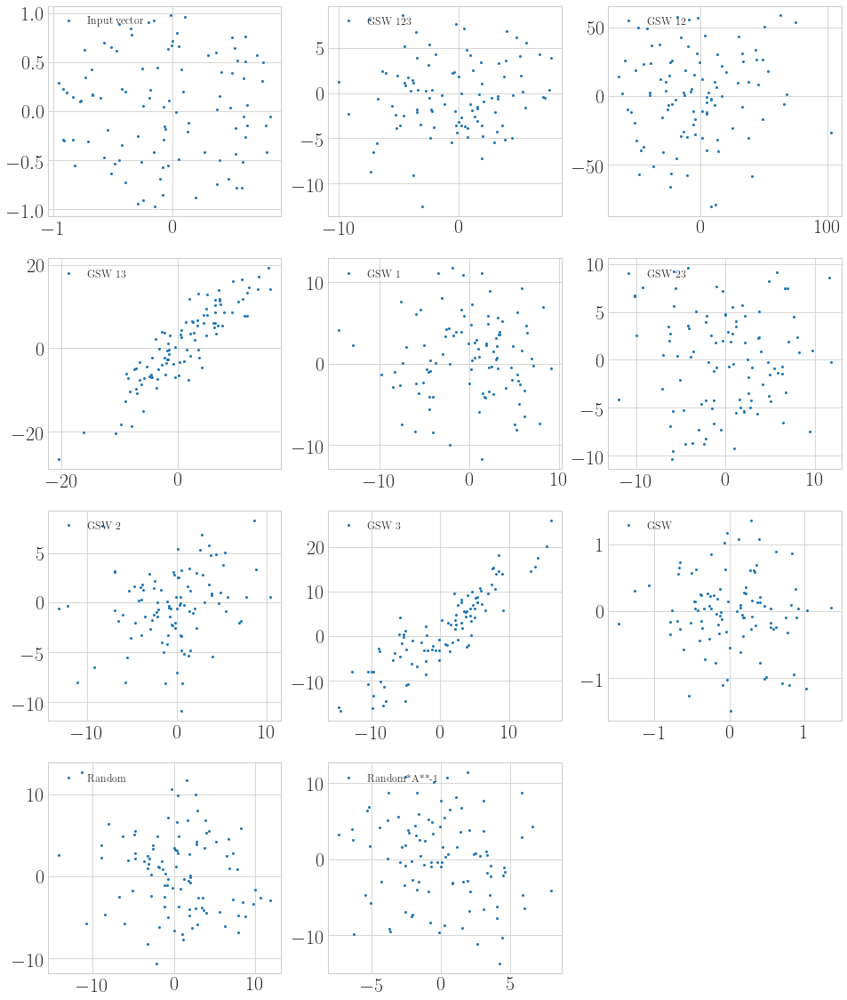

In [29]:
#First test in 2D
'''
Plot output with all combinations of
1)A*input
2)A*basis
3)A**-1*output
'''
n=100
A=2*np.random.uniform(size=(n,n))-1
A_=inv(A)
repeat=10**2
d=2
s=2
basis=orthonormal_basis(n)
v=sample_from_ball(n,d=d)
B=np.transpose(np.vstack(tuple([e for e in v])))
plt.subplot(4, 3, 1)
plt.plot([e[0] for e in v],[e[1] for e in v],'o',markersize=s,label='Input vector')
plt.legend(loc=2, prop={'size': 12})
a,b=-np.ones(n),np.ones(n)
gsw_xs={}
comb_list=[[True,True,True],[True,True, False],[True,False,True],[True,False,False],[False,True,True],[False,True,False],[False,False,True],[False,False,False]]
for i in range(len(comb_list)):
    gsw_xs[i]=[]
rand_xs=[]
for i in range(repeat):
    if i%10==0:
        print(i)
    for j in range(len(comb_list)):
        comb=comb_list[j]
        if comb[0]:
            vs=(A.dot(B.T)).T
            inp=[vs[:,i] for i in range(vs.shape[1])]
        else:
            inp=v
        if comb[1]:
            vs=A.dot(basis)
            inp_basis=[vs[:,i] for i in range(vs.shape[1])]
        else:
            inp_basis=basis
        x=gram_schmidt_walk(inp,np.zeros(n),a,b,False,False,False,inp_basis)
        if comb[2]:
            x=A_.dot(x)
        gsw_xs[j].append(x)
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
for i in range(len(comb_list)):
    comb=comb_list[i]
    plt.subplot(4, 3, i+2)
    plt.plot([np.matmul(B,x)[0] for x in gsw_xs[i]],[np.matmul(B,x)[1] for x in gsw_xs[i]],'o',markersize=s,label=f'GSW {"1" if comb[0] else ""}{"2" if comb[1] else ""}{"3" if comb[2] else ""}')
    plt.legend(loc=2, prop={'size': 12})

plt.subplot(4, 3, 10)
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',markersize=s,label='Random')
plt.legend(loc=2, prop={'size': 12})

plt.subplot(4, 3, 11)
plt.plot([np.matmul((A_.dot(B.T)).T,x)[0] for x in rand_xs],[np.matmul((A_.dot(B.T)).T,x)[1] for x in rand_xs],'o',markersize=s,label='Random*A**-1')
plt.legend(loc=2, prop={'size': 12})


#plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"A_mult_experiments_n={n}_repeat={repeat}.tex")

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:185: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290
300
310
320
330
340
350
360
370
380
390
400
410
420
430
440
450
460
470
480
490
500
510
520
530
540
550
560
570
580
590
600
610
620
630
640
650
660
670
680
690
700
710
720
730
740
750
760
770
780
790
800
810
820
830
840
850
860
870
880
890


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:86: RuntimeWarning: invalid value encountered in double_scalars


Issue, the algorithm took more steps than expected
x:[-6.861e+00 1.453e+01 -5.166e+00 1.719e+00 5.095e+00 6.764e+00 -1.376e+01
 -8.730e+00 -1.397e+00 4.699e-01 1.308e+00 7.924e+00 -6.247e+00 -3.759e-01
 -2.137e+00 -1.404e+00 -2.538e+00 5.412e+00 -1.215e+00 -5.505e+00
 -4.795e+00 -2.769e+00 -3.255e-01 1.684e+00 3.709e+00 -3.346e+00
 -7.506e+00 -1.882e+00 3.140e+00 3.000e+00 6.277e+00 4.349e+00 4.352e+00
 -2.166e+00 9.454e+00 -3.450e-01 1.400e+01 -2.565e+00 4.427e+00 5.003e+00
 1.678e+00 -1.551e+00 -4.383e+00 -1.962e+00 1.230e+01 -5.519e+00 6.018e+00
 -3.498e+00 4.491e+00 7.339e-01 -8.061e+00 -2.618e+00 2.463e+00 1.179e+01
 -1.615e-02 1.114e+01 2.363e+00 -2.104e+00 1.317e+00 8.481e+00 6.834e+00
 -1.264e+00 -1.144e+01 -2.612e+00 4.717e+00 -1.638e+01 4.077e+00
 -3.047e+00 3.407e+00 1.124e+01 -8.173e+00 -7.107e+00 -3.651e-01 3.394e-01
 9.996e-02 -3.426e+00 -7.849e+00 5.293e+00 4.816e+00 -8.073e+00 -3.135e-01
 4.696e+00 -1.691e+00 -2.371e+00 -8.462e+00 1.461e-01 1.007e+00 6.566e+00
 5.321e+0

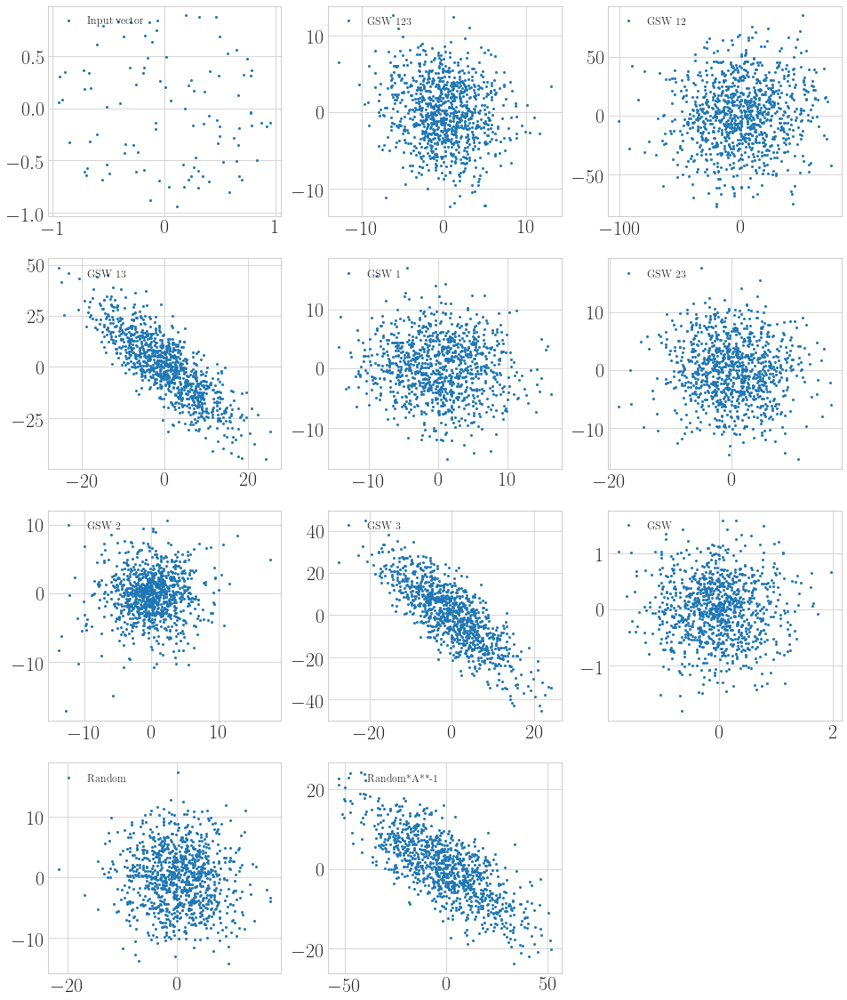

In [4]:
#First test in 2D
'''
Plot output with all combinations of
1)A*input
2)A*basis
3)A**-1*output
'''
n=100
A=2*np.random.uniform(size=(n,n))-1
A_=inv(A)
repeat=10**3
d=2
s=2
basis=orthonormal_basis(n)
v=sample_from_ball(n,d=d)
B=np.transpose(np.vstack(tuple([e for e in v])))
plt.subplot(4, 3, 1)
plt.plot([e[0] for e in v],[e[1] for e in v],'o',markersize=s,label='Input vector')
plt.legend(loc=2, prop={'size': 12})
a,b=-np.ones(n),np.ones(n)
gsw_xs={}
comb_list=[[True,True,True],[True,True, False],[True,False,True],[True,False,False],[False,True,True],[False,True,False],[False,False,True],[False,False,False]]
for i in range(len(comb_list)):
    gsw_xs[i]=[]
rand_xs=[]
for i in range(repeat):
    if i%10==0:
        print(i)
    for j in range(len(comb_list)):
        comb=comb_list[j]
        if comb[0]:
            vs=(A.dot(B.T)).T
            inp=[vs[:,i] for i in range(vs.shape[1])]
        else:
            inp=v
        if comb[1]:
            vs=A.dot(basis)
            inp_basis=[vs[:,i] for i in range(vs.shape[1])]
        else:
            inp_basis=basis
        x=gram_schmidt_walk(inp,np.zeros(n),a,b,False,False,False,inp_basis)
        if x is not None:
            if comb[2]:
                x=A_.dot(x)
            gsw_xs[j].append(x)
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
for i in range(len(comb_list)):
    comb=comb_list[i]
    plt.subplot(4, 3, i+2)
    plt.plot([np.matmul(B,x)[0] for x in gsw_xs[i]],[np.matmul(B,x)[1] for x in gsw_xs[i]],'o',markersize=s,label=f'GSW {"1" if comb[0] else ""}{"2" if comb[1] else ""}{"3" if comb[2] else ""}')
    plt.legend(loc=2, prop={'size': 12})

plt.subplot(4, 3, 10)
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',markersize=s,label='Random')
plt.legend(loc=2, prop={'size': 12})

plt.subplot(4, 3, 11)
plt.plot([np.matmul((A_.dot(B.T)).T,x)[0] for x in rand_xs],[np.matmul((A_.dot(B.T)).T,x)[1] for x in rand_xs],'o',markersize=s,label='Random*A**-1')
plt.legend(loc=2, prop={'size': 12})


#plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"A_mult_experiments_n={n}_repeat={repeat}.tex")

C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:185: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:86: RuntimeWarning: invalid value encountered in double_scalars


Issue, the algorithm took more steps than expected
x:[5.638e-01 -7.094e-01 1.786e+01 -3.266e+00 -9.021e+00 -5.676e-01
 -1.653e+00 -2.336e+00 3.580e+00 5.513e+00 -1.545e-01 1.442e+00 4.231e+00
 -8.221e-01 -1.672e+00 4.427e+00 -4.683e+00 8.308e+00 5.784e+00 9.890e-01
 6.596e-01 -6.055e+00 -6.631e+00 -3.938e+00 4.253e+00 2.241e+00 1.941e+01
 3.834e+00 -2.888e+00 -7.686e-01 3.116e+00 3.685e+00 -7.703e+00 3.686e+00
 -2.044e-01 -5.901e+00 -4.242e+00 -5.039e+00 -5.247e+00 5.587e+00
 8.978e+00 -8.036e-01 -1.033e+00 1.269e+01 -1.231e+01 -7.793e-01
 -4.269e-01 1.736e+00 3.130e+00 -8.767e+00 1.115e+00 6.051e+00 -1.652e+00
 -5.166e+00 2.070e+00 -5.794e+00 8.176e-01 5.750e+00 -1.780e+00 -5.189e+00
 -8.060e+00 -8.506e+00 -7.250e+00 -9.962e+00 -4.800e+00 -1.313e+00
 1.279e+00 6.068e-02 2.890e+00 3.083e+00 -3.678e+00 3.452e+00 -1.154e-01
 1.032e+01 9.687e-01 -1.181e+01 -7.894e+00 -3.459e+00 -3.558e+00 8.822e+00
 -5.475e+00 -9.990e+00 8.892e+00 1.671e+01 9.656e+00 8.350e+00 3.549e+00
 -7.973e+00 -9.298

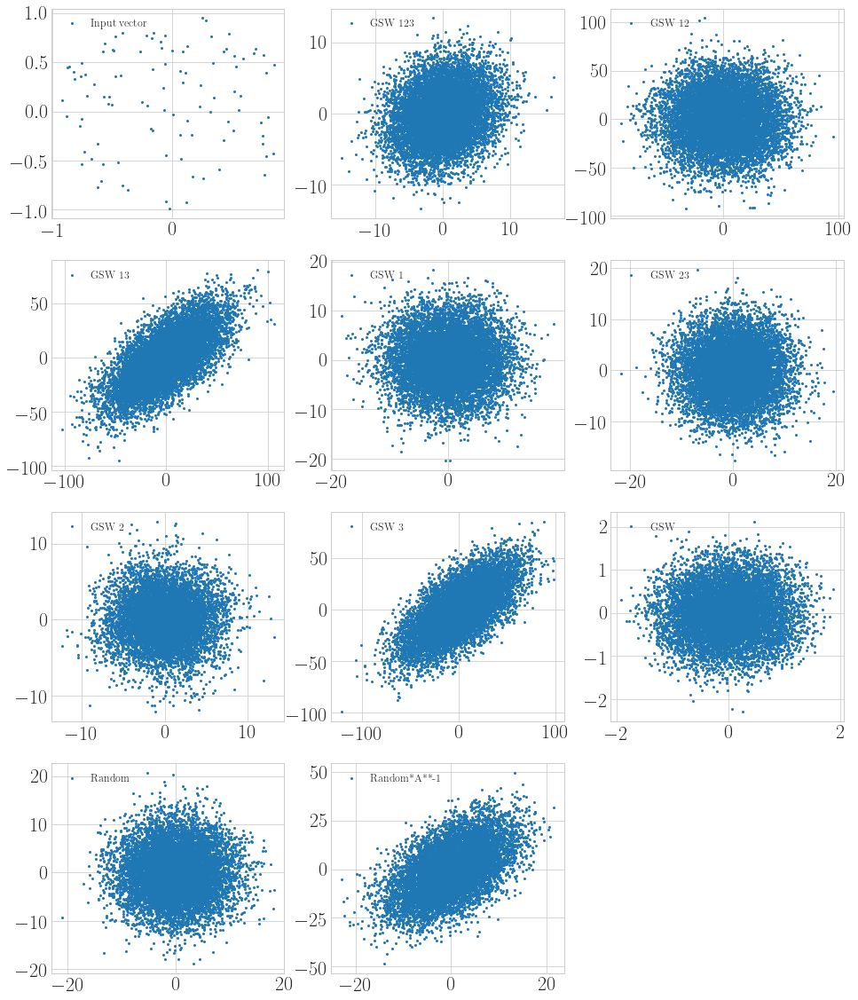

In [5]:
#First test in 2D
'''
Plot output with all combinations of
1)A*input
2)A*basis
3)A**-1*output
'''
n=100
A=2*np.random.uniform(size=(n,n))-1
A_=inv(A)
repeat=10**4
d=2
s=2
basis=orthonormal_basis(n)
v=sample_from_ball(n,d=d)
B=np.transpose(np.vstack(tuple([e for e in v])))
plt.subplot(4, 3, 1)
plt.plot([e[0] for e in v],[e[1] for e in v],'o',markersize=s,label='Input vector')
plt.legend(loc=2, prop={'size': 12})
a,b=-np.ones(n),np.ones(n)
gsw_xs={}
comb_list=[[True,True,True],[True,True, False],[True,False,True],[True,False,False],[False,True,True],[False,True,False],[False,False,True],[False,False,False]]
for i in range(len(comb_list)):
    gsw_xs[i]=[]
rand_xs=[]
for i in range(repeat):
    if i%10==0:
        print(i)
    for j in range(len(comb_list)):
        comb=comb_list[j]
        if comb[0]:
            vs=(A.dot(B.T)).T
            inp=[vs[:,i] for i in range(vs.shape[1])]
        else:
            inp=v
        if comb[1]:
            vs=A.dot(basis)
            inp_basis=[vs[:,i] for i in range(vs.shape[1])]
        else:
            inp_basis=basis
        x=gram_schmidt_walk(inp,np.zeros(n),a,b,False,False,False,inp_basis)
        if x is not None:
            if comb[2]:
                x=A_.dot(x)
            gsw_xs[j].append(x)
    rand_xs.append(change_basis(2*np.random.randint(2,size=n)-1,basis,orthonormal_basis(n)))
for i in range(len(comb_list)):
    comb=comb_list[i]
    plt.subplot(4, 3, i+2)
    plt.plot([np.matmul(B,x)[0] for x in gsw_xs[i]],[np.matmul(B,x)[1] for x in gsw_xs[i]],'o',markersize=s,label=f'GSW {"1" if comb[0] else ""}{"2" if comb[1] else ""}{"3" if comb[2] else ""}')
    plt.legend(loc=2, prop={'size': 12})

plt.subplot(4, 3, 10)
plt.plot([np.matmul(B,x)[0] for x in rand_xs],[np.matmul(B,x)[1] for x in rand_xs],'o',markersize=s,label='Random')
plt.legend(loc=2, prop={'size': 12})

plt.subplot(4, 3, 11)
plt.plot([np.matmul((A_.dot(B.T)).T,x)[0] for x in rand_xs],[np.matmul((A_.dot(B.T)).T,x)[1] for x in rand_xs],'o',markersize=s,label='Random*A**-1')
plt.legend(loc=2, prop={'size': 12})


#plt.legend(bbox_to_anchor=(1.35, 1))
tikzplotlib.save(f"A_mult_experiments_n={n}_repeat={repeat}.tex")

In [ ]:
#To understand the colorings, we can do a bunch of runs and see how correlated each pair of vectors is
#To understand the order of coloring we can do a bunch of runs and see how correlated the order of colorings are
n=10**2
v=sample_from_ball(n,d=n)
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
when_colored=[]

In [ ]:
for i in range(10**4):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(np.array(res))
    coloring_order.append(order)
    #print(order)
    switched_list=[(i,order[i]) for i in range(len(order))]
    switched_list.sort(key=lambda x:x[1])
    #print(switched_list)
    when_colored.append((np.array([x[0] for x in switched_list])).astype(float))

In [22]:
coloring_correlation=np.corrcoef(np.vstack(gsw_xs),rowvar=False)
print(coloring_correlation)
order_correlation=np.corrcoef(np.vstack(when_colored),rowvar=False)
print(order_correlation)

[[1.000e+00 3.034e-03 -5.723e-02 ... -2.136e-02 4.423e-02 -4.867e-02]
 [3.034e-03 1.000e+00 4.722e-02 ... 7.710e-02 -2.545e-01 -1.874e-01]
 [-5.723e-02 4.722e-02 1.000e+00 ... -2.375e-01 -2.289e-01 -3.333e-01]
 ...
 [-2.136e-02 7.710e-02 -2.375e-01 ... 1.000e+00 3.876e-02 2.089e-01]
 [4.423e-02 -2.545e-01 -2.289e-01 ... 3.876e-02 1.000e+00 3.290e-01]
 [-4.867e-02 -1.874e-01 -3.333e-01 ... 2.089e-01 3.290e-01 1.000e+00]]
[[1.000e+00 -1.957e-02 -3.690e-02 ... -3.577e-02 -7.469e-03 -3.833e-02]
 [-1.957e-02 1.000e+00 -4.849e-02 ... -2.221e-02 1.237e-01 -1.358e-02]
 [-3.690e-02 -4.849e-02 1.000e+00 ... 7.686e-02 2.388e-02 1.374e-01]
 ...
 [-3.577e-02 -2.221e-02 7.686e-02 ... 1.000e+00 9.868e-03 -1.250e-01]
 [-7.469e-03 1.237e-01 2.388e-02 ... 9.868e-03 1.000e+00 1.040e-01]
 [-3.833e-02 -1.358e-02 1.374e-01 ... -1.250e-01 1.040e-01 1.000e+00]]


In [26]:
#print the max couples, their correlation and the 2 vectors. Then do it again with some structure
thresh=0.5
total_sum=0
for i in range(coloring_correlation.shape[0]):
    for j in range(coloring_correlation.shape[0]):
        if i<j:
            total_sum+=norm(v[i]-v[j])
            if abs(coloring_correlation[i,j])>thresh:
                print(f'vectors {i} and {j}')
                print(coloring_correlation[i,j])
                #print(v[i])
                #print(v[j])
                print(norm(v[i]-v[j]))
total_sum/=(n*(n-1))/2
print(f'mean distance between vectors: {total_sum}')

vectors 3 and 75
-0.5249736918002812
1.2660904859379474
vectors 6 and 10
-0.521515648840967
1.3539715872382871
vectors 8 and 34
-0.5036941234196122
1.3087320983299102
vectors 10 and 15
0.5754754771957538
1.4547780565772563
vectors 10 and 22
-0.5232582690402824
1.3189399759299059
vectors 10 and 31
-0.552470843534694
1.3683885332473642
vectors 10 and 50
0.5202086330890474
1.461333942738398
vectors 10 and 51
0.5339104242160306
1.5506263561389841
vectors 14 and 70
0.5949689666169382
1.6122282355697939
vectors 15 and 31
-0.6223201439269157
1.208684289332276
vectors 15 and 64
0.6094726217376185
1.3703268112764622
vectors 15 and 75
-0.549401764821873
1.3010300239912371
vectors 15 and 99
0.5135929463672703
1.4717675239523167
vectors 16 and 97
0.5093901881556561
1.5149343051173112
vectors 34 and 55
-0.5310110766952605
1.3258913563805808
vectors 70 and 86
-0.5147242717279582
1.3552222568322727
mean distance between vectors: 1.3988547163617724


In [28]:
#print the max couples, their correlation and the 2 vectors. Then do it again with some structure
thresh=0.3
total_sum=0
for i in range(coloring_correlation.shape[0]):
    for j in range(coloring_correlation.shape[0]):
        if i<j:
            total_sum+=norm(v[i]-v[j])
            if abs(order_correlation[i,j])>thresh:
                print(f'vectors {i} and {j}')
                print(order_correlation[i,j])
                #print(v[i])
                #print(v[j])
                print(norm(v[i]-v[j]))
total_sum/=(n*(n-1))/2
print(f'mean distance between vectors: {total_sum}')

vectors 14 and 70
0.3377167222879714
1.6122282355697939
vectors 16 and 97
0.3218346898740226
1.5149343051173112
vectors 21 and 74
0.3455617526231009
1.4373308290244962
vectors 22 and 91
0.3555960384863287
1.330465289564679
vectors 28 and 29
0.33389213943292756
1.394566779773833
vectors 29 and 34
-0.31029697777516646
1.3788092923325423
vectors 34 and 55
0.34305858929167565
1.3258913563805808
vectors 55 and 75
0.3235740069596808
1.3219925147535008
vectors 70 and 86
0.31754437349767867
1.3552222568322727
mean distance between vectors: 1.3988547163617724


In [38]:
#Now the same but in dim 2 to try to understand better
#To understand the colorings, we can do a bunch of runs and see how correlated each pair of vectors is
#To understand the order of coloring we can do a bunch of runs and see how correlated the order of colorings are
n=10**2
v=sample_from_ball(n,d=2)
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
when_colored=[]
for i in range(10**3):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(np.array(res))
    coloring_order.append(order)
    #print(order)
    switched_list=[(i,order[i]) for i in range(len(order))]
    switched_list.sort(key=lambda x:x[1])
    #print(switched_list)
    when_colored.append((np.array([x[0] for x in switched_list])).astype(float))
coloring_correlation=np.corrcoef(np.vstack(gsw_xs),rowvar=False)
order_correlation=np.corrcoef(np.vstack(when_colored),rowvar=False)


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.



 Try #1

 Try #2

 Try #3

 Try #4

 Try #5

 Try #6

 Try #7

 Try #8

 Try #9

 Try #10

 Try #11

 Try #12

 Try #13

 Try #14

 Try #15

 Try #16

 Try #17

 Try #18

 Try #19

 Try #20

 Try #21

 Try #22

 Try #23

 Try #24

 Try #25

 Try #26

 Try #27

 Try #28

 Try #29

 Try #30

 Try #31

 Try #32

 Try #33

 Try #34

 Try #35

 Try #36

 Try #37

 Try #38

 Try #39

 Try #40

 Try #41

 Try #42

 Try #43

 Try #44

 Try #45

 Try #46

 Try #47

 Try #48

 Try #49

 Try #50

 Try #51

 Try #52

 Try #53

 Try #54

 Try #55

 Try #56

 Try #57

 Try #58

 Try #59

 Try #60

 Try #61

 Try #62

 Try #63

 Try #64

 Try #65

 Try #66

 Try #67

 Try #68

 Try #69

 Try #70

 Try #71

 Try #72

 Try #73

 Try #74

 Try #75

 Try #76

 Try #77

 Try #78

 Try #79

 Try #80

 Try #81

 Try #82

 Try #83

 Try #84

 Try #85

 Try #86

 Try #87

 Try #88

 Try #89

 Try #90

 Try #91

 Try #92

 Try #93

 Try #94

 Try #95

 Try #96

 Try #97

 Try #98

 Try #99

 Try #100

 Try #1


 Try #756

 Try #757

 Try #758

 Try #759

 Try #760

 Try #761

 Try #762

 Try #763

 Try #764

 Try #765

 Try #766

 Try #767

 Try #768

 Try #769

 Try #770

 Try #771

 Try #772

 Try #773

 Try #774

 Try #775

 Try #776

 Try #777

 Try #778

 Try #779

 Try #780

 Try #781

 Try #782

 Try #783

 Try #784

 Try #785

 Try #786

 Try #787

 Try #788

 Try #789

 Try #790

 Try #791

 Try #792

 Try #793

 Try #794

 Try #795

 Try #796

 Try #797

 Try #798

 Try #799

 Try #800

 Try #801

 Try #802

 Try #803

 Try #804

 Try #805

 Try #806

 Try #807

 Try #808

 Try #809

 Try #810

 Try #811

 Try #812

 Try #813

 Try #814

 Try #815

 Try #816

 Try #817

 Try #818

 Try #819

 Try #820

 Try #821

 Try #822

 Try #823

 Try #824

 Try #825

 Try #826

 Try #827

 Try #828

 Try #829

 Try #830

 Try #831

 Try #832

 Try #833

 Try #834

 Try #835

 Try #836

 Try #837

 Try #838

 Try #839

 Try #840

 Try #841

 Try #842

 Try #843

 Try #844

 Try #845

 Try #846

In [42]:
print('coloring')
thresh=0.1
total_sum=0
min_dist=1
max_dot_prod=0
for i in range(coloring_correlation.shape[0]):
    for j in range(coloring_correlation.shape[0]):
        if i<j:
            dist=norm(v[i]-v[j])
            if dist<min_dist:
                min_dist=dist
            dot_prod=v[i].dot(v[j])
            if abs(dot_prod)>abs(max_dot_prod):
                max_dot_prod=dot_prod
            total_sum+=dist
            if abs(coloring_correlation[i,j])>thresh:
                print(f'vectors {i} and {j}')
                print(coloring_correlation[i,j])
                print(v[i])
                print(v[j])
                print(norm(v[i]-v[j]))
                print(v[i].dot(v[j]))
total_sum/=(n*(n-1))/2
print('order')
thresh=0.1
total_sum=0
for i in range(coloring_correlation.shape[0]):
    for j in range(coloring_correlation.shape[0]):
        if i<j:
            total_sum+=norm(v[i]-v[j])
            if abs(order_correlation[i,j])>thresh:
                print(f'\nvectors {i} and {j}')
                print(order_correlation[i,j])
                print(v[i])
                print(v[j])
                print(norm(v[i]-v[j]))
                print(v[i].dot(v[j]))

total_sum/=(n*(n-1))/2
print(f'mean distance between vectors: {total_sum}')
print(f'min distance: {min_dist}')
print(f'max dot prod: {max_dot_prod}')

coloring
vectors 3 and 75
-0.1063913654968209
[-3.571e-01 -8.893e-02]
[-7.407e-01 -2.989e-01]
0.4372688059124201
0.29106903919502825
vectors 4 and 52
0.11135712701291034
[-1.916e-01 -8.694e-01]
[3.429e-01 8.771e-01]
1.82646896857646
-0.8282604916714482
vectors 5 and 21
0.10237754711355897
[5.858e-02 -3.463e-01]
[-7.739e-01 4.575e-01]
1.1571844574551926
-0.2037573599337641
vectors 8 and 84
0.10393344348037244
[-9.871e-01 1.196e-01]
[6.937e-01 -1.249e-01]
1.69844814402309
-0.6996523737428825
vectors 11 and 34
0.10559677399649897
[2.097e-02 4.839e-01]
[-5.304e-01 2.761e-01]
0.5891981272937299
0.12249120307364708
vectors 11 and 64
-0.11712906169005895
[2.097e-02 4.839e-01]
[-4.894e-01 1.200e-02]
0.6951039927481274
-0.004455514084721812
vectors 18 and 94
0.10240788314644889
[-9.213e-01 8.391e-02]
[5.566e-01 2.834e-01]
1.4913665109763745
-0.4890577314344343
vectors 23 and 94
0.10011539944857802
[1.865e-01 -1.058e-01]
[5.566e-01 2.834e-01]
0.5371024013474422
0.07384257759820403
vectors 25 and

In [49]:
#Now the same but in dim 2 to try to understand better
#To understand the colorings, we can do a bunch of runs and see how correlated each pair of vectors is
#To understand the order of coloring we can do a bunch of runs and see how correlated the order of colorings are
n=5*10**1
v=sample_from_ball(n,d=2)
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
when_colored=[]
for i in range(10**4):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(np.array(res))
    coloring_order.append(order)
    #print(order)
    switched_list=[(i,order[i]) for i in range(len(order))]
    switched_list.sort(key=lambda x:x[1])
    #print(switched_list)
    when_colored.append((np.array([x[0] for x in switched_list])).astype(float))
coloring_correlation=np.corrcoef(np.vstack(gsw_xs),rowvar=False)
order_correlation=np.corrcoef(np.vstack(when_colored),rowvar=False)


 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.



 Try #1

 Try #2

 Try #3

 Try #4

 Try #5

 Try #6

 Try #7

 Try #8

 Try #9

 Try #10

 Try #11

 Try #12

 Try #13

 Try #14

 Try #15

 Try #16

 Try #17

 Try #18

 Try #19

 Try #20

 Try #21

 Try #22

 Try #23

 Try #24

 Try #25

 Try #26

 Try #27

 Try #28

 Try #29

 Try #30

 Try #31

 Try #32

 Try #33

 Try #34

 Try #35

 Try #36

 Try #37

 Try #38

 Try #39

 Try #40

 Try #41

 Try #42

 Try #43

 Try #44

 Try #45

 Try #46

 Try #47

 Try #48

 Try #49

 Try #50

 Try #51

 Try #52

 Try #53

 Try #54

 Try #55

 Try #56

 Try #57

 Try #58

 Try #59

 Try #60

 Try #61

 Try #62

 Try #63

 Try #64

 Try #65

 Try #66

 Try #67

 Try #68

 Try #69

 Try #70

 Try #71

 Try #72

 Try #73

 Try #74

 Try #75

 Try #76

 Try #77

 Try #78

 Try #79

 Try #80

 Try #81

 Try #82

 Try #83

 Try #84

 Try #85

 Try #86

 Try #87

 Try #88

 Try #89

 Try #90

 Try #91

 Try #92

 Try #93

 Try #94

 Try #95

 Try #96

 Try #97

 Try #98

 Try #99

 Try #100

 Try #1


 Try #756

 Try #757

 Try #758

 Try #759

 Try #760

 Try #761

 Try #762

 Try #763

 Try #764

 Try #765

 Try #766

 Try #767

 Try #768

 Try #769

 Try #770

 Try #771

 Try #772

 Try #773

 Try #774

 Try #775

 Try #776

 Try #777

 Try #778

 Try #779

 Try #780

 Try #781

 Try #782

 Try #783

 Try #784

 Try #785

 Try #786

 Try #787

 Try #788

 Try #789

 Try #790

 Try #791

 Try #792

 Try #793

 Try #794

 Try #795

 Try #796

 Try #797

 Try #798

 Try #799

 Try #800

 Try #801

 Try #802

 Try #803

 Try #804

 Try #805

 Try #806

 Try #807

 Try #808

 Try #809

 Try #810

 Try #811

 Try #812

 Try #813

 Try #814

 Try #815

 Try #816

 Try #817

 Try #818

 Try #819

 Try #820

 Try #821

 Try #822

 Try #823

 Try #824

 Try #825

 Try #826

 Try #827

 Try #828

 Try #829

 Try #830

 Try #831

 Try #832

 Try #833

 Try #834

 Try #835

 Try #836

 Try #837

 Try #838

 Try #839

 Try #840

 Try #841

 Try #842

 Try #843

 Try #844

 Try #845

 Try #846


 Try #1460

 Try #1461

 Try #1462

 Try #1463

 Try #1464

 Try #1465

 Try #1466

 Try #1467

 Try #1468

 Try #1469

 Try #1470

 Try #1471

 Try #1472

 Try #1473

 Try #1474

 Try #1475

 Try #1476

 Try #1477

 Try #1478

 Try #1479

 Try #1480

 Try #1481

 Try #1482

 Try #1483

 Try #1484

 Try #1485

 Try #1486

 Try #1487

 Try #1488

 Try #1489

 Try #1490

 Try #1491

 Try #1492

 Try #1493

 Try #1494

 Try #1495

 Try #1496

 Try #1497

 Try #1498

 Try #1499

 Try #1500

 Try #1501

 Try #1502

 Try #1503

 Try #1504

 Try #1505

 Try #1506

 Try #1507

 Try #1508

 Try #1509

 Try #1510

 Try #1511

 Try #1512

 Try #1513

 Try #1514

 Try #1515

 Try #1516

 Try #1517

 Try #1518

 Try #1519

 Try #1520

 Try #1521

 Try #1522

 Try #1523

 Try #1524

 Try #1525

 Try #1526

 Try #1527

 Try #1528

 Try #1529

 Try #1530

 Try #1531

 Try #1532

 Try #1533

 Try #1534

 Try #1535

 Try #1536

 Try #1537

 Try #1538

 Try #1539

 Try #1540

 Try #1541

 Try #1542

 Tr


 Try #2143

 Try #2144

 Try #2145

 Try #2146

 Try #2147

 Try #2148

 Try #2149

 Try #2150

 Try #2151

 Try #2152

 Try #2153

 Try #2154

 Try #2155

 Try #2156

 Try #2157

 Try #2158

 Try #2159

 Try #2160

 Try #2161

 Try #2162

 Try #2163

 Try #2164

 Try #2165

 Try #2166

 Try #2167

 Try #2168

 Try #2169

 Try #2170

 Try #2171

 Try #2172

 Try #2173

 Try #2174

 Try #2175

 Try #2176

 Try #2177

 Try #2178

 Try #2179

 Try #2180

 Try #2181

 Try #2182

 Try #2183

 Try #2184

 Try #2185

 Try #2186

 Try #2187

 Try #2188

 Try #2189

 Try #2190

 Try #2191

 Try #2192

 Try #2193

 Try #2194

 Try #2195

 Try #2196

 Try #2197

 Try #2198

 Try #2199

 Try #2200

 Try #2201

 Try #2202

 Try #2203

 Try #2204

 Try #2205

 Try #2206

 Try #2207

 Try #2208

 Try #2209

 Try #2210

 Try #2211

 Try #2212

 Try #2213

 Try #2214

 Try #2215

 Try #2216

 Try #2217

 Try #2218

 Try #2219

 Try #2220

 Try #2221

 Try #2222

 Try #2223

 Try #2224

 Try #2225

 Tr


 Try #2827

 Try #2828

 Try #2829

 Try #2830

 Try #2831

 Try #2832

 Try #2833

 Try #2834

 Try #2835

 Try #2836

 Try #2837

 Try #2838

 Try #2839

 Try #2840

 Try #2841

 Try #2842

 Try #2843

 Try #2844

 Try #2845

 Try #2846

 Try #2847

 Try #2848

 Try #2849

 Try #2850

 Try #2851

 Try #2852

 Try #2853

 Try #2854

 Try #2855

 Try #2856

 Try #2857

 Try #2858

 Try #2859

 Try #2860

 Try #2861

 Try #2862

 Try #2863

 Try #2864

 Try #2865

 Try #2866

 Try #2867

 Try #2868

 Try #2869

 Try #2870

 Try #2871

 Try #2872

 Try #2873

 Try #2874

 Try #2875

 Try #2876

 Try #2877

 Try #2878

 Try #2879

 Try #2880

 Try #2881

 Try #2882

 Try #2883

 Try #2884

 Try #2885

 Try #2886

 Try #2887

 Try #2888

 Try #2889

 Try #2890

 Try #2891

 Try #2892

 Try #2893

 Try #2894

 Try #2895

 Try #2896

 Try #2897

 Try #2898

 Try #2899

 Try #2900

 Try #2901

 Try #2902

 Try #2903

 Try #2904

 Try #2905

 Try #2906

 Try #2907

 Try #2908

 Try #2909

 Tr


 Try #3510

 Try #3511

 Try #3512

 Try #3513

 Try #3514

 Try #3515

 Try #3516

 Try #3517

 Try #3518

 Try #3519

 Try #3520

 Try #3521

 Try #3522

 Try #3523

 Try #3524

 Try #3525

 Try #3526

 Try #3527

 Try #3528

 Try #3529

 Try #3530

 Try #3531

 Try #3532

 Try #3533

 Try #3534

 Try #3535

 Try #3536

 Try #3537

 Try #3538

 Try #3539

 Try #3540

 Try #3541

 Try #3542

 Try #3543

 Try #3544

 Try #3545

 Try #3546

 Try #3547

 Try #3548

 Try #3549

 Try #3550

 Try #3551

 Try #3552

 Try #3553

 Try #3554

 Try #3555

 Try #3556

 Try #3557

 Try #3558

 Try #3559

 Try #3560

 Try #3561

 Try #3562

 Try #3563

 Try #3564

 Try #3565

 Try #3566

 Try #3567

 Try #3568

 Try #3569

 Try #3570

 Try #3571

 Try #3572

 Try #3573

 Try #3574

 Try #3575

 Try #3576

 Try #3577

 Try #3578

 Try #3579

 Try #3580

 Try #3581

 Try #3582

 Try #3583

 Try #3584

 Try #3585

 Try #3586

 Try #3587

 Try #3588

 Try #3589

 Try #3590

 Try #3591

 Try #3592

 Tr


 Try #4194

 Try #4195

 Try #4196

 Try #4197

 Try #4198

 Try #4199

 Try #4200

 Try #4201

 Try #4202

 Try #4203

 Try #4204

 Try #4205

 Try #4206

 Try #4207

 Try #4208

 Try #4209

 Try #4210

 Try #4211

 Try #4212

 Try #4213

 Try #4214

 Try #4215

 Try #4216

 Try #4217

 Try #4218

 Try #4219

 Try #4220

 Try #4221

 Try #4222

 Try #4223

 Try #4224

 Try #4225

 Try #4226

 Try #4227

 Try #4228

 Try #4229

 Try #4230

 Try #4231

 Try #4232

 Try #4233

 Try #4234

 Try #4235

 Try #4236

 Try #4237

 Try #4238

 Try #4239

 Try #4240

 Try #4241

 Try #4242

 Try #4243

 Try #4244

 Try #4245

 Try #4246

 Try #4247

 Try #4248

 Try #4249

 Try #4250

 Try #4251

 Try #4252

 Try #4253

 Try #4254

 Try #4255

 Try #4256

 Try #4257

 Try #4258

 Try #4259

 Try #4260

 Try #4261

 Try #4262

 Try #4263

 Try #4264

 Try #4265

 Try #4266

 Try #4267

 Try #4268

 Try #4269

 Try #4270

 Try #4271

 Try #4272

 Try #4273

 Try #4274

 Try #4275

 Try #4276

 Tr

 Try #4877

 Try #4878

 Try #4879

 Try #4880

 Try #4881

 Try #4882

 Try #4883

 Try #4884

 Try #4885

 Try #4886

 Try #4887

 Try #4888

 Try #4889

 Try #4890

 Try #4891

 Try #4892

 Try #4893

 Try #4894

 Try #4895

 Try #4896

 Try #4897

 Try #4898

 Try #4899

 Try #4900

 Try #4901

 Try #4902

 Try #4903

 Try #4904

 Try #4905

 Try #4906

 Try #4907

 Try #4908

 Try #4909

 Try #4910

 Try #4911

 Try #4912

 Try #4913

 Try #4914

 Try #4915

 Try #4916

 Try #4917

 Try #4918

 Try #4919

 Try #4920

 Try #4921

 Try #4922

 Try #4923

 Try #4924

 Try #4925

 Try #4926

 Try #4927

 Try #4928

 Try #4929

 Try #4930

 Try #4931

 Try #4932

 Try #4933

 Try #4934

 Try #4935

 Try #4936

 Try #4937

 Try #4938

 Try #4939

 Try #4940

 Try #4941

 Try #4942

 Try #4943

 Try #4944

 Try #4945

 Try #4946

 Try #4947

 Try #4948

 Try #4949

 Try #4950

 Try #4951

 Try #4952

 Try #4953

 Try #4954

 Try #4955

 Try #4956

 Try #4957

 Try #4958

 Try #4959

 Try


 Try #5560

 Try #5561

 Try #5562

 Try #5563

 Try #5564

 Try #5565

 Try #5566

 Try #5567

 Try #5568

 Try #5569

 Try #5570

 Try #5571

 Try #5572

 Try #5573

 Try #5574

 Try #5575

 Try #5576

 Try #5577

 Try #5578

 Try #5579

 Try #5580

 Try #5581

 Try #5582

 Try #5583

 Try #5584

 Try #5585

 Try #5586

 Try #5587

 Try #5588

 Try #5589

 Try #5590

 Try #5591

 Try #5592

 Try #5593

 Try #5594

 Try #5595

 Try #5596

 Try #5597

 Try #5598

 Try #5599

 Try #5600

 Try #5601

 Try #5602

 Try #5603

 Try #5604

 Try #5605

 Try #5606

 Try #5607

 Try #5608

 Try #5609

 Try #5610

 Try #5611

 Try #5612

 Try #5613

 Try #5614

 Try #5615

 Try #5616

 Try #5617

 Try #5618

 Try #5619

 Try #5620

 Try #5621

 Try #5622

 Try #5623

 Try #5624

 Try #5625

 Try #5626

 Try #5627

 Try #5628

 Try #5629

 Try #5630

 Try #5631

 Try #5632

 Try #5633

 Try #5634

 Try #5635

 Try #5636

 Try #5637

 Try #5638

 Try #5639

 Try #5640

 Try #5641

 Try #5642

 Tr


 Try #6243

 Try #6244

 Try #6245

 Try #6246

 Try #6247

 Try #6248

 Try #6249

 Try #6250

 Try #6251

 Try #6252

 Try #6253

 Try #6254

 Try #6255

 Try #6256

 Try #6257

 Try #6258

 Try #6259

 Try #6260

 Try #6261

 Try #6262

 Try #6263

 Try #6264

 Try #6265

 Try #6266

 Try #6267

 Try #6268

 Try #6269

 Try #6270

 Try #6271

 Try #6272

 Try #6273

 Try #6274

 Try #6275

 Try #6276

 Try #6277

 Try #6278

 Try #6279

 Try #6280

 Try #6281

 Try #6282

 Try #6283

 Try #6284

 Try #6285

 Try #6286

 Try #6287

 Try #6288

 Try #6289

 Try #6290

 Try #6291

 Try #6292

 Try #6293

 Try #6294

 Try #6295

 Try #6296

 Try #6297

 Try #6298

 Try #6299

 Try #6300

 Try #6301

 Try #6302

 Try #6303

 Try #6304

 Try #6305

 Try #6306

 Try #6307

 Try #6308

 Try #6309

 Try #6310

 Try #6311

 Try #6312

 Try #6313

 Try #6314

 Try #6315

 Try #6316

 Try #6317

 Try #6318

 Try #6319

 Try #6320

 Try #6321

 Try #6322

 Try #6323

 Try #6324

 Try #6325

 Tr


 Try #6926

 Try #6927

 Try #6928

 Try #6929

 Try #6930

 Try #6931

 Try #6932

 Try #6933

 Try #6934

 Try #6935

 Try #6936

 Try #6937

 Try #6938

 Try #6939

 Try #6940

 Try #6941

 Try #6942

 Try #6943

 Try #6944

 Try #6945

 Try #6946

 Try #6947

 Try #6948

 Try #6949

 Try #6950

 Try #6951

 Try #6952

 Try #6953

 Try #6954

 Try #6955

 Try #6956

 Try #6957

 Try #6958

 Try #6959

 Try #6960

 Try #6961

 Try #6962

 Try #6963

 Try #6964

 Try #6965

 Try #6966

 Try #6967

 Try #6968

 Try #6969

 Try #6970

 Try #6971

 Try #6972

 Try #6973

 Try #6974

 Try #6975

 Try #6976

 Try #6977

 Try #6978

 Try #6979

 Try #6980

 Try #6981

 Try #6982

 Try #6983

 Try #6984

 Try #6985

 Try #6986

 Try #6987

 Try #6988

 Try #6989

 Try #6990

 Try #6991

 Try #6992

 Try #6993

 Try #6994

 Try #6995

 Try #6996

 Try #6997

 Try #6998

 Try #6999

 Try #7000

 Try #7001

 Try #7002

 Try #7003

 Try #7004

 Try #7005

 Try #7006

 Try #7007

 Try #7008

 Tr

 Try #7609

 Try #7610

 Try #7611

 Try #7612

 Try #7613

 Try #7614

 Try #7615

 Try #7616

 Try #7617

 Try #7618

 Try #7619

 Try #7620

 Try #7621

 Try #7622

 Try #7623

 Try #7624

 Try #7625

 Try #7626

 Try #7627

 Try #7628

 Try #7629

 Try #7630

 Try #7631

 Try #7632

 Try #7633

 Try #7634

 Try #7635

 Try #7636

 Try #7637

 Try #7638

 Try #7639

 Try #7640

 Try #7641

 Try #7642

 Try #7643

 Try #7644

 Try #7645

 Try #7646

 Try #7647

 Try #7648

 Try #7649

 Try #7650

 Try #7651

 Try #7652

 Try #7653

 Try #7654

 Try #7655

 Try #7656

 Try #7657

 Try #7658

 Try #7659

 Try #7660

 Try #7661

 Try #7662

 Try #7663

 Try #7664

 Try #7665

 Try #7666

 Try #7667

 Try #7668

 Try #7669

 Try #7670

 Try #7671

 Try #7672

 Try #7673

 Try #7674

 Try #7675

 Try #7676

 Try #7677

 Try #7678

 Try #7679

 Try #7680

 Try #7681

 Try #7682

 Try #7683

 Try #7684

 Try #7685

 Try #7686

 Try #7687

 Try #7688

 Try #7689

 Try #7690

 Try #7691

 Try


 Try #8292

 Try #8293

 Try #8294

 Try #8295

 Try #8296

 Try #8297

 Try #8298

 Try #8299

 Try #8300

 Try #8301

 Try #8302

 Try #8303

 Try #8304

 Try #8305

 Try #8306

 Try #8307

 Try #8308

 Try #8309

 Try #8310

 Try #8311

 Try #8312

 Try #8313

 Try #8314

 Try #8315

 Try #8316

 Try #8317

 Try #8318

 Try #8319

 Try #8320

 Try #8321

 Try #8322

 Try #8323

 Try #8324

 Try #8325

 Try #8326

 Try #8327

 Try #8328

 Try #8329

 Try #8330

 Try #8331

 Try #8332

 Try #8333

 Try #8334

 Try #8335

 Try #8336

 Try #8337

 Try #8338

 Try #8339

 Try #8340

 Try #8341

 Try #8342

 Try #8343

 Try #8344

 Try #8345

 Try #8346

 Try #8347

 Try #8348

 Try #8349

 Try #8350

 Try #8351

 Try #8352

 Try #8353

 Try #8354

 Try #8355

 Try #8356

 Try #8357

 Try #8358

 Try #8359

 Try #8360

 Try #8361

 Try #8362

 Try #8363

 Try #8364

 Try #8365

 Try #8366

 Try #8367

 Try #8368

 Try #8369

 Try #8370

 Try #8371

 Try #8372

 Try #8373

 Try #8374

 Tr


 Try #8976

 Try #8977

 Try #8978

 Try #8979

 Try #8980

 Try #8981

 Try #8982

 Try #8983

 Try #8984

 Try #8985

 Try #8986

 Try #8987

 Try #8988

 Try #8989

 Try #8990

 Try #8991

 Try #8992

 Try #8993

 Try #8994

 Try #8995

 Try #8996

 Try #8997

 Try #8998

 Try #8999

 Try #9000

 Try #9001

 Try #9002

 Try #9003

 Try #9004

 Try #9005

 Try #9006

 Try #9007

 Try #9008

 Try #9009

 Try #9010

 Try #9011

 Try #9012

 Try #9013

 Try #9014

 Try #9015

 Try #9016

 Try #9017

 Try #9018

 Try #9019

 Try #9020

 Try #9021

 Try #9022

 Try #9023

 Try #9024

 Try #9025

 Try #9026

 Try #9027

 Try #9028

 Try #9029

 Try #9030

 Try #9031

 Try #9032

 Try #9033

 Try #9034

 Try #9035

 Try #9036

 Try #9037

 Try #9038

 Try #9039

 Try #9040

 Try #9041

 Try #9042

 Try #9043

 Try #9044

 Try #9045

 Try #9046

 Try #9047

 Try #9048

 Try #9049

 Try #9050

 Try #9051

 Try #9052

 Try #9053

 Try #9054

 Try #9055

 Try #9056

 Try #9057

 Try #9058

 Tr


 Try #9660

 Try #9661

 Try #9662

 Try #9663

 Try #9664

 Try #9665

 Try #9666

 Try #9667

 Try #9668

 Try #9669

 Try #9670

 Try #9671

 Try #9672

 Try #9673

 Try #9674

 Try #9675

 Try #9676

 Try #9677

 Try #9678

 Try #9679

 Try #9680

 Try #9681

 Try #9682

 Try #9683

 Try #9684

 Try #9685

 Try #9686

 Try #9687

 Try #9688

 Try #9689

 Try #9690

 Try #9691

 Try #9692

 Try #9693

 Try #9694

 Try #9695

 Try #9696

 Try #9697

 Try #9698

 Try #9699

 Try #9700

 Try #9701

 Try #9702

 Try #9703

 Try #9704

 Try #9705

 Try #9706

 Try #9707

 Try #9708

 Try #9709

 Try #9710

 Try #9711

 Try #9712

 Try #9713

 Try #9714

 Try #9715

 Try #9716

 Try #9717

 Try #9718

 Try #9719

 Try #9720

 Try #9721

 Try #9722

 Try #9723

 Try #9724

 Try #9725

 Try #9726

 Try #9727

 Try #9728

 Try #9729

 Try #9730

 Try #9731

 Try #9732

 Try #9733

 Try #9734

 Try #9735

 Try #9736

 Try #9737

 Try #9738

 Try #9739

 Try #9740

 Try #9741

 Try #9742

 Tr

In [50]:
print('coloring')
thresh=0.6
total_sum=0
min_dist=1
max_dot_prod=0
for i in range(coloring_correlation.shape[0]):
    for j in range(coloring_correlation.shape[0]):
        if i<j:
            dist=norm(v[i]-v[j])
            if dist<min_dist:
                min_dist=dist
            dot_prod=v[i].dot(v[j])
            if abs(dot_prod)>abs(max_dot_prod):
                max_dot_prod=dot_prod
            total_sum+=dist
            if abs(coloring_correlation[i,j])>thresh:
                print(f'vectors {i} and {j}')
                print(coloring_correlation[i,j])
                print(v[i])
                print(v[j])
                print(norm(v[i]-v[j]))
                print(v[i].dot(v[j]))
total_sum/=(n*(n-1))/2
print('order')
thresh=0.3
total_sum=0
for i in range(coloring_correlation.shape[0]):
    for j in range(coloring_correlation.shape[0]):
        if i<j:
            total_sum+=norm(v[i]-v[j])
            if abs(order_correlation[i,j])>thresh:
                print(f'\nvectors {i} and {j}')
                print(order_correlation[i,j])
                print(v[i])
                print(v[j])
                print(norm(v[i]-v[j]))
                print(v[i].dot(v[j]))

total_sum/=(n*(n-1))/2
print(f'mean distance between vectors: {total_sum}')
print(f'min distance: {min_dist}')
print(f'max dot prod: {max_dot_prod}')

coloring
order
mean distance between vectors: 0.9254874531051334
min distance: 0.018343384738860335
max dot prod: -0.9213284263715814


In [ ]:
#Now with 0-1 vectors
#To understand the colorings, we can do a bunch of runs and see how correlated each pair of vectors is
#To understand the order of coloring we can do a bunch of runs and see how correlated the order of colorings are
n=5*10**1
v=sample_binary(n,d=n,p=1/2)
gsw_xs=[]
gsw_output_norm=[]
coloring_order=[]
when_colored=[]
for i in range(10**4):
    print(f'\n Try #{i}')
    res,order=gram_schmidt_walk(v,np.zeros(n),order=True,smallest_delta=False)
    gsw_xs.append(np.array(res))
    coloring_order.append(order)
    #print(order)
    switched_list=[(i,order[i]) for i in range(len(order))]
    switched_list.sort(key=lambda x:x[1])
    #print(switched_list)
    when_colored.append((np.array([x[0] for x in switched_list])).astype(float))
coloring_correlation=np.corrcoef(np.vstack(gsw_xs),rowvar=False)
order_correlation=np.corrcoef(np.vstack(when_colored),rowvar=False)

In [53]:
print('coloring')
thresh=0.6
total_sum=0
min_dist=1
max_dot_prod=0
for i in range(coloring_correlation.shape[0]):
    for j in range(coloring_correlation.shape[0]):
        if i<j:
            dist=norm(v[i]-v[j])
            if dist<min_dist:
                min_dist=dist
            dot_prod=v[i].dot(v[j])
            if abs(dot_prod)>abs(max_dot_prod):
                max_dot_prod=dot_prod
            total_sum+=dist
            if abs(coloring_correlation[i,j])>thresh:
                print(f'vectors {i} and {j}')
                print(coloring_correlation[i,j])
                print(v[i])
                print(v[j])
                print(norm(v[i]-v[j]))
                print(v[i].dot(v[j]))
total_sum/=(n*(n-1))/2
print('order')
thresh=0.3
total_sum=0
for i in range(coloring_correlation.shape[0]):
    for j in range(coloring_correlation.shape[0]):
        if i<j:
            total_sum+=norm(v[i]-v[j])
            if abs(order_correlation[i,j])>thresh:
                print(f'\nvectors {i} and {j}')
                print(order_correlation[i,j])
                print(v[i])
                print(v[j])
                print(norm(v[i]-v[j]))
                print(v[i].dot(v[j]))

total_sum/=(n*(n-1))/2
print(f'mean distance between vectors: {total_sum}')
print(f'min distance: {min_dist}')
print(f'max dot prod: {max_dot_prod}')

coloring
vectors 4 and 12
0.6370003765801561
[0 1 0 0 0 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 1 1
 0 0 0 0 1 0 0 0 0 1 1 0 0]
[0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1 1 1 0 0
 1 1 1 1 0 1 1 1 1 1 0 1 1]
5.744562646538029
12
vectors 4 and 20
-0.7126149380350327
[0 1 0 0 0 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 1 1
 0 0 0 0 1 0 0 0 0 1 1 0 0]
[0 1 0 0 1 0 1 0 1 1 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 0 1 1 0 1 0 1 1 1 0 0 0
 1 0 1 0 0 0 0 0 1 0 0 0 0]
4.242640687119285
13
vectors 4 and 39
0.68165582365287
[0 1 0 0 0 0 1 0 1 1 1 0 0 1 0 1 1 0 1 0 1 1 1 1 1 0 1 1 1 0 0 0 0 0 0 1 1
 0 0 0 0 1 0 0 0 0 1 1 0 0]
[0 0 1 1 0 0 0 1 1 0 0 0 1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 0 0 1 0 1 1 0 0 0 0
 1 0 0 0 0 0 1 0 0 1 0 1 1]
5.291502622129181
7
vectors 12 and 30
-0.6860271034714163
[0 0 0 1 1 1 1 1 1 1 1 1 0 1 1 0 0 0 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1 1 1 0 0
 1 1 1 1 0 1 1 1 1 1 0 1 1]
[0 0 0 0 1 1 1 1 0 0 0 1 1 1 0 0 0 1 1 1 1 1 0 0 0 0 1 0 1 0 0 

In [40]:
#Now with naive walk and with much smaller structured group but with noise in ustructured part that is even bigger than before
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(np.sqrt(n))
v=sample_from_ball(n-structured,d=n)
subteam = [0] * int(structured-4) + [1/2] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_from_ball(1,d=n-structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))*1000/structured),axis=0)))
coloring_corr, ordering_corr=produce_correlations(v)

Studying correlations with 1000 iterations

 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.



 Try #1

 Try #2

 Try #3

 Try #4

 Try #5

 Try #6

 Try #7

 Try #8

 Try #9

 Try #10

 Try #11

 Try #12

 Try #13

 Try #14

 Try #15

 Try #16

 Try #17

 Try #18

 Try #19

 Try #20

 Try #21

 Try #22

 Try #23

 Try #24

 Try #25

 Try #26

 Try #27

 Try #28

 Try #29

 Try #30

 Try #31

 Try #32

 Try #33

 Try #34

 Try #35

 Try #36

 Try #37

 Try #38

 Try #39

 Try #40

 Try #41

 Try #42

 Try #43

 Try #44

 Try #45

 Try #46

 Try #47

 Try #48

 Try #49

 Try #50

 Try #51

 Try #52

 Try #53

 Try #54

 Try #55

 Try #56

 Try #57

 Try #58

 Try #59

 Try #60

 Try #61

 Try #62

 Try #63

 Try #64

 Try #65

 Try #66

 Try #67

 Try #68

 Try #69

 Try #70

 Try #71

 Try #72

 Try #73

 Try #74

 Try #75

 Try #76

 Try #77

 Try #78

 Try #79

 Try #80

 Try #81

 Try #82

 Try #83

 Try #84

 Try #85

 Try #86

 Try #87

 Try #88

 Try #89

 Try #90

 Try #91

 Try #92

 Try #93

 Try #94

 Try #95

 Try #96

 Try #97

 Try #98

 Try #99

 Try #100

 Try #1


 Try #756

 Try #757

 Try #758

 Try #759

 Try #760

 Try #761

 Try #762

 Try #763

 Try #764

 Try #765

 Try #766

 Try #767

 Try #768

 Try #769

 Try #770

 Try #771

 Try #772

 Try #773

 Try #774

 Try #775

 Try #776

 Try #777

 Try #778

 Try #779

 Try #780

 Try #781

 Try #782

 Try #783

 Try #784

 Try #785

 Try #786

 Try #787

 Try #788

 Try #789

 Try #790

 Try #791

 Try #792

 Try #793

 Try #794

 Try #795

 Try #796

 Try #797

 Try #798

 Try #799

 Try #800

 Try #801

 Try #802

 Try #803

 Try #804

 Try #805

 Try #806

 Try #807

 Try #808

 Try #809

 Try #810

 Try #811

 Try #812

 Try #813

 Try #814

 Try #815

 Try #816

 Try #817

 Try #818

 Try #819

 Try #820

 Try #821

 Try #822

 Try #823

 Try #824

 Try #825

 Try #826

 Try #827

 Try #828

 Try #829

 Try #830

 Try #831

 Try #832

 Try #833

 Try #834

 Try #835

 Try #836

 Try #837

 Try #838

 Try #839

 Try #840

 Try #841

 Try #842

 Try #843

 Try #844

 Try #845

 Try #846

In [47]:
study_correlations(coloring_corr,ordering_corr,thresh1=0.6,thresh2=0.4)

order

vectors 35 and 146
0.4224891714323924
[-2.000e-02 -1.704e-01 9.775e-02 -1.691e-01 -3.346e-02 -1.357e-01
 -2.846e-03 7.288e-02 -4.772e-03 -4.187e-02 1.340e-02 -5.458e-02 2.319e-03
 -5.612e-02 1.592e-01 -1.950e-01 1.429e-01 2.674e-02 1.371e-01 8.191e-02
 2.455e-02 6.198e-02 -8.419e-02 -6.754e-02 1.572e-02 5.938e-02 1.203e-02
 -1.055e-01 1.416e-02 6.404e-03 1.212e-01 -1.507e-01 -6.448e-02 -6.367e-03
 5.234e-02 9.688e-02 -4.406e-02 2.393e-02 -2.573e-02 2.638e-02 1.601e-01
 1.104e-02 -1.159e-01 1.917e-02 -3.862e-02 7.755e-03 -1.943e-01 -9.298e-02
 -5.486e-02 3.668e-02 -2.684e-02 7.406e-02 -8.883e-02 1.248e-01 4.083e-02
 6.324e-02 1.534e-02 -1.030e-02 -7.693e-02 -3.587e-02 -2.998e-02
 -1.336e-01 3.852e-02 8.708e-04 9.767e-02 4.791e-02 1.395e-03 4.277e-02
 2.524e-02 2.726e-02 2.334e-02 4.375e-02 -2.000e-03 8.541e-02 -5.965e-02
 1.005e-01 1.541e-02 -1.129e-02 1.714e-01 8.524e-02 6.941e-02 -8.154e-02
 9.192e-02 -4.646e-02 -8.199e-02 -2.267e-02 5.407e-02 9.771e-03 1.659e-02
 -5.136e-02 -1

order

vectors 122 and 175
0.4039593987152509
[4.859e-02 1.938e-02 -7.593e-02 3.603e-02 4.240e-02 -9.054e-02 3.994e-02
 4.893e-02 3.171e-02 2.486e-02 -1.100e-01 -6.696e-02 3.650e-02 -4.771e-02
 1.283e-01 -4.566e-02 4.559e-02 -3.268e-02 -1.590e-02 3.603e-02 1.071e-01
 -4.341e-02 6.005e-02 -2.551e-02 5.925e-02 -2.848e-02 1.413e-02 9.340e-02
 4.880e-02 4.565e-02 -1.113e-01 1.634e-01 -5.632e-02 -7.905e-03 -4.886e-02
 2.656e-02 -1.745e-02 1.252e-01 -1.217e-01 1.356e-01 3.138e-02 6.720e-02
 -5.277e-02 1.183e-02 -4.810e-02 2.586e-02 -8.428e-02 -2.309e-02
 -4.173e-02 -7.157e-02 -5.091e-02 -7.643e-02 5.328e-02 -5.486e-03
 -1.122e-01 2.404e-02 -9.136e-02 -8.036e-03 7.568e-02 7.519e-02 -7.437e-02
 5.004e-02 7.207e-02 -1.881e-02 -3.328e-02 1.563e-01 -2.233e-02 9.190e-02
 1.673e-02 -7.171e-02 -2.274e-03 -6.722e-02 -1.042e-01 3.674e-02
 -6.224e-02 -3.173e-02 -3.360e-03 -1.295e-01 2.966e-02 6.035e-02
 -6.136e-02 5.047e-02 9.606e-02 -8.854e-02 9.727e-02 -1.065e-02 3.185e-02
 -2.233e-02 -8.799e-02 -1.6

In [44]:
print(f'mean absolute correlation in order between structured: {average(np.abs(np.ravel(ordering_corr[:structured,:structured])))}')
print(f'mean absolute correlation in color between structured: {average(np.abs(np.ravel(coloring_corr[:structured,:structured])))}')
print(f'mean absolute correlation in order between non-structured: {average(np.abs(np.ravel(ordering_corr[structured:,structured:])))}')
print(f'mean absolute correlation in color between non-structured: {average(np.abs(np.ravel(coloring_corr[structured:,structured:])))}')


mean absolute correlation in order between structured: 0.10858641472427355
mean absolute correlation in color between structured: 0.17112025491846528
mean absolute correlation in order between non-structured: 0.05925379319186552
mean absolute correlation in color between non-structured: 0.1227845372029047


In [19]:
print(ordering_corr.shape)
print(coloring_corr.shape)

(200, 200)
(200, 200)


In [38]:
ordering_corr

array([1.000e+00, -1.715e-01, -5.970e-02, ..., -1.086e-01, -4.287e-02,
       1.000e+00])

In [27]:
#Now with naive walk and with much smaller structured group but with noise in ustructured part that is even bigger than the  bigger than before
#Trying with half structured in dimension 100, where structured are such that they have four 1's in the first m (m=sqrt(n) here) coordinates and all 0's everywhere else.
#When are structured points colored and what is the coloring distribution among structured ?
n=200
structured=int(np.sqrt(n))
v=sample_from_ball(n-structured,d=n)
subteam = [0] * int(structured-4) + [1/2] * 4
for i in range(structured):
    random.shuffle(subteam)
    noise=sample_from_ball(1,d=n-structured)
    v.append(normalize(np.concatenate((np.array(subteam.copy()),np.squeeze(np.array(noise))*100000/structured),axis=0)))
coloring_corr2, ordering_corr2=produce_correlations(v)
study_correlations(coloring_corr2,ordering_corr2,thresh1=0.7,thresh2=0.5)
print(f'mean absolute correlation in order between structured: {average(np.abs(np.ravel(ordering_corr2[:structured,:structured])))}')
print(f'mean absolute correlation in color between structured: {average(np.abs(np.ravel(coloring_corr2[:structured,:structured])))}')
print(f'mean absolute correlation in order between non-structured: {average(np.abs(np.ravel(ordering_corr2[structured:,structured:])))}')
print(f'mean absolute correlation in color between non-structured: {average(np.abs(np.ravel(coloring_corr2[structured:,structured:])))}')


Studying correlations with 1000 iterations

 Try #0


C:\Users\Ga Bo\Anaconda3\lib\site-packages\ipykernel_launcher.py:44: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.



 Try #1

 Try #2

 Try #3

 Try #4

 Try #5

 Try #6

 Try #7

 Try #8

 Try #9

 Try #10

 Try #11

 Try #12

 Try #13

 Try #14

 Try #15

 Try #16

 Try #17

 Try #18

 Try #19

 Try #20

 Try #21

 Try #22

 Try #23

 Try #24

 Try #25

 Try #26

 Try #27

 Try #28

 Try #29

 Try #30

 Try #31

 Try #32

 Try #33

 Try #34

 Try #35

 Try #36

 Try #37

 Try #38

 Try #39

 Try #40

 Try #41

 Try #42

 Try #43

 Try #44

 Try #45

 Try #46

 Try #47

 Try #48

 Try #49

 Try #50

 Try #51

 Try #52

 Try #53

 Try #54

 Try #55

 Try #56

 Try #57

 Try #58

 Try #59

 Try #60

 Try #61

 Try #62

 Try #63

 Try #64

 Try #65

 Try #66

 Try #67

 Try #68

 Try #69

 Try #70

 Try #71

 Try #72

 Try #73

 Try #74

 Try #75

 Try #76

 Try #77

 Try #78

 Try #79

 Try #80

 Try #81

 Try #82

 Try #83

 Try #84

 Try #85

 Try #86

 Try #87

 Try #88

 Try #89

 Try #90

 Try #91

 Try #92

 Try #93

 Try #94

 Try #95

 Try #96

 Try #97

 Try #98

 Try #99

 Try #100

 Try #1


 Try #756

 Try #757

 Try #758

 Try #759

 Try #760

 Try #761

 Try #762

 Try #763

 Try #764

 Try #765

 Try #766

 Try #767

 Try #768

 Try #769

 Try #770

 Try #771

 Try #772

 Try #773

 Try #774

 Try #775

 Try #776

 Try #777

 Try #778

 Try #779

 Try #780

 Try #781

 Try #782

 Try #783

 Try #784

 Try #785

 Try #786

 Try #787

 Try #788

 Try #789

 Try #790

 Try #791

 Try #792

 Try #793

 Try #794

 Try #795

 Try #796

 Try #797

 Try #798

 Try #799

 Try #800

 Try #801

 Try #802

 Try #803

 Try #804

 Try #805

 Try #806

 Try #807

 Try #808

 Try #809

 Try #810

 Try #811

 Try #812

 Try #813

 Try #814

 Try #815

 Try #816

 Try #817

 Try #818

 Try #819

 Try #820

 Try #821

 Try #822

 Try #823

 Try #824

 Try #825

 Try #826

 Try #827

 Try #828

 Try #829

 Try #830

 Try #831

 Try #832

 Try #833

 Try #834

 Try #835

 Try #836

 Try #837

 Try #838

 Try #839

 Try #840

 Try #841

 Try #842

 Try #843

 Try #844

 Try #845

 Try #846

mean distance between vectors: 1.4064496699925846
min distance: 1.2037657182304375
max dot prod: 0.2733770988037132
mean absolute correlation in order between structured: 0.12491553997988353
mean absolute correlation in color between structured: 0.25227064275861144
mean absolute correlation in order between non-structured: 0.05807333678064531
mean absolute correlation in color between non-structured: 0.12862960678167706


In [10]:
v=10*[np.array([1,0])]+[np.array([10,0])]
tot=0
repeat=10**2
for i in range(repeat):
    res=gram_schmidt_walk(v,np.zeros(11),debug=False,bigger_first=True)
    output=10*res[10]+sum(res[0:10])
    print(res)
    tot+=output
print(tot/repeat)

[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 -1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 -1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 

[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 -1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 -1.000e+00]
[1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 -1.000e+00]
[1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00 1.000e+00
 1.000e+00 1.000e+00 1.000e+00 -1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00
 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 1.000e+00]
[-1.000e+00 -1.000e+00 -1.000e+00 -1.000e+00 -1.000e

In [3]:
[1,2,3]

[3]

In [3]:
k=0
A=np.array([[1,3,4],[2,5,6],[-1,9,19],[-5,6,8]])
X=A.T.dot(A)
X_inv=inv(X)
print(X_inv)
X_2=np.delete(X,0,0)
X_2=np.delete(X_2,0,1)
print(X_2)
X_2_inv=inv(X_2)
print(X_2_inv)
print(X_2.dot(X_2_inv))
update=X_inv[k,k]**-1*np.matmul(X_inv[:,k].reshape((X_inv.shape[0],1)),X_inv[k,:].reshape((1,X_inv.shape[0])))
print(update)
X_3=X_inv-update
X_3=np.delete(X_3,0,0)
X_3=np.delete(X_3,0,1)
print(X_3)
print(inv(X_3)-X_2)
print(X_2_inv-X_3)

[[3.791e-02 1.144e-02 -2.844e-03]
 [1.144e-02 1.256e-01 -6.768e-02]
 [-2.844e-03 -6.768e-02 3.887e-02]]
[[151 261]
 [261 477]]
[[1.221e-01 -6.682e-02]
 [-6.682e-02 3.866e-02]]
[[1.000e+00 -3.886e-16]
 [4.691e-15 1.000e+00]]
[[3.791e-02 1.144e-02 -2.844e-03]
 [1.144e-02 3.454e-03 -8.584e-04]
 [-2.844e-03 -8.584e-04 2.133e-04]]
[[1.221e-01 -6.682e-02]
 [-6.682e-02 3.866e-02]]
[[-1.791e-12 -3.013e-12]
 [-3.070e-12 -5.230e-12]]
[[-1.110e-16 4.163e-17]
 [2.776e-17 -2.082e-17]]


In [2]:
l=[1,2,3,4]
print(np.cumsum(l))

[ 1  3  6 10]


In [2]:
import numpy as np

In [5]:
B=np.array([[1,1],[1,1]])
v=np.array([1,1])
BB=np.vstack((B,v))
print(BB.T.dot(BB))

[[3 3]
 [3 3]]
